###  1. Importing Libraries

In [60]:
import pandas as pd
import numpy as np
import random
pd.options.display.max_columns = 75

### 2. Importing data set

In [19]:
description_listing = pd.read_csv("Listings_data_dictionary.csv", encoding= "ISO-8859-1")
description_listing

,Field,Description
0,listing_id,Listing ID
1,name,Listing Name
2,host_id,Host ID
3,host_since,Date the Host joined Airbnb
4,host_location,Location where the Host is based
5,host_response_time,Estimate of how long the Host takes to respond
6,host_response_rate,Percentage of times the Host responds
7,host_acceptance_rate,Percentage of times the Host accepts a booking...
8,host_is_superhost,Binary field to determine if the Host is a Sup...
9,host_total_listings_count,Total listings the Host has in Airbnb


In [24]:
description_review = pd.read_csv("Reviews_data_dictionary.csv", encoding= "ISO-8859-1")
description_review

,Field,Description
0,listing_id,Listing ID
1,review_id,Review ID
2,date,Review date
3,reviewer_id,Reviewer ID


In [21]:
Review_df = pd.read_csv("Reviews.csv", encoding= "ISO-8859-1")
Review_df

,listing_id,review_id,date,reviewer_id
0,11798,330265172,2018-09-30,11863072
1,15383,330103585,2018-09-30,39147453
2,16455,329985788,2018-09-30,1125378
3,17919,330016899,2018-09-30,172717984
4,26827,329995638,2018-09-30,17542859
...,...,...,...,...
5373138,47779342,726766332,2021-01-25,283094516
5373139,47823964,727963021,2021-01-31,76411977
5373140,47896175,728548625,2021-02-02,71370946
5373141,47900451,727399287,2021-01-29,109011160


In [22]:
listing_df = pd.read_csv("Listings.csv", encoding= "ISO-8859-1")
listing_df

/var/folders/kj/pw968s0n629876mdc5tg0zhh0000gq/T/ipykernel_28656/1047046590.py:1: DtypeWarning: Columns (5,13) have mixed types. Specify dtype option on import or set low_memory=False.
  listing_df = pd.read_csv("Listings.csv", encoding= "ISO-8859-1")


,listing_id,name,host_id,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,host_has_profile_pic,host_identity_verified,neighbourhood,district,city,latitude,longitude,property_type,room_type,accommodates,bedrooms,amenities,price,minimum_nights,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable
0,281420,"Beautiful Flat in le Village Montmartre, Paris",1466919,2011-12-03,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,f,Buttes-Montmartre,NaN,Paris,48.88668,2.33343,Entire apartment,Entire place,2,1.0,"[""Heating"", ""Kitchen"", ""Washer"", ""Wifi"", ""Long...",53,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
1,3705183,39 mÃÂ² Paris (Sacre CÃ âur),10328771,2013-11-29,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,t,Buttes-Montmartre,NaN,Paris,48.88617,2.34515,Entire apartment,Entire place,2,1.0,"[""Shampoo"", ""Heating"", ""Kitchen"", ""Essentials""...",120,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
2,4082273,"Lovely apartment with Terrace, 60m2",19252768,2014-07-31,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,f,Elysee,NaN,Paris,48.88112,2.31712,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Washer"", ""Wifi"",...",89,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
3,4797344,Cosy studio (close to Eiffel tower),10668311,2013-12-17,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,t,Vaugirard,NaN,Paris,48.84571,2.30584,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Wifi"", ""Long ter...",58,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
4,4823489,Close to Eiffel Tower - Beautiful flat : 2 rooms,24837558,2014-12-14,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,f,Passy,NaN,Paris,48.85500,2.26979,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Essentials"", ""Ha...",60,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279707,38338635,Appartement T2 neuf prÃÂ¨s du tram T3a Porte ...,31161181,2015-04-13,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,t,Observatoire,NaN,Paris,48.82701,2.31419,Entire apartment,Entire place,2,1.0,"[""Iron"", ""Heating"", ""Washer"", ""Dedicated works...",120,1,7,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
279708,38538692,Cozy Studio in Montmartre,10294858,2013-11-27,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,t,Buttes-Montmartre,NaN,Paris,48.89309,2.33206,Entire apartment,Entire place,2,1.0,"[""Shampoo"", ""Iron"", ""Heating"", ""Washer"", ""Hair...",60,7,15,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
279709,38683356,Nice and cosy mini-appartement in Paris,2238502,2012-04-27,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,t,Buttes-Montmartre,NaN,Paris,48.88699,2.34920,Entire apartment,Entire place,2,1.0,"[""Paid parking off premises"", ""Shampoo"", ""Firs...",50,6,30,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
279710,39659000,Charming apartment near Rue Saint Maur / Oberk...,38633695,2015-07-16,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,t,Popincourt,NaN,Paris,48.86687,2.38123,Entire apartment,Entire place,2,1.0,"[""TV"", ""Iron"", ""Kitchen"", ""Hangers"", ""Smoke al...",105,3,18,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f


###  3. Converting the prices to euro
- Dollars = 0.95 (New York)
- Thai baht = 0.027 (Bangkok)
- South African Rand = 0.059 (Cape Town)
- Hong Kong Dollar = 0.12 (Hong Kong)
- Turkish Lira = 0.062 (Istanbul)
- Mexican Peso = 0.047 (Mexico city)
- Brazilian Real = 0.19 (Rio de Janeiro)
- Australian Dollars = 0.66 (Sydney)

In [25]:
listing_df['price_in_euro'] = np.where(listing_df['city'] == 'New York' , listing_df['price'] * 0.95, 
(np.where(listing_df['city'] == 'Bangkok' , listing_df['price'] * 0.027, 
(np.where(listing_df['city'] == 'Cape Town' , listing_df['price'] * 0.059, 
(np.where(listing_df['city'] == 'Hong Kong' , listing_df['price'] * 0.12,
(np.where(listing_df['city'] == 'Istanbul' , listing_df['price'] * 0.062,
(np.where(listing_df['city'] == 'Mexico City' , listing_df['price'] * 0.047,
(np.where(listing_df['city'] == 'Rio de Janeiro' , listing_df['price'] * 0.19,
(np.where(listing_df['city'] == 'Sydney' , listing_df['price'] * 0.66,  listing_df['price'] * 1)))))))))))))))

In [26]:
listing_df.to_csv("Airbnb.csv", index = True)

In [27]:
airbnb_count = listing_df.value_counts(['city']).reset_index(name='count')
airbnb_count

,city,count
0,Paris,64690
1,New York,37012
2,Sydney,33630
3,Rome,27647
4,Rio de Janeiro,26615
5,Istanbul,24519
6,Mexico City,20065
7,Bangkok,19361
8,Cape Town,19086
9,Hong Kong,7087


### Creating a new column count_per_Sqkm
#### Area of cities
- New York = 783.8 Sqkm
- Bangkok = 1569 Sqkm
- Cape Town = 2446 SqKm
- Hong Kong = 1106 SqKm
- Istanbul = 5343 SqKm
- Mexico city = 1485 SqKm
- Rio de Janeiro = 1200 SqKm
- Sydney = 12368 SqKm
- Paris = 105.4 SqKm
- Rome = 1285 SqKm

In [28]:
airbnb_count['count_per_Sqkm'] = np.where(airbnb_count['city'] == 'New York' , airbnb_count['count'] /783.8, 
(np.where(airbnb_count['city'] == 'Bangkok' , airbnb_count['count'] / 1569, 
(np.where(airbnb_count['city'] == 'Cape Town' , airbnb_count['count'] / 2446, 
(np.where(airbnb_count['city'] == 'Hong Kong' , airbnb_count['count'] / 1106,
(np.where(airbnb_count['city'] == 'Istanbul' , airbnb_count['count'] / 5343,
(np.where(airbnb_count['city'] == 'Mexico City' , airbnb_count['count'] / 1485,
(np.where(airbnb_count['city'] == 'Rio de Janeiro' , airbnb_count['count'] / 1200,
(np.where(airbnb_count['city'] == 'Sydney' , airbnb_count['count'] / 12368, 
(np.where(airbnb_count['city'] == 'Paris' , airbnb_count['count'] /105.4, airbnb_count['count'] / 1285)))))))))))))))))


In [29]:
airbnb_count

,city,count,count_per_Sqkm
0,Paris,64690,613.757116
1,New York,37012,47.221230
2,Sydney,33630,2.719114
3,Rome,27647,21.515175
4,Rio de Janeiro,26615,22.179167
5,Istanbul,24519,4.588995
6,Mexico City,20065,13.511785
7,Bangkok,19361,12.339707
8,Cape Town,19086,7.802944
9,Hong Kong,7087,6.407776


In [30]:
airbnb_count.to_csv("count_per_Sqkm.csv", index = True)

### Checking percentage of null values in listing_df

In [31]:
percent_missing = listing_df.isnull().sum() * 100 / len(listing_df)
percent_missing

listing_id                      0.000000
name                            0.061849
host_id                         0.000000
host_since                      0.058989
host_location                   0.300309
host_response_time             46.040928
host_response_rate             46.040928
host_acceptance_rate           40.429799
host_is_superhost               0.058989
host_total_listings_count       0.058989
host_has_profile_pic            0.058989
host_identity_verified          0.058989
neighbourhood                   0.000000
district                       86.767818
city                            0.000000
latitude                        0.000000
longitude                       0.000000
property_type                   0.000000
room_type                       0.000000
accommodates                    0.000000
bedrooms                       10.523324
amenities                       0.000000
price                           0.000000
minimum_nights                  0.000000
maximum_nights  

In [32]:
#getting the string after the last comma and creating a new column named last
listing_df['Last'] = listing_df['host_location'].str.split(',').str[-1]
#listing_df

In [33]:
# again checking the unique values
# still need more cleaning
listing_df.Last.value_counts()

 France                                     52840
 United States                              32725
 Australia                                  26228
 Italy                                      21859
 Brazil                                     20772
                                            ...  
Principaute de Monaco                           1
Bangkok and Singapore                           1
AUS                                             1
Itinerant at the moment!                        1
Atualmente resido no proprio apartamento        1
Name: Last, Length: 895, dtype: int64

#### checking unique values

In [34]:
#room_type
listing_df.room_type.unique()

array(['Entire place', 'Private room', 'Hotel room', 'Shared room'],
      dtype=object)

In [17]:
# property type
listing_df.property_type.unique()

array(['Entire apartment', 'Entire loft', 'Entire house',
       'Entire condominium', 'Private room in apartment',
       'Private room in townhouse', 'Entire townhouse', 'Entire place',
       'Private room in house', 'Entire serviced apartment',
       'Entire bungalow', 'Private room in condominium',
       'Private room in guesthouse', 'Private room in serviced apartment',
       'Private room in villa', 'Room in aparthotel',
       'Private room in guest suite', 'Room in apartment', 'Entire villa',
       'Earth house', 'Entire guest suite', 'Room in bed and breakfast',
       'Entire cottage', 'Casa particular', 'Room in boutique hotel',
       'Private room in loft', 'Entire guesthouse',
       'Room in serviced apartment', 'Room in hotel',
       'Private room in nature lodge',
       'Private room in bed and breakfast', 'Private room in dorm',
       'Private room in cabin', 'Tiny house', 'Private room in camper/rv',
       'Private room in tiny house', 'Private room in hoste

In [35]:
#amenities
listing_df.amenities.value_counts()

["Long term stays allowed"]                                                                                                                                                                                                                                                                                                                                                               1388
["Long term stays allowed", "Iron", "Air conditioning", "Wifi", "Kitchen"]                                                                                                                                                                                                                                                                                                                 376
[]                                                                                                                                                                                                                                        

In [36]:
for i, l in enumerate(listing_df["amenities"]):
    print("list",i,"is",type(l))
#list in the row is a string not a list

list 0 is <class 'str'>
list 1 is <class 'str'>
list 2 is <class 'str'>
list 3 is <class 'str'>
list 4 is <class 'str'>
list 5 is <class 'str'>
list 6 is <class 'str'>
list 7 is <class 'str'>
list 8 is <class 'str'>
list 9 is <class 'str'>
list 10 is <class 'str'>
list 11 is <class 'str'>
list 12 is <class 'str'>
list 13 is <class 'str'>
list 14 is <class 'str'>
list 15 is <class 'str'>
list 16 is <class 'str'>
list 17 is <class 'str'>
list 18 is <class 'str'>
list 19 is <class 'str'>
list 20 is <class 'str'>
list 21 is <class 'str'>
list 22 is <class 'str'>
list 23 is <class 'str'>
list 24 is <class 'str'>
list 25 is <class 'str'>
list 26 is <class 'str'>
list 27 is <class 'str'>
list 28 is <class 'str'>
list 29 is <class 'str'>
list 30 is <class 'str'>
list 31 is <class 'str'>
list 32 is <class 'str'>
list 33 is <class 'str'>
list 34 is <class 'str'>
list 35 is <class 'str'>
list 36 is <class 'str'>
list 37 is <class 'str'>
list 38 is <class 'str'>
list 39 is <class 'str'>
list 40 is

list 587 is <class 'str'>
list 588 is <class 'str'>
list 589 is <class 'str'>
list 590 is <class 'str'>
list 591 is <class 'str'>
list 592 is <class 'str'>
list 593 is <class 'str'>
list 594 is <class 'str'>
list 595 is <class 'str'>
list 596 is <class 'str'>
list 597 is <class 'str'>
list 598 is <class 'str'>
list 599 is <class 'str'>
list 600 is <class 'str'>
list 601 is <class 'str'>
list 602 is <class 'str'>
list 603 is <class 'str'>
list 604 is <class 'str'>
list 605 is <class 'str'>
list 606 is <class 'str'>
list 607 is <class 'str'>
list 608 is <class 'str'>
list 609 is <class 'str'>
list 610 is <class 'str'>
list 611 is <class 'str'>
list 612 is <class 'str'>
list 613 is <class 'str'>
list 614 is <class 'str'>
list 615 is <class 'str'>
list 616 is <class 'str'>
list 617 is <class 'str'>
list 618 is <class 'str'>
list 619 is <class 'str'>
list 620 is <class 'str'>
list 621 is <class 'str'>
list 622 is <class 'str'>
list 623 is <class 'str'>
list 624 is <class 'str'>
list 625 is 

list 1149 is <class 'str'>
list 1150 is <class 'str'>
list 1151 is <class 'str'>
list 1152 is <class 'str'>
list 1153 is <class 'str'>
list 1154 is <class 'str'>
list 1155 is <class 'str'>
list 1156 is <class 'str'>
list 1157 is <class 'str'>
list 1158 is <class 'str'>
list 1159 is <class 'str'>
list 1160 is <class 'str'>
list 1161 is <class 'str'>
list 1162 is <class 'str'>
list 1163 is <class 'str'>
list 1164 is <class 'str'>
list 1165 is <class 'str'>
list 1166 is <class 'str'>
list 1167 is <class 'str'>
list 1168 is <class 'str'>
list 1169 is <class 'str'>
list 1170 is <class 'str'>
list 1171 is <class 'str'>
list 1172 is <class 'str'>
list 1173 is <class 'str'>
list 1174 is <class 'str'>
list 1175 is <class 'str'>
list 1176 is <class 'str'>
list 1177 is <class 'str'>
list 1178 is <class 'str'>
list 1179 is <class 'str'>
list 1180 is <class 'str'>
list 1181 is <class 'str'>
list 1182 is <class 'str'>
list 1183 is <class 'str'>
list 1184 is <class 'str'>
list 1185 is <class 'str'>
l

list 1774 is <class 'str'>
list 1775 is <class 'str'>
list 1776 is <class 'str'>
list 1777 is <class 'str'>
list 1778 is <class 'str'>
list 1779 is <class 'str'>
list 1780 is <class 'str'>
list 1781 is <class 'str'>
list 1782 is <class 'str'>
list 1783 is <class 'str'>
list 1784 is <class 'str'>
list 1785 is <class 'str'>
list 1786 is <class 'str'>
list 1787 is <class 'str'>
list 1788 is <class 'str'>
list 1789 is <class 'str'>
list 1790 is <class 'str'>
list 1791 is <class 'str'>
list 1792 is <class 'str'>
list 1793 is <class 'str'>
list 1794 is <class 'str'>
list 1795 is <class 'str'>
list 1796 is <class 'str'>
list 1797 is <class 'str'>
list 1798 is <class 'str'>
list 1799 is <class 'str'>
list 1800 is <class 'str'>
list 1801 is <class 'str'>
list 1802 is <class 'str'>
list 1803 is <class 'str'>
list 1804 is <class 'str'>
list 1805 is <class 'str'>
list 1806 is <class 'str'>
list 1807 is <class 'str'>
list 1808 is <class 'str'>
list 1809 is <class 'str'>
list 1810 is <class 'str'>
l

list 2516 is <class 'str'>
list 2517 is <class 'str'>
list 2518 is <class 'str'>
list 2519 is <class 'str'>
list 2520 is <class 'str'>
list 2521 is <class 'str'>
list 2522 is <class 'str'>
list 2523 is <class 'str'>
list 2524 is <class 'str'>
list 2525 is <class 'str'>
list 2526 is <class 'str'>
list 2527 is <class 'str'>
list 2528 is <class 'str'>
list 2529 is <class 'str'>
list 2530 is <class 'str'>
list 2531 is <class 'str'>
list 2532 is <class 'str'>
list 2533 is <class 'str'>
list 2534 is <class 'str'>
list 2535 is <class 'str'>
list 2536 is <class 'str'>
list 2537 is <class 'str'>
list 2538 is <class 'str'>
list 2539 is <class 'str'>
list 2540 is <class 'str'>
list 2541 is <class 'str'>
list 2542 is <class 'str'>
list 2543 is <class 'str'>
list 2544 is <class 'str'>
list 2545 is <class 'str'>
list 2546 is <class 'str'>
list 2547 is <class 'str'>
list 2548 is <class 'str'>
list 2549 is <class 'str'>
list 2550 is <class 'str'>
list 2551 is <class 'str'>
list 2552 is <class 'str'>
l

list 3110 is <class 'str'>
list 3111 is <class 'str'>
list 3112 is <class 'str'>
list 3113 is <class 'str'>
list 3114 is <class 'str'>
list 3115 is <class 'str'>
list 3116 is <class 'str'>
list 3117 is <class 'str'>
list 3118 is <class 'str'>
list 3119 is <class 'str'>
list 3120 is <class 'str'>
list 3121 is <class 'str'>
list 3122 is <class 'str'>
list 3123 is <class 'str'>
list 3124 is <class 'str'>
list 3125 is <class 'str'>
list 3126 is <class 'str'>
list 3127 is <class 'str'>
list 3128 is <class 'str'>
list 3129 is <class 'str'>
list 3130 is <class 'str'>
list 3131 is <class 'str'>
list 3132 is <class 'str'>
list 3133 is <class 'str'>
list 3134 is <class 'str'>
list 3135 is <class 'str'>
list 3136 is <class 'str'>
list 3137 is <class 'str'>
list 3138 is <class 'str'>
list 3139 is <class 'str'>
list 3140 is <class 'str'>
list 3141 is <class 'str'>
list 3142 is <class 'str'>
list 3143 is <class 'str'>
list 3144 is <class 'str'>
list 3145 is <class 'str'>
list 3146 is <class 'str'>
l

list 3774 is <class 'str'>
list 3775 is <class 'str'>
list 3776 is <class 'str'>
list 3777 is <class 'str'>
list 3778 is <class 'str'>
list 3779 is <class 'str'>
list 3780 is <class 'str'>
list 3781 is <class 'str'>
list 3782 is <class 'str'>
list 3783 is <class 'str'>
list 3784 is <class 'str'>
list 3785 is <class 'str'>
list 3786 is <class 'str'>
list 3787 is <class 'str'>
list 3788 is <class 'str'>
list 3789 is <class 'str'>
list 3790 is <class 'str'>
list 3791 is <class 'str'>
list 3792 is <class 'str'>
list 3793 is <class 'str'>
list 3794 is <class 'str'>
list 3795 is <class 'str'>
list 3796 is <class 'str'>
list 3797 is <class 'str'>
list 3798 is <class 'str'>
list 3799 is <class 'str'>
list 3800 is <class 'str'>
list 3801 is <class 'str'>
list 3802 is <class 'str'>
list 3803 is <class 'str'>
list 3804 is <class 'str'>
list 3805 is <class 'str'>
list 3806 is <class 'str'>
list 3807 is <class 'str'>
list 3808 is <class 'str'>
list 3809 is <class 'str'>
list 3810 is <class 'str'>
l

list 4494 is <class 'str'>
list 4495 is <class 'str'>
list 4496 is <class 'str'>
list 4497 is <class 'str'>
list 4498 is <class 'str'>
list 4499 is <class 'str'>
list 4500 is <class 'str'>
list 4501 is <class 'str'>
list 4502 is <class 'str'>
list 4503 is <class 'str'>
list 4504 is <class 'str'>
list 4505 is <class 'str'>
list 4506 is <class 'str'>
list 4507 is <class 'str'>
list 4508 is <class 'str'>
list 4509 is <class 'str'>
list 4510 is <class 'str'>
list 4511 is <class 'str'>
list 4512 is <class 'str'>
list 4513 is <class 'str'>
list 4514 is <class 'str'>
list 4515 is <class 'str'>
list 4516 is <class 'str'>
list 4517 is <class 'str'>
list 4518 is <class 'str'>
list 4519 is <class 'str'>
list 4520 is <class 'str'>
list 4521 is <class 'str'>
list 4522 is <class 'str'>
list 4523 is <class 'str'>
list 4524 is <class 'str'>
list 4525 is <class 'str'>
list 4526 is <class 'str'>
list 4527 is <class 'str'>
list 4528 is <class 'str'>
list 4529 is <class 'str'>
list 4530 is <class 'str'>
l

list 5024 is <class 'str'>
list 5025 is <class 'str'>
list 5026 is <class 'str'>
list 5027 is <class 'str'>
list 5028 is <class 'str'>
list 5029 is <class 'str'>
list 5030 is <class 'str'>
list 5031 is <class 'str'>
list 5032 is <class 'str'>
list 5033 is <class 'str'>
list 5034 is <class 'str'>
list 5035 is <class 'str'>
list 5036 is <class 'str'>
list 5037 is <class 'str'>
list 5038 is <class 'str'>
list 5039 is <class 'str'>
list 5040 is <class 'str'>
list 5041 is <class 'str'>
list 5042 is <class 'str'>
list 5043 is <class 'str'>
list 5044 is <class 'str'>
list 5045 is <class 'str'>
list 5046 is <class 'str'>
list 5047 is <class 'str'>
list 5048 is <class 'str'>
list 5049 is <class 'str'>
list 5050 is <class 'str'>
list 5051 is <class 'str'>
list 5052 is <class 'str'>
list 5053 is <class 'str'>
list 5054 is <class 'str'>
list 5055 is <class 'str'>
list 5056 is <class 'str'>
list 5057 is <class 'str'>
list 5058 is <class 'str'>
list 5059 is <class 'str'>
list 5060 is <class 'str'>
l

list 5648 is <class 'str'>
list 5649 is <class 'str'>
list 5650 is <class 'str'>
list 5651 is <class 'str'>
list 5652 is <class 'str'>
list 5653 is <class 'str'>
list 5654 is <class 'str'>
list 5655 is <class 'str'>
list 5656 is <class 'str'>
list 5657 is <class 'str'>
list 5658 is <class 'str'>
list 5659 is <class 'str'>
list 5660 is <class 'str'>
list 5661 is <class 'str'>
list 5662 is <class 'str'>
list 5663 is <class 'str'>
list 5664 is <class 'str'>
list 5665 is <class 'str'>
list 5666 is <class 'str'>
list 5667 is <class 'str'>
list 5668 is <class 'str'>
list 5669 is <class 'str'>
list 5670 is <class 'str'>
list 5671 is <class 'str'>
list 5672 is <class 'str'>
list 5673 is <class 'str'>
list 5674 is <class 'str'>
list 5675 is <class 'str'>
list 5676 is <class 'str'>
list 5677 is <class 'str'>
list 5678 is <class 'str'>
list 5679 is <class 'str'>
list 5680 is <class 'str'>
list 5681 is <class 'str'>
list 5682 is <class 'str'>
list 5683 is <class 'str'>
list 5684 is <class 'str'>
l

list 6398 is <class 'str'>
list 6399 is <class 'str'>
list 6400 is <class 'str'>
list 6401 is <class 'str'>
list 6402 is <class 'str'>
list 6403 is <class 'str'>
list 6404 is <class 'str'>
list 6405 is <class 'str'>
list 6406 is <class 'str'>
list 6407 is <class 'str'>
list 6408 is <class 'str'>
list 6409 is <class 'str'>
list 6410 is <class 'str'>
list 6411 is <class 'str'>
list 6412 is <class 'str'>
list 6413 is <class 'str'>
list 6414 is <class 'str'>
list 6415 is <class 'str'>
list 6416 is <class 'str'>
list 6417 is <class 'str'>
list 6418 is <class 'str'>
list 6419 is <class 'str'>
list 6420 is <class 'str'>
list 6421 is <class 'str'>
list 6422 is <class 'str'>
list 6423 is <class 'str'>
list 6424 is <class 'str'>
list 6425 is <class 'str'>
list 6426 is <class 'str'>
list 6427 is <class 'str'>
list 6428 is <class 'str'>
list 6429 is <class 'str'>
list 6430 is <class 'str'>
list 6431 is <class 'str'>
list 6432 is <class 'str'>
list 6433 is <class 'str'>
list 6434 is <class 'str'>
l

list 7148 is <class 'str'>
list 7149 is <class 'str'>
list 7150 is <class 'str'>
list 7151 is <class 'str'>
list 7152 is <class 'str'>
list 7153 is <class 'str'>
list 7154 is <class 'str'>
list 7155 is <class 'str'>
list 7156 is <class 'str'>
list 7157 is <class 'str'>
list 7158 is <class 'str'>
list 7159 is <class 'str'>
list 7160 is <class 'str'>
list 7161 is <class 'str'>
list 7162 is <class 'str'>
list 7163 is <class 'str'>
list 7164 is <class 'str'>
list 7165 is <class 'str'>
list 7166 is <class 'str'>
list 7167 is <class 'str'>
list 7168 is <class 'str'>
list 7169 is <class 'str'>
list 7170 is <class 'str'>
list 7171 is <class 'str'>
list 7172 is <class 'str'>
list 7173 is <class 'str'>
list 7174 is <class 'str'>
list 7175 is <class 'str'>
list 7176 is <class 'str'>
list 7177 is <class 'str'>
list 7178 is <class 'str'>
list 7179 is <class 'str'>
list 7180 is <class 'str'>
list 7181 is <class 'str'>
list 7182 is <class 'str'>
list 7183 is <class 'str'>
list 7184 is <class 'str'>
l

list 7898 is <class 'str'>
list 7899 is <class 'str'>
list 7900 is <class 'str'>
list 7901 is <class 'str'>
list 7902 is <class 'str'>
list 7903 is <class 'str'>
list 7904 is <class 'str'>
list 7905 is <class 'str'>
list 7906 is <class 'str'>
list 7907 is <class 'str'>
list 7908 is <class 'str'>
list 7909 is <class 'str'>
list 7910 is <class 'str'>
list 7911 is <class 'str'>
list 7912 is <class 'str'>
list 7913 is <class 'str'>
list 7914 is <class 'str'>
list 7915 is <class 'str'>
list 7916 is <class 'str'>
list 7917 is <class 'str'>
list 7918 is <class 'str'>
list 7919 is <class 'str'>
list 7920 is <class 'str'>
list 7921 is <class 'str'>
list 7922 is <class 'str'>
list 7923 is <class 'str'>
list 7924 is <class 'str'>
list 7925 is <class 'str'>
list 7926 is <class 'str'>
list 7927 is <class 'str'>
list 7928 is <class 'str'>
list 7929 is <class 'str'>
list 7930 is <class 'str'>
list 7931 is <class 'str'>
list 7932 is <class 'str'>
list 7933 is <class 'str'>
list 7934 is <class 'str'>
l

list 8648 is <class 'str'>
list 8649 is <class 'str'>
list 8650 is <class 'str'>
list 8651 is <class 'str'>
list 8652 is <class 'str'>
list 8653 is <class 'str'>
list 8654 is <class 'str'>
list 8655 is <class 'str'>
list 8656 is <class 'str'>
list 8657 is <class 'str'>
list 8658 is <class 'str'>
list 8659 is <class 'str'>
list 8660 is <class 'str'>
list 8661 is <class 'str'>
list 8662 is <class 'str'>
list 8663 is <class 'str'>
list 8664 is <class 'str'>
list 8665 is <class 'str'>
list 8666 is <class 'str'>
list 8667 is <class 'str'>
list 8668 is <class 'str'>
list 8669 is <class 'str'>
list 8670 is <class 'str'>
list 8671 is <class 'str'>
list 8672 is <class 'str'>
list 8673 is <class 'str'>
list 8674 is <class 'str'>
list 8675 is <class 'str'>
list 8676 is <class 'str'>
list 8677 is <class 'str'>
list 8678 is <class 'str'>
list 8679 is <class 'str'>
list 8680 is <class 'str'>
list 8681 is <class 'str'>
list 8682 is <class 'str'>
list 8683 is <class 'str'>
list 8684 is <class 'str'>
l

list 9398 is <class 'str'>
list 9399 is <class 'str'>
list 9400 is <class 'str'>
list 9401 is <class 'str'>
list 9402 is <class 'str'>
list 9403 is <class 'str'>
list 9404 is <class 'str'>
list 9405 is <class 'str'>
list 9406 is <class 'str'>
list 9407 is <class 'str'>
list 9408 is <class 'str'>
list 9409 is <class 'str'>
list 9410 is <class 'str'>
list 9411 is <class 'str'>
list 9412 is <class 'str'>
list 9413 is <class 'str'>
list 9414 is <class 'str'>
list 9415 is <class 'str'>
list 9416 is <class 'str'>
list 9417 is <class 'str'>
list 9418 is <class 'str'>
list 9419 is <class 'str'>
list 9420 is <class 'str'>
list 9421 is <class 'str'>
list 9422 is <class 'str'>
list 9423 is <class 'str'>
list 9424 is <class 'str'>
list 9425 is <class 'str'>
list 9426 is <class 'str'>
list 9427 is <class 'str'>
list 9428 is <class 'str'>
list 9429 is <class 'str'>
list 9430 is <class 'str'>
list 9431 is <class 'str'>
list 9432 is <class 'str'>
list 9433 is <class 'str'>
list 9434 is <class 'str'>
l

list 10148 is <class 'str'>
list 10149 is <class 'str'>
list 10150 is <class 'str'>
list 10151 is <class 'str'>
list 10152 is <class 'str'>
list 10153 is <class 'str'>
list 10154 is <class 'str'>
list 10155 is <class 'str'>
list 10156 is <class 'str'>
list 10157 is <class 'str'>
list 10158 is <class 'str'>
list 10159 is <class 'str'>
list 10160 is <class 'str'>
list 10161 is <class 'str'>
list 10162 is <class 'str'>
list 10163 is <class 'str'>
list 10164 is <class 'str'>
list 10165 is <class 'str'>
list 10166 is <class 'str'>
list 10167 is <class 'str'>
list 10168 is <class 'str'>
list 10169 is <class 'str'>
list 10170 is <class 'str'>
list 10171 is <class 'str'>
list 10172 is <class 'str'>
list 10173 is <class 'str'>
list 10174 is <class 'str'>
list 10175 is <class 'str'>
list 10176 is <class 'str'>
list 10177 is <class 'str'>
list 10178 is <class 'str'>
list 10179 is <class 'str'>
list 10180 is <class 'str'>
list 10181 is <class 'str'>
list 10182 is <class 'str'>
list 10183 is <class

list 10898 is <class 'str'>
list 10899 is <class 'str'>
list 10900 is <class 'str'>
list 10901 is <class 'str'>
list 10902 is <class 'str'>
list 10903 is <class 'str'>
list 10904 is <class 'str'>
list 10905 is <class 'str'>
list 10906 is <class 'str'>
list 10907 is <class 'str'>
list 10908 is <class 'str'>
list 10909 is <class 'str'>
list 10910 is <class 'str'>
list 10911 is <class 'str'>
list 10912 is <class 'str'>
list 10913 is <class 'str'>
list 10914 is <class 'str'>
list 10915 is <class 'str'>
list 10916 is <class 'str'>
list 10917 is <class 'str'>
list 10918 is <class 'str'>
list 10919 is <class 'str'>
list 10920 is <class 'str'>
list 10921 is <class 'str'>
list 10922 is <class 'str'>
list 10923 is <class 'str'>
list 10924 is <class 'str'>
list 10925 is <class 'str'>
list 10926 is <class 'str'>
list 10927 is <class 'str'>
list 10928 is <class 'str'>
list 10929 is <class 'str'>
list 10930 is <class 'str'>
list 10931 is <class 'str'>
list 10932 is <class 'str'>
list 10933 is <class

list 11647 is <class 'str'>
list 11648 is <class 'str'>
list 11649 is <class 'str'>
list 11650 is <class 'str'>
list 11651 is <class 'str'>
list 11652 is <class 'str'>
list 11653 is <class 'str'>
list 11654 is <class 'str'>
list 11655 is <class 'str'>
list 11656 is <class 'str'>
list 11657 is <class 'str'>
list 11658 is <class 'str'>
list 11659 is <class 'str'>
list 11660 is <class 'str'>
list 11661 is <class 'str'>
list 11662 is <class 'str'>
list 11663 is <class 'str'>
list 11664 is <class 'str'>
list 11665 is <class 'str'>
list 11666 is <class 'str'>
list 11667 is <class 'str'>
list 11668 is <class 'str'>
list 11669 is <class 'str'>
list 11670 is <class 'str'>
list 11671 is <class 'str'>
list 11672 is <class 'str'>
list 11673 is <class 'str'>
list 11674 is <class 'str'>
list 11675 is <class 'str'>
list 11676 is <class 'str'>
list 11677 is <class 'str'>
list 11678 is <class 'str'>
list 11679 is <class 'str'>
list 11680 is <class 'str'>
list 11681 is <class 'str'>
list 11682 is <class

list 12397 is <class 'str'>
list 12398 is <class 'str'>
list 12399 is <class 'str'>
list 12400 is <class 'str'>
list 12401 is <class 'str'>
list 12402 is <class 'str'>
list 12403 is <class 'str'>
list 12404 is <class 'str'>
list 12405 is <class 'str'>
list 12406 is <class 'str'>
list 12407 is <class 'str'>
list 12408 is <class 'str'>
list 12409 is <class 'str'>
list 12410 is <class 'str'>
list 12411 is <class 'str'>
list 12412 is <class 'str'>
list 12413 is <class 'str'>
list 12414 is <class 'str'>
list 12415 is <class 'str'>
list 12416 is <class 'str'>
list 12417 is <class 'str'>
list 12418 is <class 'str'>
list 12419 is <class 'str'>
list 12420 is <class 'str'>
list 12421 is <class 'str'>
list 12422 is <class 'str'>
list 12423 is <class 'str'>
list 12424 is <class 'str'>
list 12425 is <class 'str'>
list 12426 is <class 'str'>
list 12427 is <class 'str'>
list 12428 is <class 'str'>
list 12429 is <class 'str'>
list 12430 is <class 'str'>
list 12431 is <class 'str'>
list 12432 is <class

list 13147 is <class 'str'>
list 13148 is <class 'str'>
list 13149 is <class 'str'>
list 13150 is <class 'str'>
list 13151 is <class 'str'>
list 13152 is <class 'str'>
list 13153 is <class 'str'>
list 13154 is <class 'str'>
list 13155 is <class 'str'>
list 13156 is <class 'str'>
list 13157 is <class 'str'>
list 13158 is <class 'str'>
list 13159 is <class 'str'>
list 13160 is <class 'str'>
list 13161 is <class 'str'>
list 13162 is <class 'str'>
list 13163 is <class 'str'>
list 13164 is <class 'str'>
list 13165 is <class 'str'>
list 13166 is <class 'str'>
list 13167 is <class 'str'>
list 13168 is <class 'str'>
list 13169 is <class 'str'>
list 13170 is <class 'str'>
list 13171 is <class 'str'>
list 13172 is <class 'str'>
list 13173 is <class 'str'>
list 13174 is <class 'str'>
list 13175 is <class 'str'>
list 13176 is <class 'str'>
list 13177 is <class 'str'>
list 13178 is <class 'str'>
list 13179 is <class 'str'>
list 13180 is <class 'str'>
list 13181 is <class 'str'>
list 13182 is <class

list 13897 is <class 'str'>
list 13898 is <class 'str'>
list 13899 is <class 'str'>
list 13900 is <class 'str'>
list 13901 is <class 'str'>
list 13902 is <class 'str'>
list 13903 is <class 'str'>
list 13904 is <class 'str'>
list 13905 is <class 'str'>
list 13906 is <class 'str'>
list 13907 is <class 'str'>
list 13908 is <class 'str'>
list 13909 is <class 'str'>
list 13910 is <class 'str'>
list 13911 is <class 'str'>
list 13912 is <class 'str'>
list 13913 is <class 'str'>
list 13914 is <class 'str'>
list 13915 is <class 'str'>
list 13916 is <class 'str'>
list 13917 is <class 'str'>
list 13918 is <class 'str'>
list 13919 is <class 'str'>
list 13920 is <class 'str'>
list 13921 is <class 'str'>
list 13922 is <class 'str'>
list 13923 is <class 'str'>
list 13924 is <class 'str'>
list 13925 is <class 'str'>
list 13926 is <class 'str'>
list 13927 is <class 'str'>
list 13928 is <class 'str'>
list 13929 is <class 'str'>
list 13930 is <class 'str'>
list 13931 is <class 'str'>
list 13932 is <class

list 14647 is <class 'str'>
list 14648 is <class 'str'>
list 14649 is <class 'str'>
list 14650 is <class 'str'>
list 14651 is <class 'str'>
list 14652 is <class 'str'>
list 14653 is <class 'str'>
list 14654 is <class 'str'>
list 14655 is <class 'str'>
list 14656 is <class 'str'>
list 14657 is <class 'str'>
list 14658 is <class 'str'>
list 14659 is <class 'str'>
list 14660 is <class 'str'>
list 14661 is <class 'str'>
list 14662 is <class 'str'>
list 14663 is <class 'str'>
list 14664 is <class 'str'>
list 14665 is <class 'str'>
list 14666 is <class 'str'>
list 14667 is <class 'str'>
list 14668 is <class 'str'>
list 14669 is <class 'str'>
list 14670 is <class 'str'>
list 14671 is <class 'str'>
list 14672 is <class 'str'>
list 14673 is <class 'str'>
list 14674 is <class 'str'>
list 14675 is <class 'str'>
list 14676 is <class 'str'>
list 14677 is <class 'str'>
list 14678 is <class 'str'>
list 14679 is <class 'str'>
list 14680 is <class 'str'>
list 14681 is <class 'str'>
list 14682 is <class

list 15397 is <class 'str'>
list 15398 is <class 'str'>
list 15399 is <class 'str'>
list 15400 is <class 'str'>
list 15401 is <class 'str'>
list 15402 is <class 'str'>
list 15403 is <class 'str'>
list 15404 is <class 'str'>
list 15405 is <class 'str'>
list 15406 is <class 'str'>
list 15407 is <class 'str'>
list 15408 is <class 'str'>
list 15409 is <class 'str'>
list 15410 is <class 'str'>
list 15411 is <class 'str'>
list 15412 is <class 'str'>
list 15413 is <class 'str'>
list 15414 is <class 'str'>
list 15415 is <class 'str'>
list 15416 is <class 'str'>
list 15417 is <class 'str'>
list 15418 is <class 'str'>
list 15419 is <class 'str'>
list 15420 is <class 'str'>
list 15421 is <class 'str'>
list 15422 is <class 'str'>
list 15423 is <class 'str'>
list 15424 is <class 'str'>
list 15425 is <class 'str'>
list 15426 is <class 'str'>
list 15427 is <class 'str'>
list 15428 is <class 'str'>
list 15429 is <class 'str'>
list 15430 is <class 'str'>
list 15431 is <class 'str'>
list 15432 is <class

list 16147 is <class 'str'>
list 16148 is <class 'str'>
list 16149 is <class 'str'>
list 16150 is <class 'str'>
list 16151 is <class 'str'>
list 16152 is <class 'str'>
list 16153 is <class 'str'>
list 16154 is <class 'str'>
list 16155 is <class 'str'>
list 16156 is <class 'str'>
list 16157 is <class 'str'>
list 16158 is <class 'str'>
list 16159 is <class 'str'>
list 16160 is <class 'str'>
list 16161 is <class 'str'>
list 16162 is <class 'str'>
list 16163 is <class 'str'>
list 16164 is <class 'str'>
list 16165 is <class 'str'>
list 16166 is <class 'str'>
list 16167 is <class 'str'>
list 16168 is <class 'str'>
list 16169 is <class 'str'>
list 16170 is <class 'str'>
list 16171 is <class 'str'>
list 16172 is <class 'str'>
list 16173 is <class 'str'>
list 16174 is <class 'str'>
list 16175 is <class 'str'>
list 16176 is <class 'str'>
list 16177 is <class 'str'>
list 16178 is <class 'str'>
list 16179 is <class 'str'>
list 16180 is <class 'str'>
list 16181 is <class 'str'>
list 16182 is <class

list 16897 is <class 'str'>
list 16898 is <class 'str'>
list 16899 is <class 'str'>
list 16900 is <class 'str'>
list 16901 is <class 'str'>
list 16902 is <class 'str'>
list 16903 is <class 'str'>
list 16904 is <class 'str'>
list 16905 is <class 'str'>
list 16906 is <class 'str'>
list 16907 is <class 'str'>
list 16908 is <class 'str'>
list 16909 is <class 'str'>
list 16910 is <class 'str'>
list 16911 is <class 'str'>
list 16912 is <class 'str'>
list 16913 is <class 'str'>
list 16914 is <class 'str'>
list 16915 is <class 'str'>
list 16916 is <class 'str'>
list 16917 is <class 'str'>
list 16918 is <class 'str'>
list 16919 is <class 'str'>
list 16920 is <class 'str'>
list 16921 is <class 'str'>
list 16922 is <class 'str'>
list 16923 is <class 'str'>
list 16924 is <class 'str'>
list 16925 is <class 'str'>
list 16926 is <class 'str'>
list 16927 is <class 'str'>
list 16928 is <class 'str'>
list 16929 is <class 'str'>
list 16930 is <class 'str'>
list 16931 is <class 'str'>
list 16932 is <class

list 17646 is <class 'str'>
list 17647 is <class 'str'>
list 17648 is <class 'str'>
list 17649 is <class 'str'>
list 17650 is <class 'str'>
list 17651 is <class 'str'>
list 17652 is <class 'str'>
list 17653 is <class 'str'>
list 17654 is <class 'str'>
list 17655 is <class 'str'>
list 17656 is <class 'str'>
list 17657 is <class 'str'>
list 17658 is <class 'str'>
list 17659 is <class 'str'>
list 17660 is <class 'str'>
list 17661 is <class 'str'>
list 17662 is <class 'str'>
list 17663 is <class 'str'>
list 17664 is <class 'str'>
list 17665 is <class 'str'>
list 17666 is <class 'str'>
list 17667 is <class 'str'>
list 17668 is <class 'str'>
list 17669 is <class 'str'>
list 17670 is <class 'str'>
list 17671 is <class 'str'>
list 17672 is <class 'str'>
list 17673 is <class 'str'>
list 17674 is <class 'str'>
list 17675 is <class 'str'>
list 17676 is <class 'str'>
list 17677 is <class 'str'>
list 17678 is <class 'str'>
list 17679 is <class 'str'>
list 17680 is <class 'str'>
list 17681 is <class

list 18396 is <class 'str'>
list 18397 is <class 'str'>
list 18398 is <class 'str'>
list 18399 is <class 'str'>
list 18400 is <class 'str'>
list 18401 is <class 'str'>
list 18402 is <class 'str'>
list 18403 is <class 'str'>
list 18404 is <class 'str'>
list 18405 is <class 'str'>
list 18406 is <class 'str'>
list 18407 is <class 'str'>
list 18408 is <class 'str'>
list 18409 is <class 'str'>
list 18410 is <class 'str'>
list 18411 is <class 'str'>
list 18412 is <class 'str'>
list 18413 is <class 'str'>
list 18414 is <class 'str'>
list 18415 is <class 'str'>
list 18416 is <class 'str'>
list 18417 is <class 'str'>
list 18418 is <class 'str'>
list 18419 is <class 'str'>
list 18420 is <class 'str'>
list 18421 is <class 'str'>
list 18422 is <class 'str'>
list 18423 is <class 'str'>
list 18424 is <class 'str'>
list 18425 is <class 'str'>
list 18426 is <class 'str'>
list 18427 is <class 'str'>
list 18428 is <class 'str'>
list 18429 is <class 'str'>
list 18430 is <class 'str'>
list 18431 is <class

list 19146 is <class 'str'>
list 19147 is <class 'str'>
list 19148 is <class 'str'>
list 19149 is <class 'str'>
list 19150 is <class 'str'>
list 19151 is <class 'str'>
list 19152 is <class 'str'>
list 19153 is <class 'str'>
list 19154 is <class 'str'>
list 19155 is <class 'str'>
list 19156 is <class 'str'>
list 19157 is <class 'str'>
list 19158 is <class 'str'>
list 19159 is <class 'str'>
list 19160 is <class 'str'>
list 19161 is <class 'str'>
list 19162 is <class 'str'>
list 19163 is <class 'str'>
list 19164 is <class 'str'>
list 19165 is <class 'str'>
list 19166 is <class 'str'>
list 19167 is <class 'str'>
list 19168 is <class 'str'>
list 19169 is <class 'str'>
list 19170 is <class 'str'>
list 19171 is <class 'str'>
list 19172 is <class 'str'>
list 19173 is <class 'str'>
list 19174 is <class 'str'>
list 19175 is <class 'str'>
list 19176 is <class 'str'>
list 19177 is <class 'str'>
list 19178 is <class 'str'>
list 19179 is <class 'str'>
list 19180 is <class 'str'>
list 19181 is <class

list 19896 is <class 'str'>
list 19897 is <class 'str'>
list 19898 is <class 'str'>
list 19899 is <class 'str'>
list 19900 is <class 'str'>
list 19901 is <class 'str'>
list 19902 is <class 'str'>
list 19903 is <class 'str'>
list 19904 is <class 'str'>
list 19905 is <class 'str'>
list 19906 is <class 'str'>
list 19907 is <class 'str'>
list 19908 is <class 'str'>
list 19909 is <class 'str'>
list 19910 is <class 'str'>
list 19911 is <class 'str'>
list 19912 is <class 'str'>
list 19913 is <class 'str'>
list 19914 is <class 'str'>
list 19915 is <class 'str'>
list 19916 is <class 'str'>
list 19917 is <class 'str'>
list 19918 is <class 'str'>
list 19919 is <class 'str'>
list 19920 is <class 'str'>
list 19921 is <class 'str'>
list 19922 is <class 'str'>
list 19923 is <class 'str'>
list 19924 is <class 'str'>
list 19925 is <class 'str'>
list 19926 is <class 'str'>
list 19927 is <class 'str'>
list 19928 is <class 'str'>
list 19929 is <class 'str'>
list 19930 is <class 'str'>
list 19931 is <class

list 20646 is <class 'str'>
list 20647 is <class 'str'>
list 20648 is <class 'str'>
list 20649 is <class 'str'>
list 20650 is <class 'str'>
list 20651 is <class 'str'>
list 20652 is <class 'str'>
list 20653 is <class 'str'>
list 20654 is <class 'str'>
list 20655 is <class 'str'>
list 20656 is <class 'str'>
list 20657 is <class 'str'>
list 20658 is <class 'str'>
list 20659 is <class 'str'>
list 20660 is <class 'str'>
list 20661 is <class 'str'>
list 20662 is <class 'str'>
list 20663 is <class 'str'>
list 20664 is <class 'str'>
list 20665 is <class 'str'>
list 20666 is <class 'str'>
list 20667 is <class 'str'>
list 20668 is <class 'str'>
list 20669 is <class 'str'>
list 20670 is <class 'str'>
list 20671 is <class 'str'>
list 20672 is <class 'str'>
list 20673 is <class 'str'>
list 20674 is <class 'str'>
list 20675 is <class 'str'>
list 20676 is <class 'str'>
list 20677 is <class 'str'>
list 20678 is <class 'str'>
list 20679 is <class 'str'>
list 20680 is <class 'str'>
list 20681 is <class

list 21396 is <class 'str'>
list 21397 is <class 'str'>
list 21398 is <class 'str'>
list 21399 is <class 'str'>
list 21400 is <class 'str'>
list 21401 is <class 'str'>
list 21402 is <class 'str'>
list 21403 is <class 'str'>
list 21404 is <class 'str'>
list 21405 is <class 'str'>
list 21406 is <class 'str'>
list 21407 is <class 'str'>
list 21408 is <class 'str'>
list 21409 is <class 'str'>
list 21410 is <class 'str'>
list 21411 is <class 'str'>
list 21412 is <class 'str'>
list 21413 is <class 'str'>
list 21414 is <class 'str'>
list 21415 is <class 'str'>
list 21416 is <class 'str'>
list 21417 is <class 'str'>
list 21418 is <class 'str'>
list 21419 is <class 'str'>
list 21420 is <class 'str'>
list 21421 is <class 'str'>
list 21422 is <class 'str'>
list 21423 is <class 'str'>
list 21424 is <class 'str'>
list 21425 is <class 'str'>
list 21426 is <class 'str'>
list 21427 is <class 'str'>
list 21428 is <class 'str'>
list 21429 is <class 'str'>
list 21430 is <class 'str'>
list 21431 is <class

list 22021 is <class 'str'>
list 22022 is <class 'str'>
list 22023 is <class 'str'>
list 22024 is <class 'str'>
list 22025 is <class 'str'>
list 22026 is <class 'str'>
list 22027 is <class 'str'>
list 22028 is <class 'str'>
list 22029 is <class 'str'>
list 22030 is <class 'str'>
list 22031 is <class 'str'>
list 22032 is <class 'str'>
list 22033 is <class 'str'>
list 22034 is <class 'str'>
list 22035 is <class 'str'>
list 22036 is <class 'str'>
list 22037 is <class 'str'>
list 22038 is <class 'str'>
list 22039 is <class 'str'>
list 22040 is <class 'str'>
list 22041 is <class 'str'>
list 22042 is <class 'str'>
list 22043 is <class 'str'>
list 22044 is <class 'str'>
list 22045 is <class 'str'>
list 22046 is <class 'str'>
list 22047 is <class 'str'>
list 22048 is <class 'str'>
list 22049 is <class 'str'>
list 22050 is <class 'str'>
list 22051 is <class 'str'>
list 22052 is <class 'str'>
list 22053 is <class 'str'>
list 22054 is <class 'str'>
list 22055 is <class 'str'>
list 22056 is <class

list 22771 is <class 'str'>
list 22772 is <class 'str'>
list 22773 is <class 'str'>
list 22774 is <class 'str'>
list 22775 is <class 'str'>
list 22776 is <class 'str'>
list 22777 is <class 'str'>
list 22778 is <class 'str'>
list 22779 is <class 'str'>
list 22780 is <class 'str'>
list 22781 is <class 'str'>
list 22782 is <class 'str'>
list 22783 is <class 'str'>
list 22784 is <class 'str'>
list 22785 is <class 'str'>
list 22786 is <class 'str'>
list 22787 is <class 'str'>
list 22788 is <class 'str'>
list 22789 is <class 'str'>
list 22790 is <class 'str'>
list 22791 is <class 'str'>
list 22792 is <class 'str'>
list 22793 is <class 'str'>
list 22794 is <class 'str'>
list 22795 is <class 'str'>
list 22796 is <class 'str'>
list 22797 is <class 'str'>
list 22798 is <class 'str'>
list 22799 is <class 'str'>
list 22800 is <class 'str'>
list 22801 is <class 'str'>
list 22802 is <class 'str'>
list 22803 is <class 'str'>
list 22804 is <class 'str'>
list 22805 is <class 'str'>
list 22806 is <class

list 23520 is <class 'str'>
list 23521 is <class 'str'>
list 23522 is <class 'str'>
list 23523 is <class 'str'>
list 23524 is <class 'str'>
list 23525 is <class 'str'>
list 23526 is <class 'str'>
list 23527 is <class 'str'>
list 23528 is <class 'str'>
list 23529 is <class 'str'>
list 23530 is <class 'str'>
list 23531 is <class 'str'>
list 23532 is <class 'str'>
list 23533 is <class 'str'>
list 23534 is <class 'str'>
list 23535 is <class 'str'>
list 23536 is <class 'str'>
list 23537 is <class 'str'>
list 23538 is <class 'str'>
list 23539 is <class 'str'>
list 23540 is <class 'str'>
list 23541 is <class 'str'>
list 23542 is <class 'str'>
list 23543 is <class 'str'>
list 23544 is <class 'str'>
list 23545 is <class 'str'>
list 23546 is <class 'str'>
list 23547 is <class 'str'>
list 23548 is <class 'str'>
list 23549 is <class 'str'>
list 23550 is <class 'str'>
list 23551 is <class 'str'>
list 23552 is <class 'str'>
list 23553 is <class 'str'>
list 23554 is <class 'str'>
list 23555 is <class

list 24270 is <class 'str'>
list 24271 is <class 'str'>
list 24272 is <class 'str'>
list 24273 is <class 'str'>
list 24274 is <class 'str'>
list 24275 is <class 'str'>
list 24276 is <class 'str'>
list 24277 is <class 'str'>
list 24278 is <class 'str'>
list 24279 is <class 'str'>
list 24280 is <class 'str'>
list 24281 is <class 'str'>
list 24282 is <class 'str'>
list 24283 is <class 'str'>
list 24284 is <class 'str'>
list 24285 is <class 'str'>
list 24286 is <class 'str'>
list 24287 is <class 'str'>
list 24288 is <class 'str'>
list 24289 is <class 'str'>
list 24290 is <class 'str'>
list 24291 is <class 'str'>
list 24292 is <class 'str'>
list 24293 is <class 'str'>
list 24294 is <class 'str'>
list 24295 is <class 'str'>
list 24296 is <class 'str'>
list 24297 is <class 'str'>
list 24298 is <class 'str'>
list 24299 is <class 'str'>
list 24300 is <class 'str'>
list 24301 is <class 'str'>
list 24302 is <class 'str'>
list 24303 is <class 'str'>
list 24304 is <class 'str'>
list 24305 is <class

list 25020 is <class 'str'>
list 25021 is <class 'str'>
list 25022 is <class 'str'>
list 25023 is <class 'str'>
list 25024 is <class 'str'>
list 25025 is <class 'str'>
list 25026 is <class 'str'>
list 25027 is <class 'str'>
list 25028 is <class 'str'>
list 25029 is <class 'str'>
list 25030 is <class 'str'>
list 25031 is <class 'str'>
list 25032 is <class 'str'>
list 25033 is <class 'str'>
list 25034 is <class 'str'>
list 25035 is <class 'str'>
list 25036 is <class 'str'>
list 25037 is <class 'str'>
list 25038 is <class 'str'>
list 25039 is <class 'str'>
list 25040 is <class 'str'>
list 25041 is <class 'str'>
list 25042 is <class 'str'>
list 25043 is <class 'str'>
list 25044 is <class 'str'>
list 25045 is <class 'str'>
list 25046 is <class 'str'>
list 25047 is <class 'str'>
list 25048 is <class 'str'>
list 25049 is <class 'str'>
list 25050 is <class 'str'>
list 25051 is <class 'str'>
list 25052 is <class 'str'>
list 25053 is <class 'str'>
list 25054 is <class 'str'>
list 25055 is <class

list 25770 is <class 'str'>
list 25771 is <class 'str'>
list 25772 is <class 'str'>
list 25773 is <class 'str'>
list 25774 is <class 'str'>
list 25775 is <class 'str'>
list 25776 is <class 'str'>
list 25777 is <class 'str'>
list 25778 is <class 'str'>
list 25779 is <class 'str'>
list 25780 is <class 'str'>
list 25781 is <class 'str'>
list 25782 is <class 'str'>
list 25783 is <class 'str'>
list 25784 is <class 'str'>
list 25785 is <class 'str'>
list 25786 is <class 'str'>
list 25787 is <class 'str'>
list 25788 is <class 'str'>
list 25789 is <class 'str'>
list 25790 is <class 'str'>
list 25791 is <class 'str'>
list 25792 is <class 'str'>
list 25793 is <class 'str'>
list 25794 is <class 'str'>
list 25795 is <class 'str'>
list 25796 is <class 'str'>
list 25797 is <class 'str'>
list 25798 is <class 'str'>
list 25799 is <class 'str'>
list 25800 is <class 'str'>
list 25801 is <class 'str'>
list 25802 is <class 'str'>
list 25803 is <class 'str'>
list 25804 is <class 'str'>
list 25805 is <class

list 26520 is <class 'str'>
list 26521 is <class 'str'>
list 26522 is <class 'str'>
list 26523 is <class 'str'>
list 26524 is <class 'str'>
list 26525 is <class 'str'>
list 26526 is <class 'str'>
list 26527 is <class 'str'>
list 26528 is <class 'str'>
list 26529 is <class 'str'>
list 26530 is <class 'str'>
list 26531 is <class 'str'>
list 26532 is <class 'str'>
list 26533 is <class 'str'>
list 26534 is <class 'str'>
list 26535 is <class 'str'>
list 26536 is <class 'str'>
list 26537 is <class 'str'>
list 26538 is <class 'str'>
list 26539 is <class 'str'>
list 26540 is <class 'str'>
list 26541 is <class 'str'>
list 26542 is <class 'str'>
list 26543 is <class 'str'>
list 26544 is <class 'str'>
list 26545 is <class 'str'>
list 26546 is <class 'str'>
list 26547 is <class 'str'>
list 26548 is <class 'str'>
list 26549 is <class 'str'>
list 26550 is <class 'str'>
list 26551 is <class 'str'>
list 26552 is <class 'str'>
list 26553 is <class 'str'>
list 26554 is <class 'str'>
list 26555 is <class

list 27270 is <class 'str'>
list 27271 is <class 'str'>
list 27272 is <class 'str'>
list 27273 is <class 'str'>
list 27274 is <class 'str'>
list 27275 is <class 'str'>
list 27276 is <class 'str'>
list 27277 is <class 'str'>
list 27278 is <class 'str'>
list 27279 is <class 'str'>
list 27280 is <class 'str'>
list 27281 is <class 'str'>
list 27282 is <class 'str'>
list 27283 is <class 'str'>
list 27284 is <class 'str'>
list 27285 is <class 'str'>
list 27286 is <class 'str'>
list 27287 is <class 'str'>
list 27288 is <class 'str'>
list 27289 is <class 'str'>
list 27290 is <class 'str'>
list 27291 is <class 'str'>
list 27292 is <class 'str'>
list 27293 is <class 'str'>
list 27294 is <class 'str'>
list 27295 is <class 'str'>
list 27296 is <class 'str'>
list 27297 is <class 'str'>
list 27298 is <class 'str'>
list 27299 is <class 'str'>
list 27300 is <class 'str'>
list 27301 is <class 'str'>
list 27302 is <class 'str'>
list 27303 is <class 'str'>
list 27304 is <class 'str'>
list 27305 is <class

list 28020 is <class 'str'>
list 28021 is <class 'str'>
list 28022 is <class 'str'>
list 28023 is <class 'str'>
list 28024 is <class 'str'>
list 28025 is <class 'str'>
list 28026 is <class 'str'>
list 28027 is <class 'str'>
list 28028 is <class 'str'>
list 28029 is <class 'str'>
list 28030 is <class 'str'>
list 28031 is <class 'str'>
list 28032 is <class 'str'>
list 28033 is <class 'str'>
list 28034 is <class 'str'>
list 28035 is <class 'str'>
list 28036 is <class 'str'>
list 28037 is <class 'str'>
list 28038 is <class 'str'>
list 28039 is <class 'str'>
list 28040 is <class 'str'>
list 28041 is <class 'str'>
list 28042 is <class 'str'>
list 28043 is <class 'str'>
list 28044 is <class 'str'>
list 28045 is <class 'str'>
list 28046 is <class 'str'>
list 28047 is <class 'str'>
list 28048 is <class 'str'>
list 28049 is <class 'str'>
list 28050 is <class 'str'>
list 28051 is <class 'str'>
list 28052 is <class 'str'>
list 28053 is <class 'str'>
list 28054 is <class 'str'>
list 28055 is <class

list 28770 is <class 'str'>
list 28771 is <class 'str'>
list 28772 is <class 'str'>
list 28773 is <class 'str'>
list 28774 is <class 'str'>
list 28775 is <class 'str'>
list 28776 is <class 'str'>
list 28777 is <class 'str'>
list 28778 is <class 'str'>
list 28779 is <class 'str'>
list 28780 is <class 'str'>
list 28781 is <class 'str'>
list 28782 is <class 'str'>
list 28783 is <class 'str'>
list 28784 is <class 'str'>
list 28785 is <class 'str'>
list 28786 is <class 'str'>
list 28787 is <class 'str'>
list 28788 is <class 'str'>
list 28789 is <class 'str'>
list 28790 is <class 'str'>
list 28791 is <class 'str'>
list 28792 is <class 'str'>
list 28793 is <class 'str'>
list 28794 is <class 'str'>
list 28795 is <class 'str'>
list 28796 is <class 'str'>
list 28797 is <class 'str'>
list 28798 is <class 'str'>
list 28799 is <class 'str'>
list 28800 is <class 'str'>
list 28801 is <class 'str'>
list 28802 is <class 'str'>
list 28803 is <class 'str'>
list 28804 is <class 'str'>
list 28805 is <class

list 29519 is <class 'str'>
list 29520 is <class 'str'>
list 29521 is <class 'str'>
list 29522 is <class 'str'>
list 29523 is <class 'str'>
list 29524 is <class 'str'>
list 29525 is <class 'str'>
list 29526 is <class 'str'>
list 29527 is <class 'str'>
list 29528 is <class 'str'>
list 29529 is <class 'str'>
list 29530 is <class 'str'>
list 29531 is <class 'str'>
list 29532 is <class 'str'>
list 29533 is <class 'str'>
list 29534 is <class 'str'>
list 29535 is <class 'str'>
list 29536 is <class 'str'>
list 29537 is <class 'str'>
list 29538 is <class 'str'>
list 29539 is <class 'str'>
list 29540 is <class 'str'>
list 29541 is <class 'str'>
list 29542 is <class 'str'>
list 29543 is <class 'str'>
list 29544 is <class 'str'>
list 29545 is <class 'str'>
list 29546 is <class 'str'>
list 29547 is <class 'str'>
list 29548 is <class 'str'>
list 29549 is <class 'str'>
list 29550 is <class 'str'>
list 29551 is <class 'str'>
list 29552 is <class 'str'>
list 29553 is <class 'str'>
list 29554 is <class

list 30269 is <class 'str'>
list 30270 is <class 'str'>
list 30271 is <class 'str'>
list 30272 is <class 'str'>
list 30273 is <class 'str'>
list 30274 is <class 'str'>
list 30275 is <class 'str'>
list 30276 is <class 'str'>
list 30277 is <class 'str'>
list 30278 is <class 'str'>
list 30279 is <class 'str'>
list 30280 is <class 'str'>
list 30281 is <class 'str'>
list 30282 is <class 'str'>
list 30283 is <class 'str'>
list 30284 is <class 'str'>
list 30285 is <class 'str'>
list 30286 is <class 'str'>
list 30287 is <class 'str'>
list 30288 is <class 'str'>
list 30289 is <class 'str'>
list 30290 is <class 'str'>
list 30291 is <class 'str'>
list 30292 is <class 'str'>
list 30293 is <class 'str'>
list 30294 is <class 'str'>
list 30295 is <class 'str'>
list 30296 is <class 'str'>
list 30297 is <class 'str'>
list 30298 is <class 'str'>
list 30299 is <class 'str'>
list 30300 is <class 'str'>
list 30301 is <class 'str'>
list 30302 is <class 'str'>
list 30303 is <class 'str'>
list 30304 is <class

list 30993 is <class 'str'>
list 30994 is <class 'str'>
list 30995 is <class 'str'>
list 30996 is <class 'str'>
list 30997 is <class 'str'>
list 30998 is <class 'str'>
list 30999 is <class 'str'>
list 31000 is <class 'str'>
list 31001 is <class 'str'>
list 31002 is <class 'str'>
list 31003 is <class 'str'>
list 31004 is <class 'str'>
list 31005 is <class 'str'>
list 31006 is <class 'str'>
list 31007 is <class 'str'>
list 31008 is <class 'str'>
list 31009 is <class 'str'>
list 31010 is <class 'str'>
list 31011 is <class 'str'>
list 31012 is <class 'str'>
list 31013 is <class 'str'>
list 31014 is <class 'str'>
list 31015 is <class 'str'>
list 31016 is <class 'str'>
list 31017 is <class 'str'>
list 31018 is <class 'str'>
list 31019 is <class 'str'>
list 31020 is <class 'str'>
list 31021 is <class 'str'>
list 31022 is <class 'str'>
list 31023 is <class 'str'>
list 31024 is <class 'str'>
list 31025 is <class 'str'>
list 31026 is <class 'str'>
list 31027 is <class 'str'>
list 31028 is <class

list 31644 is <class 'str'>
list 31645 is <class 'str'>
list 31646 is <class 'str'>
list 31647 is <class 'str'>
list 31648 is <class 'str'>
list 31649 is <class 'str'>
list 31650 is <class 'str'>
list 31651 is <class 'str'>
list 31652 is <class 'str'>
list 31653 is <class 'str'>
list 31654 is <class 'str'>
list 31655 is <class 'str'>
list 31656 is <class 'str'>
list 31657 is <class 'str'>
list 31658 is <class 'str'>
list 31659 is <class 'str'>
list 31660 is <class 'str'>
list 31661 is <class 'str'>
list 31662 is <class 'str'>
list 31663 is <class 'str'>
list 31664 is <class 'str'>
list 31665 is <class 'str'>
list 31666 is <class 'str'>
list 31667 is <class 'str'>
list 31668 is <class 'str'>
list 31669 is <class 'str'>
list 31670 is <class 'str'>
list 31671 is <class 'str'>
list 31672 is <class 'str'>
list 31673 is <class 'str'>
list 31674 is <class 'str'>
list 31675 is <class 'str'>
list 31676 is <class 'str'>
list 31677 is <class 'str'>
list 31678 is <class 'str'>
list 31679 is <class

list 32385 is <class 'str'>
list 32386 is <class 'str'>
list 32387 is <class 'str'>
list 32388 is <class 'str'>
list 32389 is <class 'str'>
list 32390 is <class 'str'>
list 32391 is <class 'str'>
list 32392 is <class 'str'>
list 32393 is <class 'str'>
list 32394 is <class 'str'>
list 32395 is <class 'str'>
list 32396 is <class 'str'>
list 32397 is <class 'str'>
list 32398 is <class 'str'>
list 32399 is <class 'str'>
list 32400 is <class 'str'>
list 32401 is <class 'str'>
list 32402 is <class 'str'>
list 32403 is <class 'str'>
list 32404 is <class 'str'>
list 32405 is <class 'str'>
list 32406 is <class 'str'>
list 32407 is <class 'str'>
list 32408 is <class 'str'>
list 32409 is <class 'str'>
list 32410 is <class 'str'>
list 32411 is <class 'str'>
list 32412 is <class 'str'>
list 32413 is <class 'str'>
list 32414 is <class 'str'>
list 32415 is <class 'str'>
list 32416 is <class 'str'>
list 32417 is <class 'str'>
list 32418 is <class 'str'>
list 32419 is <class 'str'>
list 32420 is <class

list 33019 is <class 'str'>
list 33020 is <class 'str'>
list 33021 is <class 'str'>
list 33022 is <class 'str'>
list 33023 is <class 'str'>
list 33024 is <class 'str'>
list 33025 is <class 'str'>
list 33026 is <class 'str'>
list 33027 is <class 'str'>
list 33028 is <class 'str'>
list 33029 is <class 'str'>
list 33030 is <class 'str'>
list 33031 is <class 'str'>
list 33032 is <class 'str'>
list 33033 is <class 'str'>
list 33034 is <class 'str'>
list 33035 is <class 'str'>
list 33036 is <class 'str'>
list 33037 is <class 'str'>
list 33038 is <class 'str'>
list 33039 is <class 'str'>
list 33040 is <class 'str'>
list 33041 is <class 'str'>
list 33042 is <class 'str'>
list 33043 is <class 'str'>
list 33044 is <class 'str'>
list 33045 is <class 'str'>
list 33046 is <class 'str'>
list 33047 is <class 'str'>
list 33048 is <class 'str'>
list 33049 is <class 'str'>
list 33050 is <class 'str'>
list 33051 is <class 'str'>
list 33052 is <class 'str'>
list 33053 is <class 'str'>
list 33054 is <class

list 33769 is <class 'str'>
list 33770 is <class 'str'>
list 33771 is <class 'str'>
list 33772 is <class 'str'>
list 33773 is <class 'str'>
list 33774 is <class 'str'>
list 33775 is <class 'str'>
list 33776 is <class 'str'>
list 33777 is <class 'str'>
list 33778 is <class 'str'>
list 33779 is <class 'str'>
list 33780 is <class 'str'>
list 33781 is <class 'str'>
list 33782 is <class 'str'>
list 33783 is <class 'str'>
list 33784 is <class 'str'>
list 33785 is <class 'str'>
list 33786 is <class 'str'>
list 33787 is <class 'str'>
list 33788 is <class 'str'>
list 33789 is <class 'str'>
list 33790 is <class 'str'>
list 33791 is <class 'str'>
list 33792 is <class 'str'>
list 33793 is <class 'str'>
list 33794 is <class 'str'>
list 33795 is <class 'str'>
list 33796 is <class 'str'>
list 33797 is <class 'str'>
list 33798 is <class 'str'>
list 33799 is <class 'str'>
list 33800 is <class 'str'>
list 33801 is <class 'str'>
list 33802 is <class 'str'>
list 33803 is <class 'str'>
list 33804 is <class

list 34500 is <class 'str'>
list 34501 is <class 'str'>
list 34502 is <class 'str'>
list 34503 is <class 'str'>
list 34504 is <class 'str'>
list 34505 is <class 'str'>
list 34506 is <class 'str'>
list 34507 is <class 'str'>
list 34508 is <class 'str'>
list 34509 is <class 'str'>
list 34510 is <class 'str'>
list 34511 is <class 'str'>
list 34512 is <class 'str'>
list 34513 is <class 'str'>
list 34514 is <class 'str'>
list 34515 is <class 'str'>
list 34516 is <class 'str'>
list 34517 is <class 'str'>
list 34518 is <class 'str'>
list 34519 is <class 'str'>
list 34520 is <class 'str'>
list 34521 is <class 'str'>
list 34522 is <class 'str'>
list 34523 is <class 'str'>
list 34524 is <class 'str'>
list 34525 is <class 'str'>
list 34526 is <class 'str'>
list 34527 is <class 'str'>
list 34528 is <class 'str'>
list 34529 is <class 'str'>
list 34530 is <class 'str'>
list 34531 is <class 'str'>
list 34532 is <class 'str'>
list 34533 is <class 'str'>
list 34534 is <class 'str'>
list 34535 is <class

list 35143 is <class 'str'>
list 35144 is <class 'str'>
list 35145 is <class 'str'>
list 35146 is <class 'str'>
list 35147 is <class 'str'>
list 35148 is <class 'str'>
list 35149 is <class 'str'>
list 35150 is <class 'str'>
list 35151 is <class 'str'>
list 35152 is <class 'str'>
list 35153 is <class 'str'>
list 35154 is <class 'str'>
list 35155 is <class 'str'>
list 35156 is <class 'str'>
list 35157 is <class 'str'>
list 35158 is <class 'str'>
list 35159 is <class 'str'>
list 35160 is <class 'str'>
list 35161 is <class 'str'>
list 35162 is <class 'str'>
list 35163 is <class 'str'>
list 35164 is <class 'str'>
list 35165 is <class 'str'>
list 35166 is <class 'str'>
list 35167 is <class 'str'>
list 35168 is <class 'str'>
list 35169 is <class 'str'>
list 35170 is <class 'str'>
list 35171 is <class 'str'>
list 35172 is <class 'str'>
list 35173 is <class 'str'>
list 35174 is <class 'str'>
list 35175 is <class 'str'>
list 35176 is <class 'str'>
list 35177 is <class 'str'>
list 35178 is <class

list 35768 is <class 'str'>
list 35769 is <class 'str'>
list 35770 is <class 'str'>
list 35771 is <class 'str'>
list 35772 is <class 'str'>
list 35773 is <class 'str'>
list 35774 is <class 'str'>
list 35775 is <class 'str'>
list 35776 is <class 'str'>
list 35777 is <class 'str'>
list 35778 is <class 'str'>
list 35779 is <class 'str'>
list 35780 is <class 'str'>
list 35781 is <class 'str'>
list 35782 is <class 'str'>
list 35783 is <class 'str'>
list 35784 is <class 'str'>
list 35785 is <class 'str'>
list 35786 is <class 'str'>
list 35787 is <class 'str'>
list 35788 is <class 'str'>
list 35789 is <class 'str'>
list 35790 is <class 'str'>
list 35791 is <class 'str'>
list 35792 is <class 'str'>
list 35793 is <class 'str'>
list 35794 is <class 'str'>
list 35795 is <class 'str'>
list 35796 is <class 'str'>
list 35797 is <class 'str'>
list 35798 is <class 'str'>
list 35799 is <class 'str'>
list 35800 is <class 'str'>
list 35801 is <class 'str'>
list 35802 is <class 'str'>
list 35803 is <class

list 36502 is <class 'str'>
list 36503 is <class 'str'>
list 36504 is <class 'str'>
list 36505 is <class 'str'>
list 36506 is <class 'str'>
list 36507 is <class 'str'>
list 36508 is <class 'str'>
list 36509 is <class 'str'>
list 36510 is <class 'str'>
list 36511 is <class 'str'>
list 36512 is <class 'str'>
list 36513 is <class 'str'>
list 36514 is <class 'str'>
list 36515 is <class 'str'>
list 36516 is <class 'str'>
list 36517 is <class 'str'>
list 36518 is <class 'str'>
list 36519 is <class 'str'>
list 36520 is <class 'str'>
list 36521 is <class 'str'>
list 36522 is <class 'str'>
list 36523 is <class 'str'>
list 36524 is <class 'str'>
list 36525 is <class 'str'>
list 36526 is <class 'str'>
list 36527 is <class 'str'>
list 36528 is <class 'str'>
list 36529 is <class 'str'>
list 36530 is <class 'str'>
list 36531 is <class 'str'>
list 36532 is <class 'str'>
list 36533 is <class 'str'>
list 36534 is <class 'str'>
list 36535 is <class 'str'>
list 36536 is <class 'str'>
list 36537 is <class

list 37143 is <class 'str'>
list 37144 is <class 'str'>
list 37145 is <class 'str'>
list 37146 is <class 'str'>
list 37147 is <class 'str'>
list 37148 is <class 'str'>
list 37149 is <class 'str'>
list 37150 is <class 'str'>
list 37151 is <class 'str'>
list 37152 is <class 'str'>
list 37153 is <class 'str'>
list 37154 is <class 'str'>
list 37155 is <class 'str'>
list 37156 is <class 'str'>
list 37157 is <class 'str'>
list 37158 is <class 'str'>
list 37159 is <class 'str'>
list 37160 is <class 'str'>
list 37161 is <class 'str'>
list 37162 is <class 'str'>
list 37163 is <class 'str'>
list 37164 is <class 'str'>
list 37165 is <class 'str'>
list 37166 is <class 'str'>
list 37167 is <class 'str'>
list 37168 is <class 'str'>
list 37169 is <class 'str'>
list 37170 is <class 'str'>
list 37171 is <class 'str'>
list 37172 is <class 'str'>
list 37173 is <class 'str'>
list 37174 is <class 'str'>
list 37175 is <class 'str'>
list 37176 is <class 'str'>
list 37177 is <class 'str'>
list 37178 is <class

list 37893 is <class 'str'>
list 37894 is <class 'str'>
list 37895 is <class 'str'>
list 37896 is <class 'str'>
list 37897 is <class 'str'>
list 37898 is <class 'str'>
list 37899 is <class 'str'>
list 37900 is <class 'str'>
list 37901 is <class 'str'>
list 37902 is <class 'str'>
list 37903 is <class 'str'>
list 37904 is <class 'str'>
list 37905 is <class 'str'>
list 37906 is <class 'str'>
list 37907 is <class 'str'>
list 37908 is <class 'str'>
list 37909 is <class 'str'>
list 37910 is <class 'str'>
list 37911 is <class 'str'>
list 37912 is <class 'str'>
list 37913 is <class 'str'>
list 37914 is <class 'str'>
list 37915 is <class 'str'>
list 37916 is <class 'str'>
list 37917 is <class 'str'>
list 37918 is <class 'str'>
list 37919 is <class 'str'>
list 37920 is <class 'str'>
list 37921 is <class 'str'>
list 37922 is <class 'str'>
list 37923 is <class 'str'>
list 37924 is <class 'str'>
list 37925 is <class 'str'>
list 37926 is <class 'str'>
list 37927 is <class 'str'>
list 37928 is <class

list 38643 is <class 'str'>
list 38644 is <class 'str'>
list 38645 is <class 'str'>
list 38646 is <class 'str'>
list 38647 is <class 'str'>
list 38648 is <class 'str'>
list 38649 is <class 'str'>
list 38650 is <class 'str'>
list 38651 is <class 'str'>
list 38652 is <class 'str'>
list 38653 is <class 'str'>
list 38654 is <class 'str'>
list 38655 is <class 'str'>
list 38656 is <class 'str'>
list 38657 is <class 'str'>
list 38658 is <class 'str'>
list 38659 is <class 'str'>
list 38660 is <class 'str'>
list 38661 is <class 'str'>
list 38662 is <class 'str'>
list 38663 is <class 'str'>
list 38664 is <class 'str'>
list 38665 is <class 'str'>
list 38666 is <class 'str'>
list 38667 is <class 'str'>
list 38668 is <class 'str'>
list 38669 is <class 'str'>
list 38670 is <class 'str'>
list 38671 is <class 'str'>
list 38672 is <class 'str'>
list 38673 is <class 'str'>
list 38674 is <class 'str'>
list 38675 is <class 'str'>
list 38676 is <class 'str'>
list 38677 is <class 'str'>
list 38678 is <class

list 39393 is <class 'str'>
list 39394 is <class 'str'>
list 39395 is <class 'str'>
list 39396 is <class 'str'>
list 39397 is <class 'str'>
list 39398 is <class 'str'>
list 39399 is <class 'str'>
list 39400 is <class 'str'>
list 39401 is <class 'str'>
list 39402 is <class 'str'>
list 39403 is <class 'str'>
list 39404 is <class 'str'>
list 39405 is <class 'str'>
list 39406 is <class 'str'>
list 39407 is <class 'str'>
list 39408 is <class 'str'>
list 39409 is <class 'str'>
list 39410 is <class 'str'>
list 39411 is <class 'str'>
list 39412 is <class 'str'>
list 39413 is <class 'str'>
list 39414 is <class 'str'>
list 39415 is <class 'str'>
list 39416 is <class 'str'>
list 39417 is <class 'str'>
list 39418 is <class 'str'>
list 39419 is <class 'str'>
list 39420 is <class 'str'>
list 39421 is <class 'str'>
list 39422 is <class 'str'>
list 39423 is <class 'str'>
list 39424 is <class 'str'>
list 39425 is <class 'str'>
list 39426 is <class 'str'>
list 39427 is <class 'str'>
list 39428 is <class

list 40143 is <class 'str'>
list 40144 is <class 'str'>
list 40145 is <class 'str'>
list 40146 is <class 'str'>
list 40147 is <class 'str'>
list 40148 is <class 'str'>
list 40149 is <class 'str'>
list 40150 is <class 'str'>
list 40151 is <class 'str'>
list 40152 is <class 'str'>
list 40153 is <class 'str'>
list 40154 is <class 'str'>
list 40155 is <class 'str'>
list 40156 is <class 'str'>
list 40157 is <class 'str'>
list 40158 is <class 'str'>
list 40159 is <class 'str'>
list 40160 is <class 'str'>
list 40161 is <class 'str'>
list 40162 is <class 'str'>
list 40163 is <class 'str'>
list 40164 is <class 'str'>
list 40165 is <class 'str'>
list 40166 is <class 'str'>
list 40167 is <class 'str'>
list 40168 is <class 'str'>
list 40169 is <class 'str'>
list 40170 is <class 'str'>
list 40171 is <class 'str'>
list 40172 is <class 'str'>
list 40173 is <class 'str'>
list 40174 is <class 'str'>
list 40175 is <class 'str'>
list 40176 is <class 'str'>
list 40177 is <class 'str'>
list 40178 is <class

list 40850 is <class 'str'>
list 40851 is <class 'str'>
list 40852 is <class 'str'>
list 40853 is <class 'str'>
list 40854 is <class 'str'>
list 40855 is <class 'str'>
list 40856 is <class 'str'>
list 40857 is <class 'str'>
list 40858 is <class 'str'>
list 40859 is <class 'str'>
list 40860 is <class 'str'>
list 40861 is <class 'str'>
list 40862 is <class 'str'>
list 40863 is <class 'str'>
list 40864 is <class 'str'>
list 40865 is <class 'str'>
list 40866 is <class 'str'>
list 40867 is <class 'str'>
list 40868 is <class 'str'>
list 40869 is <class 'str'>
list 40870 is <class 'str'>
list 40871 is <class 'str'>
list 40872 is <class 'str'>
list 40873 is <class 'str'>
list 40874 is <class 'str'>
list 40875 is <class 'str'>
list 40876 is <class 'str'>
list 40877 is <class 'str'>
list 40878 is <class 'str'>
list 40879 is <class 'str'>
list 40880 is <class 'str'>
list 40881 is <class 'str'>
list 40882 is <class 'str'>
list 40883 is <class 'str'>
list 40884 is <class 'str'>
list 40885 is <class

list 41517 is <class 'str'>
list 41518 is <class 'str'>
list 41519 is <class 'str'>
list 41520 is <class 'str'>
list 41521 is <class 'str'>
list 41522 is <class 'str'>
list 41523 is <class 'str'>
list 41524 is <class 'str'>
list 41525 is <class 'str'>
list 41526 is <class 'str'>
list 41527 is <class 'str'>
list 41528 is <class 'str'>
list 41529 is <class 'str'>
list 41530 is <class 'str'>
list 41531 is <class 'str'>
list 41532 is <class 'str'>
list 41533 is <class 'str'>
list 41534 is <class 'str'>
list 41535 is <class 'str'>
list 41536 is <class 'str'>
list 41537 is <class 'str'>
list 41538 is <class 'str'>
list 41539 is <class 'str'>
list 41540 is <class 'str'>
list 41541 is <class 'str'>
list 41542 is <class 'str'>
list 41543 is <class 'str'>
list 41544 is <class 'str'>
list 41545 is <class 'str'>
list 41546 is <class 'str'>
list 41547 is <class 'str'>
list 41548 is <class 'str'>
list 41549 is <class 'str'>
list 41550 is <class 'str'>
list 41551 is <class 'str'>
list 41552 is <class

list 42267 is <class 'str'>
list 42268 is <class 'str'>
list 42269 is <class 'str'>
list 42270 is <class 'str'>
list 42271 is <class 'str'>
list 42272 is <class 'str'>
list 42273 is <class 'str'>
list 42274 is <class 'str'>
list 42275 is <class 'str'>
list 42276 is <class 'str'>
list 42277 is <class 'str'>
list 42278 is <class 'str'>
list 42279 is <class 'str'>
list 42280 is <class 'str'>
list 42281 is <class 'str'>
list 42282 is <class 'str'>
list 42283 is <class 'str'>
list 42284 is <class 'str'>
list 42285 is <class 'str'>
list 42286 is <class 'str'>
list 42287 is <class 'str'>
list 42288 is <class 'str'>
list 42289 is <class 'str'>
list 42290 is <class 'str'>
list 42291 is <class 'str'>
list 42292 is <class 'str'>
list 42293 is <class 'str'>
list 42294 is <class 'str'>
list 42295 is <class 'str'>
list 42296 is <class 'str'>
list 42297 is <class 'str'>
list 42298 is <class 'str'>
list 42299 is <class 'str'>
list 42300 is <class 'str'>
list 42301 is <class 'str'>
list 42302 is <class

list 42959 is <class 'str'>
list 42960 is <class 'str'>
list 42961 is <class 'str'>
list 42962 is <class 'str'>
list 42963 is <class 'str'>
list 42964 is <class 'str'>
list 42965 is <class 'str'>
list 42966 is <class 'str'>
list 42967 is <class 'str'>
list 42968 is <class 'str'>
list 42969 is <class 'str'>
list 42970 is <class 'str'>
list 42971 is <class 'str'>
list 42972 is <class 'str'>
list 42973 is <class 'str'>
list 42974 is <class 'str'>
list 42975 is <class 'str'>
list 42976 is <class 'str'>
list 42977 is <class 'str'>
list 42978 is <class 'str'>
list 42979 is <class 'str'>
list 42980 is <class 'str'>
list 42981 is <class 'str'>
list 42982 is <class 'str'>
list 42983 is <class 'str'>
list 42984 is <class 'str'>
list 42985 is <class 'str'>
list 42986 is <class 'str'>
list 42987 is <class 'str'>
list 42988 is <class 'str'>
list 42989 is <class 'str'>
list 42990 is <class 'str'>
list 42991 is <class 'str'>
list 42992 is <class 'str'>
list 42993 is <class 'str'>
list 42994 is <class

list 43642 is <class 'str'>
list 43643 is <class 'str'>
list 43644 is <class 'str'>
list 43645 is <class 'str'>
list 43646 is <class 'str'>
list 43647 is <class 'str'>
list 43648 is <class 'str'>
list 43649 is <class 'str'>
list 43650 is <class 'str'>
list 43651 is <class 'str'>
list 43652 is <class 'str'>
list 43653 is <class 'str'>
list 43654 is <class 'str'>
list 43655 is <class 'str'>
list 43656 is <class 'str'>
list 43657 is <class 'str'>
list 43658 is <class 'str'>
list 43659 is <class 'str'>
list 43660 is <class 'str'>
list 43661 is <class 'str'>
list 43662 is <class 'str'>
list 43663 is <class 'str'>
list 43664 is <class 'str'>
list 43665 is <class 'str'>
list 43666 is <class 'str'>
list 43667 is <class 'str'>
list 43668 is <class 'str'>
list 43669 is <class 'str'>
list 43670 is <class 'str'>
list 43671 is <class 'str'>
list 43672 is <class 'str'>
list 43673 is <class 'str'>
list 43674 is <class 'str'>
list 43675 is <class 'str'>
list 43676 is <class 'str'>
list 43677 is <class

list 44392 is <class 'str'>
list 44393 is <class 'str'>
list 44394 is <class 'str'>
list 44395 is <class 'str'>
list 44396 is <class 'str'>
list 44397 is <class 'str'>
list 44398 is <class 'str'>
list 44399 is <class 'str'>
list 44400 is <class 'str'>
list 44401 is <class 'str'>
list 44402 is <class 'str'>
list 44403 is <class 'str'>
list 44404 is <class 'str'>
list 44405 is <class 'str'>
list 44406 is <class 'str'>
list 44407 is <class 'str'>
list 44408 is <class 'str'>
list 44409 is <class 'str'>
list 44410 is <class 'str'>
list 44411 is <class 'str'>
list 44412 is <class 'str'>
list 44413 is <class 'str'>
list 44414 is <class 'str'>
list 44415 is <class 'str'>
list 44416 is <class 'str'>
list 44417 is <class 'str'>
list 44418 is <class 'str'>
list 44419 is <class 'str'>
list 44420 is <class 'str'>
list 44421 is <class 'str'>
list 44422 is <class 'str'>
list 44423 is <class 'str'>
list 44424 is <class 'str'>
list 44425 is <class 'str'>
list 44426 is <class 'str'>
list 44427 is <class

list 45142 is <class 'str'>
list 45143 is <class 'str'>
list 45144 is <class 'str'>
list 45145 is <class 'str'>
list 45146 is <class 'str'>
list 45147 is <class 'str'>
list 45148 is <class 'str'>
list 45149 is <class 'str'>
list 45150 is <class 'str'>
list 45151 is <class 'str'>
list 45152 is <class 'str'>
list 45153 is <class 'str'>
list 45154 is <class 'str'>
list 45155 is <class 'str'>
list 45156 is <class 'str'>
list 45157 is <class 'str'>
list 45158 is <class 'str'>
list 45159 is <class 'str'>
list 45160 is <class 'str'>
list 45161 is <class 'str'>
list 45162 is <class 'str'>
list 45163 is <class 'str'>
list 45164 is <class 'str'>
list 45165 is <class 'str'>
list 45166 is <class 'str'>
list 45167 is <class 'str'>
list 45168 is <class 'str'>
list 45169 is <class 'str'>
list 45170 is <class 'str'>
list 45171 is <class 'str'>
list 45172 is <class 'str'>
list 45173 is <class 'str'>
list 45174 is <class 'str'>
list 45175 is <class 'str'>
list 45176 is <class 'str'>
list 45177 is <class

list 45892 is <class 'str'>
list 45893 is <class 'str'>
list 45894 is <class 'str'>
list 45895 is <class 'str'>
list 45896 is <class 'str'>
list 45897 is <class 'str'>
list 45898 is <class 'str'>
list 45899 is <class 'str'>
list 45900 is <class 'str'>
list 45901 is <class 'str'>
list 45902 is <class 'str'>
list 45903 is <class 'str'>
list 45904 is <class 'str'>
list 45905 is <class 'str'>
list 45906 is <class 'str'>
list 45907 is <class 'str'>
list 45908 is <class 'str'>
list 45909 is <class 'str'>
list 45910 is <class 'str'>
list 45911 is <class 'str'>
list 45912 is <class 'str'>
list 45913 is <class 'str'>
list 45914 is <class 'str'>
list 45915 is <class 'str'>
list 45916 is <class 'str'>
list 45917 is <class 'str'>
list 45918 is <class 'str'>
list 45919 is <class 'str'>
list 45920 is <class 'str'>
list 45921 is <class 'str'>
list 45922 is <class 'str'>
list 45923 is <class 'str'>
list 45924 is <class 'str'>
list 45925 is <class 'str'>
list 45926 is <class 'str'>
list 45927 is <class

list 46516 is <class 'str'>
list 46517 is <class 'str'>
list 46518 is <class 'str'>
list 46519 is <class 'str'>
list 46520 is <class 'str'>
list 46521 is <class 'str'>
list 46522 is <class 'str'>
list 46523 is <class 'str'>
list 46524 is <class 'str'>
list 46525 is <class 'str'>
list 46526 is <class 'str'>
list 46527 is <class 'str'>
list 46528 is <class 'str'>
list 46529 is <class 'str'>
list 46530 is <class 'str'>
list 46531 is <class 'str'>
list 46532 is <class 'str'>
list 46533 is <class 'str'>
list 46534 is <class 'str'>
list 46535 is <class 'str'>
list 46536 is <class 'str'>
list 46537 is <class 'str'>
list 46538 is <class 'str'>
list 46539 is <class 'str'>
list 46540 is <class 'str'>
list 46541 is <class 'str'>
list 46542 is <class 'str'>
list 46543 is <class 'str'>
list 46544 is <class 'str'>
list 46545 is <class 'str'>
list 46546 is <class 'str'>
list 46547 is <class 'str'>
list 46548 is <class 'str'>
list 46549 is <class 'str'>
list 46550 is <class 'str'>
list 46551 is <class

list 47266 is <class 'str'>
list 47267 is <class 'str'>
list 47268 is <class 'str'>
list 47269 is <class 'str'>
list 47270 is <class 'str'>
list 47271 is <class 'str'>
list 47272 is <class 'str'>
list 47273 is <class 'str'>
list 47274 is <class 'str'>
list 47275 is <class 'str'>
list 47276 is <class 'str'>
list 47277 is <class 'str'>
list 47278 is <class 'str'>
list 47279 is <class 'str'>
list 47280 is <class 'str'>
list 47281 is <class 'str'>
list 47282 is <class 'str'>
list 47283 is <class 'str'>
list 47284 is <class 'str'>
list 47285 is <class 'str'>
list 47286 is <class 'str'>
list 47287 is <class 'str'>
list 47288 is <class 'str'>
list 47289 is <class 'str'>
list 47290 is <class 'str'>
list 47291 is <class 'str'>
list 47292 is <class 'str'>
list 47293 is <class 'str'>
list 47294 is <class 'str'>
list 47295 is <class 'str'>
list 47296 is <class 'str'>
list 47297 is <class 'str'>
list 47298 is <class 'str'>
list 47299 is <class 'str'>
list 47300 is <class 'str'>
list 47301 is <class

list 48016 is <class 'str'>
list 48017 is <class 'str'>
list 48018 is <class 'str'>
list 48019 is <class 'str'>
list 48020 is <class 'str'>
list 48021 is <class 'str'>
list 48022 is <class 'str'>
list 48023 is <class 'str'>
list 48024 is <class 'str'>
list 48025 is <class 'str'>
list 48026 is <class 'str'>
list 48027 is <class 'str'>
list 48028 is <class 'str'>
list 48029 is <class 'str'>
list 48030 is <class 'str'>
list 48031 is <class 'str'>
list 48032 is <class 'str'>
list 48033 is <class 'str'>
list 48034 is <class 'str'>
list 48035 is <class 'str'>
list 48036 is <class 'str'>
list 48037 is <class 'str'>
list 48038 is <class 'str'>
list 48039 is <class 'str'>
list 48040 is <class 'str'>
list 48041 is <class 'str'>
list 48042 is <class 'str'>
list 48043 is <class 'str'>
list 48044 is <class 'str'>
list 48045 is <class 'str'>
list 48046 is <class 'str'>
list 48047 is <class 'str'>
list 48048 is <class 'str'>
list 48049 is <class 'str'>
list 48050 is <class 'str'>
list 48051 is <class

list 48766 is <class 'str'>
list 48767 is <class 'str'>
list 48768 is <class 'str'>
list 48769 is <class 'str'>
list 48770 is <class 'str'>
list 48771 is <class 'str'>
list 48772 is <class 'str'>
list 48773 is <class 'str'>
list 48774 is <class 'str'>
list 48775 is <class 'str'>
list 48776 is <class 'str'>
list 48777 is <class 'str'>
list 48778 is <class 'str'>
list 48779 is <class 'str'>
list 48780 is <class 'str'>
list 48781 is <class 'str'>
list 48782 is <class 'str'>
list 48783 is <class 'str'>
list 48784 is <class 'str'>
list 48785 is <class 'str'>
list 48786 is <class 'str'>
list 48787 is <class 'str'>
list 48788 is <class 'str'>
list 48789 is <class 'str'>
list 48790 is <class 'str'>
list 48791 is <class 'str'>
list 48792 is <class 'str'>
list 48793 is <class 'str'>
list 48794 is <class 'str'>
list 48795 is <class 'str'>
list 48796 is <class 'str'>
list 48797 is <class 'str'>
list 48798 is <class 'str'>
list 48799 is <class 'str'>
list 48800 is <class 'str'>
list 48801 is <class

list 49431 is <class 'str'>
list 49432 is <class 'str'>
list 49433 is <class 'str'>
list 49434 is <class 'str'>
list 49435 is <class 'str'>
list 49436 is <class 'str'>
list 49437 is <class 'str'>
list 49438 is <class 'str'>
list 49439 is <class 'str'>
list 49440 is <class 'str'>
list 49441 is <class 'str'>
list 49442 is <class 'str'>
list 49443 is <class 'str'>
list 49444 is <class 'str'>
list 49445 is <class 'str'>
list 49446 is <class 'str'>
list 49447 is <class 'str'>
list 49448 is <class 'str'>
list 49449 is <class 'str'>
list 49450 is <class 'str'>
list 49451 is <class 'str'>
list 49452 is <class 'str'>
list 49453 is <class 'str'>
list 49454 is <class 'str'>
list 49455 is <class 'str'>
list 49456 is <class 'str'>
list 49457 is <class 'str'>
list 49458 is <class 'str'>
list 49459 is <class 'str'>
list 49460 is <class 'str'>
list 49461 is <class 'str'>
list 49462 is <class 'str'>
list 49463 is <class 'str'>
list 49464 is <class 'str'>
list 49465 is <class 'str'>
list 49466 is <class

list 50141 is <class 'str'>
list 50142 is <class 'str'>
list 50143 is <class 'str'>
list 50144 is <class 'str'>
list 50145 is <class 'str'>
list 50146 is <class 'str'>
list 50147 is <class 'str'>
list 50148 is <class 'str'>
list 50149 is <class 'str'>
list 50150 is <class 'str'>
list 50151 is <class 'str'>
list 50152 is <class 'str'>
list 50153 is <class 'str'>
list 50154 is <class 'str'>
list 50155 is <class 'str'>
list 50156 is <class 'str'>
list 50157 is <class 'str'>
list 50158 is <class 'str'>
list 50159 is <class 'str'>
list 50160 is <class 'str'>
list 50161 is <class 'str'>
list 50162 is <class 'str'>
list 50163 is <class 'str'>
list 50164 is <class 'str'>
list 50165 is <class 'str'>
list 50166 is <class 'str'>
list 50167 is <class 'str'>
list 50168 is <class 'str'>
list 50169 is <class 'str'>
list 50170 is <class 'str'>
list 50171 is <class 'str'>
list 50172 is <class 'str'>
list 50173 is <class 'str'>
list 50174 is <class 'str'>
list 50175 is <class 'str'>
list 50176 is <class

list 50840 is <class 'str'>
list 50841 is <class 'str'>
list 50842 is <class 'str'>
list 50843 is <class 'str'>
list 50844 is <class 'str'>
list 50845 is <class 'str'>
list 50846 is <class 'str'>
list 50847 is <class 'str'>
list 50848 is <class 'str'>
list 50849 is <class 'str'>
list 50850 is <class 'str'>
list 50851 is <class 'str'>
list 50852 is <class 'str'>
list 50853 is <class 'str'>
list 50854 is <class 'str'>
list 50855 is <class 'str'>
list 50856 is <class 'str'>
list 50857 is <class 'str'>
list 50858 is <class 'str'>
list 50859 is <class 'str'>
list 50860 is <class 'str'>
list 50861 is <class 'str'>
list 50862 is <class 'str'>
list 50863 is <class 'str'>
list 50864 is <class 'str'>
list 50865 is <class 'str'>
list 50866 is <class 'str'>
list 50867 is <class 'str'>
list 50868 is <class 'str'>
list 50869 is <class 'str'>
list 50870 is <class 'str'>
list 50871 is <class 'str'>
list 50872 is <class 'str'>
list 50873 is <class 'str'>
list 50874 is <class 'str'>
list 50875 is <class

list 51516 is <class 'str'>
list 51517 is <class 'str'>
list 51518 is <class 'str'>
list 51519 is <class 'str'>
list 51520 is <class 'str'>
list 51521 is <class 'str'>
list 51522 is <class 'str'>
list 51523 is <class 'str'>
list 51524 is <class 'str'>
list 51525 is <class 'str'>
list 51526 is <class 'str'>
list 51527 is <class 'str'>
list 51528 is <class 'str'>
list 51529 is <class 'str'>
list 51530 is <class 'str'>
list 51531 is <class 'str'>
list 51532 is <class 'str'>
list 51533 is <class 'str'>
list 51534 is <class 'str'>
list 51535 is <class 'str'>
list 51536 is <class 'str'>
list 51537 is <class 'str'>
list 51538 is <class 'str'>
list 51539 is <class 'str'>
list 51540 is <class 'str'>
list 51541 is <class 'str'>
list 51542 is <class 'str'>
list 51543 is <class 'str'>
list 51544 is <class 'str'>
list 51545 is <class 'str'>
list 51546 is <class 'str'>
list 51547 is <class 'str'>
list 51548 is <class 'str'>
list 51549 is <class 'str'>
list 51550 is <class 'str'>
list 51551 is <class

list 52265 is <class 'str'>
list 52266 is <class 'str'>
list 52267 is <class 'str'>
list 52268 is <class 'str'>
list 52269 is <class 'str'>
list 52270 is <class 'str'>
list 52271 is <class 'str'>
list 52272 is <class 'str'>
list 52273 is <class 'str'>
list 52274 is <class 'str'>
list 52275 is <class 'str'>
list 52276 is <class 'str'>
list 52277 is <class 'str'>
list 52278 is <class 'str'>
list 52279 is <class 'str'>
list 52280 is <class 'str'>
list 52281 is <class 'str'>
list 52282 is <class 'str'>
list 52283 is <class 'str'>
list 52284 is <class 'str'>
list 52285 is <class 'str'>
list 52286 is <class 'str'>
list 52287 is <class 'str'>
list 52288 is <class 'str'>
list 52289 is <class 'str'>
list 52290 is <class 'str'>
list 52291 is <class 'str'>
list 52292 is <class 'str'>
list 52293 is <class 'str'>
list 52294 is <class 'str'>
list 52295 is <class 'str'>
list 52296 is <class 'str'>
list 52297 is <class 'str'>
list 52298 is <class 'str'>
list 52299 is <class 'str'>
list 52300 is <class

list 52890 is <class 'str'>
list 52891 is <class 'str'>
list 52892 is <class 'str'>
list 52893 is <class 'str'>
list 52894 is <class 'str'>
list 52895 is <class 'str'>
list 52896 is <class 'str'>
list 52897 is <class 'str'>
list 52898 is <class 'str'>
list 52899 is <class 'str'>
list 52900 is <class 'str'>
list 52901 is <class 'str'>
list 52902 is <class 'str'>
list 52903 is <class 'str'>
list 52904 is <class 'str'>
list 52905 is <class 'str'>
list 52906 is <class 'str'>
list 52907 is <class 'str'>
list 52908 is <class 'str'>
list 52909 is <class 'str'>
list 52910 is <class 'str'>
list 52911 is <class 'str'>
list 52912 is <class 'str'>
list 52913 is <class 'str'>
list 52914 is <class 'str'>
list 52915 is <class 'str'>
list 52916 is <class 'str'>
list 52917 is <class 'str'>
list 52918 is <class 'str'>
list 52919 is <class 'str'>
list 52920 is <class 'str'>
list 52921 is <class 'str'>
list 52922 is <class 'str'>
list 52923 is <class 'str'>
list 52924 is <class 'str'>
list 52925 is <class

list 53554 is <class 'str'>
list 53555 is <class 'str'>
list 53556 is <class 'str'>
list 53557 is <class 'str'>
list 53558 is <class 'str'>
list 53559 is <class 'str'>
list 53560 is <class 'str'>
list 53561 is <class 'str'>
list 53562 is <class 'str'>
list 53563 is <class 'str'>
list 53564 is <class 'str'>
list 53565 is <class 'str'>
list 53566 is <class 'str'>
list 53567 is <class 'str'>
list 53568 is <class 'str'>
list 53569 is <class 'str'>
list 53570 is <class 'str'>
list 53571 is <class 'str'>
list 53572 is <class 'str'>
list 53573 is <class 'str'>
list 53574 is <class 'str'>
list 53575 is <class 'str'>
list 53576 is <class 'str'>
list 53577 is <class 'str'>
list 53578 is <class 'str'>
list 53579 is <class 'str'>
list 53580 is <class 'str'>
list 53581 is <class 'str'>
list 53582 is <class 'str'>
list 53583 is <class 'str'>
list 53584 is <class 'str'>
list 53585 is <class 'str'>
list 53586 is <class 'str'>
list 53587 is <class 'str'>
list 53588 is <class 'str'>
list 53589 is <class

list 54162 is <class 'str'>
list 54163 is <class 'str'>
list 54164 is <class 'str'>
list 54165 is <class 'str'>
list 54166 is <class 'str'>
list 54167 is <class 'str'>
list 54168 is <class 'str'>
list 54169 is <class 'str'>
list 54170 is <class 'str'>
list 54171 is <class 'str'>
list 54172 is <class 'str'>
list 54173 is <class 'str'>
list 54174 is <class 'str'>
list 54175 is <class 'str'>
list 54176 is <class 'str'>
list 54177 is <class 'str'>
list 54178 is <class 'str'>
list 54179 is <class 'str'>
list 54180 is <class 'str'>
list 54181 is <class 'str'>
list 54182 is <class 'str'>
list 54183 is <class 'str'>
list 54184 is <class 'str'>
list 54185 is <class 'str'>
list 54186 is <class 'str'>
list 54187 is <class 'str'>
list 54188 is <class 'str'>
list 54189 is <class 'str'>
list 54190 is <class 'str'>
list 54191 is <class 'str'>
list 54192 is <class 'str'>
list 54193 is <class 'str'>
list 54194 is <class 'str'>
list 54195 is <class 'str'>
list 54196 is <class 'str'>
list 54197 is <class

list 54834 is <class 'str'>
list 54835 is <class 'str'>
list 54836 is <class 'str'>
list 54837 is <class 'str'>
list 54838 is <class 'str'>
list 54839 is <class 'str'>
list 54840 is <class 'str'>
list 54841 is <class 'str'>
list 54842 is <class 'str'>
list 54843 is <class 'str'>
list 54844 is <class 'str'>
list 54845 is <class 'str'>
list 54846 is <class 'str'>
list 54847 is <class 'str'>
list 54848 is <class 'str'>
list 54849 is <class 'str'>
list 54850 is <class 'str'>
list 54851 is <class 'str'>
list 54852 is <class 'str'>
list 54853 is <class 'str'>
list 54854 is <class 'str'>
list 54855 is <class 'str'>
list 54856 is <class 'str'>
list 54857 is <class 'str'>
list 54858 is <class 'str'>
list 54859 is <class 'str'>
list 54860 is <class 'str'>
list 54861 is <class 'str'>
list 54862 is <class 'str'>
list 54863 is <class 'str'>
list 54864 is <class 'str'>
list 54865 is <class 'str'>
list 54866 is <class 'str'>
list 54867 is <class 'str'>
list 54868 is <class 'str'>
list 54869 is <class

list 55458 is <class 'str'>
list 55459 is <class 'str'>
list 55460 is <class 'str'>
list 55461 is <class 'str'>
list 55462 is <class 'str'>
list 55463 is <class 'str'>
list 55464 is <class 'str'>
list 55465 is <class 'str'>
list 55466 is <class 'str'>
list 55467 is <class 'str'>
list 55468 is <class 'str'>
list 55469 is <class 'str'>
list 55470 is <class 'str'>
list 55471 is <class 'str'>
list 55472 is <class 'str'>
list 55473 is <class 'str'>
list 55474 is <class 'str'>
list 55475 is <class 'str'>
list 55476 is <class 'str'>
list 55477 is <class 'str'>
list 55478 is <class 'str'>
list 55479 is <class 'str'>
list 55480 is <class 'str'>
list 55481 is <class 'str'>
list 55482 is <class 'str'>
list 55483 is <class 'str'>
list 55484 is <class 'str'>
list 55485 is <class 'str'>
list 55486 is <class 'str'>
list 55487 is <class 'str'>
list 55488 is <class 'str'>
list 55489 is <class 'str'>
list 55490 is <class 'str'>
list 55491 is <class 'str'>
list 55492 is <class 'str'>
list 55493 is <class

list 56042 is <class 'str'>
list 56043 is <class 'str'>
list 56044 is <class 'str'>
list 56045 is <class 'str'>
list 56046 is <class 'str'>
list 56047 is <class 'str'>
list 56048 is <class 'str'>
list 56049 is <class 'str'>
list 56050 is <class 'str'>
list 56051 is <class 'str'>
list 56052 is <class 'str'>
list 56053 is <class 'str'>
list 56054 is <class 'str'>
list 56055 is <class 'str'>
list 56056 is <class 'str'>
list 56057 is <class 'str'>
list 56058 is <class 'str'>
list 56059 is <class 'str'>
list 56060 is <class 'str'>
list 56061 is <class 'str'>
list 56062 is <class 'str'>
list 56063 is <class 'str'>
list 56064 is <class 'str'>
list 56065 is <class 'str'>
list 56066 is <class 'str'>
list 56067 is <class 'str'>
list 56068 is <class 'str'>
list 56069 is <class 'str'>
list 56070 is <class 'str'>
list 56071 is <class 'str'>
list 56072 is <class 'str'>
list 56073 is <class 'str'>
list 56074 is <class 'str'>
list 56075 is <class 'str'>
list 56076 is <class 'str'>
list 56077 is <class

list 56732 is <class 'str'>
list 56733 is <class 'str'>
list 56734 is <class 'str'>
list 56735 is <class 'str'>
list 56736 is <class 'str'>
list 56737 is <class 'str'>
list 56738 is <class 'str'>
list 56739 is <class 'str'>
list 56740 is <class 'str'>
list 56741 is <class 'str'>
list 56742 is <class 'str'>
list 56743 is <class 'str'>
list 56744 is <class 'str'>
list 56745 is <class 'str'>
list 56746 is <class 'str'>
list 56747 is <class 'str'>
list 56748 is <class 'str'>
list 56749 is <class 'str'>
list 56750 is <class 'str'>
list 56751 is <class 'str'>
list 56752 is <class 'str'>
list 56753 is <class 'str'>
list 56754 is <class 'str'>
list 56755 is <class 'str'>
list 56756 is <class 'str'>
list 56757 is <class 'str'>
list 56758 is <class 'str'>
list 56759 is <class 'str'>
list 56760 is <class 'str'>
list 56761 is <class 'str'>
list 56762 is <class 'str'>
list 56763 is <class 'str'>
list 56764 is <class 'str'>
list 56765 is <class 'str'>
list 56766 is <class 'str'>
list 56767 is <class

list 57399 is <class 'str'>
list 57400 is <class 'str'>
list 57401 is <class 'str'>
list 57402 is <class 'str'>
list 57403 is <class 'str'>
list 57404 is <class 'str'>
list 57405 is <class 'str'>
list 57406 is <class 'str'>
list 57407 is <class 'str'>
list 57408 is <class 'str'>
list 57409 is <class 'str'>
list 57410 is <class 'str'>
list 57411 is <class 'str'>
list 57412 is <class 'str'>
list 57413 is <class 'str'>
list 57414 is <class 'str'>
list 57415 is <class 'str'>
list 57416 is <class 'str'>
list 57417 is <class 'str'>
list 57418 is <class 'str'>
list 57419 is <class 'str'>
list 57420 is <class 'str'>
list 57421 is <class 'str'>
list 57422 is <class 'str'>
list 57423 is <class 'str'>
list 57424 is <class 'str'>
list 57425 is <class 'str'>
list 57426 is <class 'str'>
list 57427 is <class 'str'>
list 57428 is <class 'str'>
list 57429 is <class 'str'>
list 57430 is <class 'str'>
list 57431 is <class 'str'>
list 57432 is <class 'str'>
list 57433 is <class 'str'>
list 57434 is <class

list 58014 is <class 'str'>
list 58015 is <class 'str'>
list 58016 is <class 'str'>
list 58017 is <class 'str'>
list 58018 is <class 'str'>
list 58019 is <class 'str'>
list 58020 is <class 'str'>
list 58021 is <class 'str'>
list 58022 is <class 'str'>
list 58023 is <class 'str'>
list 58024 is <class 'str'>
list 58025 is <class 'str'>
list 58026 is <class 'str'>
list 58027 is <class 'str'>
list 58028 is <class 'str'>
list 58029 is <class 'str'>
list 58030 is <class 'str'>
list 58031 is <class 'str'>
list 58032 is <class 'str'>
list 58033 is <class 'str'>
list 58034 is <class 'str'>
list 58035 is <class 'str'>
list 58036 is <class 'str'>
list 58037 is <class 'str'>
list 58038 is <class 'str'>
list 58039 is <class 'str'>
list 58040 is <class 'str'>
list 58041 is <class 'str'>
list 58042 is <class 'str'>
list 58043 is <class 'str'>
list 58044 is <class 'str'>
list 58045 is <class 'str'>
list 58046 is <class 'str'>
list 58047 is <class 'str'>
list 58048 is <class 'str'>
list 58049 is <class

list 58756 is <class 'str'>
list 58757 is <class 'str'>
list 58758 is <class 'str'>
list 58759 is <class 'str'>
list 58760 is <class 'str'>
list 58761 is <class 'str'>
list 58762 is <class 'str'>
list 58763 is <class 'str'>
list 58764 is <class 'str'>
list 58765 is <class 'str'>
list 58766 is <class 'str'>
list 58767 is <class 'str'>
list 58768 is <class 'str'>
list 58769 is <class 'str'>
list 58770 is <class 'str'>
list 58771 is <class 'str'>
list 58772 is <class 'str'>
list 58773 is <class 'str'>
list 58774 is <class 'str'>
list 58775 is <class 'str'>
list 58776 is <class 'str'>
list 58777 is <class 'str'>
list 58778 is <class 'str'>
list 58779 is <class 'str'>
list 58780 is <class 'str'>
list 58781 is <class 'str'>
list 58782 is <class 'str'>
list 58783 is <class 'str'>
list 58784 is <class 'str'>
list 58785 is <class 'str'>
list 58786 is <class 'str'>
list 58787 is <class 'str'>
list 58788 is <class 'str'>
list 58789 is <class 'str'>
list 58790 is <class 'str'>
list 58791 is <class

list 59389 is <class 'str'>
list 59390 is <class 'str'>
list 59391 is <class 'str'>
list 59392 is <class 'str'>
list 59393 is <class 'str'>
list 59394 is <class 'str'>
list 59395 is <class 'str'>
list 59396 is <class 'str'>
list 59397 is <class 'str'>
list 59398 is <class 'str'>
list 59399 is <class 'str'>
list 59400 is <class 'str'>
list 59401 is <class 'str'>
list 59402 is <class 'str'>
list 59403 is <class 'str'>
list 59404 is <class 'str'>
list 59405 is <class 'str'>
list 59406 is <class 'str'>
list 59407 is <class 'str'>
list 59408 is <class 'str'>
list 59409 is <class 'str'>
list 59410 is <class 'str'>
list 59411 is <class 'str'>
list 59412 is <class 'str'>
list 59413 is <class 'str'>
list 59414 is <class 'str'>
list 59415 is <class 'str'>
list 59416 is <class 'str'>
list 59417 is <class 'str'>
list 59418 is <class 'str'>
list 59419 is <class 'str'>
list 59420 is <class 'str'>
list 59421 is <class 'str'>
list 59422 is <class 'str'>
list 59423 is <class 'str'>
list 59424 is <class

list 60137 is <class 'str'>
list 60138 is <class 'str'>
list 60139 is <class 'str'>
list 60140 is <class 'str'>
list 60141 is <class 'str'>
list 60142 is <class 'str'>
list 60143 is <class 'str'>
list 60144 is <class 'str'>
list 60145 is <class 'str'>
list 60146 is <class 'str'>
list 60147 is <class 'str'>
list 60148 is <class 'str'>
list 60149 is <class 'str'>
list 60150 is <class 'str'>
list 60151 is <class 'str'>
list 60152 is <class 'str'>
list 60153 is <class 'str'>
list 60154 is <class 'str'>
list 60155 is <class 'str'>
list 60156 is <class 'str'>
list 60157 is <class 'str'>
list 60158 is <class 'str'>
list 60159 is <class 'str'>
list 60160 is <class 'str'>
list 60161 is <class 'str'>
list 60162 is <class 'str'>
list 60163 is <class 'str'>
list 60164 is <class 'str'>
list 60165 is <class 'str'>
list 60166 is <class 'str'>
list 60167 is <class 'str'>
list 60168 is <class 'str'>
list 60169 is <class 'str'>
list 60170 is <class 'str'>
list 60171 is <class 'str'>
list 60172 is <class

list 60764 is <class 'str'>
list 60765 is <class 'str'>
list 60766 is <class 'str'>
list 60767 is <class 'str'>
list 60768 is <class 'str'>
list 60769 is <class 'str'>
list 60770 is <class 'str'>
list 60771 is <class 'str'>
list 60772 is <class 'str'>
list 60773 is <class 'str'>
list 60774 is <class 'str'>
list 60775 is <class 'str'>
list 60776 is <class 'str'>
list 60777 is <class 'str'>
list 60778 is <class 'str'>
list 60779 is <class 'str'>
list 60780 is <class 'str'>
list 60781 is <class 'str'>
list 60782 is <class 'str'>
list 60783 is <class 'str'>
list 60784 is <class 'str'>
list 60785 is <class 'str'>
list 60786 is <class 'str'>
list 60787 is <class 'str'>
list 60788 is <class 'str'>
list 60789 is <class 'str'>
list 60790 is <class 'str'>
list 60791 is <class 'str'>
list 60792 is <class 'str'>
list 60793 is <class 'str'>
list 60794 is <class 'str'>
list 60795 is <class 'str'>
list 60796 is <class 'str'>
list 60797 is <class 'str'>
list 60798 is <class 'str'>
list 60799 is <class

list 61486 is <class 'str'>
list 61487 is <class 'str'>
list 61488 is <class 'str'>
list 61489 is <class 'str'>
list 61490 is <class 'str'>
list 61491 is <class 'str'>
list 61492 is <class 'str'>
list 61493 is <class 'str'>
list 61494 is <class 'str'>
list 61495 is <class 'str'>
list 61496 is <class 'str'>
list 61497 is <class 'str'>
list 61498 is <class 'str'>
list 61499 is <class 'str'>
list 61500 is <class 'str'>
list 61501 is <class 'str'>
list 61502 is <class 'str'>
list 61503 is <class 'str'>
list 61504 is <class 'str'>
list 61505 is <class 'str'>
list 61506 is <class 'str'>
list 61507 is <class 'str'>
list 61508 is <class 'str'>
list 61509 is <class 'str'>
list 61510 is <class 'str'>
list 61511 is <class 'str'>
list 61512 is <class 'str'>
list 61513 is <class 'str'>
list 61514 is <class 'str'>
list 61515 is <class 'str'>
list 61516 is <class 'str'>
list 61517 is <class 'str'>
list 61518 is <class 'str'>
list 61519 is <class 'str'>
list 61520 is <class 'str'>
list 61521 is <class

list 62139 is <class 'str'>
list 62140 is <class 'str'>
list 62141 is <class 'str'>
list 62142 is <class 'str'>
list 62143 is <class 'str'>
list 62144 is <class 'str'>
list 62145 is <class 'str'>
list 62146 is <class 'str'>
list 62147 is <class 'str'>
list 62148 is <class 'str'>
list 62149 is <class 'str'>
list 62150 is <class 'str'>
list 62151 is <class 'str'>
list 62152 is <class 'str'>
list 62153 is <class 'str'>
list 62154 is <class 'str'>
list 62155 is <class 'str'>
list 62156 is <class 'str'>
list 62157 is <class 'str'>
list 62158 is <class 'str'>
list 62159 is <class 'str'>
list 62160 is <class 'str'>
list 62161 is <class 'str'>
list 62162 is <class 'str'>
list 62163 is <class 'str'>
list 62164 is <class 'str'>
list 62165 is <class 'str'>
list 62166 is <class 'str'>
list 62167 is <class 'str'>
list 62168 is <class 'str'>
list 62169 is <class 'str'>
list 62170 is <class 'str'>
list 62171 is <class 'str'>
list 62172 is <class 'str'>
list 62173 is <class 'str'>
list 62174 is <class

list 62846 is <class 'str'>
list 62847 is <class 'str'>
list 62848 is <class 'str'>
list 62849 is <class 'str'>
list 62850 is <class 'str'>
list 62851 is <class 'str'>
list 62852 is <class 'str'>
list 62853 is <class 'str'>
list 62854 is <class 'str'>
list 62855 is <class 'str'>
list 62856 is <class 'str'>
list 62857 is <class 'str'>
list 62858 is <class 'str'>
list 62859 is <class 'str'>
list 62860 is <class 'str'>
list 62861 is <class 'str'>
list 62862 is <class 'str'>
list 62863 is <class 'str'>
list 62864 is <class 'str'>
list 62865 is <class 'str'>
list 62866 is <class 'str'>
list 62867 is <class 'str'>
list 62868 is <class 'str'>
list 62869 is <class 'str'>
list 62870 is <class 'str'>
list 62871 is <class 'str'>
list 62872 is <class 'str'>
list 62873 is <class 'str'>
list 62874 is <class 'str'>
list 62875 is <class 'str'>
list 62876 is <class 'str'>
list 62877 is <class 'str'>
list 62878 is <class 'str'>
list 62879 is <class 'str'>
list 62880 is <class 'str'>
list 62881 is <class

list 63558 is <class 'str'>
list 63559 is <class 'str'>
list 63560 is <class 'str'>
list 63561 is <class 'str'>
list 63562 is <class 'str'>
list 63563 is <class 'str'>
list 63564 is <class 'str'>
list 63565 is <class 'str'>
list 63566 is <class 'str'>
list 63567 is <class 'str'>
list 63568 is <class 'str'>
list 63569 is <class 'str'>
list 63570 is <class 'str'>
list 63571 is <class 'str'>
list 63572 is <class 'str'>
list 63573 is <class 'str'>
list 63574 is <class 'str'>
list 63575 is <class 'str'>
list 63576 is <class 'str'>
list 63577 is <class 'str'>
list 63578 is <class 'str'>
list 63579 is <class 'str'>
list 63580 is <class 'str'>
list 63581 is <class 'str'>
list 63582 is <class 'str'>
list 63583 is <class 'str'>
list 63584 is <class 'str'>
list 63585 is <class 'str'>
list 63586 is <class 'str'>
list 63587 is <class 'str'>
list 63588 is <class 'str'>
list 63589 is <class 'str'>
list 63590 is <class 'str'>
list 63591 is <class 'str'>
list 63592 is <class 'str'>
list 63593 is <class

list 64263 is <class 'str'>
list 64264 is <class 'str'>
list 64265 is <class 'str'>
list 64266 is <class 'str'>
list 64267 is <class 'str'>
list 64268 is <class 'str'>
list 64269 is <class 'str'>
list 64270 is <class 'str'>
list 64271 is <class 'str'>
list 64272 is <class 'str'>
list 64273 is <class 'str'>
list 64274 is <class 'str'>
list 64275 is <class 'str'>
list 64276 is <class 'str'>
list 64277 is <class 'str'>
list 64278 is <class 'str'>
list 64279 is <class 'str'>
list 64280 is <class 'str'>
list 64281 is <class 'str'>
list 64282 is <class 'str'>
list 64283 is <class 'str'>
list 64284 is <class 'str'>
list 64285 is <class 'str'>
list 64286 is <class 'str'>
list 64287 is <class 'str'>
list 64288 is <class 'str'>
list 64289 is <class 'str'>
list 64290 is <class 'str'>
list 64291 is <class 'str'>
list 64292 is <class 'str'>
list 64293 is <class 'str'>
list 64294 is <class 'str'>
list 64295 is <class 'str'>
list 64296 is <class 'str'>
list 64297 is <class 'str'>
list 64298 is <class

list 64888 is <class 'str'>
list 64889 is <class 'str'>
list 64890 is <class 'str'>
list 64891 is <class 'str'>
list 64892 is <class 'str'>
list 64893 is <class 'str'>
list 64894 is <class 'str'>
list 64895 is <class 'str'>
list 64896 is <class 'str'>
list 64897 is <class 'str'>
list 64898 is <class 'str'>
list 64899 is <class 'str'>
list 64900 is <class 'str'>
list 64901 is <class 'str'>
list 64902 is <class 'str'>
list 64903 is <class 'str'>
list 64904 is <class 'str'>
list 64905 is <class 'str'>
list 64906 is <class 'str'>
list 64907 is <class 'str'>
list 64908 is <class 'str'>
list 64909 is <class 'str'>
list 64910 is <class 'str'>
list 64911 is <class 'str'>
list 64912 is <class 'str'>
list 64913 is <class 'str'>
list 64914 is <class 'str'>
list 64915 is <class 'str'>
list 64916 is <class 'str'>
list 64917 is <class 'str'>
list 64918 is <class 'str'>
list 64919 is <class 'str'>
list 64920 is <class 'str'>
list 64921 is <class 'str'>
list 64922 is <class 'str'>
list 64923 is <class

list 65606 is <class 'str'>
list 65607 is <class 'str'>
list 65608 is <class 'str'>
list 65609 is <class 'str'>
list 65610 is <class 'str'>
list 65611 is <class 'str'>
list 65612 is <class 'str'>
list 65613 is <class 'str'>
list 65614 is <class 'str'>
list 65615 is <class 'str'>
list 65616 is <class 'str'>
list 65617 is <class 'str'>
list 65618 is <class 'str'>
list 65619 is <class 'str'>
list 65620 is <class 'str'>
list 65621 is <class 'str'>
list 65622 is <class 'str'>
list 65623 is <class 'str'>
list 65624 is <class 'str'>
list 65625 is <class 'str'>
list 65626 is <class 'str'>
list 65627 is <class 'str'>
list 65628 is <class 'str'>
list 65629 is <class 'str'>
list 65630 is <class 'str'>
list 65631 is <class 'str'>
list 65632 is <class 'str'>
list 65633 is <class 'str'>
list 65634 is <class 'str'>
list 65635 is <class 'str'>
list 65636 is <class 'str'>
list 65637 is <class 'str'>
list 65638 is <class 'str'>
list 65639 is <class 'str'>
list 65640 is <class 'str'>
list 65641 is <class

list 66263 is <class 'str'>
list 66264 is <class 'str'>
list 66265 is <class 'str'>
list 66266 is <class 'str'>
list 66267 is <class 'str'>
list 66268 is <class 'str'>
list 66269 is <class 'str'>
list 66270 is <class 'str'>
list 66271 is <class 'str'>
list 66272 is <class 'str'>
list 66273 is <class 'str'>
list 66274 is <class 'str'>
list 66275 is <class 'str'>
list 66276 is <class 'str'>
list 66277 is <class 'str'>
list 66278 is <class 'str'>
list 66279 is <class 'str'>
list 66280 is <class 'str'>
list 66281 is <class 'str'>
list 66282 is <class 'str'>
list 66283 is <class 'str'>
list 66284 is <class 'str'>
list 66285 is <class 'str'>
list 66286 is <class 'str'>
list 66287 is <class 'str'>
list 66288 is <class 'str'>
list 66289 is <class 'str'>
list 66290 is <class 'str'>
list 66291 is <class 'str'>
list 66292 is <class 'str'>
list 66293 is <class 'str'>
list 66294 is <class 'str'>
list 66295 is <class 'str'>
list 66296 is <class 'str'>
list 66297 is <class 'str'>
list 66298 is <class

list 67013 is <class 'str'>
list 67014 is <class 'str'>
list 67015 is <class 'str'>
list 67016 is <class 'str'>
list 67017 is <class 'str'>
list 67018 is <class 'str'>
list 67019 is <class 'str'>
list 67020 is <class 'str'>
list 67021 is <class 'str'>
list 67022 is <class 'str'>
list 67023 is <class 'str'>
list 67024 is <class 'str'>
list 67025 is <class 'str'>
list 67026 is <class 'str'>
list 67027 is <class 'str'>
list 67028 is <class 'str'>
list 67029 is <class 'str'>
list 67030 is <class 'str'>
list 67031 is <class 'str'>
list 67032 is <class 'str'>
list 67033 is <class 'str'>
list 67034 is <class 'str'>
list 67035 is <class 'str'>
list 67036 is <class 'str'>
list 67037 is <class 'str'>
list 67038 is <class 'str'>
list 67039 is <class 'str'>
list 67040 is <class 'str'>
list 67041 is <class 'str'>
list 67042 is <class 'str'>
list 67043 is <class 'str'>
list 67044 is <class 'str'>
list 67045 is <class 'str'>
list 67046 is <class 'str'>
list 67047 is <class 'str'>
list 67048 is <class

list 67638 is <class 'str'>
list 67639 is <class 'str'>
list 67640 is <class 'str'>
list 67641 is <class 'str'>
list 67642 is <class 'str'>
list 67643 is <class 'str'>
list 67644 is <class 'str'>
list 67645 is <class 'str'>
list 67646 is <class 'str'>
list 67647 is <class 'str'>
list 67648 is <class 'str'>
list 67649 is <class 'str'>
list 67650 is <class 'str'>
list 67651 is <class 'str'>
list 67652 is <class 'str'>
list 67653 is <class 'str'>
list 67654 is <class 'str'>
list 67655 is <class 'str'>
list 67656 is <class 'str'>
list 67657 is <class 'str'>
list 67658 is <class 'str'>
list 67659 is <class 'str'>
list 67660 is <class 'str'>
list 67661 is <class 'str'>
list 67662 is <class 'str'>
list 67663 is <class 'str'>
list 67664 is <class 'str'>
list 67665 is <class 'str'>
list 67666 is <class 'str'>
list 67667 is <class 'str'>
list 67668 is <class 'str'>
list 67669 is <class 'str'>
list 67670 is <class 'str'>
list 67671 is <class 'str'>
list 67672 is <class 'str'>
list 67673 is <class

list 68387 is <class 'str'>
list 68388 is <class 'str'>
list 68389 is <class 'str'>
list 68390 is <class 'str'>
list 68391 is <class 'str'>
list 68392 is <class 'str'>
list 68393 is <class 'str'>
list 68394 is <class 'str'>
list 68395 is <class 'str'>
list 68396 is <class 'str'>
list 68397 is <class 'str'>
list 68398 is <class 'str'>
list 68399 is <class 'str'>
list 68400 is <class 'str'>
list 68401 is <class 'str'>
list 68402 is <class 'str'>
list 68403 is <class 'str'>
list 68404 is <class 'str'>
list 68405 is <class 'str'>
list 68406 is <class 'str'>
list 68407 is <class 'str'>
list 68408 is <class 'str'>
list 68409 is <class 'str'>
list 68410 is <class 'str'>
list 68411 is <class 'str'>
list 68412 is <class 'str'>
list 68413 is <class 'str'>
list 68414 is <class 'str'>
list 68415 is <class 'str'>
list 68416 is <class 'str'>
list 68417 is <class 'str'>
list 68418 is <class 'str'>
list 68419 is <class 'str'>
list 68420 is <class 'str'>
list 68421 is <class 'str'>
list 68422 is <class

list 69137 is <class 'str'>
list 69138 is <class 'str'>
list 69139 is <class 'str'>
list 69140 is <class 'str'>
list 69141 is <class 'str'>
list 69142 is <class 'str'>
list 69143 is <class 'str'>
list 69144 is <class 'str'>
list 69145 is <class 'str'>
list 69146 is <class 'str'>
list 69147 is <class 'str'>
list 69148 is <class 'str'>
list 69149 is <class 'str'>
list 69150 is <class 'str'>
list 69151 is <class 'str'>
list 69152 is <class 'str'>
list 69153 is <class 'str'>
list 69154 is <class 'str'>
list 69155 is <class 'str'>
list 69156 is <class 'str'>
list 69157 is <class 'str'>
list 69158 is <class 'str'>
list 69159 is <class 'str'>
list 69160 is <class 'str'>
list 69161 is <class 'str'>
list 69162 is <class 'str'>
list 69163 is <class 'str'>
list 69164 is <class 'str'>
list 69165 is <class 'str'>
list 69166 is <class 'str'>
list 69167 is <class 'str'>
list 69168 is <class 'str'>
list 69169 is <class 'str'>
list 69170 is <class 'str'>
list 69171 is <class 'str'>
list 69172 is <class

list 69887 is <class 'str'>
list 69888 is <class 'str'>
list 69889 is <class 'str'>
list 69890 is <class 'str'>
list 69891 is <class 'str'>
list 69892 is <class 'str'>
list 69893 is <class 'str'>
list 69894 is <class 'str'>
list 69895 is <class 'str'>
list 69896 is <class 'str'>
list 69897 is <class 'str'>
list 69898 is <class 'str'>
list 69899 is <class 'str'>
list 69900 is <class 'str'>
list 69901 is <class 'str'>
list 69902 is <class 'str'>
list 69903 is <class 'str'>
list 69904 is <class 'str'>
list 69905 is <class 'str'>
list 69906 is <class 'str'>
list 69907 is <class 'str'>
list 69908 is <class 'str'>
list 69909 is <class 'str'>
list 69910 is <class 'str'>
list 69911 is <class 'str'>
list 69912 is <class 'str'>
list 69913 is <class 'str'>
list 69914 is <class 'str'>
list 69915 is <class 'str'>
list 69916 is <class 'str'>
list 69917 is <class 'str'>
list 69918 is <class 'str'>
list 69919 is <class 'str'>
list 69920 is <class 'str'>
list 69921 is <class 'str'>
list 69922 is <class

list 70583 is <class 'str'>
list 70584 is <class 'str'>
list 70585 is <class 'str'>
list 70586 is <class 'str'>
list 70587 is <class 'str'>
list 70588 is <class 'str'>
list 70589 is <class 'str'>
list 70590 is <class 'str'>
list 70591 is <class 'str'>
list 70592 is <class 'str'>
list 70593 is <class 'str'>
list 70594 is <class 'str'>
list 70595 is <class 'str'>
list 70596 is <class 'str'>
list 70597 is <class 'str'>
list 70598 is <class 'str'>
list 70599 is <class 'str'>
list 70600 is <class 'str'>
list 70601 is <class 'str'>
list 70602 is <class 'str'>
list 70603 is <class 'str'>
list 70604 is <class 'str'>
list 70605 is <class 'str'>
list 70606 is <class 'str'>
list 70607 is <class 'str'>
list 70608 is <class 'str'>
list 70609 is <class 'str'>
list 70610 is <class 'str'>
list 70611 is <class 'str'>
list 70612 is <class 'str'>
list 70613 is <class 'str'>
list 70614 is <class 'str'>
list 70615 is <class 'str'>
list 70616 is <class 'str'>
list 70617 is <class 'str'>
list 70618 is <class

list 71262 is <class 'str'>
list 71263 is <class 'str'>
list 71264 is <class 'str'>
list 71265 is <class 'str'>
list 71266 is <class 'str'>
list 71267 is <class 'str'>
list 71268 is <class 'str'>
list 71269 is <class 'str'>
list 71270 is <class 'str'>
list 71271 is <class 'str'>
list 71272 is <class 'str'>
list 71273 is <class 'str'>
list 71274 is <class 'str'>
list 71275 is <class 'str'>
list 71276 is <class 'str'>
list 71277 is <class 'str'>
list 71278 is <class 'str'>
list 71279 is <class 'str'>
list 71280 is <class 'str'>
list 71281 is <class 'str'>
list 71282 is <class 'str'>
list 71283 is <class 'str'>
list 71284 is <class 'str'>
list 71285 is <class 'str'>
list 71286 is <class 'str'>
list 71287 is <class 'str'>
list 71288 is <class 'str'>
list 71289 is <class 'str'>
list 71290 is <class 'str'>
list 71291 is <class 'str'>
list 71292 is <class 'str'>
list 71293 is <class 'str'>
list 71294 is <class 'str'>
list 71295 is <class 'str'>
list 71296 is <class 'str'>
list 71297 is <class

list 72012 is <class 'str'>
list 72013 is <class 'str'>
list 72014 is <class 'str'>
list 72015 is <class 'str'>
list 72016 is <class 'str'>
list 72017 is <class 'str'>
list 72018 is <class 'str'>
list 72019 is <class 'str'>
list 72020 is <class 'str'>
list 72021 is <class 'str'>
list 72022 is <class 'str'>
list 72023 is <class 'str'>
list 72024 is <class 'str'>
list 72025 is <class 'str'>
list 72026 is <class 'str'>
list 72027 is <class 'str'>
list 72028 is <class 'str'>
list 72029 is <class 'str'>
list 72030 is <class 'str'>
list 72031 is <class 'str'>
list 72032 is <class 'str'>
list 72033 is <class 'str'>
list 72034 is <class 'str'>
list 72035 is <class 'str'>
list 72036 is <class 'str'>
list 72037 is <class 'str'>
list 72038 is <class 'str'>
list 72039 is <class 'str'>
list 72040 is <class 'str'>
list 72041 is <class 'str'>
list 72042 is <class 'str'>
list 72043 is <class 'str'>
list 72044 is <class 'str'>
list 72045 is <class 'str'>
list 72046 is <class 'str'>
list 72047 is <class

list 72703 is <class 'str'>
list 72704 is <class 'str'>
list 72705 is <class 'str'>
list 72706 is <class 'str'>
list 72707 is <class 'str'>
list 72708 is <class 'str'>
list 72709 is <class 'str'>
list 72710 is <class 'str'>
list 72711 is <class 'str'>
list 72712 is <class 'str'>
list 72713 is <class 'str'>
list 72714 is <class 'str'>
list 72715 is <class 'str'>
list 72716 is <class 'str'>
list 72717 is <class 'str'>
list 72718 is <class 'str'>
list 72719 is <class 'str'>
list 72720 is <class 'str'>
list 72721 is <class 'str'>
list 72722 is <class 'str'>
list 72723 is <class 'str'>
list 72724 is <class 'str'>
list 72725 is <class 'str'>
list 72726 is <class 'str'>
list 72727 is <class 'str'>
list 72728 is <class 'str'>
list 72729 is <class 'str'>
list 72730 is <class 'str'>
list 72731 is <class 'str'>
list 72732 is <class 'str'>
list 72733 is <class 'str'>
list 72734 is <class 'str'>
list 72735 is <class 'str'>
list 72736 is <class 'str'>
list 72737 is <class 'str'>
list 72738 is <class

list 73382 is <class 'str'>
list 73383 is <class 'str'>
list 73384 is <class 'str'>
list 73385 is <class 'str'>
list 73386 is <class 'str'>
list 73387 is <class 'str'>
list 73388 is <class 'str'>
list 73389 is <class 'str'>
list 73390 is <class 'str'>
list 73391 is <class 'str'>
list 73392 is <class 'str'>
list 73393 is <class 'str'>
list 73394 is <class 'str'>
list 73395 is <class 'str'>
list 73396 is <class 'str'>
list 73397 is <class 'str'>
list 73398 is <class 'str'>
list 73399 is <class 'str'>
list 73400 is <class 'str'>
list 73401 is <class 'str'>
list 73402 is <class 'str'>
list 73403 is <class 'str'>
list 73404 is <class 'str'>
list 73405 is <class 'str'>
list 73406 is <class 'str'>
list 73407 is <class 'str'>
list 73408 is <class 'str'>
list 73409 is <class 'str'>
list 73410 is <class 'str'>
list 73411 is <class 'str'>
list 73412 is <class 'str'>
list 73413 is <class 'str'>
list 73414 is <class 'str'>
list 73415 is <class 'str'>
list 73416 is <class 'str'>
list 73417 is <class

list 74044 is <class 'str'>
list 74045 is <class 'str'>
list 74046 is <class 'str'>
list 74047 is <class 'str'>
list 74048 is <class 'str'>
list 74049 is <class 'str'>
list 74050 is <class 'str'>
list 74051 is <class 'str'>
list 74052 is <class 'str'>
list 74053 is <class 'str'>
list 74054 is <class 'str'>
list 74055 is <class 'str'>
list 74056 is <class 'str'>
list 74057 is <class 'str'>
list 74058 is <class 'str'>
list 74059 is <class 'str'>
list 74060 is <class 'str'>
list 74061 is <class 'str'>
list 74062 is <class 'str'>
list 74063 is <class 'str'>
list 74064 is <class 'str'>
list 74065 is <class 'str'>
list 74066 is <class 'str'>
list 74067 is <class 'str'>
list 74068 is <class 'str'>
list 74069 is <class 'str'>
list 74070 is <class 'str'>
list 74071 is <class 'str'>
list 74072 is <class 'str'>
list 74073 is <class 'str'>
list 74074 is <class 'str'>
list 74075 is <class 'str'>
list 74076 is <class 'str'>
list 74077 is <class 'str'>
list 74078 is <class 'str'>
list 74079 is <class

list 74761 is <class 'str'>
list 74762 is <class 'str'>
list 74763 is <class 'str'>
list 74764 is <class 'str'>
list 74765 is <class 'str'>
list 74766 is <class 'str'>
list 74767 is <class 'str'>
list 74768 is <class 'str'>
list 74769 is <class 'str'>
list 74770 is <class 'str'>
list 74771 is <class 'str'>
list 74772 is <class 'str'>
list 74773 is <class 'str'>
list 74774 is <class 'str'>
list 74775 is <class 'str'>
list 74776 is <class 'str'>
list 74777 is <class 'str'>
list 74778 is <class 'str'>
list 74779 is <class 'str'>
list 74780 is <class 'str'>
list 74781 is <class 'str'>
list 74782 is <class 'str'>
list 74783 is <class 'str'>
list 74784 is <class 'str'>
list 74785 is <class 'str'>
list 74786 is <class 'str'>
list 74787 is <class 'str'>
list 74788 is <class 'str'>
list 74789 is <class 'str'>
list 74790 is <class 'str'>
list 74791 is <class 'str'>
list 74792 is <class 'str'>
list 74793 is <class 'str'>
list 74794 is <class 'str'>
list 74795 is <class 'str'>
list 74796 is <class

list 75474 is <class 'str'>
list 75475 is <class 'str'>
list 75476 is <class 'str'>
list 75477 is <class 'str'>
list 75478 is <class 'str'>
list 75479 is <class 'str'>
list 75480 is <class 'str'>
list 75481 is <class 'str'>
list 75482 is <class 'str'>
list 75483 is <class 'str'>
list 75484 is <class 'str'>
list 75485 is <class 'str'>
list 75486 is <class 'str'>
list 75487 is <class 'str'>
list 75488 is <class 'str'>
list 75489 is <class 'str'>
list 75490 is <class 'str'>
list 75491 is <class 'str'>
list 75492 is <class 'str'>
list 75493 is <class 'str'>
list 75494 is <class 'str'>
list 75495 is <class 'str'>
list 75496 is <class 'str'>
list 75497 is <class 'str'>
list 75498 is <class 'str'>
list 75499 is <class 'str'>
list 75500 is <class 'str'>
list 75501 is <class 'str'>
list 75502 is <class 'str'>
list 75503 is <class 'str'>
list 75504 is <class 'str'>
list 75505 is <class 'str'>
list 75506 is <class 'str'>
list 75507 is <class 'str'>
list 75508 is <class 'str'>
list 75509 is <class

list 76136 is <class 'str'>
list 76137 is <class 'str'>
list 76138 is <class 'str'>
list 76139 is <class 'str'>
list 76140 is <class 'str'>
list 76141 is <class 'str'>
list 76142 is <class 'str'>
list 76143 is <class 'str'>
list 76144 is <class 'str'>
list 76145 is <class 'str'>
list 76146 is <class 'str'>
list 76147 is <class 'str'>
list 76148 is <class 'str'>
list 76149 is <class 'str'>
list 76150 is <class 'str'>
list 76151 is <class 'str'>
list 76152 is <class 'str'>
list 76153 is <class 'str'>
list 76154 is <class 'str'>
list 76155 is <class 'str'>
list 76156 is <class 'str'>
list 76157 is <class 'str'>
list 76158 is <class 'str'>
list 76159 is <class 'str'>
list 76160 is <class 'str'>
list 76161 is <class 'str'>
list 76162 is <class 'str'>
list 76163 is <class 'str'>
list 76164 is <class 'str'>
list 76165 is <class 'str'>
list 76166 is <class 'str'>
list 76167 is <class 'str'>
list 76168 is <class 'str'>
list 76169 is <class 'str'>
list 76170 is <class 'str'>
list 76171 is <class

list 76824 is <class 'str'>
list 76825 is <class 'str'>
list 76826 is <class 'str'>
list 76827 is <class 'str'>
list 76828 is <class 'str'>
list 76829 is <class 'str'>
list 76830 is <class 'str'>
list 76831 is <class 'str'>
list 76832 is <class 'str'>
list 76833 is <class 'str'>
list 76834 is <class 'str'>
list 76835 is <class 'str'>
list 76836 is <class 'str'>
list 76837 is <class 'str'>
list 76838 is <class 'str'>
list 76839 is <class 'str'>
list 76840 is <class 'str'>
list 76841 is <class 'str'>
list 76842 is <class 'str'>
list 76843 is <class 'str'>
list 76844 is <class 'str'>
list 76845 is <class 'str'>
list 76846 is <class 'str'>
list 76847 is <class 'str'>
list 76848 is <class 'str'>
list 76849 is <class 'str'>
list 76850 is <class 'str'>
list 76851 is <class 'str'>
list 76852 is <class 'str'>
list 76853 is <class 'str'>
list 76854 is <class 'str'>
list 76855 is <class 'str'>
list 76856 is <class 'str'>
list 76857 is <class 'str'>
list 76858 is <class 'str'>
list 76859 is <class

list 77509 is <class 'str'>
list 77510 is <class 'str'>
list 77511 is <class 'str'>
list 77512 is <class 'str'>
list 77513 is <class 'str'>
list 77514 is <class 'str'>
list 77515 is <class 'str'>
list 77516 is <class 'str'>
list 77517 is <class 'str'>
list 77518 is <class 'str'>
list 77519 is <class 'str'>
list 77520 is <class 'str'>
list 77521 is <class 'str'>
list 77522 is <class 'str'>
list 77523 is <class 'str'>
list 77524 is <class 'str'>
list 77525 is <class 'str'>
list 77526 is <class 'str'>
list 77527 is <class 'str'>
list 77528 is <class 'str'>
list 77529 is <class 'str'>
list 77530 is <class 'str'>
list 77531 is <class 'str'>
list 77532 is <class 'str'>
list 77533 is <class 'str'>
list 77534 is <class 'str'>
list 77535 is <class 'str'>
list 77536 is <class 'str'>
list 77537 is <class 'str'>
list 77538 is <class 'str'>
list 77539 is <class 'str'>
list 77540 is <class 'str'>
list 77541 is <class 'str'>
list 77542 is <class 'str'>
list 77543 is <class 'str'>
list 77544 is <class

list 78151 is <class 'str'>
list 78152 is <class 'str'>
list 78153 is <class 'str'>
list 78154 is <class 'str'>
list 78155 is <class 'str'>
list 78156 is <class 'str'>
list 78157 is <class 'str'>
list 78158 is <class 'str'>
list 78159 is <class 'str'>
list 78160 is <class 'str'>
list 78161 is <class 'str'>
list 78162 is <class 'str'>
list 78163 is <class 'str'>
list 78164 is <class 'str'>
list 78165 is <class 'str'>
list 78166 is <class 'str'>
list 78167 is <class 'str'>
list 78168 is <class 'str'>
list 78169 is <class 'str'>
list 78170 is <class 'str'>
list 78171 is <class 'str'>
list 78172 is <class 'str'>
list 78173 is <class 'str'>
list 78174 is <class 'str'>
list 78175 is <class 'str'>
list 78176 is <class 'str'>
list 78177 is <class 'str'>
list 78178 is <class 'str'>
list 78179 is <class 'str'>
list 78180 is <class 'str'>
list 78181 is <class 'str'>
list 78182 is <class 'str'>
list 78183 is <class 'str'>
list 78184 is <class 'str'>
list 78185 is <class 'str'>
list 78186 is <class

list 78886 is <class 'str'>
list 78887 is <class 'str'>
list 78888 is <class 'str'>
list 78889 is <class 'str'>
list 78890 is <class 'str'>
list 78891 is <class 'str'>
list 78892 is <class 'str'>
list 78893 is <class 'str'>
list 78894 is <class 'str'>
list 78895 is <class 'str'>
list 78896 is <class 'str'>
list 78897 is <class 'str'>
list 78898 is <class 'str'>
list 78899 is <class 'str'>
list 78900 is <class 'str'>
list 78901 is <class 'str'>
list 78902 is <class 'str'>
list 78903 is <class 'str'>
list 78904 is <class 'str'>
list 78905 is <class 'str'>
list 78906 is <class 'str'>
list 78907 is <class 'str'>
list 78908 is <class 'str'>
list 78909 is <class 'str'>
list 78910 is <class 'str'>
list 78911 is <class 'str'>
list 78912 is <class 'str'>
list 78913 is <class 'str'>
list 78914 is <class 'str'>
list 78915 is <class 'str'>
list 78916 is <class 'str'>
list 78917 is <class 'str'>
list 78918 is <class 'str'>
list 78919 is <class 'str'>
list 78920 is <class 'str'>
list 78921 is <class

list 79599 is <class 'str'>
list 79600 is <class 'str'>
list 79601 is <class 'str'>
list 79602 is <class 'str'>
list 79603 is <class 'str'>
list 79604 is <class 'str'>
list 79605 is <class 'str'>
list 79606 is <class 'str'>
list 79607 is <class 'str'>
list 79608 is <class 'str'>
list 79609 is <class 'str'>
list 79610 is <class 'str'>
list 79611 is <class 'str'>
list 79612 is <class 'str'>
list 79613 is <class 'str'>
list 79614 is <class 'str'>
list 79615 is <class 'str'>
list 79616 is <class 'str'>
list 79617 is <class 'str'>
list 79618 is <class 'str'>
list 79619 is <class 'str'>
list 79620 is <class 'str'>
list 79621 is <class 'str'>
list 79622 is <class 'str'>
list 79623 is <class 'str'>
list 79624 is <class 'str'>
list 79625 is <class 'str'>
list 79626 is <class 'str'>
list 79627 is <class 'str'>
list 79628 is <class 'str'>
list 79629 is <class 'str'>
list 79630 is <class 'str'>
list 79631 is <class 'str'>
list 79632 is <class 'str'>
list 79633 is <class 'str'>
list 79634 is <class

list 80260 is <class 'str'>
list 80261 is <class 'str'>
list 80262 is <class 'str'>
list 80263 is <class 'str'>
list 80264 is <class 'str'>
list 80265 is <class 'str'>
list 80266 is <class 'str'>
list 80267 is <class 'str'>
list 80268 is <class 'str'>
list 80269 is <class 'str'>
list 80270 is <class 'str'>
list 80271 is <class 'str'>
list 80272 is <class 'str'>
list 80273 is <class 'str'>
list 80274 is <class 'str'>
list 80275 is <class 'str'>
list 80276 is <class 'str'>
list 80277 is <class 'str'>
list 80278 is <class 'str'>
list 80279 is <class 'str'>
list 80280 is <class 'str'>
list 80281 is <class 'str'>
list 80282 is <class 'str'>
list 80283 is <class 'str'>
list 80284 is <class 'str'>
list 80285 is <class 'str'>
list 80286 is <class 'str'>
list 80287 is <class 'str'>
list 80288 is <class 'str'>
list 80289 is <class 'str'>
list 80290 is <class 'str'>
list 80291 is <class 'str'>
list 80292 is <class 'str'>
list 80293 is <class 'str'>
list 80294 is <class 'str'>
list 80295 is <class

list 81010 is <class 'str'>
list 81011 is <class 'str'>
list 81012 is <class 'str'>
list 81013 is <class 'str'>
list 81014 is <class 'str'>
list 81015 is <class 'str'>
list 81016 is <class 'str'>
list 81017 is <class 'str'>
list 81018 is <class 'str'>
list 81019 is <class 'str'>
list 81020 is <class 'str'>
list 81021 is <class 'str'>
list 81022 is <class 'str'>
list 81023 is <class 'str'>
list 81024 is <class 'str'>
list 81025 is <class 'str'>
list 81026 is <class 'str'>
list 81027 is <class 'str'>
list 81028 is <class 'str'>
list 81029 is <class 'str'>
list 81030 is <class 'str'>
list 81031 is <class 'str'>
list 81032 is <class 'str'>
list 81033 is <class 'str'>
list 81034 is <class 'str'>
list 81035 is <class 'str'>
list 81036 is <class 'str'>
list 81037 is <class 'str'>
list 81038 is <class 'str'>
list 81039 is <class 'str'>
list 81040 is <class 'str'>
list 81041 is <class 'str'>
list 81042 is <class 'str'>
list 81043 is <class 'str'>
list 81044 is <class 'str'>
list 81045 is <class

list 81656 is <class 'str'>
list 81657 is <class 'str'>
list 81658 is <class 'str'>
list 81659 is <class 'str'>
list 81660 is <class 'str'>
list 81661 is <class 'str'>
list 81662 is <class 'str'>
list 81663 is <class 'str'>
list 81664 is <class 'str'>
list 81665 is <class 'str'>
list 81666 is <class 'str'>
list 81667 is <class 'str'>
list 81668 is <class 'str'>
list 81669 is <class 'str'>
list 81670 is <class 'str'>
list 81671 is <class 'str'>
list 81672 is <class 'str'>
list 81673 is <class 'str'>
list 81674 is <class 'str'>
list 81675 is <class 'str'>
list 81676 is <class 'str'>
list 81677 is <class 'str'>
list 81678 is <class 'str'>
list 81679 is <class 'str'>
list 81680 is <class 'str'>
list 81681 is <class 'str'>
list 81682 is <class 'str'>
list 81683 is <class 'str'>
list 81684 is <class 'str'>
list 81685 is <class 'str'>
list 81686 is <class 'str'>
list 81687 is <class 'str'>
list 81688 is <class 'str'>
list 81689 is <class 'str'>
list 81690 is <class 'str'>
list 81691 is <class

list 82316 is <class 'str'>
list 82317 is <class 'str'>
list 82318 is <class 'str'>
list 82319 is <class 'str'>
list 82320 is <class 'str'>
list 82321 is <class 'str'>
list 82322 is <class 'str'>
list 82323 is <class 'str'>
list 82324 is <class 'str'>
list 82325 is <class 'str'>
list 82326 is <class 'str'>
list 82327 is <class 'str'>
list 82328 is <class 'str'>
list 82329 is <class 'str'>
list 82330 is <class 'str'>
list 82331 is <class 'str'>
list 82332 is <class 'str'>
list 82333 is <class 'str'>
list 82334 is <class 'str'>
list 82335 is <class 'str'>
list 82336 is <class 'str'>
list 82337 is <class 'str'>
list 82338 is <class 'str'>
list 82339 is <class 'str'>
list 82340 is <class 'str'>
list 82341 is <class 'str'>
list 82342 is <class 'str'>
list 82343 is <class 'str'>
list 82344 is <class 'str'>
list 82345 is <class 'str'>
list 82346 is <class 'str'>
list 82347 is <class 'str'>
list 82348 is <class 'str'>
list 82349 is <class 'str'>
list 82350 is <class 'str'>
list 82351 is <class

list 83095 is <class 'str'>
list 83096 is <class 'str'>
list 83097 is <class 'str'>
list 83098 is <class 'str'>
list 83099 is <class 'str'>
list 83100 is <class 'str'>
list 83101 is <class 'str'>
list 83102 is <class 'str'>
list 83103 is <class 'str'>
list 83104 is <class 'str'>
list 83105 is <class 'str'>
list 83106 is <class 'str'>
list 83107 is <class 'str'>
list 83108 is <class 'str'>
list 83109 is <class 'str'>
list 83110 is <class 'str'>
list 83111 is <class 'str'>
list 83112 is <class 'str'>
list 83113 is <class 'str'>
list 83114 is <class 'str'>
list 83115 is <class 'str'>
list 83116 is <class 'str'>
list 83117 is <class 'str'>
list 83118 is <class 'str'>
list 83119 is <class 'str'>
list 83120 is <class 'str'>
list 83121 is <class 'str'>
list 83122 is <class 'str'>
list 83123 is <class 'str'>
list 83124 is <class 'str'>
list 83125 is <class 'str'>
list 83126 is <class 'str'>
list 83127 is <class 'str'>
list 83128 is <class 'str'>
list 83129 is <class 'str'>
list 83130 is <class

list 83760 is <class 'str'>
list 83761 is <class 'str'>
list 83762 is <class 'str'>
list 83763 is <class 'str'>
list 83764 is <class 'str'>
list 83765 is <class 'str'>
list 83766 is <class 'str'>
list 83767 is <class 'str'>
list 83768 is <class 'str'>
list 83769 is <class 'str'>
list 83770 is <class 'str'>
list 83771 is <class 'str'>
list 83772 is <class 'str'>
list 83773 is <class 'str'>
list 83774 is <class 'str'>
list 83775 is <class 'str'>
list 83776 is <class 'str'>
list 83777 is <class 'str'>
list 83778 is <class 'str'>
list 83779 is <class 'str'>
list 83780 is <class 'str'>
list 83781 is <class 'str'>
list 83782 is <class 'str'>
list 83783 is <class 'str'>
list 83784 is <class 'str'>
list 83785 is <class 'str'>
list 83786 is <class 'str'>
list 83787 is <class 'str'>
list 83788 is <class 'str'>
list 83789 is <class 'str'>
list 83790 is <class 'str'>
list 83791 is <class 'str'>
list 83792 is <class 'str'>
list 83793 is <class 'str'>
list 83794 is <class 'str'>
list 83795 is <class

list 84489 is <class 'str'>
list 84490 is <class 'str'>
list 84491 is <class 'str'>
list 84492 is <class 'str'>
list 84493 is <class 'str'>
list 84494 is <class 'str'>
list 84495 is <class 'str'>
list 84496 is <class 'str'>
list 84497 is <class 'str'>
list 84498 is <class 'str'>
list 84499 is <class 'str'>
list 84500 is <class 'str'>
list 84501 is <class 'str'>
list 84502 is <class 'str'>
list 84503 is <class 'str'>
list 84504 is <class 'str'>
list 84505 is <class 'str'>
list 84506 is <class 'str'>
list 84507 is <class 'str'>
list 84508 is <class 'str'>
list 84509 is <class 'str'>
list 84510 is <class 'str'>
list 84511 is <class 'str'>
list 84512 is <class 'str'>
list 84513 is <class 'str'>
list 84514 is <class 'str'>
list 84515 is <class 'str'>
list 84516 is <class 'str'>
list 84517 is <class 'str'>
list 84518 is <class 'str'>
list 84519 is <class 'str'>
list 84520 is <class 'str'>
list 84521 is <class 'str'>
list 84522 is <class 'str'>
list 84523 is <class 'str'>
list 84524 is <class

list 85134 is <class 'str'>
list 85135 is <class 'str'>
list 85136 is <class 'str'>
list 85137 is <class 'str'>
list 85138 is <class 'str'>
list 85139 is <class 'str'>
list 85140 is <class 'str'>
list 85141 is <class 'str'>
list 85142 is <class 'str'>
list 85143 is <class 'str'>
list 85144 is <class 'str'>
list 85145 is <class 'str'>
list 85146 is <class 'str'>
list 85147 is <class 'str'>
list 85148 is <class 'str'>
list 85149 is <class 'str'>
list 85150 is <class 'str'>
list 85151 is <class 'str'>
list 85152 is <class 'str'>
list 85153 is <class 'str'>
list 85154 is <class 'str'>
list 85155 is <class 'str'>
list 85156 is <class 'str'>
list 85157 is <class 'str'>
list 85158 is <class 'str'>
list 85159 is <class 'str'>
list 85160 is <class 'str'>
list 85161 is <class 'str'>
list 85162 is <class 'str'>
list 85163 is <class 'str'>
list 85164 is <class 'str'>
list 85165 is <class 'str'>
list 85166 is <class 'str'>
list 85167 is <class 'str'>
list 85168 is <class 'str'>
list 85169 is <class

list 85786 is <class 'str'>
list 85787 is <class 'str'>
list 85788 is <class 'str'>
list 85789 is <class 'str'>
list 85790 is <class 'str'>
list 85791 is <class 'str'>
list 85792 is <class 'str'>
list 85793 is <class 'str'>
list 85794 is <class 'str'>
list 85795 is <class 'str'>
list 85796 is <class 'str'>
list 85797 is <class 'str'>
list 85798 is <class 'str'>
list 85799 is <class 'str'>
list 85800 is <class 'str'>
list 85801 is <class 'str'>
list 85802 is <class 'str'>
list 85803 is <class 'str'>
list 85804 is <class 'str'>
list 85805 is <class 'str'>
list 85806 is <class 'str'>
list 85807 is <class 'str'>
list 85808 is <class 'str'>
list 85809 is <class 'str'>
list 85810 is <class 'str'>
list 85811 is <class 'str'>
list 85812 is <class 'str'>
list 85813 is <class 'str'>
list 85814 is <class 'str'>
list 85815 is <class 'str'>
list 85816 is <class 'str'>
list 85817 is <class 'str'>
list 85818 is <class 'str'>
list 85819 is <class 'str'>
list 85820 is <class 'str'>
list 85821 is <class

list 86509 is <class 'str'>
list 86510 is <class 'str'>
list 86511 is <class 'str'>
list 86512 is <class 'str'>
list 86513 is <class 'str'>
list 86514 is <class 'str'>
list 86515 is <class 'str'>
list 86516 is <class 'str'>
list 86517 is <class 'str'>
list 86518 is <class 'str'>
list 86519 is <class 'str'>
list 86520 is <class 'str'>
list 86521 is <class 'str'>
list 86522 is <class 'str'>
list 86523 is <class 'str'>
list 86524 is <class 'str'>
list 86525 is <class 'str'>
list 86526 is <class 'str'>
list 86527 is <class 'str'>
list 86528 is <class 'str'>
list 86529 is <class 'str'>
list 86530 is <class 'str'>
list 86531 is <class 'str'>
list 86532 is <class 'str'>
list 86533 is <class 'str'>
list 86534 is <class 'str'>
list 86535 is <class 'str'>
list 86536 is <class 'str'>
list 86537 is <class 'str'>
list 86538 is <class 'str'>
list 86539 is <class 'str'>
list 86540 is <class 'str'>
list 86541 is <class 'str'>
list 86542 is <class 'str'>
list 86543 is <class 'str'>
list 86544 is <class

list 87259 is <class 'str'>
list 87260 is <class 'str'>
list 87261 is <class 'str'>
list 87262 is <class 'str'>
list 87263 is <class 'str'>
list 87264 is <class 'str'>
list 87265 is <class 'str'>
list 87266 is <class 'str'>
list 87267 is <class 'str'>
list 87268 is <class 'str'>
list 87269 is <class 'str'>
list 87270 is <class 'str'>
list 87271 is <class 'str'>
list 87272 is <class 'str'>
list 87273 is <class 'str'>
list 87274 is <class 'str'>
list 87275 is <class 'str'>
list 87276 is <class 'str'>
list 87277 is <class 'str'>
list 87278 is <class 'str'>
list 87279 is <class 'str'>
list 87280 is <class 'str'>
list 87281 is <class 'str'>
list 87282 is <class 'str'>
list 87283 is <class 'str'>
list 87284 is <class 'str'>
list 87285 is <class 'str'>
list 87286 is <class 'str'>
list 87287 is <class 'str'>
list 87288 is <class 'str'>
list 87289 is <class 'str'>
list 87290 is <class 'str'>
list 87291 is <class 'str'>
list 87292 is <class 'str'>
list 87293 is <class 'str'>
list 87294 is <class

list 87884 is <class 'str'>
list 87885 is <class 'str'>
list 87886 is <class 'str'>
list 87887 is <class 'str'>
list 87888 is <class 'str'>
list 87889 is <class 'str'>
list 87890 is <class 'str'>
list 87891 is <class 'str'>
list 87892 is <class 'str'>
list 87893 is <class 'str'>
list 87894 is <class 'str'>
list 87895 is <class 'str'>
list 87896 is <class 'str'>
list 87897 is <class 'str'>
list 87898 is <class 'str'>
list 87899 is <class 'str'>
list 87900 is <class 'str'>
list 87901 is <class 'str'>
list 87902 is <class 'str'>
list 87903 is <class 'str'>
list 87904 is <class 'str'>
list 87905 is <class 'str'>
list 87906 is <class 'str'>
list 87907 is <class 'str'>
list 87908 is <class 'str'>
list 87909 is <class 'str'>
list 87910 is <class 'str'>
list 87911 is <class 'str'>
list 87912 is <class 'str'>
list 87913 is <class 'str'>
list 87914 is <class 'str'>
list 87915 is <class 'str'>
list 87916 is <class 'str'>
list 87917 is <class 'str'>
list 87918 is <class 'str'>
list 87919 is <class

list 88594 is <class 'str'>
list 88595 is <class 'str'>
list 88596 is <class 'str'>
list 88597 is <class 'str'>
list 88598 is <class 'str'>
list 88599 is <class 'str'>
list 88600 is <class 'str'>
list 88601 is <class 'str'>
list 88602 is <class 'str'>
list 88603 is <class 'str'>
list 88604 is <class 'str'>
list 88605 is <class 'str'>
list 88606 is <class 'str'>
list 88607 is <class 'str'>
list 88608 is <class 'str'>
list 88609 is <class 'str'>
list 88610 is <class 'str'>
list 88611 is <class 'str'>
list 88612 is <class 'str'>
list 88613 is <class 'str'>
list 88614 is <class 'str'>
list 88615 is <class 'str'>
list 88616 is <class 'str'>
list 88617 is <class 'str'>
list 88618 is <class 'str'>
list 88619 is <class 'str'>
list 88620 is <class 'str'>
list 88621 is <class 'str'>
list 88622 is <class 'str'>
list 88623 is <class 'str'>
list 88624 is <class 'str'>
list 88625 is <class 'str'>
list 88626 is <class 'str'>
list 88627 is <class 'str'>
list 88628 is <class 'str'>
list 88629 is <class

list 89211 is <class 'str'>
list 89212 is <class 'str'>
list 89213 is <class 'str'>
list 89214 is <class 'str'>
list 89215 is <class 'str'>
list 89216 is <class 'str'>
list 89217 is <class 'str'>
list 89218 is <class 'str'>
list 89219 is <class 'str'>
list 89220 is <class 'str'>
list 89221 is <class 'str'>
list 89222 is <class 'str'>
list 89223 is <class 'str'>
list 89224 is <class 'str'>
list 89225 is <class 'str'>
list 89226 is <class 'str'>
list 89227 is <class 'str'>
list 89228 is <class 'str'>
list 89229 is <class 'str'>
list 89230 is <class 'str'>
list 89231 is <class 'str'>
list 89232 is <class 'str'>
list 89233 is <class 'str'>
list 89234 is <class 'str'>
list 89235 is <class 'str'>
list 89236 is <class 'str'>
list 89237 is <class 'str'>
list 89238 is <class 'str'>
list 89239 is <class 'str'>
list 89240 is <class 'str'>
list 89241 is <class 'str'>
list 89242 is <class 'str'>
list 89243 is <class 'str'>
list 89244 is <class 'str'>
list 89245 is <class 'str'>
list 89246 is <class

list 89884 is <class 'str'>
list 89885 is <class 'str'>
list 89886 is <class 'str'>
list 89887 is <class 'str'>
list 89888 is <class 'str'>
list 89889 is <class 'str'>
list 89890 is <class 'str'>
list 89891 is <class 'str'>
list 89892 is <class 'str'>
list 89893 is <class 'str'>
list 89894 is <class 'str'>
list 89895 is <class 'str'>
list 89896 is <class 'str'>
list 89897 is <class 'str'>
list 89898 is <class 'str'>
list 89899 is <class 'str'>
list 89900 is <class 'str'>
list 89901 is <class 'str'>
list 89902 is <class 'str'>
list 89903 is <class 'str'>
list 89904 is <class 'str'>
list 89905 is <class 'str'>
list 89906 is <class 'str'>
list 89907 is <class 'str'>
list 89908 is <class 'str'>
list 89909 is <class 'str'>
list 89910 is <class 'str'>
list 89911 is <class 'str'>
list 89912 is <class 'str'>
list 89913 is <class 'str'>
list 89914 is <class 'str'>
list 89915 is <class 'str'>
list 89916 is <class 'str'>
list 89917 is <class 'str'>
list 89918 is <class 'str'>
list 89919 is <class

list 90618 is <class 'str'>
list 90619 is <class 'str'>
list 90620 is <class 'str'>
list 90621 is <class 'str'>
list 90622 is <class 'str'>
list 90623 is <class 'str'>
list 90624 is <class 'str'>
list 90625 is <class 'str'>
list 90626 is <class 'str'>
list 90627 is <class 'str'>
list 90628 is <class 'str'>
list 90629 is <class 'str'>
list 90630 is <class 'str'>
list 90631 is <class 'str'>
list 90632 is <class 'str'>
list 90633 is <class 'str'>
list 90634 is <class 'str'>
list 90635 is <class 'str'>
list 90636 is <class 'str'>
list 90637 is <class 'str'>
list 90638 is <class 'str'>
list 90639 is <class 'str'>
list 90640 is <class 'str'>
list 90641 is <class 'str'>
list 90642 is <class 'str'>
list 90643 is <class 'str'>
list 90644 is <class 'str'>
list 90645 is <class 'str'>
list 90646 is <class 'str'>
list 90647 is <class 'str'>
list 90648 is <class 'str'>
list 90649 is <class 'str'>
list 90650 is <class 'str'>
list 90651 is <class 'str'>
list 90652 is <class 'str'>
list 90653 is <class

list 91258 is <class 'str'>
list 91259 is <class 'str'>
list 91260 is <class 'str'>
list 91261 is <class 'str'>
list 91262 is <class 'str'>
list 91263 is <class 'str'>
list 91264 is <class 'str'>
list 91265 is <class 'str'>
list 91266 is <class 'str'>
list 91267 is <class 'str'>
list 91268 is <class 'str'>
list 91269 is <class 'str'>
list 91270 is <class 'str'>
list 91271 is <class 'str'>
list 91272 is <class 'str'>
list 91273 is <class 'str'>
list 91274 is <class 'str'>
list 91275 is <class 'str'>
list 91276 is <class 'str'>
list 91277 is <class 'str'>
list 91278 is <class 'str'>
list 91279 is <class 'str'>
list 91280 is <class 'str'>
list 91281 is <class 'str'>
list 91282 is <class 'str'>
list 91283 is <class 'str'>
list 91284 is <class 'str'>
list 91285 is <class 'str'>
list 91286 is <class 'str'>
list 91287 is <class 'str'>
list 91288 is <class 'str'>
list 91289 is <class 'str'>
list 91290 is <class 'str'>
list 91291 is <class 'str'>
list 91292 is <class 'str'>
list 91293 is <class

list 91999 is <class 'str'>
list 92000 is <class 'str'>
list 92001 is <class 'str'>
list 92002 is <class 'str'>
list 92003 is <class 'str'>
list 92004 is <class 'str'>
list 92005 is <class 'str'>
list 92006 is <class 'str'>
list 92007 is <class 'str'>
list 92008 is <class 'str'>
list 92009 is <class 'str'>
list 92010 is <class 'str'>
list 92011 is <class 'str'>
list 92012 is <class 'str'>
list 92013 is <class 'str'>
list 92014 is <class 'str'>
list 92015 is <class 'str'>
list 92016 is <class 'str'>
list 92017 is <class 'str'>
list 92018 is <class 'str'>
list 92019 is <class 'str'>
list 92020 is <class 'str'>
list 92021 is <class 'str'>
list 92022 is <class 'str'>
list 92023 is <class 'str'>
list 92024 is <class 'str'>
list 92025 is <class 'str'>
list 92026 is <class 'str'>
list 92027 is <class 'str'>
list 92028 is <class 'str'>
list 92029 is <class 'str'>
list 92030 is <class 'str'>
list 92031 is <class 'str'>
list 92032 is <class 'str'>
list 92033 is <class 'str'>
list 92034 is <class

list 92633 is <class 'str'>
list 92634 is <class 'str'>
list 92635 is <class 'str'>
list 92636 is <class 'str'>
list 92637 is <class 'str'>
list 92638 is <class 'str'>
list 92639 is <class 'str'>
list 92640 is <class 'str'>
list 92641 is <class 'str'>
list 92642 is <class 'str'>
list 92643 is <class 'str'>
list 92644 is <class 'str'>
list 92645 is <class 'str'>
list 92646 is <class 'str'>
list 92647 is <class 'str'>
list 92648 is <class 'str'>
list 92649 is <class 'str'>
list 92650 is <class 'str'>
list 92651 is <class 'str'>
list 92652 is <class 'str'>
list 92653 is <class 'str'>
list 92654 is <class 'str'>
list 92655 is <class 'str'>
list 92656 is <class 'str'>
list 92657 is <class 'str'>
list 92658 is <class 'str'>
list 92659 is <class 'str'>
list 92660 is <class 'str'>
list 92661 is <class 'str'>
list 92662 is <class 'str'>
list 92663 is <class 'str'>
list 92664 is <class 'str'>
list 92665 is <class 'str'>
list 92666 is <class 'str'>
list 92667 is <class 'str'>
list 92668 is <class

list 93327 is <class 'str'>
list 93328 is <class 'str'>
list 93329 is <class 'str'>
list 93330 is <class 'str'>
list 93331 is <class 'str'>
list 93332 is <class 'str'>
list 93333 is <class 'str'>
list 93334 is <class 'str'>
list 93335 is <class 'str'>
list 93336 is <class 'str'>
list 93337 is <class 'str'>
list 93338 is <class 'str'>
list 93339 is <class 'str'>
list 93340 is <class 'str'>
list 93341 is <class 'str'>
list 93342 is <class 'str'>
list 93343 is <class 'str'>
list 93344 is <class 'str'>
list 93345 is <class 'str'>
list 93346 is <class 'str'>
list 93347 is <class 'str'>
list 93348 is <class 'str'>
list 93349 is <class 'str'>
list 93350 is <class 'str'>
list 93351 is <class 'str'>
list 93352 is <class 'str'>
list 93353 is <class 'str'>
list 93354 is <class 'str'>
list 93355 is <class 'str'>
list 93356 is <class 'str'>
list 93357 is <class 'str'>
list 93358 is <class 'str'>
list 93359 is <class 'str'>
list 93360 is <class 'str'>
list 93361 is <class 'str'>
list 93362 is <class

list 94008 is <class 'str'>
list 94009 is <class 'str'>
list 94010 is <class 'str'>
list 94011 is <class 'str'>
list 94012 is <class 'str'>
list 94013 is <class 'str'>
list 94014 is <class 'str'>
list 94015 is <class 'str'>
list 94016 is <class 'str'>
list 94017 is <class 'str'>
list 94018 is <class 'str'>
list 94019 is <class 'str'>
list 94020 is <class 'str'>
list 94021 is <class 'str'>
list 94022 is <class 'str'>
list 94023 is <class 'str'>
list 94024 is <class 'str'>
list 94025 is <class 'str'>
list 94026 is <class 'str'>
list 94027 is <class 'str'>
list 94028 is <class 'str'>
list 94029 is <class 'str'>
list 94030 is <class 'str'>
list 94031 is <class 'str'>
list 94032 is <class 'str'>
list 94033 is <class 'str'>
list 94034 is <class 'str'>
list 94035 is <class 'str'>
list 94036 is <class 'str'>
list 94037 is <class 'str'>
list 94038 is <class 'str'>
list 94039 is <class 'str'>
list 94040 is <class 'str'>
list 94041 is <class 'str'>
list 94042 is <class 'str'>
list 94043 is <class

list 94758 is <class 'str'>
list 94759 is <class 'str'>
list 94760 is <class 'str'>
list 94761 is <class 'str'>
list 94762 is <class 'str'>
list 94763 is <class 'str'>
list 94764 is <class 'str'>
list 94765 is <class 'str'>
list 94766 is <class 'str'>
list 94767 is <class 'str'>
list 94768 is <class 'str'>
list 94769 is <class 'str'>
list 94770 is <class 'str'>
list 94771 is <class 'str'>
list 94772 is <class 'str'>
list 94773 is <class 'str'>
list 94774 is <class 'str'>
list 94775 is <class 'str'>
list 94776 is <class 'str'>
list 94777 is <class 'str'>
list 94778 is <class 'str'>
list 94779 is <class 'str'>
list 94780 is <class 'str'>
list 94781 is <class 'str'>
list 94782 is <class 'str'>
list 94783 is <class 'str'>
list 94784 is <class 'str'>
list 94785 is <class 'str'>
list 94786 is <class 'str'>
list 94787 is <class 'str'>
list 94788 is <class 'str'>
list 94789 is <class 'str'>
list 94790 is <class 'str'>
list 94791 is <class 'str'>
list 94792 is <class 'str'>
list 94793 is <class

list 95487 is <class 'str'>
list 95488 is <class 'str'>
list 95489 is <class 'str'>
list 95490 is <class 'str'>
list 95491 is <class 'str'>
list 95492 is <class 'str'>
list 95493 is <class 'str'>
list 95494 is <class 'str'>
list 95495 is <class 'str'>
list 95496 is <class 'str'>
list 95497 is <class 'str'>
list 95498 is <class 'str'>
list 95499 is <class 'str'>
list 95500 is <class 'str'>
list 95501 is <class 'str'>
list 95502 is <class 'str'>
list 95503 is <class 'str'>
list 95504 is <class 'str'>
list 95505 is <class 'str'>
list 95506 is <class 'str'>
list 95507 is <class 'str'>
list 95508 is <class 'str'>
list 95509 is <class 'str'>
list 95510 is <class 'str'>
list 95511 is <class 'str'>
list 95512 is <class 'str'>
list 95513 is <class 'str'>
list 95514 is <class 'str'>
list 95515 is <class 'str'>
list 95516 is <class 'str'>
list 95517 is <class 'str'>
list 95518 is <class 'str'>
list 95519 is <class 'str'>
list 95520 is <class 'str'>
list 95521 is <class 'str'>
list 95522 is <class

list 96105 is <class 'str'>
list 96106 is <class 'str'>
list 96107 is <class 'str'>
list 96108 is <class 'str'>
list 96109 is <class 'str'>
list 96110 is <class 'str'>
list 96111 is <class 'str'>
list 96112 is <class 'str'>
list 96113 is <class 'str'>
list 96114 is <class 'str'>
list 96115 is <class 'str'>
list 96116 is <class 'str'>
list 96117 is <class 'str'>
list 96118 is <class 'str'>
list 96119 is <class 'str'>
list 96120 is <class 'str'>
list 96121 is <class 'str'>
list 96122 is <class 'str'>
list 96123 is <class 'str'>
list 96124 is <class 'str'>
list 96125 is <class 'str'>
list 96126 is <class 'str'>
list 96127 is <class 'str'>
list 96128 is <class 'str'>
list 96129 is <class 'str'>
list 96130 is <class 'str'>
list 96131 is <class 'str'>
list 96132 is <class 'str'>
list 96133 is <class 'str'>
list 96134 is <class 'str'>
list 96135 is <class 'str'>
list 96136 is <class 'str'>
list 96137 is <class 'str'>
list 96138 is <class 'str'>
list 96139 is <class 'str'>
list 96140 is <class

list 96845 is <class 'str'>
list 96846 is <class 'str'>
list 96847 is <class 'str'>
list 96848 is <class 'str'>
list 96849 is <class 'str'>
list 96850 is <class 'str'>
list 96851 is <class 'str'>
list 96852 is <class 'str'>
list 96853 is <class 'str'>
list 96854 is <class 'str'>
list 96855 is <class 'str'>
list 96856 is <class 'str'>
list 96857 is <class 'str'>
list 96858 is <class 'str'>
list 96859 is <class 'str'>
list 96860 is <class 'str'>
list 96861 is <class 'str'>
list 96862 is <class 'str'>
list 96863 is <class 'str'>
list 96864 is <class 'str'>
list 96865 is <class 'str'>
list 96866 is <class 'str'>
list 96867 is <class 'str'>
list 96868 is <class 'str'>
list 96869 is <class 'str'>
list 96870 is <class 'str'>
list 96871 is <class 'str'>
list 96872 is <class 'str'>
list 96873 is <class 'str'>
list 96874 is <class 'str'>
list 96875 is <class 'str'>
list 96876 is <class 'str'>
list 96877 is <class 'str'>
list 96878 is <class 'str'>
list 96879 is <class 'str'>
list 96880 is <class

list 97507 is <class 'str'>
list 97508 is <class 'str'>
list 97509 is <class 'str'>
list 97510 is <class 'str'>
list 97511 is <class 'str'>
list 97512 is <class 'str'>
list 97513 is <class 'str'>
list 97514 is <class 'str'>
list 97515 is <class 'str'>
list 97516 is <class 'str'>
list 97517 is <class 'str'>
list 97518 is <class 'str'>
list 97519 is <class 'str'>
list 97520 is <class 'str'>
list 97521 is <class 'str'>
list 97522 is <class 'str'>
list 97523 is <class 'str'>
list 97524 is <class 'str'>
list 97525 is <class 'str'>
list 97526 is <class 'str'>
list 97527 is <class 'str'>
list 97528 is <class 'str'>
list 97529 is <class 'str'>
list 97530 is <class 'str'>
list 97531 is <class 'str'>
list 97532 is <class 'str'>
list 97533 is <class 'str'>
list 97534 is <class 'str'>
list 97535 is <class 'str'>
list 97536 is <class 'str'>
list 97537 is <class 'str'>
list 97538 is <class 'str'>
list 97539 is <class 'str'>
list 97540 is <class 'str'>
list 97541 is <class 'str'>
list 97542 is <class

list 98132 is <class 'str'>
list 98133 is <class 'str'>
list 98134 is <class 'str'>
list 98135 is <class 'str'>
list 98136 is <class 'str'>
list 98137 is <class 'str'>
list 98138 is <class 'str'>
list 98139 is <class 'str'>
list 98140 is <class 'str'>
list 98141 is <class 'str'>
list 98142 is <class 'str'>
list 98143 is <class 'str'>
list 98144 is <class 'str'>
list 98145 is <class 'str'>
list 98146 is <class 'str'>
list 98147 is <class 'str'>
list 98148 is <class 'str'>
list 98149 is <class 'str'>
list 98150 is <class 'str'>
list 98151 is <class 'str'>
list 98152 is <class 'str'>
list 98153 is <class 'str'>
list 98154 is <class 'str'>
list 98155 is <class 'str'>
list 98156 is <class 'str'>
list 98157 is <class 'str'>
list 98158 is <class 'str'>
list 98159 is <class 'str'>
list 98160 is <class 'str'>
list 98161 is <class 'str'>
list 98162 is <class 'str'>
list 98163 is <class 'str'>
list 98164 is <class 'str'>
list 98165 is <class 'str'>
list 98166 is <class 'str'>
list 98167 is <class

list 98882 is <class 'str'>
list 98883 is <class 'str'>
list 98884 is <class 'str'>
list 98885 is <class 'str'>
list 98886 is <class 'str'>
list 98887 is <class 'str'>
list 98888 is <class 'str'>
list 98889 is <class 'str'>
list 98890 is <class 'str'>
list 98891 is <class 'str'>
list 98892 is <class 'str'>
list 98893 is <class 'str'>
list 98894 is <class 'str'>
list 98895 is <class 'str'>
list 98896 is <class 'str'>
list 98897 is <class 'str'>
list 98898 is <class 'str'>
list 98899 is <class 'str'>
list 98900 is <class 'str'>
list 98901 is <class 'str'>
list 98902 is <class 'str'>
list 98903 is <class 'str'>
list 98904 is <class 'str'>
list 98905 is <class 'str'>
list 98906 is <class 'str'>
list 98907 is <class 'str'>
list 98908 is <class 'str'>
list 98909 is <class 'str'>
list 98910 is <class 'str'>
list 98911 is <class 'str'>
list 98912 is <class 'str'>
list 98913 is <class 'str'>
list 98914 is <class 'str'>
list 98915 is <class 'str'>
list 98916 is <class 'str'>
list 98917 is <class

list 99507 is <class 'str'>
list 99508 is <class 'str'>
list 99509 is <class 'str'>
list 99510 is <class 'str'>
list 99511 is <class 'str'>
list 99512 is <class 'str'>
list 99513 is <class 'str'>
list 99514 is <class 'str'>
list 99515 is <class 'str'>
list 99516 is <class 'str'>
list 99517 is <class 'str'>
list 99518 is <class 'str'>
list 99519 is <class 'str'>
list 99520 is <class 'str'>
list 99521 is <class 'str'>
list 99522 is <class 'str'>
list 99523 is <class 'str'>
list 99524 is <class 'str'>
list 99525 is <class 'str'>
list 99526 is <class 'str'>
list 99527 is <class 'str'>
list 99528 is <class 'str'>
list 99529 is <class 'str'>
list 99530 is <class 'str'>
list 99531 is <class 'str'>
list 99532 is <class 'str'>
list 99533 is <class 'str'>
list 99534 is <class 'str'>
list 99535 is <class 'str'>
list 99536 is <class 'str'>
list 99537 is <class 'str'>
list 99538 is <class 'str'>
list 99539 is <class 'str'>
list 99540 is <class 'str'>
list 99541 is <class 'str'>
list 99542 is <class

list 100192 is <class 'str'>
list 100193 is <class 'str'>
list 100194 is <class 'str'>
list 100195 is <class 'str'>
list 100196 is <class 'str'>
list 100197 is <class 'str'>
list 100198 is <class 'str'>
list 100199 is <class 'str'>
list 100200 is <class 'str'>
list 100201 is <class 'str'>
list 100202 is <class 'str'>
list 100203 is <class 'str'>
list 100204 is <class 'str'>
list 100205 is <class 'str'>
list 100206 is <class 'str'>
list 100207 is <class 'str'>
list 100208 is <class 'str'>
list 100209 is <class 'str'>
list 100210 is <class 'str'>
list 100211 is <class 'str'>
list 100212 is <class 'str'>
list 100213 is <class 'str'>
list 100214 is <class 'str'>
list 100215 is <class 'str'>
list 100216 is <class 'str'>
list 100217 is <class 'str'>
list 100218 is <class 'str'>
list 100219 is <class 'str'>
list 100220 is <class 'str'>
list 100221 is <class 'str'>
list 100222 is <class 'str'>
list 100223 is <class 'str'>
list 100224 is <class 'str'>
list 100225 is <class 'str'>
list 100226 is

list 100882 is <class 'str'>
list 100883 is <class 'str'>
list 100884 is <class 'str'>
list 100885 is <class 'str'>
list 100886 is <class 'str'>
list 100887 is <class 'str'>
list 100888 is <class 'str'>
list 100889 is <class 'str'>
list 100890 is <class 'str'>
list 100891 is <class 'str'>
list 100892 is <class 'str'>
list 100893 is <class 'str'>
list 100894 is <class 'str'>
list 100895 is <class 'str'>
list 100896 is <class 'str'>
list 100897 is <class 'str'>
list 100898 is <class 'str'>
list 100899 is <class 'str'>
list 100900 is <class 'str'>
list 100901 is <class 'str'>
list 100902 is <class 'str'>
list 100903 is <class 'str'>
list 100904 is <class 'str'>
list 100905 is <class 'str'>
list 100906 is <class 'str'>
list 100907 is <class 'str'>
list 100908 is <class 'str'>
list 100909 is <class 'str'>
list 100910 is <class 'str'>
list 100911 is <class 'str'>
list 100912 is <class 'str'>
list 100913 is <class 'str'>
list 100914 is <class 'str'>
list 100915 is <class 'str'>
list 100916 is

list 101602 is <class 'str'>
list 101603 is <class 'str'>
list 101604 is <class 'str'>
list 101605 is <class 'str'>
list 101606 is <class 'str'>
list 101607 is <class 'str'>
list 101608 is <class 'str'>
list 101609 is <class 'str'>
list 101610 is <class 'str'>
list 101611 is <class 'str'>
list 101612 is <class 'str'>
list 101613 is <class 'str'>
list 101614 is <class 'str'>
list 101615 is <class 'str'>
list 101616 is <class 'str'>
list 101617 is <class 'str'>
list 101618 is <class 'str'>
list 101619 is <class 'str'>
list 101620 is <class 'str'>
list 101621 is <class 'str'>
list 101622 is <class 'str'>
list 101623 is <class 'str'>
list 101624 is <class 'str'>
list 101625 is <class 'str'>
list 101626 is <class 'str'>
list 101627 is <class 'str'>
list 101628 is <class 'str'>
list 101629 is <class 'str'>
list 101630 is <class 'str'>
list 101631 is <class 'str'>
list 101632 is <class 'str'>
list 101633 is <class 'str'>
list 101634 is <class 'str'>
list 101635 is <class 'str'>
list 101636 is

list 102256 is <class 'str'>
list 102257 is <class 'str'>
list 102258 is <class 'str'>
list 102259 is <class 'str'>
list 102260 is <class 'str'>
list 102261 is <class 'str'>
list 102262 is <class 'str'>
list 102263 is <class 'str'>
list 102264 is <class 'str'>
list 102265 is <class 'str'>
list 102266 is <class 'str'>
list 102267 is <class 'str'>
list 102268 is <class 'str'>
list 102269 is <class 'str'>
list 102270 is <class 'str'>
list 102271 is <class 'str'>
list 102272 is <class 'str'>
list 102273 is <class 'str'>
list 102274 is <class 'str'>
list 102275 is <class 'str'>
list 102276 is <class 'str'>
list 102277 is <class 'str'>
list 102278 is <class 'str'>
list 102279 is <class 'str'>
list 102280 is <class 'str'>
list 102281 is <class 'str'>
list 102282 is <class 'str'>
list 102283 is <class 'str'>
list 102284 is <class 'str'>
list 102285 is <class 'str'>
list 102286 is <class 'str'>
list 102287 is <class 'str'>
list 102288 is <class 'str'>
list 102289 is <class 'str'>
list 102290 is

list 103006 is <class 'str'>
list 103007 is <class 'str'>
list 103008 is <class 'str'>
list 103009 is <class 'str'>
list 103010 is <class 'str'>
list 103011 is <class 'str'>
list 103012 is <class 'str'>
list 103013 is <class 'str'>
list 103014 is <class 'str'>
list 103015 is <class 'str'>
list 103016 is <class 'str'>
list 103017 is <class 'str'>
list 103018 is <class 'str'>
list 103019 is <class 'str'>
list 103020 is <class 'str'>
list 103021 is <class 'str'>
list 103022 is <class 'str'>
list 103023 is <class 'str'>
list 103024 is <class 'str'>
list 103025 is <class 'str'>
list 103026 is <class 'str'>
list 103027 is <class 'str'>
list 103028 is <class 'str'>
list 103029 is <class 'str'>
list 103030 is <class 'str'>
list 103031 is <class 'str'>
list 103032 is <class 'str'>
list 103033 is <class 'str'>
list 103034 is <class 'str'>
list 103035 is <class 'str'>
list 103036 is <class 'str'>
list 103037 is <class 'str'>
list 103038 is <class 'str'>
list 103039 is <class 'str'>
list 103040 is

list 103733 is <class 'str'>
list 103734 is <class 'str'>
list 103735 is <class 'str'>
list 103736 is <class 'str'>
list 103737 is <class 'str'>
list 103738 is <class 'str'>
list 103739 is <class 'str'>
list 103740 is <class 'str'>
list 103741 is <class 'str'>
list 103742 is <class 'str'>
list 103743 is <class 'str'>
list 103744 is <class 'str'>
list 103745 is <class 'str'>
list 103746 is <class 'str'>
list 103747 is <class 'str'>
list 103748 is <class 'str'>
list 103749 is <class 'str'>
list 103750 is <class 'str'>
list 103751 is <class 'str'>
list 103752 is <class 'str'>
list 103753 is <class 'str'>
list 103754 is <class 'str'>
list 103755 is <class 'str'>
list 103756 is <class 'str'>
list 103757 is <class 'str'>
list 103758 is <class 'str'>
list 103759 is <class 'str'>
list 103760 is <class 'str'>
list 103761 is <class 'str'>
list 103762 is <class 'str'>
list 103763 is <class 'str'>
list 103764 is <class 'str'>
list 103765 is <class 'str'>
list 103766 is <class 'str'>
list 103767 is

list 104381 is <class 'str'>
list 104382 is <class 'str'>
list 104383 is <class 'str'>
list 104384 is <class 'str'>
list 104385 is <class 'str'>
list 104386 is <class 'str'>
list 104387 is <class 'str'>
list 104388 is <class 'str'>
list 104389 is <class 'str'>
list 104390 is <class 'str'>
list 104391 is <class 'str'>
list 104392 is <class 'str'>
list 104393 is <class 'str'>
list 104394 is <class 'str'>
list 104395 is <class 'str'>
list 104396 is <class 'str'>
list 104397 is <class 'str'>
list 104398 is <class 'str'>
list 104399 is <class 'str'>
list 104400 is <class 'str'>
list 104401 is <class 'str'>
list 104402 is <class 'str'>
list 104403 is <class 'str'>
list 104404 is <class 'str'>
list 104405 is <class 'str'>
list 104406 is <class 'str'>
list 104407 is <class 'str'>
list 104408 is <class 'str'>
list 104409 is <class 'str'>
list 104410 is <class 'str'>
list 104411 is <class 'str'>
list 104412 is <class 'str'>
list 104413 is <class 'str'>
list 104414 is <class 'str'>
list 104415 is

list 105117 is <class 'str'>
list 105118 is <class 'str'>
list 105119 is <class 'str'>
list 105120 is <class 'str'>
list 105121 is <class 'str'>
list 105122 is <class 'str'>
list 105123 is <class 'str'>
list 105124 is <class 'str'>
list 105125 is <class 'str'>
list 105126 is <class 'str'>
list 105127 is <class 'str'>
list 105128 is <class 'str'>
list 105129 is <class 'str'>
list 105130 is <class 'str'>
list 105131 is <class 'str'>
list 105132 is <class 'str'>
list 105133 is <class 'str'>
list 105134 is <class 'str'>
list 105135 is <class 'str'>
list 105136 is <class 'str'>
list 105137 is <class 'str'>
list 105138 is <class 'str'>
list 105139 is <class 'str'>
list 105140 is <class 'str'>
list 105141 is <class 'str'>
list 105142 is <class 'str'>
list 105143 is <class 'str'>
list 105144 is <class 'str'>
list 105145 is <class 'str'>
list 105146 is <class 'str'>
list 105147 is <class 'str'>
list 105148 is <class 'str'>
list 105149 is <class 'str'>
list 105150 is <class 'str'>
list 105151 is

list 105756 is <class 'str'>
list 105757 is <class 'str'>
list 105758 is <class 'str'>
list 105759 is <class 'str'>
list 105760 is <class 'str'>
list 105761 is <class 'str'>
list 105762 is <class 'str'>
list 105763 is <class 'str'>
list 105764 is <class 'str'>
list 105765 is <class 'str'>
list 105766 is <class 'str'>
list 105767 is <class 'str'>
list 105768 is <class 'str'>
list 105769 is <class 'str'>
list 105770 is <class 'str'>
list 105771 is <class 'str'>
list 105772 is <class 'str'>
list 105773 is <class 'str'>
list 105774 is <class 'str'>
list 105775 is <class 'str'>
list 105776 is <class 'str'>
list 105777 is <class 'str'>
list 105778 is <class 'str'>
list 105779 is <class 'str'>
list 105780 is <class 'str'>
list 105781 is <class 'str'>
list 105782 is <class 'str'>
list 105783 is <class 'str'>
list 105784 is <class 'str'>
list 105785 is <class 'str'>
list 105786 is <class 'str'>
list 105787 is <class 'str'>
list 105788 is <class 'str'>
list 105789 is <class 'str'>
list 105790 is

list 106400 is <class 'str'>
list 106401 is <class 'str'>
list 106402 is <class 'str'>
list 106403 is <class 'str'>
list 106404 is <class 'str'>
list 106405 is <class 'str'>
list 106406 is <class 'str'>
list 106407 is <class 'str'>
list 106408 is <class 'str'>
list 106409 is <class 'str'>
list 106410 is <class 'str'>
list 106411 is <class 'str'>
list 106412 is <class 'str'>
list 106413 is <class 'str'>
list 106414 is <class 'str'>
list 106415 is <class 'str'>
list 106416 is <class 'str'>
list 106417 is <class 'str'>
list 106418 is <class 'str'>
list 106419 is <class 'str'>
list 106420 is <class 'str'>
list 106421 is <class 'str'>
list 106422 is <class 'str'>
list 106423 is <class 'str'>
list 106424 is <class 'str'>
list 106425 is <class 'str'>
list 106426 is <class 'str'>
list 106427 is <class 'str'>
list 106428 is <class 'str'>
list 106429 is <class 'str'>
list 106430 is <class 'str'>
list 106431 is <class 'str'>
list 106432 is <class 'str'>
list 106433 is <class 'str'>
list 106434 is

list 107021 is <class 'str'>
list 107022 is <class 'str'>
list 107023 is <class 'str'>
list 107024 is <class 'str'>
list 107025 is <class 'str'>
list 107026 is <class 'str'>
list 107027 is <class 'str'>
list 107028 is <class 'str'>
list 107029 is <class 'str'>
list 107030 is <class 'str'>
list 107031 is <class 'str'>
list 107032 is <class 'str'>
list 107033 is <class 'str'>
list 107034 is <class 'str'>
list 107035 is <class 'str'>
list 107036 is <class 'str'>
list 107037 is <class 'str'>
list 107038 is <class 'str'>
list 107039 is <class 'str'>
list 107040 is <class 'str'>
list 107041 is <class 'str'>
list 107042 is <class 'str'>
list 107043 is <class 'str'>
list 107044 is <class 'str'>
list 107045 is <class 'str'>
list 107046 is <class 'str'>
list 107047 is <class 'str'>
list 107048 is <class 'str'>
list 107049 is <class 'str'>
list 107050 is <class 'str'>
list 107051 is <class 'str'>
list 107052 is <class 'str'>
list 107053 is <class 'str'>
list 107054 is <class 'str'>
list 107055 is

list 107755 is <class 'str'>
list 107756 is <class 'str'>
list 107757 is <class 'str'>
list 107758 is <class 'str'>
list 107759 is <class 'str'>
list 107760 is <class 'str'>
list 107761 is <class 'str'>
list 107762 is <class 'str'>
list 107763 is <class 'str'>
list 107764 is <class 'str'>
list 107765 is <class 'str'>
list 107766 is <class 'str'>
list 107767 is <class 'str'>
list 107768 is <class 'str'>
list 107769 is <class 'str'>
list 107770 is <class 'str'>
list 107771 is <class 'str'>
list 107772 is <class 'str'>
list 107773 is <class 'str'>
list 107774 is <class 'str'>
list 107775 is <class 'str'>
list 107776 is <class 'str'>
list 107777 is <class 'str'>
list 107778 is <class 'str'>
list 107779 is <class 'str'>
list 107780 is <class 'str'>
list 107781 is <class 'str'>
list 107782 is <class 'str'>
list 107783 is <class 'str'>
list 107784 is <class 'str'>
list 107785 is <class 'str'>
list 107786 is <class 'str'>
list 107787 is <class 'str'>
list 107788 is <class 'str'>
list 107789 is

list 108449 is <class 'str'>
list 108450 is <class 'str'>
list 108451 is <class 'str'>
list 108452 is <class 'str'>
list 108453 is <class 'str'>
list 108454 is <class 'str'>
list 108455 is <class 'str'>
list 108456 is <class 'str'>
list 108457 is <class 'str'>
list 108458 is <class 'str'>
list 108459 is <class 'str'>
list 108460 is <class 'str'>
list 108461 is <class 'str'>
list 108462 is <class 'str'>
list 108463 is <class 'str'>
list 108464 is <class 'str'>
list 108465 is <class 'str'>
list 108466 is <class 'str'>
list 108467 is <class 'str'>
list 108468 is <class 'str'>
list 108469 is <class 'str'>
list 108470 is <class 'str'>
list 108471 is <class 'str'>
list 108472 is <class 'str'>
list 108473 is <class 'str'>
list 108474 is <class 'str'>
list 108475 is <class 'str'>
list 108476 is <class 'str'>
list 108477 is <class 'str'>
list 108478 is <class 'str'>
list 108479 is <class 'str'>
list 108480 is <class 'str'>
list 108481 is <class 'str'>
list 108482 is <class 'str'>
list 108483 is

list 109105 is <class 'str'>
list 109106 is <class 'str'>
list 109107 is <class 'str'>
list 109108 is <class 'str'>
list 109109 is <class 'str'>
list 109110 is <class 'str'>
list 109111 is <class 'str'>
list 109112 is <class 'str'>
list 109113 is <class 'str'>
list 109114 is <class 'str'>
list 109115 is <class 'str'>
list 109116 is <class 'str'>
list 109117 is <class 'str'>
list 109118 is <class 'str'>
list 109119 is <class 'str'>
list 109120 is <class 'str'>
list 109121 is <class 'str'>
list 109122 is <class 'str'>
list 109123 is <class 'str'>
list 109124 is <class 'str'>
list 109125 is <class 'str'>
list 109126 is <class 'str'>
list 109127 is <class 'str'>
list 109128 is <class 'str'>
list 109129 is <class 'str'>
list 109130 is <class 'str'>
list 109131 is <class 'str'>
list 109132 is <class 'str'>
list 109133 is <class 'str'>
list 109134 is <class 'str'>
list 109135 is <class 'str'>
list 109136 is <class 'str'>
list 109137 is <class 'str'>
list 109138 is <class 'str'>
list 109139 is

list 109755 is <class 'str'>
list 109756 is <class 'str'>
list 109757 is <class 'str'>
list 109758 is <class 'str'>
list 109759 is <class 'str'>
list 109760 is <class 'str'>
list 109761 is <class 'str'>
list 109762 is <class 'str'>
list 109763 is <class 'str'>
list 109764 is <class 'str'>
list 109765 is <class 'str'>
list 109766 is <class 'str'>
list 109767 is <class 'str'>
list 109768 is <class 'str'>
list 109769 is <class 'str'>
list 109770 is <class 'str'>
list 109771 is <class 'str'>
list 109772 is <class 'str'>
list 109773 is <class 'str'>
list 109774 is <class 'str'>
list 109775 is <class 'str'>
list 109776 is <class 'str'>
list 109777 is <class 'str'>
list 109778 is <class 'str'>
list 109779 is <class 'str'>
list 109780 is <class 'str'>
list 109781 is <class 'str'>
list 109782 is <class 'str'>
list 109783 is <class 'str'>
list 109784 is <class 'str'>
list 109785 is <class 'str'>
list 109786 is <class 'str'>
list 109787 is <class 'str'>
list 109788 is <class 'str'>
list 109789 is

list 110420 is <class 'str'>
list 110421 is <class 'str'>
list 110422 is <class 'str'>
list 110423 is <class 'str'>
list 110424 is <class 'str'>
list 110425 is <class 'str'>
list 110426 is <class 'str'>
list 110427 is <class 'str'>
list 110428 is <class 'str'>
list 110429 is <class 'str'>
list 110430 is <class 'str'>
list 110431 is <class 'str'>
list 110432 is <class 'str'>
list 110433 is <class 'str'>
list 110434 is <class 'str'>
list 110435 is <class 'str'>
list 110436 is <class 'str'>
list 110437 is <class 'str'>
list 110438 is <class 'str'>
list 110439 is <class 'str'>
list 110440 is <class 'str'>
list 110441 is <class 'str'>
list 110442 is <class 'str'>
list 110443 is <class 'str'>
list 110444 is <class 'str'>
list 110445 is <class 'str'>
list 110446 is <class 'str'>
list 110447 is <class 'str'>
list 110448 is <class 'str'>
list 110449 is <class 'str'>
list 110450 is <class 'str'>
list 110451 is <class 'str'>
list 110452 is <class 'str'>
list 110453 is <class 'str'>
list 110454 is

list 111130 is <class 'str'>
list 111131 is <class 'str'>
list 111132 is <class 'str'>
list 111133 is <class 'str'>
list 111134 is <class 'str'>
list 111135 is <class 'str'>
list 111136 is <class 'str'>
list 111137 is <class 'str'>
list 111138 is <class 'str'>
list 111139 is <class 'str'>
list 111140 is <class 'str'>
list 111141 is <class 'str'>
list 111142 is <class 'str'>
list 111143 is <class 'str'>
list 111144 is <class 'str'>
list 111145 is <class 'str'>
list 111146 is <class 'str'>
list 111147 is <class 'str'>
list 111148 is <class 'str'>
list 111149 is <class 'str'>
list 111150 is <class 'str'>
list 111151 is <class 'str'>
list 111152 is <class 'str'>
list 111153 is <class 'str'>
list 111154 is <class 'str'>
list 111155 is <class 'str'>
list 111156 is <class 'str'>
list 111157 is <class 'str'>
list 111158 is <class 'str'>
list 111159 is <class 'str'>
list 111160 is <class 'str'>
list 111161 is <class 'str'>
list 111162 is <class 'str'>
list 111163 is <class 'str'>
list 111164 is

list 111796 is <class 'str'>
list 111797 is <class 'str'>
list 111798 is <class 'str'>
list 111799 is <class 'str'>
list 111800 is <class 'str'>
list 111801 is <class 'str'>
list 111802 is <class 'str'>
list 111803 is <class 'str'>
list 111804 is <class 'str'>
list 111805 is <class 'str'>
list 111806 is <class 'str'>
list 111807 is <class 'str'>
list 111808 is <class 'str'>
list 111809 is <class 'str'>
list 111810 is <class 'str'>
list 111811 is <class 'str'>
list 111812 is <class 'str'>
list 111813 is <class 'str'>
list 111814 is <class 'str'>
list 111815 is <class 'str'>
list 111816 is <class 'str'>
list 111817 is <class 'str'>
list 111818 is <class 'str'>
list 111819 is <class 'str'>
list 111820 is <class 'str'>
list 111821 is <class 'str'>
list 111822 is <class 'str'>
list 111823 is <class 'str'>
list 111824 is <class 'str'>
list 111825 is <class 'str'>
list 111826 is <class 'str'>
list 111827 is <class 'str'>
list 111828 is <class 'str'>
list 111829 is <class 'str'>
list 111830 is

list 112504 is <class 'str'>
list 112505 is <class 'str'>
list 112506 is <class 'str'>
list 112507 is <class 'str'>
list 112508 is <class 'str'>
list 112509 is <class 'str'>
list 112510 is <class 'str'>
list 112511 is <class 'str'>
list 112512 is <class 'str'>
list 112513 is <class 'str'>
list 112514 is <class 'str'>
list 112515 is <class 'str'>
list 112516 is <class 'str'>
list 112517 is <class 'str'>
list 112518 is <class 'str'>
list 112519 is <class 'str'>
list 112520 is <class 'str'>
list 112521 is <class 'str'>
list 112522 is <class 'str'>
list 112523 is <class 'str'>
list 112524 is <class 'str'>
list 112525 is <class 'str'>
list 112526 is <class 'str'>
list 112527 is <class 'str'>
list 112528 is <class 'str'>
list 112529 is <class 'str'>
list 112530 is <class 'str'>
list 112531 is <class 'str'>
list 112532 is <class 'str'>
list 112533 is <class 'str'>
list 112534 is <class 'str'>
list 112535 is <class 'str'>
list 112536 is <class 'str'>
list 112537 is <class 'str'>
list 112538 is

list 113195 is <class 'str'>
list 113196 is <class 'str'>
list 113197 is <class 'str'>
list 113198 is <class 'str'>
list 113199 is <class 'str'>
list 113200 is <class 'str'>
list 113201 is <class 'str'>
list 113202 is <class 'str'>
list 113203 is <class 'str'>
list 113204 is <class 'str'>
list 113205 is <class 'str'>
list 113206 is <class 'str'>
list 113207 is <class 'str'>
list 113208 is <class 'str'>
list 113209 is <class 'str'>
list 113210 is <class 'str'>
list 113211 is <class 'str'>
list 113212 is <class 'str'>
list 113213 is <class 'str'>
list 113214 is <class 'str'>
list 113215 is <class 'str'>
list 113216 is <class 'str'>
list 113217 is <class 'str'>
list 113218 is <class 'str'>
list 113219 is <class 'str'>
list 113220 is <class 'str'>
list 113221 is <class 'str'>
list 113222 is <class 'str'>
list 113223 is <class 'str'>
list 113224 is <class 'str'>
list 113225 is <class 'str'>
list 113226 is <class 'str'>
list 113227 is <class 'str'>
list 113228 is <class 'str'>
list 113229 is

list 113871 is <class 'str'>
list 113872 is <class 'str'>
list 113873 is <class 'str'>
list 113874 is <class 'str'>
list 113875 is <class 'str'>
list 113876 is <class 'str'>
list 113877 is <class 'str'>
list 113878 is <class 'str'>
list 113879 is <class 'str'>
list 113880 is <class 'str'>
list 113881 is <class 'str'>
list 113882 is <class 'str'>
list 113883 is <class 'str'>
list 113884 is <class 'str'>
list 113885 is <class 'str'>
list 113886 is <class 'str'>
list 113887 is <class 'str'>
list 113888 is <class 'str'>
list 113889 is <class 'str'>
list 113890 is <class 'str'>
list 113891 is <class 'str'>
list 113892 is <class 'str'>
list 113893 is <class 'str'>
list 113894 is <class 'str'>
list 113895 is <class 'str'>
list 113896 is <class 'str'>
list 113897 is <class 'str'>
list 113898 is <class 'str'>
list 113899 is <class 'str'>
list 113900 is <class 'str'>
list 113901 is <class 'str'>
list 113902 is <class 'str'>
list 113903 is <class 'str'>
list 113904 is <class 'str'>
list 113905 is

list 114480 is <class 'str'>
list 114481 is <class 'str'>
list 114482 is <class 'str'>
list 114483 is <class 'str'>
list 114484 is <class 'str'>
list 114485 is <class 'str'>
list 114486 is <class 'str'>
list 114487 is <class 'str'>
list 114488 is <class 'str'>
list 114489 is <class 'str'>
list 114490 is <class 'str'>
list 114491 is <class 'str'>
list 114492 is <class 'str'>
list 114493 is <class 'str'>
list 114494 is <class 'str'>
list 114495 is <class 'str'>
list 114496 is <class 'str'>
list 114497 is <class 'str'>
list 114498 is <class 'str'>
list 114499 is <class 'str'>
list 114500 is <class 'str'>
list 114501 is <class 'str'>
list 114502 is <class 'str'>
list 114503 is <class 'str'>
list 114504 is <class 'str'>
list 114505 is <class 'str'>
list 114506 is <class 'str'>
list 114507 is <class 'str'>
list 114508 is <class 'str'>
list 114509 is <class 'str'>
list 114510 is <class 'str'>
list 114511 is <class 'str'>
list 114512 is <class 'str'>
list 114513 is <class 'str'>
list 114514 is

list 115192 is <class 'str'>
list 115193 is <class 'str'>
list 115194 is <class 'str'>
list 115195 is <class 'str'>
list 115196 is <class 'str'>
list 115197 is <class 'str'>
list 115198 is <class 'str'>
list 115199 is <class 'str'>
list 115200 is <class 'str'>
list 115201 is <class 'str'>
list 115202 is <class 'str'>
list 115203 is <class 'str'>
list 115204 is <class 'str'>
list 115205 is <class 'str'>
list 115206 is <class 'str'>
list 115207 is <class 'str'>
list 115208 is <class 'str'>
list 115209 is <class 'str'>
list 115210 is <class 'str'>
list 115211 is <class 'str'>
list 115212 is <class 'str'>
list 115213 is <class 'str'>
list 115214 is <class 'str'>
list 115215 is <class 'str'>
list 115216 is <class 'str'>
list 115217 is <class 'str'>
list 115218 is <class 'str'>
list 115219 is <class 'str'>
list 115220 is <class 'str'>
list 115221 is <class 'str'>
list 115222 is <class 'str'>
list 115223 is <class 'str'>
list 115224 is <class 'str'>
list 115225 is <class 'str'>
list 115226 is

list 115879 is <class 'str'>
list 115880 is <class 'str'>
list 115881 is <class 'str'>
list 115882 is <class 'str'>
list 115883 is <class 'str'>
list 115884 is <class 'str'>
list 115885 is <class 'str'>
list 115886 is <class 'str'>
list 115887 is <class 'str'>
list 115888 is <class 'str'>
list 115889 is <class 'str'>
list 115890 is <class 'str'>
list 115891 is <class 'str'>
list 115892 is <class 'str'>
list 115893 is <class 'str'>
list 115894 is <class 'str'>
list 115895 is <class 'str'>
list 115896 is <class 'str'>
list 115897 is <class 'str'>
list 115898 is <class 'str'>
list 115899 is <class 'str'>
list 115900 is <class 'str'>
list 115901 is <class 'str'>
list 115902 is <class 'str'>
list 115903 is <class 'str'>
list 115904 is <class 'str'>
list 115905 is <class 'str'>
list 115906 is <class 'str'>
list 115907 is <class 'str'>
list 115908 is <class 'str'>
list 115909 is <class 'str'>
list 115910 is <class 'str'>
list 115911 is <class 'str'>
list 115912 is <class 'str'>
list 115913 is

list 116626 is <class 'str'>
list 116627 is <class 'str'>
list 116628 is <class 'str'>
list 116629 is <class 'str'>
list 116630 is <class 'str'>
list 116631 is <class 'str'>
list 116632 is <class 'str'>
list 116633 is <class 'str'>
list 116634 is <class 'str'>
list 116635 is <class 'str'>
list 116636 is <class 'str'>
list 116637 is <class 'str'>
list 116638 is <class 'str'>
list 116639 is <class 'str'>
list 116640 is <class 'str'>
list 116641 is <class 'str'>
list 116642 is <class 'str'>
list 116643 is <class 'str'>
list 116644 is <class 'str'>
list 116645 is <class 'str'>
list 116646 is <class 'str'>
list 116647 is <class 'str'>
list 116648 is <class 'str'>
list 116649 is <class 'str'>
list 116650 is <class 'str'>
list 116651 is <class 'str'>
list 116652 is <class 'str'>
list 116653 is <class 'str'>
list 116654 is <class 'str'>
list 116655 is <class 'str'>
list 116656 is <class 'str'>
list 116657 is <class 'str'>
list 116658 is <class 'str'>
list 116659 is <class 'str'>
list 116660 is

list 117266 is <class 'str'>
list 117267 is <class 'str'>
list 117268 is <class 'str'>
list 117269 is <class 'str'>
list 117270 is <class 'str'>
list 117271 is <class 'str'>
list 117272 is <class 'str'>
list 117273 is <class 'str'>
list 117274 is <class 'str'>
list 117275 is <class 'str'>
list 117276 is <class 'str'>
list 117277 is <class 'str'>
list 117278 is <class 'str'>
list 117279 is <class 'str'>
list 117280 is <class 'str'>
list 117281 is <class 'str'>
list 117282 is <class 'str'>
list 117283 is <class 'str'>
list 117284 is <class 'str'>
list 117285 is <class 'str'>
list 117286 is <class 'str'>
list 117287 is <class 'str'>
list 117288 is <class 'str'>
list 117289 is <class 'str'>
list 117290 is <class 'str'>
list 117291 is <class 'str'>
list 117292 is <class 'str'>
list 117293 is <class 'str'>
list 117294 is <class 'str'>
list 117295 is <class 'str'>
list 117296 is <class 'str'>
list 117297 is <class 'str'>
list 117298 is <class 'str'>
list 117299 is <class 'str'>
list 117300 is

list 118003 is <class 'str'>
list 118004 is <class 'str'>
list 118005 is <class 'str'>
list 118006 is <class 'str'>
list 118007 is <class 'str'>
list 118008 is <class 'str'>
list 118009 is <class 'str'>
list 118010 is <class 'str'>
list 118011 is <class 'str'>
list 118012 is <class 'str'>
list 118013 is <class 'str'>
list 118014 is <class 'str'>
list 118015 is <class 'str'>
list 118016 is <class 'str'>
list 118017 is <class 'str'>
list 118018 is <class 'str'>
list 118019 is <class 'str'>
list 118020 is <class 'str'>
list 118021 is <class 'str'>
list 118022 is <class 'str'>
list 118023 is <class 'str'>
list 118024 is <class 'str'>
list 118025 is <class 'str'>
list 118026 is <class 'str'>
list 118027 is <class 'str'>
list 118028 is <class 'str'>
list 118029 is <class 'str'>
list 118030 is <class 'str'>
list 118031 is <class 'str'>
list 118032 is <class 'str'>
list 118033 is <class 'str'>
list 118034 is <class 'str'>
list 118035 is <class 'str'>
list 118036 is <class 'str'>
list 118037 is

list 118661 is <class 'str'>
list 118662 is <class 'str'>
list 118663 is <class 'str'>
list 118664 is <class 'str'>
list 118665 is <class 'str'>
list 118666 is <class 'str'>
list 118667 is <class 'str'>
list 118668 is <class 'str'>
list 118669 is <class 'str'>
list 118670 is <class 'str'>
list 118671 is <class 'str'>
list 118672 is <class 'str'>
list 118673 is <class 'str'>
list 118674 is <class 'str'>
list 118675 is <class 'str'>
list 118676 is <class 'str'>
list 118677 is <class 'str'>
list 118678 is <class 'str'>
list 118679 is <class 'str'>
list 118680 is <class 'str'>
list 118681 is <class 'str'>
list 118682 is <class 'str'>
list 118683 is <class 'str'>
list 118684 is <class 'str'>
list 118685 is <class 'str'>
list 118686 is <class 'str'>
list 118687 is <class 'str'>
list 118688 is <class 'str'>
list 118689 is <class 'str'>
list 118690 is <class 'str'>
list 118691 is <class 'str'>
list 118692 is <class 'str'>
list 118693 is <class 'str'>
list 118694 is <class 'str'>
list 118695 is

list 119378 is <class 'str'>
list 119379 is <class 'str'>
list 119380 is <class 'str'>
list 119381 is <class 'str'>
list 119382 is <class 'str'>
list 119383 is <class 'str'>
list 119384 is <class 'str'>
list 119385 is <class 'str'>
list 119386 is <class 'str'>
list 119387 is <class 'str'>
list 119388 is <class 'str'>
list 119389 is <class 'str'>
list 119390 is <class 'str'>
list 119391 is <class 'str'>
list 119392 is <class 'str'>
list 119393 is <class 'str'>
list 119394 is <class 'str'>
list 119395 is <class 'str'>
list 119396 is <class 'str'>
list 119397 is <class 'str'>
list 119398 is <class 'str'>
list 119399 is <class 'str'>
list 119400 is <class 'str'>
list 119401 is <class 'str'>
list 119402 is <class 'str'>
list 119403 is <class 'str'>
list 119404 is <class 'str'>
list 119405 is <class 'str'>
list 119406 is <class 'str'>
list 119407 is <class 'str'>
list 119408 is <class 'str'>
list 119409 is <class 'str'>
list 119410 is <class 'str'>
list 119411 is <class 'str'>
list 119412 is

list 120003 is <class 'str'>
list 120004 is <class 'str'>
list 120005 is <class 'str'>
list 120006 is <class 'str'>
list 120007 is <class 'str'>
list 120008 is <class 'str'>
list 120009 is <class 'str'>
list 120010 is <class 'str'>
list 120011 is <class 'str'>
list 120012 is <class 'str'>
list 120013 is <class 'str'>
list 120014 is <class 'str'>
list 120015 is <class 'str'>
list 120016 is <class 'str'>
list 120017 is <class 'str'>
list 120018 is <class 'str'>
list 120019 is <class 'str'>
list 120020 is <class 'str'>
list 120021 is <class 'str'>
list 120022 is <class 'str'>
list 120023 is <class 'str'>
list 120024 is <class 'str'>
list 120025 is <class 'str'>
list 120026 is <class 'str'>
list 120027 is <class 'str'>
list 120028 is <class 'str'>
list 120029 is <class 'str'>
list 120030 is <class 'str'>
list 120031 is <class 'str'>
list 120032 is <class 'str'>
list 120033 is <class 'str'>
list 120034 is <class 'str'>
list 120035 is <class 'str'>
list 120036 is <class 'str'>
list 120037 is

list 120710 is <class 'str'>
list 120711 is <class 'str'>
list 120712 is <class 'str'>
list 120713 is <class 'str'>
list 120714 is <class 'str'>
list 120715 is <class 'str'>
list 120716 is <class 'str'>
list 120717 is <class 'str'>
list 120718 is <class 'str'>
list 120719 is <class 'str'>
list 120720 is <class 'str'>
list 120721 is <class 'str'>
list 120722 is <class 'str'>
list 120723 is <class 'str'>
list 120724 is <class 'str'>
list 120725 is <class 'str'>
list 120726 is <class 'str'>
list 120727 is <class 'str'>
list 120728 is <class 'str'>
list 120729 is <class 'str'>
list 120730 is <class 'str'>
list 120731 is <class 'str'>
list 120732 is <class 'str'>
list 120733 is <class 'str'>
list 120734 is <class 'str'>
list 120735 is <class 'str'>
list 120736 is <class 'str'>
list 120737 is <class 'str'>
list 120738 is <class 'str'>
list 120739 is <class 'str'>
list 120740 is <class 'str'>
list 120741 is <class 'str'>
list 120742 is <class 'str'>
list 120743 is <class 'str'>
list 120744 is

list 121378 is <class 'str'>
list 121379 is <class 'str'>
list 121380 is <class 'str'>
list 121381 is <class 'str'>
list 121382 is <class 'str'>
list 121383 is <class 'str'>
list 121384 is <class 'str'>
list 121385 is <class 'str'>
list 121386 is <class 'str'>
list 121387 is <class 'str'>
list 121388 is <class 'str'>
list 121389 is <class 'str'>
list 121390 is <class 'str'>
list 121391 is <class 'str'>
list 121392 is <class 'str'>
list 121393 is <class 'str'>
list 121394 is <class 'str'>
list 121395 is <class 'str'>
list 121396 is <class 'str'>
list 121397 is <class 'str'>
list 121398 is <class 'str'>
list 121399 is <class 'str'>
list 121400 is <class 'str'>
list 121401 is <class 'str'>
list 121402 is <class 'str'>
list 121403 is <class 'str'>
list 121404 is <class 'str'>
list 121405 is <class 'str'>
list 121406 is <class 'str'>
list 121407 is <class 'str'>
list 121408 is <class 'str'>
list 121409 is <class 'str'>
list 121410 is <class 'str'>
list 121411 is <class 'str'>
list 121412 is

list 122003 is <class 'str'>
list 122004 is <class 'str'>
list 122005 is <class 'str'>
list 122006 is <class 'str'>
list 122007 is <class 'str'>
list 122008 is <class 'str'>
list 122009 is <class 'str'>
list 122010 is <class 'str'>
list 122011 is <class 'str'>
list 122012 is <class 'str'>
list 122013 is <class 'str'>
list 122014 is <class 'str'>
list 122015 is <class 'str'>
list 122016 is <class 'str'>
list 122017 is <class 'str'>
list 122018 is <class 'str'>
list 122019 is <class 'str'>
list 122020 is <class 'str'>
list 122021 is <class 'str'>
list 122022 is <class 'str'>
list 122023 is <class 'str'>
list 122024 is <class 'str'>
list 122025 is <class 'str'>
list 122026 is <class 'str'>
list 122027 is <class 'str'>
list 122028 is <class 'str'>
list 122029 is <class 'str'>
list 122030 is <class 'str'>
list 122031 is <class 'str'>
list 122032 is <class 'str'>
list 122033 is <class 'str'>
list 122034 is <class 'str'>
list 122035 is <class 'str'>
list 122036 is <class 'str'>
list 122037 is

list 122690 is <class 'str'>
list 122691 is <class 'str'>
list 122692 is <class 'str'>
list 122693 is <class 'str'>
list 122694 is <class 'str'>
list 122695 is <class 'str'>
list 122696 is <class 'str'>
list 122697 is <class 'str'>
list 122698 is <class 'str'>
list 122699 is <class 'str'>
list 122700 is <class 'str'>
list 122701 is <class 'str'>
list 122702 is <class 'str'>
list 122703 is <class 'str'>
list 122704 is <class 'str'>
list 122705 is <class 'str'>
list 122706 is <class 'str'>
list 122707 is <class 'str'>
list 122708 is <class 'str'>
list 122709 is <class 'str'>
list 122710 is <class 'str'>
list 122711 is <class 'str'>
list 122712 is <class 'str'>
list 122713 is <class 'str'>
list 122714 is <class 'str'>
list 122715 is <class 'str'>
list 122716 is <class 'str'>
list 122717 is <class 'str'>
list 122718 is <class 'str'>
list 122719 is <class 'str'>
list 122720 is <class 'str'>
list 122721 is <class 'str'>
list 122722 is <class 'str'>
list 122723 is <class 'str'>
list 122724 is

list 123377 is <class 'str'>
list 123378 is <class 'str'>
list 123379 is <class 'str'>
list 123380 is <class 'str'>
list 123381 is <class 'str'>
list 123382 is <class 'str'>
list 123383 is <class 'str'>
list 123384 is <class 'str'>
list 123385 is <class 'str'>
list 123386 is <class 'str'>
list 123387 is <class 'str'>
list 123388 is <class 'str'>
list 123389 is <class 'str'>
list 123390 is <class 'str'>
list 123391 is <class 'str'>
list 123392 is <class 'str'>
list 123393 is <class 'str'>
list 123394 is <class 'str'>
list 123395 is <class 'str'>
list 123396 is <class 'str'>
list 123397 is <class 'str'>
list 123398 is <class 'str'>
list 123399 is <class 'str'>
list 123400 is <class 'str'>
list 123401 is <class 'str'>
list 123402 is <class 'str'>
list 123403 is <class 'str'>
list 123404 is <class 'str'>
list 123405 is <class 'str'>
list 123406 is <class 'str'>
list 123407 is <class 'str'>
list 123408 is <class 'str'>
list 123409 is <class 'str'>
list 123410 is <class 'str'>
list 123411 is

list 124031 is <class 'str'>
list 124032 is <class 'str'>
list 124033 is <class 'str'>
list 124034 is <class 'str'>
list 124035 is <class 'str'>
list 124036 is <class 'str'>
list 124037 is <class 'str'>
list 124038 is <class 'str'>
list 124039 is <class 'str'>
list 124040 is <class 'str'>
list 124041 is <class 'str'>
list 124042 is <class 'str'>
list 124043 is <class 'str'>
list 124044 is <class 'str'>
list 124045 is <class 'str'>
list 124046 is <class 'str'>
list 124047 is <class 'str'>
list 124048 is <class 'str'>
list 124049 is <class 'str'>
list 124050 is <class 'str'>
list 124051 is <class 'str'>
list 124052 is <class 'str'>
list 124053 is <class 'str'>
list 124054 is <class 'str'>
list 124055 is <class 'str'>
list 124056 is <class 'str'>
list 124057 is <class 'str'>
list 124058 is <class 'str'>
list 124059 is <class 'str'>
list 124060 is <class 'str'>
list 124061 is <class 'str'>
list 124062 is <class 'str'>
list 124063 is <class 'str'>
list 124064 is <class 'str'>
list 124065 is

list 124749 is <class 'str'>
list 124750 is <class 'str'>
list 124751 is <class 'str'>
list 124752 is <class 'str'>
list 124753 is <class 'str'>
list 124754 is <class 'str'>
list 124755 is <class 'str'>
list 124756 is <class 'str'>
list 124757 is <class 'str'>
list 124758 is <class 'str'>
list 124759 is <class 'str'>
list 124760 is <class 'str'>
list 124761 is <class 'str'>
list 124762 is <class 'str'>
list 124763 is <class 'str'>
list 124764 is <class 'str'>
list 124765 is <class 'str'>
list 124766 is <class 'str'>
list 124767 is <class 'str'>
list 124768 is <class 'str'>
list 124769 is <class 'str'>
list 124770 is <class 'str'>
list 124771 is <class 'str'>
list 124772 is <class 'str'>
list 124773 is <class 'str'>
list 124774 is <class 'str'>
list 124775 is <class 'str'>
list 124776 is <class 'str'>
list 124777 is <class 'str'>
list 124778 is <class 'str'>
list 124779 is <class 'str'>
list 124780 is <class 'str'>
list 124781 is <class 'str'>
list 124782 is <class 'str'>
list 124783 is

list 125494 is <class 'str'>
list 125495 is <class 'str'>
list 125496 is <class 'str'>
list 125497 is <class 'str'>
list 125498 is <class 'str'>
list 125499 is <class 'str'>
list 125500 is <class 'str'>
list 125501 is <class 'str'>
list 125502 is <class 'str'>
list 125503 is <class 'str'>
list 125504 is <class 'str'>
list 125505 is <class 'str'>
list 125506 is <class 'str'>
list 125507 is <class 'str'>
list 125508 is <class 'str'>
list 125509 is <class 'str'>
list 125510 is <class 'str'>
list 125511 is <class 'str'>
list 125512 is <class 'str'>
list 125513 is <class 'str'>
list 125514 is <class 'str'>
list 125515 is <class 'str'>
list 125516 is <class 'str'>
list 125517 is <class 'str'>
list 125518 is <class 'str'>
list 125519 is <class 'str'>
list 125520 is <class 'str'>
list 125521 is <class 'str'>
list 125522 is <class 'str'>
list 125523 is <class 'str'>
list 125524 is <class 'str'>
list 125525 is <class 'str'>
list 125526 is <class 'str'>
list 125527 is <class 'str'>
list 125528 is

list 126127 is <class 'str'>
list 126128 is <class 'str'>
list 126129 is <class 'str'>
list 126130 is <class 'str'>
list 126131 is <class 'str'>
list 126132 is <class 'str'>
list 126133 is <class 'str'>
list 126134 is <class 'str'>
list 126135 is <class 'str'>
list 126136 is <class 'str'>
list 126137 is <class 'str'>
list 126138 is <class 'str'>
list 126139 is <class 'str'>
list 126140 is <class 'str'>
list 126141 is <class 'str'>
list 126142 is <class 'str'>
list 126143 is <class 'str'>
list 126144 is <class 'str'>
list 126145 is <class 'str'>
list 126146 is <class 'str'>
list 126147 is <class 'str'>
list 126148 is <class 'str'>
list 126149 is <class 'str'>
list 126150 is <class 'str'>
list 126151 is <class 'str'>
list 126152 is <class 'str'>
list 126153 is <class 'str'>
list 126154 is <class 'str'>
list 126155 is <class 'str'>
list 126156 is <class 'str'>
list 126157 is <class 'str'>
list 126158 is <class 'str'>
list 126159 is <class 'str'>
list 126160 is <class 'str'>
list 126161 is

list 126877 is <class 'str'>
list 126878 is <class 'str'>
list 126879 is <class 'str'>
list 126880 is <class 'str'>
list 126881 is <class 'str'>
list 126882 is <class 'str'>
list 126883 is <class 'str'>
list 126884 is <class 'str'>
list 126885 is <class 'str'>
list 126886 is <class 'str'>
list 126887 is <class 'str'>
list 126888 is <class 'str'>
list 126889 is <class 'str'>
list 126890 is <class 'str'>
list 126891 is <class 'str'>
list 126892 is <class 'str'>
list 126893 is <class 'str'>
list 126894 is <class 'str'>
list 126895 is <class 'str'>
list 126896 is <class 'str'>
list 126897 is <class 'str'>
list 126898 is <class 'str'>
list 126899 is <class 'str'>
list 126900 is <class 'str'>
list 126901 is <class 'str'>
list 126902 is <class 'str'>
list 126903 is <class 'str'>
list 126904 is <class 'str'>
list 126905 is <class 'str'>
list 126906 is <class 'str'>
list 126907 is <class 'str'>
list 126908 is <class 'str'>
list 126909 is <class 'str'>
list 126910 is <class 'str'>
list 126911 is

list 127552 is <class 'str'>
list 127553 is <class 'str'>
list 127554 is <class 'str'>
list 127555 is <class 'str'>
list 127556 is <class 'str'>
list 127557 is <class 'str'>
list 127558 is <class 'str'>
list 127559 is <class 'str'>
list 127560 is <class 'str'>
list 127561 is <class 'str'>
list 127562 is <class 'str'>
list 127563 is <class 'str'>
list 127564 is <class 'str'>
list 127565 is <class 'str'>
list 127566 is <class 'str'>
list 127567 is <class 'str'>
list 127568 is <class 'str'>
list 127569 is <class 'str'>
list 127570 is <class 'str'>
list 127571 is <class 'str'>
list 127572 is <class 'str'>
list 127573 is <class 'str'>
list 127574 is <class 'str'>
list 127575 is <class 'str'>
list 127576 is <class 'str'>
list 127577 is <class 'str'>
list 127578 is <class 'str'>
list 127579 is <class 'str'>
list 127580 is <class 'str'>
list 127581 is <class 'str'>
list 127582 is <class 'str'>
list 127583 is <class 'str'>
list 127584 is <class 'str'>
list 127585 is <class 'str'>
list 127586 is

list 128250 is <class 'str'>
list 128251 is <class 'str'>
list 128252 is <class 'str'>
list 128253 is <class 'str'>
list 128254 is <class 'str'>
list 128255 is <class 'str'>
list 128256 is <class 'str'>
list 128257 is <class 'str'>
list 128258 is <class 'str'>
list 128259 is <class 'str'>
list 128260 is <class 'str'>
list 128261 is <class 'str'>
list 128262 is <class 'str'>
list 128263 is <class 'str'>
list 128264 is <class 'str'>
list 128265 is <class 'str'>
list 128266 is <class 'str'>
list 128267 is <class 'str'>
list 128268 is <class 'str'>
list 128269 is <class 'str'>
list 128270 is <class 'str'>
list 128271 is <class 'str'>
list 128272 is <class 'str'>
list 128273 is <class 'str'>
list 128274 is <class 'str'>
list 128275 is <class 'str'>
list 128276 is <class 'str'>
list 128277 is <class 'str'>
list 128278 is <class 'str'>
list 128279 is <class 'str'>
list 128280 is <class 'str'>
list 128281 is <class 'str'>
list 128282 is <class 'str'>
list 128283 is <class 'str'>
list 128284 is

list 128872 is <class 'str'>
list 128873 is <class 'str'>
list 128874 is <class 'str'>
list 128875 is <class 'str'>
list 128876 is <class 'str'>
list 128877 is <class 'str'>
list 128878 is <class 'str'>
list 128879 is <class 'str'>
list 128880 is <class 'str'>
list 128881 is <class 'str'>
list 128882 is <class 'str'>
list 128883 is <class 'str'>
list 128884 is <class 'str'>
list 128885 is <class 'str'>
list 128886 is <class 'str'>
list 128887 is <class 'str'>
list 128888 is <class 'str'>
list 128889 is <class 'str'>
list 128890 is <class 'str'>
list 128891 is <class 'str'>
list 128892 is <class 'str'>
list 128893 is <class 'str'>
list 128894 is <class 'str'>
list 128895 is <class 'str'>
list 128896 is <class 'str'>
list 128897 is <class 'str'>
list 128898 is <class 'str'>
list 128899 is <class 'str'>
list 128900 is <class 'str'>
list 128901 is <class 'str'>
list 128902 is <class 'str'>
list 128903 is <class 'str'>
list 128904 is <class 'str'>
list 128905 is <class 'str'>
list 128906 is

list 129519 is <class 'str'>
list 129520 is <class 'str'>
list 129521 is <class 'str'>
list 129522 is <class 'str'>
list 129523 is <class 'str'>
list 129524 is <class 'str'>
list 129525 is <class 'str'>
list 129526 is <class 'str'>
list 129527 is <class 'str'>
list 129528 is <class 'str'>
list 129529 is <class 'str'>
list 129530 is <class 'str'>
list 129531 is <class 'str'>
list 129532 is <class 'str'>
list 129533 is <class 'str'>
list 129534 is <class 'str'>
list 129535 is <class 'str'>
list 129536 is <class 'str'>
list 129537 is <class 'str'>
list 129538 is <class 'str'>
list 129539 is <class 'str'>
list 129540 is <class 'str'>
list 129541 is <class 'str'>
list 129542 is <class 'str'>
list 129543 is <class 'str'>
list 129544 is <class 'str'>
list 129545 is <class 'str'>
list 129546 is <class 'str'>
list 129547 is <class 'str'>
list 129548 is <class 'str'>
list 129549 is <class 'str'>
list 129550 is <class 'str'>
list 129551 is <class 'str'>
list 129552 is <class 'str'>
list 129553 is

list 130237 is <class 'str'>
list 130238 is <class 'str'>
list 130239 is <class 'str'>
list 130240 is <class 'str'>
list 130241 is <class 'str'>
list 130242 is <class 'str'>
list 130243 is <class 'str'>
list 130244 is <class 'str'>
list 130245 is <class 'str'>
list 130246 is <class 'str'>
list 130247 is <class 'str'>
list 130248 is <class 'str'>
list 130249 is <class 'str'>
list 130250 is <class 'str'>
list 130251 is <class 'str'>
list 130252 is <class 'str'>
list 130253 is <class 'str'>
list 130254 is <class 'str'>
list 130255 is <class 'str'>
list 130256 is <class 'str'>
list 130257 is <class 'str'>
list 130258 is <class 'str'>
list 130259 is <class 'str'>
list 130260 is <class 'str'>
list 130261 is <class 'str'>
list 130262 is <class 'str'>
list 130263 is <class 'str'>
list 130264 is <class 'str'>
list 130265 is <class 'str'>
list 130266 is <class 'str'>
list 130267 is <class 'str'>
list 130268 is <class 'str'>
list 130269 is <class 'str'>
list 130270 is <class 'str'>
list 130271 is

list 130833 is <class 'str'>
list 130834 is <class 'str'>
list 130835 is <class 'str'>
list 130836 is <class 'str'>
list 130837 is <class 'str'>
list 130838 is <class 'str'>
list 130839 is <class 'str'>
list 130840 is <class 'str'>
list 130841 is <class 'str'>
list 130842 is <class 'str'>
list 130843 is <class 'str'>
list 130844 is <class 'str'>
list 130845 is <class 'str'>
list 130846 is <class 'str'>
list 130847 is <class 'str'>
list 130848 is <class 'str'>
list 130849 is <class 'str'>
list 130850 is <class 'str'>
list 130851 is <class 'str'>
list 130852 is <class 'str'>
list 130853 is <class 'str'>
list 130854 is <class 'str'>
list 130855 is <class 'str'>
list 130856 is <class 'str'>
list 130857 is <class 'str'>
list 130858 is <class 'str'>
list 130859 is <class 'str'>
list 130860 is <class 'str'>
list 130861 is <class 'str'>
list 130862 is <class 'str'>
list 130863 is <class 'str'>
list 130864 is <class 'str'>
list 130865 is <class 'str'>
list 130866 is <class 'str'>
list 130867 is

list 131553 is <class 'str'>
list 131554 is <class 'str'>
list 131555 is <class 'str'>
list 131556 is <class 'str'>
list 131557 is <class 'str'>
list 131558 is <class 'str'>
list 131559 is <class 'str'>
list 131560 is <class 'str'>
list 131561 is <class 'str'>
list 131562 is <class 'str'>
list 131563 is <class 'str'>
list 131564 is <class 'str'>
list 131565 is <class 'str'>
list 131566 is <class 'str'>
list 131567 is <class 'str'>
list 131568 is <class 'str'>
list 131569 is <class 'str'>
list 131570 is <class 'str'>
list 131571 is <class 'str'>
list 131572 is <class 'str'>
list 131573 is <class 'str'>
list 131574 is <class 'str'>
list 131575 is <class 'str'>
list 131576 is <class 'str'>
list 131577 is <class 'str'>
list 131578 is <class 'str'>
list 131579 is <class 'str'>
list 131580 is <class 'str'>
list 131581 is <class 'str'>
list 131582 is <class 'str'>
list 131583 is <class 'str'>
list 131584 is <class 'str'>
list 131585 is <class 'str'>
list 131586 is <class 'str'>
list 131587 is

list 132184 is <class 'str'>
list 132185 is <class 'str'>
list 132186 is <class 'str'>
list 132187 is <class 'str'>
list 132188 is <class 'str'>
list 132189 is <class 'str'>
list 132190 is <class 'str'>
list 132191 is <class 'str'>
list 132192 is <class 'str'>
list 132193 is <class 'str'>
list 132194 is <class 'str'>
list 132195 is <class 'str'>
list 132196 is <class 'str'>
list 132197 is <class 'str'>
list 132198 is <class 'str'>
list 132199 is <class 'str'>
list 132200 is <class 'str'>
list 132201 is <class 'str'>
list 132202 is <class 'str'>
list 132203 is <class 'str'>
list 132204 is <class 'str'>
list 132205 is <class 'str'>
list 132206 is <class 'str'>
list 132207 is <class 'str'>
list 132208 is <class 'str'>
list 132209 is <class 'str'>
list 132210 is <class 'str'>
list 132211 is <class 'str'>
list 132212 is <class 'str'>
list 132213 is <class 'str'>
list 132214 is <class 'str'>
list 132215 is <class 'str'>
list 132216 is <class 'str'>
list 132217 is <class 'str'>
list 132218 is

list 132912 is <class 'str'>
list 132913 is <class 'str'>
list 132914 is <class 'str'>
list 132915 is <class 'str'>
list 132916 is <class 'str'>
list 132917 is <class 'str'>
list 132918 is <class 'str'>
list 132919 is <class 'str'>
list 132920 is <class 'str'>
list 132921 is <class 'str'>
list 132922 is <class 'str'>
list 132923 is <class 'str'>
list 132924 is <class 'str'>
list 132925 is <class 'str'>
list 132926 is <class 'str'>
list 132927 is <class 'str'>
list 132928 is <class 'str'>
list 132929 is <class 'str'>
list 132930 is <class 'str'>
list 132931 is <class 'str'>
list 132932 is <class 'str'>
list 132933 is <class 'str'>
list 132934 is <class 'str'>
list 132935 is <class 'str'>
list 132936 is <class 'str'>
list 132937 is <class 'str'>
list 132938 is <class 'str'>
list 132939 is <class 'str'>
list 132940 is <class 'str'>
list 132941 is <class 'str'>
list 132942 is <class 'str'>
list 132943 is <class 'str'>
list 132944 is <class 'str'>
list 132945 is <class 'str'>
list 132946 is

list 133597 is <class 'str'>
list 133598 is <class 'str'>
list 133599 is <class 'str'>
list 133600 is <class 'str'>
list 133601 is <class 'str'>
list 133602 is <class 'str'>
list 133603 is <class 'str'>
list 133604 is <class 'str'>
list 133605 is <class 'str'>
list 133606 is <class 'str'>
list 133607 is <class 'str'>
list 133608 is <class 'str'>
list 133609 is <class 'str'>
list 133610 is <class 'str'>
list 133611 is <class 'str'>
list 133612 is <class 'str'>
list 133613 is <class 'str'>
list 133614 is <class 'str'>
list 133615 is <class 'str'>
list 133616 is <class 'str'>
list 133617 is <class 'str'>
list 133618 is <class 'str'>
list 133619 is <class 'str'>
list 133620 is <class 'str'>
list 133621 is <class 'str'>
list 133622 is <class 'str'>
list 133623 is <class 'str'>
list 133624 is <class 'str'>
list 133625 is <class 'str'>
list 133626 is <class 'str'>
list 133627 is <class 'str'>
list 133628 is <class 'str'>
list 133629 is <class 'str'>
list 133630 is <class 'str'>
list 133631 is

list 134267 is <class 'str'>
list 134268 is <class 'str'>
list 134269 is <class 'str'>
list 134270 is <class 'str'>
list 134271 is <class 'str'>
list 134272 is <class 'str'>
list 134273 is <class 'str'>
list 134274 is <class 'str'>
list 134275 is <class 'str'>
list 134276 is <class 'str'>
list 134277 is <class 'str'>
list 134278 is <class 'str'>
list 134279 is <class 'str'>
list 134280 is <class 'str'>
list 134281 is <class 'str'>
list 134282 is <class 'str'>
list 134283 is <class 'str'>
list 134284 is <class 'str'>
list 134285 is <class 'str'>
list 134286 is <class 'str'>
list 134287 is <class 'str'>
list 134288 is <class 'str'>
list 134289 is <class 'str'>
list 134290 is <class 'str'>
list 134291 is <class 'str'>
list 134292 is <class 'str'>
list 134293 is <class 'str'>
list 134294 is <class 'str'>
list 134295 is <class 'str'>
list 134296 is <class 'str'>
list 134297 is <class 'str'>
list 134298 is <class 'str'>
list 134299 is <class 'str'>
list 134300 is <class 'str'>
list 134301 is

list 134908 is <class 'str'>
list 134909 is <class 'str'>
list 134910 is <class 'str'>
list 134911 is <class 'str'>
list 134912 is <class 'str'>
list 134913 is <class 'str'>
list 134914 is <class 'str'>
list 134915 is <class 'str'>
list 134916 is <class 'str'>
list 134917 is <class 'str'>
list 134918 is <class 'str'>
list 134919 is <class 'str'>
list 134920 is <class 'str'>
list 134921 is <class 'str'>
list 134922 is <class 'str'>
list 134923 is <class 'str'>
list 134924 is <class 'str'>
list 134925 is <class 'str'>
list 134926 is <class 'str'>
list 134927 is <class 'str'>
list 134928 is <class 'str'>
list 134929 is <class 'str'>
list 134930 is <class 'str'>
list 134931 is <class 'str'>
list 134932 is <class 'str'>
list 134933 is <class 'str'>
list 134934 is <class 'str'>
list 134935 is <class 'str'>
list 134936 is <class 'str'>
list 134937 is <class 'str'>
list 134938 is <class 'str'>
list 134939 is <class 'str'>
list 134940 is <class 'str'>
list 134941 is <class 'str'>
list 134942 is

list 135627 is <class 'str'>
list 135628 is <class 'str'>
list 135629 is <class 'str'>
list 135630 is <class 'str'>
list 135631 is <class 'str'>
list 135632 is <class 'str'>
list 135633 is <class 'str'>
list 135634 is <class 'str'>
list 135635 is <class 'str'>
list 135636 is <class 'str'>
list 135637 is <class 'str'>
list 135638 is <class 'str'>
list 135639 is <class 'str'>
list 135640 is <class 'str'>
list 135641 is <class 'str'>
list 135642 is <class 'str'>
list 135643 is <class 'str'>
list 135644 is <class 'str'>
list 135645 is <class 'str'>
list 135646 is <class 'str'>
list 135647 is <class 'str'>
list 135648 is <class 'str'>
list 135649 is <class 'str'>
list 135650 is <class 'str'>
list 135651 is <class 'str'>
list 135652 is <class 'str'>
list 135653 is <class 'str'>
list 135654 is <class 'str'>
list 135655 is <class 'str'>
list 135656 is <class 'str'>
list 135657 is <class 'str'>
list 135658 is <class 'str'>
list 135659 is <class 'str'>
list 135660 is <class 'str'>
list 135661 is

list 136281 is <class 'str'>
list 136282 is <class 'str'>
list 136283 is <class 'str'>
list 136284 is <class 'str'>
list 136285 is <class 'str'>
list 136286 is <class 'str'>
list 136287 is <class 'str'>
list 136288 is <class 'str'>
list 136289 is <class 'str'>
list 136290 is <class 'str'>
list 136291 is <class 'str'>
list 136292 is <class 'str'>
list 136293 is <class 'str'>
list 136294 is <class 'str'>
list 136295 is <class 'str'>
list 136296 is <class 'str'>
list 136297 is <class 'str'>
list 136298 is <class 'str'>
list 136299 is <class 'str'>
list 136300 is <class 'str'>
list 136301 is <class 'str'>
list 136302 is <class 'str'>
list 136303 is <class 'str'>
list 136304 is <class 'str'>
list 136305 is <class 'str'>
list 136306 is <class 'str'>
list 136307 is <class 'str'>
list 136308 is <class 'str'>
list 136309 is <class 'str'>
list 136310 is <class 'str'>
list 136311 is <class 'str'>
list 136312 is <class 'str'>
list 136313 is <class 'str'>
list 136314 is <class 'str'>
list 136315 is

list 136996 is <class 'str'>
list 136997 is <class 'str'>
list 136998 is <class 'str'>
list 136999 is <class 'str'>
list 137000 is <class 'str'>
list 137001 is <class 'str'>
list 137002 is <class 'str'>
list 137003 is <class 'str'>
list 137004 is <class 'str'>
list 137005 is <class 'str'>
list 137006 is <class 'str'>
list 137007 is <class 'str'>
list 137008 is <class 'str'>
list 137009 is <class 'str'>
list 137010 is <class 'str'>
list 137011 is <class 'str'>
list 137012 is <class 'str'>
list 137013 is <class 'str'>
list 137014 is <class 'str'>
list 137015 is <class 'str'>
list 137016 is <class 'str'>
list 137017 is <class 'str'>
list 137018 is <class 'str'>
list 137019 is <class 'str'>
list 137020 is <class 'str'>
list 137021 is <class 'str'>
list 137022 is <class 'str'>
list 137023 is <class 'str'>
list 137024 is <class 'str'>
list 137025 is <class 'str'>
list 137026 is <class 'str'>
list 137027 is <class 'str'>
list 137028 is <class 'str'>
list 137029 is <class 'str'>
list 137030 is

list 137604 is <class 'str'>
list 137605 is <class 'str'>
list 137606 is <class 'str'>
list 137607 is <class 'str'>
list 137608 is <class 'str'>
list 137609 is <class 'str'>
list 137610 is <class 'str'>
list 137611 is <class 'str'>
list 137612 is <class 'str'>
list 137613 is <class 'str'>
list 137614 is <class 'str'>
list 137615 is <class 'str'>
list 137616 is <class 'str'>
list 137617 is <class 'str'>
list 137618 is <class 'str'>
list 137619 is <class 'str'>
list 137620 is <class 'str'>
list 137621 is <class 'str'>
list 137622 is <class 'str'>
list 137623 is <class 'str'>
list 137624 is <class 'str'>
list 137625 is <class 'str'>
list 137626 is <class 'str'>
list 137627 is <class 'str'>
list 137628 is <class 'str'>
list 137629 is <class 'str'>
list 137630 is <class 'str'>
list 137631 is <class 'str'>
list 137632 is <class 'str'>
list 137633 is <class 'str'>
list 137634 is <class 'str'>
list 137635 is <class 'str'>
list 137636 is <class 'str'>
list 137637 is <class 'str'>
list 137638 is

list 138274 is <class 'str'>
list 138275 is <class 'str'>
list 138276 is <class 'str'>
list 138277 is <class 'str'>
list 138278 is <class 'str'>
list 138279 is <class 'str'>
list 138280 is <class 'str'>
list 138281 is <class 'str'>
list 138282 is <class 'str'>
list 138283 is <class 'str'>
list 138284 is <class 'str'>
list 138285 is <class 'str'>
list 138286 is <class 'str'>
list 138287 is <class 'str'>
list 138288 is <class 'str'>
list 138289 is <class 'str'>
list 138290 is <class 'str'>
list 138291 is <class 'str'>
list 138292 is <class 'str'>
list 138293 is <class 'str'>
list 138294 is <class 'str'>
list 138295 is <class 'str'>
list 138296 is <class 'str'>
list 138297 is <class 'str'>
list 138298 is <class 'str'>
list 138299 is <class 'str'>
list 138300 is <class 'str'>
list 138301 is <class 'str'>
list 138302 is <class 'str'>
list 138303 is <class 'str'>
list 138304 is <class 'str'>
list 138305 is <class 'str'>
list 138306 is <class 'str'>
list 138307 is <class 'str'>
list 138308 is

list 138966 is <class 'str'>
list 138967 is <class 'str'>
list 138968 is <class 'str'>
list 138969 is <class 'str'>
list 138970 is <class 'str'>
list 138971 is <class 'str'>
list 138972 is <class 'str'>
list 138973 is <class 'str'>
list 138974 is <class 'str'>
list 138975 is <class 'str'>
list 138976 is <class 'str'>
list 138977 is <class 'str'>
list 138978 is <class 'str'>
list 138979 is <class 'str'>
list 138980 is <class 'str'>
list 138981 is <class 'str'>
list 138982 is <class 'str'>
list 138983 is <class 'str'>
list 138984 is <class 'str'>
list 138985 is <class 'str'>
list 138986 is <class 'str'>
list 138987 is <class 'str'>
list 138988 is <class 'str'>
list 138989 is <class 'str'>
list 138990 is <class 'str'>
list 138991 is <class 'str'>
list 138992 is <class 'str'>
list 138993 is <class 'str'>
list 138994 is <class 'str'>
list 138995 is <class 'str'>
list 138996 is <class 'str'>
list 138997 is <class 'str'>
list 138998 is <class 'str'>
list 138999 is <class 'str'>
list 139000 is

list 139615 is <class 'str'>
list 139616 is <class 'str'>
list 139617 is <class 'str'>
list 139618 is <class 'str'>
list 139619 is <class 'str'>
list 139620 is <class 'str'>
list 139621 is <class 'str'>
list 139622 is <class 'str'>
list 139623 is <class 'str'>
list 139624 is <class 'str'>
list 139625 is <class 'str'>
list 139626 is <class 'str'>
list 139627 is <class 'str'>
list 139628 is <class 'str'>
list 139629 is <class 'str'>
list 139630 is <class 'str'>
list 139631 is <class 'str'>
list 139632 is <class 'str'>
list 139633 is <class 'str'>
list 139634 is <class 'str'>
list 139635 is <class 'str'>
list 139636 is <class 'str'>
list 139637 is <class 'str'>
list 139638 is <class 'str'>
list 139639 is <class 'str'>
list 139640 is <class 'str'>
list 139641 is <class 'str'>
list 139642 is <class 'str'>
list 139643 is <class 'str'>
list 139644 is <class 'str'>
list 139645 is <class 'str'>
list 139646 is <class 'str'>
list 139647 is <class 'str'>
list 139648 is <class 'str'>
list 139649 is

list 140284 is <class 'str'>
list 140285 is <class 'str'>
list 140286 is <class 'str'>
list 140287 is <class 'str'>
list 140288 is <class 'str'>
list 140289 is <class 'str'>
list 140290 is <class 'str'>
list 140291 is <class 'str'>
list 140292 is <class 'str'>
list 140293 is <class 'str'>
list 140294 is <class 'str'>
list 140295 is <class 'str'>
list 140296 is <class 'str'>
list 140297 is <class 'str'>
list 140298 is <class 'str'>
list 140299 is <class 'str'>
list 140300 is <class 'str'>
list 140301 is <class 'str'>
list 140302 is <class 'str'>
list 140303 is <class 'str'>
list 140304 is <class 'str'>
list 140305 is <class 'str'>
list 140306 is <class 'str'>
list 140307 is <class 'str'>
list 140308 is <class 'str'>
list 140309 is <class 'str'>
list 140310 is <class 'str'>
list 140311 is <class 'str'>
list 140312 is <class 'str'>
list 140313 is <class 'str'>
list 140314 is <class 'str'>
list 140315 is <class 'str'>
list 140316 is <class 'str'>
list 140317 is <class 'str'>
list 140318 is

list 140999 is <class 'str'>
list 141000 is <class 'str'>
list 141001 is <class 'str'>
list 141002 is <class 'str'>
list 141003 is <class 'str'>
list 141004 is <class 'str'>
list 141005 is <class 'str'>
list 141006 is <class 'str'>
list 141007 is <class 'str'>
list 141008 is <class 'str'>
list 141009 is <class 'str'>
list 141010 is <class 'str'>
list 141011 is <class 'str'>
list 141012 is <class 'str'>
list 141013 is <class 'str'>
list 141014 is <class 'str'>
list 141015 is <class 'str'>
list 141016 is <class 'str'>
list 141017 is <class 'str'>
list 141018 is <class 'str'>
list 141019 is <class 'str'>
list 141020 is <class 'str'>
list 141021 is <class 'str'>
list 141022 is <class 'str'>
list 141023 is <class 'str'>
list 141024 is <class 'str'>
list 141025 is <class 'str'>
list 141026 is <class 'str'>
list 141027 is <class 'str'>
list 141028 is <class 'str'>
list 141029 is <class 'str'>
list 141030 is <class 'str'>
list 141031 is <class 'str'>
list 141032 is <class 'str'>
list 141033 is

list 141624 is <class 'str'>
list 141625 is <class 'str'>
list 141626 is <class 'str'>
list 141627 is <class 'str'>
list 141628 is <class 'str'>
list 141629 is <class 'str'>
list 141630 is <class 'str'>
list 141631 is <class 'str'>
list 141632 is <class 'str'>
list 141633 is <class 'str'>
list 141634 is <class 'str'>
list 141635 is <class 'str'>
list 141636 is <class 'str'>
list 141637 is <class 'str'>
list 141638 is <class 'str'>
list 141639 is <class 'str'>
list 141640 is <class 'str'>
list 141641 is <class 'str'>
list 141642 is <class 'str'>
list 141643 is <class 'str'>
list 141644 is <class 'str'>
list 141645 is <class 'str'>
list 141646 is <class 'str'>
list 141647 is <class 'str'>
list 141648 is <class 'str'>
list 141649 is <class 'str'>
list 141650 is <class 'str'>
list 141651 is <class 'str'>
list 141652 is <class 'str'>
list 141653 is <class 'str'>
list 141654 is <class 'str'>
list 141655 is <class 'str'>
list 141656 is <class 'str'>
list 141657 is <class 'str'>
list 141658 is

list 142374 is <class 'str'>
list 142375 is <class 'str'>
list 142376 is <class 'str'>
list 142377 is <class 'str'>
list 142378 is <class 'str'>
list 142379 is <class 'str'>
list 142380 is <class 'str'>
list 142381 is <class 'str'>
list 142382 is <class 'str'>
list 142383 is <class 'str'>
list 142384 is <class 'str'>
list 142385 is <class 'str'>
list 142386 is <class 'str'>
list 142387 is <class 'str'>
list 142388 is <class 'str'>
list 142389 is <class 'str'>
list 142390 is <class 'str'>
list 142391 is <class 'str'>
list 142392 is <class 'str'>
list 142393 is <class 'str'>
list 142394 is <class 'str'>
list 142395 is <class 'str'>
list 142396 is <class 'str'>
list 142397 is <class 'str'>
list 142398 is <class 'str'>
list 142399 is <class 'str'>
list 142400 is <class 'str'>
list 142401 is <class 'str'>
list 142402 is <class 'str'>
list 142403 is <class 'str'>
list 142404 is <class 'str'>
list 142405 is <class 'str'>
list 142406 is <class 'str'>
list 142407 is <class 'str'>
list 142408 is

list 143064 is <class 'str'>
list 143065 is <class 'str'>
list 143066 is <class 'str'>
list 143067 is <class 'str'>
list 143068 is <class 'str'>
list 143069 is <class 'str'>
list 143070 is <class 'str'>
list 143071 is <class 'str'>
list 143072 is <class 'str'>
list 143073 is <class 'str'>
list 143074 is <class 'str'>
list 143075 is <class 'str'>
list 143076 is <class 'str'>
list 143077 is <class 'str'>
list 143078 is <class 'str'>
list 143079 is <class 'str'>
list 143080 is <class 'str'>
list 143081 is <class 'str'>
list 143082 is <class 'str'>
list 143083 is <class 'str'>
list 143084 is <class 'str'>
list 143085 is <class 'str'>
list 143086 is <class 'str'>
list 143087 is <class 'str'>
list 143088 is <class 'str'>
list 143089 is <class 'str'>
list 143090 is <class 'str'>
list 143091 is <class 'str'>
list 143092 is <class 'str'>
list 143093 is <class 'str'>
list 143094 is <class 'str'>
list 143095 is <class 'str'>
list 143096 is <class 'str'>
list 143097 is <class 'str'>
list 143098 is

list 143749 is <class 'str'>
list 143750 is <class 'str'>
list 143751 is <class 'str'>
list 143752 is <class 'str'>
list 143753 is <class 'str'>
list 143754 is <class 'str'>
list 143755 is <class 'str'>
list 143756 is <class 'str'>
list 143757 is <class 'str'>
list 143758 is <class 'str'>
list 143759 is <class 'str'>
list 143760 is <class 'str'>
list 143761 is <class 'str'>
list 143762 is <class 'str'>
list 143763 is <class 'str'>
list 143764 is <class 'str'>
list 143765 is <class 'str'>
list 143766 is <class 'str'>
list 143767 is <class 'str'>
list 143768 is <class 'str'>
list 143769 is <class 'str'>
list 143770 is <class 'str'>
list 143771 is <class 'str'>
list 143772 is <class 'str'>
list 143773 is <class 'str'>
list 143774 is <class 'str'>
list 143775 is <class 'str'>
list 143776 is <class 'str'>
list 143777 is <class 'str'>
list 143778 is <class 'str'>
list 143779 is <class 'str'>
list 143780 is <class 'str'>
list 143781 is <class 'str'>
list 143782 is <class 'str'>
list 143783 is

list 144421 is <class 'str'>
list 144422 is <class 'str'>
list 144423 is <class 'str'>
list 144424 is <class 'str'>
list 144425 is <class 'str'>
list 144426 is <class 'str'>
list 144427 is <class 'str'>
list 144428 is <class 'str'>
list 144429 is <class 'str'>
list 144430 is <class 'str'>
list 144431 is <class 'str'>
list 144432 is <class 'str'>
list 144433 is <class 'str'>
list 144434 is <class 'str'>
list 144435 is <class 'str'>
list 144436 is <class 'str'>
list 144437 is <class 'str'>
list 144438 is <class 'str'>
list 144439 is <class 'str'>
list 144440 is <class 'str'>
list 144441 is <class 'str'>
list 144442 is <class 'str'>
list 144443 is <class 'str'>
list 144444 is <class 'str'>
list 144445 is <class 'str'>
list 144446 is <class 'str'>
list 144447 is <class 'str'>
list 144448 is <class 'str'>
list 144449 is <class 'str'>
list 144450 is <class 'str'>
list 144451 is <class 'str'>
list 144452 is <class 'str'>
list 144453 is <class 'str'>
list 144454 is <class 'str'>
list 144455 is

list 145123 is <class 'str'>
list 145124 is <class 'str'>
list 145125 is <class 'str'>
list 145126 is <class 'str'>
list 145127 is <class 'str'>
list 145128 is <class 'str'>
list 145129 is <class 'str'>
list 145130 is <class 'str'>
list 145131 is <class 'str'>
list 145132 is <class 'str'>
list 145133 is <class 'str'>
list 145134 is <class 'str'>
list 145135 is <class 'str'>
list 145136 is <class 'str'>
list 145137 is <class 'str'>
list 145138 is <class 'str'>
list 145139 is <class 'str'>
list 145140 is <class 'str'>
list 145141 is <class 'str'>
list 145142 is <class 'str'>
list 145143 is <class 'str'>
list 145144 is <class 'str'>
list 145145 is <class 'str'>
list 145146 is <class 'str'>
list 145147 is <class 'str'>
list 145148 is <class 'str'>
list 145149 is <class 'str'>
list 145150 is <class 'str'>
list 145151 is <class 'str'>
list 145152 is <class 'str'>
list 145153 is <class 'str'>
list 145154 is <class 'str'>
list 145155 is <class 'str'>
list 145156 is <class 'str'>
list 145157 is

list 145683 is <class 'str'>
list 145684 is <class 'str'>
list 145685 is <class 'str'>
list 145686 is <class 'str'>
list 145687 is <class 'str'>
list 145688 is <class 'str'>
list 145689 is <class 'str'>
list 145690 is <class 'str'>
list 145691 is <class 'str'>
list 145692 is <class 'str'>
list 145693 is <class 'str'>
list 145694 is <class 'str'>
list 145695 is <class 'str'>
list 145696 is <class 'str'>
list 145697 is <class 'str'>
list 145698 is <class 'str'>
list 145699 is <class 'str'>
list 145700 is <class 'str'>
list 145701 is <class 'str'>
list 145702 is <class 'str'>
list 145703 is <class 'str'>
list 145704 is <class 'str'>
list 145705 is <class 'str'>
list 145706 is <class 'str'>
list 145707 is <class 'str'>
list 145708 is <class 'str'>
list 145709 is <class 'str'>
list 145710 is <class 'str'>
list 145711 is <class 'str'>
list 145712 is <class 'str'>
list 145713 is <class 'str'>
list 145714 is <class 'str'>
list 145715 is <class 'str'>
list 145716 is <class 'str'>
list 145717 is

list 146498 is <class 'str'>
list 146499 is <class 'str'>
list 146500 is <class 'str'>
list 146501 is <class 'str'>
list 146502 is <class 'str'>
list 146503 is <class 'str'>
list 146504 is <class 'str'>
list 146505 is <class 'str'>
list 146506 is <class 'str'>
list 146507 is <class 'str'>
list 146508 is <class 'str'>
list 146509 is <class 'str'>
list 146510 is <class 'str'>
list 146511 is <class 'str'>
list 146512 is <class 'str'>
list 146513 is <class 'str'>
list 146514 is <class 'str'>
list 146515 is <class 'str'>
list 146516 is <class 'str'>
list 146517 is <class 'str'>
list 146518 is <class 'str'>
list 146519 is <class 'str'>
list 146520 is <class 'str'>
list 146521 is <class 'str'>
list 146522 is <class 'str'>
list 146523 is <class 'str'>
list 146524 is <class 'str'>
list 146525 is <class 'str'>
list 146526 is <class 'str'>
list 146527 is <class 'str'>
list 146528 is <class 'str'>
list 146529 is <class 'str'>
list 146530 is <class 'str'>
list 146531 is <class 'str'>
list 146532 is

list 147248 is <class 'str'>
list 147249 is <class 'str'>
list 147250 is <class 'str'>
list 147251 is <class 'str'>
list 147252 is <class 'str'>
list 147253 is <class 'str'>
list 147254 is <class 'str'>
list 147255 is <class 'str'>
list 147256 is <class 'str'>
list 147257 is <class 'str'>
list 147258 is <class 'str'>
list 147259 is <class 'str'>
list 147260 is <class 'str'>
list 147261 is <class 'str'>
list 147262 is <class 'str'>
list 147263 is <class 'str'>
list 147264 is <class 'str'>
list 147265 is <class 'str'>
list 147266 is <class 'str'>
list 147267 is <class 'str'>
list 147268 is <class 'str'>
list 147269 is <class 'str'>
list 147270 is <class 'str'>
list 147271 is <class 'str'>
list 147272 is <class 'str'>
list 147273 is <class 'str'>
list 147274 is <class 'str'>
list 147275 is <class 'str'>
list 147276 is <class 'str'>
list 147277 is <class 'str'>
list 147278 is <class 'str'>
list 147279 is <class 'str'>
list 147280 is <class 'str'>
list 147281 is <class 'str'>
list 147282 is

list 147962 is <class 'str'>
list 147963 is <class 'str'>
list 147964 is <class 'str'>
list 147965 is <class 'str'>
list 147966 is <class 'str'>
list 147967 is <class 'str'>
list 147968 is <class 'str'>
list 147969 is <class 'str'>
list 147970 is <class 'str'>
list 147971 is <class 'str'>
list 147972 is <class 'str'>
list 147973 is <class 'str'>
list 147974 is <class 'str'>
list 147975 is <class 'str'>
list 147976 is <class 'str'>
list 147977 is <class 'str'>
list 147978 is <class 'str'>
list 147979 is <class 'str'>
list 147980 is <class 'str'>
list 147981 is <class 'str'>
list 147982 is <class 'str'>
list 147983 is <class 'str'>
list 147984 is <class 'str'>
list 147985 is <class 'str'>
list 147986 is <class 'str'>
list 147987 is <class 'str'>
list 147988 is <class 'str'>
list 147989 is <class 'str'>
list 147990 is <class 'str'>
list 147991 is <class 'str'>
list 147992 is <class 'str'>
list 147993 is <class 'str'>
list 147994 is <class 'str'>
list 147995 is <class 'str'>
list 147996 is

list 148623 is <class 'str'>
list 148624 is <class 'str'>
list 148625 is <class 'str'>
list 148626 is <class 'str'>
list 148627 is <class 'str'>
list 148628 is <class 'str'>
list 148629 is <class 'str'>
list 148630 is <class 'str'>
list 148631 is <class 'str'>
list 148632 is <class 'str'>
list 148633 is <class 'str'>
list 148634 is <class 'str'>
list 148635 is <class 'str'>
list 148636 is <class 'str'>
list 148637 is <class 'str'>
list 148638 is <class 'str'>
list 148639 is <class 'str'>
list 148640 is <class 'str'>
list 148641 is <class 'str'>
list 148642 is <class 'str'>
list 148643 is <class 'str'>
list 148644 is <class 'str'>
list 148645 is <class 'str'>
list 148646 is <class 'str'>
list 148647 is <class 'str'>
list 148648 is <class 'str'>
list 148649 is <class 'str'>
list 148650 is <class 'str'>
list 148651 is <class 'str'>
list 148652 is <class 'str'>
list 148653 is <class 'str'>
list 148654 is <class 'str'>
list 148655 is <class 'str'>
list 148656 is <class 'str'>
list 148657 is

list 149236 is <class 'str'>
list 149237 is <class 'str'>
list 149238 is <class 'str'>
list 149239 is <class 'str'>
list 149240 is <class 'str'>
list 149241 is <class 'str'>
list 149242 is <class 'str'>
list 149243 is <class 'str'>
list 149244 is <class 'str'>
list 149245 is <class 'str'>
list 149246 is <class 'str'>
list 149247 is <class 'str'>
list 149248 is <class 'str'>
list 149249 is <class 'str'>
list 149250 is <class 'str'>
list 149251 is <class 'str'>
list 149252 is <class 'str'>
list 149253 is <class 'str'>
list 149254 is <class 'str'>
list 149255 is <class 'str'>
list 149256 is <class 'str'>
list 149257 is <class 'str'>
list 149258 is <class 'str'>
list 149259 is <class 'str'>
list 149260 is <class 'str'>
list 149261 is <class 'str'>
list 149262 is <class 'str'>
list 149263 is <class 'str'>
list 149264 is <class 'str'>
list 149265 is <class 'str'>
list 149266 is <class 'str'>
list 149267 is <class 'str'>
list 149268 is <class 'str'>
list 149269 is <class 'str'>
list 149270 is

list 149998 is <class 'str'>
list 149999 is <class 'str'>
list 150000 is <class 'str'>
list 150001 is <class 'str'>
list 150002 is <class 'str'>
list 150003 is <class 'str'>
list 150004 is <class 'str'>
list 150005 is <class 'str'>
list 150006 is <class 'str'>
list 150007 is <class 'str'>
list 150008 is <class 'str'>
list 150009 is <class 'str'>
list 150010 is <class 'str'>
list 150011 is <class 'str'>
list 150012 is <class 'str'>
list 150013 is <class 'str'>
list 150014 is <class 'str'>
list 150015 is <class 'str'>
list 150016 is <class 'str'>
list 150017 is <class 'str'>
list 150018 is <class 'str'>
list 150019 is <class 'str'>
list 150020 is <class 'str'>
list 150021 is <class 'str'>
list 150022 is <class 'str'>
list 150023 is <class 'str'>
list 150024 is <class 'str'>
list 150025 is <class 'str'>
list 150026 is <class 'str'>
list 150027 is <class 'str'>
list 150028 is <class 'str'>
list 150029 is <class 'str'>
list 150030 is <class 'str'>
list 150031 is <class 'str'>
list 150032 is

list 150612 is <class 'str'>
list 150613 is <class 'str'>
list 150614 is <class 'str'>
list 150615 is <class 'str'>
list 150616 is <class 'str'>
list 150617 is <class 'str'>
list 150618 is <class 'str'>
list 150619 is <class 'str'>
list 150620 is <class 'str'>
list 150621 is <class 'str'>
list 150622 is <class 'str'>
list 150623 is <class 'str'>
list 150624 is <class 'str'>
list 150625 is <class 'str'>
list 150626 is <class 'str'>
list 150627 is <class 'str'>
list 150628 is <class 'str'>
list 150629 is <class 'str'>
list 150630 is <class 'str'>
list 150631 is <class 'str'>
list 150632 is <class 'str'>
list 150633 is <class 'str'>
list 150634 is <class 'str'>
list 150635 is <class 'str'>
list 150636 is <class 'str'>
list 150637 is <class 'str'>
list 150638 is <class 'str'>
list 150639 is <class 'str'>
list 150640 is <class 'str'>
list 150641 is <class 'str'>
list 150642 is <class 'str'>
list 150643 is <class 'str'>
list 150644 is <class 'str'>
list 150645 is <class 'str'>
list 150646 is

list 151372 is <class 'str'>
list 151373 is <class 'str'>
list 151374 is <class 'str'>
list 151375 is <class 'str'>
list 151376 is <class 'str'>
list 151377 is <class 'str'>
list 151378 is <class 'str'>
list 151379 is <class 'str'>
list 151380 is <class 'str'>
list 151381 is <class 'str'>
list 151382 is <class 'str'>
list 151383 is <class 'str'>
list 151384 is <class 'str'>
list 151385 is <class 'str'>
list 151386 is <class 'str'>
list 151387 is <class 'str'>
list 151388 is <class 'str'>
list 151389 is <class 'str'>
list 151390 is <class 'str'>
list 151391 is <class 'str'>
list 151392 is <class 'str'>
list 151393 is <class 'str'>
list 151394 is <class 'str'>
list 151395 is <class 'str'>
list 151396 is <class 'str'>
list 151397 is <class 'str'>
list 151398 is <class 'str'>
list 151399 is <class 'str'>
list 151400 is <class 'str'>
list 151401 is <class 'str'>
list 151402 is <class 'str'>
list 151403 is <class 'str'>
list 151404 is <class 'str'>
list 151405 is <class 'str'>
list 151406 is

list 152042 is <class 'str'>
list 152043 is <class 'str'>
list 152044 is <class 'str'>
list 152045 is <class 'str'>
list 152046 is <class 'str'>
list 152047 is <class 'str'>
list 152048 is <class 'str'>
list 152049 is <class 'str'>
list 152050 is <class 'str'>
list 152051 is <class 'str'>
list 152052 is <class 'str'>
list 152053 is <class 'str'>
list 152054 is <class 'str'>
list 152055 is <class 'str'>
list 152056 is <class 'str'>
list 152057 is <class 'str'>
list 152058 is <class 'str'>
list 152059 is <class 'str'>
list 152060 is <class 'str'>
list 152061 is <class 'str'>
list 152062 is <class 'str'>
list 152063 is <class 'str'>
list 152064 is <class 'str'>
list 152065 is <class 'str'>
list 152066 is <class 'str'>
list 152067 is <class 'str'>
list 152068 is <class 'str'>
list 152069 is <class 'str'>
list 152070 is <class 'str'>
list 152071 is <class 'str'>
list 152072 is <class 'str'>
list 152073 is <class 'str'>
list 152074 is <class 'str'>
list 152075 is <class 'str'>
list 152076 is

list 152747 is <class 'str'>
list 152748 is <class 'str'>
list 152749 is <class 'str'>
list 152750 is <class 'str'>
list 152751 is <class 'str'>
list 152752 is <class 'str'>
list 152753 is <class 'str'>
list 152754 is <class 'str'>
list 152755 is <class 'str'>
list 152756 is <class 'str'>
list 152757 is <class 'str'>
list 152758 is <class 'str'>
list 152759 is <class 'str'>
list 152760 is <class 'str'>
list 152761 is <class 'str'>
list 152762 is <class 'str'>
list 152763 is <class 'str'>
list 152764 is <class 'str'>
list 152765 is <class 'str'>
list 152766 is <class 'str'>
list 152767 is <class 'str'>
list 152768 is <class 'str'>
list 152769 is <class 'str'>
list 152770 is <class 'str'>
list 152771 is <class 'str'>
list 152772 is <class 'str'>
list 152773 is <class 'str'>
list 152774 is <class 'str'>
list 152775 is <class 'str'>
list 152776 is <class 'str'>
list 152777 is <class 'str'>
list 152778 is <class 'str'>
list 152779 is <class 'str'>
list 152780 is <class 'str'>
list 152781 is

list 153372 is <class 'str'>
list 153373 is <class 'str'>
list 153374 is <class 'str'>
list 153375 is <class 'str'>
list 153376 is <class 'str'>
list 153377 is <class 'str'>
list 153378 is <class 'str'>
list 153379 is <class 'str'>
list 153380 is <class 'str'>
list 153381 is <class 'str'>
list 153382 is <class 'str'>
list 153383 is <class 'str'>
list 153384 is <class 'str'>
list 153385 is <class 'str'>
list 153386 is <class 'str'>
list 153387 is <class 'str'>
list 153388 is <class 'str'>
list 153389 is <class 'str'>
list 153390 is <class 'str'>
list 153391 is <class 'str'>
list 153392 is <class 'str'>
list 153393 is <class 'str'>
list 153394 is <class 'str'>
list 153395 is <class 'str'>
list 153396 is <class 'str'>
list 153397 is <class 'str'>
list 153398 is <class 'str'>
list 153399 is <class 'str'>
list 153400 is <class 'str'>
list 153401 is <class 'str'>
list 153402 is <class 'str'>
list 153403 is <class 'str'>
list 153404 is <class 'str'>
list 153405 is <class 'str'>
list 153406 is

list 154042 is <class 'str'>
list 154043 is <class 'str'>
list 154044 is <class 'str'>
list 154045 is <class 'str'>
list 154046 is <class 'str'>
list 154047 is <class 'str'>
list 154048 is <class 'str'>
list 154049 is <class 'str'>
list 154050 is <class 'str'>
list 154051 is <class 'str'>
list 154052 is <class 'str'>
list 154053 is <class 'str'>
list 154054 is <class 'str'>
list 154055 is <class 'str'>
list 154056 is <class 'str'>
list 154057 is <class 'str'>
list 154058 is <class 'str'>
list 154059 is <class 'str'>
list 154060 is <class 'str'>
list 154061 is <class 'str'>
list 154062 is <class 'str'>
list 154063 is <class 'str'>
list 154064 is <class 'str'>
list 154065 is <class 'str'>
list 154066 is <class 'str'>
list 154067 is <class 'str'>
list 154068 is <class 'str'>
list 154069 is <class 'str'>
list 154070 is <class 'str'>
list 154071 is <class 'str'>
list 154072 is <class 'str'>
list 154073 is <class 'str'>
list 154074 is <class 'str'>
list 154075 is <class 'str'>
list 154076 is

list 154816 is <class 'str'>
list 154817 is <class 'str'>
list 154818 is <class 'str'>
list 154819 is <class 'str'>
list 154820 is <class 'str'>
list 154821 is <class 'str'>
list 154822 is <class 'str'>
list 154823 is <class 'str'>
list 154824 is <class 'str'>
list 154825 is <class 'str'>
list 154826 is <class 'str'>
list 154827 is <class 'str'>
list 154828 is <class 'str'>
list 154829 is <class 'str'>
list 154830 is <class 'str'>
list 154831 is <class 'str'>
list 154832 is <class 'str'>
list 154833 is <class 'str'>
list 154834 is <class 'str'>
list 154835 is <class 'str'>
list 154836 is <class 'str'>
list 154837 is <class 'str'>
list 154838 is <class 'str'>
list 154839 is <class 'str'>
list 154840 is <class 'str'>
list 154841 is <class 'str'>
list 154842 is <class 'str'>
list 154843 is <class 'str'>
list 154844 is <class 'str'>
list 154845 is <class 'str'>
list 154846 is <class 'str'>
list 154847 is <class 'str'>
list 154848 is <class 'str'>
list 154849 is <class 'str'>
list 154850 is

list 155497 is <class 'str'>
list 155498 is <class 'str'>
list 155499 is <class 'str'>
list 155500 is <class 'str'>
list 155501 is <class 'str'>
list 155502 is <class 'str'>
list 155503 is <class 'str'>
list 155504 is <class 'str'>
list 155505 is <class 'str'>
list 155506 is <class 'str'>
list 155507 is <class 'str'>
list 155508 is <class 'str'>
list 155509 is <class 'str'>
list 155510 is <class 'str'>
list 155511 is <class 'str'>
list 155512 is <class 'str'>
list 155513 is <class 'str'>
list 155514 is <class 'str'>
list 155515 is <class 'str'>
list 155516 is <class 'str'>
list 155517 is <class 'str'>
list 155518 is <class 'str'>
list 155519 is <class 'str'>
list 155520 is <class 'str'>
list 155521 is <class 'str'>
list 155522 is <class 'str'>
list 155523 is <class 'str'>
list 155524 is <class 'str'>
list 155525 is <class 'str'>
list 155526 is <class 'str'>
list 155527 is <class 'str'>
list 155528 is <class 'str'>
list 155529 is <class 'str'>
list 155530 is <class 'str'>
list 155531 is

list 156169 is <class 'str'>
list 156170 is <class 'str'>
list 156171 is <class 'str'>
list 156172 is <class 'str'>
list 156173 is <class 'str'>
list 156174 is <class 'str'>
list 156175 is <class 'str'>
list 156176 is <class 'str'>
list 156177 is <class 'str'>
list 156178 is <class 'str'>
list 156179 is <class 'str'>
list 156180 is <class 'str'>
list 156181 is <class 'str'>
list 156182 is <class 'str'>
list 156183 is <class 'str'>
list 156184 is <class 'str'>
list 156185 is <class 'str'>
list 156186 is <class 'str'>
list 156187 is <class 'str'>
list 156188 is <class 'str'>
list 156189 is <class 'str'>
list 156190 is <class 'str'>
list 156191 is <class 'str'>
list 156192 is <class 'str'>
list 156193 is <class 'str'>
list 156194 is <class 'str'>
list 156195 is <class 'str'>
list 156196 is <class 'str'>
list 156197 is <class 'str'>
list 156198 is <class 'str'>
list 156199 is <class 'str'>
list 156200 is <class 'str'>
list 156201 is <class 'str'>
list 156202 is <class 'str'>
list 156203 is

list 156797 is <class 'str'>
list 156798 is <class 'str'>
list 156799 is <class 'str'>
list 156800 is <class 'str'>
list 156801 is <class 'str'>
list 156802 is <class 'str'>
list 156803 is <class 'str'>
list 156804 is <class 'str'>
list 156805 is <class 'str'>
list 156806 is <class 'str'>
list 156807 is <class 'str'>
list 156808 is <class 'str'>
list 156809 is <class 'str'>
list 156810 is <class 'str'>
list 156811 is <class 'str'>
list 156812 is <class 'str'>
list 156813 is <class 'str'>
list 156814 is <class 'str'>
list 156815 is <class 'str'>
list 156816 is <class 'str'>
list 156817 is <class 'str'>
list 156818 is <class 'str'>
list 156819 is <class 'str'>
list 156820 is <class 'str'>
list 156821 is <class 'str'>
list 156822 is <class 'str'>
list 156823 is <class 'str'>
list 156824 is <class 'str'>
list 156825 is <class 'str'>
list 156826 is <class 'str'>
list 156827 is <class 'str'>
list 156828 is <class 'str'>
list 156829 is <class 'str'>
list 156830 is <class 'str'>
list 156831 is

list 157544 is <class 'str'>
list 157545 is <class 'str'>
list 157546 is <class 'str'>
list 157547 is <class 'str'>
list 157548 is <class 'str'>
list 157549 is <class 'str'>
list 157550 is <class 'str'>
list 157551 is <class 'str'>
list 157552 is <class 'str'>
list 157553 is <class 'str'>
list 157554 is <class 'str'>
list 157555 is <class 'str'>
list 157556 is <class 'str'>
list 157557 is <class 'str'>
list 157558 is <class 'str'>
list 157559 is <class 'str'>
list 157560 is <class 'str'>
list 157561 is <class 'str'>
list 157562 is <class 'str'>
list 157563 is <class 'str'>
list 157564 is <class 'str'>
list 157565 is <class 'str'>
list 157566 is <class 'str'>
list 157567 is <class 'str'>
list 157568 is <class 'str'>
list 157569 is <class 'str'>
list 157570 is <class 'str'>
list 157571 is <class 'str'>
list 157572 is <class 'str'>
list 157573 is <class 'str'>
list 157574 is <class 'str'>
list 157575 is <class 'str'>
list 157576 is <class 'str'>
list 157577 is <class 'str'>
list 157578 is

list 158242 is <class 'str'>
list 158243 is <class 'str'>
list 158244 is <class 'str'>
list 158245 is <class 'str'>
list 158246 is <class 'str'>
list 158247 is <class 'str'>
list 158248 is <class 'str'>
list 158249 is <class 'str'>
list 158250 is <class 'str'>
list 158251 is <class 'str'>
list 158252 is <class 'str'>
list 158253 is <class 'str'>
list 158254 is <class 'str'>
list 158255 is <class 'str'>
list 158256 is <class 'str'>
list 158257 is <class 'str'>
list 158258 is <class 'str'>
list 158259 is <class 'str'>
list 158260 is <class 'str'>
list 158261 is <class 'str'>
list 158262 is <class 'str'>
list 158263 is <class 'str'>
list 158264 is <class 'str'>
list 158265 is <class 'str'>
list 158266 is <class 'str'>
list 158267 is <class 'str'>
list 158268 is <class 'str'>
list 158269 is <class 'str'>
list 158270 is <class 'str'>
list 158271 is <class 'str'>
list 158272 is <class 'str'>
list 158273 is <class 'str'>
list 158274 is <class 'str'>
list 158275 is <class 'str'>
list 158276 is

list 158988 is <class 'str'>
list 158989 is <class 'str'>
list 158990 is <class 'str'>
list 158991 is <class 'str'>
list 158992 is <class 'str'>
list 158993 is <class 'str'>
list 158994 is <class 'str'>
list 158995 is <class 'str'>
list 158996 is <class 'str'>
list 158997 is <class 'str'>
list 158998 is <class 'str'>
list 158999 is <class 'str'>
list 159000 is <class 'str'>
list 159001 is <class 'str'>
list 159002 is <class 'str'>
list 159003 is <class 'str'>
list 159004 is <class 'str'>
list 159005 is <class 'str'>
list 159006 is <class 'str'>
list 159007 is <class 'str'>
list 159008 is <class 'str'>
list 159009 is <class 'str'>
list 159010 is <class 'str'>
list 159011 is <class 'str'>
list 159012 is <class 'str'>
list 159013 is <class 'str'>
list 159014 is <class 'str'>
list 159015 is <class 'str'>
list 159016 is <class 'str'>
list 159017 is <class 'str'>
list 159018 is <class 'str'>
list 159019 is <class 'str'>
list 159020 is <class 'str'>
list 159021 is <class 'str'>
list 159022 is

list 159621 is <class 'str'>
list 159622 is <class 'str'>
list 159623 is <class 'str'>
list 159624 is <class 'str'>
list 159625 is <class 'str'>
list 159626 is <class 'str'>
list 159627 is <class 'str'>
list 159628 is <class 'str'>
list 159629 is <class 'str'>
list 159630 is <class 'str'>
list 159631 is <class 'str'>
list 159632 is <class 'str'>
list 159633 is <class 'str'>
list 159634 is <class 'str'>
list 159635 is <class 'str'>
list 159636 is <class 'str'>
list 159637 is <class 'str'>
list 159638 is <class 'str'>
list 159639 is <class 'str'>
list 159640 is <class 'str'>
list 159641 is <class 'str'>
list 159642 is <class 'str'>
list 159643 is <class 'str'>
list 159644 is <class 'str'>
list 159645 is <class 'str'>
list 159646 is <class 'str'>
list 159647 is <class 'str'>
list 159648 is <class 'str'>
list 159649 is <class 'str'>
list 159650 is <class 'str'>
list 159651 is <class 'str'>
list 159652 is <class 'str'>
list 159653 is <class 'str'>
list 159654 is <class 'str'>
list 159655 is

list 160246 is <class 'str'>
list 160247 is <class 'str'>
list 160248 is <class 'str'>
list 160249 is <class 'str'>
list 160250 is <class 'str'>
list 160251 is <class 'str'>
list 160252 is <class 'str'>
list 160253 is <class 'str'>
list 160254 is <class 'str'>
list 160255 is <class 'str'>
list 160256 is <class 'str'>
list 160257 is <class 'str'>
list 160258 is <class 'str'>
list 160259 is <class 'str'>
list 160260 is <class 'str'>
list 160261 is <class 'str'>
list 160262 is <class 'str'>
list 160263 is <class 'str'>
list 160264 is <class 'str'>
list 160265 is <class 'str'>
list 160266 is <class 'str'>
list 160267 is <class 'str'>
list 160268 is <class 'str'>
list 160269 is <class 'str'>
list 160270 is <class 'str'>
list 160271 is <class 'str'>
list 160272 is <class 'str'>
list 160273 is <class 'str'>
list 160274 is <class 'str'>
list 160275 is <class 'str'>
list 160276 is <class 'str'>
list 160277 is <class 'str'>
list 160278 is <class 'str'>
list 160279 is <class 'str'>
list 160280 is

list 160871 is <class 'str'>
list 160872 is <class 'str'>
list 160873 is <class 'str'>
list 160874 is <class 'str'>
list 160875 is <class 'str'>
list 160876 is <class 'str'>
list 160877 is <class 'str'>
list 160878 is <class 'str'>
list 160879 is <class 'str'>
list 160880 is <class 'str'>
list 160881 is <class 'str'>
list 160882 is <class 'str'>
list 160883 is <class 'str'>
list 160884 is <class 'str'>
list 160885 is <class 'str'>
list 160886 is <class 'str'>
list 160887 is <class 'str'>
list 160888 is <class 'str'>
list 160889 is <class 'str'>
list 160890 is <class 'str'>
list 160891 is <class 'str'>
list 160892 is <class 'str'>
list 160893 is <class 'str'>
list 160894 is <class 'str'>
list 160895 is <class 'str'>
list 160896 is <class 'str'>
list 160897 is <class 'str'>
list 160898 is <class 'str'>
list 160899 is <class 'str'>
list 160900 is <class 'str'>
list 160901 is <class 'str'>
list 160902 is <class 'str'>
list 160903 is <class 'str'>
list 160904 is <class 'str'>
list 160905 is

list 161513 is <class 'str'>
list 161514 is <class 'str'>
list 161515 is <class 'str'>
list 161516 is <class 'str'>
list 161517 is <class 'str'>
list 161518 is <class 'str'>
list 161519 is <class 'str'>
list 161520 is <class 'str'>
list 161521 is <class 'str'>
list 161522 is <class 'str'>
list 161523 is <class 'str'>
list 161524 is <class 'str'>
list 161525 is <class 'str'>
list 161526 is <class 'str'>
list 161527 is <class 'str'>
list 161528 is <class 'str'>
list 161529 is <class 'str'>
list 161530 is <class 'str'>
list 161531 is <class 'str'>
list 161532 is <class 'str'>
list 161533 is <class 'str'>
list 161534 is <class 'str'>
list 161535 is <class 'str'>
list 161536 is <class 'str'>
list 161537 is <class 'str'>
list 161538 is <class 'str'>
list 161539 is <class 'str'>
list 161540 is <class 'str'>
list 161541 is <class 'str'>
list 161542 is <class 'str'>
list 161543 is <class 'str'>
list 161544 is <class 'str'>
list 161545 is <class 'str'>
list 161546 is <class 'str'>
list 161547 is

list 162199 is <class 'str'>
list 162200 is <class 'str'>
list 162201 is <class 'str'>
list 162202 is <class 'str'>
list 162203 is <class 'str'>
list 162204 is <class 'str'>
list 162205 is <class 'str'>
list 162206 is <class 'str'>
list 162207 is <class 'str'>
list 162208 is <class 'str'>
list 162209 is <class 'str'>
list 162210 is <class 'str'>
list 162211 is <class 'str'>
list 162212 is <class 'str'>
list 162213 is <class 'str'>
list 162214 is <class 'str'>
list 162215 is <class 'str'>
list 162216 is <class 'str'>
list 162217 is <class 'str'>
list 162218 is <class 'str'>
list 162219 is <class 'str'>
list 162220 is <class 'str'>
list 162221 is <class 'str'>
list 162222 is <class 'str'>
list 162223 is <class 'str'>
list 162224 is <class 'str'>
list 162225 is <class 'str'>
list 162226 is <class 'str'>
list 162227 is <class 'str'>
list 162228 is <class 'str'>
list 162229 is <class 'str'>
list 162230 is <class 'str'>
list 162231 is <class 'str'>
list 162232 is <class 'str'>
list 162233 is

list 162870 is <class 'str'>
list 162871 is <class 'str'>
list 162872 is <class 'str'>
list 162873 is <class 'str'>
list 162874 is <class 'str'>
list 162875 is <class 'str'>
list 162876 is <class 'str'>
list 162877 is <class 'str'>
list 162878 is <class 'str'>
list 162879 is <class 'str'>
list 162880 is <class 'str'>
list 162881 is <class 'str'>
list 162882 is <class 'str'>
list 162883 is <class 'str'>
list 162884 is <class 'str'>
list 162885 is <class 'str'>
list 162886 is <class 'str'>
list 162887 is <class 'str'>
list 162888 is <class 'str'>
list 162889 is <class 'str'>
list 162890 is <class 'str'>
list 162891 is <class 'str'>
list 162892 is <class 'str'>
list 162893 is <class 'str'>
list 162894 is <class 'str'>
list 162895 is <class 'str'>
list 162896 is <class 'str'>
list 162897 is <class 'str'>
list 162898 is <class 'str'>
list 162899 is <class 'str'>
list 162900 is <class 'str'>
list 162901 is <class 'str'>
list 162902 is <class 'str'>
list 162903 is <class 'str'>
list 162904 is

list 163620 is <class 'str'>
list 163621 is <class 'str'>
list 163622 is <class 'str'>
list 163623 is <class 'str'>
list 163624 is <class 'str'>
list 163625 is <class 'str'>
list 163626 is <class 'str'>
list 163627 is <class 'str'>
list 163628 is <class 'str'>
list 163629 is <class 'str'>
list 163630 is <class 'str'>
list 163631 is <class 'str'>
list 163632 is <class 'str'>
list 163633 is <class 'str'>
list 163634 is <class 'str'>
list 163635 is <class 'str'>
list 163636 is <class 'str'>
list 163637 is <class 'str'>
list 163638 is <class 'str'>
list 163639 is <class 'str'>
list 163640 is <class 'str'>
list 163641 is <class 'str'>
list 163642 is <class 'str'>
list 163643 is <class 'str'>
list 163644 is <class 'str'>
list 163645 is <class 'str'>
list 163646 is <class 'str'>
list 163647 is <class 'str'>
list 163648 is <class 'str'>
list 163649 is <class 'str'>
list 163650 is <class 'str'>
list 163651 is <class 'str'>
list 163652 is <class 'str'>
list 163653 is <class 'str'>
list 163654 is

list 164370 is <class 'str'>
list 164371 is <class 'str'>
list 164372 is <class 'str'>
list 164373 is <class 'str'>
list 164374 is <class 'str'>
list 164375 is <class 'str'>
list 164376 is <class 'str'>
list 164377 is <class 'str'>
list 164378 is <class 'str'>
list 164379 is <class 'str'>
list 164380 is <class 'str'>
list 164381 is <class 'str'>
list 164382 is <class 'str'>
list 164383 is <class 'str'>
list 164384 is <class 'str'>
list 164385 is <class 'str'>
list 164386 is <class 'str'>
list 164387 is <class 'str'>
list 164388 is <class 'str'>
list 164389 is <class 'str'>
list 164390 is <class 'str'>
list 164391 is <class 'str'>
list 164392 is <class 'str'>
list 164393 is <class 'str'>
list 164394 is <class 'str'>
list 164395 is <class 'str'>
list 164396 is <class 'str'>
list 164397 is <class 'str'>
list 164398 is <class 'str'>
list 164399 is <class 'str'>
list 164400 is <class 'str'>
list 164401 is <class 'str'>
list 164402 is <class 'str'>
list 164403 is <class 'str'>
list 164404 is

list 165120 is <class 'str'>
list 165121 is <class 'str'>
list 165122 is <class 'str'>
list 165123 is <class 'str'>
list 165124 is <class 'str'>
list 165125 is <class 'str'>
list 165126 is <class 'str'>
list 165127 is <class 'str'>
list 165128 is <class 'str'>
list 165129 is <class 'str'>
list 165130 is <class 'str'>
list 165131 is <class 'str'>
list 165132 is <class 'str'>
list 165133 is <class 'str'>
list 165134 is <class 'str'>
list 165135 is <class 'str'>
list 165136 is <class 'str'>
list 165137 is <class 'str'>
list 165138 is <class 'str'>
list 165139 is <class 'str'>
list 165140 is <class 'str'>
list 165141 is <class 'str'>
list 165142 is <class 'str'>
list 165143 is <class 'str'>
list 165144 is <class 'str'>
list 165145 is <class 'str'>
list 165146 is <class 'str'>
list 165147 is <class 'str'>
list 165148 is <class 'str'>
list 165149 is <class 'str'>
list 165150 is <class 'str'>
list 165151 is <class 'str'>
list 165152 is <class 'str'>
list 165153 is <class 'str'>
list 165154 is

list 165870 is <class 'str'>
list 165871 is <class 'str'>
list 165872 is <class 'str'>
list 165873 is <class 'str'>
list 165874 is <class 'str'>
list 165875 is <class 'str'>
list 165876 is <class 'str'>
list 165877 is <class 'str'>
list 165878 is <class 'str'>
list 165879 is <class 'str'>
list 165880 is <class 'str'>
list 165881 is <class 'str'>
list 165882 is <class 'str'>
list 165883 is <class 'str'>
list 165884 is <class 'str'>
list 165885 is <class 'str'>
list 165886 is <class 'str'>
list 165887 is <class 'str'>
list 165888 is <class 'str'>
list 165889 is <class 'str'>
list 165890 is <class 'str'>
list 165891 is <class 'str'>
list 165892 is <class 'str'>
list 165893 is <class 'str'>
list 165894 is <class 'str'>
list 165895 is <class 'str'>
list 165896 is <class 'str'>
list 165897 is <class 'str'>
list 165898 is <class 'str'>
list 165899 is <class 'str'>
list 165900 is <class 'str'>
list 165901 is <class 'str'>
list 165902 is <class 'str'>
list 165903 is <class 'str'>
list 165904 is

list 166620 is <class 'str'>
list 166621 is <class 'str'>
list 166622 is <class 'str'>
list 166623 is <class 'str'>
list 166624 is <class 'str'>
list 166625 is <class 'str'>
list 166626 is <class 'str'>
list 166627 is <class 'str'>
list 166628 is <class 'str'>
list 166629 is <class 'str'>
list 166630 is <class 'str'>
list 166631 is <class 'str'>
list 166632 is <class 'str'>
list 166633 is <class 'str'>
list 166634 is <class 'str'>
list 166635 is <class 'str'>
list 166636 is <class 'str'>
list 166637 is <class 'str'>
list 166638 is <class 'str'>
list 166639 is <class 'str'>
list 166640 is <class 'str'>
list 166641 is <class 'str'>
list 166642 is <class 'str'>
list 166643 is <class 'str'>
list 166644 is <class 'str'>
list 166645 is <class 'str'>
list 166646 is <class 'str'>
list 166647 is <class 'str'>
list 166648 is <class 'str'>
list 166649 is <class 'str'>
list 166650 is <class 'str'>
list 166651 is <class 'str'>
list 166652 is <class 'str'>
list 166653 is <class 'str'>
list 166654 is

list 167369 is <class 'str'>
list 167370 is <class 'str'>
list 167371 is <class 'str'>
list 167372 is <class 'str'>
list 167373 is <class 'str'>
list 167374 is <class 'str'>
list 167375 is <class 'str'>
list 167376 is <class 'str'>
list 167377 is <class 'str'>
list 167378 is <class 'str'>
list 167379 is <class 'str'>
list 167380 is <class 'str'>
list 167381 is <class 'str'>
list 167382 is <class 'str'>
list 167383 is <class 'str'>
list 167384 is <class 'str'>
list 167385 is <class 'str'>
list 167386 is <class 'str'>
list 167387 is <class 'str'>
list 167388 is <class 'str'>
list 167389 is <class 'str'>
list 167390 is <class 'str'>
list 167391 is <class 'str'>
list 167392 is <class 'str'>
list 167393 is <class 'str'>
list 167394 is <class 'str'>
list 167395 is <class 'str'>
list 167396 is <class 'str'>
list 167397 is <class 'str'>
list 167398 is <class 'str'>
list 167399 is <class 'str'>
list 167400 is <class 'str'>
list 167401 is <class 'str'>
list 167402 is <class 'str'>
list 167403 is

list 168119 is <class 'str'>
list 168120 is <class 'str'>
list 168121 is <class 'str'>
list 168122 is <class 'str'>
list 168123 is <class 'str'>
list 168124 is <class 'str'>
list 168125 is <class 'str'>
list 168126 is <class 'str'>
list 168127 is <class 'str'>
list 168128 is <class 'str'>
list 168129 is <class 'str'>
list 168130 is <class 'str'>
list 168131 is <class 'str'>
list 168132 is <class 'str'>
list 168133 is <class 'str'>
list 168134 is <class 'str'>
list 168135 is <class 'str'>
list 168136 is <class 'str'>
list 168137 is <class 'str'>
list 168138 is <class 'str'>
list 168139 is <class 'str'>
list 168140 is <class 'str'>
list 168141 is <class 'str'>
list 168142 is <class 'str'>
list 168143 is <class 'str'>
list 168144 is <class 'str'>
list 168145 is <class 'str'>
list 168146 is <class 'str'>
list 168147 is <class 'str'>
list 168148 is <class 'str'>
list 168149 is <class 'str'>
list 168150 is <class 'str'>
list 168151 is <class 'str'>
list 168152 is <class 'str'>
list 168153 is

list 168869 is <class 'str'>
list 168870 is <class 'str'>
list 168871 is <class 'str'>
list 168872 is <class 'str'>
list 168873 is <class 'str'>
list 168874 is <class 'str'>
list 168875 is <class 'str'>
list 168876 is <class 'str'>
list 168877 is <class 'str'>
list 168878 is <class 'str'>
list 168879 is <class 'str'>
list 168880 is <class 'str'>
list 168881 is <class 'str'>
list 168882 is <class 'str'>
list 168883 is <class 'str'>
list 168884 is <class 'str'>
list 168885 is <class 'str'>
list 168886 is <class 'str'>
list 168887 is <class 'str'>
list 168888 is <class 'str'>
list 168889 is <class 'str'>
list 168890 is <class 'str'>
list 168891 is <class 'str'>
list 168892 is <class 'str'>
list 168893 is <class 'str'>
list 168894 is <class 'str'>
list 168895 is <class 'str'>
list 168896 is <class 'str'>
list 168897 is <class 'str'>
list 168898 is <class 'str'>
list 168899 is <class 'str'>
list 168900 is <class 'str'>
list 168901 is <class 'str'>
list 168902 is <class 'str'>
list 168903 is

list 169619 is <class 'str'>
list 169620 is <class 'str'>
list 169621 is <class 'str'>
list 169622 is <class 'str'>
list 169623 is <class 'str'>
list 169624 is <class 'str'>
list 169625 is <class 'str'>
list 169626 is <class 'str'>
list 169627 is <class 'str'>
list 169628 is <class 'str'>
list 169629 is <class 'str'>
list 169630 is <class 'str'>
list 169631 is <class 'str'>
list 169632 is <class 'str'>
list 169633 is <class 'str'>
list 169634 is <class 'str'>
list 169635 is <class 'str'>
list 169636 is <class 'str'>
list 169637 is <class 'str'>
list 169638 is <class 'str'>
list 169639 is <class 'str'>
list 169640 is <class 'str'>
list 169641 is <class 'str'>
list 169642 is <class 'str'>
list 169643 is <class 'str'>
list 169644 is <class 'str'>
list 169645 is <class 'str'>
list 169646 is <class 'str'>
list 169647 is <class 'str'>
list 169648 is <class 'str'>
list 169649 is <class 'str'>
list 169650 is <class 'str'>
list 169651 is <class 'str'>
list 169652 is <class 'str'>
list 169653 is

list 170369 is <class 'str'>
list 170370 is <class 'str'>
list 170371 is <class 'str'>
list 170372 is <class 'str'>
list 170373 is <class 'str'>
list 170374 is <class 'str'>
list 170375 is <class 'str'>
list 170376 is <class 'str'>
list 170377 is <class 'str'>
list 170378 is <class 'str'>
list 170379 is <class 'str'>
list 170380 is <class 'str'>
list 170381 is <class 'str'>
list 170382 is <class 'str'>
list 170383 is <class 'str'>
list 170384 is <class 'str'>
list 170385 is <class 'str'>
list 170386 is <class 'str'>
list 170387 is <class 'str'>
list 170388 is <class 'str'>
list 170389 is <class 'str'>
list 170390 is <class 'str'>
list 170391 is <class 'str'>
list 170392 is <class 'str'>
list 170393 is <class 'str'>
list 170394 is <class 'str'>
list 170395 is <class 'str'>
list 170396 is <class 'str'>
list 170397 is <class 'str'>
list 170398 is <class 'str'>
list 170399 is <class 'str'>
list 170400 is <class 'str'>
list 170401 is <class 'str'>
list 170402 is <class 'str'>
list 170403 is

list 171119 is <class 'str'>
list 171120 is <class 'str'>
list 171121 is <class 'str'>
list 171122 is <class 'str'>
list 171123 is <class 'str'>
list 171124 is <class 'str'>
list 171125 is <class 'str'>
list 171126 is <class 'str'>
list 171127 is <class 'str'>
list 171128 is <class 'str'>
list 171129 is <class 'str'>
list 171130 is <class 'str'>
list 171131 is <class 'str'>
list 171132 is <class 'str'>
list 171133 is <class 'str'>
list 171134 is <class 'str'>
list 171135 is <class 'str'>
list 171136 is <class 'str'>
list 171137 is <class 'str'>
list 171138 is <class 'str'>
list 171139 is <class 'str'>
list 171140 is <class 'str'>
list 171141 is <class 'str'>
list 171142 is <class 'str'>
list 171143 is <class 'str'>
list 171144 is <class 'str'>
list 171145 is <class 'str'>
list 171146 is <class 'str'>
list 171147 is <class 'str'>
list 171148 is <class 'str'>
list 171149 is <class 'str'>
list 171150 is <class 'str'>
list 171151 is <class 'str'>
list 171152 is <class 'str'>
list 171153 is

list 171869 is <class 'str'>
list 171870 is <class 'str'>
list 171871 is <class 'str'>
list 171872 is <class 'str'>
list 171873 is <class 'str'>
list 171874 is <class 'str'>
list 171875 is <class 'str'>
list 171876 is <class 'str'>
list 171877 is <class 'str'>
list 171878 is <class 'str'>
list 171879 is <class 'str'>
list 171880 is <class 'str'>
list 171881 is <class 'str'>
list 171882 is <class 'str'>
list 171883 is <class 'str'>
list 171884 is <class 'str'>
list 171885 is <class 'str'>
list 171886 is <class 'str'>
list 171887 is <class 'str'>
list 171888 is <class 'str'>
list 171889 is <class 'str'>
list 171890 is <class 'str'>
list 171891 is <class 'str'>
list 171892 is <class 'str'>
list 171893 is <class 'str'>
list 171894 is <class 'str'>
list 171895 is <class 'str'>
list 171896 is <class 'str'>
list 171897 is <class 'str'>
list 171898 is <class 'str'>
list 171899 is <class 'str'>
list 171900 is <class 'str'>
list 171901 is <class 'str'>
list 171902 is <class 'str'>
list 171903 is

list 172619 is <class 'str'>
list 172620 is <class 'str'>
list 172621 is <class 'str'>
list 172622 is <class 'str'>
list 172623 is <class 'str'>
list 172624 is <class 'str'>
list 172625 is <class 'str'>
list 172626 is <class 'str'>
list 172627 is <class 'str'>
list 172628 is <class 'str'>
list 172629 is <class 'str'>
list 172630 is <class 'str'>
list 172631 is <class 'str'>
list 172632 is <class 'str'>
list 172633 is <class 'str'>
list 172634 is <class 'str'>
list 172635 is <class 'str'>
list 172636 is <class 'str'>
list 172637 is <class 'str'>
list 172638 is <class 'str'>
list 172639 is <class 'str'>
list 172640 is <class 'str'>
list 172641 is <class 'str'>
list 172642 is <class 'str'>
list 172643 is <class 'str'>
list 172644 is <class 'str'>
list 172645 is <class 'str'>
list 172646 is <class 'str'>
list 172647 is <class 'str'>
list 172648 is <class 'str'>
list 172649 is <class 'str'>
list 172650 is <class 'str'>
list 172651 is <class 'str'>
list 172652 is <class 'str'>
list 172653 is

list 173368 is <class 'str'>
list 173369 is <class 'str'>
list 173370 is <class 'str'>
list 173371 is <class 'str'>
list 173372 is <class 'str'>
list 173373 is <class 'str'>
list 173374 is <class 'str'>
list 173375 is <class 'str'>
list 173376 is <class 'str'>
list 173377 is <class 'str'>
list 173378 is <class 'str'>
list 173379 is <class 'str'>
list 173380 is <class 'str'>
list 173381 is <class 'str'>
list 173382 is <class 'str'>
list 173383 is <class 'str'>
list 173384 is <class 'str'>
list 173385 is <class 'str'>
list 173386 is <class 'str'>
list 173387 is <class 'str'>
list 173388 is <class 'str'>
list 173389 is <class 'str'>
list 173390 is <class 'str'>
list 173391 is <class 'str'>
list 173392 is <class 'str'>
list 173393 is <class 'str'>
list 173394 is <class 'str'>
list 173395 is <class 'str'>
list 173396 is <class 'str'>
list 173397 is <class 'str'>
list 173398 is <class 'str'>
list 173399 is <class 'str'>
list 173400 is <class 'str'>
list 173401 is <class 'str'>
list 173402 is

list 174118 is <class 'str'>
list 174119 is <class 'str'>
list 174120 is <class 'str'>
list 174121 is <class 'str'>
list 174122 is <class 'str'>
list 174123 is <class 'str'>
list 174124 is <class 'str'>
list 174125 is <class 'str'>
list 174126 is <class 'str'>
list 174127 is <class 'str'>
list 174128 is <class 'str'>
list 174129 is <class 'str'>
list 174130 is <class 'str'>
list 174131 is <class 'str'>
list 174132 is <class 'str'>
list 174133 is <class 'str'>
list 174134 is <class 'str'>
list 174135 is <class 'str'>
list 174136 is <class 'str'>
list 174137 is <class 'str'>
list 174138 is <class 'str'>
list 174139 is <class 'str'>
list 174140 is <class 'str'>
list 174141 is <class 'str'>
list 174142 is <class 'str'>
list 174143 is <class 'str'>
list 174144 is <class 'str'>
list 174145 is <class 'str'>
list 174146 is <class 'str'>
list 174147 is <class 'str'>
list 174148 is <class 'str'>
list 174149 is <class 'str'>
list 174150 is <class 'str'>
list 174151 is <class 'str'>
list 174152 is

list 174868 is <class 'str'>
list 174869 is <class 'str'>
list 174870 is <class 'str'>
list 174871 is <class 'str'>
list 174872 is <class 'str'>
list 174873 is <class 'str'>
list 174874 is <class 'str'>
list 174875 is <class 'str'>
list 174876 is <class 'str'>
list 174877 is <class 'str'>
list 174878 is <class 'str'>
list 174879 is <class 'str'>
list 174880 is <class 'str'>
list 174881 is <class 'str'>
list 174882 is <class 'str'>
list 174883 is <class 'str'>
list 174884 is <class 'str'>
list 174885 is <class 'str'>
list 174886 is <class 'str'>
list 174887 is <class 'str'>
list 174888 is <class 'str'>
list 174889 is <class 'str'>
list 174890 is <class 'str'>
list 174891 is <class 'str'>
list 174892 is <class 'str'>
list 174893 is <class 'str'>
list 174894 is <class 'str'>
list 174895 is <class 'str'>
list 174896 is <class 'str'>
list 174897 is <class 'str'>
list 174898 is <class 'str'>
list 174899 is <class 'str'>
list 174900 is <class 'str'>
list 174901 is <class 'str'>
list 174902 is

list 175618 is <class 'str'>
list 175619 is <class 'str'>
list 175620 is <class 'str'>
list 175621 is <class 'str'>
list 175622 is <class 'str'>
list 175623 is <class 'str'>
list 175624 is <class 'str'>
list 175625 is <class 'str'>
list 175626 is <class 'str'>
list 175627 is <class 'str'>
list 175628 is <class 'str'>
list 175629 is <class 'str'>
list 175630 is <class 'str'>
list 175631 is <class 'str'>
list 175632 is <class 'str'>
list 175633 is <class 'str'>
list 175634 is <class 'str'>
list 175635 is <class 'str'>
list 175636 is <class 'str'>
list 175637 is <class 'str'>
list 175638 is <class 'str'>
list 175639 is <class 'str'>
list 175640 is <class 'str'>
list 175641 is <class 'str'>
list 175642 is <class 'str'>
list 175643 is <class 'str'>
list 175644 is <class 'str'>
list 175645 is <class 'str'>
list 175646 is <class 'str'>
list 175647 is <class 'str'>
list 175648 is <class 'str'>
list 175649 is <class 'str'>
list 175650 is <class 'str'>
list 175651 is <class 'str'>
list 175652 is

list 176368 is <class 'str'>
list 176369 is <class 'str'>
list 176370 is <class 'str'>
list 176371 is <class 'str'>
list 176372 is <class 'str'>
list 176373 is <class 'str'>
list 176374 is <class 'str'>
list 176375 is <class 'str'>
list 176376 is <class 'str'>
list 176377 is <class 'str'>
list 176378 is <class 'str'>
list 176379 is <class 'str'>
list 176380 is <class 'str'>
list 176381 is <class 'str'>
list 176382 is <class 'str'>
list 176383 is <class 'str'>
list 176384 is <class 'str'>
list 176385 is <class 'str'>
list 176386 is <class 'str'>
list 176387 is <class 'str'>
list 176388 is <class 'str'>
list 176389 is <class 'str'>
list 176390 is <class 'str'>
list 176391 is <class 'str'>
list 176392 is <class 'str'>
list 176393 is <class 'str'>
list 176394 is <class 'str'>
list 176395 is <class 'str'>
list 176396 is <class 'str'>
list 176397 is <class 'str'>
list 176398 is <class 'str'>
list 176399 is <class 'str'>
list 176400 is <class 'str'>
list 176401 is <class 'str'>
list 176402 is

list 177118 is <class 'str'>
list 177119 is <class 'str'>
list 177120 is <class 'str'>
list 177121 is <class 'str'>
list 177122 is <class 'str'>
list 177123 is <class 'str'>
list 177124 is <class 'str'>
list 177125 is <class 'str'>
list 177126 is <class 'str'>
list 177127 is <class 'str'>
list 177128 is <class 'str'>
list 177129 is <class 'str'>
list 177130 is <class 'str'>
list 177131 is <class 'str'>
list 177132 is <class 'str'>
list 177133 is <class 'str'>
list 177134 is <class 'str'>
list 177135 is <class 'str'>
list 177136 is <class 'str'>
list 177137 is <class 'str'>
list 177138 is <class 'str'>
list 177139 is <class 'str'>
list 177140 is <class 'str'>
list 177141 is <class 'str'>
list 177142 is <class 'str'>
list 177143 is <class 'str'>
list 177144 is <class 'str'>
list 177145 is <class 'str'>
list 177146 is <class 'str'>
list 177147 is <class 'str'>
list 177148 is <class 'str'>
list 177149 is <class 'str'>
list 177150 is <class 'str'>
list 177151 is <class 'str'>
list 177152 is

list 177743 is <class 'str'>
list 177744 is <class 'str'>
list 177745 is <class 'str'>
list 177746 is <class 'str'>
list 177747 is <class 'str'>
list 177748 is <class 'str'>
list 177749 is <class 'str'>
list 177750 is <class 'str'>
list 177751 is <class 'str'>
list 177752 is <class 'str'>
list 177753 is <class 'str'>
list 177754 is <class 'str'>
list 177755 is <class 'str'>
list 177756 is <class 'str'>
list 177757 is <class 'str'>
list 177758 is <class 'str'>
list 177759 is <class 'str'>
list 177760 is <class 'str'>
list 177761 is <class 'str'>
list 177762 is <class 'str'>
list 177763 is <class 'str'>
list 177764 is <class 'str'>
list 177765 is <class 'str'>
list 177766 is <class 'str'>
list 177767 is <class 'str'>
list 177768 is <class 'str'>
list 177769 is <class 'str'>
list 177770 is <class 'str'>
list 177771 is <class 'str'>
list 177772 is <class 'str'>
list 177773 is <class 'str'>
list 177774 is <class 'str'>
list 177775 is <class 'str'>
list 177776 is <class 'str'>
list 177777 is

list 178493 is <class 'str'>
list 178494 is <class 'str'>
list 178495 is <class 'str'>
list 178496 is <class 'str'>
list 178497 is <class 'str'>
list 178498 is <class 'str'>
list 178499 is <class 'str'>
list 178500 is <class 'str'>
list 178501 is <class 'str'>
list 178502 is <class 'str'>
list 178503 is <class 'str'>
list 178504 is <class 'str'>
list 178505 is <class 'str'>
list 178506 is <class 'str'>
list 178507 is <class 'str'>
list 178508 is <class 'str'>
list 178509 is <class 'str'>
list 178510 is <class 'str'>
list 178511 is <class 'str'>
list 178512 is <class 'str'>
list 178513 is <class 'str'>
list 178514 is <class 'str'>
list 178515 is <class 'str'>
list 178516 is <class 'str'>
list 178517 is <class 'str'>
list 178518 is <class 'str'>
list 178519 is <class 'str'>
list 178520 is <class 'str'>
list 178521 is <class 'str'>
list 178522 is <class 'str'>
list 178523 is <class 'str'>
list 178524 is <class 'str'>
list 178525 is <class 'str'>
list 178526 is <class 'str'>
list 178527 is

list 179202 is <class 'str'>
list 179203 is <class 'str'>
list 179204 is <class 'str'>
list 179205 is <class 'str'>
list 179206 is <class 'str'>
list 179207 is <class 'str'>
list 179208 is <class 'str'>
list 179209 is <class 'str'>
list 179210 is <class 'str'>
list 179211 is <class 'str'>
list 179212 is <class 'str'>
list 179213 is <class 'str'>
list 179214 is <class 'str'>
list 179215 is <class 'str'>
list 179216 is <class 'str'>
list 179217 is <class 'str'>
list 179218 is <class 'str'>
list 179219 is <class 'str'>
list 179220 is <class 'str'>
list 179221 is <class 'str'>
list 179222 is <class 'str'>
list 179223 is <class 'str'>
list 179224 is <class 'str'>
list 179225 is <class 'str'>
list 179226 is <class 'str'>
list 179227 is <class 'str'>
list 179228 is <class 'str'>
list 179229 is <class 'str'>
list 179230 is <class 'str'>
list 179231 is <class 'str'>
list 179232 is <class 'str'>
list 179233 is <class 'str'>
list 179234 is <class 'str'>
list 179235 is <class 'str'>
list 179236 is

list 179867 is <class 'str'>
list 179868 is <class 'str'>
list 179869 is <class 'str'>
list 179870 is <class 'str'>
list 179871 is <class 'str'>
list 179872 is <class 'str'>
list 179873 is <class 'str'>
list 179874 is <class 'str'>
list 179875 is <class 'str'>
list 179876 is <class 'str'>
list 179877 is <class 'str'>
list 179878 is <class 'str'>
list 179879 is <class 'str'>
list 179880 is <class 'str'>
list 179881 is <class 'str'>
list 179882 is <class 'str'>
list 179883 is <class 'str'>
list 179884 is <class 'str'>
list 179885 is <class 'str'>
list 179886 is <class 'str'>
list 179887 is <class 'str'>
list 179888 is <class 'str'>
list 179889 is <class 'str'>
list 179890 is <class 'str'>
list 179891 is <class 'str'>
list 179892 is <class 'str'>
list 179893 is <class 'str'>
list 179894 is <class 'str'>
list 179895 is <class 'str'>
list 179896 is <class 'str'>
list 179897 is <class 'str'>
list 179898 is <class 'str'>
list 179899 is <class 'str'>
list 179900 is <class 'str'>
list 179901 is

list 180617 is <class 'str'>
list 180618 is <class 'str'>
list 180619 is <class 'str'>
list 180620 is <class 'str'>
list 180621 is <class 'str'>
list 180622 is <class 'str'>
list 180623 is <class 'str'>
list 180624 is <class 'str'>
list 180625 is <class 'str'>
list 180626 is <class 'str'>
list 180627 is <class 'str'>
list 180628 is <class 'str'>
list 180629 is <class 'str'>
list 180630 is <class 'str'>
list 180631 is <class 'str'>
list 180632 is <class 'str'>
list 180633 is <class 'str'>
list 180634 is <class 'str'>
list 180635 is <class 'str'>
list 180636 is <class 'str'>
list 180637 is <class 'str'>
list 180638 is <class 'str'>
list 180639 is <class 'str'>
list 180640 is <class 'str'>
list 180641 is <class 'str'>
list 180642 is <class 'str'>
list 180643 is <class 'str'>
list 180644 is <class 'str'>
list 180645 is <class 'str'>
list 180646 is <class 'str'>
list 180647 is <class 'str'>
list 180648 is <class 'str'>
list 180649 is <class 'str'>
list 180650 is <class 'str'>
list 180651 is

list 181367 is <class 'str'>
list 181368 is <class 'str'>
list 181369 is <class 'str'>
list 181370 is <class 'str'>
list 181371 is <class 'str'>
list 181372 is <class 'str'>
list 181373 is <class 'str'>
list 181374 is <class 'str'>
list 181375 is <class 'str'>
list 181376 is <class 'str'>
list 181377 is <class 'str'>
list 181378 is <class 'str'>
list 181379 is <class 'str'>
list 181380 is <class 'str'>
list 181381 is <class 'str'>
list 181382 is <class 'str'>
list 181383 is <class 'str'>
list 181384 is <class 'str'>
list 181385 is <class 'str'>
list 181386 is <class 'str'>
list 181387 is <class 'str'>
list 181388 is <class 'str'>
list 181389 is <class 'str'>
list 181390 is <class 'str'>
list 181391 is <class 'str'>
list 181392 is <class 'str'>
list 181393 is <class 'str'>
list 181394 is <class 'str'>
list 181395 is <class 'str'>
list 181396 is <class 'str'>
list 181397 is <class 'str'>
list 181398 is <class 'str'>
list 181399 is <class 'str'>
list 181400 is <class 'str'>
list 181401 is

list 182117 is <class 'str'>
list 182118 is <class 'str'>
list 182119 is <class 'str'>
list 182120 is <class 'str'>
list 182121 is <class 'str'>
list 182122 is <class 'str'>
list 182123 is <class 'str'>
list 182124 is <class 'str'>
list 182125 is <class 'str'>
list 182126 is <class 'str'>
list 182127 is <class 'str'>
list 182128 is <class 'str'>
list 182129 is <class 'str'>
list 182130 is <class 'str'>
list 182131 is <class 'str'>
list 182132 is <class 'str'>
list 182133 is <class 'str'>
list 182134 is <class 'str'>
list 182135 is <class 'str'>
list 182136 is <class 'str'>
list 182137 is <class 'str'>
list 182138 is <class 'str'>
list 182139 is <class 'str'>
list 182140 is <class 'str'>
list 182141 is <class 'str'>
list 182142 is <class 'str'>
list 182143 is <class 'str'>
list 182144 is <class 'str'>
list 182145 is <class 'str'>
list 182146 is <class 'str'>
list 182147 is <class 'str'>
list 182148 is <class 'str'>
list 182149 is <class 'str'>
list 182150 is <class 'str'>
list 182151 is

list 182867 is <class 'str'>
list 182868 is <class 'str'>
list 182869 is <class 'str'>
list 182870 is <class 'str'>
list 182871 is <class 'str'>
list 182872 is <class 'str'>
list 182873 is <class 'str'>
list 182874 is <class 'str'>
list 182875 is <class 'str'>
list 182876 is <class 'str'>
list 182877 is <class 'str'>
list 182878 is <class 'str'>
list 182879 is <class 'str'>
list 182880 is <class 'str'>
list 182881 is <class 'str'>
list 182882 is <class 'str'>
list 182883 is <class 'str'>
list 182884 is <class 'str'>
list 182885 is <class 'str'>
list 182886 is <class 'str'>
list 182887 is <class 'str'>
list 182888 is <class 'str'>
list 182889 is <class 'str'>
list 182890 is <class 'str'>
list 182891 is <class 'str'>
list 182892 is <class 'str'>
list 182893 is <class 'str'>
list 182894 is <class 'str'>
list 182895 is <class 'str'>
list 182896 is <class 'str'>
list 182897 is <class 'str'>
list 182898 is <class 'str'>
list 182899 is <class 'str'>
list 182900 is <class 'str'>
list 182901 is

list 183617 is <class 'str'>
list 183618 is <class 'str'>
list 183619 is <class 'str'>
list 183620 is <class 'str'>
list 183621 is <class 'str'>
list 183622 is <class 'str'>
list 183623 is <class 'str'>
list 183624 is <class 'str'>
list 183625 is <class 'str'>
list 183626 is <class 'str'>
list 183627 is <class 'str'>
list 183628 is <class 'str'>
list 183629 is <class 'str'>
list 183630 is <class 'str'>
list 183631 is <class 'str'>
list 183632 is <class 'str'>
list 183633 is <class 'str'>
list 183634 is <class 'str'>
list 183635 is <class 'str'>
list 183636 is <class 'str'>
list 183637 is <class 'str'>
list 183638 is <class 'str'>
list 183639 is <class 'str'>
list 183640 is <class 'str'>
list 183641 is <class 'str'>
list 183642 is <class 'str'>
list 183643 is <class 'str'>
list 183644 is <class 'str'>
list 183645 is <class 'str'>
list 183646 is <class 'str'>
list 183647 is <class 'str'>
list 183648 is <class 'str'>
list 183649 is <class 'str'>
list 183650 is <class 'str'>
list 183651 is

list 184367 is <class 'str'>
list 184368 is <class 'str'>
list 184369 is <class 'str'>
list 184370 is <class 'str'>
list 184371 is <class 'str'>
list 184372 is <class 'str'>
list 184373 is <class 'str'>
list 184374 is <class 'str'>
list 184375 is <class 'str'>
list 184376 is <class 'str'>
list 184377 is <class 'str'>
list 184378 is <class 'str'>
list 184379 is <class 'str'>
list 184380 is <class 'str'>
list 184381 is <class 'str'>
list 184382 is <class 'str'>
list 184383 is <class 'str'>
list 184384 is <class 'str'>
list 184385 is <class 'str'>
list 184386 is <class 'str'>
list 184387 is <class 'str'>
list 184388 is <class 'str'>
list 184389 is <class 'str'>
list 184390 is <class 'str'>
list 184391 is <class 'str'>
list 184392 is <class 'str'>
list 184393 is <class 'str'>
list 184394 is <class 'str'>
list 184395 is <class 'str'>
list 184396 is <class 'str'>
list 184397 is <class 'str'>
list 184398 is <class 'str'>
list 184399 is <class 'str'>
list 184400 is <class 'str'>
list 184401 is

list 185116 is <class 'str'>
list 185117 is <class 'str'>
list 185118 is <class 'str'>
list 185119 is <class 'str'>
list 185120 is <class 'str'>
list 185121 is <class 'str'>
list 185122 is <class 'str'>
list 185123 is <class 'str'>
list 185124 is <class 'str'>
list 185125 is <class 'str'>
list 185126 is <class 'str'>
list 185127 is <class 'str'>
list 185128 is <class 'str'>
list 185129 is <class 'str'>
list 185130 is <class 'str'>
list 185131 is <class 'str'>
list 185132 is <class 'str'>
list 185133 is <class 'str'>
list 185134 is <class 'str'>
list 185135 is <class 'str'>
list 185136 is <class 'str'>
list 185137 is <class 'str'>
list 185138 is <class 'str'>
list 185139 is <class 'str'>
list 185140 is <class 'str'>
list 185141 is <class 'str'>
list 185142 is <class 'str'>
list 185143 is <class 'str'>
list 185144 is <class 'str'>
list 185145 is <class 'str'>
list 185146 is <class 'str'>
list 185147 is <class 'str'>
list 185148 is <class 'str'>
list 185149 is <class 'str'>
list 185150 is

list 185866 is <class 'str'>
list 185867 is <class 'str'>
list 185868 is <class 'str'>
list 185869 is <class 'str'>
list 185870 is <class 'str'>
list 185871 is <class 'str'>
list 185872 is <class 'str'>
list 185873 is <class 'str'>
list 185874 is <class 'str'>
list 185875 is <class 'str'>
list 185876 is <class 'str'>
list 185877 is <class 'str'>
list 185878 is <class 'str'>
list 185879 is <class 'str'>
list 185880 is <class 'str'>
list 185881 is <class 'str'>
list 185882 is <class 'str'>
list 185883 is <class 'str'>
list 185884 is <class 'str'>
list 185885 is <class 'str'>
list 185886 is <class 'str'>
list 185887 is <class 'str'>
list 185888 is <class 'str'>
list 185889 is <class 'str'>
list 185890 is <class 'str'>
list 185891 is <class 'str'>
list 185892 is <class 'str'>
list 185893 is <class 'str'>
list 185894 is <class 'str'>
list 185895 is <class 'str'>
list 185896 is <class 'str'>
list 185897 is <class 'str'>
list 185898 is <class 'str'>
list 185899 is <class 'str'>
list 185900 is

list 186616 is <class 'str'>
list 186617 is <class 'str'>
list 186618 is <class 'str'>
list 186619 is <class 'str'>
list 186620 is <class 'str'>
list 186621 is <class 'str'>
list 186622 is <class 'str'>
list 186623 is <class 'str'>
list 186624 is <class 'str'>
list 186625 is <class 'str'>
list 186626 is <class 'str'>
list 186627 is <class 'str'>
list 186628 is <class 'str'>
list 186629 is <class 'str'>
list 186630 is <class 'str'>
list 186631 is <class 'str'>
list 186632 is <class 'str'>
list 186633 is <class 'str'>
list 186634 is <class 'str'>
list 186635 is <class 'str'>
list 186636 is <class 'str'>
list 186637 is <class 'str'>
list 186638 is <class 'str'>
list 186639 is <class 'str'>
list 186640 is <class 'str'>
list 186641 is <class 'str'>
list 186642 is <class 'str'>
list 186643 is <class 'str'>
list 186644 is <class 'str'>
list 186645 is <class 'str'>
list 186646 is <class 'str'>
list 186647 is <class 'str'>
list 186648 is <class 'str'>
list 186649 is <class 'str'>
list 186650 is

list 187366 is <class 'str'>
list 187367 is <class 'str'>
list 187368 is <class 'str'>
list 187369 is <class 'str'>
list 187370 is <class 'str'>
list 187371 is <class 'str'>
list 187372 is <class 'str'>
list 187373 is <class 'str'>
list 187374 is <class 'str'>
list 187375 is <class 'str'>
list 187376 is <class 'str'>
list 187377 is <class 'str'>
list 187378 is <class 'str'>
list 187379 is <class 'str'>
list 187380 is <class 'str'>
list 187381 is <class 'str'>
list 187382 is <class 'str'>
list 187383 is <class 'str'>
list 187384 is <class 'str'>
list 187385 is <class 'str'>
list 187386 is <class 'str'>
list 187387 is <class 'str'>
list 187388 is <class 'str'>
list 187389 is <class 'str'>
list 187390 is <class 'str'>
list 187391 is <class 'str'>
list 187392 is <class 'str'>
list 187393 is <class 'str'>
list 187394 is <class 'str'>
list 187395 is <class 'str'>
list 187396 is <class 'str'>
list 187397 is <class 'str'>
list 187398 is <class 'str'>
list 187399 is <class 'str'>
list 187400 is

list 188116 is <class 'str'>
list 188117 is <class 'str'>
list 188118 is <class 'str'>
list 188119 is <class 'str'>
list 188120 is <class 'str'>
list 188121 is <class 'str'>
list 188122 is <class 'str'>
list 188123 is <class 'str'>
list 188124 is <class 'str'>
list 188125 is <class 'str'>
list 188126 is <class 'str'>
list 188127 is <class 'str'>
list 188128 is <class 'str'>
list 188129 is <class 'str'>
list 188130 is <class 'str'>
list 188131 is <class 'str'>
list 188132 is <class 'str'>
list 188133 is <class 'str'>
list 188134 is <class 'str'>
list 188135 is <class 'str'>
list 188136 is <class 'str'>
list 188137 is <class 'str'>
list 188138 is <class 'str'>
list 188139 is <class 'str'>
list 188140 is <class 'str'>
list 188141 is <class 'str'>
list 188142 is <class 'str'>
list 188143 is <class 'str'>
list 188144 is <class 'str'>
list 188145 is <class 'str'>
list 188146 is <class 'str'>
list 188147 is <class 'str'>
list 188148 is <class 'str'>
list 188149 is <class 'str'>
list 188150 is

list 188866 is <class 'str'>
list 188867 is <class 'str'>
list 188868 is <class 'str'>
list 188869 is <class 'str'>
list 188870 is <class 'str'>
list 188871 is <class 'str'>
list 188872 is <class 'str'>
list 188873 is <class 'str'>
list 188874 is <class 'str'>
list 188875 is <class 'str'>
list 188876 is <class 'str'>
list 188877 is <class 'str'>
list 188878 is <class 'str'>
list 188879 is <class 'str'>
list 188880 is <class 'str'>
list 188881 is <class 'str'>
list 188882 is <class 'str'>
list 188883 is <class 'str'>
list 188884 is <class 'str'>
list 188885 is <class 'str'>
list 188886 is <class 'str'>
list 188887 is <class 'str'>
list 188888 is <class 'str'>
list 188889 is <class 'str'>
list 188890 is <class 'str'>
list 188891 is <class 'str'>
list 188892 is <class 'str'>
list 188893 is <class 'str'>
list 188894 is <class 'str'>
list 188895 is <class 'str'>
list 188896 is <class 'str'>
list 188897 is <class 'str'>
list 188898 is <class 'str'>
list 188899 is <class 'str'>
list 188900 is

list 189616 is <class 'str'>
list 189617 is <class 'str'>
list 189618 is <class 'str'>
list 189619 is <class 'str'>
list 189620 is <class 'str'>
list 189621 is <class 'str'>
list 189622 is <class 'str'>
list 189623 is <class 'str'>
list 189624 is <class 'str'>
list 189625 is <class 'str'>
list 189626 is <class 'str'>
list 189627 is <class 'str'>
list 189628 is <class 'str'>
list 189629 is <class 'str'>
list 189630 is <class 'str'>
list 189631 is <class 'str'>
list 189632 is <class 'str'>
list 189633 is <class 'str'>
list 189634 is <class 'str'>
list 189635 is <class 'str'>
list 189636 is <class 'str'>
list 189637 is <class 'str'>
list 189638 is <class 'str'>
list 189639 is <class 'str'>
list 189640 is <class 'str'>
list 189641 is <class 'str'>
list 189642 is <class 'str'>
list 189643 is <class 'str'>
list 189644 is <class 'str'>
list 189645 is <class 'str'>
list 189646 is <class 'str'>
list 189647 is <class 'str'>
list 189648 is <class 'str'>
list 189649 is <class 'str'>
list 189650 is

list 190366 is <class 'str'>
list 190367 is <class 'str'>
list 190368 is <class 'str'>
list 190369 is <class 'str'>
list 190370 is <class 'str'>
list 190371 is <class 'str'>
list 190372 is <class 'str'>
list 190373 is <class 'str'>
list 190374 is <class 'str'>
list 190375 is <class 'str'>
list 190376 is <class 'str'>
list 190377 is <class 'str'>
list 190378 is <class 'str'>
list 190379 is <class 'str'>
list 190380 is <class 'str'>
list 190381 is <class 'str'>
list 190382 is <class 'str'>
list 190383 is <class 'str'>
list 190384 is <class 'str'>
list 190385 is <class 'str'>
list 190386 is <class 'str'>
list 190387 is <class 'str'>
list 190388 is <class 'str'>
list 190389 is <class 'str'>
list 190390 is <class 'str'>
list 190391 is <class 'str'>
list 190392 is <class 'str'>
list 190393 is <class 'str'>
list 190394 is <class 'str'>
list 190395 is <class 'str'>
list 190396 is <class 'str'>
list 190397 is <class 'str'>
list 190398 is <class 'str'>
list 190399 is <class 'str'>
list 190400 is

list 191090 is <class 'str'>
list 191091 is <class 'str'>
list 191092 is <class 'str'>
list 191093 is <class 'str'>
list 191094 is <class 'str'>
list 191095 is <class 'str'>
list 191096 is <class 'str'>
list 191097 is <class 'str'>
list 191098 is <class 'str'>
list 191099 is <class 'str'>
list 191100 is <class 'str'>
list 191101 is <class 'str'>
list 191102 is <class 'str'>
list 191103 is <class 'str'>
list 191104 is <class 'str'>
list 191105 is <class 'str'>
list 191106 is <class 'str'>
list 191107 is <class 'str'>
list 191108 is <class 'str'>
list 191109 is <class 'str'>
list 191110 is <class 'str'>
list 191111 is <class 'str'>
list 191112 is <class 'str'>
list 191113 is <class 'str'>
list 191114 is <class 'str'>
list 191115 is <class 'str'>
list 191116 is <class 'str'>
list 191117 is <class 'str'>
list 191118 is <class 'str'>
list 191119 is <class 'str'>
list 191120 is <class 'str'>
list 191121 is <class 'str'>
list 191122 is <class 'str'>
list 191123 is <class 'str'>
list 191124 is

list 191740 is <class 'str'>
list 191741 is <class 'str'>
list 191742 is <class 'str'>
list 191743 is <class 'str'>
list 191744 is <class 'str'>
list 191745 is <class 'str'>
list 191746 is <class 'str'>
list 191747 is <class 'str'>
list 191748 is <class 'str'>
list 191749 is <class 'str'>
list 191750 is <class 'str'>
list 191751 is <class 'str'>
list 191752 is <class 'str'>
list 191753 is <class 'str'>
list 191754 is <class 'str'>
list 191755 is <class 'str'>
list 191756 is <class 'str'>
list 191757 is <class 'str'>
list 191758 is <class 'str'>
list 191759 is <class 'str'>
list 191760 is <class 'str'>
list 191761 is <class 'str'>
list 191762 is <class 'str'>
list 191763 is <class 'str'>
list 191764 is <class 'str'>
list 191765 is <class 'str'>
list 191766 is <class 'str'>
list 191767 is <class 'str'>
list 191768 is <class 'str'>
list 191769 is <class 'str'>
list 191770 is <class 'str'>
list 191771 is <class 'str'>
list 191772 is <class 'str'>
list 191773 is <class 'str'>
list 191774 is

list 192490 is <class 'str'>
list 192491 is <class 'str'>
list 192492 is <class 'str'>
list 192493 is <class 'str'>
list 192494 is <class 'str'>
list 192495 is <class 'str'>
list 192496 is <class 'str'>
list 192497 is <class 'str'>
list 192498 is <class 'str'>
list 192499 is <class 'str'>
list 192500 is <class 'str'>
list 192501 is <class 'str'>
list 192502 is <class 'str'>
list 192503 is <class 'str'>
list 192504 is <class 'str'>
list 192505 is <class 'str'>
list 192506 is <class 'str'>
list 192507 is <class 'str'>
list 192508 is <class 'str'>
list 192509 is <class 'str'>
list 192510 is <class 'str'>
list 192511 is <class 'str'>
list 192512 is <class 'str'>
list 192513 is <class 'str'>
list 192514 is <class 'str'>
list 192515 is <class 'str'>
list 192516 is <class 'str'>
list 192517 is <class 'str'>
list 192518 is <class 'str'>
list 192519 is <class 'str'>
list 192520 is <class 'str'>
list 192521 is <class 'str'>
list 192522 is <class 'str'>
list 192523 is <class 'str'>
list 192524 is

list 193240 is <class 'str'>
list 193241 is <class 'str'>
list 193242 is <class 'str'>
list 193243 is <class 'str'>
list 193244 is <class 'str'>
list 193245 is <class 'str'>
list 193246 is <class 'str'>
list 193247 is <class 'str'>
list 193248 is <class 'str'>
list 193249 is <class 'str'>
list 193250 is <class 'str'>
list 193251 is <class 'str'>
list 193252 is <class 'str'>
list 193253 is <class 'str'>
list 193254 is <class 'str'>
list 193255 is <class 'str'>
list 193256 is <class 'str'>
list 193257 is <class 'str'>
list 193258 is <class 'str'>
list 193259 is <class 'str'>
list 193260 is <class 'str'>
list 193261 is <class 'str'>
list 193262 is <class 'str'>
list 193263 is <class 'str'>
list 193264 is <class 'str'>
list 193265 is <class 'str'>
list 193266 is <class 'str'>
list 193267 is <class 'str'>
list 193268 is <class 'str'>
list 193269 is <class 'str'>
list 193270 is <class 'str'>
list 193271 is <class 'str'>
list 193272 is <class 'str'>
list 193273 is <class 'str'>
list 193274 is

list 193865 is <class 'str'>
list 193866 is <class 'str'>
list 193867 is <class 'str'>
list 193868 is <class 'str'>
list 193869 is <class 'str'>
list 193870 is <class 'str'>
list 193871 is <class 'str'>
list 193872 is <class 'str'>
list 193873 is <class 'str'>
list 193874 is <class 'str'>
list 193875 is <class 'str'>
list 193876 is <class 'str'>
list 193877 is <class 'str'>
list 193878 is <class 'str'>
list 193879 is <class 'str'>
list 193880 is <class 'str'>
list 193881 is <class 'str'>
list 193882 is <class 'str'>
list 193883 is <class 'str'>
list 193884 is <class 'str'>
list 193885 is <class 'str'>
list 193886 is <class 'str'>
list 193887 is <class 'str'>
list 193888 is <class 'str'>
list 193889 is <class 'str'>
list 193890 is <class 'str'>
list 193891 is <class 'str'>
list 193892 is <class 'str'>
list 193893 is <class 'str'>
list 193894 is <class 'str'>
list 193895 is <class 'str'>
list 193896 is <class 'str'>
list 193897 is <class 'str'>
list 193898 is <class 'str'>
list 193899 is

list 194562 is <class 'str'>
list 194563 is <class 'str'>
list 194564 is <class 'str'>
list 194565 is <class 'str'>
list 194566 is <class 'str'>
list 194567 is <class 'str'>
list 194568 is <class 'str'>
list 194569 is <class 'str'>
list 194570 is <class 'str'>
list 194571 is <class 'str'>
list 194572 is <class 'str'>
list 194573 is <class 'str'>
list 194574 is <class 'str'>
list 194575 is <class 'str'>
list 194576 is <class 'str'>
list 194577 is <class 'str'>
list 194578 is <class 'str'>
list 194579 is <class 'str'>
list 194580 is <class 'str'>
list 194581 is <class 'str'>
list 194582 is <class 'str'>
list 194583 is <class 'str'>
list 194584 is <class 'str'>
list 194585 is <class 'str'>
list 194586 is <class 'str'>
list 194587 is <class 'str'>
list 194588 is <class 'str'>
list 194589 is <class 'str'>
list 194590 is <class 'str'>
list 194591 is <class 'str'>
list 194592 is <class 'str'>
list 194593 is <class 'str'>
list 194594 is <class 'str'>
list 194595 is <class 'str'>
list 194596 is

list 195240 is <class 'str'>
list 195241 is <class 'str'>
list 195242 is <class 'str'>
list 195243 is <class 'str'>
list 195244 is <class 'str'>
list 195245 is <class 'str'>
list 195246 is <class 'str'>
list 195247 is <class 'str'>
list 195248 is <class 'str'>
list 195249 is <class 'str'>
list 195250 is <class 'str'>
list 195251 is <class 'str'>
list 195252 is <class 'str'>
list 195253 is <class 'str'>
list 195254 is <class 'str'>
list 195255 is <class 'str'>
list 195256 is <class 'str'>
list 195257 is <class 'str'>
list 195258 is <class 'str'>
list 195259 is <class 'str'>
list 195260 is <class 'str'>
list 195261 is <class 'str'>
list 195262 is <class 'str'>
list 195263 is <class 'str'>
list 195264 is <class 'str'>
list 195265 is <class 'str'>
list 195266 is <class 'str'>
list 195267 is <class 'str'>
list 195268 is <class 'str'>
list 195269 is <class 'str'>
list 195270 is <class 'str'>
list 195271 is <class 'str'>
list 195272 is <class 'str'>
list 195273 is <class 'str'>
list 195274 is

list 195990 is <class 'str'>
list 195991 is <class 'str'>
list 195992 is <class 'str'>
list 195993 is <class 'str'>
list 195994 is <class 'str'>
list 195995 is <class 'str'>
list 195996 is <class 'str'>
list 195997 is <class 'str'>
list 195998 is <class 'str'>
list 195999 is <class 'str'>
list 196000 is <class 'str'>
list 196001 is <class 'str'>
list 196002 is <class 'str'>
list 196003 is <class 'str'>
list 196004 is <class 'str'>
list 196005 is <class 'str'>
list 196006 is <class 'str'>
list 196007 is <class 'str'>
list 196008 is <class 'str'>
list 196009 is <class 'str'>
list 196010 is <class 'str'>
list 196011 is <class 'str'>
list 196012 is <class 'str'>
list 196013 is <class 'str'>
list 196014 is <class 'str'>
list 196015 is <class 'str'>
list 196016 is <class 'str'>
list 196017 is <class 'str'>
list 196018 is <class 'str'>
list 196019 is <class 'str'>
list 196020 is <class 'str'>
list 196021 is <class 'str'>
list 196022 is <class 'str'>
list 196023 is <class 'str'>
list 196024 is

list 196736 is <class 'str'>
list 196737 is <class 'str'>
list 196738 is <class 'str'>
list 196739 is <class 'str'>
list 196740 is <class 'str'>
list 196741 is <class 'str'>
list 196742 is <class 'str'>
list 196743 is <class 'str'>
list 196744 is <class 'str'>
list 196745 is <class 'str'>
list 196746 is <class 'str'>
list 196747 is <class 'str'>
list 196748 is <class 'str'>
list 196749 is <class 'str'>
list 196750 is <class 'str'>
list 196751 is <class 'str'>
list 196752 is <class 'str'>
list 196753 is <class 'str'>
list 196754 is <class 'str'>
list 196755 is <class 'str'>
list 196756 is <class 'str'>
list 196757 is <class 'str'>
list 196758 is <class 'str'>
list 196759 is <class 'str'>
list 196760 is <class 'str'>
list 196761 is <class 'str'>
list 196762 is <class 'str'>
list 196763 is <class 'str'>
list 196764 is <class 'str'>
list 196765 is <class 'str'>
list 196766 is <class 'str'>
list 196767 is <class 'str'>
list 196768 is <class 'str'>
list 196769 is <class 'str'>
list 196770 is

list 197364 is <class 'str'>
list 197365 is <class 'str'>
list 197366 is <class 'str'>
list 197367 is <class 'str'>
list 197368 is <class 'str'>
list 197369 is <class 'str'>
list 197370 is <class 'str'>
list 197371 is <class 'str'>
list 197372 is <class 'str'>
list 197373 is <class 'str'>
list 197374 is <class 'str'>
list 197375 is <class 'str'>
list 197376 is <class 'str'>
list 197377 is <class 'str'>
list 197378 is <class 'str'>
list 197379 is <class 'str'>
list 197380 is <class 'str'>
list 197381 is <class 'str'>
list 197382 is <class 'str'>
list 197383 is <class 'str'>
list 197384 is <class 'str'>
list 197385 is <class 'str'>
list 197386 is <class 'str'>
list 197387 is <class 'str'>
list 197388 is <class 'str'>
list 197389 is <class 'str'>
list 197390 is <class 'str'>
list 197391 is <class 'str'>
list 197392 is <class 'str'>
list 197393 is <class 'str'>
list 197394 is <class 'str'>
list 197395 is <class 'str'>
list 197396 is <class 'str'>
list 197397 is <class 'str'>
list 197398 is

list 198114 is <class 'str'>
list 198115 is <class 'str'>
list 198116 is <class 'str'>
list 198117 is <class 'str'>
list 198118 is <class 'str'>
list 198119 is <class 'str'>
list 198120 is <class 'str'>
list 198121 is <class 'str'>
list 198122 is <class 'str'>
list 198123 is <class 'str'>
list 198124 is <class 'str'>
list 198125 is <class 'str'>
list 198126 is <class 'str'>
list 198127 is <class 'str'>
list 198128 is <class 'str'>
list 198129 is <class 'str'>
list 198130 is <class 'str'>
list 198131 is <class 'str'>
list 198132 is <class 'str'>
list 198133 is <class 'str'>
list 198134 is <class 'str'>
list 198135 is <class 'str'>
list 198136 is <class 'str'>
list 198137 is <class 'str'>
list 198138 is <class 'str'>
list 198139 is <class 'str'>
list 198140 is <class 'str'>
list 198141 is <class 'str'>
list 198142 is <class 'str'>
list 198143 is <class 'str'>
list 198144 is <class 'str'>
list 198145 is <class 'str'>
list 198146 is <class 'str'>
list 198147 is <class 'str'>
list 198148 is

list 198864 is <class 'str'>
list 198865 is <class 'str'>
list 198866 is <class 'str'>
list 198867 is <class 'str'>
list 198868 is <class 'str'>
list 198869 is <class 'str'>
list 198870 is <class 'str'>
list 198871 is <class 'str'>
list 198872 is <class 'str'>
list 198873 is <class 'str'>
list 198874 is <class 'str'>
list 198875 is <class 'str'>
list 198876 is <class 'str'>
list 198877 is <class 'str'>
list 198878 is <class 'str'>
list 198879 is <class 'str'>
list 198880 is <class 'str'>
list 198881 is <class 'str'>
list 198882 is <class 'str'>
list 198883 is <class 'str'>
list 198884 is <class 'str'>
list 198885 is <class 'str'>
list 198886 is <class 'str'>
list 198887 is <class 'str'>
list 198888 is <class 'str'>
list 198889 is <class 'str'>
list 198890 is <class 'str'>
list 198891 is <class 'str'>
list 198892 is <class 'str'>
list 198893 is <class 'str'>
list 198894 is <class 'str'>
list 198895 is <class 'str'>
list 198896 is <class 'str'>
list 198897 is <class 'str'>
list 198898 is

list 199614 is <class 'str'>
list 199615 is <class 'str'>
list 199616 is <class 'str'>
list 199617 is <class 'str'>
list 199618 is <class 'str'>
list 199619 is <class 'str'>
list 199620 is <class 'str'>
list 199621 is <class 'str'>
list 199622 is <class 'str'>
list 199623 is <class 'str'>
list 199624 is <class 'str'>
list 199625 is <class 'str'>
list 199626 is <class 'str'>
list 199627 is <class 'str'>
list 199628 is <class 'str'>
list 199629 is <class 'str'>
list 199630 is <class 'str'>
list 199631 is <class 'str'>
list 199632 is <class 'str'>
list 199633 is <class 'str'>
list 199634 is <class 'str'>
list 199635 is <class 'str'>
list 199636 is <class 'str'>
list 199637 is <class 'str'>
list 199638 is <class 'str'>
list 199639 is <class 'str'>
list 199640 is <class 'str'>
list 199641 is <class 'str'>
list 199642 is <class 'str'>
list 199643 is <class 'str'>
list 199644 is <class 'str'>
list 199645 is <class 'str'>
list 199646 is <class 'str'>
list 199647 is <class 'str'>
list 199648 is

list 200364 is <class 'str'>
list 200365 is <class 'str'>
list 200366 is <class 'str'>
list 200367 is <class 'str'>
list 200368 is <class 'str'>
list 200369 is <class 'str'>
list 200370 is <class 'str'>
list 200371 is <class 'str'>
list 200372 is <class 'str'>
list 200373 is <class 'str'>
list 200374 is <class 'str'>
list 200375 is <class 'str'>
list 200376 is <class 'str'>
list 200377 is <class 'str'>
list 200378 is <class 'str'>
list 200379 is <class 'str'>
list 200380 is <class 'str'>
list 200381 is <class 'str'>
list 200382 is <class 'str'>
list 200383 is <class 'str'>
list 200384 is <class 'str'>
list 200385 is <class 'str'>
list 200386 is <class 'str'>
list 200387 is <class 'str'>
list 200388 is <class 'str'>
list 200389 is <class 'str'>
list 200390 is <class 'str'>
list 200391 is <class 'str'>
list 200392 is <class 'str'>
list 200393 is <class 'str'>
list 200394 is <class 'str'>
list 200395 is <class 'str'>
list 200396 is <class 'str'>
list 200397 is <class 'str'>
list 200398 is

list 201114 is <class 'str'>
list 201115 is <class 'str'>
list 201116 is <class 'str'>
list 201117 is <class 'str'>
list 201118 is <class 'str'>
list 201119 is <class 'str'>
list 201120 is <class 'str'>
list 201121 is <class 'str'>
list 201122 is <class 'str'>
list 201123 is <class 'str'>
list 201124 is <class 'str'>
list 201125 is <class 'str'>
list 201126 is <class 'str'>
list 201127 is <class 'str'>
list 201128 is <class 'str'>
list 201129 is <class 'str'>
list 201130 is <class 'str'>
list 201131 is <class 'str'>
list 201132 is <class 'str'>
list 201133 is <class 'str'>
list 201134 is <class 'str'>
list 201135 is <class 'str'>
list 201136 is <class 'str'>
list 201137 is <class 'str'>
list 201138 is <class 'str'>
list 201139 is <class 'str'>
list 201140 is <class 'str'>
list 201141 is <class 'str'>
list 201142 is <class 'str'>
list 201143 is <class 'str'>
list 201144 is <class 'str'>
list 201145 is <class 'str'>
list 201146 is <class 'str'>
list 201147 is <class 'str'>
list 201148 is

list 201864 is <class 'str'>
list 201865 is <class 'str'>
list 201866 is <class 'str'>
list 201867 is <class 'str'>
list 201868 is <class 'str'>
list 201869 is <class 'str'>
list 201870 is <class 'str'>
list 201871 is <class 'str'>
list 201872 is <class 'str'>
list 201873 is <class 'str'>
list 201874 is <class 'str'>
list 201875 is <class 'str'>
list 201876 is <class 'str'>
list 201877 is <class 'str'>
list 201878 is <class 'str'>
list 201879 is <class 'str'>
list 201880 is <class 'str'>
list 201881 is <class 'str'>
list 201882 is <class 'str'>
list 201883 is <class 'str'>
list 201884 is <class 'str'>
list 201885 is <class 'str'>
list 201886 is <class 'str'>
list 201887 is <class 'str'>
list 201888 is <class 'str'>
list 201889 is <class 'str'>
list 201890 is <class 'str'>
list 201891 is <class 'str'>
list 201892 is <class 'str'>
list 201893 is <class 'str'>
list 201894 is <class 'str'>
list 201895 is <class 'str'>
list 201896 is <class 'str'>
list 201897 is <class 'str'>
list 201898 is

list 202613 is <class 'str'>
list 202614 is <class 'str'>
list 202615 is <class 'str'>
list 202616 is <class 'str'>
list 202617 is <class 'str'>
list 202618 is <class 'str'>
list 202619 is <class 'str'>
list 202620 is <class 'str'>
list 202621 is <class 'str'>
list 202622 is <class 'str'>
list 202623 is <class 'str'>
list 202624 is <class 'str'>
list 202625 is <class 'str'>
list 202626 is <class 'str'>
list 202627 is <class 'str'>
list 202628 is <class 'str'>
list 202629 is <class 'str'>
list 202630 is <class 'str'>
list 202631 is <class 'str'>
list 202632 is <class 'str'>
list 202633 is <class 'str'>
list 202634 is <class 'str'>
list 202635 is <class 'str'>
list 202636 is <class 'str'>
list 202637 is <class 'str'>
list 202638 is <class 'str'>
list 202639 is <class 'str'>
list 202640 is <class 'str'>
list 202641 is <class 'str'>
list 202642 is <class 'str'>
list 202643 is <class 'str'>
list 202644 is <class 'str'>
list 202645 is <class 'str'>
list 202646 is <class 'str'>
list 202647 is

list 203363 is <class 'str'>
list 203364 is <class 'str'>
list 203365 is <class 'str'>
list 203366 is <class 'str'>
list 203367 is <class 'str'>
list 203368 is <class 'str'>
list 203369 is <class 'str'>
list 203370 is <class 'str'>
list 203371 is <class 'str'>
list 203372 is <class 'str'>
list 203373 is <class 'str'>
list 203374 is <class 'str'>
list 203375 is <class 'str'>
list 203376 is <class 'str'>
list 203377 is <class 'str'>
list 203378 is <class 'str'>
list 203379 is <class 'str'>
list 203380 is <class 'str'>
list 203381 is <class 'str'>
list 203382 is <class 'str'>
list 203383 is <class 'str'>
list 203384 is <class 'str'>
list 203385 is <class 'str'>
list 203386 is <class 'str'>
list 203387 is <class 'str'>
list 203388 is <class 'str'>
list 203389 is <class 'str'>
list 203390 is <class 'str'>
list 203391 is <class 'str'>
list 203392 is <class 'str'>
list 203393 is <class 'str'>
list 203394 is <class 'str'>
list 203395 is <class 'str'>
list 203396 is <class 'str'>
list 203397 is

list 203988 is <class 'str'>
list 203989 is <class 'str'>
list 203990 is <class 'str'>
list 203991 is <class 'str'>
list 203992 is <class 'str'>
list 203993 is <class 'str'>
list 203994 is <class 'str'>
list 203995 is <class 'str'>
list 203996 is <class 'str'>
list 203997 is <class 'str'>
list 203998 is <class 'str'>
list 203999 is <class 'str'>
list 204000 is <class 'str'>
list 204001 is <class 'str'>
list 204002 is <class 'str'>
list 204003 is <class 'str'>
list 204004 is <class 'str'>
list 204005 is <class 'str'>
list 204006 is <class 'str'>
list 204007 is <class 'str'>
list 204008 is <class 'str'>
list 204009 is <class 'str'>
list 204010 is <class 'str'>
list 204011 is <class 'str'>
list 204012 is <class 'str'>
list 204013 is <class 'str'>
list 204014 is <class 'str'>
list 204015 is <class 'str'>
list 204016 is <class 'str'>
list 204017 is <class 'str'>
list 204018 is <class 'str'>
list 204019 is <class 'str'>
list 204020 is <class 'str'>
list 204021 is <class 'str'>
list 204022 is

list 204712 is <class 'str'>
list 204713 is <class 'str'>
list 204714 is <class 'str'>
list 204715 is <class 'str'>
list 204716 is <class 'str'>
list 204717 is <class 'str'>
list 204718 is <class 'str'>
list 204719 is <class 'str'>
list 204720 is <class 'str'>
list 204721 is <class 'str'>
list 204722 is <class 'str'>
list 204723 is <class 'str'>
list 204724 is <class 'str'>
list 204725 is <class 'str'>
list 204726 is <class 'str'>
list 204727 is <class 'str'>
list 204728 is <class 'str'>
list 204729 is <class 'str'>
list 204730 is <class 'str'>
list 204731 is <class 'str'>
list 204732 is <class 'str'>
list 204733 is <class 'str'>
list 204734 is <class 'str'>
list 204735 is <class 'str'>
list 204736 is <class 'str'>
list 204737 is <class 'str'>
list 204738 is <class 'str'>
list 204739 is <class 'str'>
list 204740 is <class 'str'>
list 204741 is <class 'str'>
list 204742 is <class 'str'>
list 204743 is <class 'str'>
list 204744 is <class 'str'>
list 204745 is <class 'str'>
list 204746 is

list 205363 is <class 'str'>
list 205364 is <class 'str'>
list 205365 is <class 'str'>
list 205366 is <class 'str'>
list 205367 is <class 'str'>
list 205368 is <class 'str'>
list 205369 is <class 'str'>
list 205370 is <class 'str'>
list 205371 is <class 'str'>
list 205372 is <class 'str'>
list 205373 is <class 'str'>
list 205374 is <class 'str'>
list 205375 is <class 'str'>
list 205376 is <class 'str'>
list 205377 is <class 'str'>
list 205378 is <class 'str'>
list 205379 is <class 'str'>
list 205380 is <class 'str'>
list 205381 is <class 'str'>
list 205382 is <class 'str'>
list 205383 is <class 'str'>
list 205384 is <class 'str'>
list 205385 is <class 'str'>
list 205386 is <class 'str'>
list 205387 is <class 'str'>
list 205388 is <class 'str'>
list 205389 is <class 'str'>
list 205390 is <class 'str'>
list 205391 is <class 'str'>
list 205392 is <class 'str'>
list 205393 is <class 'str'>
list 205394 is <class 'str'>
list 205395 is <class 'str'>
list 205396 is <class 'str'>
list 205397 is

list 206113 is <class 'str'>
list 206114 is <class 'str'>
list 206115 is <class 'str'>
list 206116 is <class 'str'>
list 206117 is <class 'str'>
list 206118 is <class 'str'>
list 206119 is <class 'str'>
list 206120 is <class 'str'>
list 206121 is <class 'str'>
list 206122 is <class 'str'>
list 206123 is <class 'str'>
list 206124 is <class 'str'>
list 206125 is <class 'str'>
list 206126 is <class 'str'>
list 206127 is <class 'str'>
list 206128 is <class 'str'>
list 206129 is <class 'str'>
list 206130 is <class 'str'>
list 206131 is <class 'str'>
list 206132 is <class 'str'>
list 206133 is <class 'str'>
list 206134 is <class 'str'>
list 206135 is <class 'str'>
list 206136 is <class 'str'>
list 206137 is <class 'str'>
list 206138 is <class 'str'>
list 206139 is <class 'str'>
list 206140 is <class 'str'>
list 206141 is <class 'str'>
list 206142 is <class 'str'>
list 206143 is <class 'str'>
list 206144 is <class 'str'>
list 206145 is <class 'str'>
list 206146 is <class 'str'>
list 206147 is

list 206863 is <class 'str'>
list 206864 is <class 'str'>
list 206865 is <class 'str'>
list 206866 is <class 'str'>
list 206867 is <class 'str'>
list 206868 is <class 'str'>
list 206869 is <class 'str'>
list 206870 is <class 'str'>
list 206871 is <class 'str'>
list 206872 is <class 'str'>
list 206873 is <class 'str'>
list 206874 is <class 'str'>
list 206875 is <class 'str'>
list 206876 is <class 'str'>
list 206877 is <class 'str'>
list 206878 is <class 'str'>
list 206879 is <class 'str'>
list 206880 is <class 'str'>
list 206881 is <class 'str'>
list 206882 is <class 'str'>
list 206883 is <class 'str'>
list 206884 is <class 'str'>
list 206885 is <class 'str'>
list 206886 is <class 'str'>
list 206887 is <class 'str'>
list 206888 is <class 'str'>
list 206889 is <class 'str'>
list 206890 is <class 'str'>
list 206891 is <class 'str'>
list 206892 is <class 'str'>
list 206893 is <class 'str'>
list 206894 is <class 'str'>
list 206895 is <class 'str'>
list 206896 is <class 'str'>
list 206897 is

list 207613 is <class 'str'>
list 207614 is <class 'str'>
list 207615 is <class 'str'>
list 207616 is <class 'str'>
list 207617 is <class 'str'>
list 207618 is <class 'str'>
list 207619 is <class 'str'>
list 207620 is <class 'str'>
list 207621 is <class 'str'>
list 207622 is <class 'str'>
list 207623 is <class 'str'>
list 207624 is <class 'str'>
list 207625 is <class 'str'>
list 207626 is <class 'str'>
list 207627 is <class 'str'>
list 207628 is <class 'str'>
list 207629 is <class 'str'>
list 207630 is <class 'str'>
list 207631 is <class 'str'>
list 207632 is <class 'str'>
list 207633 is <class 'str'>
list 207634 is <class 'str'>
list 207635 is <class 'str'>
list 207636 is <class 'str'>
list 207637 is <class 'str'>
list 207638 is <class 'str'>
list 207639 is <class 'str'>
list 207640 is <class 'str'>
list 207641 is <class 'str'>
list 207642 is <class 'str'>
list 207643 is <class 'str'>
list 207644 is <class 'str'>
list 207645 is <class 'str'>
list 207646 is <class 'str'>
list 207647 is

list 208362 is <class 'str'>
list 208363 is <class 'str'>
list 208364 is <class 'str'>
list 208365 is <class 'str'>
list 208366 is <class 'str'>
list 208367 is <class 'str'>
list 208368 is <class 'str'>
list 208369 is <class 'str'>
list 208370 is <class 'str'>
list 208371 is <class 'str'>
list 208372 is <class 'str'>
list 208373 is <class 'str'>
list 208374 is <class 'str'>
list 208375 is <class 'str'>
list 208376 is <class 'str'>
list 208377 is <class 'str'>
list 208378 is <class 'str'>
list 208379 is <class 'str'>
list 208380 is <class 'str'>
list 208381 is <class 'str'>
list 208382 is <class 'str'>
list 208383 is <class 'str'>
list 208384 is <class 'str'>
list 208385 is <class 'str'>
list 208386 is <class 'str'>
list 208387 is <class 'str'>
list 208388 is <class 'str'>
list 208389 is <class 'str'>
list 208390 is <class 'str'>
list 208391 is <class 'str'>
list 208392 is <class 'str'>
list 208393 is <class 'str'>
list 208394 is <class 'str'>
list 208395 is <class 'str'>
list 208396 is

list 208987 is <class 'str'>
list 208988 is <class 'str'>
list 208989 is <class 'str'>
list 208990 is <class 'str'>
list 208991 is <class 'str'>
list 208992 is <class 'str'>
list 208993 is <class 'str'>
list 208994 is <class 'str'>
list 208995 is <class 'str'>
list 208996 is <class 'str'>
list 208997 is <class 'str'>
list 208998 is <class 'str'>
list 208999 is <class 'str'>
list 209000 is <class 'str'>
list 209001 is <class 'str'>
list 209002 is <class 'str'>
list 209003 is <class 'str'>
list 209004 is <class 'str'>
list 209005 is <class 'str'>
list 209006 is <class 'str'>
list 209007 is <class 'str'>
list 209008 is <class 'str'>
list 209009 is <class 'str'>
list 209010 is <class 'str'>
list 209011 is <class 'str'>
list 209012 is <class 'str'>
list 209013 is <class 'str'>
list 209014 is <class 'str'>
list 209015 is <class 'str'>
list 209016 is <class 'str'>
list 209017 is <class 'str'>
list 209018 is <class 'str'>
list 209019 is <class 'str'>
list 209020 is <class 'str'>
list 209021 is

list 209737 is <class 'str'>
list 209738 is <class 'str'>
list 209739 is <class 'str'>
list 209740 is <class 'str'>
list 209741 is <class 'str'>
list 209742 is <class 'str'>
list 209743 is <class 'str'>
list 209744 is <class 'str'>
list 209745 is <class 'str'>
list 209746 is <class 'str'>
list 209747 is <class 'str'>
list 209748 is <class 'str'>
list 209749 is <class 'str'>
list 209750 is <class 'str'>
list 209751 is <class 'str'>
list 209752 is <class 'str'>
list 209753 is <class 'str'>
list 209754 is <class 'str'>
list 209755 is <class 'str'>
list 209756 is <class 'str'>
list 209757 is <class 'str'>
list 209758 is <class 'str'>
list 209759 is <class 'str'>
list 209760 is <class 'str'>
list 209761 is <class 'str'>
list 209762 is <class 'str'>
list 209763 is <class 'str'>
list 209764 is <class 'str'>
list 209765 is <class 'str'>
list 209766 is <class 'str'>
list 209767 is <class 'str'>
list 209768 is <class 'str'>
list 209769 is <class 'str'>
list 209770 is <class 'str'>
list 209771 is

list 210487 is <class 'str'>
list 210488 is <class 'str'>
list 210489 is <class 'str'>
list 210490 is <class 'str'>
list 210491 is <class 'str'>
list 210492 is <class 'str'>
list 210493 is <class 'str'>
list 210494 is <class 'str'>
list 210495 is <class 'str'>
list 210496 is <class 'str'>
list 210497 is <class 'str'>
list 210498 is <class 'str'>
list 210499 is <class 'str'>
list 210500 is <class 'str'>
list 210501 is <class 'str'>
list 210502 is <class 'str'>
list 210503 is <class 'str'>
list 210504 is <class 'str'>
list 210505 is <class 'str'>
list 210506 is <class 'str'>
list 210507 is <class 'str'>
list 210508 is <class 'str'>
list 210509 is <class 'str'>
list 210510 is <class 'str'>
list 210511 is <class 'str'>
list 210512 is <class 'str'>
list 210513 is <class 'str'>
list 210514 is <class 'str'>
list 210515 is <class 'str'>
list 210516 is <class 'str'>
list 210517 is <class 'str'>
list 210518 is <class 'str'>
list 210519 is <class 'str'>
list 210520 is <class 'str'>
list 210521 is

list 211213 is <class 'str'>
list 211214 is <class 'str'>
list 211215 is <class 'str'>
list 211216 is <class 'str'>
list 211217 is <class 'str'>
list 211218 is <class 'str'>
list 211219 is <class 'str'>
list 211220 is <class 'str'>
list 211221 is <class 'str'>
list 211222 is <class 'str'>
list 211223 is <class 'str'>
list 211224 is <class 'str'>
list 211225 is <class 'str'>
list 211226 is <class 'str'>
list 211227 is <class 'str'>
list 211228 is <class 'str'>
list 211229 is <class 'str'>
list 211230 is <class 'str'>
list 211231 is <class 'str'>
list 211232 is <class 'str'>
list 211233 is <class 'str'>
list 211234 is <class 'str'>
list 211235 is <class 'str'>
list 211236 is <class 'str'>
list 211237 is <class 'str'>
list 211238 is <class 'str'>
list 211239 is <class 'str'>
list 211240 is <class 'str'>
list 211241 is <class 'str'>
list 211242 is <class 'str'>
list 211243 is <class 'str'>
list 211244 is <class 'str'>
list 211245 is <class 'str'>
list 211246 is <class 'str'>
list 211247 is

list 211862 is <class 'str'>
list 211863 is <class 'str'>
list 211864 is <class 'str'>
list 211865 is <class 'str'>
list 211866 is <class 'str'>
list 211867 is <class 'str'>
list 211868 is <class 'str'>
list 211869 is <class 'str'>
list 211870 is <class 'str'>
list 211871 is <class 'str'>
list 211872 is <class 'str'>
list 211873 is <class 'str'>
list 211874 is <class 'str'>
list 211875 is <class 'str'>
list 211876 is <class 'str'>
list 211877 is <class 'str'>
list 211878 is <class 'str'>
list 211879 is <class 'str'>
list 211880 is <class 'str'>
list 211881 is <class 'str'>
list 211882 is <class 'str'>
list 211883 is <class 'str'>
list 211884 is <class 'str'>
list 211885 is <class 'str'>
list 211886 is <class 'str'>
list 211887 is <class 'str'>
list 211888 is <class 'str'>
list 211889 is <class 'str'>
list 211890 is <class 'str'>
list 211891 is <class 'str'>
list 211892 is <class 'str'>
list 211893 is <class 'str'>
list 211894 is <class 'str'>
list 211895 is <class 'str'>
list 211896 is

list 212467 is <class 'str'>
list 212468 is <class 'str'>
list 212469 is <class 'str'>
list 212470 is <class 'str'>
list 212471 is <class 'str'>
list 212472 is <class 'str'>
list 212473 is <class 'str'>
list 212474 is <class 'str'>
list 212475 is <class 'str'>
list 212476 is <class 'str'>
list 212477 is <class 'str'>
list 212478 is <class 'str'>
list 212479 is <class 'str'>
list 212480 is <class 'str'>
list 212481 is <class 'str'>
list 212482 is <class 'str'>
list 212483 is <class 'str'>
list 212484 is <class 'str'>
list 212485 is <class 'str'>
list 212486 is <class 'str'>
list 212487 is <class 'str'>
list 212488 is <class 'str'>
list 212489 is <class 'str'>
list 212490 is <class 'str'>
list 212491 is <class 'str'>
list 212492 is <class 'str'>
list 212493 is <class 'str'>
list 212494 is <class 'str'>
list 212495 is <class 'str'>
list 212496 is <class 'str'>
list 212497 is <class 'str'>
list 212498 is <class 'str'>
list 212499 is <class 'str'>
list 212500 is <class 'str'>
list 212501 is

list 213112 is <class 'str'>
list 213113 is <class 'str'>
list 213114 is <class 'str'>
list 213115 is <class 'str'>
list 213116 is <class 'str'>
list 213117 is <class 'str'>
list 213118 is <class 'str'>
list 213119 is <class 'str'>
list 213120 is <class 'str'>
list 213121 is <class 'str'>
list 213122 is <class 'str'>
list 213123 is <class 'str'>
list 213124 is <class 'str'>
list 213125 is <class 'str'>
list 213126 is <class 'str'>
list 213127 is <class 'str'>
list 213128 is <class 'str'>
list 213129 is <class 'str'>
list 213130 is <class 'str'>
list 213131 is <class 'str'>
list 213132 is <class 'str'>
list 213133 is <class 'str'>
list 213134 is <class 'str'>
list 213135 is <class 'str'>
list 213136 is <class 'str'>
list 213137 is <class 'str'>
list 213138 is <class 'str'>
list 213139 is <class 'str'>
list 213140 is <class 'str'>
list 213141 is <class 'str'>
list 213142 is <class 'str'>
list 213143 is <class 'str'>
list 213144 is <class 'str'>
list 213145 is <class 'str'>
list 213146 is

list 213861 is <class 'str'>
list 213862 is <class 'str'>
list 213863 is <class 'str'>
list 213864 is <class 'str'>
list 213865 is <class 'str'>
list 213866 is <class 'str'>
list 213867 is <class 'str'>
list 213868 is <class 'str'>
list 213869 is <class 'str'>
list 213870 is <class 'str'>
list 213871 is <class 'str'>
list 213872 is <class 'str'>
list 213873 is <class 'str'>
list 213874 is <class 'str'>
list 213875 is <class 'str'>
list 213876 is <class 'str'>
list 213877 is <class 'str'>
list 213878 is <class 'str'>
list 213879 is <class 'str'>
list 213880 is <class 'str'>
list 213881 is <class 'str'>
list 213882 is <class 'str'>
list 213883 is <class 'str'>
list 213884 is <class 'str'>
list 213885 is <class 'str'>
list 213886 is <class 'str'>
list 213887 is <class 'str'>
list 213888 is <class 'str'>
list 213889 is <class 'str'>
list 213890 is <class 'str'>
list 213891 is <class 'str'>
list 213892 is <class 'str'>
list 213893 is <class 'str'>
list 213894 is <class 'str'>
list 213895 is

list 214611 is <class 'str'>
list 214612 is <class 'str'>
list 214613 is <class 'str'>
list 214614 is <class 'str'>
list 214615 is <class 'str'>
list 214616 is <class 'str'>
list 214617 is <class 'str'>
list 214618 is <class 'str'>
list 214619 is <class 'str'>
list 214620 is <class 'str'>
list 214621 is <class 'str'>
list 214622 is <class 'str'>
list 214623 is <class 'str'>
list 214624 is <class 'str'>
list 214625 is <class 'str'>
list 214626 is <class 'str'>
list 214627 is <class 'str'>
list 214628 is <class 'str'>
list 214629 is <class 'str'>
list 214630 is <class 'str'>
list 214631 is <class 'str'>
list 214632 is <class 'str'>
list 214633 is <class 'str'>
list 214634 is <class 'str'>
list 214635 is <class 'str'>
list 214636 is <class 'str'>
list 214637 is <class 'str'>
list 214638 is <class 'str'>
list 214639 is <class 'str'>
list 214640 is <class 'str'>
list 214641 is <class 'str'>
list 214642 is <class 'str'>
list 214643 is <class 'str'>
list 214644 is <class 'str'>
list 214645 is

list 215236 is <class 'str'>
list 215237 is <class 'str'>
list 215238 is <class 'str'>
list 215239 is <class 'str'>
list 215240 is <class 'str'>
list 215241 is <class 'str'>
list 215242 is <class 'str'>
list 215243 is <class 'str'>
list 215244 is <class 'str'>
list 215245 is <class 'str'>
list 215246 is <class 'str'>
list 215247 is <class 'str'>
list 215248 is <class 'str'>
list 215249 is <class 'str'>
list 215250 is <class 'str'>
list 215251 is <class 'str'>
list 215252 is <class 'str'>
list 215253 is <class 'str'>
list 215254 is <class 'str'>
list 215255 is <class 'str'>
list 215256 is <class 'str'>
list 215257 is <class 'str'>
list 215258 is <class 'str'>
list 215259 is <class 'str'>
list 215260 is <class 'str'>
list 215261 is <class 'str'>
list 215262 is <class 'str'>
list 215263 is <class 'str'>
list 215264 is <class 'str'>
list 215265 is <class 'str'>
list 215266 is <class 'str'>
list 215267 is <class 'str'>
list 215268 is <class 'str'>
list 215269 is <class 'str'>
list 215270 is

list 215986 is <class 'str'>
list 215987 is <class 'str'>
list 215988 is <class 'str'>
list 215989 is <class 'str'>
list 215990 is <class 'str'>
list 215991 is <class 'str'>
list 215992 is <class 'str'>
list 215993 is <class 'str'>
list 215994 is <class 'str'>
list 215995 is <class 'str'>
list 215996 is <class 'str'>
list 215997 is <class 'str'>
list 215998 is <class 'str'>
list 215999 is <class 'str'>
list 216000 is <class 'str'>
list 216001 is <class 'str'>
list 216002 is <class 'str'>
list 216003 is <class 'str'>
list 216004 is <class 'str'>
list 216005 is <class 'str'>
list 216006 is <class 'str'>
list 216007 is <class 'str'>
list 216008 is <class 'str'>
list 216009 is <class 'str'>
list 216010 is <class 'str'>
list 216011 is <class 'str'>
list 216012 is <class 'str'>
list 216013 is <class 'str'>
list 216014 is <class 'str'>
list 216015 is <class 'str'>
list 216016 is <class 'str'>
list 216017 is <class 'str'>
list 216018 is <class 'str'>
list 216019 is <class 'str'>
list 216020 is

list 216736 is <class 'str'>
list 216737 is <class 'str'>
list 216738 is <class 'str'>
list 216739 is <class 'str'>
list 216740 is <class 'str'>
list 216741 is <class 'str'>
list 216742 is <class 'str'>
list 216743 is <class 'str'>
list 216744 is <class 'str'>
list 216745 is <class 'str'>
list 216746 is <class 'str'>
list 216747 is <class 'str'>
list 216748 is <class 'str'>
list 216749 is <class 'str'>
list 216750 is <class 'str'>
list 216751 is <class 'str'>
list 216752 is <class 'str'>
list 216753 is <class 'str'>
list 216754 is <class 'str'>
list 216755 is <class 'str'>
list 216756 is <class 'str'>
list 216757 is <class 'str'>
list 216758 is <class 'str'>
list 216759 is <class 'str'>
list 216760 is <class 'str'>
list 216761 is <class 'str'>
list 216762 is <class 'str'>
list 216763 is <class 'str'>
list 216764 is <class 'str'>
list 216765 is <class 'str'>
list 216766 is <class 'str'>
list 216767 is <class 'str'>
list 216768 is <class 'str'>
list 216769 is <class 'str'>
list 216770 is

list 217486 is <class 'str'>
list 217487 is <class 'str'>
list 217488 is <class 'str'>
list 217489 is <class 'str'>
list 217490 is <class 'str'>
list 217491 is <class 'str'>
list 217492 is <class 'str'>
list 217493 is <class 'str'>
list 217494 is <class 'str'>
list 217495 is <class 'str'>
list 217496 is <class 'str'>
list 217497 is <class 'str'>
list 217498 is <class 'str'>
list 217499 is <class 'str'>
list 217500 is <class 'str'>
list 217501 is <class 'str'>
list 217502 is <class 'str'>
list 217503 is <class 'str'>
list 217504 is <class 'str'>
list 217505 is <class 'str'>
list 217506 is <class 'str'>
list 217507 is <class 'str'>
list 217508 is <class 'str'>
list 217509 is <class 'str'>
list 217510 is <class 'str'>
list 217511 is <class 'str'>
list 217512 is <class 'str'>
list 217513 is <class 'str'>
list 217514 is <class 'str'>
list 217515 is <class 'str'>
list 217516 is <class 'str'>
list 217517 is <class 'str'>
list 217518 is <class 'str'>
list 217519 is <class 'str'>
list 217520 is

list 218236 is <class 'str'>
list 218237 is <class 'str'>
list 218238 is <class 'str'>
list 218239 is <class 'str'>
list 218240 is <class 'str'>
list 218241 is <class 'str'>
list 218242 is <class 'str'>
list 218243 is <class 'str'>
list 218244 is <class 'str'>
list 218245 is <class 'str'>
list 218246 is <class 'str'>
list 218247 is <class 'str'>
list 218248 is <class 'str'>
list 218249 is <class 'str'>
list 218250 is <class 'str'>
list 218251 is <class 'str'>
list 218252 is <class 'str'>
list 218253 is <class 'str'>
list 218254 is <class 'str'>
list 218255 is <class 'str'>
list 218256 is <class 'str'>
list 218257 is <class 'str'>
list 218258 is <class 'str'>
list 218259 is <class 'str'>
list 218260 is <class 'str'>
list 218261 is <class 'str'>
list 218262 is <class 'str'>
list 218263 is <class 'str'>
list 218264 is <class 'str'>
list 218265 is <class 'str'>
list 218266 is <class 'str'>
list 218267 is <class 'str'>
list 218268 is <class 'str'>
list 218269 is <class 'str'>
list 218270 is

list 218986 is <class 'str'>
list 218987 is <class 'str'>
list 218988 is <class 'str'>
list 218989 is <class 'str'>
list 218990 is <class 'str'>
list 218991 is <class 'str'>
list 218992 is <class 'str'>
list 218993 is <class 'str'>
list 218994 is <class 'str'>
list 218995 is <class 'str'>
list 218996 is <class 'str'>
list 218997 is <class 'str'>
list 218998 is <class 'str'>
list 218999 is <class 'str'>
list 219000 is <class 'str'>
list 219001 is <class 'str'>
list 219002 is <class 'str'>
list 219003 is <class 'str'>
list 219004 is <class 'str'>
list 219005 is <class 'str'>
list 219006 is <class 'str'>
list 219007 is <class 'str'>
list 219008 is <class 'str'>
list 219009 is <class 'str'>
list 219010 is <class 'str'>
list 219011 is <class 'str'>
list 219012 is <class 'str'>
list 219013 is <class 'str'>
list 219014 is <class 'str'>
list 219015 is <class 'str'>
list 219016 is <class 'str'>
list 219017 is <class 'str'>
list 219018 is <class 'str'>
list 219019 is <class 'str'>
list 219020 is

list 219735 is <class 'str'>
list 219736 is <class 'str'>
list 219737 is <class 'str'>
list 219738 is <class 'str'>
list 219739 is <class 'str'>
list 219740 is <class 'str'>
list 219741 is <class 'str'>
list 219742 is <class 'str'>
list 219743 is <class 'str'>
list 219744 is <class 'str'>
list 219745 is <class 'str'>
list 219746 is <class 'str'>
list 219747 is <class 'str'>
list 219748 is <class 'str'>
list 219749 is <class 'str'>
list 219750 is <class 'str'>
list 219751 is <class 'str'>
list 219752 is <class 'str'>
list 219753 is <class 'str'>
list 219754 is <class 'str'>
list 219755 is <class 'str'>
list 219756 is <class 'str'>
list 219757 is <class 'str'>
list 219758 is <class 'str'>
list 219759 is <class 'str'>
list 219760 is <class 'str'>
list 219761 is <class 'str'>
list 219762 is <class 'str'>
list 219763 is <class 'str'>
list 219764 is <class 'str'>
list 219765 is <class 'str'>
list 219766 is <class 'str'>
list 219767 is <class 'str'>
list 219768 is <class 'str'>
list 219769 is

list 220485 is <class 'str'>
list 220486 is <class 'str'>
list 220487 is <class 'str'>
list 220488 is <class 'str'>
list 220489 is <class 'str'>
list 220490 is <class 'str'>
list 220491 is <class 'str'>
list 220492 is <class 'str'>
list 220493 is <class 'str'>
list 220494 is <class 'str'>
list 220495 is <class 'str'>
list 220496 is <class 'str'>
list 220497 is <class 'str'>
list 220498 is <class 'str'>
list 220499 is <class 'str'>
list 220500 is <class 'str'>
list 220501 is <class 'str'>
list 220502 is <class 'str'>
list 220503 is <class 'str'>
list 220504 is <class 'str'>
list 220505 is <class 'str'>
list 220506 is <class 'str'>
list 220507 is <class 'str'>
list 220508 is <class 'str'>
list 220509 is <class 'str'>
list 220510 is <class 'str'>
list 220511 is <class 'str'>
list 220512 is <class 'str'>
list 220513 is <class 'str'>
list 220514 is <class 'str'>
list 220515 is <class 'str'>
list 220516 is <class 'str'>
list 220517 is <class 'str'>
list 220518 is <class 'str'>
list 220519 is

list 221235 is <class 'str'>
list 221236 is <class 'str'>
list 221237 is <class 'str'>
list 221238 is <class 'str'>
list 221239 is <class 'str'>
list 221240 is <class 'str'>
list 221241 is <class 'str'>
list 221242 is <class 'str'>
list 221243 is <class 'str'>
list 221244 is <class 'str'>
list 221245 is <class 'str'>
list 221246 is <class 'str'>
list 221247 is <class 'str'>
list 221248 is <class 'str'>
list 221249 is <class 'str'>
list 221250 is <class 'str'>
list 221251 is <class 'str'>
list 221252 is <class 'str'>
list 221253 is <class 'str'>
list 221254 is <class 'str'>
list 221255 is <class 'str'>
list 221256 is <class 'str'>
list 221257 is <class 'str'>
list 221258 is <class 'str'>
list 221259 is <class 'str'>
list 221260 is <class 'str'>
list 221261 is <class 'str'>
list 221262 is <class 'str'>
list 221263 is <class 'str'>
list 221264 is <class 'str'>
list 221265 is <class 'str'>
list 221266 is <class 'str'>
list 221267 is <class 'str'>
list 221268 is <class 'str'>
list 221269 is

list 221985 is <class 'str'>
list 221986 is <class 'str'>
list 221987 is <class 'str'>
list 221988 is <class 'str'>
list 221989 is <class 'str'>
list 221990 is <class 'str'>
list 221991 is <class 'str'>
list 221992 is <class 'str'>
list 221993 is <class 'str'>
list 221994 is <class 'str'>
list 221995 is <class 'str'>
list 221996 is <class 'str'>
list 221997 is <class 'str'>
list 221998 is <class 'str'>
list 221999 is <class 'str'>
list 222000 is <class 'str'>
list 222001 is <class 'str'>
list 222002 is <class 'str'>
list 222003 is <class 'str'>
list 222004 is <class 'str'>
list 222005 is <class 'str'>
list 222006 is <class 'str'>
list 222007 is <class 'str'>
list 222008 is <class 'str'>
list 222009 is <class 'str'>
list 222010 is <class 'str'>
list 222011 is <class 'str'>
list 222012 is <class 'str'>
list 222013 is <class 'str'>
list 222014 is <class 'str'>
list 222015 is <class 'str'>
list 222016 is <class 'str'>
list 222017 is <class 'str'>
list 222018 is <class 'str'>
list 222019 is

list 222610 is <class 'str'>
list 222611 is <class 'str'>
list 222612 is <class 'str'>
list 222613 is <class 'str'>
list 222614 is <class 'str'>
list 222615 is <class 'str'>
list 222616 is <class 'str'>
list 222617 is <class 'str'>
list 222618 is <class 'str'>
list 222619 is <class 'str'>
list 222620 is <class 'str'>
list 222621 is <class 'str'>
list 222622 is <class 'str'>
list 222623 is <class 'str'>
list 222624 is <class 'str'>
list 222625 is <class 'str'>
list 222626 is <class 'str'>
list 222627 is <class 'str'>
list 222628 is <class 'str'>
list 222629 is <class 'str'>
list 222630 is <class 'str'>
list 222631 is <class 'str'>
list 222632 is <class 'str'>
list 222633 is <class 'str'>
list 222634 is <class 'str'>
list 222635 is <class 'str'>
list 222636 is <class 'str'>
list 222637 is <class 'str'>
list 222638 is <class 'str'>
list 222639 is <class 'str'>
list 222640 is <class 'str'>
list 222641 is <class 'str'>
list 222642 is <class 'str'>
list 222643 is <class 'str'>
list 222644 is

list 223360 is <class 'str'>
list 223361 is <class 'str'>
list 223362 is <class 'str'>
list 223363 is <class 'str'>
list 223364 is <class 'str'>
list 223365 is <class 'str'>
list 223366 is <class 'str'>
list 223367 is <class 'str'>
list 223368 is <class 'str'>
list 223369 is <class 'str'>
list 223370 is <class 'str'>
list 223371 is <class 'str'>
list 223372 is <class 'str'>
list 223373 is <class 'str'>
list 223374 is <class 'str'>
list 223375 is <class 'str'>
list 223376 is <class 'str'>
list 223377 is <class 'str'>
list 223378 is <class 'str'>
list 223379 is <class 'str'>
list 223380 is <class 'str'>
list 223381 is <class 'str'>
list 223382 is <class 'str'>
list 223383 is <class 'str'>
list 223384 is <class 'str'>
list 223385 is <class 'str'>
list 223386 is <class 'str'>
list 223387 is <class 'str'>
list 223388 is <class 'str'>
list 223389 is <class 'str'>
list 223390 is <class 'str'>
list 223391 is <class 'str'>
list 223392 is <class 'str'>
list 223393 is <class 'str'>
list 223394 is

list 224110 is <class 'str'>
list 224111 is <class 'str'>
list 224112 is <class 'str'>
list 224113 is <class 'str'>
list 224114 is <class 'str'>
list 224115 is <class 'str'>
list 224116 is <class 'str'>
list 224117 is <class 'str'>
list 224118 is <class 'str'>
list 224119 is <class 'str'>
list 224120 is <class 'str'>
list 224121 is <class 'str'>
list 224122 is <class 'str'>
list 224123 is <class 'str'>
list 224124 is <class 'str'>
list 224125 is <class 'str'>
list 224126 is <class 'str'>
list 224127 is <class 'str'>
list 224128 is <class 'str'>
list 224129 is <class 'str'>
list 224130 is <class 'str'>
list 224131 is <class 'str'>
list 224132 is <class 'str'>
list 224133 is <class 'str'>
list 224134 is <class 'str'>
list 224135 is <class 'str'>
list 224136 is <class 'str'>
list 224137 is <class 'str'>
list 224138 is <class 'str'>
list 224139 is <class 'str'>
list 224140 is <class 'str'>
list 224141 is <class 'str'>
list 224142 is <class 'str'>
list 224143 is <class 'str'>
list 224144 is

list 224860 is <class 'str'>
list 224861 is <class 'str'>
list 224862 is <class 'str'>
list 224863 is <class 'str'>
list 224864 is <class 'str'>
list 224865 is <class 'str'>
list 224866 is <class 'str'>
list 224867 is <class 'str'>
list 224868 is <class 'str'>
list 224869 is <class 'str'>
list 224870 is <class 'str'>
list 224871 is <class 'str'>
list 224872 is <class 'str'>
list 224873 is <class 'str'>
list 224874 is <class 'str'>
list 224875 is <class 'str'>
list 224876 is <class 'str'>
list 224877 is <class 'str'>
list 224878 is <class 'str'>
list 224879 is <class 'str'>
list 224880 is <class 'str'>
list 224881 is <class 'str'>
list 224882 is <class 'str'>
list 224883 is <class 'str'>
list 224884 is <class 'str'>
list 224885 is <class 'str'>
list 224886 is <class 'str'>
list 224887 is <class 'str'>
list 224888 is <class 'str'>
list 224889 is <class 'str'>
list 224890 is <class 'str'>
list 224891 is <class 'str'>
list 224892 is <class 'str'>
list 224893 is <class 'str'>
list 224894 is

list 225609 is <class 'str'>
list 225610 is <class 'str'>
list 225611 is <class 'str'>
list 225612 is <class 'str'>
list 225613 is <class 'str'>
list 225614 is <class 'str'>
list 225615 is <class 'str'>
list 225616 is <class 'str'>
list 225617 is <class 'str'>
list 225618 is <class 'str'>
list 225619 is <class 'str'>
list 225620 is <class 'str'>
list 225621 is <class 'str'>
list 225622 is <class 'str'>
list 225623 is <class 'str'>
list 225624 is <class 'str'>
list 225625 is <class 'str'>
list 225626 is <class 'str'>
list 225627 is <class 'str'>
list 225628 is <class 'str'>
list 225629 is <class 'str'>
list 225630 is <class 'str'>
list 225631 is <class 'str'>
list 225632 is <class 'str'>
list 225633 is <class 'str'>
list 225634 is <class 'str'>
list 225635 is <class 'str'>
list 225636 is <class 'str'>
list 225637 is <class 'str'>
list 225638 is <class 'str'>
list 225639 is <class 'str'>
list 225640 is <class 'str'>
list 225641 is <class 'str'>
list 225642 is <class 'str'>
list 225643 is

list 226359 is <class 'str'>
list 226360 is <class 'str'>
list 226361 is <class 'str'>
list 226362 is <class 'str'>
list 226363 is <class 'str'>
list 226364 is <class 'str'>
list 226365 is <class 'str'>
list 226366 is <class 'str'>
list 226367 is <class 'str'>
list 226368 is <class 'str'>
list 226369 is <class 'str'>
list 226370 is <class 'str'>
list 226371 is <class 'str'>
list 226372 is <class 'str'>
list 226373 is <class 'str'>
list 226374 is <class 'str'>
list 226375 is <class 'str'>
list 226376 is <class 'str'>
list 226377 is <class 'str'>
list 226378 is <class 'str'>
list 226379 is <class 'str'>
list 226380 is <class 'str'>
list 226381 is <class 'str'>
list 226382 is <class 'str'>
list 226383 is <class 'str'>
list 226384 is <class 'str'>
list 226385 is <class 'str'>
list 226386 is <class 'str'>
list 226387 is <class 'str'>
list 226388 is <class 'str'>
list 226389 is <class 'str'>
list 226390 is <class 'str'>
list 226391 is <class 'str'>
list 226392 is <class 'str'>
list 226393 is

list 227078 is <class 'str'>
list 227079 is <class 'str'>
list 227080 is <class 'str'>
list 227081 is <class 'str'>
list 227082 is <class 'str'>
list 227083 is <class 'str'>
list 227084 is <class 'str'>
list 227085 is <class 'str'>
list 227086 is <class 'str'>
list 227087 is <class 'str'>
list 227088 is <class 'str'>
list 227089 is <class 'str'>
list 227090 is <class 'str'>
list 227091 is <class 'str'>
list 227092 is <class 'str'>
list 227093 is <class 'str'>
list 227094 is <class 'str'>
list 227095 is <class 'str'>
list 227096 is <class 'str'>
list 227097 is <class 'str'>
list 227098 is <class 'str'>
list 227099 is <class 'str'>
list 227100 is <class 'str'>
list 227101 is <class 'str'>
list 227102 is <class 'str'>
list 227103 is <class 'str'>
list 227104 is <class 'str'>
list 227105 is <class 'str'>
list 227106 is <class 'str'>
list 227107 is <class 'str'>
list 227108 is <class 'str'>
list 227109 is <class 'str'>
list 227110 is <class 'str'>
list 227111 is <class 'str'>
list 227112 is

list 227745 is <class 'str'>
list 227746 is <class 'str'>
list 227747 is <class 'str'>
list 227748 is <class 'str'>
list 227749 is <class 'str'>
list 227750 is <class 'str'>
list 227751 is <class 'str'>
list 227752 is <class 'str'>
list 227753 is <class 'str'>
list 227754 is <class 'str'>
list 227755 is <class 'str'>
list 227756 is <class 'str'>
list 227757 is <class 'str'>
list 227758 is <class 'str'>
list 227759 is <class 'str'>
list 227760 is <class 'str'>
list 227761 is <class 'str'>
list 227762 is <class 'str'>
list 227763 is <class 'str'>
list 227764 is <class 'str'>
list 227765 is <class 'str'>
list 227766 is <class 'str'>
list 227767 is <class 'str'>
list 227768 is <class 'str'>
list 227769 is <class 'str'>
list 227770 is <class 'str'>
list 227771 is <class 'str'>
list 227772 is <class 'str'>
list 227773 is <class 'str'>
list 227774 is <class 'str'>
list 227775 is <class 'str'>
list 227776 is <class 'str'>
list 227777 is <class 'str'>
list 227778 is <class 'str'>
list 227779 is

list 228484 is <class 'str'>
list 228485 is <class 'str'>
list 228486 is <class 'str'>
list 228487 is <class 'str'>
list 228488 is <class 'str'>
list 228489 is <class 'str'>
list 228490 is <class 'str'>
list 228491 is <class 'str'>
list 228492 is <class 'str'>
list 228493 is <class 'str'>
list 228494 is <class 'str'>
list 228495 is <class 'str'>
list 228496 is <class 'str'>
list 228497 is <class 'str'>
list 228498 is <class 'str'>
list 228499 is <class 'str'>
list 228500 is <class 'str'>
list 228501 is <class 'str'>
list 228502 is <class 'str'>
list 228503 is <class 'str'>
list 228504 is <class 'str'>
list 228505 is <class 'str'>
list 228506 is <class 'str'>
list 228507 is <class 'str'>
list 228508 is <class 'str'>
list 228509 is <class 'str'>
list 228510 is <class 'str'>
list 228511 is <class 'str'>
list 228512 is <class 'str'>
list 228513 is <class 'str'>
list 228514 is <class 'str'>
list 228515 is <class 'str'>
list 228516 is <class 'str'>
list 228517 is <class 'str'>
list 228518 is

list 229234 is <class 'str'>
list 229235 is <class 'str'>
list 229236 is <class 'str'>
list 229237 is <class 'str'>
list 229238 is <class 'str'>
list 229239 is <class 'str'>
list 229240 is <class 'str'>
list 229241 is <class 'str'>
list 229242 is <class 'str'>
list 229243 is <class 'str'>
list 229244 is <class 'str'>
list 229245 is <class 'str'>
list 229246 is <class 'str'>
list 229247 is <class 'str'>
list 229248 is <class 'str'>
list 229249 is <class 'str'>
list 229250 is <class 'str'>
list 229251 is <class 'str'>
list 229252 is <class 'str'>
list 229253 is <class 'str'>
list 229254 is <class 'str'>
list 229255 is <class 'str'>
list 229256 is <class 'str'>
list 229257 is <class 'str'>
list 229258 is <class 'str'>
list 229259 is <class 'str'>
list 229260 is <class 'str'>
list 229261 is <class 'str'>
list 229262 is <class 'str'>
list 229263 is <class 'str'>
list 229264 is <class 'str'>
list 229265 is <class 'str'>
list 229266 is <class 'str'>
list 229267 is <class 'str'>
list 229268 is

list 229984 is <class 'str'>
list 229985 is <class 'str'>
list 229986 is <class 'str'>
list 229987 is <class 'str'>
list 229988 is <class 'str'>
list 229989 is <class 'str'>
list 229990 is <class 'str'>
list 229991 is <class 'str'>
list 229992 is <class 'str'>
list 229993 is <class 'str'>
list 229994 is <class 'str'>
list 229995 is <class 'str'>
list 229996 is <class 'str'>
list 229997 is <class 'str'>
list 229998 is <class 'str'>
list 229999 is <class 'str'>
list 230000 is <class 'str'>
list 230001 is <class 'str'>
list 230002 is <class 'str'>
list 230003 is <class 'str'>
list 230004 is <class 'str'>
list 230005 is <class 'str'>
list 230006 is <class 'str'>
list 230007 is <class 'str'>
list 230008 is <class 'str'>
list 230009 is <class 'str'>
list 230010 is <class 'str'>
list 230011 is <class 'str'>
list 230012 is <class 'str'>
list 230013 is <class 'str'>
list 230014 is <class 'str'>
list 230015 is <class 'str'>
list 230016 is <class 'str'>
list 230017 is <class 'str'>
list 230018 is

list 230717 is <class 'str'>
list 230718 is <class 'str'>
list 230719 is <class 'str'>
list 230720 is <class 'str'>
list 230721 is <class 'str'>
list 230722 is <class 'str'>
list 230723 is <class 'str'>
list 230724 is <class 'str'>
list 230725 is <class 'str'>
list 230726 is <class 'str'>
list 230727 is <class 'str'>
list 230728 is <class 'str'>
list 230729 is <class 'str'>
list 230730 is <class 'str'>
list 230731 is <class 'str'>
list 230732 is <class 'str'>
list 230733 is <class 'str'>
list 230734 is <class 'str'>
list 230735 is <class 'str'>
list 230736 is <class 'str'>
list 230737 is <class 'str'>
list 230738 is <class 'str'>
list 230739 is <class 'str'>
list 230740 is <class 'str'>
list 230741 is <class 'str'>
list 230742 is <class 'str'>
list 230743 is <class 'str'>
list 230744 is <class 'str'>
list 230745 is <class 'str'>
list 230746 is <class 'str'>
list 230747 is <class 'str'>
list 230748 is <class 'str'>
list 230749 is <class 'str'>
list 230750 is <class 'str'>
list 230751 is

list 231358 is <class 'str'>
list 231359 is <class 'str'>
list 231360 is <class 'str'>
list 231361 is <class 'str'>
list 231362 is <class 'str'>
list 231363 is <class 'str'>
list 231364 is <class 'str'>
list 231365 is <class 'str'>
list 231366 is <class 'str'>
list 231367 is <class 'str'>
list 231368 is <class 'str'>
list 231369 is <class 'str'>
list 231370 is <class 'str'>
list 231371 is <class 'str'>
list 231372 is <class 'str'>
list 231373 is <class 'str'>
list 231374 is <class 'str'>
list 231375 is <class 'str'>
list 231376 is <class 'str'>
list 231377 is <class 'str'>
list 231378 is <class 'str'>
list 231379 is <class 'str'>
list 231380 is <class 'str'>
list 231381 is <class 'str'>
list 231382 is <class 'str'>
list 231383 is <class 'str'>
list 231384 is <class 'str'>
list 231385 is <class 'str'>
list 231386 is <class 'str'>
list 231387 is <class 'str'>
list 231388 is <class 'str'>
list 231389 is <class 'str'>
list 231390 is <class 'str'>
list 231391 is <class 'str'>
list 231392 is

list 232108 is <class 'str'>
list 232109 is <class 'str'>
list 232110 is <class 'str'>
list 232111 is <class 'str'>
list 232112 is <class 'str'>
list 232113 is <class 'str'>
list 232114 is <class 'str'>
list 232115 is <class 'str'>
list 232116 is <class 'str'>
list 232117 is <class 'str'>
list 232118 is <class 'str'>
list 232119 is <class 'str'>
list 232120 is <class 'str'>
list 232121 is <class 'str'>
list 232122 is <class 'str'>
list 232123 is <class 'str'>
list 232124 is <class 'str'>
list 232125 is <class 'str'>
list 232126 is <class 'str'>
list 232127 is <class 'str'>
list 232128 is <class 'str'>
list 232129 is <class 'str'>
list 232130 is <class 'str'>
list 232131 is <class 'str'>
list 232132 is <class 'str'>
list 232133 is <class 'str'>
list 232134 is <class 'str'>
list 232135 is <class 'str'>
list 232136 is <class 'str'>
list 232137 is <class 'str'>
list 232138 is <class 'str'>
list 232139 is <class 'str'>
list 232140 is <class 'str'>
list 232141 is <class 'str'>
list 232142 is

list 232858 is <class 'str'>
list 232859 is <class 'str'>
list 232860 is <class 'str'>
list 232861 is <class 'str'>
list 232862 is <class 'str'>
list 232863 is <class 'str'>
list 232864 is <class 'str'>
list 232865 is <class 'str'>
list 232866 is <class 'str'>
list 232867 is <class 'str'>
list 232868 is <class 'str'>
list 232869 is <class 'str'>
list 232870 is <class 'str'>
list 232871 is <class 'str'>
list 232872 is <class 'str'>
list 232873 is <class 'str'>
list 232874 is <class 'str'>
list 232875 is <class 'str'>
list 232876 is <class 'str'>
list 232877 is <class 'str'>
list 232878 is <class 'str'>
list 232879 is <class 'str'>
list 232880 is <class 'str'>
list 232881 is <class 'str'>
list 232882 is <class 'str'>
list 232883 is <class 'str'>
list 232884 is <class 'str'>
list 232885 is <class 'str'>
list 232886 is <class 'str'>
list 232887 is <class 'str'>
list 232888 is <class 'str'>
list 232889 is <class 'str'>
list 232890 is <class 'str'>
list 232891 is <class 'str'>
list 232892 is

list 233608 is <class 'str'>
list 233609 is <class 'str'>
list 233610 is <class 'str'>
list 233611 is <class 'str'>
list 233612 is <class 'str'>
list 233613 is <class 'str'>
list 233614 is <class 'str'>
list 233615 is <class 'str'>
list 233616 is <class 'str'>
list 233617 is <class 'str'>
list 233618 is <class 'str'>
list 233619 is <class 'str'>
list 233620 is <class 'str'>
list 233621 is <class 'str'>
list 233622 is <class 'str'>
list 233623 is <class 'str'>
list 233624 is <class 'str'>
list 233625 is <class 'str'>
list 233626 is <class 'str'>
list 233627 is <class 'str'>
list 233628 is <class 'str'>
list 233629 is <class 'str'>
list 233630 is <class 'str'>
list 233631 is <class 'str'>
list 233632 is <class 'str'>
list 233633 is <class 'str'>
list 233634 is <class 'str'>
list 233635 is <class 'str'>
list 233636 is <class 'str'>
list 233637 is <class 'str'>
list 233638 is <class 'str'>
list 233639 is <class 'str'>
list 233640 is <class 'str'>
list 233641 is <class 'str'>
list 233642 is

list 234358 is <class 'str'>
list 234359 is <class 'str'>
list 234360 is <class 'str'>
list 234361 is <class 'str'>
list 234362 is <class 'str'>
list 234363 is <class 'str'>
list 234364 is <class 'str'>
list 234365 is <class 'str'>
list 234366 is <class 'str'>
list 234367 is <class 'str'>
list 234368 is <class 'str'>
list 234369 is <class 'str'>
list 234370 is <class 'str'>
list 234371 is <class 'str'>
list 234372 is <class 'str'>
list 234373 is <class 'str'>
list 234374 is <class 'str'>
list 234375 is <class 'str'>
list 234376 is <class 'str'>
list 234377 is <class 'str'>
list 234378 is <class 'str'>
list 234379 is <class 'str'>
list 234380 is <class 'str'>
list 234381 is <class 'str'>
list 234382 is <class 'str'>
list 234383 is <class 'str'>
list 234384 is <class 'str'>
list 234385 is <class 'str'>
list 234386 is <class 'str'>
list 234387 is <class 'str'>
list 234388 is <class 'str'>
list 234389 is <class 'str'>
list 234390 is <class 'str'>
list 234391 is <class 'str'>
list 234392 is

list 235108 is <class 'str'>
list 235109 is <class 'str'>
list 235110 is <class 'str'>
list 235111 is <class 'str'>
list 235112 is <class 'str'>
list 235113 is <class 'str'>
list 235114 is <class 'str'>
list 235115 is <class 'str'>
list 235116 is <class 'str'>
list 235117 is <class 'str'>
list 235118 is <class 'str'>
list 235119 is <class 'str'>
list 235120 is <class 'str'>
list 235121 is <class 'str'>
list 235122 is <class 'str'>
list 235123 is <class 'str'>
list 235124 is <class 'str'>
list 235125 is <class 'str'>
list 235126 is <class 'str'>
list 235127 is <class 'str'>
list 235128 is <class 'str'>
list 235129 is <class 'str'>
list 235130 is <class 'str'>
list 235131 is <class 'str'>
list 235132 is <class 'str'>
list 235133 is <class 'str'>
list 235134 is <class 'str'>
list 235135 is <class 'str'>
list 235136 is <class 'str'>
list 235137 is <class 'str'>
list 235138 is <class 'str'>
list 235139 is <class 'str'>
list 235140 is <class 'str'>
list 235141 is <class 'str'>
list 235142 is

list 235807 is <class 'str'>
list 235808 is <class 'str'>
list 235809 is <class 'str'>
list 235810 is <class 'str'>
list 235811 is <class 'str'>
list 235812 is <class 'str'>
list 235813 is <class 'str'>
list 235814 is <class 'str'>
list 235815 is <class 'str'>
list 235816 is <class 'str'>
list 235817 is <class 'str'>
list 235818 is <class 'str'>
list 235819 is <class 'str'>
list 235820 is <class 'str'>
list 235821 is <class 'str'>
list 235822 is <class 'str'>
list 235823 is <class 'str'>
list 235824 is <class 'str'>
list 235825 is <class 'str'>
list 235826 is <class 'str'>
list 235827 is <class 'str'>
list 235828 is <class 'str'>
list 235829 is <class 'str'>
list 235830 is <class 'str'>
list 235831 is <class 'str'>
list 235832 is <class 'str'>
list 235833 is <class 'str'>
list 235834 is <class 'str'>
list 235835 is <class 'str'>
list 235836 is <class 'str'>
list 235837 is <class 'str'>
list 235838 is <class 'str'>
list 235839 is <class 'str'>
list 235840 is <class 'str'>
list 235841 is

list 236483 is <class 'str'>
list 236484 is <class 'str'>
list 236485 is <class 'str'>
list 236486 is <class 'str'>
list 236487 is <class 'str'>
list 236488 is <class 'str'>
list 236489 is <class 'str'>
list 236490 is <class 'str'>
list 236491 is <class 'str'>
list 236492 is <class 'str'>
list 236493 is <class 'str'>
list 236494 is <class 'str'>
list 236495 is <class 'str'>
list 236496 is <class 'str'>
list 236497 is <class 'str'>
list 236498 is <class 'str'>
list 236499 is <class 'str'>
list 236500 is <class 'str'>
list 236501 is <class 'str'>
list 236502 is <class 'str'>
list 236503 is <class 'str'>
list 236504 is <class 'str'>
list 236505 is <class 'str'>
list 236506 is <class 'str'>
list 236507 is <class 'str'>
list 236508 is <class 'str'>
list 236509 is <class 'str'>
list 236510 is <class 'str'>
list 236511 is <class 'str'>
list 236512 is <class 'str'>
list 236513 is <class 'str'>
list 236514 is <class 'str'>
list 236515 is <class 'str'>
list 236516 is <class 'str'>
list 236517 is

list 237153 is <class 'str'>
list 237154 is <class 'str'>
list 237155 is <class 'str'>
list 237156 is <class 'str'>
list 237157 is <class 'str'>
list 237158 is <class 'str'>
list 237159 is <class 'str'>
list 237160 is <class 'str'>
list 237161 is <class 'str'>
list 237162 is <class 'str'>
list 237163 is <class 'str'>
list 237164 is <class 'str'>
list 237165 is <class 'str'>
list 237166 is <class 'str'>
list 237167 is <class 'str'>
list 237168 is <class 'str'>
list 237169 is <class 'str'>
list 237170 is <class 'str'>
list 237171 is <class 'str'>
list 237172 is <class 'str'>
list 237173 is <class 'str'>
list 237174 is <class 'str'>
list 237175 is <class 'str'>
list 237176 is <class 'str'>
list 237177 is <class 'str'>
list 237178 is <class 'str'>
list 237179 is <class 'str'>
list 237180 is <class 'str'>
list 237181 is <class 'str'>
list 237182 is <class 'str'>
list 237183 is <class 'str'>
list 237184 is <class 'str'>
list 237185 is <class 'str'>
list 237186 is <class 'str'>
list 237187 is

list 237977 is <class 'str'>
list 237978 is <class 'str'>
list 237979 is <class 'str'>
list 237980 is <class 'str'>
list 237981 is <class 'str'>
list 237982 is <class 'str'>
list 237983 is <class 'str'>
list 237984 is <class 'str'>
list 237985 is <class 'str'>
list 237986 is <class 'str'>
list 237987 is <class 'str'>
list 237988 is <class 'str'>
list 237989 is <class 'str'>
list 237990 is <class 'str'>
list 237991 is <class 'str'>
list 237992 is <class 'str'>
list 237993 is <class 'str'>
list 237994 is <class 'str'>
list 237995 is <class 'str'>
list 237996 is <class 'str'>
list 237997 is <class 'str'>
list 237998 is <class 'str'>
list 237999 is <class 'str'>
list 238000 is <class 'str'>
list 238001 is <class 'str'>
list 238002 is <class 'str'>
list 238003 is <class 'str'>
list 238004 is <class 'str'>
list 238005 is <class 'str'>
list 238006 is <class 'str'>
list 238007 is <class 'str'>
list 238008 is <class 'str'>
list 238009 is <class 'str'>
list 238010 is <class 'str'>
list 238011 is

list 238607 is <class 'str'>
list 238608 is <class 'str'>
list 238609 is <class 'str'>
list 238610 is <class 'str'>
list 238611 is <class 'str'>
list 238612 is <class 'str'>
list 238613 is <class 'str'>
list 238614 is <class 'str'>
list 238615 is <class 'str'>
list 238616 is <class 'str'>
list 238617 is <class 'str'>
list 238618 is <class 'str'>
list 238619 is <class 'str'>
list 238620 is <class 'str'>
list 238621 is <class 'str'>
list 238622 is <class 'str'>
list 238623 is <class 'str'>
list 238624 is <class 'str'>
list 238625 is <class 'str'>
list 238626 is <class 'str'>
list 238627 is <class 'str'>
list 238628 is <class 'str'>
list 238629 is <class 'str'>
list 238630 is <class 'str'>
list 238631 is <class 'str'>
list 238632 is <class 'str'>
list 238633 is <class 'str'>
list 238634 is <class 'str'>
list 238635 is <class 'str'>
list 238636 is <class 'str'>
list 238637 is <class 'str'>
list 238638 is <class 'str'>
list 238639 is <class 'str'>
list 238640 is <class 'str'>
list 238641 is

list 239357 is <class 'str'>
list 239358 is <class 'str'>
list 239359 is <class 'str'>
list 239360 is <class 'str'>
list 239361 is <class 'str'>
list 239362 is <class 'str'>
list 239363 is <class 'str'>
list 239364 is <class 'str'>
list 239365 is <class 'str'>
list 239366 is <class 'str'>
list 239367 is <class 'str'>
list 239368 is <class 'str'>
list 239369 is <class 'str'>
list 239370 is <class 'str'>
list 239371 is <class 'str'>
list 239372 is <class 'str'>
list 239373 is <class 'str'>
list 239374 is <class 'str'>
list 239375 is <class 'str'>
list 239376 is <class 'str'>
list 239377 is <class 'str'>
list 239378 is <class 'str'>
list 239379 is <class 'str'>
list 239380 is <class 'str'>
list 239381 is <class 'str'>
list 239382 is <class 'str'>
list 239383 is <class 'str'>
list 239384 is <class 'str'>
list 239385 is <class 'str'>
list 239386 is <class 'str'>
list 239387 is <class 'str'>
list 239388 is <class 'str'>
list 239389 is <class 'str'>
list 239390 is <class 'str'>
list 239391 is

list 239982 is <class 'str'>
list 239983 is <class 'str'>
list 239984 is <class 'str'>
list 239985 is <class 'str'>
list 239986 is <class 'str'>
list 239987 is <class 'str'>
list 239988 is <class 'str'>
list 239989 is <class 'str'>
list 239990 is <class 'str'>
list 239991 is <class 'str'>
list 239992 is <class 'str'>
list 239993 is <class 'str'>
list 239994 is <class 'str'>
list 239995 is <class 'str'>
list 239996 is <class 'str'>
list 239997 is <class 'str'>
list 239998 is <class 'str'>
list 239999 is <class 'str'>
list 240000 is <class 'str'>
list 240001 is <class 'str'>
list 240002 is <class 'str'>
list 240003 is <class 'str'>
list 240004 is <class 'str'>
list 240005 is <class 'str'>
list 240006 is <class 'str'>
list 240007 is <class 'str'>
list 240008 is <class 'str'>
list 240009 is <class 'str'>
list 240010 is <class 'str'>
list 240011 is <class 'str'>
list 240012 is <class 'str'>
list 240013 is <class 'str'>
list 240014 is <class 'str'>
list 240015 is <class 'str'>
list 240016 is

list 240732 is <class 'str'>
list 240733 is <class 'str'>
list 240734 is <class 'str'>
list 240735 is <class 'str'>
list 240736 is <class 'str'>
list 240737 is <class 'str'>
list 240738 is <class 'str'>
list 240739 is <class 'str'>
list 240740 is <class 'str'>
list 240741 is <class 'str'>
list 240742 is <class 'str'>
list 240743 is <class 'str'>
list 240744 is <class 'str'>
list 240745 is <class 'str'>
list 240746 is <class 'str'>
list 240747 is <class 'str'>
list 240748 is <class 'str'>
list 240749 is <class 'str'>
list 240750 is <class 'str'>
list 240751 is <class 'str'>
list 240752 is <class 'str'>
list 240753 is <class 'str'>
list 240754 is <class 'str'>
list 240755 is <class 'str'>
list 240756 is <class 'str'>
list 240757 is <class 'str'>
list 240758 is <class 'str'>
list 240759 is <class 'str'>
list 240760 is <class 'str'>
list 240761 is <class 'str'>
list 240762 is <class 'str'>
list 240763 is <class 'str'>
list 240764 is <class 'str'>
list 240765 is <class 'str'>
list 240766 is

list 241482 is <class 'str'>
list 241483 is <class 'str'>
list 241484 is <class 'str'>
list 241485 is <class 'str'>
list 241486 is <class 'str'>
list 241487 is <class 'str'>
list 241488 is <class 'str'>
list 241489 is <class 'str'>
list 241490 is <class 'str'>
list 241491 is <class 'str'>
list 241492 is <class 'str'>
list 241493 is <class 'str'>
list 241494 is <class 'str'>
list 241495 is <class 'str'>
list 241496 is <class 'str'>
list 241497 is <class 'str'>
list 241498 is <class 'str'>
list 241499 is <class 'str'>
list 241500 is <class 'str'>
list 241501 is <class 'str'>
list 241502 is <class 'str'>
list 241503 is <class 'str'>
list 241504 is <class 'str'>
list 241505 is <class 'str'>
list 241506 is <class 'str'>
list 241507 is <class 'str'>
list 241508 is <class 'str'>
list 241509 is <class 'str'>
list 241510 is <class 'str'>
list 241511 is <class 'str'>
list 241512 is <class 'str'>
list 241513 is <class 'str'>
list 241514 is <class 'str'>
list 241515 is <class 'str'>
list 241516 is

list 242232 is <class 'str'>
list 242233 is <class 'str'>
list 242234 is <class 'str'>
list 242235 is <class 'str'>
list 242236 is <class 'str'>
list 242237 is <class 'str'>
list 242238 is <class 'str'>
list 242239 is <class 'str'>
list 242240 is <class 'str'>
list 242241 is <class 'str'>
list 242242 is <class 'str'>
list 242243 is <class 'str'>
list 242244 is <class 'str'>
list 242245 is <class 'str'>
list 242246 is <class 'str'>
list 242247 is <class 'str'>
list 242248 is <class 'str'>
list 242249 is <class 'str'>
list 242250 is <class 'str'>
list 242251 is <class 'str'>
list 242252 is <class 'str'>
list 242253 is <class 'str'>
list 242254 is <class 'str'>
list 242255 is <class 'str'>
list 242256 is <class 'str'>
list 242257 is <class 'str'>
list 242258 is <class 'str'>
list 242259 is <class 'str'>
list 242260 is <class 'str'>
list 242261 is <class 'str'>
list 242262 is <class 'str'>
list 242263 is <class 'str'>
list 242264 is <class 'str'>
list 242265 is <class 'str'>
list 242266 is

list 242981 is <class 'str'>
list 242982 is <class 'str'>
list 242983 is <class 'str'>
list 242984 is <class 'str'>
list 242985 is <class 'str'>
list 242986 is <class 'str'>
list 242987 is <class 'str'>
list 242988 is <class 'str'>
list 242989 is <class 'str'>
list 242990 is <class 'str'>
list 242991 is <class 'str'>
list 242992 is <class 'str'>
list 242993 is <class 'str'>
list 242994 is <class 'str'>
list 242995 is <class 'str'>
list 242996 is <class 'str'>
list 242997 is <class 'str'>
list 242998 is <class 'str'>
list 242999 is <class 'str'>
list 243000 is <class 'str'>
list 243001 is <class 'str'>
list 243002 is <class 'str'>
list 243003 is <class 'str'>
list 243004 is <class 'str'>
list 243005 is <class 'str'>
list 243006 is <class 'str'>
list 243007 is <class 'str'>
list 243008 is <class 'str'>
list 243009 is <class 'str'>
list 243010 is <class 'str'>
list 243011 is <class 'str'>
list 243012 is <class 'str'>
list 243013 is <class 'str'>
list 243014 is <class 'str'>
list 243015 is

list 243731 is <class 'str'>
list 243732 is <class 'str'>
list 243733 is <class 'str'>
list 243734 is <class 'str'>
list 243735 is <class 'str'>
list 243736 is <class 'str'>
list 243737 is <class 'str'>
list 243738 is <class 'str'>
list 243739 is <class 'str'>
list 243740 is <class 'str'>
list 243741 is <class 'str'>
list 243742 is <class 'str'>
list 243743 is <class 'str'>
list 243744 is <class 'str'>
list 243745 is <class 'str'>
list 243746 is <class 'str'>
list 243747 is <class 'str'>
list 243748 is <class 'str'>
list 243749 is <class 'str'>
list 243750 is <class 'str'>
list 243751 is <class 'str'>
list 243752 is <class 'str'>
list 243753 is <class 'str'>
list 243754 is <class 'str'>
list 243755 is <class 'str'>
list 243756 is <class 'str'>
list 243757 is <class 'str'>
list 243758 is <class 'str'>
list 243759 is <class 'str'>
list 243760 is <class 'str'>
list 243761 is <class 'str'>
list 243762 is <class 'str'>
list 243763 is <class 'str'>
list 243764 is <class 'str'>
list 243765 is

list 244481 is <class 'str'>
list 244482 is <class 'str'>
list 244483 is <class 'str'>
list 244484 is <class 'str'>
list 244485 is <class 'str'>
list 244486 is <class 'str'>
list 244487 is <class 'str'>
list 244488 is <class 'str'>
list 244489 is <class 'str'>
list 244490 is <class 'str'>
list 244491 is <class 'str'>
list 244492 is <class 'str'>
list 244493 is <class 'str'>
list 244494 is <class 'str'>
list 244495 is <class 'str'>
list 244496 is <class 'str'>
list 244497 is <class 'str'>
list 244498 is <class 'str'>
list 244499 is <class 'str'>
list 244500 is <class 'str'>
list 244501 is <class 'str'>
list 244502 is <class 'str'>
list 244503 is <class 'str'>
list 244504 is <class 'str'>
list 244505 is <class 'str'>
list 244506 is <class 'str'>
list 244507 is <class 'str'>
list 244508 is <class 'str'>
list 244509 is <class 'str'>
list 244510 is <class 'str'>
list 244511 is <class 'str'>
list 244512 is <class 'str'>
list 244513 is <class 'str'>
list 244514 is <class 'str'>
list 244515 is

list 245231 is <class 'str'>
list 245232 is <class 'str'>
list 245233 is <class 'str'>
list 245234 is <class 'str'>
list 245235 is <class 'str'>
list 245236 is <class 'str'>
list 245237 is <class 'str'>
list 245238 is <class 'str'>
list 245239 is <class 'str'>
list 245240 is <class 'str'>
list 245241 is <class 'str'>
list 245242 is <class 'str'>
list 245243 is <class 'str'>
list 245244 is <class 'str'>
list 245245 is <class 'str'>
list 245246 is <class 'str'>
list 245247 is <class 'str'>
list 245248 is <class 'str'>
list 245249 is <class 'str'>
list 245250 is <class 'str'>
list 245251 is <class 'str'>
list 245252 is <class 'str'>
list 245253 is <class 'str'>
list 245254 is <class 'str'>
list 245255 is <class 'str'>
list 245256 is <class 'str'>
list 245257 is <class 'str'>
list 245258 is <class 'str'>
list 245259 is <class 'str'>
list 245260 is <class 'str'>
list 245261 is <class 'str'>
list 245262 is <class 'str'>
list 245263 is <class 'str'>
list 245264 is <class 'str'>
list 245265 is

list 245981 is <class 'str'>
list 245982 is <class 'str'>
list 245983 is <class 'str'>
list 245984 is <class 'str'>
list 245985 is <class 'str'>
list 245986 is <class 'str'>
list 245987 is <class 'str'>
list 245988 is <class 'str'>
list 245989 is <class 'str'>
list 245990 is <class 'str'>
list 245991 is <class 'str'>
list 245992 is <class 'str'>
list 245993 is <class 'str'>
list 245994 is <class 'str'>
list 245995 is <class 'str'>
list 245996 is <class 'str'>
list 245997 is <class 'str'>
list 245998 is <class 'str'>
list 245999 is <class 'str'>
list 246000 is <class 'str'>
list 246001 is <class 'str'>
list 246002 is <class 'str'>
list 246003 is <class 'str'>
list 246004 is <class 'str'>
list 246005 is <class 'str'>
list 246006 is <class 'str'>
list 246007 is <class 'str'>
list 246008 is <class 'str'>
list 246009 is <class 'str'>
list 246010 is <class 'str'>
list 246011 is <class 'str'>
list 246012 is <class 'str'>
list 246013 is <class 'str'>
list 246014 is <class 'str'>
list 246015 is

list 246731 is <class 'str'>
list 246732 is <class 'str'>
list 246733 is <class 'str'>
list 246734 is <class 'str'>
list 246735 is <class 'str'>
list 246736 is <class 'str'>
list 246737 is <class 'str'>
list 246738 is <class 'str'>
list 246739 is <class 'str'>
list 246740 is <class 'str'>
list 246741 is <class 'str'>
list 246742 is <class 'str'>
list 246743 is <class 'str'>
list 246744 is <class 'str'>
list 246745 is <class 'str'>
list 246746 is <class 'str'>
list 246747 is <class 'str'>
list 246748 is <class 'str'>
list 246749 is <class 'str'>
list 246750 is <class 'str'>
list 246751 is <class 'str'>
list 246752 is <class 'str'>
list 246753 is <class 'str'>
list 246754 is <class 'str'>
list 246755 is <class 'str'>
list 246756 is <class 'str'>
list 246757 is <class 'str'>
list 246758 is <class 'str'>
list 246759 is <class 'str'>
list 246760 is <class 'str'>
list 246761 is <class 'str'>
list 246762 is <class 'str'>
list 246763 is <class 'str'>
list 246764 is <class 'str'>
list 246765 is

list 247448 is <class 'str'>
list 247449 is <class 'str'>
list 247450 is <class 'str'>
list 247451 is <class 'str'>
list 247452 is <class 'str'>
list 247453 is <class 'str'>
list 247454 is <class 'str'>
list 247455 is <class 'str'>
list 247456 is <class 'str'>
list 247457 is <class 'str'>
list 247458 is <class 'str'>
list 247459 is <class 'str'>
list 247460 is <class 'str'>
list 247461 is <class 'str'>
list 247462 is <class 'str'>
list 247463 is <class 'str'>
list 247464 is <class 'str'>
list 247465 is <class 'str'>
list 247466 is <class 'str'>
list 247467 is <class 'str'>
list 247468 is <class 'str'>
list 247469 is <class 'str'>
list 247470 is <class 'str'>
list 247471 is <class 'str'>
list 247472 is <class 'str'>
list 247473 is <class 'str'>
list 247474 is <class 'str'>
list 247475 is <class 'str'>
list 247476 is <class 'str'>
list 247477 is <class 'str'>
list 247478 is <class 'str'>
list 247479 is <class 'str'>
list 247480 is <class 'str'>
list 247481 is <class 'str'>
list 247482 is

list 248106 is <class 'str'>
list 248107 is <class 'str'>
list 248108 is <class 'str'>
list 248109 is <class 'str'>
list 248110 is <class 'str'>
list 248111 is <class 'str'>
list 248112 is <class 'str'>
list 248113 is <class 'str'>
list 248114 is <class 'str'>
list 248115 is <class 'str'>
list 248116 is <class 'str'>
list 248117 is <class 'str'>
list 248118 is <class 'str'>
list 248119 is <class 'str'>
list 248120 is <class 'str'>
list 248121 is <class 'str'>
list 248122 is <class 'str'>
list 248123 is <class 'str'>
list 248124 is <class 'str'>
list 248125 is <class 'str'>
list 248126 is <class 'str'>
list 248127 is <class 'str'>
list 248128 is <class 'str'>
list 248129 is <class 'str'>
list 248130 is <class 'str'>
list 248131 is <class 'str'>
list 248132 is <class 'str'>
list 248133 is <class 'str'>
list 248134 is <class 'str'>
list 248135 is <class 'str'>
list 248136 is <class 'str'>
list 248137 is <class 'str'>
list 248138 is <class 'str'>
list 248139 is <class 'str'>
list 248140 is

list 248855 is <class 'str'>
list 248856 is <class 'str'>
list 248857 is <class 'str'>
list 248858 is <class 'str'>
list 248859 is <class 'str'>
list 248860 is <class 'str'>
list 248861 is <class 'str'>
list 248862 is <class 'str'>
list 248863 is <class 'str'>
list 248864 is <class 'str'>
list 248865 is <class 'str'>
list 248866 is <class 'str'>
list 248867 is <class 'str'>
list 248868 is <class 'str'>
list 248869 is <class 'str'>
list 248870 is <class 'str'>
list 248871 is <class 'str'>
list 248872 is <class 'str'>
list 248873 is <class 'str'>
list 248874 is <class 'str'>
list 248875 is <class 'str'>
list 248876 is <class 'str'>
list 248877 is <class 'str'>
list 248878 is <class 'str'>
list 248879 is <class 'str'>
list 248880 is <class 'str'>
list 248881 is <class 'str'>
list 248882 is <class 'str'>
list 248883 is <class 'str'>
list 248884 is <class 'str'>
list 248885 is <class 'str'>
list 248886 is <class 'str'>
list 248887 is <class 'str'>
list 248888 is <class 'str'>
list 248889 is

list 249480 is <class 'str'>
list 249481 is <class 'str'>
list 249482 is <class 'str'>
list 249483 is <class 'str'>
list 249484 is <class 'str'>
list 249485 is <class 'str'>
list 249486 is <class 'str'>
list 249487 is <class 'str'>
list 249488 is <class 'str'>
list 249489 is <class 'str'>
list 249490 is <class 'str'>
list 249491 is <class 'str'>
list 249492 is <class 'str'>
list 249493 is <class 'str'>
list 249494 is <class 'str'>
list 249495 is <class 'str'>
list 249496 is <class 'str'>
list 249497 is <class 'str'>
list 249498 is <class 'str'>
list 249499 is <class 'str'>
list 249500 is <class 'str'>
list 249501 is <class 'str'>
list 249502 is <class 'str'>
list 249503 is <class 'str'>
list 249504 is <class 'str'>
list 249505 is <class 'str'>
list 249506 is <class 'str'>
list 249507 is <class 'str'>
list 249508 is <class 'str'>
list 249509 is <class 'str'>
list 249510 is <class 'str'>
list 249511 is <class 'str'>
list 249512 is <class 'str'>
list 249513 is <class 'str'>
list 249514 is

list 250230 is <class 'str'>
list 250231 is <class 'str'>
list 250232 is <class 'str'>
list 250233 is <class 'str'>
list 250234 is <class 'str'>
list 250235 is <class 'str'>
list 250236 is <class 'str'>
list 250237 is <class 'str'>
list 250238 is <class 'str'>
list 250239 is <class 'str'>
list 250240 is <class 'str'>
list 250241 is <class 'str'>
list 250242 is <class 'str'>
list 250243 is <class 'str'>
list 250244 is <class 'str'>
list 250245 is <class 'str'>
list 250246 is <class 'str'>
list 250247 is <class 'str'>
list 250248 is <class 'str'>
list 250249 is <class 'str'>
list 250250 is <class 'str'>
list 250251 is <class 'str'>
list 250252 is <class 'str'>
list 250253 is <class 'str'>
list 250254 is <class 'str'>
list 250255 is <class 'str'>
list 250256 is <class 'str'>
list 250257 is <class 'str'>
list 250258 is <class 'str'>
list 250259 is <class 'str'>
list 250260 is <class 'str'>
list 250261 is <class 'str'>
list 250262 is <class 'str'>
list 250263 is <class 'str'>
list 250264 is

list 250956 is <class 'str'>
list 250957 is <class 'str'>
list 250958 is <class 'str'>
list 250959 is <class 'str'>
list 250960 is <class 'str'>
list 250961 is <class 'str'>
list 250962 is <class 'str'>
list 250963 is <class 'str'>
list 250964 is <class 'str'>
list 250965 is <class 'str'>
list 250966 is <class 'str'>
list 250967 is <class 'str'>
list 250968 is <class 'str'>
list 250969 is <class 'str'>
list 250970 is <class 'str'>
list 250971 is <class 'str'>
list 250972 is <class 'str'>
list 250973 is <class 'str'>
list 250974 is <class 'str'>
list 250975 is <class 'str'>
list 250976 is <class 'str'>
list 250977 is <class 'str'>
list 250978 is <class 'str'>
list 250979 is <class 'str'>
list 250980 is <class 'str'>
list 250981 is <class 'str'>
list 250982 is <class 'str'>
list 250983 is <class 'str'>
list 250984 is <class 'str'>
list 250985 is <class 'str'>
list 250986 is <class 'str'>
list 250987 is <class 'str'>
list 250988 is <class 'str'>
list 250989 is <class 'str'>
list 250990 is

list 251605 is <class 'str'>
list 251606 is <class 'str'>
list 251607 is <class 'str'>
list 251608 is <class 'str'>
list 251609 is <class 'str'>
list 251610 is <class 'str'>
list 251611 is <class 'str'>
list 251612 is <class 'str'>
list 251613 is <class 'str'>
list 251614 is <class 'str'>
list 251615 is <class 'str'>
list 251616 is <class 'str'>
list 251617 is <class 'str'>
list 251618 is <class 'str'>
list 251619 is <class 'str'>
list 251620 is <class 'str'>
list 251621 is <class 'str'>
list 251622 is <class 'str'>
list 251623 is <class 'str'>
list 251624 is <class 'str'>
list 251625 is <class 'str'>
list 251626 is <class 'str'>
list 251627 is <class 'str'>
list 251628 is <class 'str'>
list 251629 is <class 'str'>
list 251630 is <class 'str'>
list 251631 is <class 'str'>
list 251632 is <class 'str'>
list 251633 is <class 'str'>
list 251634 is <class 'str'>
list 251635 is <class 'str'>
list 251636 is <class 'str'>
list 251637 is <class 'str'>
list 251638 is <class 'str'>
list 251639 is

list 252355 is <class 'str'>
list 252356 is <class 'str'>
list 252357 is <class 'str'>
list 252358 is <class 'str'>
list 252359 is <class 'str'>
list 252360 is <class 'str'>
list 252361 is <class 'str'>
list 252362 is <class 'str'>
list 252363 is <class 'str'>
list 252364 is <class 'str'>
list 252365 is <class 'str'>
list 252366 is <class 'str'>
list 252367 is <class 'str'>
list 252368 is <class 'str'>
list 252369 is <class 'str'>
list 252370 is <class 'str'>
list 252371 is <class 'str'>
list 252372 is <class 'str'>
list 252373 is <class 'str'>
list 252374 is <class 'str'>
list 252375 is <class 'str'>
list 252376 is <class 'str'>
list 252377 is <class 'str'>
list 252378 is <class 'str'>
list 252379 is <class 'str'>
list 252380 is <class 'str'>
list 252381 is <class 'str'>
list 252382 is <class 'str'>
list 252383 is <class 'str'>
list 252384 is <class 'str'>
list 252385 is <class 'str'>
list 252386 is <class 'str'>
list 252387 is <class 'str'>
list 252388 is <class 'str'>
list 252389 is

list 253105 is <class 'str'>
list 253106 is <class 'str'>
list 253107 is <class 'str'>
list 253108 is <class 'str'>
list 253109 is <class 'str'>
list 253110 is <class 'str'>
list 253111 is <class 'str'>
list 253112 is <class 'str'>
list 253113 is <class 'str'>
list 253114 is <class 'str'>
list 253115 is <class 'str'>
list 253116 is <class 'str'>
list 253117 is <class 'str'>
list 253118 is <class 'str'>
list 253119 is <class 'str'>
list 253120 is <class 'str'>
list 253121 is <class 'str'>
list 253122 is <class 'str'>
list 253123 is <class 'str'>
list 253124 is <class 'str'>
list 253125 is <class 'str'>
list 253126 is <class 'str'>
list 253127 is <class 'str'>
list 253128 is <class 'str'>
list 253129 is <class 'str'>
list 253130 is <class 'str'>
list 253131 is <class 'str'>
list 253132 is <class 'str'>
list 253133 is <class 'str'>
list 253134 is <class 'str'>
list 253135 is <class 'str'>
list 253136 is <class 'str'>
list 253137 is <class 'str'>
list 253138 is <class 'str'>
list 253139 is

list 253779 is <class 'str'>
list 253780 is <class 'str'>
list 253781 is <class 'str'>
list 253782 is <class 'str'>
list 253783 is <class 'str'>
list 253784 is <class 'str'>
list 253785 is <class 'str'>
list 253786 is <class 'str'>
list 253787 is <class 'str'>
list 253788 is <class 'str'>
list 253789 is <class 'str'>
list 253790 is <class 'str'>
list 253791 is <class 'str'>
list 253792 is <class 'str'>
list 253793 is <class 'str'>
list 253794 is <class 'str'>
list 253795 is <class 'str'>
list 253796 is <class 'str'>
list 253797 is <class 'str'>
list 253798 is <class 'str'>
list 253799 is <class 'str'>
list 253800 is <class 'str'>
list 253801 is <class 'str'>
list 253802 is <class 'str'>
list 253803 is <class 'str'>
list 253804 is <class 'str'>
list 253805 is <class 'str'>
list 253806 is <class 'str'>
list 253807 is <class 'str'>
list 253808 is <class 'str'>
list 253809 is <class 'str'>
list 253810 is <class 'str'>
list 253811 is <class 'str'>
list 253812 is <class 'str'>
list 253813 is

list 254479 is <class 'str'>
list 254480 is <class 'str'>
list 254481 is <class 'str'>
list 254482 is <class 'str'>
list 254483 is <class 'str'>
list 254484 is <class 'str'>
list 254485 is <class 'str'>
list 254486 is <class 'str'>
list 254487 is <class 'str'>
list 254488 is <class 'str'>
list 254489 is <class 'str'>
list 254490 is <class 'str'>
list 254491 is <class 'str'>
list 254492 is <class 'str'>
list 254493 is <class 'str'>
list 254494 is <class 'str'>
list 254495 is <class 'str'>
list 254496 is <class 'str'>
list 254497 is <class 'str'>
list 254498 is <class 'str'>
list 254499 is <class 'str'>
list 254500 is <class 'str'>
list 254501 is <class 'str'>
list 254502 is <class 'str'>
list 254503 is <class 'str'>
list 254504 is <class 'str'>
list 254505 is <class 'str'>
list 254506 is <class 'str'>
list 254507 is <class 'str'>
list 254508 is <class 'str'>
list 254509 is <class 'str'>
list 254510 is <class 'str'>
list 254511 is <class 'str'>
list 254512 is <class 'str'>
list 254513 is

list 255229 is <class 'str'>
list 255230 is <class 'str'>
list 255231 is <class 'str'>
list 255232 is <class 'str'>
list 255233 is <class 'str'>
list 255234 is <class 'str'>
list 255235 is <class 'str'>
list 255236 is <class 'str'>
list 255237 is <class 'str'>
list 255238 is <class 'str'>
list 255239 is <class 'str'>
list 255240 is <class 'str'>
list 255241 is <class 'str'>
list 255242 is <class 'str'>
list 255243 is <class 'str'>
list 255244 is <class 'str'>
list 255245 is <class 'str'>
list 255246 is <class 'str'>
list 255247 is <class 'str'>
list 255248 is <class 'str'>
list 255249 is <class 'str'>
list 255250 is <class 'str'>
list 255251 is <class 'str'>
list 255252 is <class 'str'>
list 255253 is <class 'str'>
list 255254 is <class 'str'>
list 255255 is <class 'str'>
list 255256 is <class 'str'>
list 255257 is <class 'str'>
list 255258 is <class 'str'>
list 255259 is <class 'str'>
list 255260 is <class 'str'>
list 255261 is <class 'str'>
list 255262 is <class 'str'>
list 255263 is

list 255979 is <class 'str'>
list 255980 is <class 'str'>
list 255981 is <class 'str'>
list 255982 is <class 'str'>
list 255983 is <class 'str'>
list 255984 is <class 'str'>
list 255985 is <class 'str'>
list 255986 is <class 'str'>
list 255987 is <class 'str'>
list 255988 is <class 'str'>
list 255989 is <class 'str'>
list 255990 is <class 'str'>
list 255991 is <class 'str'>
list 255992 is <class 'str'>
list 255993 is <class 'str'>
list 255994 is <class 'str'>
list 255995 is <class 'str'>
list 255996 is <class 'str'>
list 255997 is <class 'str'>
list 255998 is <class 'str'>
list 255999 is <class 'str'>
list 256000 is <class 'str'>
list 256001 is <class 'str'>
list 256002 is <class 'str'>
list 256003 is <class 'str'>
list 256004 is <class 'str'>
list 256005 is <class 'str'>
list 256006 is <class 'str'>
list 256007 is <class 'str'>
list 256008 is <class 'str'>
list 256009 is <class 'str'>
list 256010 is <class 'str'>
list 256011 is <class 'str'>
list 256012 is <class 'str'>
list 256013 is

list 256604 is <class 'str'>
list 256605 is <class 'str'>
list 256606 is <class 'str'>
list 256607 is <class 'str'>
list 256608 is <class 'str'>
list 256609 is <class 'str'>
list 256610 is <class 'str'>
list 256611 is <class 'str'>
list 256612 is <class 'str'>
list 256613 is <class 'str'>
list 256614 is <class 'str'>
list 256615 is <class 'str'>
list 256616 is <class 'str'>
list 256617 is <class 'str'>
list 256618 is <class 'str'>
list 256619 is <class 'str'>
list 256620 is <class 'str'>
list 256621 is <class 'str'>
list 256622 is <class 'str'>
list 256623 is <class 'str'>
list 256624 is <class 'str'>
list 256625 is <class 'str'>
list 256626 is <class 'str'>
list 256627 is <class 'str'>
list 256628 is <class 'str'>
list 256629 is <class 'str'>
list 256630 is <class 'str'>
list 256631 is <class 'str'>
list 256632 is <class 'str'>
list 256633 is <class 'str'>
list 256634 is <class 'str'>
list 256635 is <class 'str'>
list 256636 is <class 'str'>
list 256637 is <class 'str'>
list 256638 is

list 257229 is <class 'str'>
list 257230 is <class 'str'>
list 257231 is <class 'str'>
list 257232 is <class 'str'>
list 257233 is <class 'str'>
list 257234 is <class 'str'>
list 257235 is <class 'str'>
list 257236 is <class 'str'>
list 257237 is <class 'str'>
list 257238 is <class 'str'>
list 257239 is <class 'str'>
list 257240 is <class 'str'>
list 257241 is <class 'str'>
list 257242 is <class 'str'>
list 257243 is <class 'str'>
list 257244 is <class 'str'>
list 257245 is <class 'str'>
list 257246 is <class 'str'>
list 257247 is <class 'str'>
list 257248 is <class 'str'>
list 257249 is <class 'str'>
list 257250 is <class 'str'>
list 257251 is <class 'str'>
list 257252 is <class 'str'>
list 257253 is <class 'str'>
list 257254 is <class 'str'>
list 257255 is <class 'str'>
list 257256 is <class 'str'>
list 257257 is <class 'str'>
list 257258 is <class 'str'>
list 257259 is <class 'str'>
list 257260 is <class 'str'>
list 257261 is <class 'str'>
list 257262 is <class 'str'>
list 257263 is

list 257979 is <class 'str'>
list 257980 is <class 'str'>
list 257981 is <class 'str'>
list 257982 is <class 'str'>
list 257983 is <class 'str'>
list 257984 is <class 'str'>
list 257985 is <class 'str'>
list 257986 is <class 'str'>
list 257987 is <class 'str'>
list 257988 is <class 'str'>
list 257989 is <class 'str'>
list 257990 is <class 'str'>
list 257991 is <class 'str'>
list 257992 is <class 'str'>
list 257993 is <class 'str'>
list 257994 is <class 'str'>
list 257995 is <class 'str'>
list 257996 is <class 'str'>
list 257997 is <class 'str'>
list 257998 is <class 'str'>
list 257999 is <class 'str'>
list 258000 is <class 'str'>
list 258001 is <class 'str'>
list 258002 is <class 'str'>
list 258003 is <class 'str'>
list 258004 is <class 'str'>
list 258005 is <class 'str'>
list 258006 is <class 'str'>
list 258007 is <class 'str'>
list 258008 is <class 'str'>
list 258009 is <class 'str'>
list 258010 is <class 'str'>
list 258011 is <class 'str'>
list 258012 is <class 'str'>
list 258013 is

list 258729 is <class 'str'>
list 258730 is <class 'str'>
list 258731 is <class 'str'>
list 258732 is <class 'str'>
list 258733 is <class 'str'>
list 258734 is <class 'str'>
list 258735 is <class 'str'>
list 258736 is <class 'str'>
list 258737 is <class 'str'>
list 258738 is <class 'str'>
list 258739 is <class 'str'>
list 258740 is <class 'str'>
list 258741 is <class 'str'>
list 258742 is <class 'str'>
list 258743 is <class 'str'>
list 258744 is <class 'str'>
list 258745 is <class 'str'>
list 258746 is <class 'str'>
list 258747 is <class 'str'>
list 258748 is <class 'str'>
list 258749 is <class 'str'>
list 258750 is <class 'str'>
list 258751 is <class 'str'>
list 258752 is <class 'str'>
list 258753 is <class 'str'>
list 258754 is <class 'str'>
list 258755 is <class 'str'>
list 258756 is <class 'str'>
list 258757 is <class 'str'>
list 258758 is <class 'str'>
list 258759 is <class 'str'>
list 258760 is <class 'str'>
list 258761 is <class 'str'>
list 258762 is <class 'str'>
list 258763 is

list 259479 is <class 'str'>
list 259480 is <class 'str'>
list 259481 is <class 'str'>
list 259482 is <class 'str'>
list 259483 is <class 'str'>
list 259484 is <class 'str'>
list 259485 is <class 'str'>
list 259486 is <class 'str'>
list 259487 is <class 'str'>
list 259488 is <class 'str'>
list 259489 is <class 'str'>
list 259490 is <class 'str'>
list 259491 is <class 'str'>
list 259492 is <class 'str'>
list 259493 is <class 'str'>
list 259494 is <class 'str'>
list 259495 is <class 'str'>
list 259496 is <class 'str'>
list 259497 is <class 'str'>
list 259498 is <class 'str'>
list 259499 is <class 'str'>
list 259500 is <class 'str'>
list 259501 is <class 'str'>
list 259502 is <class 'str'>
list 259503 is <class 'str'>
list 259504 is <class 'str'>
list 259505 is <class 'str'>
list 259506 is <class 'str'>
list 259507 is <class 'str'>
list 259508 is <class 'str'>
list 259509 is <class 'str'>
list 259510 is <class 'str'>
list 259511 is <class 'str'>
list 259512 is <class 'str'>
list 259513 is

list 260228 is <class 'str'>
list 260229 is <class 'str'>
list 260230 is <class 'str'>
list 260231 is <class 'str'>
list 260232 is <class 'str'>
list 260233 is <class 'str'>
list 260234 is <class 'str'>
list 260235 is <class 'str'>
list 260236 is <class 'str'>
list 260237 is <class 'str'>
list 260238 is <class 'str'>
list 260239 is <class 'str'>
list 260240 is <class 'str'>
list 260241 is <class 'str'>
list 260242 is <class 'str'>
list 260243 is <class 'str'>
list 260244 is <class 'str'>
list 260245 is <class 'str'>
list 260246 is <class 'str'>
list 260247 is <class 'str'>
list 260248 is <class 'str'>
list 260249 is <class 'str'>
list 260250 is <class 'str'>
list 260251 is <class 'str'>
list 260252 is <class 'str'>
list 260253 is <class 'str'>
list 260254 is <class 'str'>
list 260255 is <class 'str'>
list 260256 is <class 'str'>
list 260257 is <class 'str'>
list 260258 is <class 'str'>
list 260259 is <class 'str'>
list 260260 is <class 'str'>
list 260261 is <class 'str'>
list 260262 is

list 260978 is <class 'str'>
list 260979 is <class 'str'>
list 260980 is <class 'str'>
list 260981 is <class 'str'>
list 260982 is <class 'str'>
list 260983 is <class 'str'>
list 260984 is <class 'str'>
list 260985 is <class 'str'>
list 260986 is <class 'str'>
list 260987 is <class 'str'>
list 260988 is <class 'str'>
list 260989 is <class 'str'>
list 260990 is <class 'str'>
list 260991 is <class 'str'>
list 260992 is <class 'str'>
list 260993 is <class 'str'>
list 260994 is <class 'str'>
list 260995 is <class 'str'>
list 260996 is <class 'str'>
list 260997 is <class 'str'>
list 260998 is <class 'str'>
list 260999 is <class 'str'>
list 261000 is <class 'str'>
list 261001 is <class 'str'>
list 261002 is <class 'str'>
list 261003 is <class 'str'>
list 261004 is <class 'str'>
list 261005 is <class 'str'>
list 261006 is <class 'str'>
list 261007 is <class 'str'>
list 261008 is <class 'str'>
list 261009 is <class 'str'>
list 261010 is <class 'str'>
list 261011 is <class 'str'>
list 261012 is

list 261728 is <class 'str'>
list 261729 is <class 'str'>
list 261730 is <class 'str'>
list 261731 is <class 'str'>
list 261732 is <class 'str'>
list 261733 is <class 'str'>
list 261734 is <class 'str'>
list 261735 is <class 'str'>
list 261736 is <class 'str'>
list 261737 is <class 'str'>
list 261738 is <class 'str'>
list 261739 is <class 'str'>
list 261740 is <class 'str'>
list 261741 is <class 'str'>
list 261742 is <class 'str'>
list 261743 is <class 'str'>
list 261744 is <class 'str'>
list 261745 is <class 'str'>
list 261746 is <class 'str'>
list 261747 is <class 'str'>
list 261748 is <class 'str'>
list 261749 is <class 'str'>
list 261750 is <class 'str'>
list 261751 is <class 'str'>
list 261752 is <class 'str'>
list 261753 is <class 'str'>
list 261754 is <class 'str'>
list 261755 is <class 'str'>
list 261756 is <class 'str'>
list 261757 is <class 'str'>
list 261758 is <class 'str'>
list 261759 is <class 'str'>
list 261760 is <class 'str'>
list 261761 is <class 'str'>
list 261762 is

list 262429 is <class 'str'>
list 262430 is <class 'str'>
list 262431 is <class 'str'>
list 262432 is <class 'str'>
list 262433 is <class 'str'>
list 262434 is <class 'str'>
list 262435 is <class 'str'>
list 262436 is <class 'str'>
list 262437 is <class 'str'>
list 262438 is <class 'str'>
list 262439 is <class 'str'>
list 262440 is <class 'str'>
list 262441 is <class 'str'>
list 262442 is <class 'str'>
list 262443 is <class 'str'>
list 262444 is <class 'str'>
list 262445 is <class 'str'>
list 262446 is <class 'str'>
list 262447 is <class 'str'>
list 262448 is <class 'str'>
list 262449 is <class 'str'>
list 262450 is <class 'str'>
list 262451 is <class 'str'>
list 262452 is <class 'str'>
list 262453 is <class 'str'>
list 262454 is <class 'str'>
list 262455 is <class 'str'>
list 262456 is <class 'str'>
list 262457 is <class 'str'>
list 262458 is <class 'str'>
list 262459 is <class 'str'>
list 262460 is <class 'str'>
list 262461 is <class 'str'>
list 262462 is <class 'str'>
list 262463 is

list 263103 is <class 'str'>
list 263104 is <class 'str'>
list 263105 is <class 'str'>
list 263106 is <class 'str'>
list 263107 is <class 'str'>
list 263108 is <class 'str'>
list 263109 is <class 'str'>
list 263110 is <class 'str'>
list 263111 is <class 'str'>
list 263112 is <class 'str'>
list 263113 is <class 'str'>
list 263114 is <class 'str'>
list 263115 is <class 'str'>
list 263116 is <class 'str'>
list 263117 is <class 'str'>
list 263118 is <class 'str'>
list 263119 is <class 'str'>
list 263120 is <class 'str'>
list 263121 is <class 'str'>
list 263122 is <class 'str'>
list 263123 is <class 'str'>
list 263124 is <class 'str'>
list 263125 is <class 'str'>
list 263126 is <class 'str'>
list 263127 is <class 'str'>
list 263128 is <class 'str'>
list 263129 is <class 'str'>
list 263130 is <class 'str'>
list 263131 is <class 'str'>
list 263132 is <class 'str'>
list 263133 is <class 'str'>
list 263134 is <class 'str'>
list 263135 is <class 'str'>
list 263136 is <class 'str'>
list 263137 is

list 263801 is <class 'str'>
list 263802 is <class 'str'>
list 263803 is <class 'str'>
list 263804 is <class 'str'>
list 263805 is <class 'str'>
list 263806 is <class 'str'>
list 263807 is <class 'str'>
list 263808 is <class 'str'>
list 263809 is <class 'str'>
list 263810 is <class 'str'>
list 263811 is <class 'str'>
list 263812 is <class 'str'>
list 263813 is <class 'str'>
list 263814 is <class 'str'>
list 263815 is <class 'str'>
list 263816 is <class 'str'>
list 263817 is <class 'str'>
list 263818 is <class 'str'>
list 263819 is <class 'str'>
list 263820 is <class 'str'>
list 263821 is <class 'str'>
list 263822 is <class 'str'>
list 263823 is <class 'str'>
list 263824 is <class 'str'>
list 263825 is <class 'str'>
list 263826 is <class 'str'>
list 263827 is <class 'str'>
list 263828 is <class 'str'>
list 263829 is <class 'str'>
list 263830 is <class 'str'>
list 263831 is <class 'str'>
list 263832 is <class 'str'>
list 263833 is <class 'str'>
list 263834 is <class 'str'>
list 263835 is

list 264478 is <class 'str'>
list 264479 is <class 'str'>
list 264480 is <class 'str'>
list 264481 is <class 'str'>
list 264482 is <class 'str'>
list 264483 is <class 'str'>
list 264484 is <class 'str'>
list 264485 is <class 'str'>
list 264486 is <class 'str'>
list 264487 is <class 'str'>
list 264488 is <class 'str'>
list 264489 is <class 'str'>
list 264490 is <class 'str'>
list 264491 is <class 'str'>
list 264492 is <class 'str'>
list 264493 is <class 'str'>
list 264494 is <class 'str'>
list 264495 is <class 'str'>
list 264496 is <class 'str'>
list 264497 is <class 'str'>
list 264498 is <class 'str'>
list 264499 is <class 'str'>
list 264500 is <class 'str'>
list 264501 is <class 'str'>
list 264502 is <class 'str'>
list 264503 is <class 'str'>
list 264504 is <class 'str'>
list 264505 is <class 'str'>
list 264506 is <class 'str'>
list 264507 is <class 'str'>
list 264508 is <class 'str'>
list 264509 is <class 'str'>
list 264510 is <class 'str'>
list 264511 is <class 'str'>
list 264512 is

list 265228 is <class 'str'>
list 265229 is <class 'str'>
list 265230 is <class 'str'>
list 265231 is <class 'str'>
list 265232 is <class 'str'>
list 265233 is <class 'str'>
list 265234 is <class 'str'>
list 265235 is <class 'str'>
list 265236 is <class 'str'>
list 265237 is <class 'str'>
list 265238 is <class 'str'>
list 265239 is <class 'str'>
list 265240 is <class 'str'>
list 265241 is <class 'str'>
list 265242 is <class 'str'>
list 265243 is <class 'str'>
list 265244 is <class 'str'>
list 265245 is <class 'str'>
list 265246 is <class 'str'>
list 265247 is <class 'str'>
list 265248 is <class 'str'>
list 265249 is <class 'str'>
list 265250 is <class 'str'>
list 265251 is <class 'str'>
list 265252 is <class 'str'>
list 265253 is <class 'str'>
list 265254 is <class 'str'>
list 265255 is <class 'str'>
list 265256 is <class 'str'>
list 265257 is <class 'str'>
list 265258 is <class 'str'>
list 265259 is <class 'str'>
list 265260 is <class 'str'>
list 265261 is <class 'str'>
list 265262 is

list 265977 is <class 'str'>
list 265978 is <class 'str'>
list 265979 is <class 'str'>
list 265980 is <class 'str'>
list 265981 is <class 'str'>
list 265982 is <class 'str'>
list 265983 is <class 'str'>
list 265984 is <class 'str'>
list 265985 is <class 'str'>
list 265986 is <class 'str'>
list 265987 is <class 'str'>
list 265988 is <class 'str'>
list 265989 is <class 'str'>
list 265990 is <class 'str'>
list 265991 is <class 'str'>
list 265992 is <class 'str'>
list 265993 is <class 'str'>
list 265994 is <class 'str'>
list 265995 is <class 'str'>
list 265996 is <class 'str'>
list 265997 is <class 'str'>
list 265998 is <class 'str'>
list 265999 is <class 'str'>
list 266000 is <class 'str'>
list 266001 is <class 'str'>
list 266002 is <class 'str'>
list 266003 is <class 'str'>
list 266004 is <class 'str'>
list 266005 is <class 'str'>
list 266006 is <class 'str'>
list 266007 is <class 'str'>
list 266008 is <class 'str'>
list 266009 is <class 'str'>
list 266010 is <class 'str'>
list 266011 is

list 266727 is <class 'str'>
list 266728 is <class 'str'>
list 266729 is <class 'str'>
list 266730 is <class 'str'>
list 266731 is <class 'str'>
list 266732 is <class 'str'>
list 266733 is <class 'str'>
list 266734 is <class 'str'>
list 266735 is <class 'str'>
list 266736 is <class 'str'>
list 266737 is <class 'str'>
list 266738 is <class 'str'>
list 266739 is <class 'str'>
list 266740 is <class 'str'>
list 266741 is <class 'str'>
list 266742 is <class 'str'>
list 266743 is <class 'str'>
list 266744 is <class 'str'>
list 266745 is <class 'str'>
list 266746 is <class 'str'>
list 266747 is <class 'str'>
list 266748 is <class 'str'>
list 266749 is <class 'str'>
list 266750 is <class 'str'>
list 266751 is <class 'str'>
list 266752 is <class 'str'>
list 266753 is <class 'str'>
list 266754 is <class 'str'>
list 266755 is <class 'str'>
list 266756 is <class 'str'>
list 266757 is <class 'str'>
list 266758 is <class 'str'>
list 266759 is <class 'str'>
list 266760 is <class 'str'>
list 266761 is

list 267477 is <class 'str'>
list 267478 is <class 'str'>
list 267479 is <class 'str'>
list 267480 is <class 'str'>
list 267481 is <class 'str'>
list 267482 is <class 'str'>
list 267483 is <class 'str'>
list 267484 is <class 'str'>
list 267485 is <class 'str'>
list 267486 is <class 'str'>
list 267487 is <class 'str'>
list 267488 is <class 'str'>
list 267489 is <class 'str'>
list 267490 is <class 'str'>
list 267491 is <class 'str'>
list 267492 is <class 'str'>
list 267493 is <class 'str'>
list 267494 is <class 'str'>
list 267495 is <class 'str'>
list 267496 is <class 'str'>
list 267497 is <class 'str'>
list 267498 is <class 'str'>
list 267499 is <class 'str'>
list 267500 is <class 'str'>
list 267501 is <class 'str'>
list 267502 is <class 'str'>
list 267503 is <class 'str'>
list 267504 is <class 'str'>
list 267505 is <class 'str'>
list 267506 is <class 'str'>
list 267507 is <class 'str'>
list 267508 is <class 'str'>
list 267509 is <class 'str'>
list 267510 is <class 'str'>
list 267511 is

list 268227 is <class 'str'>
list 268228 is <class 'str'>
list 268229 is <class 'str'>
list 268230 is <class 'str'>
list 268231 is <class 'str'>
list 268232 is <class 'str'>
list 268233 is <class 'str'>
list 268234 is <class 'str'>
list 268235 is <class 'str'>
list 268236 is <class 'str'>
list 268237 is <class 'str'>
list 268238 is <class 'str'>
list 268239 is <class 'str'>
list 268240 is <class 'str'>
list 268241 is <class 'str'>
list 268242 is <class 'str'>
list 268243 is <class 'str'>
list 268244 is <class 'str'>
list 268245 is <class 'str'>
list 268246 is <class 'str'>
list 268247 is <class 'str'>
list 268248 is <class 'str'>
list 268249 is <class 'str'>
list 268250 is <class 'str'>
list 268251 is <class 'str'>
list 268252 is <class 'str'>
list 268253 is <class 'str'>
list 268254 is <class 'str'>
list 268255 is <class 'str'>
list 268256 is <class 'str'>
list 268257 is <class 'str'>
list 268258 is <class 'str'>
list 268259 is <class 'str'>
list 268260 is <class 'str'>
list 268261 is

list 268968 is <class 'str'>
list 268969 is <class 'str'>
list 268970 is <class 'str'>
list 268971 is <class 'str'>
list 268972 is <class 'str'>
list 268973 is <class 'str'>
list 268974 is <class 'str'>
list 268975 is <class 'str'>
list 268976 is <class 'str'>
list 268977 is <class 'str'>
list 268978 is <class 'str'>
list 268979 is <class 'str'>
list 268980 is <class 'str'>
list 268981 is <class 'str'>
list 268982 is <class 'str'>
list 268983 is <class 'str'>
list 268984 is <class 'str'>
list 268985 is <class 'str'>
list 268986 is <class 'str'>
list 268987 is <class 'str'>
list 268988 is <class 'str'>
list 268989 is <class 'str'>
list 268990 is <class 'str'>
list 268991 is <class 'str'>
list 268992 is <class 'str'>
list 268993 is <class 'str'>
list 268994 is <class 'str'>
list 268995 is <class 'str'>
list 268996 is <class 'str'>
list 268997 is <class 'str'>
list 268998 is <class 'str'>
list 268999 is <class 'str'>
list 269000 is <class 'str'>
list 269001 is <class 'str'>
list 269002 is

list 269602 is <class 'str'>
list 269603 is <class 'str'>
list 269604 is <class 'str'>
list 269605 is <class 'str'>
list 269606 is <class 'str'>
list 269607 is <class 'str'>
list 269608 is <class 'str'>
list 269609 is <class 'str'>
list 269610 is <class 'str'>
list 269611 is <class 'str'>
list 269612 is <class 'str'>
list 269613 is <class 'str'>
list 269614 is <class 'str'>
list 269615 is <class 'str'>
list 269616 is <class 'str'>
list 269617 is <class 'str'>
list 269618 is <class 'str'>
list 269619 is <class 'str'>
list 269620 is <class 'str'>
list 269621 is <class 'str'>
list 269622 is <class 'str'>
list 269623 is <class 'str'>
list 269624 is <class 'str'>
list 269625 is <class 'str'>
list 269626 is <class 'str'>
list 269627 is <class 'str'>
list 269628 is <class 'str'>
list 269629 is <class 'str'>
list 269630 is <class 'str'>
list 269631 is <class 'str'>
list 269632 is <class 'str'>
list 269633 is <class 'str'>
list 269634 is <class 'str'>
list 269635 is <class 'str'>
list 269636 is

list 270342 is <class 'str'>
list 270343 is <class 'str'>
list 270344 is <class 'str'>
list 270345 is <class 'str'>
list 270346 is <class 'str'>
list 270347 is <class 'str'>
list 270348 is <class 'str'>
list 270349 is <class 'str'>
list 270350 is <class 'str'>
list 270351 is <class 'str'>
list 270352 is <class 'str'>
list 270353 is <class 'str'>
list 270354 is <class 'str'>
list 270355 is <class 'str'>
list 270356 is <class 'str'>
list 270357 is <class 'str'>
list 270358 is <class 'str'>
list 270359 is <class 'str'>
list 270360 is <class 'str'>
list 270361 is <class 'str'>
list 270362 is <class 'str'>
list 270363 is <class 'str'>
list 270364 is <class 'str'>
list 270365 is <class 'str'>
list 270366 is <class 'str'>
list 270367 is <class 'str'>
list 270368 is <class 'str'>
list 270369 is <class 'str'>
list 270370 is <class 'str'>
list 270371 is <class 'str'>
list 270372 is <class 'str'>
list 270373 is <class 'str'>
list 270374 is <class 'str'>
list 270375 is <class 'str'>
list 270376 is

list 270977 is <class 'str'>
list 270978 is <class 'str'>
list 270979 is <class 'str'>
list 270980 is <class 'str'>
list 270981 is <class 'str'>
list 270982 is <class 'str'>
list 270983 is <class 'str'>
list 270984 is <class 'str'>
list 270985 is <class 'str'>
list 270986 is <class 'str'>
list 270987 is <class 'str'>
list 270988 is <class 'str'>
list 270989 is <class 'str'>
list 270990 is <class 'str'>
list 270991 is <class 'str'>
list 270992 is <class 'str'>
list 270993 is <class 'str'>
list 270994 is <class 'str'>
list 270995 is <class 'str'>
list 270996 is <class 'str'>
list 270997 is <class 'str'>
list 270998 is <class 'str'>
list 270999 is <class 'str'>
list 271000 is <class 'str'>
list 271001 is <class 'str'>
list 271002 is <class 'str'>
list 271003 is <class 'str'>
list 271004 is <class 'str'>
list 271005 is <class 'str'>
list 271006 is <class 'str'>
list 271007 is <class 'str'>
list 271008 is <class 'str'>
list 271009 is <class 'str'>
list 271010 is <class 'str'>
list 271011 is

list 271677 is <class 'str'>
list 271678 is <class 'str'>
list 271679 is <class 'str'>
list 271680 is <class 'str'>
list 271681 is <class 'str'>
list 271682 is <class 'str'>
list 271683 is <class 'str'>
list 271684 is <class 'str'>
list 271685 is <class 'str'>
list 271686 is <class 'str'>
list 271687 is <class 'str'>
list 271688 is <class 'str'>
list 271689 is <class 'str'>
list 271690 is <class 'str'>
list 271691 is <class 'str'>
list 271692 is <class 'str'>
list 271693 is <class 'str'>
list 271694 is <class 'str'>
list 271695 is <class 'str'>
list 271696 is <class 'str'>
list 271697 is <class 'str'>
list 271698 is <class 'str'>
list 271699 is <class 'str'>
list 271700 is <class 'str'>
list 271701 is <class 'str'>
list 271702 is <class 'str'>
list 271703 is <class 'str'>
list 271704 is <class 'str'>
list 271705 is <class 'str'>
list 271706 is <class 'str'>
list 271707 is <class 'str'>
list 271708 is <class 'str'>
list 271709 is <class 'str'>
list 271710 is <class 'str'>
list 271711 is

list 272351 is <class 'str'>
list 272352 is <class 'str'>
list 272353 is <class 'str'>
list 272354 is <class 'str'>
list 272355 is <class 'str'>
list 272356 is <class 'str'>
list 272357 is <class 'str'>
list 272358 is <class 'str'>
list 272359 is <class 'str'>
list 272360 is <class 'str'>
list 272361 is <class 'str'>
list 272362 is <class 'str'>
list 272363 is <class 'str'>
list 272364 is <class 'str'>
list 272365 is <class 'str'>
list 272366 is <class 'str'>
list 272367 is <class 'str'>
list 272368 is <class 'str'>
list 272369 is <class 'str'>
list 272370 is <class 'str'>
list 272371 is <class 'str'>
list 272372 is <class 'str'>
list 272373 is <class 'str'>
list 272374 is <class 'str'>
list 272375 is <class 'str'>
list 272376 is <class 'str'>
list 272377 is <class 'str'>
list 272378 is <class 'str'>
list 272379 is <class 'str'>
list 272380 is <class 'str'>
list 272381 is <class 'str'>
list 272382 is <class 'str'>
list 272383 is <class 'str'>
list 272384 is <class 'str'>
list 272385 is

list 272976 is <class 'str'>
list 272977 is <class 'str'>
list 272978 is <class 'str'>
list 272979 is <class 'str'>
list 272980 is <class 'str'>
list 272981 is <class 'str'>
list 272982 is <class 'str'>
list 272983 is <class 'str'>
list 272984 is <class 'str'>
list 272985 is <class 'str'>
list 272986 is <class 'str'>
list 272987 is <class 'str'>
list 272988 is <class 'str'>
list 272989 is <class 'str'>
list 272990 is <class 'str'>
list 272991 is <class 'str'>
list 272992 is <class 'str'>
list 272993 is <class 'str'>
list 272994 is <class 'str'>
list 272995 is <class 'str'>
list 272996 is <class 'str'>
list 272997 is <class 'str'>
list 272998 is <class 'str'>
list 272999 is <class 'str'>
list 273000 is <class 'str'>
list 273001 is <class 'str'>
list 273002 is <class 'str'>
list 273003 is <class 'str'>
list 273004 is <class 'str'>
list 273005 is <class 'str'>
list 273006 is <class 'str'>
list 273007 is <class 'str'>
list 273008 is <class 'str'>
list 273009 is <class 'str'>
list 273010 is

list 273697 is <class 'str'>
list 273698 is <class 'str'>
list 273699 is <class 'str'>
list 273700 is <class 'str'>
list 273701 is <class 'str'>
list 273702 is <class 'str'>
list 273703 is <class 'str'>
list 273704 is <class 'str'>
list 273705 is <class 'str'>
list 273706 is <class 'str'>
list 273707 is <class 'str'>
list 273708 is <class 'str'>
list 273709 is <class 'str'>
list 273710 is <class 'str'>
list 273711 is <class 'str'>
list 273712 is <class 'str'>
list 273713 is <class 'str'>
list 273714 is <class 'str'>
list 273715 is <class 'str'>
list 273716 is <class 'str'>
list 273717 is <class 'str'>
list 273718 is <class 'str'>
list 273719 is <class 'str'>
list 273720 is <class 'str'>
list 273721 is <class 'str'>
list 273722 is <class 'str'>
list 273723 is <class 'str'>
list 273724 is <class 'str'>
list 273725 is <class 'str'>
list 273726 is <class 'str'>
list 273727 is <class 'str'>
list 273728 is <class 'str'>
list 273729 is <class 'str'>
list 273730 is <class 'str'>
list 273731 is

list 274302 is <class 'str'>
list 274303 is <class 'str'>
list 274304 is <class 'str'>
list 274305 is <class 'str'>
list 274306 is <class 'str'>
list 274307 is <class 'str'>
list 274308 is <class 'str'>
list 274309 is <class 'str'>
list 274310 is <class 'str'>
list 274311 is <class 'str'>
list 274312 is <class 'str'>
list 274313 is <class 'str'>
list 274314 is <class 'str'>
list 274315 is <class 'str'>
list 274316 is <class 'str'>
list 274317 is <class 'str'>
list 274318 is <class 'str'>
list 274319 is <class 'str'>
list 274320 is <class 'str'>
list 274321 is <class 'str'>
list 274322 is <class 'str'>
list 274323 is <class 'str'>
list 274324 is <class 'str'>
list 274325 is <class 'str'>
list 274326 is <class 'str'>
list 274327 is <class 'str'>
list 274328 is <class 'str'>
list 274329 is <class 'str'>
list 274330 is <class 'str'>
list 274331 is <class 'str'>
list 274332 is <class 'str'>
list 274333 is <class 'str'>
list 274334 is <class 'str'>
list 274335 is <class 'str'>
list 274336 is

list 274949 is <class 'str'>
list 274950 is <class 'str'>
list 274951 is <class 'str'>
list 274952 is <class 'str'>
list 274953 is <class 'str'>
list 274954 is <class 'str'>
list 274955 is <class 'str'>
list 274956 is <class 'str'>
list 274957 is <class 'str'>
list 274958 is <class 'str'>
list 274959 is <class 'str'>
list 274960 is <class 'str'>
list 274961 is <class 'str'>
list 274962 is <class 'str'>
list 274963 is <class 'str'>
list 274964 is <class 'str'>
list 274965 is <class 'str'>
list 274966 is <class 'str'>
list 274967 is <class 'str'>
list 274968 is <class 'str'>
list 274969 is <class 'str'>
list 274970 is <class 'str'>
list 274971 is <class 'str'>
list 274972 is <class 'str'>
list 274973 is <class 'str'>
list 274974 is <class 'str'>
list 274975 is <class 'str'>
list 274976 is <class 'str'>
list 274977 is <class 'str'>
list 274978 is <class 'str'>
list 274979 is <class 'str'>
list 274980 is <class 'str'>
list 274981 is <class 'str'>
list 274982 is <class 'str'>
list 274983 is

list 275726 is <class 'str'>
list 275727 is <class 'str'>
list 275728 is <class 'str'>
list 275729 is <class 'str'>
list 275730 is <class 'str'>
list 275731 is <class 'str'>
list 275732 is <class 'str'>
list 275733 is <class 'str'>
list 275734 is <class 'str'>
list 275735 is <class 'str'>
list 275736 is <class 'str'>
list 275737 is <class 'str'>
list 275738 is <class 'str'>
list 275739 is <class 'str'>
list 275740 is <class 'str'>
list 275741 is <class 'str'>
list 275742 is <class 'str'>
list 275743 is <class 'str'>
list 275744 is <class 'str'>
list 275745 is <class 'str'>
list 275746 is <class 'str'>
list 275747 is <class 'str'>
list 275748 is <class 'str'>
list 275749 is <class 'str'>
list 275750 is <class 'str'>
list 275751 is <class 'str'>
list 275752 is <class 'str'>
list 275753 is <class 'str'>
list 275754 is <class 'str'>
list 275755 is <class 'str'>
list 275756 is <class 'str'>
list 275757 is <class 'str'>
list 275758 is <class 'str'>
list 275759 is <class 'str'>
list 275760 is

list 276407 is <class 'str'>
list 276408 is <class 'str'>
list 276409 is <class 'str'>
list 276410 is <class 'str'>
list 276411 is <class 'str'>
list 276412 is <class 'str'>
list 276413 is <class 'str'>
list 276414 is <class 'str'>
list 276415 is <class 'str'>
list 276416 is <class 'str'>
list 276417 is <class 'str'>
list 276418 is <class 'str'>
list 276419 is <class 'str'>
list 276420 is <class 'str'>
list 276421 is <class 'str'>
list 276422 is <class 'str'>
list 276423 is <class 'str'>
list 276424 is <class 'str'>
list 276425 is <class 'str'>
list 276426 is <class 'str'>
list 276427 is <class 'str'>
list 276428 is <class 'str'>
list 276429 is <class 'str'>
list 276430 is <class 'str'>
list 276431 is <class 'str'>
list 276432 is <class 'str'>
list 276433 is <class 'str'>
list 276434 is <class 'str'>
list 276435 is <class 'str'>
list 276436 is <class 'str'>
list 276437 is <class 'str'>
list 276438 is <class 'str'>
list 276439 is <class 'str'>
list 276440 is <class 'str'>
list 276441 is

list 277101 is <class 'str'>
list 277102 is <class 'str'>
list 277103 is <class 'str'>
list 277104 is <class 'str'>
list 277105 is <class 'str'>
list 277106 is <class 'str'>
list 277107 is <class 'str'>
list 277108 is <class 'str'>
list 277109 is <class 'str'>
list 277110 is <class 'str'>
list 277111 is <class 'str'>
list 277112 is <class 'str'>
list 277113 is <class 'str'>
list 277114 is <class 'str'>
list 277115 is <class 'str'>
list 277116 is <class 'str'>
list 277117 is <class 'str'>
list 277118 is <class 'str'>
list 277119 is <class 'str'>
list 277120 is <class 'str'>
list 277121 is <class 'str'>
list 277122 is <class 'str'>
list 277123 is <class 'str'>
list 277124 is <class 'str'>
list 277125 is <class 'str'>
list 277126 is <class 'str'>
list 277127 is <class 'str'>
list 277128 is <class 'str'>
list 277129 is <class 'str'>
list 277130 is <class 'str'>
list 277131 is <class 'str'>
list 277132 is <class 'str'>
list 277133 is <class 'str'>
list 277134 is <class 'str'>
list 277135 is

list 277816 is <class 'str'>
list 277817 is <class 'str'>
list 277818 is <class 'str'>
list 277819 is <class 'str'>
list 277820 is <class 'str'>
list 277821 is <class 'str'>
list 277822 is <class 'str'>
list 277823 is <class 'str'>
list 277824 is <class 'str'>
list 277825 is <class 'str'>
list 277826 is <class 'str'>
list 277827 is <class 'str'>
list 277828 is <class 'str'>
list 277829 is <class 'str'>
list 277830 is <class 'str'>
list 277831 is <class 'str'>
list 277832 is <class 'str'>
list 277833 is <class 'str'>
list 277834 is <class 'str'>
list 277835 is <class 'str'>
list 277836 is <class 'str'>
list 277837 is <class 'str'>
list 277838 is <class 'str'>
list 277839 is <class 'str'>
list 277840 is <class 'str'>
list 277841 is <class 'str'>
list 277842 is <class 'str'>
list 277843 is <class 'str'>
list 277844 is <class 'str'>
list 277845 is <class 'str'>
list 277846 is <class 'str'>
list 277847 is <class 'str'>
list 277848 is <class 'str'>
list 277849 is <class 'str'>
list 277850 is

list 278475 is <class 'str'>
list 278476 is <class 'str'>
list 278477 is <class 'str'>
list 278478 is <class 'str'>
list 278479 is <class 'str'>
list 278480 is <class 'str'>
list 278481 is <class 'str'>
list 278482 is <class 'str'>
list 278483 is <class 'str'>
list 278484 is <class 'str'>
list 278485 is <class 'str'>
list 278486 is <class 'str'>
list 278487 is <class 'str'>
list 278488 is <class 'str'>
list 278489 is <class 'str'>
list 278490 is <class 'str'>
list 278491 is <class 'str'>
list 278492 is <class 'str'>
list 278493 is <class 'str'>
list 278494 is <class 'str'>
list 278495 is <class 'str'>
list 278496 is <class 'str'>
list 278497 is <class 'str'>
list 278498 is <class 'str'>
list 278499 is <class 'str'>
list 278500 is <class 'str'>
list 278501 is <class 'str'>
list 278502 is <class 'str'>
list 278503 is <class 'str'>
list 278504 is <class 'str'>
list 278505 is <class 'str'>
list 278506 is <class 'str'>
list 278507 is <class 'str'>
list 278508 is <class 'str'>
list 278509 is

list 279214 is <class 'str'>
list 279215 is <class 'str'>
list 279216 is <class 'str'>
list 279217 is <class 'str'>
list 279218 is <class 'str'>
list 279219 is <class 'str'>
list 279220 is <class 'str'>
list 279221 is <class 'str'>
list 279222 is <class 'str'>
list 279223 is <class 'str'>
list 279224 is <class 'str'>
list 279225 is <class 'str'>
list 279226 is <class 'str'>
list 279227 is <class 'str'>
list 279228 is <class 'str'>
list 279229 is <class 'str'>
list 279230 is <class 'str'>
list 279231 is <class 'str'>
list 279232 is <class 'str'>
list 279233 is <class 'str'>
list 279234 is <class 'str'>
list 279235 is <class 'str'>
list 279236 is <class 'str'>
list 279237 is <class 'str'>
list 279238 is <class 'str'>
list 279239 is <class 'str'>
list 279240 is <class 'str'>
list 279241 is <class 'str'>
list 279242 is <class 'str'>
list 279243 is <class 'str'>
list 279244 is <class 'str'>
list 279245 is <class 'str'>
list 279246 is <class 'str'>
list 279247 is <class 'str'>
list 279248 is

In [37]:
listing_df["amenities"] = listing_df["amenities"].apply(eval)
#converting string to list

In [38]:
for i, l in enumerate(listing_df["amenities"]):
    print("list",i,"is",type(l))

list 0 is <class 'list'>
list 1 is <class 'list'>
list 2 is <class 'list'>
list 3 is <class 'list'>
list 4 is <class 'list'>
list 5 is <class 'list'>
list 6 is <class 'list'>
list 7 is <class 'list'>
list 8 is <class 'list'>
list 9 is <class 'list'>
list 10 is <class 'list'>
list 11 is <class 'list'>
list 12 is <class 'list'>
list 13 is <class 'list'>
list 14 is <class 'list'>
list 15 is <class 'list'>
list 16 is <class 'list'>
list 17 is <class 'list'>
list 18 is <class 'list'>
list 19 is <class 'list'>
list 20 is <class 'list'>
list 21 is <class 'list'>
list 22 is <class 'list'>
list 23 is <class 'list'>
list 24 is <class 'list'>
list 25 is <class 'list'>
list 26 is <class 'list'>
list 27 is <class 'list'>
list 28 is <class 'list'>
list 29 is <class 'list'>
list 30 is <class 'list'>
list 31 is <class 'list'>
list 32 is <class 'list'>
list 33 is <class 'list'>
list 34 is <class 'list'>
list 35 is <class 'list'>
list 36 is <class 'list'>
list 37 is <class 'list'>
list 38 is <class 'lis

list 885 is <class 'list'>
list 886 is <class 'list'>
list 887 is <class 'list'>
list 888 is <class 'list'>
list 889 is <class 'list'>
list 890 is <class 'list'>
list 891 is <class 'list'>
list 892 is <class 'list'>
list 893 is <class 'list'>
list 894 is <class 'list'>
list 895 is <class 'list'>
list 896 is <class 'list'>
list 897 is <class 'list'>
list 898 is <class 'list'>
list 899 is <class 'list'>
list 900 is <class 'list'>
list 901 is <class 'list'>
list 902 is <class 'list'>
list 903 is <class 'list'>
list 904 is <class 'list'>
list 905 is <class 'list'>
list 906 is <class 'list'>
list 907 is <class 'list'>
list 908 is <class 'list'>
list 909 is <class 'list'>
list 910 is <class 'list'>
list 911 is <class 'list'>
list 912 is <class 'list'>
list 913 is <class 'list'>
list 914 is <class 'list'>
list 915 is <class 'list'>
list 916 is <class 'list'>
list 917 is <class 'list'>
list 918 is <class 'list'>
list 919 is <class 'list'>
list 920 is <class 'list'>
list 921 is <class 'list'>
l

list 1510 is <class 'list'>
list 1511 is <class 'list'>
list 1512 is <class 'list'>
list 1513 is <class 'list'>
list 1514 is <class 'list'>
list 1515 is <class 'list'>
list 1516 is <class 'list'>
list 1517 is <class 'list'>
list 1518 is <class 'list'>
list 1519 is <class 'list'>
list 1520 is <class 'list'>
list 1521 is <class 'list'>
list 1522 is <class 'list'>
list 1523 is <class 'list'>
list 1524 is <class 'list'>
list 1525 is <class 'list'>
list 1526 is <class 'list'>
list 1527 is <class 'list'>
list 1528 is <class 'list'>
list 1529 is <class 'list'>
list 1530 is <class 'list'>
list 1531 is <class 'list'>
list 1532 is <class 'list'>
list 1533 is <class 'list'>
list 1534 is <class 'list'>
list 1535 is <class 'list'>
list 1536 is <class 'list'>
list 1537 is <class 'list'>
list 1538 is <class 'list'>
list 1539 is <class 'list'>
list 1540 is <class 'list'>
list 1541 is <class 'list'>
list 1542 is <class 'list'>
list 1543 is <class 'list'>
list 1544 is <class 'list'>
list 1545 is <class 

list 2239 is <class 'list'>
list 2240 is <class 'list'>
list 2241 is <class 'list'>
list 2242 is <class 'list'>
list 2243 is <class 'list'>
list 2244 is <class 'list'>
list 2245 is <class 'list'>
list 2246 is <class 'list'>
list 2247 is <class 'list'>
list 2248 is <class 'list'>
list 2249 is <class 'list'>
list 2250 is <class 'list'>
list 2251 is <class 'list'>
list 2252 is <class 'list'>
list 2253 is <class 'list'>
list 2254 is <class 'list'>
list 2255 is <class 'list'>
list 2256 is <class 'list'>
list 2257 is <class 'list'>
list 2258 is <class 'list'>
list 2259 is <class 'list'>
list 2260 is <class 'list'>
list 2261 is <class 'list'>
list 2262 is <class 'list'>
list 2263 is <class 'list'>
list 2264 is <class 'list'>
list 2265 is <class 'list'>
list 2266 is <class 'list'>
list 2267 is <class 'list'>
list 2268 is <class 'list'>
list 2269 is <class 'list'>
list 2270 is <class 'list'>
list 2271 is <class 'list'>
list 2272 is <class 'list'>
list 2273 is <class 'list'>
list 2274 is <class 

list 2885 is <class 'list'>
list 2886 is <class 'list'>
list 2887 is <class 'list'>
list 2888 is <class 'list'>
list 2889 is <class 'list'>
list 2890 is <class 'list'>
list 2891 is <class 'list'>
list 2892 is <class 'list'>
list 2893 is <class 'list'>
list 2894 is <class 'list'>
list 2895 is <class 'list'>
list 2896 is <class 'list'>
list 2897 is <class 'list'>
list 2898 is <class 'list'>
list 2899 is <class 'list'>
list 2900 is <class 'list'>
list 2901 is <class 'list'>
list 2902 is <class 'list'>
list 2903 is <class 'list'>
list 2904 is <class 'list'>
list 2905 is <class 'list'>
list 2906 is <class 'list'>
list 2907 is <class 'list'>
list 2908 is <class 'list'>
list 2909 is <class 'list'>
list 2910 is <class 'list'>
list 2911 is <class 'list'>
list 2912 is <class 'list'>
list 2913 is <class 'list'>
list 2914 is <class 'list'>
list 2915 is <class 'list'>
list 2916 is <class 'list'>
list 2917 is <class 'list'>
list 2918 is <class 'list'>
list 2919 is <class 'list'>
list 2920 is <class 

list 3634 is <class 'list'>
list 3635 is <class 'list'>
list 3636 is <class 'list'>
list 3637 is <class 'list'>
list 3638 is <class 'list'>
list 3639 is <class 'list'>
list 3640 is <class 'list'>
list 3641 is <class 'list'>
list 3642 is <class 'list'>
list 3643 is <class 'list'>
list 3644 is <class 'list'>
list 3645 is <class 'list'>
list 3646 is <class 'list'>
list 3647 is <class 'list'>
list 3648 is <class 'list'>
list 3649 is <class 'list'>
list 3650 is <class 'list'>
list 3651 is <class 'list'>
list 3652 is <class 'list'>
list 3653 is <class 'list'>
list 3654 is <class 'list'>
list 3655 is <class 'list'>
list 3656 is <class 'list'>
list 3657 is <class 'list'>
list 3658 is <class 'list'>
list 3659 is <class 'list'>
list 3660 is <class 'list'>
list 3661 is <class 'list'>
list 3662 is <class 'list'>
list 3663 is <class 'list'>
list 3664 is <class 'list'>
list 3665 is <class 'list'>
list 3666 is <class 'list'>
list 3667 is <class 'list'>
list 3668 is <class 'list'>
list 3669 is <class 

list 4384 is <class 'list'>
list 4385 is <class 'list'>
list 4386 is <class 'list'>
list 4387 is <class 'list'>
list 4388 is <class 'list'>
list 4389 is <class 'list'>
list 4390 is <class 'list'>
list 4391 is <class 'list'>
list 4392 is <class 'list'>
list 4393 is <class 'list'>
list 4394 is <class 'list'>
list 4395 is <class 'list'>
list 4396 is <class 'list'>
list 4397 is <class 'list'>
list 4398 is <class 'list'>
list 4399 is <class 'list'>
list 4400 is <class 'list'>
list 4401 is <class 'list'>
list 4402 is <class 'list'>
list 4403 is <class 'list'>
list 4404 is <class 'list'>
list 4405 is <class 'list'>
list 4406 is <class 'list'>
list 4407 is <class 'list'>
list 4408 is <class 'list'>
list 4409 is <class 'list'>
list 4410 is <class 'list'>
list 4411 is <class 'list'>
list 4412 is <class 'list'>
list 4413 is <class 'list'>
list 4414 is <class 'list'>
list 4415 is <class 'list'>
list 4416 is <class 'list'>
list 4417 is <class 'list'>
list 4418 is <class 'list'>
list 4419 is <class 

list 5134 is <class 'list'>
list 5135 is <class 'list'>
list 5136 is <class 'list'>
list 5137 is <class 'list'>
list 5138 is <class 'list'>
list 5139 is <class 'list'>
list 5140 is <class 'list'>
list 5141 is <class 'list'>
list 5142 is <class 'list'>
list 5143 is <class 'list'>
list 5144 is <class 'list'>
list 5145 is <class 'list'>
list 5146 is <class 'list'>
list 5147 is <class 'list'>
list 5148 is <class 'list'>
list 5149 is <class 'list'>
list 5150 is <class 'list'>
list 5151 is <class 'list'>
list 5152 is <class 'list'>
list 5153 is <class 'list'>
list 5154 is <class 'list'>
list 5155 is <class 'list'>
list 5156 is <class 'list'>
list 5157 is <class 'list'>
list 5158 is <class 'list'>
list 5159 is <class 'list'>
list 5160 is <class 'list'>
list 5161 is <class 'list'>
list 5162 is <class 'list'>
list 5163 is <class 'list'>
list 5164 is <class 'list'>
list 5165 is <class 'list'>
list 5166 is <class 'list'>
list 5167 is <class 'list'>
list 5168 is <class 'list'>
list 5169 is <class 

list 5884 is <class 'list'>
list 5885 is <class 'list'>
list 5886 is <class 'list'>
list 5887 is <class 'list'>
list 5888 is <class 'list'>
list 5889 is <class 'list'>
list 5890 is <class 'list'>
list 5891 is <class 'list'>
list 5892 is <class 'list'>
list 5893 is <class 'list'>
list 5894 is <class 'list'>
list 5895 is <class 'list'>
list 5896 is <class 'list'>
list 5897 is <class 'list'>
list 5898 is <class 'list'>
list 5899 is <class 'list'>
list 5900 is <class 'list'>
list 5901 is <class 'list'>
list 5902 is <class 'list'>
list 5903 is <class 'list'>
list 5904 is <class 'list'>
list 5905 is <class 'list'>
list 5906 is <class 'list'>
list 5907 is <class 'list'>
list 5908 is <class 'list'>
list 5909 is <class 'list'>
list 5910 is <class 'list'>
list 5911 is <class 'list'>
list 5912 is <class 'list'>
list 5913 is <class 'list'>
list 5914 is <class 'list'>
list 5915 is <class 'list'>
list 5916 is <class 'list'>
list 5917 is <class 'list'>
list 5918 is <class 'list'>
list 5919 is <class 

list 6634 is <class 'list'>
list 6635 is <class 'list'>
list 6636 is <class 'list'>
list 6637 is <class 'list'>
list 6638 is <class 'list'>
list 6639 is <class 'list'>
list 6640 is <class 'list'>
list 6641 is <class 'list'>
list 6642 is <class 'list'>
list 6643 is <class 'list'>
list 6644 is <class 'list'>
list 6645 is <class 'list'>
list 6646 is <class 'list'>
list 6647 is <class 'list'>
list 6648 is <class 'list'>
list 6649 is <class 'list'>
list 6650 is <class 'list'>
list 6651 is <class 'list'>
list 6652 is <class 'list'>
list 6653 is <class 'list'>
list 6654 is <class 'list'>
list 6655 is <class 'list'>
list 6656 is <class 'list'>
list 6657 is <class 'list'>
list 6658 is <class 'list'>
list 6659 is <class 'list'>
list 6660 is <class 'list'>
list 6661 is <class 'list'>
list 6662 is <class 'list'>
list 6663 is <class 'list'>
list 6664 is <class 'list'>
list 6665 is <class 'list'>
list 6666 is <class 'list'>
list 6667 is <class 'list'>
list 6668 is <class 'list'>
list 6669 is <class 

list 7384 is <class 'list'>
list 7385 is <class 'list'>
list 7386 is <class 'list'>
list 7387 is <class 'list'>
list 7388 is <class 'list'>
list 7389 is <class 'list'>
list 7390 is <class 'list'>
list 7391 is <class 'list'>
list 7392 is <class 'list'>
list 7393 is <class 'list'>
list 7394 is <class 'list'>
list 7395 is <class 'list'>
list 7396 is <class 'list'>
list 7397 is <class 'list'>
list 7398 is <class 'list'>
list 7399 is <class 'list'>
list 7400 is <class 'list'>
list 7401 is <class 'list'>
list 7402 is <class 'list'>
list 7403 is <class 'list'>
list 7404 is <class 'list'>
list 7405 is <class 'list'>
list 7406 is <class 'list'>
list 7407 is <class 'list'>
list 7408 is <class 'list'>
list 7409 is <class 'list'>
list 7410 is <class 'list'>
list 7411 is <class 'list'>
list 7412 is <class 'list'>
list 7413 is <class 'list'>
list 7414 is <class 'list'>
list 7415 is <class 'list'>
list 7416 is <class 'list'>
list 7417 is <class 'list'>
list 7418 is <class 'list'>
list 7419 is <class 

list 8134 is <class 'list'>
list 8135 is <class 'list'>
list 8136 is <class 'list'>
list 8137 is <class 'list'>
list 8138 is <class 'list'>
list 8139 is <class 'list'>
list 8140 is <class 'list'>
list 8141 is <class 'list'>
list 8142 is <class 'list'>
list 8143 is <class 'list'>
list 8144 is <class 'list'>
list 8145 is <class 'list'>
list 8146 is <class 'list'>
list 8147 is <class 'list'>
list 8148 is <class 'list'>
list 8149 is <class 'list'>
list 8150 is <class 'list'>
list 8151 is <class 'list'>
list 8152 is <class 'list'>
list 8153 is <class 'list'>
list 8154 is <class 'list'>
list 8155 is <class 'list'>
list 8156 is <class 'list'>
list 8157 is <class 'list'>
list 8158 is <class 'list'>
list 8159 is <class 'list'>
list 8160 is <class 'list'>
list 8161 is <class 'list'>
list 8162 is <class 'list'>
list 8163 is <class 'list'>
list 8164 is <class 'list'>
list 8165 is <class 'list'>
list 8166 is <class 'list'>
list 8167 is <class 'list'>
list 8168 is <class 'list'>
list 8169 is <class 

list 8884 is <class 'list'>
list 8885 is <class 'list'>
list 8886 is <class 'list'>
list 8887 is <class 'list'>
list 8888 is <class 'list'>
list 8889 is <class 'list'>
list 8890 is <class 'list'>
list 8891 is <class 'list'>
list 8892 is <class 'list'>
list 8893 is <class 'list'>
list 8894 is <class 'list'>
list 8895 is <class 'list'>
list 8896 is <class 'list'>
list 8897 is <class 'list'>
list 8898 is <class 'list'>
list 8899 is <class 'list'>
list 8900 is <class 'list'>
list 8901 is <class 'list'>
list 8902 is <class 'list'>
list 8903 is <class 'list'>
list 8904 is <class 'list'>
list 8905 is <class 'list'>
list 8906 is <class 'list'>
list 8907 is <class 'list'>
list 8908 is <class 'list'>
list 8909 is <class 'list'>
list 8910 is <class 'list'>
list 8911 is <class 'list'>
list 8912 is <class 'list'>
list 8913 is <class 'list'>
list 8914 is <class 'list'>
list 8915 is <class 'list'>
list 8916 is <class 'list'>
list 8917 is <class 'list'>
list 8918 is <class 'list'>
list 8919 is <class 

list 9633 is <class 'list'>
list 9634 is <class 'list'>
list 9635 is <class 'list'>
list 9636 is <class 'list'>
list 9637 is <class 'list'>
list 9638 is <class 'list'>
list 9639 is <class 'list'>
list 9640 is <class 'list'>
list 9641 is <class 'list'>
list 9642 is <class 'list'>
list 9643 is <class 'list'>
list 9644 is <class 'list'>
list 9645 is <class 'list'>
list 9646 is <class 'list'>
list 9647 is <class 'list'>
list 9648 is <class 'list'>
list 9649 is <class 'list'>
list 9650 is <class 'list'>
list 9651 is <class 'list'>
list 9652 is <class 'list'>
list 9653 is <class 'list'>
list 9654 is <class 'list'>
list 9655 is <class 'list'>
list 9656 is <class 'list'>
list 9657 is <class 'list'>
list 9658 is <class 'list'>
list 9659 is <class 'list'>
list 9660 is <class 'list'>
list 9661 is <class 'list'>
list 9662 is <class 'list'>
list 9663 is <class 'list'>
list 9664 is <class 'list'>
list 9665 is <class 'list'>
list 9666 is <class 'list'>
list 9667 is <class 'list'>
list 9668 is <class 

list 10383 is <class 'list'>
list 10384 is <class 'list'>
list 10385 is <class 'list'>
list 10386 is <class 'list'>
list 10387 is <class 'list'>
list 10388 is <class 'list'>
list 10389 is <class 'list'>
list 10390 is <class 'list'>
list 10391 is <class 'list'>
list 10392 is <class 'list'>
list 10393 is <class 'list'>
list 10394 is <class 'list'>
list 10395 is <class 'list'>
list 10396 is <class 'list'>
list 10397 is <class 'list'>
list 10398 is <class 'list'>
list 10399 is <class 'list'>
list 10400 is <class 'list'>
list 10401 is <class 'list'>
list 10402 is <class 'list'>
list 10403 is <class 'list'>
list 10404 is <class 'list'>
list 10405 is <class 'list'>
list 10406 is <class 'list'>
list 10407 is <class 'list'>
list 10408 is <class 'list'>
list 10409 is <class 'list'>
list 10410 is <class 'list'>
list 10411 is <class 'list'>
list 10412 is <class 'list'>
list 10413 is <class 'list'>
list 10414 is <class 'list'>
list 10415 is <class 'list'>
list 10416 is <class 'list'>
list 10417 is 

list 11133 is <class 'list'>
list 11134 is <class 'list'>
list 11135 is <class 'list'>
list 11136 is <class 'list'>
list 11137 is <class 'list'>
list 11138 is <class 'list'>
list 11139 is <class 'list'>
list 11140 is <class 'list'>
list 11141 is <class 'list'>
list 11142 is <class 'list'>
list 11143 is <class 'list'>
list 11144 is <class 'list'>
list 11145 is <class 'list'>
list 11146 is <class 'list'>
list 11147 is <class 'list'>
list 11148 is <class 'list'>
list 11149 is <class 'list'>
list 11150 is <class 'list'>
list 11151 is <class 'list'>
list 11152 is <class 'list'>
list 11153 is <class 'list'>
list 11154 is <class 'list'>
list 11155 is <class 'list'>
list 11156 is <class 'list'>
list 11157 is <class 'list'>
list 11158 is <class 'list'>
list 11159 is <class 'list'>
list 11160 is <class 'list'>
list 11161 is <class 'list'>
list 11162 is <class 'list'>
list 11163 is <class 'list'>
list 11164 is <class 'list'>
list 11165 is <class 'list'>
list 11166 is <class 'list'>
list 11167 is 

list 11883 is <class 'list'>
list 11884 is <class 'list'>
list 11885 is <class 'list'>
list 11886 is <class 'list'>
list 11887 is <class 'list'>
list 11888 is <class 'list'>
list 11889 is <class 'list'>
list 11890 is <class 'list'>
list 11891 is <class 'list'>
list 11892 is <class 'list'>
list 11893 is <class 'list'>
list 11894 is <class 'list'>
list 11895 is <class 'list'>
list 11896 is <class 'list'>
list 11897 is <class 'list'>
list 11898 is <class 'list'>
list 11899 is <class 'list'>
list 11900 is <class 'list'>
list 11901 is <class 'list'>
list 11902 is <class 'list'>
list 11903 is <class 'list'>
list 11904 is <class 'list'>
list 11905 is <class 'list'>
list 11906 is <class 'list'>
list 11907 is <class 'list'>
list 11908 is <class 'list'>
list 11909 is <class 'list'>
list 11910 is <class 'list'>
list 11911 is <class 'list'>
list 11912 is <class 'list'>
list 11913 is <class 'list'>
list 11914 is <class 'list'>
list 11915 is <class 'list'>
list 11916 is <class 'list'>
list 11917 is 

list 12633 is <class 'list'>
list 12634 is <class 'list'>
list 12635 is <class 'list'>
list 12636 is <class 'list'>
list 12637 is <class 'list'>
list 12638 is <class 'list'>
list 12639 is <class 'list'>
list 12640 is <class 'list'>
list 12641 is <class 'list'>
list 12642 is <class 'list'>
list 12643 is <class 'list'>
list 12644 is <class 'list'>
list 12645 is <class 'list'>
list 12646 is <class 'list'>
list 12647 is <class 'list'>
list 12648 is <class 'list'>
list 12649 is <class 'list'>
list 12650 is <class 'list'>
list 12651 is <class 'list'>
list 12652 is <class 'list'>
list 12653 is <class 'list'>
list 12654 is <class 'list'>
list 12655 is <class 'list'>
list 12656 is <class 'list'>
list 12657 is <class 'list'>
list 12658 is <class 'list'>
list 12659 is <class 'list'>
list 12660 is <class 'list'>
list 12661 is <class 'list'>
list 12662 is <class 'list'>
list 12663 is <class 'list'>
list 12664 is <class 'list'>
list 12665 is <class 'list'>
list 12666 is <class 'list'>
list 12667 is 

list 13383 is <class 'list'>
list 13384 is <class 'list'>
list 13385 is <class 'list'>
list 13386 is <class 'list'>
list 13387 is <class 'list'>
list 13388 is <class 'list'>
list 13389 is <class 'list'>
list 13390 is <class 'list'>
list 13391 is <class 'list'>
list 13392 is <class 'list'>
list 13393 is <class 'list'>
list 13394 is <class 'list'>
list 13395 is <class 'list'>
list 13396 is <class 'list'>
list 13397 is <class 'list'>
list 13398 is <class 'list'>
list 13399 is <class 'list'>
list 13400 is <class 'list'>
list 13401 is <class 'list'>
list 13402 is <class 'list'>
list 13403 is <class 'list'>
list 13404 is <class 'list'>
list 13405 is <class 'list'>
list 13406 is <class 'list'>
list 13407 is <class 'list'>
list 13408 is <class 'list'>
list 13409 is <class 'list'>
list 13410 is <class 'list'>
list 13411 is <class 'list'>
list 13412 is <class 'list'>
list 13413 is <class 'list'>
list 13414 is <class 'list'>
list 13415 is <class 'list'>
list 13416 is <class 'list'>
list 13417 is 

list 14133 is <class 'list'>
list 14134 is <class 'list'>
list 14135 is <class 'list'>
list 14136 is <class 'list'>
list 14137 is <class 'list'>
list 14138 is <class 'list'>
list 14139 is <class 'list'>
list 14140 is <class 'list'>
list 14141 is <class 'list'>
list 14142 is <class 'list'>
list 14143 is <class 'list'>
list 14144 is <class 'list'>
list 14145 is <class 'list'>
list 14146 is <class 'list'>
list 14147 is <class 'list'>
list 14148 is <class 'list'>
list 14149 is <class 'list'>
list 14150 is <class 'list'>
list 14151 is <class 'list'>
list 14152 is <class 'list'>
list 14153 is <class 'list'>
list 14154 is <class 'list'>
list 14155 is <class 'list'>
list 14156 is <class 'list'>
list 14157 is <class 'list'>
list 14158 is <class 'list'>
list 14159 is <class 'list'>
list 14160 is <class 'list'>
list 14161 is <class 'list'>
list 14162 is <class 'list'>
list 14163 is <class 'list'>
list 14164 is <class 'list'>
list 14165 is <class 'list'>
list 14166 is <class 'list'>
list 14167 is 

list 14883 is <class 'list'>
list 14884 is <class 'list'>
list 14885 is <class 'list'>
list 14886 is <class 'list'>
list 14887 is <class 'list'>
list 14888 is <class 'list'>
list 14889 is <class 'list'>
list 14890 is <class 'list'>
list 14891 is <class 'list'>
list 14892 is <class 'list'>
list 14893 is <class 'list'>
list 14894 is <class 'list'>
list 14895 is <class 'list'>
list 14896 is <class 'list'>
list 14897 is <class 'list'>
list 14898 is <class 'list'>
list 14899 is <class 'list'>
list 14900 is <class 'list'>
list 14901 is <class 'list'>
list 14902 is <class 'list'>
list 14903 is <class 'list'>
list 14904 is <class 'list'>
list 14905 is <class 'list'>
list 14906 is <class 'list'>
list 14907 is <class 'list'>
list 14908 is <class 'list'>
list 14909 is <class 'list'>
list 14910 is <class 'list'>
list 14911 is <class 'list'>
list 14912 is <class 'list'>
list 14913 is <class 'list'>
list 14914 is <class 'list'>
list 14915 is <class 'list'>
list 14916 is <class 'list'>
list 14917 is 

list 15632 is <class 'list'>
list 15633 is <class 'list'>
list 15634 is <class 'list'>
list 15635 is <class 'list'>
list 15636 is <class 'list'>
list 15637 is <class 'list'>
list 15638 is <class 'list'>
list 15639 is <class 'list'>
list 15640 is <class 'list'>
list 15641 is <class 'list'>
list 15642 is <class 'list'>
list 15643 is <class 'list'>
list 15644 is <class 'list'>
list 15645 is <class 'list'>
list 15646 is <class 'list'>
list 15647 is <class 'list'>
list 15648 is <class 'list'>
list 15649 is <class 'list'>
list 15650 is <class 'list'>
list 15651 is <class 'list'>
list 15652 is <class 'list'>
list 15653 is <class 'list'>
list 15654 is <class 'list'>
list 15655 is <class 'list'>
list 15656 is <class 'list'>
list 15657 is <class 'list'>
list 15658 is <class 'list'>
list 15659 is <class 'list'>
list 15660 is <class 'list'>
list 15661 is <class 'list'>
list 15662 is <class 'list'>
list 15663 is <class 'list'>
list 15664 is <class 'list'>
list 15665 is <class 'list'>
list 15666 is 

list 16382 is <class 'list'>
list 16383 is <class 'list'>
list 16384 is <class 'list'>
list 16385 is <class 'list'>
list 16386 is <class 'list'>
list 16387 is <class 'list'>
list 16388 is <class 'list'>
list 16389 is <class 'list'>
list 16390 is <class 'list'>
list 16391 is <class 'list'>
list 16392 is <class 'list'>
list 16393 is <class 'list'>
list 16394 is <class 'list'>
list 16395 is <class 'list'>
list 16396 is <class 'list'>
list 16397 is <class 'list'>
list 16398 is <class 'list'>
list 16399 is <class 'list'>
list 16400 is <class 'list'>
list 16401 is <class 'list'>
list 16402 is <class 'list'>
list 16403 is <class 'list'>
list 16404 is <class 'list'>
list 16405 is <class 'list'>
list 16406 is <class 'list'>
list 16407 is <class 'list'>
list 16408 is <class 'list'>
list 16409 is <class 'list'>
list 16410 is <class 'list'>
list 16411 is <class 'list'>
list 16412 is <class 'list'>
list 16413 is <class 'list'>
list 16414 is <class 'list'>
list 16415 is <class 'list'>
list 16416 is 

list 17132 is <class 'list'>
list 17133 is <class 'list'>
list 17134 is <class 'list'>
list 17135 is <class 'list'>
list 17136 is <class 'list'>
list 17137 is <class 'list'>
list 17138 is <class 'list'>
list 17139 is <class 'list'>
list 17140 is <class 'list'>
list 17141 is <class 'list'>
list 17142 is <class 'list'>
list 17143 is <class 'list'>
list 17144 is <class 'list'>
list 17145 is <class 'list'>
list 17146 is <class 'list'>
list 17147 is <class 'list'>
list 17148 is <class 'list'>
list 17149 is <class 'list'>
list 17150 is <class 'list'>
list 17151 is <class 'list'>
list 17152 is <class 'list'>
list 17153 is <class 'list'>
list 17154 is <class 'list'>
list 17155 is <class 'list'>
list 17156 is <class 'list'>
list 17157 is <class 'list'>
list 17158 is <class 'list'>
list 17159 is <class 'list'>
list 17160 is <class 'list'>
list 17161 is <class 'list'>
list 17162 is <class 'list'>
list 17163 is <class 'list'>
list 17164 is <class 'list'>
list 17165 is <class 'list'>
list 17166 is 

list 17882 is <class 'list'>
list 17883 is <class 'list'>
list 17884 is <class 'list'>
list 17885 is <class 'list'>
list 17886 is <class 'list'>
list 17887 is <class 'list'>
list 17888 is <class 'list'>
list 17889 is <class 'list'>
list 17890 is <class 'list'>
list 17891 is <class 'list'>
list 17892 is <class 'list'>
list 17893 is <class 'list'>
list 17894 is <class 'list'>
list 17895 is <class 'list'>
list 17896 is <class 'list'>
list 17897 is <class 'list'>
list 17898 is <class 'list'>
list 17899 is <class 'list'>
list 17900 is <class 'list'>
list 17901 is <class 'list'>
list 17902 is <class 'list'>
list 17903 is <class 'list'>
list 17904 is <class 'list'>
list 17905 is <class 'list'>
list 17906 is <class 'list'>
list 17907 is <class 'list'>
list 17908 is <class 'list'>
list 17909 is <class 'list'>
list 17910 is <class 'list'>
list 17911 is <class 'list'>
list 17912 is <class 'list'>
list 17913 is <class 'list'>
list 17914 is <class 'list'>
list 17915 is <class 'list'>
list 17916 is 

list 18632 is <class 'list'>
list 18633 is <class 'list'>
list 18634 is <class 'list'>
list 18635 is <class 'list'>
list 18636 is <class 'list'>
list 18637 is <class 'list'>
list 18638 is <class 'list'>
list 18639 is <class 'list'>
list 18640 is <class 'list'>
list 18641 is <class 'list'>
list 18642 is <class 'list'>
list 18643 is <class 'list'>
list 18644 is <class 'list'>
list 18645 is <class 'list'>
list 18646 is <class 'list'>
list 18647 is <class 'list'>
list 18648 is <class 'list'>
list 18649 is <class 'list'>
list 18650 is <class 'list'>
list 18651 is <class 'list'>
list 18652 is <class 'list'>
list 18653 is <class 'list'>
list 18654 is <class 'list'>
list 18655 is <class 'list'>
list 18656 is <class 'list'>
list 18657 is <class 'list'>
list 18658 is <class 'list'>
list 18659 is <class 'list'>
list 18660 is <class 'list'>
list 18661 is <class 'list'>
list 18662 is <class 'list'>
list 18663 is <class 'list'>
list 18664 is <class 'list'>
list 18665 is <class 'list'>
list 18666 is 

list 19257 is <class 'list'>
list 19258 is <class 'list'>
list 19259 is <class 'list'>
list 19260 is <class 'list'>
list 19261 is <class 'list'>
list 19262 is <class 'list'>
list 19263 is <class 'list'>
list 19264 is <class 'list'>
list 19265 is <class 'list'>
list 19266 is <class 'list'>
list 19267 is <class 'list'>
list 19268 is <class 'list'>
list 19269 is <class 'list'>
list 19270 is <class 'list'>
list 19271 is <class 'list'>
list 19272 is <class 'list'>
list 19273 is <class 'list'>
list 19274 is <class 'list'>
list 19275 is <class 'list'>
list 19276 is <class 'list'>
list 19277 is <class 'list'>
list 19278 is <class 'list'>
list 19279 is <class 'list'>
list 19280 is <class 'list'>
list 19281 is <class 'list'>
list 19282 is <class 'list'>
list 19283 is <class 'list'>
list 19284 is <class 'list'>
list 19285 is <class 'list'>
list 19286 is <class 'list'>
list 19287 is <class 'list'>
list 19288 is <class 'list'>
list 19289 is <class 'list'>
list 19290 is <class 'list'>
list 19291 is 

list 20007 is <class 'list'>
list 20008 is <class 'list'>
list 20009 is <class 'list'>
list 20010 is <class 'list'>
list 20011 is <class 'list'>
list 20012 is <class 'list'>
list 20013 is <class 'list'>
list 20014 is <class 'list'>
list 20015 is <class 'list'>
list 20016 is <class 'list'>
list 20017 is <class 'list'>
list 20018 is <class 'list'>
list 20019 is <class 'list'>
list 20020 is <class 'list'>
list 20021 is <class 'list'>
list 20022 is <class 'list'>
list 20023 is <class 'list'>
list 20024 is <class 'list'>
list 20025 is <class 'list'>
list 20026 is <class 'list'>
list 20027 is <class 'list'>
list 20028 is <class 'list'>
list 20029 is <class 'list'>
list 20030 is <class 'list'>
list 20031 is <class 'list'>
list 20032 is <class 'list'>
list 20033 is <class 'list'>
list 20034 is <class 'list'>
list 20035 is <class 'list'>
list 20036 is <class 'list'>
list 20037 is <class 'list'>
list 20038 is <class 'list'>
list 20039 is <class 'list'>
list 20040 is <class 'list'>
list 20041 is 

list 20757 is <class 'list'>
list 20758 is <class 'list'>
list 20759 is <class 'list'>
list 20760 is <class 'list'>
list 20761 is <class 'list'>
list 20762 is <class 'list'>
list 20763 is <class 'list'>
list 20764 is <class 'list'>
list 20765 is <class 'list'>
list 20766 is <class 'list'>
list 20767 is <class 'list'>
list 20768 is <class 'list'>
list 20769 is <class 'list'>
list 20770 is <class 'list'>
list 20771 is <class 'list'>
list 20772 is <class 'list'>
list 20773 is <class 'list'>
list 20774 is <class 'list'>
list 20775 is <class 'list'>
list 20776 is <class 'list'>
list 20777 is <class 'list'>
list 20778 is <class 'list'>
list 20779 is <class 'list'>
list 20780 is <class 'list'>
list 20781 is <class 'list'>
list 20782 is <class 'list'>
list 20783 is <class 'list'>
list 20784 is <class 'list'>
list 20785 is <class 'list'>
list 20786 is <class 'list'>
list 20787 is <class 'list'>
list 20788 is <class 'list'>
list 20789 is <class 'list'>
list 20790 is <class 'list'>
list 20791 is 

list 21506 is <class 'list'>
list 21507 is <class 'list'>
list 21508 is <class 'list'>
list 21509 is <class 'list'>
list 21510 is <class 'list'>
list 21511 is <class 'list'>
list 21512 is <class 'list'>
list 21513 is <class 'list'>
list 21514 is <class 'list'>
list 21515 is <class 'list'>
list 21516 is <class 'list'>
list 21517 is <class 'list'>
list 21518 is <class 'list'>
list 21519 is <class 'list'>
list 21520 is <class 'list'>
list 21521 is <class 'list'>
list 21522 is <class 'list'>
list 21523 is <class 'list'>
list 21524 is <class 'list'>
list 21525 is <class 'list'>
list 21526 is <class 'list'>
list 21527 is <class 'list'>
list 21528 is <class 'list'>
list 21529 is <class 'list'>
list 21530 is <class 'list'>
list 21531 is <class 'list'>
list 21532 is <class 'list'>
list 21533 is <class 'list'>
list 21534 is <class 'list'>
list 21535 is <class 'list'>
list 21536 is <class 'list'>
list 21537 is <class 'list'>
list 21538 is <class 'list'>
list 21539 is <class 'list'>
list 21540 is 

list 22256 is <class 'list'>
list 22257 is <class 'list'>
list 22258 is <class 'list'>
list 22259 is <class 'list'>
list 22260 is <class 'list'>
list 22261 is <class 'list'>
list 22262 is <class 'list'>
list 22263 is <class 'list'>
list 22264 is <class 'list'>
list 22265 is <class 'list'>
list 22266 is <class 'list'>
list 22267 is <class 'list'>
list 22268 is <class 'list'>
list 22269 is <class 'list'>
list 22270 is <class 'list'>
list 22271 is <class 'list'>
list 22272 is <class 'list'>
list 22273 is <class 'list'>
list 22274 is <class 'list'>
list 22275 is <class 'list'>
list 22276 is <class 'list'>
list 22277 is <class 'list'>
list 22278 is <class 'list'>
list 22279 is <class 'list'>
list 22280 is <class 'list'>
list 22281 is <class 'list'>
list 22282 is <class 'list'>
list 22283 is <class 'list'>
list 22284 is <class 'list'>
list 22285 is <class 'list'>
list 22286 is <class 'list'>
list 22287 is <class 'list'>
list 22288 is <class 'list'>
list 22289 is <class 'list'>
list 22290 is 

list 23006 is <class 'list'>
list 23007 is <class 'list'>
list 23008 is <class 'list'>
list 23009 is <class 'list'>
list 23010 is <class 'list'>
list 23011 is <class 'list'>
list 23012 is <class 'list'>
list 23013 is <class 'list'>
list 23014 is <class 'list'>
list 23015 is <class 'list'>
list 23016 is <class 'list'>
list 23017 is <class 'list'>
list 23018 is <class 'list'>
list 23019 is <class 'list'>
list 23020 is <class 'list'>
list 23021 is <class 'list'>
list 23022 is <class 'list'>
list 23023 is <class 'list'>
list 23024 is <class 'list'>
list 23025 is <class 'list'>
list 23026 is <class 'list'>
list 23027 is <class 'list'>
list 23028 is <class 'list'>
list 23029 is <class 'list'>
list 23030 is <class 'list'>
list 23031 is <class 'list'>
list 23032 is <class 'list'>
list 23033 is <class 'list'>
list 23034 is <class 'list'>
list 23035 is <class 'list'>
list 23036 is <class 'list'>
list 23037 is <class 'list'>
list 23038 is <class 'list'>
list 23039 is <class 'list'>
list 23040 is 

list 23756 is <class 'list'>
list 23757 is <class 'list'>
list 23758 is <class 'list'>
list 23759 is <class 'list'>
list 23760 is <class 'list'>
list 23761 is <class 'list'>
list 23762 is <class 'list'>
list 23763 is <class 'list'>
list 23764 is <class 'list'>
list 23765 is <class 'list'>
list 23766 is <class 'list'>
list 23767 is <class 'list'>
list 23768 is <class 'list'>
list 23769 is <class 'list'>
list 23770 is <class 'list'>
list 23771 is <class 'list'>
list 23772 is <class 'list'>
list 23773 is <class 'list'>
list 23774 is <class 'list'>
list 23775 is <class 'list'>
list 23776 is <class 'list'>
list 23777 is <class 'list'>
list 23778 is <class 'list'>
list 23779 is <class 'list'>
list 23780 is <class 'list'>
list 23781 is <class 'list'>
list 23782 is <class 'list'>
list 23783 is <class 'list'>
list 23784 is <class 'list'>
list 23785 is <class 'list'>
list 23786 is <class 'list'>
list 23787 is <class 'list'>
list 23788 is <class 'list'>
list 23789 is <class 'list'>
list 23790 is 

list 24506 is <class 'list'>
list 24507 is <class 'list'>
list 24508 is <class 'list'>
list 24509 is <class 'list'>
list 24510 is <class 'list'>
list 24511 is <class 'list'>
list 24512 is <class 'list'>
list 24513 is <class 'list'>
list 24514 is <class 'list'>
list 24515 is <class 'list'>
list 24516 is <class 'list'>
list 24517 is <class 'list'>
list 24518 is <class 'list'>
list 24519 is <class 'list'>
list 24520 is <class 'list'>
list 24521 is <class 'list'>
list 24522 is <class 'list'>
list 24523 is <class 'list'>
list 24524 is <class 'list'>
list 24525 is <class 'list'>
list 24526 is <class 'list'>
list 24527 is <class 'list'>
list 24528 is <class 'list'>
list 24529 is <class 'list'>
list 24530 is <class 'list'>
list 24531 is <class 'list'>
list 24532 is <class 'list'>
list 24533 is <class 'list'>
list 24534 is <class 'list'>
list 24535 is <class 'list'>
list 24536 is <class 'list'>
list 24537 is <class 'list'>
list 24538 is <class 'list'>
list 24539 is <class 'list'>
list 24540 is 

list 25256 is <class 'list'>
list 25257 is <class 'list'>
list 25258 is <class 'list'>
list 25259 is <class 'list'>
list 25260 is <class 'list'>
list 25261 is <class 'list'>
list 25262 is <class 'list'>
list 25263 is <class 'list'>
list 25264 is <class 'list'>
list 25265 is <class 'list'>
list 25266 is <class 'list'>
list 25267 is <class 'list'>
list 25268 is <class 'list'>
list 25269 is <class 'list'>
list 25270 is <class 'list'>
list 25271 is <class 'list'>
list 25272 is <class 'list'>
list 25273 is <class 'list'>
list 25274 is <class 'list'>
list 25275 is <class 'list'>
list 25276 is <class 'list'>
list 25277 is <class 'list'>
list 25278 is <class 'list'>
list 25279 is <class 'list'>
list 25280 is <class 'list'>
list 25281 is <class 'list'>
list 25282 is <class 'list'>
list 25283 is <class 'list'>
list 25284 is <class 'list'>
list 25285 is <class 'list'>
list 25286 is <class 'list'>
list 25287 is <class 'list'>
list 25288 is <class 'list'>
list 25289 is <class 'list'>
list 25290 is 

list 26006 is <class 'list'>
list 26007 is <class 'list'>
list 26008 is <class 'list'>
list 26009 is <class 'list'>
list 26010 is <class 'list'>
list 26011 is <class 'list'>
list 26012 is <class 'list'>
list 26013 is <class 'list'>
list 26014 is <class 'list'>
list 26015 is <class 'list'>
list 26016 is <class 'list'>
list 26017 is <class 'list'>
list 26018 is <class 'list'>
list 26019 is <class 'list'>
list 26020 is <class 'list'>
list 26021 is <class 'list'>
list 26022 is <class 'list'>
list 26023 is <class 'list'>
list 26024 is <class 'list'>
list 26025 is <class 'list'>
list 26026 is <class 'list'>
list 26027 is <class 'list'>
list 26028 is <class 'list'>
list 26029 is <class 'list'>
list 26030 is <class 'list'>
list 26031 is <class 'list'>
list 26032 is <class 'list'>
list 26033 is <class 'list'>
list 26034 is <class 'list'>
list 26035 is <class 'list'>
list 26036 is <class 'list'>
list 26037 is <class 'list'>
list 26038 is <class 'list'>
list 26039 is <class 'list'>
list 26040 is 

list 26756 is <class 'list'>
list 26757 is <class 'list'>
list 26758 is <class 'list'>
list 26759 is <class 'list'>
list 26760 is <class 'list'>
list 26761 is <class 'list'>
list 26762 is <class 'list'>
list 26763 is <class 'list'>
list 26764 is <class 'list'>
list 26765 is <class 'list'>
list 26766 is <class 'list'>
list 26767 is <class 'list'>
list 26768 is <class 'list'>
list 26769 is <class 'list'>
list 26770 is <class 'list'>
list 26771 is <class 'list'>
list 26772 is <class 'list'>
list 26773 is <class 'list'>
list 26774 is <class 'list'>
list 26775 is <class 'list'>
list 26776 is <class 'list'>
list 26777 is <class 'list'>
list 26778 is <class 'list'>
list 26779 is <class 'list'>
list 26780 is <class 'list'>
list 26781 is <class 'list'>
list 26782 is <class 'list'>
list 26783 is <class 'list'>
list 26784 is <class 'list'>
list 26785 is <class 'list'>
list 26786 is <class 'list'>
list 26787 is <class 'list'>
list 26788 is <class 'list'>
list 26789 is <class 'list'>
list 26790 is 

list 27462 is <class 'list'>
list 27463 is <class 'list'>
list 27464 is <class 'list'>
list 27465 is <class 'list'>
list 27466 is <class 'list'>
list 27467 is <class 'list'>
list 27468 is <class 'list'>
list 27469 is <class 'list'>
list 27470 is <class 'list'>
list 27471 is <class 'list'>
list 27472 is <class 'list'>
list 27473 is <class 'list'>
list 27474 is <class 'list'>
list 27475 is <class 'list'>
list 27476 is <class 'list'>
list 27477 is <class 'list'>
list 27478 is <class 'list'>
list 27479 is <class 'list'>
list 27480 is <class 'list'>
list 27481 is <class 'list'>
list 27482 is <class 'list'>
list 27483 is <class 'list'>
list 27484 is <class 'list'>
list 27485 is <class 'list'>
list 27486 is <class 'list'>
list 27487 is <class 'list'>
list 27488 is <class 'list'>
list 27489 is <class 'list'>
list 27490 is <class 'list'>
list 27491 is <class 'list'>
list 27492 is <class 'list'>
list 27493 is <class 'list'>
list 27494 is <class 'list'>
list 27495 is <class 'list'>
list 27496 is 

list 28130 is <class 'list'>
list 28131 is <class 'list'>
list 28132 is <class 'list'>
list 28133 is <class 'list'>
list 28134 is <class 'list'>
list 28135 is <class 'list'>
list 28136 is <class 'list'>
list 28137 is <class 'list'>
list 28138 is <class 'list'>
list 28139 is <class 'list'>
list 28140 is <class 'list'>
list 28141 is <class 'list'>
list 28142 is <class 'list'>
list 28143 is <class 'list'>
list 28144 is <class 'list'>
list 28145 is <class 'list'>
list 28146 is <class 'list'>
list 28147 is <class 'list'>
list 28148 is <class 'list'>
list 28149 is <class 'list'>
list 28150 is <class 'list'>
list 28151 is <class 'list'>
list 28152 is <class 'list'>
list 28153 is <class 'list'>
list 28154 is <class 'list'>
list 28155 is <class 'list'>
list 28156 is <class 'list'>
list 28157 is <class 'list'>
list 28158 is <class 'list'>
list 28159 is <class 'list'>
list 28160 is <class 'list'>
list 28161 is <class 'list'>
list 28162 is <class 'list'>
list 28163 is <class 'list'>
list 28164 is 

list 28880 is <class 'list'>
list 28881 is <class 'list'>
list 28882 is <class 'list'>
list 28883 is <class 'list'>
list 28884 is <class 'list'>
list 28885 is <class 'list'>
list 28886 is <class 'list'>
list 28887 is <class 'list'>
list 28888 is <class 'list'>
list 28889 is <class 'list'>
list 28890 is <class 'list'>
list 28891 is <class 'list'>
list 28892 is <class 'list'>
list 28893 is <class 'list'>
list 28894 is <class 'list'>
list 28895 is <class 'list'>
list 28896 is <class 'list'>
list 28897 is <class 'list'>
list 28898 is <class 'list'>
list 28899 is <class 'list'>
list 28900 is <class 'list'>
list 28901 is <class 'list'>
list 28902 is <class 'list'>
list 28903 is <class 'list'>
list 28904 is <class 'list'>
list 28905 is <class 'list'>
list 28906 is <class 'list'>
list 28907 is <class 'list'>
list 28908 is <class 'list'>
list 28909 is <class 'list'>
list 28910 is <class 'list'>
list 28911 is <class 'list'>
list 28912 is <class 'list'>
list 28913 is <class 'list'>
list 28914 is 

list 29630 is <class 'list'>
list 29631 is <class 'list'>
list 29632 is <class 'list'>
list 29633 is <class 'list'>
list 29634 is <class 'list'>
list 29635 is <class 'list'>
list 29636 is <class 'list'>
list 29637 is <class 'list'>
list 29638 is <class 'list'>
list 29639 is <class 'list'>
list 29640 is <class 'list'>
list 29641 is <class 'list'>
list 29642 is <class 'list'>
list 29643 is <class 'list'>
list 29644 is <class 'list'>
list 29645 is <class 'list'>
list 29646 is <class 'list'>
list 29647 is <class 'list'>
list 29648 is <class 'list'>
list 29649 is <class 'list'>
list 29650 is <class 'list'>
list 29651 is <class 'list'>
list 29652 is <class 'list'>
list 29653 is <class 'list'>
list 29654 is <class 'list'>
list 29655 is <class 'list'>
list 29656 is <class 'list'>
list 29657 is <class 'list'>
list 29658 is <class 'list'>
list 29659 is <class 'list'>
list 29660 is <class 'list'>
list 29661 is <class 'list'>
list 29662 is <class 'list'>
list 29663 is <class 'list'>
list 29664 is 

list 30380 is <class 'list'>
list 30381 is <class 'list'>
list 30382 is <class 'list'>
list 30383 is <class 'list'>
list 30384 is <class 'list'>
list 30385 is <class 'list'>
list 30386 is <class 'list'>
list 30387 is <class 'list'>
list 30388 is <class 'list'>
list 30389 is <class 'list'>
list 30390 is <class 'list'>
list 30391 is <class 'list'>
list 30392 is <class 'list'>
list 30393 is <class 'list'>
list 30394 is <class 'list'>
list 30395 is <class 'list'>
list 30396 is <class 'list'>
list 30397 is <class 'list'>
list 30398 is <class 'list'>
list 30399 is <class 'list'>
list 30400 is <class 'list'>
list 30401 is <class 'list'>
list 30402 is <class 'list'>
list 30403 is <class 'list'>
list 30404 is <class 'list'>
list 30405 is <class 'list'>
list 30406 is <class 'list'>
list 30407 is <class 'list'>
list 30408 is <class 'list'>
list 30409 is <class 'list'>
list 30410 is <class 'list'>
list 30411 is <class 'list'>
list 30412 is <class 'list'>
list 30413 is <class 'list'>
list 30414 is 

list 31130 is <class 'list'>
list 31131 is <class 'list'>
list 31132 is <class 'list'>
list 31133 is <class 'list'>
list 31134 is <class 'list'>
list 31135 is <class 'list'>
list 31136 is <class 'list'>
list 31137 is <class 'list'>
list 31138 is <class 'list'>
list 31139 is <class 'list'>
list 31140 is <class 'list'>
list 31141 is <class 'list'>
list 31142 is <class 'list'>
list 31143 is <class 'list'>
list 31144 is <class 'list'>
list 31145 is <class 'list'>
list 31146 is <class 'list'>
list 31147 is <class 'list'>
list 31148 is <class 'list'>
list 31149 is <class 'list'>
list 31150 is <class 'list'>
list 31151 is <class 'list'>
list 31152 is <class 'list'>
list 31153 is <class 'list'>
list 31154 is <class 'list'>
list 31155 is <class 'list'>
list 31156 is <class 'list'>
list 31157 is <class 'list'>
list 31158 is <class 'list'>
list 31159 is <class 'list'>
list 31160 is <class 'list'>
list 31161 is <class 'list'>
list 31162 is <class 'list'>
list 31163 is <class 'list'>
list 31164 is 

list 31880 is <class 'list'>
list 31881 is <class 'list'>
list 31882 is <class 'list'>
list 31883 is <class 'list'>
list 31884 is <class 'list'>
list 31885 is <class 'list'>
list 31886 is <class 'list'>
list 31887 is <class 'list'>
list 31888 is <class 'list'>
list 31889 is <class 'list'>
list 31890 is <class 'list'>
list 31891 is <class 'list'>
list 31892 is <class 'list'>
list 31893 is <class 'list'>
list 31894 is <class 'list'>
list 31895 is <class 'list'>
list 31896 is <class 'list'>
list 31897 is <class 'list'>
list 31898 is <class 'list'>
list 31899 is <class 'list'>
list 31900 is <class 'list'>
list 31901 is <class 'list'>
list 31902 is <class 'list'>
list 31903 is <class 'list'>
list 31904 is <class 'list'>
list 31905 is <class 'list'>
list 31906 is <class 'list'>
list 31907 is <class 'list'>
list 31908 is <class 'list'>
list 31909 is <class 'list'>
list 31910 is <class 'list'>
list 31911 is <class 'list'>
list 31912 is <class 'list'>
list 31913 is <class 'list'>
list 31914 is 

list 32630 is <class 'list'>
list 32631 is <class 'list'>
list 32632 is <class 'list'>
list 32633 is <class 'list'>
list 32634 is <class 'list'>
list 32635 is <class 'list'>
list 32636 is <class 'list'>
list 32637 is <class 'list'>
list 32638 is <class 'list'>
list 32639 is <class 'list'>
list 32640 is <class 'list'>
list 32641 is <class 'list'>
list 32642 is <class 'list'>
list 32643 is <class 'list'>
list 32644 is <class 'list'>
list 32645 is <class 'list'>
list 32646 is <class 'list'>
list 32647 is <class 'list'>
list 32648 is <class 'list'>
list 32649 is <class 'list'>
list 32650 is <class 'list'>
list 32651 is <class 'list'>
list 32652 is <class 'list'>
list 32653 is <class 'list'>
list 32654 is <class 'list'>
list 32655 is <class 'list'>
list 32656 is <class 'list'>
list 32657 is <class 'list'>
list 32658 is <class 'list'>
list 32659 is <class 'list'>
list 32660 is <class 'list'>
list 32661 is <class 'list'>
list 32662 is <class 'list'>
list 32663 is <class 'list'>
list 32664 is 

list 33379 is <class 'list'>
list 33380 is <class 'list'>
list 33381 is <class 'list'>
list 33382 is <class 'list'>
list 33383 is <class 'list'>
list 33384 is <class 'list'>
list 33385 is <class 'list'>
list 33386 is <class 'list'>
list 33387 is <class 'list'>
list 33388 is <class 'list'>
list 33389 is <class 'list'>
list 33390 is <class 'list'>
list 33391 is <class 'list'>
list 33392 is <class 'list'>
list 33393 is <class 'list'>
list 33394 is <class 'list'>
list 33395 is <class 'list'>
list 33396 is <class 'list'>
list 33397 is <class 'list'>
list 33398 is <class 'list'>
list 33399 is <class 'list'>
list 33400 is <class 'list'>
list 33401 is <class 'list'>
list 33402 is <class 'list'>
list 33403 is <class 'list'>
list 33404 is <class 'list'>
list 33405 is <class 'list'>
list 33406 is <class 'list'>
list 33407 is <class 'list'>
list 33408 is <class 'list'>
list 33409 is <class 'list'>
list 33410 is <class 'list'>
list 33411 is <class 'list'>
list 33412 is <class 'list'>
list 33413 is 

list 34129 is <class 'list'>
list 34130 is <class 'list'>
list 34131 is <class 'list'>
list 34132 is <class 'list'>
list 34133 is <class 'list'>
list 34134 is <class 'list'>
list 34135 is <class 'list'>
list 34136 is <class 'list'>
list 34137 is <class 'list'>
list 34138 is <class 'list'>
list 34139 is <class 'list'>
list 34140 is <class 'list'>
list 34141 is <class 'list'>
list 34142 is <class 'list'>
list 34143 is <class 'list'>
list 34144 is <class 'list'>
list 34145 is <class 'list'>
list 34146 is <class 'list'>
list 34147 is <class 'list'>
list 34148 is <class 'list'>
list 34149 is <class 'list'>
list 34150 is <class 'list'>
list 34151 is <class 'list'>
list 34152 is <class 'list'>
list 34153 is <class 'list'>
list 34154 is <class 'list'>
list 34155 is <class 'list'>
list 34156 is <class 'list'>
list 34157 is <class 'list'>
list 34158 is <class 'list'>
list 34159 is <class 'list'>
list 34160 is <class 'list'>
list 34161 is <class 'list'>
list 34162 is <class 'list'>
list 34163 is 

list 34879 is <class 'list'>
list 34880 is <class 'list'>
list 34881 is <class 'list'>
list 34882 is <class 'list'>
list 34883 is <class 'list'>
list 34884 is <class 'list'>
list 34885 is <class 'list'>
list 34886 is <class 'list'>
list 34887 is <class 'list'>
list 34888 is <class 'list'>
list 34889 is <class 'list'>
list 34890 is <class 'list'>
list 34891 is <class 'list'>
list 34892 is <class 'list'>
list 34893 is <class 'list'>
list 34894 is <class 'list'>
list 34895 is <class 'list'>
list 34896 is <class 'list'>
list 34897 is <class 'list'>
list 34898 is <class 'list'>
list 34899 is <class 'list'>
list 34900 is <class 'list'>
list 34901 is <class 'list'>
list 34902 is <class 'list'>
list 34903 is <class 'list'>
list 34904 is <class 'list'>
list 34905 is <class 'list'>
list 34906 is <class 'list'>
list 34907 is <class 'list'>
list 34908 is <class 'list'>
list 34909 is <class 'list'>
list 34910 is <class 'list'>
list 34911 is <class 'list'>
list 34912 is <class 'list'>
list 34913 is 

list 35629 is <class 'list'>
list 35630 is <class 'list'>
list 35631 is <class 'list'>
list 35632 is <class 'list'>
list 35633 is <class 'list'>
list 35634 is <class 'list'>
list 35635 is <class 'list'>
list 35636 is <class 'list'>
list 35637 is <class 'list'>
list 35638 is <class 'list'>
list 35639 is <class 'list'>
list 35640 is <class 'list'>
list 35641 is <class 'list'>
list 35642 is <class 'list'>
list 35643 is <class 'list'>
list 35644 is <class 'list'>
list 35645 is <class 'list'>
list 35646 is <class 'list'>
list 35647 is <class 'list'>
list 35648 is <class 'list'>
list 35649 is <class 'list'>
list 35650 is <class 'list'>
list 35651 is <class 'list'>
list 35652 is <class 'list'>
list 35653 is <class 'list'>
list 35654 is <class 'list'>
list 35655 is <class 'list'>
list 35656 is <class 'list'>
list 35657 is <class 'list'>
list 35658 is <class 'list'>
list 35659 is <class 'list'>
list 35660 is <class 'list'>
list 35661 is <class 'list'>
list 35662 is <class 'list'>
list 35663 is 

list 36254 is <class 'list'>
list 36255 is <class 'list'>
list 36256 is <class 'list'>
list 36257 is <class 'list'>
list 36258 is <class 'list'>
list 36259 is <class 'list'>
list 36260 is <class 'list'>
list 36261 is <class 'list'>
list 36262 is <class 'list'>
list 36263 is <class 'list'>
list 36264 is <class 'list'>
list 36265 is <class 'list'>
list 36266 is <class 'list'>
list 36267 is <class 'list'>
list 36268 is <class 'list'>
list 36269 is <class 'list'>
list 36270 is <class 'list'>
list 36271 is <class 'list'>
list 36272 is <class 'list'>
list 36273 is <class 'list'>
list 36274 is <class 'list'>
list 36275 is <class 'list'>
list 36276 is <class 'list'>
list 36277 is <class 'list'>
list 36278 is <class 'list'>
list 36279 is <class 'list'>
list 36280 is <class 'list'>
list 36281 is <class 'list'>
list 36282 is <class 'list'>
list 36283 is <class 'list'>
list 36284 is <class 'list'>
list 36285 is <class 'list'>
list 36286 is <class 'list'>
list 36287 is <class 'list'>
list 36288 is 

list 37004 is <class 'list'>
list 37005 is <class 'list'>
list 37006 is <class 'list'>
list 37007 is <class 'list'>
list 37008 is <class 'list'>
list 37009 is <class 'list'>
list 37010 is <class 'list'>
list 37011 is <class 'list'>
list 37012 is <class 'list'>
list 37013 is <class 'list'>
list 37014 is <class 'list'>
list 37015 is <class 'list'>
list 37016 is <class 'list'>
list 37017 is <class 'list'>
list 37018 is <class 'list'>
list 37019 is <class 'list'>
list 37020 is <class 'list'>
list 37021 is <class 'list'>
list 37022 is <class 'list'>
list 37023 is <class 'list'>
list 37024 is <class 'list'>
list 37025 is <class 'list'>
list 37026 is <class 'list'>
list 37027 is <class 'list'>
list 37028 is <class 'list'>
list 37029 is <class 'list'>
list 37030 is <class 'list'>
list 37031 is <class 'list'>
list 37032 is <class 'list'>
list 37033 is <class 'list'>
list 37034 is <class 'list'>
list 37035 is <class 'list'>
list 37036 is <class 'list'>
list 37037 is <class 'list'>
list 37038 is 

list 37754 is <class 'list'>
list 37755 is <class 'list'>
list 37756 is <class 'list'>
list 37757 is <class 'list'>
list 37758 is <class 'list'>
list 37759 is <class 'list'>
list 37760 is <class 'list'>
list 37761 is <class 'list'>
list 37762 is <class 'list'>
list 37763 is <class 'list'>
list 37764 is <class 'list'>
list 37765 is <class 'list'>
list 37766 is <class 'list'>
list 37767 is <class 'list'>
list 37768 is <class 'list'>
list 37769 is <class 'list'>
list 37770 is <class 'list'>
list 37771 is <class 'list'>
list 37772 is <class 'list'>
list 37773 is <class 'list'>
list 37774 is <class 'list'>
list 37775 is <class 'list'>
list 37776 is <class 'list'>
list 37777 is <class 'list'>
list 37778 is <class 'list'>
list 37779 is <class 'list'>
list 37780 is <class 'list'>
list 37781 is <class 'list'>
list 37782 is <class 'list'>
list 37783 is <class 'list'>
list 37784 is <class 'list'>
list 37785 is <class 'list'>
list 37786 is <class 'list'>
list 37787 is <class 'list'>
list 37788 is 

list 38504 is <class 'list'>
list 38505 is <class 'list'>
list 38506 is <class 'list'>
list 38507 is <class 'list'>
list 38508 is <class 'list'>
list 38509 is <class 'list'>
list 38510 is <class 'list'>
list 38511 is <class 'list'>
list 38512 is <class 'list'>
list 38513 is <class 'list'>
list 38514 is <class 'list'>
list 38515 is <class 'list'>
list 38516 is <class 'list'>
list 38517 is <class 'list'>
list 38518 is <class 'list'>
list 38519 is <class 'list'>
list 38520 is <class 'list'>
list 38521 is <class 'list'>
list 38522 is <class 'list'>
list 38523 is <class 'list'>
list 38524 is <class 'list'>
list 38525 is <class 'list'>
list 38526 is <class 'list'>
list 38527 is <class 'list'>
list 38528 is <class 'list'>
list 38529 is <class 'list'>
list 38530 is <class 'list'>
list 38531 is <class 'list'>
list 38532 is <class 'list'>
list 38533 is <class 'list'>
list 38534 is <class 'list'>
list 38535 is <class 'list'>
list 38536 is <class 'list'>
list 38537 is <class 'list'>
list 38538 is 

list 39253 is <class 'list'>
list 39254 is <class 'list'>
list 39255 is <class 'list'>
list 39256 is <class 'list'>
list 39257 is <class 'list'>
list 39258 is <class 'list'>
list 39259 is <class 'list'>
list 39260 is <class 'list'>
list 39261 is <class 'list'>
list 39262 is <class 'list'>
list 39263 is <class 'list'>
list 39264 is <class 'list'>
list 39265 is <class 'list'>
list 39266 is <class 'list'>
list 39267 is <class 'list'>
list 39268 is <class 'list'>
list 39269 is <class 'list'>
list 39270 is <class 'list'>
list 39271 is <class 'list'>
list 39272 is <class 'list'>
list 39273 is <class 'list'>
list 39274 is <class 'list'>
list 39275 is <class 'list'>
list 39276 is <class 'list'>
list 39277 is <class 'list'>
list 39278 is <class 'list'>
list 39279 is <class 'list'>
list 39280 is <class 'list'>
list 39281 is <class 'list'>
list 39282 is <class 'list'>
list 39283 is <class 'list'>
list 39284 is <class 'list'>
list 39285 is <class 'list'>
list 39286 is <class 'list'>
list 39287 is 

list 39960 is <class 'list'>
list 39961 is <class 'list'>
list 39962 is <class 'list'>
list 39963 is <class 'list'>
list 39964 is <class 'list'>
list 39965 is <class 'list'>
list 39966 is <class 'list'>
list 39967 is <class 'list'>
list 39968 is <class 'list'>
list 39969 is <class 'list'>
list 39970 is <class 'list'>
list 39971 is <class 'list'>
list 39972 is <class 'list'>
list 39973 is <class 'list'>
list 39974 is <class 'list'>
list 39975 is <class 'list'>
list 39976 is <class 'list'>
list 39977 is <class 'list'>
list 39978 is <class 'list'>
list 39979 is <class 'list'>
list 39980 is <class 'list'>
list 39981 is <class 'list'>
list 39982 is <class 'list'>
list 39983 is <class 'list'>
list 39984 is <class 'list'>
list 39985 is <class 'list'>
list 39986 is <class 'list'>
list 39987 is <class 'list'>
list 39988 is <class 'list'>
list 39989 is <class 'list'>
list 39990 is <class 'list'>
list 39991 is <class 'list'>
list 39992 is <class 'list'>
list 39993 is <class 'list'>
list 39994 is 

list 40628 is <class 'list'>
list 40629 is <class 'list'>
list 40630 is <class 'list'>
list 40631 is <class 'list'>
list 40632 is <class 'list'>
list 40633 is <class 'list'>
list 40634 is <class 'list'>
list 40635 is <class 'list'>
list 40636 is <class 'list'>
list 40637 is <class 'list'>
list 40638 is <class 'list'>
list 40639 is <class 'list'>
list 40640 is <class 'list'>
list 40641 is <class 'list'>
list 40642 is <class 'list'>
list 40643 is <class 'list'>
list 40644 is <class 'list'>
list 40645 is <class 'list'>
list 40646 is <class 'list'>
list 40647 is <class 'list'>
list 40648 is <class 'list'>
list 40649 is <class 'list'>
list 40650 is <class 'list'>
list 40651 is <class 'list'>
list 40652 is <class 'list'>
list 40653 is <class 'list'>
list 40654 is <class 'list'>
list 40655 is <class 'list'>
list 40656 is <class 'list'>
list 40657 is <class 'list'>
list 40658 is <class 'list'>
list 40659 is <class 'list'>
list 40660 is <class 'list'>
list 40661 is <class 'list'>
list 40662 is 

list 41378 is <class 'list'>
list 41379 is <class 'list'>
list 41380 is <class 'list'>
list 41381 is <class 'list'>
list 41382 is <class 'list'>
list 41383 is <class 'list'>
list 41384 is <class 'list'>
list 41385 is <class 'list'>
list 41386 is <class 'list'>
list 41387 is <class 'list'>
list 41388 is <class 'list'>
list 41389 is <class 'list'>
list 41390 is <class 'list'>
list 41391 is <class 'list'>
list 41392 is <class 'list'>
list 41393 is <class 'list'>
list 41394 is <class 'list'>
list 41395 is <class 'list'>
list 41396 is <class 'list'>
list 41397 is <class 'list'>
list 41398 is <class 'list'>
list 41399 is <class 'list'>
list 41400 is <class 'list'>
list 41401 is <class 'list'>
list 41402 is <class 'list'>
list 41403 is <class 'list'>
list 41404 is <class 'list'>
list 41405 is <class 'list'>
list 41406 is <class 'list'>
list 41407 is <class 'list'>
list 41408 is <class 'list'>
list 41409 is <class 'list'>
list 41410 is <class 'list'>
list 41411 is <class 'list'>
list 41412 is 

list 42128 is <class 'list'>
list 42129 is <class 'list'>
list 42130 is <class 'list'>
list 42131 is <class 'list'>
list 42132 is <class 'list'>
list 42133 is <class 'list'>
list 42134 is <class 'list'>
list 42135 is <class 'list'>
list 42136 is <class 'list'>
list 42137 is <class 'list'>
list 42138 is <class 'list'>
list 42139 is <class 'list'>
list 42140 is <class 'list'>
list 42141 is <class 'list'>
list 42142 is <class 'list'>
list 42143 is <class 'list'>
list 42144 is <class 'list'>
list 42145 is <class 'list'>
list 42146 is <class 'list'>
list 42147 is <class 'list'>
list 42148 is <class 'list'>
list 42149 is <class 'list'>
list 42150 is <class 'list'>
list 42151 is <class 'list'>
list 42152 is <class 'list'>
list 42153 is <class 'list'>
list 42154 is <class 'list'>
list 42155 is <class 'list'>
list 42156 is <class 'list'>
list 42157 is <class 'list'>
list 42158 is <class 'list'>
list 42159 is <class 'list'>
list 42160 is <class 'list'>
list 42161 is <class 'list'>
list 42162 is 

list 42878 is <class 'list'>
list 42879 is <class 'list'>
list 42880 is <class 'list'>
list 42881 is <class 'list'>
list 42882 is <class 'list'>
list 42883 is <class 'list'>
list 42884 is <class 'list'>
list 42885 is <class 'list'>
list 42886 is <class 'list'>
list 42887 is <class 'list'>
list 42888 is <class 'list'>
list 42889 is <class 'list'>
list 42890 is <class 'list'>
list 42891 is <class 'list'>
list 42892 is <class 'list'>
list 42893 is <class 'list'>
list 42894 is <class 'list'>
list 42895 is <class 'list'>
list 42896 is <class 'list'>
list 42897 is <class 'list'>
list 42898 is <class 'list'>
list 42899 is <class 'list'>
list 42900 is <class 'list'>
list 42901 is <class 'list'>
list 42902 is <class 'list'>
list 42903 is <class 'list'>
list 42904 is <class 'list'>
list 42905 is <class 'list'>
list 42906 is <class 'list'>
list 42907 is <class 'list'>
list 42908 is <class 'list'>
list 42909 is <class 'list'>
list 42910 is <class 'list'>
list 42911 is <class 'list'>
list 42912 is 

list 43628 is <class 'list'>
list 43629 is <class 'list'>
list 43630 is <class 'list'>
list 43631 is <class 'list'>
list 43632 is <class 'list'>
list 43633 is <class 'list'>
list 43634 is <class 'list'>
list 43635 is <class 'list'>
list 43636 is <class 'list'>
list 43637 is <class 'list'>
list 43638 is <class 'list'>
list 43639 is <class 'list'>
list 43640 is <class 'list'>
list 43641 is <class 'list'>
list 43642 is <class 'list'>
list 43643 is <class 'list'>
list 43644 is <class 'list'>
list 43645 is <class 'list'>
list 43646 is <class 'list'>
list 43647 is <class 'list'>
list 43648 is <class 'list'>
list 43649 is <class 'list'>
list 43650 is <class 'list'>
list 43651 is <class 'list'>
list 43652 is <class 'list'>
list 43653 is <class 'list'>
list 43654 is <class 'list'>
list 43655 is <class 'list'>
list 43656 is <class 'list'>
list 43657 is <class 'list'>
list 43658 is <class 'list'>
list 43659 is <class 'list'>
list 43660 is <class 'list'>
list 43661 is <class 'list'>
list 43662 is 

list 44378 is <class 'list'>
list 44379 is <class 'list'>
list 44380 is <class 'list'>
list 44381 is <class 'list'>
list 44382 is <class 'list'>
list 44383 is <class 'list'>
list 44384 is <class 'list'>
list 44385 is <class 'list'>
list 44386 is <class 'list'>
list 44387 is <class 'list'>
list 44388 is <class 'list'>
list 44389 is <class 'list'>
list 44390 is <class 'list'>
list 44391 is <class 'list'>
list 44392 is <class 'list'>
list 44393 is <class 'list'>
list 44394 is <class 'list'>
list 44395 is <class 'list'>
list 44396 is <class 'list'>
list 44397 is <class 'list'>
list 44398 is <class 'list'>
list 44399 is <class 'list'>
list 44400 is <class 'list'>
list 44401 is <class 'list'>
list 44402 is <class 'list'>
list 44403 is <class 'list'>
list 44404 is <class 'list'>
list 44405 is <class 'list'>
list 44406 is <class 'list'>
list 44407 is <class 'list'>
list 44408 is <class 'list'>
list 44409 is <class 'list'>
list 44410 is <class 'list'>
list 44411 is <class 'list'>
list 44412 is 

list 45100 is <class 'list'>
list 45101 is <class 'list'>
list 45102 is <class 'list'>
list 45103 is <class 'list'>
list 45104 is <class 'list'>
list 45105 is <class 'list'>
list 45106 is <class 'list'>
list 45107 is <class 'list'>
list 45108 is <class 'list'>
list 45109 is <class 'list'>
list 45110 is <class 'list'>
list 45111 is <class 'list'>
list 45112 is <class 'list'>
list 45113 is <class 'list'>
list 45114 is <class 'list'>
list 45115 is <class 'list'>
list 45116 is <class 'list'>
list 45117 is <class 'list'>
list 45118 is <class 'list'>
list 45119 is <class 'list'>
list 45120 is <class 'list'>
list 45121 is <class 'list'>
list 45122 is <class 'list'>
list 45123 is <class 'list'>
list 45124 is <class 'list'>
list 45125 is <class 'list'>
list 45126 is <class 'list'>
list 45127 is <class 'list'>
list 45128 is <class 'list'>
list 45129 is <class 'list'>
list 45130 is <class 'list'>
list 45131 is <class 'list'>
list 45132 is <class 'list'>
list 45133 is <class 'list'>
list 45134 is 

list 45752 is <class 'list'>
list 45753 is <class 'list'>
list 45754 is <class 'list'>
list 45755 is <class 'list'>
list 45756 is <class 'list'>
list 45757 is <class 'list'>
list 45758 is <class 'list'>
list 45759 is <class 'list'>
list 45760 is <class 'list'>
list 45761 is <class 'list'>
list 45762 is <class 'list'>
list 45763 is <class 'list'>
list 45764 is <class 'list'>
list 45765 is <class 'list'>
list 45766 is <class 'list'>
list 45767 is <class 'list'>
list 45768 is <class 'list'>
list 45769 is <class 'list'>
list 45770 is <class 'list'>
list 45771 is <class 'list'>
list 45772 is <class 'list'>
list 45773 is <class 'list'>
list 45774 is <class 'list'>
list 45775 is <class 'list'>
list 45776 is <class 'list'>
list 45777 is <class 'list'>
list 45778 is <class 'list'>
list 45779 is <class 'list'>
list 45780 is <class 'list'>
list 45781 is <class 'list'>
list 45782 is <class 'list'>
list 45783 is <class 'list'>
list 45784 is <class 'list'>
list 45785 is <class 'list'>
list 45786 is 

list 46502 is <class 'list'>
list 46503 is <class 'list'>
list 46504 is <class 'list'>
list 46505 is <class 'list'>
list 46506 is <class 'list'>
list 46507 is <class 'list'>
list 46508 is <class 'list'>
list 46509 is <class 'list'>
list 46510 is <class 'list'>
list 46511 is <class 'list'>
list 46512 is <class 'list'>
list 46513 is <class 'list'>
list 46514 is <class 'list'>
list 46515 is <class 'list'>
list 46516 is <class 'list'>
list 46517 is <class 'list'>
list 46518 is <class 'list'>
list 46519 is <class 'list'>
list 46520 is <class 'list'>
list 46521 is <class 'list'>
list 46522 is <class 'list'>
list 46523 is <class 'list'>
list 46524 is <class 'list'>
list 46525 is <class 'list'>
list 46526 is <class 'list'>
list 46527 is <class 'list'>
list 46528 is <class 'list'>
list 46529 is <class 'list'>
list 46530 is <class 'list'>
list 46531 is <class 'list'>
list 46532 is <class 'list'>
list 46533 is <class 'list'>
list 46534 is <class 'list'>
list 46535 is <class 'list'>
list 46536 is 

list 47252 is <class 'list'>
list 47253 is <class 'list'>
list 47254 is <class 'list'>
list 47255 is <class 'list'>
list 47256 is <class 'list'>
list 47257 is <class 'list'>
list 47258 is <class 'list'>
list 47259 is <class 'list'>
list 47260 is <class 'list'>
list 47261 is <class 'list'>
list 47262 is <class 'list'>
list 47263 is <class 'list'>
list 47264 is <class 'list'>
list 47265 is <class 'list'>
list 47266 is <class 'list'>
list 47267 is <class 'list'>
list 47268 is <class 'list'>
list 47269 is <class 'list'>
list 47270 is <class 'list'>
list 47271 is <class 'list'>
list 47272 is <class 'list'>
list 47273 is <class 'list'>
list 47274 is <class 'list'>
list 47275 is <class 'list'>
list 47276 is <class 'list'>
list 47277 is <class 'list'>
list 47278 is <class 'list'>
list 47279 is <class 'list'>
list 47280 is <class 'list'>
list 47281 is <class 'list'>
list 47282 is <class 'list'>
list 47283 is <class 'list'>
list 47284 is <class 'list'>
list 47285 is <class 'list'>
list 47286 is 

list 48002 is <class 'list'>
list 48003 is <class 'list'>
list 48004 is <class 'list'>
list 48005 is <class 'list'>
list 48006 is <class 'list'>
list 48007 is <class 'list'>
list 48008 is <class 'list'>
list 48009 is <class 'list'>
list 48010 is <class 'list'>
list 48011 is <class 'list'>
list 48012 is <class 'list'>
list 48013 is <class 'list'>
list 48014 is <class 'list'>
list 48015 is <class 'list'>
list 48016 is <class 'list'>
list 48017 is <class 'list'>
list 48018 is <class 'list'>
list 48019 is <class 'list'>
list 48020 is <class 'list'>
list 48021 is <class 'list'>
list 48022 is <class 'list'>
list 48023 is <class 'list'>
list 48024 is <class 'list'>
list 48025 is <class 'list'>
list 48026 is <class 'list'>
list 48027 is <class 'list'>
list 48028 is <class 'list'>
list 48029 is <class 'list'>
list 48030 is <class 'list'>
list 48031 is <class 'list'>
list 48032 is <class 'list'>
list 48033 is <class 'list'>
list 48034 is <class 'list'>
list 48035 is <class 'list'>
list 48036 is 

list 48685 is <class 'list'>
list 48686 is <class 'list'>
list 48687 is <class 'list'>
list 48688 is <class 'list'>
list 48689 is <class 'list'>
list 48690 is <class 'list'>
list 48691 is <class 'list'>
list 48692 is <class 'list'>
list 48693 is <class 'list'>
list 48694 is <class 'list'>
list 48695 is <class 'list'>
list 48696 is <class 'list'>
list 48697 is <class 'list'>
list 48698 is <class 'list'>
list 48699 is <class 'list'>
list 48700 is <class 'list'>
list 48701 is <class 'list'>
list 48702 is <class 'list'>
list 48703 is <class 'list'>
list 48704 is <class 'list'>
list 48705 is <class 'list'>
list 48706 is <class 'list'>
list 48707 is <class 'list'>
list 48708 is <class 'list'>
list 48709 is <class 'list'>
list 48710 is <class 'list'>
list 48711 is <class 'list'>
list 48712 is <class 'list'>
list 48713 is <class 'list'>
list 48714 is <class 'list'>
list 48715 is <class 'list'>
list 48716 is <class 'list'>
list 48717 is <class 'list'>
list 48718 is <class 'list'>
list 48719 is 

list 49377 is <class 'list'>
list 49378 is <class 'list'>
list 49379 is <class 'list'>
list 49380 is <class 'list'>
list 49381 is <class 'list'>
list 49382 is <class 'list'>
list 49383 is <class 'list'>
list 49384 is <class 'list'>
list 49385 is <class 'list'>
list 49386 is <class 'list'>
list 49387 is <class 'list'>
list 49388 is <class 'list'>
list 49389 is <class 'list'>
list 49390 is <class 'list'>
list 49391 is <class 'list'>
list 49392 is <class 'list'>
list 49393 is <class 'list'>
list 49394 is <class 'list'>
list 49395 is <class 'list'>
list 49396 is <class 'list'>
list 49397 is <class 'list'>
list 49398 is <class 'list'>
list 49399 is <class 'list'>
list 49400 is <class 'list'>
list 49401 is <class 'list'>
list 49402 is <class 'list'>
list 49403 is <class 'list'>
list 49404 is <class 'list'>
list 49405 is <class 'list'>
list 49406 is <class 'list'>
list 49407 is <class 'list'>
list 49408 is <class 'list'>
list 49409 is <class 'list'>
list 49410 is <class 'list'>
list 49411 is 

list 49909 is <class 'list'>
list 49910 is <class 'list'>
list 49911 is <class 'list'>
list 49912 is <class 'list'>
list 49913 is <class 'list'>
list 49914 is <class 'list'>
list 49915 is <class 'list'>
list 49916 is <class 'list'>
list 49917 is <class 'list'>
list 49918 is <class 'list'>
list 49919 is <class 'list'>
list 49920 is <class 'list'>
list 49921 is <class 'list'>
list 49922 is <class 'list'>
list 49923 is <class 'list'>
list 49924 is <class 'list'>
list 49925 is <class 'list'>
list 49926 is <class 'list'>
list 49927 is <class 'list'>
list 49928 is <class 'list'>
list 49929 is <class 'list'>
list 49930 is <class 'list'>
list 49931 is <class 'list'>
list 49932 is <class 'list'>
list 49933 is <class 'list'>
list 49934 is <class 'list'>
list 49935 is <class 'list'>
list 49936 is <class 'list'>
list 49937 is <class 'list'>
list 49938 is <class 'list'>
list 49939 is <class 'list'>
list 49940 is <class 'list'>
list 49941 is <class 'list'>
list 49942 is <class 'list'>
list 49943 is 

list 50626 is <class 'list'>
list 50627 is <class 'list'>
list 50628 is <class 'list'>
list 50629 is <class 'list'>
list 50630 is <class 'list'>
list 50631 is <class 'list'>
list 50632 is <class 'list'>
list 50633 is <class 'list'>
list 50634 is <class 'list'>
list 50635 is <class 'list'>
list 50636 is <class 'list'>
list 50637 is <class 'list'>
list 50638 is <class 'list'>
list 50639 is <class 'list'>
list 50640 is <class 'list'>
list 50641 is <class 'list'>
list 50642 is <class 'list'>
list 50643 is <class 'list'>
list 50644 is <class 'list'>
list 50645 is <class 'list'>
list 50646 is <class 'list'>
list 50647 is <class 'list'>
list 50648 is <class 'list'>
list 50649 is <class 'list'>
list 50650 is <class 'list'>
list 50651 is <class 'list'>
list 50652 is <class 'list'>
list 50653 is <class 'list'>
list 50654 is <class 'list'>
list 50655 is <class 'list'>
list 50656 is <class 'list'>
list 50657 is <class 'list'>
list 50658 is <class 'list'>
list 50659 is <class 'list'>
list 50660 is 

list 51376 is <class 'list'>
list 51377 is <class 'list'>
list 51378 is <class 'list'>
list 51379 is <class 'list'>
list 51380 is <class 'list'>
list 51381 is <class 'list'>
list 51382 is <class 'list'>
list 51383 is <class 'list'>
list 51384 is <class 'list'>
list 51385 is <class 'list'>
list 51386 is <class 'list'>
list 51387 is <class 'list'>
list 51388 is <class 'list'>
list 51389 is <class 'list'>
list 51390 is <class 'list'>
list 51391 is <class 'list'>
list 51392 is <class 'list'>
list 51393 is <class 'list'>
list 51394 is <class 'list'>
list 51395 is <class 'list'>
list 51396 is <class 'list'>
list 51397 is <class 'list'>
list 51398 is <class 'list'>
list 51399 is <class 'list'>
list 51400 is <class 'list'>
list 51401 is <class 'list'>
list 51402 is <class 'list'>
list 51403 is <class 'list'>
list 51404 is <class 'list'>
list 51405 is <class 'list'>
list 51406 is <class 'list'>
list 51407 is <class 'list'>
list 51408 is <class 'list'>
list 51409 is <class 'list'>
list 51410 is 

list 52126 is <class 'list'>
list 52127 is <class 'list'>
list 52128 is <class 'list'>
list 52129 is <class 'list'>
list 52130 is <class 'list'>
list 52131 is <class 'list'>
list 52132 is <class 'list'>
list 52133 is <class 'list'>
list 52134 is <class 'list'>
list 52135 is <class 'list'>
list 52136 is <class 'list'>
list 52137 is <class 'list'>
list 52138 is <class 'list'>
list 52139 is <class 'list'>
list 52140 is <class 'list'>
list 52141 is <class 'list'>
list 52142 is <class 'list'>
list 52143 is <class 'list'>
list 52144 is <class 'list'>
list 52145 is <class 'list'>
list 52146 is <class 'list'>
list 52147 is <class 'list'>
list 52148 is <class 'list'>
list 52149 is <class 'list'>
list 52150 is <class 'list'>
list 52151 is <class 'list'>
list 52152 is <class 'list'>
list 52153 is <class 'list'>
list 52154 is <class 'list'>
list 52155 is <class 'list'>
list 52156 is <class 'list'>
list 52157 is <class 'list'>
list 52158 is <class 'list'>
list 52159 is <class 'list'>
list 52160 is 

list 52876 is <class 'list'>
list 52877 is <class 'list'>
list 52878 is <class 'list'>
list 52879 is <class 'list'>
list 52880 is <class 'list'>
list 52881 is <class 'list'>
list 52882 is <class 'list'>
list 52883 is <class 'list'>
list 52884 is <class 'list'>
list 52885 is <class 'list'>
list 52886 is <class 'list'>
list 52887 is <class 'list'>
list 52888 is <class 'list'>
list 52889 is <class 'list'>
list 52890 is <class 'list'>
list 52891 is <class 'list'>
list 52892 is <class 'list'>
list 52893 is <class 'list'>
list 52894 is <class 'list'>
list 52895 is <class 'list'>
list 52896 is <class 'list'>
list 52897 is <class 'list'>
list 52898 is <class 'list'>
list 52899 is <class 'list'>
list 52900 is <class 'list'>
list 52901 is <class 'list'>
list 52902 is <class 'list'>
list 52903 is <class 'list'>
list 52904 is <class 'list'>
list 52905 is <class 'list'>
list 52906 is <class 'list'>
list 52907 is <class 'list'>
list 52908 is <class 'list'>
list 52909 is <class 'list'>
list 52910 is 

list 53626 is <class 'list'>
list 53627 is <class 'list'>
list 53628 is <class 'list'>
list 53629 is <class 'list'>
list 53630 is <class 'list'>
list 53631 is <class 'list'>
list 53632 is <class 'list'>
list 53633 is <class 'list'>
list 53634 is <class 'list'>
list 53635 is <class 'list'>
list 53636 is <class 'list'>
list 53637 is <class 'list'>
list 53638 is <class 'list'>
list 53639 is <class 'list'>
list 53640 is <class 'list'>
list 53641 is <class 'list'>
list 53642 is <class 'list'>
list 53643 is <class 'list'>
list 53644 is <class 'list'>
list 53645 is <class 'list'>
list 53646 is <class 'list'>
list 53647 is <class 'list'>
list 53648 is <class 'list'>
list 53649 is <class 'list'>
list 53650 is <class 'list'>
list 53651 is <class 'list'>
list 53652 is <class 'list'>
list 53653 is <class 'list'>
list 53654 is <class 'list'>
list 53655 is <class 'list'>
list 53656 is <class 'list'>
list 53657 is <class 'list'>
list 53658 is <class 'list'>
list 53659 is <class 'list'>
list 53660 is 

list 54376 is <class 'list'>
list 54377 is <class 'list'>
list 54378 is <class 'list'>
list 54379 is <class 'list'>
list 54380 is <class 'list'>
list 54381 is <class 'list'>
list 54382 is <class 'list'>
list 54383 is <class 'list'>
list 54384 is <class 'list'>
list 54385 is <class 'list'>
list 54386 is <class 'list'>
list 54387 is <class 'list'>
list 54388 is <class 'list'>
list 54389 is <class 'list'>
list 54390 is <class 'list'>
list 54391 is <class 'list'>
list 54392 is <class 'list'>
list 54393 is <class 'list'>
list 54394 is <class 'list'>
list 54395 is <class 'list'>
list 54396 is <class 'list'>
list 54397 is <class 'list'>
list 54398 is <class 'list'>
list 54399 is <class 'list'>
list 54400 is <class 'list'>
list 54401 is <class 'list'>
list 54402 is <class 'list'>
list 54403 is <class 'list'>
list 54404 is <class 'list'>
list 54405 is <class 'list'>
list 54406 is <class 'list'>
list 54407 is <class 'list'>
list 54408 is <class 'list'>
list 54409 is <class 'list'>
list 54410 is 

list 55126 is <class 'list'>
list 55127 is <class 'list'>
list 55128 is <class 'list'>
list 55129 is <class 'list'>
list 55130 is <class 'list'>
list 55131 is <class 'list'>
list 55132 is <class 'list'>
list 55133 is <class 'list'>
list 55134 is <class 'list'>
list 55135 is <class 'list'>
list 55136 is <class 'list'>
list 55137 is <class 'list'>
list 55138 is <class 'list'>
list 55139 is <class 'list'>
list 55140 is <class 'list'>
list 55141 is <class 'list'>
list 55142 is <class 'list'>
list 55143 is <class 'list'>
list 55144 is <class 'list'>
list 55145 is <class 'list'>
list 55146 is <class 'list'>
list 55147 is <class 'list'>
list 55148 is <class 'list'>
list 55149 is <class 'list'>
list 55150 is <class 'list'>
list 55151 is <class 'list'>
list 55152 is <class 'list'>
list 55153 is <class 'list'>
list 55154 is <class 'list'>
list 55155 is <class 'list'>
list 55156 is <class 'list'>
list 55157 is <class 'list'>
list 55158 is <class 'list'>
list 55159 is <class 'list'>
list 55160 is 

list 55876 is <class 'list'>
list 55877 is <class 'list'>
list 55878 is <class 'list'>
list 55879 is <class 'list'>
list 55880 is <class 'list'>
list 55881 is <class 'list'>
list 55882 is <class 'list'>
list 55883 is <class 'list'>
list 55884 is <class 'list'>
list 55885 is <class 'list'>
list 55886 is <class 'list'>
list 55887 is <class 'list'>
list 55888 is <class 'list'>
list 55889 is <class 'list'>
list 55890 is <class 'list'>
list 55891 is <class 'list'>
list 55892 is <class 'list'>
list 55893 is <class 'list'>
list 55894 is <class 'list'>
list 55895 is <class 'list'>
list 55896 is <class 'list'>
list 55897 is <class 'list'>
list 55898 is <class 'list'>
list 55899 is <class 'list'>
list 55900 is <class 'list'>
list 55901 is <class 'list'>
list 55902 is <class 'list'>
list 55903 is <class 'list'>
list 55904 is <class 'list'>
list 55905 is <class 'list'>
list 55906 is <class 'list'>
list 55907 is <class 'list'>
list 55908 is <class 'list'>
list 55909 is <class 'list'>
list 55910 is 

list 56500 is <class 'list'>
list 56501 is <class 'list'>
list 56502 is <class 'list'>
list 56503 is <class 'list'>
list 56504 is <class 'list'>
list 56505 is <class 'list'>
list 56506 is <class 'list'>
list 56507 is <class 'list'>
list 56508 is <class 'list'>
list 56509 is <class 'list'>
list 56510 is <class 'list'>
list 56511 is <class 'list'>
list 56512 is <class 'list'>
list 56513 is <class 'list'>
list 56514 is <class 'list'>
list 56515 is <class 'list'>
list 56516 is <class 'list'>
list 56517 is <class 'list'>
list 56518 is <class 'list'>
list 56519 is <class 'list'>
list 56520 is <class 'list'>
list 56521 is <class 'list'>
list 56522 is <class 'list'>
list 56523 is <class 'list'>
list 56524 is <class 'list'>
list 56525 is <class 'list'>
list 56526 is <class 'list'>
list 56527 is <class 'list'>
list 56528 is <class 'list'>
list 56529 is <class 'list'>
list 56530 is <class 'list'>
list 56531 is <class 'list'>
list 56532 is <class 'list'>
list 56533 is <class 'list'>
list 56534 is 

list 57250 is <class 'list'>
list 57251 is <class 'list'>
list 57252 is <class 'list'>
list 57253 is <class 'list'>
list 57254 is <class 'list'>
list 57255 is <class 'list'>
list 57256 is <class 'list'>
list 57257 is <class 'list'>
list 57258 is <class 'list'>
list 57259 is <class 'list'>
list 57260 is <class 'list'>
list 57261 is <class 'list'>
list 57262 is <class 'list'>
list 57263 is <class 'list'>
list 57264 is <class 'list'>
list 57265 is <class 'list'>
list 57266 is <class 'list'>
list 57267 is <class 'list'>
list 57268 is <class 'list'>
list 57269 is <class 'list'>
list 57270 is <class 'list'>
list 57271 is <class 'list'>
list 57272 is <class 'list'>
list 57273 is <class 'list'>
list 57274 is <class 'list'>
list 57275 is <class 'list'>
list 57276 is <class 'list'>
list 57277 is <class 'list'>
list 57278 is <class 'list'>
list 57279 is <class 'list'>
list 57280 is <class 'list'>
list 57281 is <class 'list'>
list 57282 is <class 'list'>
list 57283 is <class 'list'>
list 57284 is 

list 57970 is <class 'list'>
list 57971 is <class 'list'>
list 57972 is <class 'list'>
list 57973 is <class 'list'>
list 57974 is <class 'list'>
list 57975 is <class 'list'>
list 57976 is <class 'list'>
list 57977 is <class 'list'>
list 57978 is <class 'list'>
list 57979 is <class 'list'>
list 57980 is <class 'list'>
list 57981 is <class 'list'>
list 57982 is <class 'list'>
list 57983 is <class 'list'>
list 57984 is <class 'list'>
list 57985 is <class 'list'>
list 57986 is <class 'list'>
list 57987 is <class 'list'>
list 57988 is <class 'list'>
list 57989 is <class 'list'>
list 57990 is <class 'list'>
list 57991 is <class 'list'>
list 57992 is <class 'list'>
list 57993 is <class 'list'>
list 57994 is <class 'list'>
list 57995 is <class 'list'>
list 57996 is <class 'list'>
list 57997 is <class 'list'>
list 57998 is <class 'list'>
list 57999 is <class 'list'>
list 58000 is <class 'list'>
list 58001 is <class 'list'>
list 58002 is <class 'list'>
list 58003 is <class 'list'>
list 58004 is 

list 58625 is <class 'list'>
list 58626 is <class 'list'>
list 58627 is <class 'list'>
list 58628 is <class 'list'>
list 58629 is <class 'list'>
list 58630 is <class 'list'>
list 58631 is <class 'list'>
list 58632 is <class 'list'>
list 58633 is <class 'list'>
list 58634 is <class 'list'>
list 58635 is <class 'list'>
list 58636 is <class 'list'>
list 58637 is <class 'list'>
list 58638 is <class 'list'>
list 58639 is <class 'list'>
list 58640 is <class 'list'>
list 58641 is <class 'list'>
list 58642 is <class 'list'>
list 58643 is <class 'list'>
list 58644 is <class 'list'>
list 58645 is <class 'list'>
list 58646 is <class 'list'>
list 58647 is <class 'list'>
list 58648 is <class 'list'>
list 58649 is <class 'list'>
list 58650 is <class 'list'>
list 58651 is <class 'list'>
list 58652 is <class 'list'>
list 58653 is <class 'list'>
list 58654 is <class 'list'>
list 58655 is <class 'list'>
list 58656 is <class 'list'>
list 58657 is <class 'list'>
list 58658 is <class 'list'>
list 58659 is 

list 59375 is <class 'list'>
list 59376 is <class 'list'>
list 59377 is <class 'list'>
list 59378 is <class 'list'>
list 59379 is <class 'list'>
list 59380 is <class 'list'>
list 59381 is <class 'list'>
list 59382 is <class 'list'>
list 59383 is <class 'list'>
list 59384 is <class 'list'>
list 59385 is <class 'list'>
list 59386 is <class 'list'>
list 59387 is <class 'list'>
list 59388 is <class 'list'>
list 59389 is <class 'list'>
list 59390 is <class 'list'>
list 59391 is <class 'list'>
list 59392 is <class 'list'>
list 59393 is <class 'list'>
list 59394 is <class 'list'>
list 59395 is <class 'list'>
list 59396 is <class 'list'>
list 59397 is <class 'list'>
list 59398 is <class 'list'>
list 59399 is <class 'list'>
list 59400 is <class 'list'>
list 59401 is <class 'list'>
list 59402 is <class 'list'>
list 59403 is <class 'list'>
list 59404 is <class 'list'>
list 59405 is <class 'list'>
list 59406 is <class 'list'>
list 59407 is <class 'list'>
list 59408 is <class 'list'>
list 59409 is 

list 60125 is <class 'list'>
list 60126 is <class 'list'>
list 60127 is <class 'list'>
list 60128 is <class 'list'>
list 60129 is <class 'list'>
list 60130 is <class 'list'>
list 60131 is <class 'list'>
list 60132 is <class 'list'>
list 60133 is <class 'list'>
list 60134 is <class 'list'>
list 60135 is <class 'list'>
list 60136 is <class 'list'>
list 60137 is <class 'list'>
list 60138 is <class 'list'>
list 60139 is <class 'list'>
list 60140 is <class 'list'>
list 60141 is <class 'list'>
list 60142 is <class 'list'>
list 60143 is <class 'list'>
list 60144 is <class 'list'>
list 60145 is <class 'list'>
list 60146 is <class 'list'>
list 60147 is <class 'list'>
list 60148 is <class 'list'>
list 60149 is <class 'list'>
list 60150 is <class 'list'>
list 60151 is <class 'list'>
list 60152 is <class 'list'>
list 60153 is <class 'list'>
list 60154 is <class 'list'>
list 60155 is <class 'list'>
list 60156 is <class 'list'>
list 60157 is <class 'list'>
list 60158 is <class 'list'>
list 60159 is 

list 60875 is <class 'list'>
list 60876 is <class 'list'>
list 60877 is <class 'list'>
list 60878 is <class 'list'>
list 60879 is <class 'list'>
list 60880 is <class 'list'>
list 60881 is <class 'list'>
list 60882 is <class 'list'>
list 60883 is <class 'list'>
list 60884 is <class 'list'>
list 60885 is <class 'list'>
list 60886 is <class 'list'>
list 60887 is <class 'list'>
list 60888 is <class 'list'>
list 60889 is <class 'list'>
list 60890 is <class 'list'>
list 60891 is <class 'list'>
list 60892 is <class 'list'>
list 60893 is <class 'list'>
list 60894 is <class 'list'>
list 60895 is <class 'list'>
list 60896 is <class 'list'>
list 60897 is <class 'list'>
list 60898 is <class 'list'>
list 60899 is <class 'list'>
list 60900 is <class 'list'>
list 60901 is <class 'list'>
list 60902 is <class 'list'>
list 60903 is <class 'list'>
list 60904 is <class 'list'>
list 60905 is <class 'list'>
list 60906 is <class 'list'>
list 60907 is <class 'list'>
list 60908 is <class 'list'>
list 60909 is 

list 61625 is <class 'list'>
list 61626 is <class 'list'>
list 61627 is <class 'list'>
list 61628 is <class 'list'>
list 61629 is <class 'list'>
list 61630 is <class 'list'>
list 61631 is <class 'list'>
list 61632 is <class 'list'>
list 61633 is <class 'list'>
list 61634 is <class 'list'>
list 61635 is <class 'list'>
list 61636 is <class 'list'>
list 61637 is <class 'list'>
list 61638 is <class 'list'>
list 61639 is <class 'list'>
list 61640 is <class 'list'>
list 61641 is <class 'list'>
list 61642 is <class 'list'>
list 61643 is <class 'list'>
list 61644 is <class 'list'>
list 61645 is <class 'list'>
list 61646 is <class 'list'>
list 61647 is <class 'list'>
list 61648 is <class 'list'>
list 61649 is <class 'list'>
list 61650 is <class 'list'>
list 61651 is <class 'list'>
list 61652 is <class 'list'>
list 61653 is <class 'list'>
list 61654 is <class 'list'>
list 61655 is <class 'list'>
list 61656 is <class 'list'>
list 61657 is <class 'list'>
list 61658 is <class 'list'>
list 61659 is 

list 62374 is <class 'list'>
list 62375 is <class 'list'>
list 62376 is <class 'list'>
list 62377 is <class 'list'>
list 62378 is <class 'list'>
list 62379 is <class 'list'>
list 62380 is <class 'list'>
list 62381 is <class 'list'>
list 62382 is <class 'list'>
list 62383 is <class 'list'>
list 62384 is <class 'list'>
list 62385 is <class 'list'>
list 62386 is <class 'list'>
list 62387 is <class 'list'>
list 62388 is <class 'list'>
list 62389 is <class 'list'>
list 62390 is <class 'list'>
list 62391 is <class 'list'>
list 62392 is <class 'list'>
list 62393 is <class 'list'>
list 62394 is <class 'list'>
list 62395 is <class 'list'>
list 62396 is <class 'list'>
list 62397 is <class 'list'>
list 62398 is <class 'list'>
list 62399 is <class 'list'>
list 62400 is <class 'list'>
list 62401 is <class 'list'>
list 62402 is <class 'list'>
list 62403 is <class 'list'>
list 62404 is <class 'list'>
list 62405 is <class 'list'>
list 62406 is <class 'list'>
list 62407 is <class 'list'>
list 62408 is 

list 63124 is <class 'list'>
list 63125 is <class 'list'>
list 63126 is <class 'list'>
list 63127 is <class 'list'>
list 63128 is <class 'list'>
list 63129 is <class 'list'>
list 63130 is <class 'list'>
list 63131 is <class 'list'>
list 63132 is <class 'list'>
list 63133 is <class 'list'>
list 63134 is <class 'list'>
list 63135 is <class 'list'>
list 63136 is <class 'list'>
list 63137 is <class 'list'>
list 63138 is <class 'list'>
list 63139 is <class 'list'>
list 63140 is <class 'list'>
list 63141 is <class 'list'>
list 63142 is <class 'list'>
list 63143 is <class 'list'>
list 63144 is <class 'list'>
list 63145 is <class 'list'>
list 63146 is <class 'list'>
list 63147 is <class 'list'>
list 63148 is <class 'list'>
list 63149 is <class 'list'>
list 63150 is <class 'list'>
list 63151 is <class 'list'>
list 63152 is <class 'list'>
list 63153 is <class 'list'>
list 63154 is <class 'list'>
list 63155 is <class 'list'>
list 63156 is <class 'list'>
list 63157 is <class 'list'>
list 63158 is 

list 63751 is <class 'list'>
list 63752 is <class 'list'>
list 63753 is <class 'list'>
list 63754 is <class 'list'>
list 63755 is <class 'list'>
list 63756 is <class 'list'>
list 63757 is <class 'list'>
list 63758 is <class 'list'>
list 63759 is <class 'list'>
list 63760 is <class 'list'>
list 63761 is <class 'list'>
list 63762 is <class 'list'>
list 63763 is <class 'list'>
list 63764 is <class 'list'>
list 63765 is <class 'list'>
list 63766 is <class 'list'>
list 63767 is <class 'list'>
list 63768 is <class 'list'>
list 63769 is <class 'list'>
list 63770 is <class 'list'>
list 63771 is <class 'list'>
list 63772 is <class 'list'>
list 63773 is <class 'list'>
list 63774 is <class 'list'>
list 63775 is <class 'list'>
list 63776 is <class 'list'>
list 63777 is <class 'list'>
list 63778 is <class 'list'>
list 63779 is <class 'list'>
list 63780 is <class 'list'>
list 63781 is <class 'list'>
list 63782 is <class 'list'>
list 63783 is <class 'list'>
list 63784 is <class 'list'>
list 63785 is 

list 64499 is <class 'list'>
list 64500 is <class 'list'>
list 64501 is <class 'list'>
list 64502 is <class 'list'>
list 64503 is <class 'list'>
list 64504 is <class 'list'>
list 64505 is <class 'list'>
list 64506 is <class 'list'>
list 64507 is <class 'list'>
list 64508 is <class 'list'>
list 64509 is <class 'list'>
list 64510 is <class 'list'>
list 64511 is <class 'list'>
list 64512 is <class 'list'>
list 64513 is <class 'list'>
list 64514 is <class 'list'>
list 64515 is <class 'list'>
list 64516 is <class 'list'>
list 64517 is <class 'list'>
list 64518 is <class 'list'>
list 64519 is <class 'list'>
list 64520 is <class 'list'>
list 64521 is <class 'list'>
list 64522 is <class 'list'>
list 64523 is <class 'list'>
list 64524 is <class 'list'>
list 64525 is <class 'list'>
list 64526 is <class 'list'>
list 64527 is <class 'list'>
list 64528 is <class 'list'>
list 64529 is <class 'list'>
list 64530 is <class 'list'>
list 64531 is <class 'list'>
list 64532 is <class 'list'>
list 64533 is 

list 65249 is <class 'list'>
list 65250 is <class 'list'>
list 65251 is <class 'list'>
list 65252 is <class 'list'>
list 65253 is <class 'list'>
list 65254 is <class 'list'>
list 65255 is <class 'list'>
list 65256 is <class 'list'>
list 65257 is <class 'list'>
list 65258 is <class 'list'>
list 65259 is <class 'list'>
list 65260 is <class 'list'>
list 65261 is <class 'list'>
list 65262 is <class 'list'>
list 65263 is <class 'list'>
list 65264 is <class 'list'>
list 65265 is <class 'list'>
list 65266 is <class 'list'>
list 65267 is <class 'list'>
list 65268 is <class 'list'>
list 65269 is <class 'list'>
list 65270 is <class 'list'>
list 65271 is <class 'list'>
list 65272 is <class 'list'>
list 65273 is <class 'list'>
list 65274 is <class 'list'>
list 65275 is <class 'list'>
list 65276 is <class 'list'>
list 65277 is <class 'list'>
list 65278 is <class 'list'>
list 65279 is <class 'list'>
list 65280 is <class 'list'>
list 65281 is <class 'list'>
list 65282 is <class 'list'>
list 65283 is 

list 65999 is <class 'list'>
list 66000 is <class 'list'>
list 66001 is <class 'list'>
list 66002 is <class 'list'>
list 66003 is <class 'list'>
list 66004 is <class 'list'>
list 66005 is <class 'list'>
list 66006 is <class 'list'>
list 66007 is <class 'list'>
list 66008 is <class 'list'>
list 66009 is <class 'list'>
list 66010 is <class 'list'>
list 66011 is <class 'list'>
list 66012 is <class 'list'>
list 66013 is <class 'list'>
list 66014 is <class 'list'>
list 66015 is <class 'list'>
list 66016 is <class 'list'>
list 66017 is <class 'list'>
list 66018 is <class 'list'>
list 66019 is <class 'list'>
list 66020 is <class 'list'>
list 66021 is <class 'list'>
list 66022 is <class 'list'>
list 66023 is <class 'list'>
list 66024 is <class 'list'>
list 66025 is <class 'list'>
list 66026 is <class 'list'>
list 66027 is <class 'list'>
list 66028 is <class 'list'>
list 66029 is <class 'list'>
list 66030 is <class 'list'>
list 66031 is <class 'list'>
list 66032 is <class 'list'>
list 66033 is 

list 66702 is <class 'list'>
list 66703 is <class 'list'>
list 66704 is <class 'list'>
list 66705 is <class 'list'>
list 66706 is <class 'list'>
list 66707 is <class 'list'>
list 66708 is <class 'list'>
list 66709 is <class 'list'>
list 66710 is <class 'list'>
list 66711 is <class 'list'>
list 66712 is <class 'list'>
list 66713 is <class 'list'>
list 66714 is <class 'list'>
list 66715 is <class 'list'>
list 66716 is <class 'list'>
list 66717 is <class 'list'>
list 66718 is <class 'list'>
list 66719 is <class 'list'>
list 66720 is <class 'list'>
list 66721 is <class 'list'>
list 66722 is <class 'list'>
list 66723 is <class 'list'>
list 66724 is <class 'list'>
list 66725 is <class 'list'>
list 66726 is <class 'list'>
list 66727 is <class 'list'>
list 66728 is <class 'list'>
list 66729 is <class 'list'>
list 66730 is <class 'list'>
list 66731 is <class 'list'>
list 66732 is <class 'list'>
list 66733 is <class 'list'>
list 66734 is <class 'list'>
list 66735 is <class 'list'>
list 66736 is 

list 67374 is <class 'list'>
list 67375 is <class 'list'>
list 67376 is <class 'list'>
list 67377 is <class 'list'>
list 67378 is <class 'list'>
list 67379 is <class 'list'>
list 67380 is <class 'list'>
list 67381 is <class 'list'>
list 67382 is <class 'list'>
list 67383 is <class 'list'>
list 67384 is <class 'list'>
list 67385 is <class 'list'>
list 67386 is <class 'list'>
list 67387 is <class 'list'>
list 67388 is <class 'list'>
list 67389 is <class 'list'>
list 67390 is <class 'list'>
list 67391 is <class 'list'>
list 67392 is <class 'list'>
list 67393 is <class 'list'>
list 67394 is <class 'list'>
list 67395 is <class 'list'>
list 67396 is <class 'list'>
list 67397 is <class 'list'>
list 67398 is <class 'list'>
list 67399 is <class 'list'>
list 67400 is <class 'list'>
list 67401 is <class 'list'>
list 67402 is <class 'list'>
list 67403 is <class 'list'>
list 67404 is <class 'list'>
list 67405 is <class 'list'>
list 67406 is <class 'list'>
list 67407 is <class 'list'>
list 67408 is 

list 68103 is <class 'list'>
list 68104 is <class 'list'>
list 68105 is <class 'list'>
list 68106 is <class 'list'>
list 68107 is <class 'list'>
list 68108 is <class 'list'>
list 68109 is <class 'list'>
list 68110 is <class 'list'>
list 68111 is <class 'list'>
list 68112 is <class 'list'>
list 68113 is <class 'list'>
list 68114 is <class 'list'>
list 68115 is <class 'list'>
list 68116 is <class 'list'>
list 68117 is <class 'list'>
list 68118 is <class 'list'>
list 68119 is <class 'list'>
list 68120 is <class 'list'>
list 68121 is <class 'list'>
list 68122 is <class 'list'>
list 68123 is <class 'list'>
list 68124 is <class 'list'>
list 68125 is <class 'list'>
list 68126 is <class 'list'>
list 68127 is <class 'list'>
list 68128 is <class 'list'>
list 68129 is <class 'list'>
list 68130 is <class 'list'>
list 68131 is <class 'list'>
list 68132 is <class 'list'>
list 68133 is <class 'list'>
list 68134 is <class 'list'>
list 68135 is <class 'list'>
list 68136 is <class 'list'>
list 68137 is 

list 68816 is <class 'list'>
list 68817 is <class 'list'>
list 68818 is <class 'list'>
list 68819 is <class 'list'>
list 68820 is <class 'list'>
list 68821 is <class 'list'>
list 68822 is <class 'list'>
list 68823 is <class 'list'>
list 68824 is <class 'list'>
list 68825 is <class 'list'>
list 68826 is <class 'list'>
list 68827 is <class 'list'>
list 68828 is <class 'list'>
list 68829 is <class 'list'>
list 68830 is <class 'list'>
list 68831 is <class 'list'>
list 68832 is <class 'list'>
list 68833 is <class 'list'>
list 68834 is <class 'list'>
list 68835 is <class 'list'>
list 68836 is <class 'list'>
list 68837 is <class 'list'>
list 68838 is <class 'list'>
list 68839 is <class 'list'>
list 68840 is <class 'list'>
list 68841 is <class 'list'>
list 68842 is <class 'list'>
list 68843 is <class 'list'>
list 68844 is <class 'list'>
list 68845 is <class 'list'>
list 68846 is <class 'list'>
list 68847 is <class 'list'>
list 68848 is <class 'list'>
list 68849 is <class 'list'>
list 68850 is 

list 69498 is <class 'list'>
list 69499 is <class 'list'>
list 69500 is <class 'list'>
list 69501 is <class 'list'>
list 69502 is <class 'list'>
list 69503 is <class 'list'>
list 69504 is <class 'list'>
list 69505 is <class 'list'>
list 69506 is <class 'list'>
list 69507 is <class 'list'>
list 69508 is <class 'list'>
list 69509 is <class 'list'>
list 69510 is <class 'list'>
list 69511 is <class 'list'>
list 69512 is <class 'list'>
list 69513 is <class 'list'>
list 69514 is <class 'list'>
list 69515 is <class 'list'>
list 69516 is <class 'list'>
list 69517 is <class 'list'>
list 69518 is <class 'list'>
list 69519 is <class 'list'>
list 69520 is <class 'list'>
list 69521 is <class 'list'>
list 69522 is <class 'list'>
list 69523 is <class 'list'>
list 69524 is <class 'list'>
list 69525 is <class 'list'>
list 69526 is <class 'list'>
list 69527 is <class 'list'>
list 69528 is <class 'list'>
list 69529 is <class 'list'>
list 69530 is <class 'list'>
list 69531 is <class 'list'>
list 69532 is 

list 70123 is <class 'list'>
list 70124 is <class 'list'>
list 70125 is <class 'list'>
list 70126 is <class 'list'>
list 70127 is <class 'list'>
list 70128 is <class 'list'>
list 70129 is <class 'list'>
list 70130 is <class 'list'>
list 70131 is <class 'list'>
list 70132 is <class 'list'>
list 70133 is <class 'list'>
list 70134 is <class 'list'>
list 70135 is <class 'list'>
list 70136 is <class 'list'>
list 70137 is <class 'list'>
list 70138 is <class 'list'>
list 70139 is <class 'list'>
list 70140 is <class 'list'>
list 70141 is <class 'list'>
list 70142 is <class 'list'>
list 70143 is <class 'list'>
list 70144 is <class 'list'>
list 70145 is <class 'list'>
list 70146 is <class 'list'>
list 70147 is <class 'list'>
list 70148 is <class 'list'>
list 70149 is <class 'list'>
list 70150 is <class 'list'>
list 70151 is <class 'list'>
list 70152 is <class 'list'>
list 70153 is <class 'list'>
list 70154 is <class 'list'>
list 70155 is <class 'list'>
list 70156 is <class 'list'>
list 70157 is 

list 70742 is <class 'list'>
list 70743 is <class 'list'>
list 70744 is <class 'list'>
list 70745 is <class 'list'>
list 70746 is <class 'list'>
list 70747 is <class 'list'>
list 70748 is <class 'list'>
list 70749 is <class 'list'>
list 70750 is <class 'list'>
list 70751 is <class 'list'>
list 70752 is <class 'list'>
list 70753 is <class 'list'>
list 70754 is <class 'list'>
list 70755 is <class 'list'>
list 70756 is <class 'list'>
list 70757 is <class 'list'>
list 70758 is <class 'list'>
list 70759 is <class 'list'>
list 70760 is <class 'list'>
list 70761 is <class 'list'>
list 70762 is <class 'list'>
list 70763 is <class 'list'>
list 70764 is <class 'list'>
list 70765 is <class 'list'>
list 70766 is <class 'list'>
list 70767 is <class 'list'>
list 70768 is <class 'list'>
list 70769 is <class 'list'>
list 70770 is <class 'list'>
list 70771 is <class 'list'>
list 70772 is <class 'list'>
list 70773 is <class 'list'>
list 70774 is <class 'list'>
list 70775 is <class 'list'>
list 70776 is 

list 71315 is <class 'list'>
list 71316 is <class 'list'>
list 71317 is <class 'list'>
list 71318 is <class 'list'>
list 71319 is <class 'list'>
list 71320 is <class 'list'>
list 71321 is <class 'list'>
list 71322 is <class 'list'>
list 71323 is <class 'list'>
list 71324 is <class 'list'>
list 71325 is <class 'list'>
list 71326 is <class 'list'>
list 71327 is <class 'list'>
list 71328 is <class 'list'>
list 71329 is <class 'list'>
list 71330 is <class 'list'>
list 71331 is <class 'list'>
list 71332 is <class 'list'>
list 71333 is <class 'list'>
list 71334 is <class 'list'>
list 71335 is <class 'list'>
list 71336 is <class 'list'>
list 71337 is <class 'list'>
list 71338 is <class 'list'>
list 71339 is <class 'list'>
list 71340 is <class 'list'>
list 71341 is <class 'list'>
list 71342 is <class 'list'>
list 71343 is <class 'list'>
list 71344 is <class 'list'>
list 71345 is <class 'list'>
list 71346 is <class 'list'>
list 71347 is <class 'list'>
list 71348 is <class 'list'>
list 71349 is 

list 72123 is <class 'list'>
list 72124 is <class 'list'>
list 72125 is <class 'list'>
list 72126 is <class 'list'>
list 72127 is <class 'list'>
list 72128 is <class 'list'>
list 72129 is <class 'list'>
list 72130 is <class 'list'>
list 72131 is <class 'list'>
list 72132 is <class 'list'>
list 72133 is <class 'list'>
list 72134 is <class 'list'>
list 72135 is <class 'list'>
list 72136 is <class 'list'>
list 72137 is <class 'list'>
list 72138 is <class 'list'>
list 72139 is <class 'list'>
list 72140 is <class 'list'>
list 72141 is <class 'list'>
list 72142 is <class 'list'>
list 72143 is <class 'list'>
list 72144 is <class 'list'>
list 72145 is <class 'list'>
list 72146 is <class 'list'>
list 72147 is <class 'list'>
list 72148 is <class 'list'>
list 72149 is <class 'list'>
list 72150 is <class 'list'>
list 72151 is <class 'list'>
list 72152 is <class 'list'>
list 72153 is <class 'list'>
list 72154 is <class 'list'>
list 72155 is <class 'list'>
list 72156 is <class 'list'>
list 72157 is 

list 72873 is <class 'list'>
list 72874 is <class 'list'>
list 72875 is <class 'list'>
list 72876 is <class 'list'>
list 72877 is <class 'list'>
list 72878 is <class 'list'>
list 72879 is <class 'list'>
list 72880 is <class 'list'>
list 72881 is <class 'list'>
list 72882 is <class 'list'>
list 72883 is <class 'list'>
list 72884 is <class 'list'>
list 72885 is <class 'list'>
list 72886 is <class 'list'>
list 72887 is <class 'list'>
list 72888 is <class 'list'>
list 72889 is <class 'list'>
list 72890 is <class 'list'>
list 72891 is <class 'list'>
list 72892 is <class 'list'>
list 72893 is <class 'list'>
list 72894 is <class 'list'>
list 72895 is <class 'list'>
list 72896 is <class 'list'>
list 72897 is <class 'list'>
list 72898 is <class 'list'>
list 72899 is <class 'list'>
list 72900 is <class 'list'>
list 72901 is <class 'list'>
list 72902 is <class 'list'>
list 72903 is <class 'list'>
list 72904 is <class 'list'>
list 72905 is <class 'list'>
list 72906 is <class 'list'>
list 72907 is 

list 73622 is <class 'list'>
list 73623 is <class 'list'>
list 73624 is <class 'list'>
list 73625 is <class 'list'>
list 73626 is <class 'list'>
list 73627 is <class 'list'>
list 73628 is <class 'list'>
list 73629 is <class 'list'>
list 73630 is <class 'list'>
list 73631 is <class 'list'>
list 73632 is <class 'list'>
list 73633 is <class 'list'>
list 73634 is <class 'list'>
list 73635 is <class 'list'>
list 73636 is <class 'list'>
list 73637 is <class 'list'>
list 73638 is <class 'list'>
list 73639 is <class 'list'>
list 73640 is <class 'list'>
list 73641 is <class 'list'>
list 73642 is <class 'list'>
list 73643 is <class 'list'>
list 73644 is <class 'list'>
list 73645 is <class 'list'>
list 73646 is <class 'list'>
list 73647 is <class 'list'>
list 73648 is <class 'list'>
list 73649 is <class 'list'>
list 73650 is <class 'list'>
list 73651 is <class 'list'>
list 73652 is <class 'list'>
list 73653 is <class 'list'>
list 73654 is <class 'list'>
list 73655 is <class 'list'>
list 73656 is 

list 74311 is <class 'list'>
list 74312 is <class 'list'>
list 74313 is <class 'list'>
list 74314 is <class 'list'>
list 74315 is <class 'list'>
list 74316 is <class 'list'>
list 74317 is <class 'list'>
list 74318 is <class 'list'>
list 74319 is <class 'list'>
list 74320 is <class 'list'>
list 74321 is <class 'list'>
list 74322 is <class 'list'>
list 74323 is <class 'list'>
list 74324 is <class 'list'>
list 74325 is <class 'list'>
list 74326 is <class 'list'>
list 74327 is <class 'list'>
list 74328 is <class 'list'>
list 74329 is <class 'list'>
list 74330 is <class 'list'>
list 74331 is <class 'list'>
list 74332 is <class 'list'>
list 74333 is <class 'list'>
list 74334 is <class 'list'>
list 74335 is <class 'list'>
list 74336 is <class 'list'>
list 74337 is <class 'list'>
list 74338 is <class 'list'>
list 74339 is <class 'list'>
list 74340 is <class 'list'>
list 74341 is <class 'list'>
list 74342 is <class 'list'>
list 74343 is <class 'list'>
list 74344 is <class 'list'>
list 74345 is 

list 74997 is <class 'list'>
list 74998 is <class 'list'>
list 74999 is <class 'list'>
list 75000 is <class 'list'>
list 75001 is <class 'list'>
list 75002 is <class 'list'>
list 75003 is <class 'list'>
list 75004 is <class 'list'>
list 75005 is <class 'list'>
list 75006 is <class 'list'>
list 75007 is <class 'list'>
list 75008 is <class 'list'>
list 75009 is <class 'list'>
list 75010 is <class 'list'>
list 75011 is <class 'list'>
list 75012 is <class 'list'>
list 75013 is <class 'list'>
list 75014 is <class 'list'>
list 75015 is <class 'list'>
list 75016 is <class 'list'>
list 75017 is <class 'list'>
list 75018 is <class 'list'>
list 75019 is <class 'list'>
list 75020 is <class 'list'>
list 75021 is <class 'list'>
list 75022 is <class 'list'>
list 75023 is <class 'list'>
list 75024 is <class 'list'>
list 75025 is <class 'list'>
list 75026 is <class 'list'>
list 75027 is <class 'list'>
list 75028 is <class 'list'>
list 75029 is <class 'list'>
list 75030 is <class 'list'>
list 75031 is 

list 75747 is <class 'list'>
list 75748 is <class 'list'>
list 75749 is <class 'list'>
list 75750 is <class 'list'>
list 75751 is <class 'list'>
list 75752 is <class 'list'>
list 75753 is <class 'list'>
list 75754 is <class 'list'>
list 75755 is <class 'list'>
list 75756 is <class 'list'>
list 75757 is <class 'list'>
list 75758 is <class 'list'>
list 75759 is <class 'list'>
list 75760 is <class 'list'>
list 75761 is <class 'list'>
list 75762 is <class 'list'>
list 75763 is <class 'list'>
list 75764 is <class 'list'>
list 75765 is <class 'list'>
list 75766 is <class 'list'>
list 75767 is <class 'list'>
list 75768 is <class 'list'>
list 75769 is <class 'list'>
list 75770 is <class 'list'>
list 75771 is <class 'list'>
list 75772 is <class 'list'>
list 75773 is <class 'list'>
list 75774 is <class 'list'>
list 75775 is <class 'list'>
list 75776 is <class 'list'>
list 75777 is <class 'list'>
list 75778 is <class 'list'>
list 75779 is <class 'list'>
list 75780 is <class 'list'>
list 75781 is 

list 76497 is <class 'list'>
list 76498 is <class 'list'>
list 76499 is <class 'list'>
list 76500 is <class 'list'>
list 76501 is <class 'list'>
list 76502 is <class 'list'>
list 76503 is <class 'list'>
list 76504 is <class 'list'>
list 76505 is <class 'list'>
list 76506 is <class 'list'>
list 76507 is <class 'list'>
list 76508 is <class 'list'>
list 76509 is <class 'list'>
list 76510 is <class 'list'>
list 76511 is <class 'list'>
list 76512 is <class 'list'>
list 76513 is <class 'list'>
list 76514 is <class 'list'>
list 76515 is <class 'list'>
list 76516 is <class 'list'>
list 76517 is <class 'list'>
list 76518 is <class 'list'>
list 76519 is <class 'list'>
list 76520 is <class 'list'>
list 76521 is <class 'list'>
list 76522 is <class 'list'>
list 76523 is <class 'list'>
list 76524 is <class 'list'>
list 76525 is <class 'list'>
list 76526 is <class 'list'>
list 76527 is <class 'list'>
list 76528 is <class 'list'>
list 76529 is <class 'list'>
list 76530 is <class 'list'>
list 76531 is 

list 77189 is <class 'list'>
list 77190 is <class 'list'>
list 77191 is <class 'list'>
list 77192 is <class 'list'>
list 77193 is <class 'list'>
list 77194 is <class 'list'>
list 77195 is <class 'list'>
list 77196 is <class 'list'>
list 77197 is <class 'list'>
list 77198 is <class 'list'>
list 77199 is <class 'list'>
list 77200 is <class 'list'>
list 77201 is <class 'list'>
list 77202 is <class 'list'>
list 77203 is <class 'list'>
list 77204 is <class 'list'>
list 77205 is <class 'list'>
list 77206 is <class 'list'>
list 77207 is <class 'list'>
list 77208 is <class 'list'>
list 77209 is <class 'list'>
list 77210 is <class 'list'>
list 77211 is <class 'list'>
list 77212 is <class 'list'>
list 77213 is <class 'list'>
list 77214 is <class 'list'>
list 77215 is <class 'list'>
list 77216 is <class 'list'>
list 77217 is <class 'list'>
list 77218 is <class 'list'>
list 77219 is <class 'list'>
list 77220 is <class 'list'>
list 77221 is <class 'list'>
list 77222 is <class 'list'>
list 77223 is 

list 77942 is <class 'list'>
list 77943 is <class 'list'>
list 77944 is <class 'list'>
list 77945 is <class 'list'>
list 77946 is <class 'list'>
list 77947 is <class 'list'>
list 77948 is <class 'list'>
list 77949 is <class 'list'>
list 77950 is <class 'list'>
list 77951 is <class 'list'>
list 77952 is <class 'list'>
list 77953 is <class 'list'>
list 77954 is <class 'list'>
list 77955 is <class 'list'>
list 77956 is <class 'list'>
list 77957 is <class 'list'>
list 77958 is <class 'list'>
list 77959 is <class 'list'>
list 77960 is <class 'list'>
list 77961 is <class 'list'>
list 77962 is <class 'list'>
list 77963 is <class 'list'>
list 77964 is <class 'list'>
list 77965 is <class 'list'>
list 77966 is <class 'list'>
list 77967 is <class 'list'>
list 77968 is <class 'list'>
list 77969 is <class 'list'>
list 77970 is <class 'list'>
list 77971 is <class 'list'>
list 77972 is <class 'list'>
list 77973 is <class 'list'>
list 77974 is <class 'list'>
list 77975 is <class 'list'>
list 77976 is 

list 78622 is <class 'list'>
list 78623 is <class 'list'>
list 78624 is <class 'list'>
list 78625 is <class 'list'>
list 78626 is <class 'list'>
list 78627 is <class 'list'>
list 78628 is <class 'list'>
list 78629 is <class 'list'>
list 78630 is <class 'list'>
list 78631 is <class 'list'>
list 78632 is <class 'list'>
list 78633 is <class 'list'>
list 78634 is <class 'list'>
list 78635 is <class 'list'>
list 78636 is <class 'list'>
list 78637 is <class 'list'>
list 78638 is <class 'list'>
list 78639 is <class 'list'>
list 78640 is <class 'list'>
list 78641 is <class 'list'>
list 78642 is <class 'list'>
list 78643 is <class 'list'>
list 78644 is <class 'list'>
list 78645 is <class 'list'>
list 78646 is <class 'list'>
list 78647 is <class 'list'>
list 78648 is <class 'list'>
list 78649 is <class 'list'>
list 78650 is <class 'list'>
list 78651 is <class 'list'>
list 78652 is <class 'list'>
list 78653 is <class 'list'>
list 78654 is <class 'list'>
list 78655 is <class 'list'>
list 78656 is 

list 79349 is <class 'list'>
list 79350 is <class 'list'>
list 79351 is <class 'list'>
list 79352 is <class 'list'>
list 79353 is <class 'list'>
list 79354 is <class 'list'>
list 79355 is <class 'list'>
list 79356 is <class 'list'>
list 79357 is <class 'list'>
list 79358 is <class 'list'>
list 79359 is <class 'list'>
list 79360 is <class 'list'>
list 79361 is <class 'list'>
list 79362 is <class 'list'>
list 79363 is <class 'list'>
list 79364 is <class 'list'>
list 79365 is <class 'list'>
list 79366 is <class 'list'>
list 79367 is <class 'list'>
list 79368 is <class 'list'>
list 79369 is <class 'list'>
list 79370 is <class 'list'>
list 79371 is <class 'list'>
list 79372 is <class 'list'>
list 79373 is <class 'list'>
list 79374 is <class 'list'>
list 79375 is <class 'list'>
list 79376 is <class 'list'>
list 79377 is <class 'list'>
list 79378 is <class 'list'>
list 79379 is <class 'list'>
list 79380 is <class 'list'>
list 79381 is <class 'list'>
list 79382 is <class 'list'>
list 79383 is 

list 79996 is <class 'list'>
list 79997 is <class 'list'>
list 79998 is <class 'list'>
list 79999 is <class 'list'>
list 80000 is <class 'list'>
list 80001 is <class 'list'>
list 80002 is <class 'list'>
list 80003 is <class 'list'>
list 80004 is <class 'list'>
list 80005 is <class 'list'>
list 80006 is <class 'list'>
list 80007 is <class 'list'>
list 80008 is <class 'list'>
list 80009 is <class 'list'>
list 80010 is <class 'list'>
list 80011 is <class 'list'>
list 80012 is <class 'list'>
list 80013 is <class 'list'>
list 80014 is <class 'list'>
list 80015 is <class 'list'>
list 80016 is <class 'list'>
list 80017 is <class 'list'>
list 80018 is <class 'list'>
list 80019 is <class 'list'>
list 80020 is <class 'list'>
list 80021 is <class 'list'>
list 80022 is <class 'list'>
list 80023 is <class 'list'>
list 80024 is <class 'list'>
list 80025 is <class 'list'>
list 80026 is <class 'list'>
list 80027 is <class 'list'>
list 80028 is <class 'list'>
list 80029 is <class 'list'>
list 80030 is 

list 80738 is <class 'list'>
list 80739 is <class 'list'>
list 80740 is <class 'list'>
list 80741 is <class 'list'>
list 80742 is <class 'list'>
list 80743 is <class 'list'>
list 80744 is <class 'list'>
list 80745 is <class 'list'>
list 80746 is <class 'list'>
list 80747 is <class 'list'>
list 80748 is <class 'list'>
list 80749 is <class 'list'>
list 80750 is <class 'list'>
list 80751 is <class 'list'>
list 80752 is <class 'list'>
list 80753 is <class 'list'>
list 80754 is <class 'list'>
list 80755 is <class 'list'>
list 80756 is <class 'list'>
list 80757 is <class 'list'>
list 80758 is <class 'list'>
list 80759 is <class 'list'>
list 80760 is <class 'list'>
list 80761 is <class 'list'>
list 80762 is <class 'list'>
list 80763 is <class 'list'>
list 80764 is <class 'list'>
list 80765 is <class 'list'>
list 80766 is <class 'list'>
list 80767 is <class 'list'>
list 80768 is <class 'list'>
list 80769 is <class 'list'>
list 80770 is <class 'list'>
list 80771 is <class 'list'>
list 80772 is 

list 81371 is <class 'list'>
list 81372 is <class 'list'>
list 81373 is <class 'list'>
list 81374 is <class 'list'>
list 81375 is <class 'list'>
list 81376 is <class 'list'>
list 81377 is <class 'list'>
list 81378 is <class 'list'>
list 81379 is <class 'list'>
list 81380 is <class 'list'>
list 81381 is <class 'list'>
list 81382 is <class 'list'>
list 81383 is <class 'list'>
list 81384 is <class 'list'>
list 81385 is <class 'list'>
list 81386 is <class 'list'>
list 81387 is <class 'list'>
list 81388 is <class 'list'>
list 81389 is <class 'list'>
list 81390 is <class 'list'>
list 81391 is <class 'list'>
list 81392 is <class 'list'>
list 81393 is <class 'list'>
list 81394 is <class 'list'>
list 81395 is <class 'list'>
list 81396 is <class 'list'>
list 81397 is <class 'list'>
list 81398 is <class 'list'>
list 81399 is <class 'list'>
list 81400 is <class 'list'>
list 81401 is <class 'list'>
list 81402 is <class 'list'>
list 81403 is <class 'list'>
list 81404 is <class 'list'>
list 81405 is 

list 82104 is <class 'list'>
list 82105 is <class 'list'>
list 82106 is <class 'list'>
list 82107 is <class 'list'>
list 82108 is <class 'list'>
list 82109 is <class 'list'>
list 82110 is <class 'list'>
list 82111 is <class 'list'>
list 82112 is <class 'list'>
list 82113 is <class 'list'>
list 82114 is <class 'list'>
list 82115 is <class 'list'>
list 82116 is <class 'list'>
list 82117 is <class 'list'>
list 82118 is <class 'list'>
list 82119 is <class 'list'>
list 82120 is <class 'list'>
list 82121 is <class 'list'>
list 82122 is <class 'list'>
list 82123 is <class 'list'>
list 82124 is <class 'list'>
list 82125 is <class 'list'>
list 82126 is <class 'list'>
list 82127 is <class 'list'>
list 82128 is <class 'list'>
list 82129 is <class 'list'>
list 82130 is <class 'list'>
list 82131 is <class 'list'>
list 82132 is <class 'list'>
list 82133 is <class 'list'>
list 82134 is <class 'list'>
list 82135 is <class 'list'>
list 82136 is <class 'list'>
list 82137 is <class 'list'>
list 82138 is 

list 82746 is <class 'list'>
list 82747 is <class 'list'>
list 82748 is <class 'list'>
list 82749 is <class 'list'>
list 82750 is <class 'list'>
list 82751 is <class 'list'>
list 82752 is <class 'list'>
list 82753 is <class 'list'>
list 82754 is <class 'list'>
list 82755 is <class 'list'>
list 82756 is <class 'list'>
list 82757 is <class 'list'>
list 82758 is <class 'list'>
list 82759 is <class 'list'>
list 82760 is <class 'list'>
list 82761 is <class 'list'>
list 82762 is <class 'list'>
list 82763 is <class 'list'>
list 82764 is <class 'list'>
list 82765 is <class 'list'>
list 82766 is <class 'list'>
list 82767 is <class 'list'>
list 82768 is <class 'list'>
list 82769 is <class 'list'>
list 82770 is <class 'list'>
list 82771 is <class 'list'>
list 82772 is <class 'list'>
list 82773 is <class 'list'>
list 82774 is <class 'list'>
list 82775 is <class 'list'>
list 82776 is <class 'list'>
list 82777 is <class 'list'>
list 82778 is <class 'list'>
list 82779 is <class 'list'>
list 82780 is 

list 83496 is <class 'list'>
list 83497 is <class 'list'>
list 83498 is <class 'list'>
list 83499 is <class 'list'>
list 83500 is <class 'list'>
list 83501 is <class 'list'>
list 83502 is <class 'list'>
list 83503 is <class 'list'>
list 83504 is <class 'list'>
list 83505 is <class 'list'>
list 83506 is <class 'list'>
list 83507 is <class 'list'>
list 83508 is <class 'list'>
list 83509 is <class 'list'>
list 83510 is <class 'list'>
list 83511 is <class 'list'>
list 83512 is <class 'list'>
list 83513 is <class 'list'>
list 83514 is <class 'list'>
list 83515 is <class 'list'>
list 83516 is <class 'list'>
list 83517 is <class 'list'>
list 83518 is <class 'list'>
list 83519 is <class 'list'>
list 83520 is <class 'list'>
list 83521 is <class 'list'>
list 83522 is <class 'list'>
list 83523 is <class 'list'>
list 83524 is <class 'list'>
list 83525 is <class 'list'>
list 83526 is <class 'list'>
list 83527 is <class 'list'>
list 83528 is <class 'list'>
list 83529 is <class 'list'>
list 83530 is 

list 84246 is <class 'list'>
list 84247 is <class 'list'>
list 84248 is <class 'list'>
list 84249 is <class 'list'>
list 84250 is <class 'list'>
list 84251 is <class 'list'>
list 84252 is <class 'list'>
list 84253 is <class 'list'>
list 84254 is <class 'list'>
list 84255 is <class 'list'>
list 84256 is <class 'list'>
list 84257 is <class 'list'>
list 84258 is <class 'list'>
list 84259 is <class 'list'>
list 84260 is <class 'list'>
list 84261 is <class 'list'>
list 84262 is <class 'list'>
list 84263 is <class 'list'>
list 84264 is <class 'list'>
list 84265 is <class 'list'>
list 84266 is <class 'list'>
list 84267 is <class 'list'>
list 84268 is <class 'list'>
list 84269 is <class 'list'>
list 84270 is <class 'list'>
list 84271 is <class 'list'>
list 84272 is <class 'list'>
list 84273 is <class 'list'>
list 84274 is <class 'list'>
list 84275 is <class 'list'>
list 84276 is <class 'list'>
list 84277 is <class 'list'>
list 84278 is <class 'list'>
list 84279 is <class 'list'>
list 84280 is 

list 84995 is <class 'list'>
list 84996 is <class 'list'>
list 84997 is <class 'list'>
list 84998 is <class 'list'>
list 84999 is <class 'list'>
list 85000 is <class 'list'>
list 85001 is <class 'list'>
list 85002 is <class 'list'>
list 85003 is <class 'list'>
list 85004 is <class 'list'>
list 85005 is <class 'list'>
list 85006 is <class 'list'>
list 85007 is <class 'list'>
list 85008 is <class 'list'>
list 85009 is <class 'list'>
list 85010 is <class 'list'>
list 85011 is <class 'list'>
list 85012 is <class 'list'>
list 85013 is <class 'list'>
list 85014 is <class 'list'>
list 85015 is <class 'list'>
list 85016 is <class 'list'>
list 85017 is <class 'list'>
list 85018 is <class 'list'>
list 85019 is <class 'list'>
list 85020 is <class 'list'>
list 85021 is <class 'list'>
list 85022 is <class 'list'>
list 85023 is <class 'list'>
list 85024 is <class 'list'>
list 85025 is <class 'list'>
list 85026 is <class 'list'>
list 85027 is <class 'list'>
list 85028 is <class 'list'>
list 85029 is 

list 85687 is <class 'list'>
list 85688 is <class 'list'>
list 85689 is <class 'list'>
list 85690 is <class 'list'>
list 85691 is <class 'list'>
list 85692 is <class 'list'>
list 85693 is <class 'list'>
list 85694 is <class 'list'>
list 85695 is <class 'list'>
list 85696 is <class 'list'>
list 85697 is <class 'list'>
list 85698 is <class 'list'>
list 85699 is <class 'list'>
list 85700 is <class 'list'>
list 85701 is <class 'list'>
list 85702 is <class 'list'>
list 85703 is <class 'list'>
list 85704 is <class 'list'>
list 85705 is <class 'list'>
list 85706 is <class 'list'>
list 85707 is <class 'list'>
list 85708 is <class 'list'>
list 85709 is <class 'list'>
list 85710 is <class 'list'>
list 85711 is <class 'list'>
list 85712 is <class 'list'>
list 85713 is <class 'list'>
list 85714 is <class 'list'>
list 85715 is <class 'list'>
list 85716 is <class 'list'>
list 85717 is <class 'list'>
list 85718 is <class 'list'>
list 85719 is <class 'list'>
list 85720 is <class 'list'>
list 85721 is 

list 86370 is <class 'list'>
list 86371 is <class 'list'>
list 86372 is <class 'list'>
list 86373 is <class 'list'>
list 86374 is <class 'list'>
list 86375 is <class 'list'>
list 86376 is <class 'list'>
list 86377 is <class 'list'>
list 86378 is <class 'list'>
list 86379 is <class 'list'>
list 86380 is <class 'list'>
list 86381 is <class 'list'>
list 86382 is <class 'list'>
list 86383 is <class 'list'>
list 86384 is <class 'list'>
list 86385 is <class 'list'>
list 86386 is <class 'list'>
list 86387 is <class 'list'>
list 86388 is <class 'list'>
list 86389 is <class 'list'>
list 86390 is <class 'list'>
list 86391 is <class 'list'>
list 86392 is <class 'list'>
list 86393 is <class 'list'>
list 86394 is <class 'list'>
list 86395 is <class 'list'>
list 86396 is <class 'list'>
list 86397 is <class 'list'>
list 86398 is <class 'list'>
list 86399 is <class 'list'>
list 86400 is <class 'list'>
list 86401 is <class 'list'>
list 86402 is <class 'list'>
list 86403 is <class 'list'>
list 86404 is 

list 87104 is <class 'list'>
list 87105 is <class 'list'>
list 87106 is <class 'list'>
list 87107 is <class 'list'>
list 87108 is <class 'list'>
list 87109 is <class 'list'>
list 87110 is <class 'list'>
list 87111 is <class 'list'>
list 87112 is <class 'list'>
list 87113 is <class 'list'>
list 87114 is <class 'list'>
list 87115 is <class 'list'>
list 87116 is <class 'list'>
list 87117 is <class 'list'>
list 87118 is <class 'list'>
list 87119 is <class 'list'>
list 87120 is <class 'list'>
list 87121 is <class 'list'>
list 87122 is <class 'list'>
list 87123 is <class 'list'>
list 87124 is <class 'list'>
list 87125 is <class 'list'>
list 87126 is <class 'list'>
list 87127 is <class 'list'>
list 87128 is <class 'list'>
list 87129 is <class 'list'>
list 87130 is <class 'list'>
list 87131 is <class 'list'>
list 87132 is <class 'list'>
list 87133 is <class 'list'>
list 87134 is <class 'list'>
list 87135 is <class 'list'>
list 87136 is <class 'list'>
list 87137 is <class 'list'>
list 87138 is 

list 87745 is <class 'list'>
list 87746 is <class 'list'>
list 87747 is <class 'list'>
list 87748 is <class 'list'>
list 87749 is <class 'list'>
list 87750 is <class 'list'>
list 87751 is <class 'list'>
list 87752 is <class 'list'>
list 87753 is <class 'list'>
list 87754 is <class 'list'>
list 87755 is <class 'list'>
list 87756 is <class 'list'>
list 87757 is <class 'list'>
list 87758 is <class 'list'>
list 87759 is <class 'list'>
list 87760 is <class 'list'>
list 87761 is <class 'list'>
list 87762 is <class 'list'>
list 87763 is <class 'list'>
list 87764 is <class 'list'>
list 87765 is <class 'list'>
list 87766 is <class 'list'>
list 87767 is <class 'list'>
list 87768 is <class 'list'>
list 87769 is <class 'list'>
list 87770 is <class 'list'>
list 87771 is <class 'list'>
list 87772 is <class 'list'>
list 87773 is <class 'list'>
list 87774 is <class 'list'>
list 87775 is <class 'list'>
list 87776 is <class 'list'>
list 87777 is <class 'list'>
list 87778 is <class 'list'>
list 87779 is 

list 88395 is <class 'list'>
list 88396 is <class 'list'>
list 88397 is <class 'list'>
list 88398 is <class 'list'>
list 88399 is <class 'list'>
list 88400 is <class 'list'>
list 88401 is <class 'list'>
list 88402 is <class 'list'>
list 88403 is <class 'list'>
list 88404 is <class 'list'>
list 88405 is <class 'list'>
list 88406 is <class 'list'>
list 88407 is <class 'list'>
list 88408 is <class 'list'>
list 88409 is <class 'list'>
list 88410 is <class 'list'>
list 88411 is <class 'list'>
list 88412 is <class 'list'>
list 88413 is <class 'list'>
list 88414 is <class 'list'>
list 88415 is <class 'list'>
list 88416 is <class 'list'>
list 88417 is <class 'list'>
list 88418 is <class 'list'>
list 88419 is <class 'list'>
list 88420 is <class 'list'>
list 88421 is <class 'list'>
list 88422 is <class 'list'>
list 88423 is <class 'list'>
list 88424 is <class 'list'>
list 88425 is <class 'list'>
list 88426 is <class 'list'>
list 88427 is <class 'list'>
list 88428 is <class 'list'>
list 88429 is 

list 89120 is <class 'list'>
list 89121 is <class 'list'>
list 89122 is <class 'list'>
list 89123 is <class 'list'>
list 89124 is <class 'list'>
list 89125 is <class 'list'>
list 89126 is <class 'list'>
list 89127 is <class 'list'>
list 89128 is <class 'list'>
list 89129 is <class 'list'>
list 89130 is <class 'list'>
list 89131 is <class 'list'>
list 89132 is <class 'list'>
list 89133 is <class 'list'>
list 89134 is <class 'list'>
list 89135 is <class 'list'>
list 89136 is <class 'list'>
list 89137 is <class 'list'>
list 89138 is <class 'list'>
list 89139 is <class 'list'>
list 89140 is <class 'list'>
list 89141 is <class 'list'>
list 89142 is <class 'list'>
list 89143 is <class 'list'>
list 89144 is <class 'list'>
list 89145 is <class 'list'>
list 89146 is <class 'list'>
list 89147 is <class 'list'>
list 89148 is <class 'list'>
list 89149 is <class 'list'>
list 89150 is <class 'list'>
list 89151 is <class 'list'>
list 89152 is <class 'list'>
list 89153 is <class 'list'>
list 89154 is 

list 89870 is <class 'list'>
list 89871 is <class 'list'>
list 89872 is <class 'list'>
list 89873 is <class 'list'>
list 89874 is <class 'list'>
list 89875 is <class 'list'>
list 89876 is <class 'list'>
list 89877 is <class 'list'>
list 89878 is <class 'list'>
list 89879 is <class 'list'>
list 89880 is <class 'list'>
list 89881 is <class 'list'>
list 89882 is <class 'list'>
list 89883 is <class 'list'>
list 89884 is <class 'list'>
list 89885 is <class 'list'>
list 89886 is <class 'list'>
list 89887 is <class 'list'>
list 89888 is <class 'list'>
list 89889 is <class 'list'>
list 89890 is <class 'list'>
list 89891 is <class 'list'>
list 89892 is <class 'list'>
list 89893 is <class 'list'>
list 89894 is <class 'list'>
list 89895 is <class 'list'>
list 89896 is <class 'list'>
list 89897 is <class 'list'>
list 89898 is <class 'list'>
list 89899 is <class 'list'>
list 89900 is <class 'list'>
list 89901 is <class 'list'>
list 89902 is <class 'list'>
list 89903 is <class 'list'>
list 89904 is 

list 90594 is <class 'list'>
list 90595 is <class 'list'>
list 90596 is <class 'list'>
list 90597 is <class 'list'>
list 90598 is <class 'list'>
list 90599 is <class 'list'>
list 90600 is <class 'list'>
list 90601 is <class 'list'>
list 90602 is <class 'list'>
list 90603 is <class 'list'>
list 90604 is <class 'list'>
list 90605 is <class 'list'>
list 90606 is <class 'list'>
list 90607 is <class 'list'>
list 90608 is <class 'list'>
list 90609 is <class 'list'>
list 90610 is <class 'list'>
list 90611 is <class 'list'>
list 90612 is <class 'list'>
list 90613 is <class 'list'>
list 90614 is <class 'list'>
list 90615 is <class 'list'>
list 90616 is <class 'list'>
list 90617 is <class 'list'>
list 90618 is <class 'list'>
list 90619 is <class 'list'>
list 90620 is <class 'list'>
list 90621 is <class 'list'>
list 90622 is <class 'list'>
list 90623 is <class 'list'>
list 90624 is <class 'list'>
list 90625 is <class 'list'>
list 90626 is <class 'list'>
list 90627 is <class 'list'>
list 90628 is 

list 91278 is <class 'list'>
list 91279 is <class 'list'>
list 91280 is <class 'list'>
list 91281 is <class 'list'>
list 91282 is <class 'list'>
list 91283 is <class 'list'>
list 91284 is <class 'list'>
list 91285 is <class 'list'>
list 91286 is <class 'list'>
list 91287 is <class 'list'>
list 91288 is <class 'list'>
list 91289 is <class 'list'>
list 91290 is <class 'list'>
list 91291 is <class 'list'>
list 91292 is <class 'list'>
list 91293 is <class 'list'>
list 91294 is <class 'list'>
list 91295 is <class 'list'>
list 91296 is <class 'list'>
list 91297 is <class 'list'>
list 91298 is <class 'list'>
list 91299 is <class 'list'>
list 91300 is <class 'list'>
list 91301 is <class 'list'>
list 91302 is <class 'list'>
list 91303 is <class 'list'>
list 91304 is <class 'list'>
list 91305 is <class 'list'>
list 91306 is <class 'list'>
list 91307 is <class 'list'>
list 91308 is <class 'list'>
list 91309 is <class 'list'>
list 91310 is <class 'list'>
list 91311 is <class 'list'>
list 91312 is 

list 91994 is <class 'list'>
list 91995 is <class 'list'>
list 91996 is <class 'list'>
list 91997 is <class 'list'>
list 91998 is <class 'list'>
list 91999 is <class 'list'>
list 92000 is <class 'list'>
list 92001 is <class 'list'>
list 92002 is <class 'list'>
list 92003 is <class 'list'>
list 92004 is <class 'list'>
list 92005 is <class 'list'>
list 92006 is <class 'list'>
list 92007 is <class 'list'>
list 92008 is <class 'list'>
list 92009 is <class 'list'>
list 92010 is <class 'list'>
list 92011 is <class 'list'>
list 92012 is <class 'list'>
list 92013 is <class 'list'>
list 92014 is <class 'list'>
list 92015 is <class 'list'>
list 92016 is <class 'list'>
list 92017 is <class 'list'>
list 92018 is <class 'list'>
list 92019 is <class 'list'>
list 92020 is <class 'list'>
list 92021 is <class 'list'>
list 92022 is <class 'list'>
list 92023 is <class 'list'>
list 92024 is <class 'list'>
list 92025 is <class 'list'>
list 92026 is <class 'list'>
list 92027 is <class 'list'>
list 92028 is 

list 92744 is <class 'list'>
list 92745 is <class 'list'>
list 92746 is <class 'list'>
list 92747 is <class 'list'>
list 92748 is <class 'list'>
list 92749 is <class 'list'>
list 92750 is <class 'list'>
list 92751 is <class 'list'>
list 92752 is <class 'list'>
list 92753 is <class 'list'>
list 92754 is <class 'list'>
list 92755 is <class 'list'>
list 92756 is <class 'list'>
list 92757 is <class 'list'>
list 92758 is <class 'list'>
list 92759 is <class 'list'>
list 92760 is <class 'list'>
list 92761 is <class 'list'>
list 92762 is <class 'list'>
list 92763 is <class 'list'>
list 92764 is <class 'list'>
list 92765 is <class 'list'>
list 92766 is <class 'list'>
list 92767 is <class 'list'>
list 92768 is <class 'list'>
list 92769 is <class 'list'>
list 92770 is <class 'list'>
list 92771 is <class 'list'>
list 92772 is <class 'list'>
list 92773 is <class 'list'>
list 92774 is <class 'list'>
list 92775 is <class 'list'>
list 92776 is <class 'list'>
list 92777 is <class 'list'>
list 92778 is 

list 93494 is <class 'list'>
list 93495 is <class 'list'>
list 93496 is <class 'list'>
list 93497 is <class 'list'>
list 93498 is <class 'list'>
list 93499 is <class 'list'>
list 93500 is <class 'list'>
list 93501 is <class 'list'>
list 93502 is <class 'list'>
list 93503 is <class 'list'>
list 93504 is <class 'list'>
list 93505 is <class 'list'>
list 93506 is <class 'list'>
list 93507 is <class 'list'>
list 93508 is <class 'list'>
list 93509 is <class 'list'>
list 93510 is <class 'list'>
list 93511 is <class 'list'>
list 93512 is <class 'list'>
list 93513 is <class 'list'>
list 93514 is <class 'list'>
list 93515 is <class 'list'>
list 93516 is <class 'list'>
list 93517 is <class 'list'>
list 93518 is <class 'list'>
list 93519 is <class 'list'>
list 93520 is <class 'list'>
list 93521 is <class 'list'>
list 93522 is <class 'list'>
list 93523 is <class 'list'>
list 93524 is <class 'list'>
list 93525 is <class 'list'>
list 93526 is <class 'list'>
list 93527 is <class 'list'>
list 93528 is 

list 94178 is <class 'list'>
list 94179 is <class 'list'>
list 94180 is <class 'list'>
list 94181 is <class 'list'>
list 94182 is <class 'list'>
list 94183 is <class 'list'>
list 94184 is <class 'list'>
list 94185 is <class 'list'>
list 94186 is <class 'list'>
list 94187 is <class 'list'>
list 94188 is <class 'list'>
list 94189 is <class 'list'>
list 94190 is <class 'list'>
list 94191 is <class 'list'>
list 94192 is <class 'list'>
list 94193 is <class 'list'>
list 94194 is <class 'list'>
list 94195 is <class 'list'>
list 94196 is <class 'list'>
list 94197 is <class 'list'>
list 94198 is <class 'list'>
list 94199 is <class 'list'>
list 94200 is <class 'list'>
list 94201 is <class 'list'>
list 94202 is <class 'list'>
list 94203 is <class 'list'>
list 94204 is <class 'list'>
list 94205 is <class 'list'>
list 94206 is <class 'list'>
list 94207 is <class 'list'>
list 94208 is <class 'list'>
list 94209 is <class 'list'>
list 94210 is <class 'list'>
list 94211 is <class 'list'>
list 94212 is 

list 94869 is <class 'list'>
list 94870 is <class 'list'>
list 94871 is <class 'list'>
list 94872 is <class 'list'>
list 94873 is <class 'list'>
list 94874 is <class 'list'>
list 94875 is <class 'list'>
list 94876 is <class 'list'>
list 94877 is <class 'list'>
list 94878 is <class 'list'>
list 94879 is <class 'list'>
list 94880 is <class 'list'>
list 94881 is <class 'list'>
list 94882 is <class 'list'>
list 94883 is <class 'list'>
list 94884 is <class 'list'>
list 94885 is <class 'list'>
list 94886 is <class 'list'>
list 94887 is <class 'list'>
list 94888 is <class 'list'>
list 94889 is <class 'list'>
list 94890 is <class 'list'>
list 94891 is <class 'list'>
list 94892 is <class 'list'>
list 94893 is <class 'list'>
list 94894 is <class 'list'>
list 94895 is <class 'list'>
list 94896 is <class 'list'>
list 94897 is <class 'list'>
list 94898 is <class 'list'>
list 94899 is <class 'list'>
list 94900 is <class 'list'>
list 94901 is <class 'list'>
list 94902 is <class 'list'>
list 94903 is 

list 95619 is <class 'list'>
list 95620 is <class 'list'>
list 95621 is <class 'list'>
list 95622 is <class 'list'>
list 95623 is <class 'list'>
list 95624 is <class 'list'>
list 95625 is <class 'list'>
list 95626 is <class 'list'>
list 95627 is <class 'list'>
list 95628 is <class 'list'>
list 95629 is <class 'list'>
list 95630 is <class 'list'>
list 95631 is <class 'list'>
list 95632 is <class 'list'>
list 95633 is <class 'list'>
list 95634 is <class 'list'>
list 95635 is <class 'list'>
list 95636 is <class 'list'>
list 95637 is <class 'list'>
list 95638 is <class 'list'>
list 95639 is <class 'list'>
list 95640 is <class 'list'>
list 95641 is <class 'list'>
list 95642 is <class 'list'>
list 95643 is <class 'list'>
list 95644 is <class 'list'>
list 95645 is <class 'list'>
list 95646 is <class 'list'>
list 95647 is <class 'list'>
list 95648 is <class 'list'>
list 95649 is <class 'list'>
list 95650 is <class 'list'>
list 95651 is <class 'list'>
list 95652 is <class 'list'>
list 95653 is 

list 96368 is <class 'list'>
list 96369 is <class 'list'>
list 96370 is <class 'list'>
list 96371 is <class 'list'>
list 96372 is <class 'list'>
list 96373 is <class 'list'>
list 96374 is <class 'list'>
list 96375 is <class 'list'>
list 96376 is <class 'list'>
list 96377 is <class 'list'>
list 96378 is <class 'list'>
list 96379 is <class 'list'>
list 96380 is <class 'list'>
list 96381 is <class 'list'>
list 96382 is <class 'list'>
list 96383 is <class 'list'>
list 96384 is <class 'list'>
list 96385 is <class 'list'>
list 96386 is <class 'list'>
list 96387 is <class 'list'>
list 96388 is <class 'list'>
list 96389 is <class 'list'>
list 96390 is <class 'list'>
list 96391 is <class 'list'>
list 96392 is <class 'list'>
list 96393 is <class 'list'>
list 96394 is <class 'list'>
list 96395 is <class 'list'>
list 96396 is <class 'list'>
list 96397 is <class 'list'>
list 96398 is <class 'list'>
list 96399 is <class 'list'>
list 96400 is <class 'list'>
list 96401 is <class 'list'>
list 96402 is 

list 97061 is <class 'list'>
list 97062 is <class 'list'>
list 97063 is <class 'list'>
list 97064 is <class 'list'>
list 97065 is <class 'list'>
list 97066 is <class 'list'>
list 97067 is <class 'list'>
list 97068 is <class 'list'>
list 97069 is <class 'list'>
list 97070 is <class 'list'>
list 97071 is <class 'list'>
list 97072 is <class 'list'>
list 97073 is <class 'list'>
list 97074 is <class 'list'>
list 97075 is <class 'list'>
list 97076 is <class 'list'>
list 97077 is <class 'list'>
list 97078 is <class 'list'>
list 97079 is <class 'list'>
list 97080 is <class 'list'>
list 97081 is <class 'list'>
list 97082 is <class 'list'>
list 97083 is <class 'list'>
list 97084 is <class 'list'>
list 97085 is <class 'list'>
list 97086 is <class 'list'>
list 97087 is <class 'list'>
list 97088 is <class 'list'>
list 97089 is <class 'list'>
list 97090 is <class 'list'>
list 97091 is <class 'list'>
list 97092 is <class 'list'>
list 97093 is <class 'list'>
list 97094 is <class 'list'>
list 97095 is 

list 97743 is <class 'list'>
list 97744 is <class 'list'>
list 97745 is <class 'list'>
list 97746 is <class 'list'>
list 97747 is <class 'list'>
list 97748 is <class 'list'>
list 97749 is <class 'list'>
list 97750 is <class 'list'>
list 97751 is <class 'list'>
list 97752 is <class 'list'>
list 97753 is <class 'list'>
list 97754 is <class 'list'>
list 97755 is <class 'list'>
list 97756 is <class 'list'>
list 97757 is <class 'list'>
list 97758 is <class 'list'>
list 97759 is <class 'list'>
list 97760 is <class 'list'>
list 97761 is <class 'list'>
list 97762 is <class 'list'>
list 97763 is <class 'list'>
list 97764 is <class 'list'>
list 97765 is <class 'list'>
list 97766 is <class 'list'>
list 97767 is <class 'list'>
list 97768 is <class 'list'>
list 97769 is <class 'list'>
list 97770 is <class 'list'>
list 97771 is <class 'list'>
list 97772 is <class 'list'>
list 97773 is <class 'list'>
list 97774 is <class 'list'>
list 97775 is <class 'list'>
list 97776 is <class 'list'>
list 97777 is 

list 98493 is <class 'list'>
list 98494 is <class 'list'>
list 98495 is <class 'list'>
list 98496 is <class 'list'>
list 98497 is <class 'list'>
list 98498 is <class 'list'>
list 98499 is <class 'list'>
list 98500 is <class 'list'>
list 98501 is <class 'list'>
list 98502 is <class 'list'>
list 98503 is <class 'list'>
list 98504 is <class 'list'>
list 98505 is <class 'list'>
list 98506 is <class 'list'>
list 98507 is <class 'list'>
list 98508 is <class 'list'>
list 98509 is <class 'list'>
list 98510 is <class 'list'>
list 98511 is <class 'list'>
list 98512 is <class 'list'>
list 98513 is <class 'list'>
list 98514 is <class 'list'>
list 98515 is <class 'list'>
list 98516 is <class 'list'>
list 98517 is <class 'list'>
list 98518 is <class 'list'>
list 98519 is <class 'list'>
list 98520 is <class 'list'>
list 98521 is <class 'list'>
list 98522 is <class 'list'>
list 98523 is <class 'list'>
list 98524 is <class 'list'>
list 98525 is <class 'list'>
list 98526 is <class 'list'>
list 98527 is 

list 99243 is <class 'list'>
list 99244 is <class 'list'>
list 99245 is <class 'list'>
list 99246 is <class 'list'>
list 99247 is <class 'list'>
list 99248 is <class 'list'>
list 99249 is <class 'list'>
list 99250 is <class 'list'>
list 99251 is <class 'list'>
list 99252 is <class 'list'>
list 99253 is <class 'list'>
list 99254 is <class 'list'>
list 99255 is <class 'list'>
list 99256 is <class 'list'>
list 99257 is <class 'list'>
list 99258 is <class 'list'>
list 99259 is <class 'list'>
list 99260 is <class 'list'>
list 99261 is <class 'list'>
list 99262 is <class 'list'>
list 99263 is <class 'list'>
list 99264 is <class 'list'>
list 99265 is <class 'list'>
list 99266 is <class 'list'>
list 99267 is <class 'list'>
list 99268 is <class 'list'>
list 99269 is <class 'list'>
list 99270 is <class 'list'>
list 99271 is <class 'list'>
list 99272 is <class 'list'>
list 99273 is <class 'list'>
list 99274 is <class 'list'>
list 99275 is <class 'list'>
list 99276 is <class 'list'>
list 99277 is 

list 99972 is <class 'list'>
list 99973 is <class 'list'>
list 99974 is <class 'list'>
list 99975 is <class 'list'>
list 99976 is <class 'list'>
list 99977 is <class 'list'>
list 99978 is <class 'list'>
list 99979 is <class 'list'>
list 99980 is <class 'list'>
list 99981 is <class 'list'>
list 99982 is <class 'list'>
list 99983 is <class 'list'>
list 99984 is <class 'list'>
list 99985 is <class 'list'>
list 99986 is <class 'list'>
list 99987 is <class 'list'>
list 99988 is <class 'list'>
list 99989 is <class 'list'>
list 99990 is <class 'list'>
list 99991 is <class 'list'>
list 99992 is <class 'list'>
list 99993 is <class 'list'>
list 99994 is <class 'list'>
list 99995 is <class 'list'>
list 99996 is <class 'list'>
list 99997 is <class 'list'>
list 99998 is <class 'list'>
list 99999 is <class 'list'>
list 100000 is <class 'list'>
list 100001 is <class 'list'>
list 100002 is <class 'list'>
list 100003 is <class 'list'>
list 100004 is <class 'list'>
list 100005 is <class 'list'>
list 100

list 100587 is <class 'list'>
list 100588 is <class 'list'>
list 100589 is <class 'list'>
list 100590 is <class 'list'>
list 100591 is <class 'list'>
list 100592 is <class 'list'>
list 100593 is <class 'list'>
list 100594 is <class 'list'>
list 100595 is <class 'list'>
list 100596 is <class 'list'>
list 100597 is <class 'list'>
list 100598 is <class 'list'>
list 100599 is <class 'list'>
list 100600 is <class 'list'>
list 100601 is <class 'list'>
list 100602 is <class 'list'>
list 100603 is <class 'list'>
list 100604 is <class 'list'>
list 100605 is <class 'list'>
list 100606 is <class 'list'>
list 100607 is <class 'list'>
list 100608 is <class 'list'>
list 100609 is <class 'list'>
list 100610 is <class 'list'>
list 100611 is <class 'list'>
list 100612 is <class 'list'>
list 100613 is <class 'list'>
list 100614 is <class 'list'>
list 100615 is <class 'list'>
list 100616 is <class 'list'>
list 100617 is <class 'list'>
list 100618 is <class 'list'>
list 100619 is <class 'list'>
list 10062

list 101243 is <class 'list'>
list 101244 is <class 'list'>
list 101245 is <class 'list'>
list 101246 is <class 'list'>
list 101247 is <class 'list'>
list 101248 is <class 'list'>
list 101249 is <class 'list'>
list 101250 is <class 'list'>
list 101251 is <class 'list'>
list 101252 is <class 'list'>
list 101253 is <class 'list'>
list 101254 is <class 'list'>
list 101255 is <class 'list'>
list 101256 is <class 'list'>
list 101257 is <class 'list'>
list 101258 is <class 'list'>
list 101259 is <class 'list'>
list 101260 is <class 'list'>
list 101261 is <class 'list'>
list 101262 is <class 'list'>
list 101263 is <class 'list'>
list 101264 is <class 'list'>
list 101265 is <class 'list'>
list 101266 is <class 'list'>
list 101267 is <class 'list'>
list 101268 is <class 'list'>
list 101269 is <class 'list'>
list 101270 is <class 'list'>
list 101271 is <class 'list'>
list 101272 is <class 'list'>
list 101273 is <class 'list'>
list 101274 is <class 'list'>
list 101275 is <class 'list'>
list 10127

list 101992 is <class 'list'>
list 101993 is <class 'list'>
list 101994 is <class 'list'>
list 101995 is <class 'list'>
list 101996 is <class 'list'>
list 101997 is <class 'list'>
list 101998 is <class 'list'>
list 101999 is <class 'list'>
list 102000 is <class 'list'>
list 102001 is <class 'list'>
list 102002 is <class 'list'>
list 102003 is <class 'list'>
list 102004 is <class 'list'>
list 102005 is <class 'list'>
list 102006 is <class 'list'>
list 102007 is <class 'list'>
list 102008 is <class 'list'>
list 102009 is <class 'list'>
list 102010 is <class 'list'>
list 102011 is <class 'list'>
list 102012 is <class 'list'>
list 102013 is <class 'list'>
list 102014 is <class 'list'>
list 102015 is <class 'list'>
list 102016 is <class 'list'>
list 102017 is <class 'list'>
list 102018 is <class 'list'>
list 102019 is <class 'list'>
list 102020 is <class 'list'>
list 102021 is <class 'list'>
list 102022 is <class 'list'>
list 102023 is <class 'list'>
list 102024 is <class 'list'>
list 10202

list 102642 is <class 'list'>
list 102643 is <class 'list'>
list 102644 is <class 'list'>
list 102645 is <class 'list'>
list 102646 is <class 'list'>
list 102647 is <class 'list'>
list 102648 is <class 'list'>
list 102649 is <class 'list'>
list 102650 is <class 'list'>
list 102651 is <class 'list'>
list 102652 is <class 'list'>
list 102653 is <class 'list'>
list 102654 is <class 'list'>
list 102655 is <class 'list'>
list 102656 is <class 'list'>
list 102657 is <class 'list'>
list 102658 is <class 'list'>
list 102659 is <class 'list'>
list 102660 is <class 'list'>
list 102661 is <class 'list'>
list 102662 is <class 'list'>
list 102663 is <class 'list'>
list 102664 is <class 'list'>
list 102665 is <class 'list'>
list 102666 is <class 'list'>
list 102667 is <class 'list'>
list 102668 is <class 'list'>
list 102669 is <class 'list'>
list 102670 is <class 'list'>
list 102671 is <class 'list'>
list 102672 is <class 'list'>
list 102673 is <class 'list'>
list 102674 is <class 'list'>
list 10267

list 103367 is <class 'list'>
list 103368 is <class 'list'>
list 103369 is <class 'list'>
list 103370 is <class 'list'>
list 103371 is <class 'list'>
list 103372 is <class 'list'>
list 103373 is <class 'list'>
list 103374 is <class 'list'>
list 103375 is <class 'list'>
list 103376 is <class 'list'>
list 103377 is <class 'list'>
list 103378 is <class 'list'>
list 103379 is <class 'list'>
list 103380 is <class 'list'>
list 103381 is <class 'list'>
list 103382 is <class 'list'>
list 103383 is <class 'list'>
list 103384 is <class 'list'>
list 103385 is <class 'list'>
list 103386 is <class 'list'>
list 103387 is <class 'list'>
list 103388 is <class 'list'>
list 103389 is <class 'list'>
list 103390 is <class 'list'>
list 103391 is <class 'list'>
list 103392 is <class 'list'>
list 103393 is <class 'list'>
list 103394 is <class 'list'>
list 103395 is <class 'list'>
list 103396 is <class 'list'>
list 103397 is <class 'list'>
list 103398 is <class 'list'>
list 103399 is <class 'list'>
list 10340

list 104072 is <class 'list'>
list 104073 is <class 'list'>
list 104074 is <class 'list'>
list 104075 is <class 'list'>
list 104076 is <class 'list'>
list 104077 is <class 'list'>
list 104078 is <class 'list'>
list 104079 is <class 'list'>
list 104080 is <class 'list'>
list 104081 is <class 'list'>
list 104082 is <class 'list'>
list 104083 is <class 'list'>
list 104084 is <class 'list'>
list 104085 is <class 'list'>
list 104086 is <class 'list'>
list 104087 is <class 'list'>
list 104088 is <class 'list'>
list 104089 is <class 'list'>
list 104090 is <class 'list'>
list 104091 is <class 'list'>
list 104092 is <class 'list'>
list 104093 is <class 'list'>
list 104094 is <class 'list'>
list 104095 is <class 'list'>
list 104096 is <class 'list'>
list 104097 is <class 'list'>
list 104098 is <class 'list'>
list 104099 is <class 'list'>
list 104100 is <class 'list'>
list 104101 is <class 'list'>
list 104102 is <class 'list'>
list 104103 is <class 'list'>
list 104104 is <class 'list'>
list 10410

list 104731 is <class 'list'>
list 104732 is <class 'list'>
list 104733 is <class 'list'>
list 104734 is <class 'list'>
list 104735 is <class 'list'>
list 104736 is <class 'list'>
list 104737 is <class 'list'>
list 104738 is <class 'list'>
list 104739 is <class 'list'>
list 104740 is <class 'list'>
list 104741 is <class 'list'>
list 104742 is <class 'list'>
list 104743 is <class 'list'>
list 104744 is <class 'list'>
list 104745 is <class 'list'>
list 104746 is <class 'list'>
list 104747 is <class 'list'>
list 104748 is <class 'list'>
list 104749 is <class 'list'>
list 104750 is <class 'list'>
list 104751 is <class 'list'>
list 104752 is <class 'list'>
list 104753 is <class 'list'>
list 104754 is <class 'list'>
list 104755 is <class 'list'>
list 104756 is <class 'list'>
list 104757 is <class 'list'>
list 104758 is <class 'list'>
list 104759 is <class 'list'>
list 104760 is <class 'list'>
list 104761 is <class 'list'>
list 104762 is <class 'list'>
list 104763 is <class 'list'>
list 10476

list 105459 is <class 'list'>
list 105460 is <class 'list'>
list 105461 is <class 'list'>
list 105462 is <class 'list'>
list 105463 is <class 'list'>
list 105464 is <class 'list'>
list 105465 is <class 'list'>
list 105466 is <class 'list'>
list 105467 is <class 'list'>
list 105468 is <class 'list'>
list 105469 is <class 'list'>
list 105470 is <class 'list'>
list 105471 is <class 'list'>
list 105472 is <class 'list'>
list 105473 is <class 'list'>
list 105474 is <class 'list'>
list 105475 is <class 'list'>
list 105476 is <class 'list'>
list 105477 is <class 'list'>
list 105478 is <class 'list'>
list 105479 is <class 'list'>
list 105480 is <class 'list'>
list 105481 is <class 'list'>
list 105482 is <class 'list'>
list 105483 is <class 'list'>
list 105484 is <class 'list'>
list 105485 is <class 'list'>
list 105486 is <class 'list'>
list 105487 is <class 'list'>
list 105488 is <class 'list'>
list 105489 is <class 'list'>
list 105490 is <class 'list'>
list 105491 is <class 'list'>
list 10549

list 106117 is <class 'list'>
list 106118 is <class 'list'>
list 106119 is <class 'list'>
list 106120 is <class 'list'>
list 106121 is <class 'list'>
list 106122 is <class 'list'>
list 106123 is <class 'list'>
list 106124 is <class 'list'>
list 106125 is <class 'list'>
list 106126 is <class 'list'>
list 106127 is <class 'list'>
list 106128 is <class 'list'>
list 106129 is <class 'list'>
list 106130 is <class 'list'>
list 106131 is <class 'list'>
list 106132 is <class 'list'>
list 106133 is <class 'list'>
list 106134 is <class 'list'>
list 106135 is <class 'list'>
list 106136 is <class 'list'>
list 106137 is <class 'list'>
list 106138 is <class 'list'>
list 106139 is <class 'list'>
list 106140 is <class 'list'>
list 106141 is <class 'list'>
list 106142 is <class 'list'>
list 106143 is <class 'list'>
list 106144 is <class 'list'>
list 106145 is <class 'list'>
list 106146 is <class 'list'>
list 106147 is <class 'list'>
list 106148 is <class 'list'>
list 106149 is <class 'list'>
list 10615

list 106812 is <class 'list'>
list 106813 is <class 'list'>
list 106814 is <class 'list'>
list 106815 is <class 'list'>
list 106816 is <class 'list'>
list 106817 is <class 'list'>
list 106818 is <class 'list'>
list 106819 is <class 'list'>
list 106820 is <class 'list'>
list 106821 is <class 'list'>
list 106822 is <class 'list'>
list 106823 is <class 'list'>
list 106824 is <class 'list'>
list 106825 is <class 'list'>
list 106826 is <class 'list'>
list 106827 is <class 'list'>
list 106828 is <class 'list'>
list 106829 is <class 'list'>
list 106830 is <class 'list'>
list 106831 is <class 'list'>
list 106832 is <class 'list'>
list 106833 is <class 'list'>
list 106834 is <class 'list'>
list 106835 is <class 'list'>
list 106836 is <class 'list'>
list 106837 is <class 'list'>
list 106838 is <class 'list'>
list 106839 is <class 'list'>
list 106840 is <class 'list'>
list 106841 is <class 'list'>
list 106842 is <class 'list'>
list 106843 is <class 'list'>
list 106844 is <class 'list'>
list 10684

list 107572 is <class 'list'>
list 107573 is <class 'list'>
list 107574 is <class 'list'>
list 107575 is <class 'list'>
list 107576 is <class 'list'>
list 107577 is <class 'list'>
list 107578 is <class 'list'>
list 107579 is <class 'list'>
list 107580 is <class 'list'>
list 107581 is <class 'list'>
list 107582 is <class 'list'>
list 107583 is <class 'list'>
list 107584 is <class 'list'>
list 107585 is <class 'list'>
list 107586 is <class 'list'>
list 107587 is <class 'list'>
list 107588 is <class 'list'>
list 107589 is <class 'list'>
list 107590 is <class 'list'>
list 107591 is <class 'list'>
list 107592 is <class 'list'>
list 107593 is <class 'list'>
list 107594 is <class 'list'>
list 107595 is <class 'list'>
list 107596 is <class 'list'>
list 107597 is <class 'list'>
list 107598 is <class 'list'>
list 107599 is <class 'list'>
list 107600 is <class 'list'>
list 107601 is <class 'list'>
list 107602 is <class 'list'>
list 107603 is <class 'list'>
list 107604 is <class 'list'>
list 10760

list 108240 is <class 'list'>
list 108241 is <class 'list'>
list 108242 is <class 'list'>
list 108243 is <class 'list'>
list 108244 is <class 'list'>
list 108245 is <class 'list'>
list 108246 is <class 'list'>
list 108247 is <class 'list'>
list 108248 is <class 'list'>
list 108249 is <class 'list'>
list 108250 is <class 'list'>
list 108251 is <class 'list'>
list 108252 is <class 'list'>
list 108253 is <class 'list'>
list 108254 is <class 'list'>
list 108255 is <class 'list'>
list 108256 is <class 'list'>
list 108257 is <class 'list'>
list 108258 is <class 'list'>
list 108259 is <class 'list'>
list 108260 is <class 'list'>
list 108261 is <class 'list'>
list 108262 is <class 'list'>
list 108263 is <class 'list'>
list 108264 is <class 'list'>
list 108265 is <class 'list'>
list 108266 is <class 'list'>
list 108267 is <class 'list'>
list 108268 is <class 'list'>
list 108269 is <class 'list'>
list 108270 is <class 'list'>
list 108271 is <class 'list'>
list 108272 is <class 'list'>
list 10827

list 108866 is <class 'list'>
list 108867 is <class 'list'>
list 108868 is <class 'list'>
list 108869 is <class 'list'>
list 108870 is <class 'list'>
list 108871 is <class 'list'>
list 108872 is <class 'list'>
list 108873 is <class 'list'>
list 108874 is <class 'list'>
list 108875 is <class 'list'>
list 108876 is <class 'list'>
list 108877 is <class 'list'>
list 108878 is <class 'list'>
list 108879 is <class 'list'>
list 108880 is <class 'list'>
list 108881 is <class 'list'>
list 108882 is <class 'list'>
list 108883 is <class 'list'>
list 108884 is <class 'list'>
list 108885 is <class 'list'>
list 108886 is <class 'list'>
list 108887 is <class 'list'>
list 108888 is <class 'list'>
list 108889 is <class 'list'>
list 108890 is <class 'list'>
list 108891 is <class 'list'>
list 108892 is <class 'list'>
list 108893 is <class 'list'>
list 108894 is <class 'list'>
list 108895 is <class 'list'>
list 108896 is <class 'list'>
list 108897 is <class 'list'>
list 108898 is <class 'list'>
list 10889

list 109491 is <class 'list'>
list 109492 is <class 'list'>
list 109493 is <class 'list'>
list 109494 is <class 'list'>
list 109495 is <class 'list'>
list 109496 is <class 'list'>
list 109497 is <class 'list'>
list 109498 is <class 'list'>
list 109499 is <class 'list'>
list 109500 is <class 'list'>
list 109501 is <class 'list'>
list 109502 is <class 'list'>
list 109503 is <class 'list'>
list 109504 is <class 'list'>
list 109505 is <class 'list'>
list 109506 is <class 'list'>
list 109507 is <class 'list'>
list 109508 is <class 'list'>
list 109509 is <class 'list'>
list 109510 is <class 'list'>
list 109511 is <class 'list'>
list 109512 is <class 'list'>
list 109513 is <class 'list'>
list 109514 is <class 'list'>
list 109515 is <class 'list'>
list 109516 is <class 'list'>
list 109517 is <class 'list'>
list 109518 is <class 'list'>
list 109519 is <class 'list'>
list 109520 is <class 'list'>
list 109521 is <class 'list'>
list 109522 is <class 'list'>
list 109523 is <class 'list'>
list 10952

list 110116 is <class 'list'>
list 110117 is <class 'list'>
list 110118 is <class 'list'>
list 110119 is <class 'list'>
list 110120 is <class 'list'>
list 110121 is <class 'list'>
list 110122 is <class 'list'>
list 110123 is <class 'list'>
list 110124 is <class 'list'>
list 110125 is <class 'list'>
list 110126 is <class 'list'>
list 110127 is <class 'list'>
list 110128 is <class 'list'>
list 110129 is <class 'list'>
list 110130 is <class 'list'>
list 110131 is <class 'list'>
list 110132 is <class 'list'>
list 110133 is <class 'list'>
list 110134 is <class 'list'>
list 110135 is <class 'list'>
list 110136 is <class 'list'>
list 110137 is <class 'list'>
list 110138 is <class 'list'>
list 110139 is <class 'list'>
list 110140 is <class 'list'>
list 110141 is <class 'list'>
list 110142 is <class 'list'>
list 110143 is <class 'list'>
list 110144 is <class 'list'>
list 110145 is <class 'list'>
list 110146 is <class 'list'>
list 110147 is <class 'list'>
list 110148 is <class 'list'>
list 11014

list 110840 is <class 'list'>
list 110841 is <class 'list'>
list 110842 is <class 'list'>
list 110843 is <class 'list'>
list 110844 is <class 'list'>
list 110845 is <class 'list'>
list 110846 is <class 'list'>
list 110847 is <class 'list'>
list 110848 is <class 'list'>
list 110849 is <class 'list'>
list 110850 is <class 'list'>
list 110851 is <class 'list'>
list 110852 is <class 'list'>
list 110853 is <class 'list'>
list 110854 is <class 'list'>
list 110855 is <class 'list'>
list 110856 is <class 'list'>
list 110857 is <class 'list'>
list 110858 is <class 'list'>
list 110859 is <class 'list'>
list 110860 is <class 'list'>
list 110861 is <class 'list'>
list 110862 is <class 'list'>
list 110863 is <class 'list'>
list 110864 is <class 'list'>
list 110865 is <class 'list'>
list 110866 is <class 'list'>
list 110867 is <class 'list'>
list 110868 is <class 'list'>
list 110869 is <class 'list'>
list 110870 is <class 'list'>
list 110871 is <class 'list'>
list 110872 is <class 'list'>
list 11087

list 111491 is <class 'list'>
list 111492 is <class 'list'>
list 111493 is <class 'list'>
list 111494 is <class 'list'>
list 111495 is <class 'list'>
list 111496 is <class 'list'>
list 111497 is <class 'list'>
list 111498 is <class 'list'>
list 111499 is <class 'list'>
list 111500 is <class 'list'>
list 111501 is <class 'list'>
list 111502 is <class 'list'>
list 111503 is <class 'list'>
list 111504 is <class 'list'>
list 111505 is <class 'list'>
list 111506 is <class 'list'>
list 111507 is <class 'list'>
list 111508 is <class 'list'>
list 111509 is <class 'list'>
list 111510 is <class 'list'>
list 111511 is <class 'list'>
list 111512 is <class 'list'>
list 111513 is <class 'list'>
list 111514 is <class 'list'>
list 111515 is <class 'list'>
list 111516 is <class 'list'>
list 111517 is <class 'list'>
list 111518 is <class 'list'>
list 111519 is <class 'list'>
list 111520 is <class 'list'>
list 111521 is <class 'list'>
list 111522 is <class 'list'>
list 111523 is <class 'list'>
list 11152

list 112241 is <class 'list'>
list 112242 is <class 'list'>
list 112243 is <class 'list'>
list 112244 is <class 'list'>
list 112245 is <class 'list'>
list 112246 is <class 'list'>
list 112247 is <class 'list'>
list 112248 is <class 'list'>
list 112249 is <class 'list'>
list 112250 is <class 'list'>
list 112251 is <class 'list'>
list 112252 is <class 'list'>
list 112253 is <class 'list'>
list 112254 is <class 'list'>
list 112255 is <class 'list'>
list 112256 is <class 'list'>
list 112257 is <class 'list'>
list 112258 is <class 'list'>
list 112259 is <class 'list'>
list 112260 is <class 'list'>
list 112261 is <class 'list'>
list 112262 is <class 'list'>
list 112263 is <class 'list'>
list 112264 is <class 'list'>
list 112265 is <class 'list'>
list 112266 is <class 'list'>
list 112267 is <class 'list'>
list 112268 is <class 'list'>
list 112269 is <class 'list'>
list 112270 is <class 'list'>
list 112271 is <class 'list'>
list 112272 is <class 'list'>
list 112273 is <class 'list'>
list 11227

list 112990 is <class 'list'>
list 112991 is <class 'list'>
list 112992 is <class 'list'>
list 112993 is <class 'list'>
list 112994 is <class 'list'>
list 112995 is <class 'list'>
list 112996 is <class 'list'>
list 112997 is <class 'list'>
list 112998 is <class 'list'>
list 112999 is <class 'list'>
list 113000 is <class 'list'>
list 113001 is <class 'list'>
list 113002 is <class 'list'>
list 113003 is <class 'list'>
list 113004 is <class 'list'>
list 113005 is <class 'list'>
list 113006 is <class 'list'>
list 113007 is <class 'list'>
list 113008 is <class 'list'>
list 113009 is <class 'list'>
list 113010 is <class 'list'>
list 113011 is <class 'list'>
list 113012 is <class 'list'>
list 113013 is <class 'list'>
list 113014 is <class 'list'>
list 113015 is <class 'list'>
list 113016 is <class 'list'>
list 113017 is <class 'list'>
list 113018 is <class 'list'>
list 113019 is <class 'list'>
list 113020 is <class 'list'>
list 113021 is <class 'list'>
list 113022 is <class 'list'>
list 11302

list 113740 is <class 'list'>
list 113741 is <class 'list'>
list 113742 is <class 'list'>
list 113743 is <class 'list'>
list 113744 is <class 'list'>
list 113745 is <class 'list'>
list 113746 is <class 'list'>
list 113747 is <class 'list'>
list 113748 is <class 'list'>
list 113749 is <class 'list'>
list 113750 is <class 'list'>
list 113751 is <class 'list'>
list 113752 is <class 'list'>
list 113753 is <class 'list'>
list 113754 is <class 'list'>
list 113755 is <class 'list'>
list 113756 is <class 'list'>
list 113757 is <class 'list'>
list 113758 is <class 'list'>
list 113759 is <class 'list'>
list 113760 is <class 'list'>
list 113761 is <class 'list'>
list 113762 is <class 'list'>
list 113763 is <class 'list'>
list 113764 is <class 'list'>
list 113765 is <class 'list'>
list 113766 is <class 'list'>
list 113767 is <class 'list'>
list 113768 is <class 'list'>
list 113769 is <class 'list'>
list 113770 is <class 'list'>
list 113771 is <class 'list'>
list 113772 is <class 'list'>
list 11377

list 114490 is <class 'list'>
list 114491 is <class 'list'>
list 114492 is <class 'list'>
list 114493 is <class 'list'>
list 114494 is <class 'list'>
list 114495 is <class 'list'>
list 114496 is <class 'list'>
list 114497 is <class 'list'>
list 114498 is <class 'list'>
list 114499 is <class 'list'>
list 114500 is <class 'list'>
list 114501 is <class 'list'>
list 114502 is <class 'list'>
list 114503 is <class 'list'>
list 114504 is <class 'list'>
list 114505 is <class 'list'>
list 114506 is <class 'list'>
list 114507 is <class 'list'>
list 114508 is <class 'list'>
list 114509 is <class 'list'>
list 114510 is <class 'list'>
list 114511 is <class 'list'>
list 114512 is <class 'list'>
list 114513 is <class 'list'>
list 114514 is <class 'list'>
list 114515 is <class 'list'>
list 114516 is <class 'list'>
list 114517 is <class 'list'>
list 114518 is <class 'list'>
list 114519 is <class 'list'>
list 114520 is <class 'list'>
list 114521 is <class 'list'>
list 114522 is <class 'list'>
list 11452

list 115240 is <class 'list'>
list 115241 is <class 'list'>
list 115242 is <class 'list'>
list 115243 is <class 'list'>
list 115244 is <class 'list'>
list 115245 is <class 'list'>
list 115246 is <class 'list'>
list 115247 is <class 'list'>
list 115248 is <class 'list'>
list 115249 is <class 'list'>
list 115250 is <class 'list'>
list 115251 is <class 'list'>
list 115252 is <class 'list'>
list 115253 is <class 'list'>
list 115254 is <class 'list'>
list 115255 is <class 'list'>
list 115256 is <class 'list'>
list 115257 is <class 'list'>
list 115258 is <class 'list'>
list 115259 is <class 'list'>
list 115260 is <class 'list'>
list 115261 is <class 'list'>
list 115262 is <class 'list'>
list 115263 is <class 'list'>
list 115264 is <class 'list'>
list 115265 is <class 'list'>
list 115266 is <class 'list'>
list 115267 is <class 'list'>
list 115268 is <class 'list'>
list 115269 is <class 'list'>
list 115270 is <class 'list'>
list 115271 is <class 'list'>
list 115272 is <class 'list'>
list 11527

list 115990 is <class 'list'>
list 115991 is <class 'list'>
list 115992 is <class 'list'>
list 115993 is <class 'list'>
list 115994 is <class 'list'>
list 115995 is <class 'list'>
list 115996 is <class 'list'>
list 115997 is <class 'list'>
list 115998 is <class 'list'>
list 115999 is <class 'list'>
list 116000 is <class 'list'>
list 116001 is <class 'list'>
list 116002 is <class 'list'>
list 116003 is <class 'list'>
list 116004 is <class 'list'>
list 116005 is <class 'list'>
list 116006 is <class 'list'>
list 116007 is <class 'list'>
list 116008 is <class 'list'>
list 116009 is <class 'list'>
list 116010 is <class 'list'>
list 116011 is <class 'list'>
list 116012 is <class 'list'>
list 116013 is <class 'list'>
list 116014 is <class 'list'>
list 116015 is <class 'list'>
list 116016 is <class 'list'>
list 116017 is <class 'list'>
list 116018 is <class 'list'>
list 116019 is <class 'list'>
list 116020 is <class 'list'>
list 116021 is <class 'list'>
list 116022 is <class 'list'>
list 11602

list 116740 is <class 'list'>
list 116741 is <class 'list'>
list 116742 is <class 'list'>
list 116743 is <class 'list'>
list 116744 is <class 'list'>
list 116745 is <class 'list'>
list 116746 is <class 'list'>
list 116747 is <class 'list'>
list 116748 is <class 'list'>
list 116749 is <class 'list'>
list 116750 is <class 'list'>
list 116751 is <class 'list'>
list 116752 is <class 'list'>
list 116753 is <class 'list'>
list 116754 is <class 'list'>
list 116755 is <class 'list'>
list 116756 is <class 'list'>
list 116757 is <class 'list'>
list 116758 is <class 'list'>
list 116759 is <class 'list'>
list 116760 is <class 'list'>
list 116761 is <class 'list'>
list 116762 is <class 'list'>
list 116763 is <class 'list'>
list 116764 is <class 'list'>
list 116765 is <class 'list'>
list 116766 is <class 'list'>
list 116767 is <class 'list'>
list 116768 is <class 'list'>
list 116769 is <class 'list'>
list 116770 is <class 'list'>
list 116771 is <class 'list'>
list 116772 is <class 'list'>
list 11677

list 117490 is <class 'list'>
list 117491 is <class 'list'>
list 117492 is <class 'list'>
list 117493 is <class 'list'>
list 117494 is <class 'list'>
list 117495 is <class 'list'>
list 117496 is <class 'list'>
list 117497 is <class 'list'>
list 117498 is <class 'list'>
list 117499 is <class 'list'>
list 117500 is <class 'list'>
list 117501 is <class 'list'>
list 117502 is <class 'list'>
list 117503 is <class 'list'>
list 117504 is <class 'list'>
list 117505 is <class 'list'>
list 117506 is <class 'list'>
list 117507 is <class 'list'>
list 117508 is <class 'list'>
list 117509 is <class 'list'>
list 117510 is <class 'list'>
list 117511 is <class 'list'>
list 117512 is <class 'list'>
list 117513 is <class 'list'>
list 117514 is <class 'list'>
list 117515 is <class 'list'>
list 117516 is <class 'list'>
list 117517 is <class 'list'>
list 117518 is <class 'list'>
list 117519 is <class 'list'>
list 117520 is <class 'list'>
list 117521 is <class 'list'>
list 117522 is <class 'list'>
list 11752

list 118240 is <class 'list'>
list 118241 is <class 'list'>
list 118242 is <class 'list'>
list 118243 is <class 'list'>
list 118244 is <class 'list'>
list 118245 is <class 'list'>
list 118246 is <class 'list'>
list 118247 is <class 'list'>
list 118248 is <class 'list'>
list 118249 is <class 'list'>
list 118250 is <class 'list'>
list 118251 is <class 'list'>
list 118252 is <class 'list'>
list 118253 is <class 'list'>
list 118254 is <class 'list'>
list 118255 is <class 'list'>
list 118256 is <class 'list'>
list 118257 is <class 'list'>
list 118258 is <class 'list'>
list 118259 is <class 'list'>
list 118260 is <class 'list'>
list 118261 is <class 'list'>
list 118262 is <class 'list'>
list 118263 is <class 'list'>
list 118264 is <class 'list'>
list 118265 is <class 'list'>
list 118266 is <class 'list'>
list 118267 is <class 'list'>
list 118268 is <class 'list'>
list 118269 is <class 'list'>
list 118270 is <class 'list'>
list 118271 is <class 'list'>
list 118272 is <class 'list'>
list 11827

list 118989 is <class 'list'>
list 118990 is <class 'list'>
list 118991 is <class 'list'>
list 118992 is <class 'list'>
list 118993 is <class 'list'>
list 118994 is <class 'list'>
list 118995 is <class 'list'>
list 118996 is <class 'list'>
list 118997 is <class 'list'>
list 118998 is <class 'list'>
list 118999 is <class 'list'>
list 119000 is <class 'list'>
list 119001 is <class 'list'>
list 119002 is <class 'list'>
list 119003 is <class 'list'>
list 119004 is <class 'list'>
list 119005 is <class 'list'>
list 119006 is <class 'list'>
list 119007 is <class 'list'>
list 119008 is <class 'list'>
list 119009 is <class 'list'>
list 119010 is <class 'list'>
list 119011 is <class 'list'>
list 119012 is <class 'list'>
list 119013 is <class 'list'>
list 119014 is <class 'list'>
list 119015 is <class 'list'>
list 119016 is <class 'list'>
list 119017 is <class 'list'>
list 119018 is <class 'list'>
list 119019 is <class 'list'>
list 119020 is <class 'list'>
list 119021 is <class 'list'>
list 11902

list 119612 is <class 'list'>
list 119613 is <class 'list'>
list 119614 is <class 'list'>
list 119615 is <class 'list'>
list 119616 is <class 'list'>
list 119617 is <class 'list'>
list 119618 is <class 'list'>
list 119619 is <class 'list'>
list 119620 is <class 'list'>
list 119621 is <class 'list'>
list 119622 is <class 'list'>
list 119623 is <class 'list'>
list 119624 is <class 'list'>
list 119625 is <class 'list'>
list 119626 is <class 'list'>
list 119627 is <class 'list'>
list 119628 is <class 'list'>
list 119629 is <class 'list'>
list 119630 is <class 'list'>
list 119631 is <class 'list'>
list 119632 is <class 'list'>
list 119633 is <class 'list'>
list 119634 is <class 'list'>
list 119635 is <class 'list'>
list 119636 is <class 'list'>
list 119637 is <class 'list'>
list 119638 is <class 'list'>
list 119639 is <class 'list'>
list 119640 is <class 'list'>
list 119641 is <class 'list'>
list 119642 is <class 'list'>
list 119643 is <class 'list'>
list 119644 is <class 'list'>
list 11964

list 120239 is <class 'list'>
list 120240 is <class 'list'>
list 120241 is <class 'list'>
list 120242 is <class 'list'>
list 120243 is <class 'list'>
list 120244 is <class 'list'>
list 120245 is <class 'list'>
list 120246 is <class 'list'>
list 120247 is <class 'list'>
list 120248 is <class 'list'>
list 120249 is <class 'list'>
list 120250 is <class 'list'>
list 120251 is <class 'list'>
list 120252 is <class 'list'>
list 120253 is <class 'list'>
list 120254 is <class 'list'>
list 120255 is <class 'list'>
list 120256 is <class 'list'>
list 120257 is <class 'list'>
list 120258 is <class 'list'>
list 120259 is <class 'list'>
list 120260 is <class 'list'>
list 120261 is <class 'list'>
list 120262 is <class 'list'>
list 120263 is <class 'list'>
list 120264 is <class 'list'>
list 120265 is <class 'list'>
list 120266 is <class 'list'>
list 120267 is <class 'list'>
list 120268 is <class 'list'>
list 120269 is <class 'list'>
list 120270 is <class 'list'>
list 120271 is <class 'list'>
list 12027

list 120989 is <class 'list'>
list 120990 is <class 'list'>
list 120991 is <class 'list'>
list 120992 is <class 'list'>
list 120993 is <class 'list'>
list 120994 is <class 'list'>
list 120995 is <class 'list'>
list 120996 is <class 'list'>
list 120997 is <class 'list'>
list 120998 is <class 'list'>
list 120999 is <class 'list'>
list 121000 is <class 'list'>
list 121001 is <class 'list'>
list 121002 is <class 'list'>
list 121003 is <class 'list'>
list 121004 is <class 'list'>
list 121005 is <class 'list'>
list 121006 is <class 'list'>
list 121007 is <class 'list'>
list 121008 is <class 'list'>
list 121009 is <class 'list'>
list 121010 is <class 'list'>
list 121011 is <class 'list'>
list 121012 is <class 'list'>
list 121013 is <class 'list'>
list 121014 is <class 'list'>
list 121015 is <class 'list'>
list 121016 is <class 'list'>
list 121017 is <class 'list'>
list 121018 is <class 'list'>
list 121019 is <class 'list'>
list 121020 is <class 'list'>
list 121021 is <class 'list'>
list 12102

list 121739 is <class 'list'>
list 121740 is <class 'list'>
list 121741 is <class 'list'>
list 121742 is <class 'list'>
list 121743 is <class 'list'>
list 121744 is <class 'list'>
list 121745 is <class 'list'>
list 121746 is <class 'list'>
list 121747 is <class 'list'>
list 121748 is <class 'list'>
list 121749 is <class 'list'>
list 121750 is <class 'list'>
list 121751 is <class 'list'>
list 121752 is <class 'list'>
list 121753 is <class 'list'>
list 121754 is <class 'list'>
list 121755 is <class 'list'>
list 121756 is <class 'list'>
list 121757 is <class 'list'>
list 121758 is <class 'list'>
list 121759 is <class 'list'>
list 121760 is <class 'list'>
list 121761 is <class 'list'>
list 121762 is <class 'list'>
list 121763 is <class 'list'>
list 121764 is <class 'list'>
list 121765 is <class 'list'>
list 121766 is <class 'list'>
list 121767 is <class 'list'>
list 121768 is <class 'list'>
list 121769 is <class 'list'>
list 121770 is <class 'list'>
list 121771 is <class 'list'>
list 12177

list 122489 is <class 'list'>
list 122490 is <class 'list'>
list 122491 is <class 'list'>
list 122492 is <class 'list'>
list 122493 is <class 'list'>
list 122494 is <class 'list'>
list 122495 is <class 'list'>
list 122496 is <class 'list'>
list 122497 is <class 'list'>
list 122498 is <class 'list'>
list 122499 is <class 'list'>
list 122500 is <class 'list'>
list 122501 is <class 'list'>
list 122502 is <class 'list'>
list 122503 is <class 'list'>
list 122504 is <class 'list'>
list 122505 is <class 'list'>
list 122506 is <class 'list'>
list 122507 is <class 'list'>
list 122508 is <class 'list'>
list 122509 is <class 'list'>
list 122510 is <class 'list'>
list 122511 is <class 'list'>
list 122512 is <class 'list'>
list 122513 is <class 'list'>
list 122514 is <class 'list'>
list 122515 is <class 'list'>
list 122516 is <class 'list'>
list 122517 is <class 'list'>
list 122518 is <class 'list'>
list 122519 is <class 'list'>
list 122520 is <class 'list'>
list 122521 is <class 'list'>
list 12252

list 123239 is <class 'list'>
list 123240 is <class 'list'>
list 123241 is <class 'list'>
list 123242 is <class 'list'>
list 123243 is <class 'list'>
list 123244 is <class 'list'>
list 123245 is <class 'list'>
list 123246 is <class 'list'>
list 123247 is <class 'list'>
list 123248 is <class 'list'>
list 123249 is <class 'list'>
list 123250 is <class 'list'>
list 123251 is <class 'list'>
list 123252 is <class 'list'>
list 123253 is <class 'list'>
list 123254 is <class 'list'>
list 123255 is <class 'list'>
list 123256 is <class 'list'>
list 123257 is <class 'list'>
list 123258 is <class 'list'>
list 123259 is <class 'list'>
list 123260 is <class 'list'>
list 123261 is <class 'list'>
list 123262 is <class 'list'>
list 123263 is <class 'list'>
list 123264 is <class 'list'>
list 123265 is <class 'list'>
list 123266 is <class 'list'>
list 123267 is <class 'list'>
list 123268 is <class 'list'>
list 123269 is <class 'list'>
list 123270 is <class 'list'>
list 123271 is <class 'list'>
list 12327

list 123864 is <class 'list'>
list 123865 is <class 'list'>
list 123866 is <class 'list'>
list 123867 is <class 'list'>
list 123868 is <class 'list'>
list 123869 is <class 'list'>
list 123870 is <class 'list'>
list 123871 is <class 'list'>
list 123872 is <class 'list'>
list 123873 is <class 'list'>
list 123874 is <class 'list'>
list 123875 is <class 'list'>
list 123876 is <class 'list'>
list 123877 is <class 'list'>
list 123878 is <class 'list'>
list 123879 is <class 'list'>
list 123880 is <class 'list'>
list 123881 is <class 'list'>
list 123882 is <class 'list'>
list 123883 is <class 'list'>
list 123884 is <class 'list'>
list 123885 is <class 'list'>
list 123886 is <class 'list'>
list 123887 is <class 'list'>
list 123888 is <class 'list'>
list 123889 is <class 'list'>
list 123890 is <class 'list'>
list 123891 is <class 'list'>
list 123892 is <class 'list'>
list 123893 is <class 'list'>
list 123894 is <class 'list'>
list 123895 is <class 'list'>
list 123896 is <class 'list'>
list 12389

list 124613 is <class 'list'>
list 124614 is <class 'list'>
list 124615 is <class 'list'>
list 124616 is <class 'list'>
list 124617 is <class 'list'>
list 124618 is <class 'list'>
list 124619 is <class 'list'>
list 124620 is <class 'list'>
list 124621 is <class 'list'>
list 124622 is <class 'list'>
list 124623 is <class 'list'>
list 124624 is <class 'list'>
list 124625 is <class 'list'>
list 124626 is <class 'list'>
list 124627 is <class 'list'>
list 124628 is <class 'list'>
list 124629 is <class 'list'>
list 124630 is <class 'list'>
list 124631 is <class 'list'>
list 124632 is <class 'list'>
list 124633 is <class 'list'>
list 124634 is <class 'list'>
list 124635 is <class 'list'>
list 124636 is <class 'list'>
list 124637 is <class 'list'>
list 124638 is <class 'list'>
list 124639 is <class 'list'>
list 124640 is <class 'list'>
list 124641 is <class 'list'>
list 124642 is <class 'list'>
list 124643 is <class 'list'>
list 124644 is <class 'list'>
list 124645 is <class 'list'>
list 12464

list 125363 is <class 'list'>
list 125364 is <class 'list'>
list 125365 is <class 'list'>
list 125366 is <class 'list'>
list 125367 is <class 'list'>
list 125368 is <class 'list'>
list 125369 is <class 'list'>
list 125370 is <class 'list'>
list 125371 is <class 'list'>
list 125372 is <class 'list'>
list 125373 is <class 'list'>
list 125374 is <class 'list'>
list 125375 is <class 'list'>
list 125376 is <class 'list'>
list 125377 is <class 'list'>
list 125378 is <class 'list'>
list 125379 is <class 'list'>
list 125380 is <class 'list'>
list 125381 is <class 'list'>
list 125382 is <class 'list'>
list 125383 is <class 'list'>
list 125384 is <class 'list'>
list 125385 is <class 'list'>
list 125386 is <class 'list'>
list 125387 is <class 'list'>
list 125388 is <class 'list'>
list 125389 is <class 'list'>
list 125390 is <class 'list'>
list 125391 is <class 'list'>
list 125392 is <class 'list'>
list 125393 is <class 'list'>
list 125394 is <class 'list'>
list 125395 is <class 'list'>
list 12539

list 126113 is <class 'list'>
list 126114 is <class 'list'>
list 126115 is <class 'list'>
list 126116 is <class 'list'>
list 126117 is <class 'list'>
list 126118 is <class 'list'>
list 126119 is <class 'list'>
list 126120 is <class 'list'>
list 126121 is <class 'list'>
list 126122 is <class 'list'>
list 126123 is <class 'list'>
list 126124 is <class 'list'>
list 126125 is <class 'list'>
list 126126 is <class 'list'>
list 126127 is <class 'list'>
list 126128 is <class 'list'>
list 126129 is <class 'list'>
list 126130 is <class 'list'>
list 126131 is <class 'list'>
list 126132 is <class 'list'>
list 126133 is <class 'list'>
list 126134 is <class 'list'>
list 126135 is <class 'list'>
list 126136 is <class 'list'>
list 126137 is <class 'list'>
list 126138 is <class 'list'>
list 126139 is <class 'list'>
list 126140 is <class 'list'>
list 126141 is <class 'list'>
list 126142 is <class 'list'>
list 126143 is <class 'list'>
list 126144 is <class 'list'>
list 126145 is <class 'list'>
list 12614

list 126863 is <class 'list'>
list 126864 is <class 'list'>
list 126865 is <class 'list'>
list 126866 is <class 'list'>
list 126867 is <class 'list'>
list 126868 is <class 'list'>
list 126869 is <class 'list'>
list 126870 is <class 'list'>
list 126871 is <class 'list'>
list 126872 is <class 'list'>
list 126873 is <class 'list'>
list 126874 is <class 'list'>
list 126875 is <class 'list'>
list 126876 is <class 'list'>
list 126877 is <class 'list'>
list 126878 is <class 'list'>
list 126879 is <class 'list'>
list 126880 is <class 'list'>
list 126881 is <class 'list'>
list 126882 is <class 'list'>
list 126883 is <class 'list'>
list 126884 is <class 'list'>
list 126885 is <class 'list'>
list 126886 is <class 'list'>
list 126887 is <class 'list'>
list 126888 is <class 'list'>
list 126889 is <class 'list'>
list 126890 is <class 'list'>
list 126891 is <class 'list'>
list 126892 is <class 'list'>
list 126893 is <class 'list'>
list 126894 is <class 'list'>
list 126895 is <class 'list'>
list 12689

list 127613 is <class 'list'>
list 127614 is <class 'list'>
list 127615 is <class 'list'>
list 127616 is <class 'list'>
list 127617 is <class 'list'>
list 127618 is <class 'list'>
list 127619 is <class 'list'>
list 127620 is <class 'list'>
list 127621 is <class 'list'>
list 127622 is <class 'list'>
list 127623 is <class 'list'>
list 127624 is <class 'list'>
list 127625 is <class 'list'>
list 127626 is <class 'list'>
list 127627 is <class 'list'>
list 127628 is <class 'list'>
list 127629 is <class 'list'>
list 127630 is <class 'list'>
list 127631 is <class 'list'>
list 127632 is <class 'list'>
list 127633 is <class 'list'>
list 127634 is <class 'list'>
list 127635 is <class 'list'>
list 127636 is <class 'list'>
list 127637 is <class 'list'>
list 127638 is <class 'list'>
list 127639 is <class 'list'>
list 127640 is <class 'list'>
list 127641 is <class 'list'>
list 127642 is <class 'list'>
list 127643 is <class 'list'>
list 127644 is <class 'list'>
list 127645 is <class 'list'>
list 12764

list 128363 is <class 'list'>
list 128364 is <class 'list'>
list 128365 is <class 'list'>
list 128366 is <class 'list'>
list 128367 is <class 'list'>
list 128368 is <class 'list'>
list 128369 is <class 'list'>
list 128370 is <class 'list'>
list 128371 is <class 'list'>
list 128372 is <class 'list'>
list 128373 is <class 'list'>
list 128374 is <class 'list'>
list 128375 is <class 'list'>
list 128376 is <class 'list'>
list 128377 is <class 'list'>
list 128378 is <class 'list'>
list 128379 is <class 'list'>
list 128380 is <class 'list'>
list 128381 is <class 'list'>
list 128382 is <class 'list'>
list 128383 is <class 'list'>
list 128384 is <class 'list'>
list 128385 is <class 'list'>
list 128386 is <class 'list'>
list 128387 is <class 'list'>
list 128388 is <class 'list'>
list 128389 is <class 'list'>
list 128390 is <class 'list'>
list 128391 is <class 'list'>
list 128392 is <class 'list'>
list 128393 is <class 'list'>
list 128394 is <class 'list'>
list 128395 is <class 'list'>
list 12839

list 129113 is <class 'list'>
list 129114 is <class 'list'>
list 129115 is <class 'list'>
list 129116 is <class 'list'>
list 129117 is <class 'list'>
list 129118 is <class 'list'>
list 129119 is <class 'list'>
list 129120 is <class 'list'>
list 129121 is <class 'list'>
list 129122 is <class 'list'>
list 129123 is <class 'list'>
list 129124 is <class 'list'>
list 129125 is <class 'list'>
list 129126 is <class 'list'>
list 129127 is <class 'list'>
list 129128 is <class 'list'>
list 129129 is <class 'list'>
list 129130 is <class 'list'>
list 129131 is <class 'list'>
list 129132 is <class 'list'>
list 129133 is <class 'list'>
list 129134 is <class 'list'>
list 129135 is <class 'list'>
list 129136 is <class 'list'>
list 129137 is <class 'list'>
list 129138 is <class 'list'>
list 129139 is <class 'list'>
list 129140 is <class 'list'>
list 129141 is <class 'list'>
list 129142 is <class 'list'>
list 129143 is <class 'list'>
list 129144 is <class 'list'>
list 129145 is <class 'list'>
list 12914

list 129863 is <class 'list'>
list 129864 is <class 'list'>
list 129865 is <class 'list'>
list 129866 is <class 'list'>
list 129867 is <class 'list'>
list 129868 is <class 'list'>
list 129869 is <class 'list'>
list 129870 is <class 'list'>
list 129871 is <class 'list'>
list 129872 is <class 'list'>
list 129873 is <class 'list'>
list 129874 is <class 'list'>
list 129875 is <class 'list'>
list 129876 is <class 'list'>
list 129877 is <class 'list'>
list 129878 is <class 'list'>
list 129879 is <class 'list'>
list 129880 is <class 'list'>
list 129881 is <class 'list'>
list 129882 is <class 'list'>
list 129883 is <class 'list'>
list 129884 is <class 'list'>
list 129885 is <class 'list'>
list 129886 is <class 'list'>
list 129887 is <class 'list'>
list 129888 is <class 'list'>
list 129889 is <class 'list'>
list 129890 is <class 'list'>
list 129891 is <class 'list'>
list 129892 is <class 'list'>
list 129893 is <class 'list'>
list 129894 is <class 'list'>
list 129895 is <class 'list'>
list 12989

list 130612 is <class 'list'>
list 130613 is <class 'list'>
list 130614 is <class 'list'>
list 130615 is <class 'list'>
list 130616 is <class 'list'>
list 130617 is <class 'list'>
list 130618 is <class 'list'>
list 130619 is <class 'list'>
list 130620 is <class 'list'>
list 130621 is <class 'list'>
list 130622 is <class 'list'>
list 130623 is <class 'list'>
list 130624 is <class 'list'>
list 130625 is <class 'list'>
list 130626 is <class 'list'>
list 130627 is <class 'list'>
list 130628 is <class 'list'>
list 130629 is <class 'list'>
list 130630 is <class 'list'>
list 130631 is <class 'list'>
list 130632 is <class 'list'>
list 130633 is <class 'list'>
list 130634 is <class 'list'>
list 130635 is <class 'list'>
list 130636 is <class 'list'>
list 130637 is <class 'list'>
list 130638 is <class 'list'>
list 130639 is <class 'list'>
list 130640 is <class 'list'>
list 130641 is <class 'list'>
list 130642 is <class 'list'>
list 130643 is <class 'list'>
list 130644 is <class 'list'>
list 13064

list 131362 is <class 'list'>
list 131363 is <class 'list'>
list 131364 is <class 'list'>
list 131365 is <class 'list'>
list 131366 is <class 'list'>
list 131367 is <class 'list'>
list 131368 is <class 'list'>
list 131369 is <class 'list'>
list 131370 is <class 'list'>
list 131371 is <class 'list'>
list 131372 is <class 'list'>
list 131373 is <class 'list'>
list 131374 is <class 'list'>
list 131375 is <class 'list'>
list 131376 is <class 'list'>
list 131377 is <class 'list'>
list 131378 is <class 'list'>
list 131379 is <class 'list'>
list 131380 is <class 'list'>
list 131381 is <class 'list'>
list 131382 is <class 'list'>
list 131383 is <class 'list'>
list 131384 is <class 'list'>
list 131385 is <class 'list'>
list 131386 is <class 'list'>
list 131387 is <class 'list'>
list 131388 is <class 'list'>
list 131389 is <class 'list'>
list 131390 is <class 'list'>
list 131391 is <class 'list'>
list 131392 is <class 'list'>
list 131393 is <class 'list'>
list 131394 is <class 'list'>
list 13139

list 132112 is <class 'list'>
list 132113 is <class 'list'>
list 132114 is <class 'list'>
list 132115 is <class 'list'>
list 132116 is <class 'list'>
list 132117 is <class 'list'>
list 132118 is <class 'list'>
list 132119 is <class 'list'>
list 132120 is <class 'list'>
list 132121 is <class 'list'>
list 132122 is <class 'list'>
list 132123 is <class 'list'>
list 132124 is <class 'list'>
list 132125 is <class 'list'>
list 132126 is <class 'list'>
list 132127 is <class 'list'>
list 132128 is <class 'list'>
list 132129 is <class 'list'>
list 132130 is <class 'list'>
list 132131 is <class 'list'>
list 132132 is <class 'list'>
list 132133 is <class 'list'>
list 132134 is <class 'list'>
list 132135 is <class 'list'>
list 132136 is <class 'list'>
list 132137 is <class 'list'>
list 132138 is <class 'list'>
list 132139 is <class 'list'>
list 132140 is <class 'list'>
list 132141 is <class 'list'>
list 132142 is <class 'list'>
list 132143 is <class 'list'>
list 132144 is <class 'list'>
list 13214

list 132862 is <class 'list'>
list 132863 is <class 'list'>
list 132864 is <class 'list'>
list 132865 is <class 'list'>
list 132866 is <class 'list'>
list 132867 is <class 'list'>
list 132868 is <class 'list'>
list 132869 is <class 'list'>
list 132870 is <class 'list'>
list 132871 is <class 'list'>
list 132872 is <class 'list'>
list 132873 is <class 'list'>
list 132874 is <class 'list'>
list 132875 is <class 'list'>
list 132876 is <class 'list'>
list 132877 is <class 'list'>
list 132878 is <class 'list'>
list 132879 is <class 'list'>
list 132880 is <class 'list'>
list 132881 is <class 'list'>
list 132882 is <class 'list'>
list 132883 is <class 'list'>
list 132884 is <class 'list'>
list 132885 is <class 'list'>
list 132886 is <class 'list'>
list 132887 is <class 'list'>
list 132888 is <class 'list'>
list 132889 is <class 'list'>
list 132890 is <class 'list'>
list 132891 is <class 'list'>
list 132892 is <class 'list'>
list 132893 is <class 'list'>
list 132894 is <class 'list'>
list 13289

list 133612 is <class 'list'>
list 133613 is <class 'list'>
list 133614 is <class 'list'>
list 133615 is <class 'list'>
list 133616 is <class 'list'>
list 133617 is <class 'list'>
list 133618 is <class 'list'>
list 133619 is <class 'list'>
list 133620 is <class 'list'>
list 133621 is <class 'list'>
list 133622 is <class 'list'>
list 133623 is <class 'list'>
list 133624 is <class 'list'>
list 133625 is <class 'list'>
list 133626 is <class 'list'>
list 133627 is <class 'list'>
list 133628 is <class 'list'>
list 133629 is <class 'list'>
list 133630 is <class 'list'>
list 133631 is <class 'list'>
list 133632 is <class 'list'>
list 133633 is <class 'list'>
list 133634 is <class 'list'>
list 133635 is <class 'list'>
list 133636 is <class 'list'>
list 133637 is <class 'list'>
list 133638 is <class 'list'>
list 133639 is <class 'list'>
list 133640 is <class 'list'>
list 133641 is <class 'list'>
list 133642 is <class 'list'>
list 133643 is <class 'list'>
list 133644 is <class 'list'>
list 13364

list 134362 is <class 'list'>
list 134363 is <class 'list'>
list 134364 is <class 'list'>
list 134365 is <class 'list'>
list 134366 is <class 'list'>
list 134367 is <class 'list'>
list 134368 is <class 'list'>
list 134369 is <class 'list'>
list 134370 is <class 'list'>
list 134371 is <class 'list'>
list 134372 is <class 'list'>
list 134373 is <class 'list'>
list 134374 is <class 'list'>
list 134375 is <class 'list'>
list 134376 is <class 'list'>
list 134377 is <class 'list'>
list 134378 is <class 'list'>
list 134379 is <class 'list'>
list 134380 is <class 'list'>
list 134381 is <class 'list'>
list 134382 is <class 'list'>
list 134383 is <class 'list'>
list 134384 is <class 'list'>
list 134385 is <class 'list'>
list 134386 is <class 'list'>
list 134387 is <class 'list'>
list 134388 is <class 'list'>
list 134389 is <class 'list'>
list 134390 is <class 'list'>
list 134391 is <class 'list'>
list 134392 is <class 'list'>
list 134393 is <class 'list'>
list 134394 is <class 'list'>
list 13439

list 135112 is <class 'list'>
list 135113 is <class 'list'>
list 135114 is <class 'list'>
list 135115 is <class 'list'>
list 135116 is <class 'list'>
list 135117 is <class 'list'>
list 135118 is <class 'list'>
list 135119 is <class 'list'>
list 135120 is <class 'list'>
list 135121 is <class 'list'>
list 135122 is <class 'list'>
list 135123 is <class 'list'>
list 135124 is <class 'list'>
list 135125 is <class 'list'>
list 135126 is <class 'list'>
list 135127 is <class 'list'>
list 135128 is <class 'list'>
list 135129 is <class 'list'>
list 135130 is <class 'list'>
list 135131 is <class 'list'>
list 135132 is <class 'list'>
list 135133 is <class 'list'>
list 135134 is <class 'list'>
list 135135 is <class 'list'>
list 135136 is <class 'list'>
list 135137 is <class 'list'>
list 135138 is <class 'list'>
list 135139 is <class 'list'>
list 135140 is <class 'list'>
list 135141 is <class 'list'>
list 135142 is <class 'list'>
list 135143 is <class 'list'>
list 135144 is <class 'list'>
list 13514

list 135862 is <class 'list'>
list 135863 is <class 'list'>
list 135864 is <class 'list'>
list 135865 is <class 'list'>
list 135866 is <class 'list'>
list 135867 is <class 'list'>
list 135868 is <class 'list'>
list 135869 is <class 'list'>
list 135870 is <class 'list'>
list 135871 is <class 'list'>
list 135872 is <class 'list'>
list 135873 is <class 'list'>
list 135874 is <class 'list'>
list 135875 is <class 'list'>
list 135876 is <class 'list'>
list 135877 is <class 'list'>
list 135878 is <class 'list'>
list 135879 is <class 'list'>
list 135880 is <class 'list'>
list 135881 is <class 'list'>
list 135882 is <class 'list'>
list 135883 is <class 'list'>
list 135884 is <class 'list'>
list 135885 is <class 'list'>
list 135886 is <class 'list'>
list 135887 is <class 'list'>
list 135888 is <class 'list'>
list 135889 is <class 'list'>
list 135890 is <class 'list'>
list 135891 is <class 'list'>
list 135892 is <class 'list'>
list 135893 is <class 'list'>
list 135894 is <class 'list'>
list 13589

list 136611 is <class 'list'>
list 136612 is <class 'list'>
list 136613 is <class 'list'>
list 136614 is <class 'list'>
list 136615 is <class 'list'>
list 136616 is <class 'list'>
list 136617 is <class 'list'>
list 136618 is <class 'list'>
list 136619 is <class 'list'>
list 136620 is <class 'list'>
list 136621 is <class 'list'>
list 136622 is <class 'list'>
list 136623 is <class 'list'>
list 136624 is <class 'list'>
list 136625 is <class 'list'>
list 136626 is <class 'list'>
list 136627 is <class 'list'>
list 136628 is <class 'list'>
list 136629 is <class 'list'>
list 136630 is <class 'list'>
list 136631 is <class 'list'>
list 136632 is <class 'list'>
list 136633 is <class 'list'>
list 136634 is <class 'list'>
list 136635 is <class 'list'>
list 136636 is <class 'list'>
list 136637 is <class 'list'>
list 136638 is <class 'list'>
list 136639 is <class 'list'>
list 136640 is <class 'list'>
list 136641 is <class 'list'>
list 136642 is <class 'list'>
list 136643 is <class 'list'>
list 13664

list 137334 is <class 'list'>
list 137335 is <class 'list'>
list 137336 is <class 'list'>
list 137337 is <class 'list'>
list 137338 is <class 'list'>
list 137339 is <class 'list'>
list 137340 is <class 'list'>
list 137341 is <class 'list'>
list 137342 is <class 'list'>
list 137343 is <class 'list'>
list 137344 is <class 'list'>
list 137345 is <class 'list'>
list 137346 is <class 'list'>
list 137347 is <class 'list'>
list 137348 is <class 'list'>
list 137349 is <class 'list'>
list 137350 is <class 'list'>
list 137351 is <class 'list'>
list 137352 is <class 'list'>
list 137353 is <class 'list'>
list 137354 is <class 'list'>
list 137355 is <class 'list'>
list 137356 is <class 'list'>
list 137357 is <class 'list'>
list 137358 is <class 'list'>
list 137359 is <class 'list'>
list 137360 is <class 'list'>
list 137361 is <class 'list'>
list 137362 is <class 'list'>
list 137363 is <class 'list'>
list 137364 is <class 'list'>
list 137365 is <class 'list'>
list 137366 is <class 'list'>
list 13736

list 137986 is <class 'list'>
list 137987 is <class 'list'>
list 137988 is <class 'list'>
list 137989 is <class 'list'>
list 137990 is <class 'list'>
list 137991 is <class 'list'>
list 137992 is <class 'list'>
list 137993 is <class 'list'>
list 137994 is <class 'list'>
list 137995 is <class 'list'>
list 137996 is <class 'list'>
list 137997 is <class 'list'>
list 137998 is <class 'list'>
list 137999 is <class 'list'>
list 138000 is <class 'list'>
list 138001 is <class 'list'>
list 138002 is <class 'list'>
list 138003 is <class 'list'>
list 138004 is <class 'list'>
list 138005 is <class 'list'>
list 138006 is <class 'list'>
list 138007 is <class 'list'>
list 138008 is <class 'list'>
list 138009 is <class 'list'>
list 138010 is <class 'list'>
list 138011 is <class 'list'>
list 138012 is <class 'list'>
list 138013 is <class 'list'>
list 138014 is <class 'list'>
list 138015 is <class 'list'>
list 138016 is <class 'list'>
list 138017 is <class 'list'>
list 138018 is <class 'list'>
list 13801

list 138736 is <class 'list'>
list 138737 is <class 'list'>
list 138738 is <class 'list'>
list 138739 is <class 'list'>
list 138740 is <class 'list'>
list 138741 is <class 'list'>
list 138742 is <class 'list'>
list 138743 is <class 'list'>
list 138744 is <class 'list'>
list 138745 is <class 'list'>
list 138746 is <class 'list'>
list 138747 is <class 'list'>
list 138748 is <class 'list'>
list 138749 is <class 'list'>
list 138750 is <class 'list'>
list 138751 is <class 'list'>
list 138752 is <class 'list'>
list 138753 is <class 'list'>
list 138754 is <class 'list'>
list 138755 is <class 'list'>
list 138756 is <class 'list'>
list 138757 is <class 'list'>
list 138758 is <class 'list'>
list 138759 is <class 'list'>
list 138760 is <class 'list'>
list 138761 is <class 'list'>
list 138762 is <class 'list'>
list 138763 is <class 'list'>
list 138764 is <class 'list'>
list 138765 is <class 'list'>
list 138766 is <class 'list'>
list 138767 is <class 'list'>
list 138768 is <class 'list'>
list 13876

list 139486 is <class 'list'>
list 139487 is <class 'list'>
list 139488 is <class 'list'>
list 139489 is <class 'list'>
list 139490 is <class 'list'>
list 139491 is <class 'list'>
list 139492 is <class 'list'>
list 139493 is <class 'list'>
list 139494 is <class 'list'>
list 139495 is <class 'list'>
list 139496 is <class 'list'>
list 139497 is <class 'list'>
list 139498 is <class 'list'>
list 139499 is <class 'list'>
list 139500 is <class 'list'>
list 139501 is <class 'list'>
list 139502 is <class 'list'>
list 139503 is <class 'list'>
list 139504 is <class 'list'>
list 139505 is <class 'list'>
list 139506 is <class 'list'>
list 139507 is <class 'list'>
list 139508 is <class 'list'>
list 139509 is <class 'list'>
list 139510 is <class 'list'>
list 139511 is <class 'list'>
list 139512 is <class 'list'>
list 139513 is <class 'list'>
list 139514 is <class 'list'>
list 139515 is <class 'list'>
list 139516 is <class 'list'>
list 139517 is <class 'list'>
list 139518 is <class 'list'>
list 13951

list 140236 is <class 'list'>
list 140237 is <class 'list'>
list 140238 is <class 'list'>
list 140239 is <class 'list'>
list 140240 is <class 'list'>
list 140241 is <class 'list'>
list 140242 is <class 'list'>
list 140243 is <class 'list'>
list 140244 is <class 'list'>
list 140245 is <class 'list'>
list 140246 is <class 'list'>
list 140247 is <class 'list'>
list 140248 is <class 'list'>
list 140249 is <class 'list'>
list 140250 is <class 'list'>
list 140251 is <class 'list'>
list 140252 is <class 'list'>
list 140253 is <class 'list'>
list 140254 is <class 'list'>
list 140255 is <class 'list'>
list 140256 is <class 'list'>
list 140257 is <class 'list'>
list 140258 is <class 'list'>
list 140259 is <class 'list'>
list 140260 is <class 'list'>
list 140261 is <class 'list'>
list 140262 is <class 'list'>
list 140263 is <class 'list'>
list 140264 is <class 'list'>
list 140265 is <class 'list'>
list 140266 is <class 'list'>
list 140267 is <class 'list'>
list 140268 is <class 'list'>
list 14026

list 140986 is <class 'list'>
list 140987 is <class 'list'>
list 140988 is <class 'list'>
list 140989 is <class 'list'>
list 140990 is <class 'list'>
list 140991 is <class 'list'>
list 140992 is <class 'list'>
list 140993 is <class 'list'>
list 140994 is <class 'list'>
list 140995 is <class 'list'>
list 140996 is <class 'list'>
list 140997 is <class 'list'>
list 140998 is <class 'list'>
list 140999 is <class 'list'>
list 141000 is <class 'list'>
list 141001 is <class 'list'>
list 141002 is <class 'list'>
list 141003 is <class 'list'>
list 141004 is <class 'list'>
list 141005 is <class 'list'>
list 141006 is <class 'list'>
list 141007 is <class 'list'>
list 141008 is <class 'list'>
list 141009 is <class 'list'>
list 141010 is <class 'list'>
list 141011 is <class 'list'>
list 141012 is <class 'list'>
list 141013 is <class 'list'>
list 141014 is <class 'list'>
list 141015 is <class 'list'>
list 141016 is <class 'list'>
list 141017 is <class 'list'>
list 141018 is <class 'list'>
list 14101

list 141736 is <class 'list'>
list 141737 is <class 'list'>
list 141738 is <class 'list'>
list 141739 is <class 'list'>
list 141740 is <class 'list'>
list 141741 is <class 'list'>
list 141742 is <class 'list'>
list 141743 is <class 'list'>
list 141744 is <class 'list'>
list 141745 is <class 'list'>
list 141746 is <class 'list'>
list 141747 is <class 'list'>
list 141748 is <class 'list'>
list 141749 is <class 'list'>
list 141750 is <class 'list'>
list 141751 is <class 'list'>
list 141752 is <class 'list'>
list 141753 is <class 'list'>
list 141754 is <class 'list'>
list 141755 is <class 'list'>
list 141756 is <class 'list'>
list 141757 is <class 'list'>
list 141758 is <class 'list'>
list 141759 is <class 'list'>
list 141760 is <class 'list'>
list 141761 is <class 'list'>
list 141762 is <class 'list'>
list 141763 is <class 'list'>
list 141764 is <class 'list'>
list 141765 is <class 'list'>
list 141766 is <class 'list'>
list 141767 is <class 'list'>
list 141768 is <class 'list'>
list 14176

list 142485 is <class 'list'>
list 142486 is <class 'list'>
list 142487 is <class 'list'>
list 142488 is <class 'list'>
list 142489 is <class 'list'>
list 142490 is <class 'list'>
list 142491 is <class 'list'>
list 142492 is <class 'list'>
list 142493 is <class 'list'>
list 142494 is <class 'list'>
list 142495 is <class 'list'>
list 142496 is <class 'list'>
list 142497 is <class 'list'>
list 142498 is <class 'list'>
list 142499 is <class 'list'>
list 142500 is <class 'list'>
list 142501 is <class 'list'>
list 142502 is <class 'list'>
list 142503 is <class 'list'>
list 142504 is <class 'list'>
list 142505 is <class 'list'>
list 142506 is <class 'list'>
list 142507 is <class 'list'>
list 142508 is <class 'list'>
list 142509 is <class 'list'>
list 142510 is <class 'list'>
list 142511 is <class 'list'>
list 142512 is <class 'list'>
list 142513 is <class 'list'>
list 142514 is <class 'list'>
list 142515 is <class 'list'>
list 142516 is <class 'list'>
list 142517 is <class 'list'>
list 14251

list 143235 is <class 'list'>
list 143236 is <class 'list'>
list 143237 is <class 'list'>
list 143238 is <class 'list'>
list 143239 is <class 'list'>
list 143240 is <class 'list'>
list 143241 is <class 'list'>
list 143242 is <class 'list'>
list 143243 is <class 'list'>
list 143244 is <class 'list'>
list 143245 is <class 'list'>
list 143246 is <class 'list'>
list 143247 is <class 'list'>
list 143248 is <class 'list'>
list 143249 is <class 'list'>
list 143250 is <class 'list'>
list 143251 is <class 'list'>
list 143252 is <class 'list'>
list 143253 is <class 'list'>
list 143254 is <class 'list'>
list 143255 is <class 'list'>
list 143256 is <class 'list'>
list 143257 is <class 'list'>
list 143258 is <class 'list'>
list 143259 is <class 'list'>
list 143260 is <class 'list'>
list 143261 is <class 'list'>
list 143262 is <class 'list'>
list 143263 is <class 'list'>
list 143264 is <class 'list'>
list 143265 is <class 'list'>
list 143266 is <class 'list'>
list 143267 is <class 'list'>
list 14326

list 143985 is <class 'list'>
list 143986 is <class 'list'>
list 143987 is <class 'list'>
list 143988 is <class 'list'>
list 143989 is <class 'list'>
list 143990 is <class 'list'>
list 143991 is <class 'list'>
list 143992 is <class 'list'>
list 143993 is <class 'list'>
list 143994 is <class 'list'>
list 143995 is <class 'list'>
list 143996 is <class 'list'>
list 143997 is <class 'list'>
list 143998 is <class 'list'>
list 143999 is <class 'list'>
list 144000 is <class 'list'>
list 144001 is <class 'list'>
list 144002 is <class 'list'>
list 144003 is <class 'list'>
list 144004 is <class 'list'>
list 144005 is <class 'list'>
list 144006 is <class 'list'>
list 144007 is <class 'list'>
list 144008 is <class 'list'>
list 144009 is <class 'list'>
list 144010 is <class 'list'>
list 144011 is <class 'list'>
list 144012 is <class 'list'>
list 144013 is <class 'list'>
list 144014 is <class 'list'>
list 144015 is <class 'list'>
list 144016 is <class 'list'>
list 144017 is <class 'list'>
list 14401

list 144735 is <class 'list'>
list 144736 is <class 'list'>
list 144737 is <class 'list'>
list 144738 is <class 'list'>
list 144739 is <class 'list'>
list 144740 is <class 'list'>
list 144741 is <class 'list'>
list 144742 is <class 'list'>
list 144743 is <class 'list'>
list 144744 is <class 'list'>
list 144745 is <class 'list'>
list 144746 is <class 'list'>
list 144747 is <class 'list'>
list 144748 is <class 'list'>
list 144749 is <class 'list'>
list 144750 is <class 'list'>
list 144751 is <class 'list'>
list 144752 is <class 'list'>
list 144753 is <class 'list'>
list 144754 is <class 'list'>
list 144755 is <class 'list'>
list 144756 is <class 'list'>
list 144757 is <class 'list'>
list 144758 is <class 'list'>
list 144759 is <class 'list'>
list 144760 is <class 'list'>
list 144761 is <class 'list'>
list 144762 is <class 'list'>
list 144763 is <class 'list'>
list 144764 is <class 'list'>
list 144765 is <class 'list'>
list 144766 is <class 'list'>
list 144767 is <class 'list'>
list 14476

list 145485 is <class 'list'>
list 145486 is <class 'list'>
list 145487 is <class 'list'>
list 145488 is <class 'list'>
list 145489 is <class 'list'>
list 145490 is <class 'list'>
list 145491 is <class 'list'>
list 145492 is <class 'list'>
list 145493 is <class 'list'>
list 145494 is <class 'list'>
list 145495 is <class 'list'>
list 145496 is <class 'list'>
list 145497 is <class 'list'>
list 145498 is <class 'list'>
list 145499 is <class 'list'>
list 145500 is <class 'list'>
list 145501 is <class 'list'>
list 145502 is <class 'list'>
list 145503 is <class 'list'>
list 145504 is <class 'list'>
list 145505 is <class 'list'>
list 145506 is <class 'list'>
list 145507 is <class 'list'>
list 145508 is <class 'list'>
list 145509 is <class 'list'>
list 145510 is <class 'list'>
list 145511 is <class 'list'>
list 145512 is <class 'list'>
list 145513 is <class 'list'>
list 145514 is <class 'list'>
list 145515 is <class 'list'>
list 145516 is <class 'list'>
list 145517 is <class 'list'>
list 14551

list 146235 is <class 'list'>
list 146236 is <class 'list'>
list 146237 is <class 'list'>
list 146238 is <class 'list'>
list 146239 is <class 'list'>
list 146240 is <class 'list'>
list 146241 is <class 'list'>
list 146242 is <class 'list'>
list 146243 is <class 'list'>
list 146244 is <class 'list'>
list 146245 is <class 'list'>
list 146246 is <class 'list'>
list 146247 is <class 'list'>
list 146248 is <class 'list'>
list 146249 is <class 'list'>
list 146250 is <class 'list'>
list 146251 is <class 'list'>
list 146252 is <class 'list'>
list 146253 is <class 'list'>
list 146254 is <class 'list'>
list 146255 is <class 'list'>
list 146256 is <class 'list'>
list 146257 is <class 'list'>
list 146258 is <class 'list'>
list 146259 is <class 'list'>
list 146260 is <class 'list'>
list 146261 is <class 'list'>
list 146262 is <class 'list'>
list 146263 is <class 'list'>
list 146264 is <class 'list'>
list 146265 is <class 'list'>
list 146266 is <class 'list'>
list 146267 is <class 'list'>
list 14626

list 146985 is <class 'list'>
list 146986 is <class 'list'>
list 146987 is <class 'list'>
list 146988 is <class 'list'>
list 146989 is <class 'list'>
list 146990 is <class 'list'>
list 146991 is <class 'list'>
list 146992 is <class 'list'>
list 146993 is <class 'list'>
list 146994 is <class 'list'>
list 146995 is <class 'list'>
list 146996 is <class 'list'>
list 146997 is <class 'list'>
list 146998 is <class 'list'>
list 146999 is <class 'list'>
list 147000 is <class 'list'>
list 147001 is <class 'list'>
list 147002 is <class 'list'>
list 147003 is <class 'list'>
list 147004 is <class 'list'>
list 147005 is <class 'list'>
list 147006 is <class 'list'>
list 147007 is <class 'list'>
list 147008 is <class 'list'>
list 147009 is <class 'list'>
list 147010 is <class 'list'>
list 147011 is <class 'list'>
list 147012 is <class 'list'>
list 147013 is <class 'list'>
list 147014 is <class 'list'>
list 147015 is <class 'list'>
list 147016 is <class 'list'>
list 147017 is <class 'list'>
list 14701

list 147735 is <class 'list'>
list 147736 is <class 'list'>
list 147737 is <class 'list'>
list 147738 is <class 'list'>
list 147739 is <class 'list'>
list 147740 is <class 'list'>
list 147741 is <class 'list'>
list 147742 is <class 'list'>
list 147743 is <class 'list'>
list 147744 is <class 'list'>
list 147745 is <class 'list'>
list 147746 is <class 'list'>
list 147747 is <class 'list'>
list 147748 is <class 'list'>
list 147749 is <class 'list'>
list 147750 is <class 'list'>
list 147751 is <class 'list'>
list 147752 is <class 'list'>
list 147753 is <class 'list'>
list 147754 is <class 'list'>
list 147755 is <class 'list'>
list 147756 is <class 'list'>
list 147757 is <class 'list'>
list 147758 is <class 'list'>
list 147759 is <class 'list'>
list 147760 is <class 'list'>
list 147761 is <class 'list'>
list 147762 is <class 'list'>
list 147763 is <class 'list'>
list 147764 is <class 'list'>
list 147765 is <class 'list'>
list 147766 is <class 'list'>
list 147767 is <class 'list'>
list 14776

list 148484 is <class 'list'>
list 148485 is <class 'list'>
list 148486 is <class 'list'>
list 148487 is <class 'list'>
list 148488 is <class 'list'>
list 148489 is <class 'list'>
list 148490 is <class 'list'>
list 148491 is <class 'list'>
list 148492 is <class 'list'>
list 148493 is <class 'list'>
list 148494 is <class 'list'>
list 148495 is <class 'list'>
list 148496 is <class 'list'>
list 148497 is <class 'list'>
list 148498 is <class 'list'>
list 148499 is <class 'list'>
list 148500 is <class 'list'>
list 148501 is <class 'list'>
list 148502 is <class 'list'>
list 148503 is <class 'list'>
list 148504 is <class 'list'>
list 148505 is <class 'list'>
list 148506 is <class 'list'>
list 148507 is <class 'list'>
list 148508 is <class 'list'>
list 148509 is <class 'list'>
list 148510 is <class 'list'>
list 148511 is <class 'list'>
list 148512 is <class 'list'>
list 148513 is <class 'list'>
list 148514 is <class 'list'>
list 148515 is <class 'list'>
list 148516 is <class 'list'>
list 14851

list 149234 is <class 'list'>
list 149235 is <class 'list'>
list 149236 is <class 'list'>
list 149237 is <class 'list'>
list 149238 is <class 'list'>
list 149239 is <class 'list'>
list 149240 is <class 'list'>
list 149241 is <class 'list'>
list 149242 is <class 'list'>
list 149243 is <class 'list'>
list 149244 is <class 'list'>
list 149245 is <class 'list'>
list 149246 is <class 'list'>
list 149247 is <class 'list'>
list 149248 is <class 'list'>
list 149249 is <class 'list'>
list 149250 is <class 'list'>
list 149251 is <class 'list'>
list 149252 is <class 'list'>
list 149253 is <class 'list'>
list 149254 is <class 'list'>
list 149255 is <class 'list'>
list 149256 is <class 'list'>
list 149257 is <class 'list'>
list 149258 is <class 'list'>
list 149259 is <class 'list'>
list 149260 is <class 'list'>
list 149261 is <class 'list'>
list 149262 is <class 'list'>
list 149263 is <class 'list'>
list 149264 is <class 'list'>
list 149265 is <class 'list'>
list 149266 is <class 'list'>
list 14926

list 149859 is <class 'list'>
list 149860 is <class 'list'>
list 149861 is <class 'list'>
list 149862 is <class 'list'>
list 149863 is <class 'list'>
list 149864 is <class 'list'>
list 149865 is <class 'list'>
list 149866 is <class 'list'>
list 149867 is <class 'list'>
list 149868 is <class 'list'>
list 149869 is <class 'list'>
list 149870 is <class 'list'>
list 149871 is <class 'list'>
list 149872 is <class 'list'>
list 149873 is <class 'list'>
list 149874 is <class 'list'>
list 149875 is <class 'list'>
list 149876 is <class 'list'>
list 149877 is <class 'list'>
list 149878 is <class 'list'>
list 149879 is <class 'list'>
list 149880 is <class 'list'>
list 149881 is <class 'list'>
list 149882 is <class 'list'>
list 149883 is <class 'list'>
list 149884 is <class 'list'>
list 149885 is <class 'list'>
list 149886 is <class 'list'>
list 149887 is <class 'list'>
list 149888 is <class 'list'>
list 149889 is <class 'list'>
list 149890 is <class 'list'>
list 149891 is <class 'list'>
list 14989

list 150609 is <class 'list'>
list 150610 is <class 'list'>
list 150611 is <class 'list'>
list 150612 is <class 'list'>
list 150613 is <class 'list'>
list 150614 is <class 'list'>
list 150615 is <class 'list'>
list 150616 is <class 'list'>
list 150617 is <class 'list'>
list 150618 is <class 'list'>
list 150619 is <class 'list'>
list 150620 is <class 'list'>
list 150621 is <class 'list'>
list 150622 is <class 'list'>
list 150623 is <class 'list'>
list 150624 is <class 'list'>
list 150625 is <class 'list'>
list 150626 is <class 'list'>
list 150627 is <class 'list'>
list 150628 is <class 'list'>
list 150629 is <class 'list'>
list 150630 is <class 'list'>
list 150631 is <class 'list'>
list 150632 is <class 'list'>
list 150633 is <class 'list'>
list 150634 is <class 'list'>
list 150635 is <class 'list'>
list 150636 is <class 'list'>
list 150637 is <class 'list'>
list 150638 is <class 'list'>
list 150639 is <class 'list'>
list 150640 is <class 'list'>
list 150641 is <class 'list'>
list 15064

list 151359 is <class 'list'>
list 151360 is <class 'list'>
list 151361 is <class 'list'>
list 151362 is <class 'list'>
list 151363 is <class 'list'>
list 151364 is <class 'list'>
list 151365 is <class 'list'>
list 151366 is <class 'list'>
list 151367 is <class 'list'>
list 151368 is <class 'list'>
list 151369 is <class 'list'>
list 151370 is <class 'list'>
list 151371 is <class 'list'>
list 151372 is <class 'list'>
list 151373 is <class 'list'>
list 151374 is <class 'list'>
list 151375 is <class 'list'>
list 151376 is <class 'list'>
list 151377 is <class 'list'>
list 151378 is <class 'list'>
list 151379 is <class 'list'>
list 151380 is <class 'list'>
list 151381 is <class 'list'>
list 151382 is <class 'list'>
list 151383 is <class 'list'>
list 151384 is <class 'list'>
list 151385 is <class 'list'>
list 151386 is <class 'list'>
list 151387 is <class 'list'>
list 151388 is <class 'list'>
list 151389 is <class 'list'>
list 151390 is <class 'list'>
list 151391 is <class 'list'>
list 15139

list 152109 is <class 'list'>
list 152110 is <class 'list'>
list 152111 is <class 'list'>
list 152112 is <class 'list'>
list 152113 is <class 'list'>
list 152114 is <class 'list'>
list 152115 is <class 'list'>
list 152116 is <class 'list'>
list 152117 is <class 'list'>
list 152118 is <class 'list'>
list 152119 is <class 'list'>
list 152120 is <class 'list'>
list 152121 is <class 'list'>
list 152122 is <class 'list'>
list 152123 is <class 'list'>
list 152124 is <class 'list'>
list 152125 is <class 'list'>
list 152126 is <class 'list'>
list 152127 is <class 'list'>
list 152128 is <class 'list'>
list 152129 is <class 'list'>
list 152130 is <class 'list'>
list 152131 is <class 'list'>
list 152132 is <class 'list'>
list 152133 is <class 'list'>
list 152134 is <class 'list'>
list 152135 is <class 'list'>
list 152136 is <class 'list'>
list 152137 is <class 'list'>
list 152138 is <class 'list'>
list 152139 is <class 'list'>
list 152140 is <class 'list'>
list 152141 is <class 'list'>
list 15214

list 152859 is <class 'list'>
list 152860 is <class 'list'>
list 152861 is <class 'list'>
list 152862 is <class 'list'>
list 152863 is <class 'list'>
list 152864 is <class 'list'>
list 152865 is <class 'list'>
list 152866 is <class 'list'>
list 152867 is <class 'list'>
list 152868 is <class 'list'>
list 152869 is <class 'list'>
list 152870 is <class 'list'>
list 152871 is <class 'list'>
list 152872 is <class 'list'>
list 152873 is <class 'list'>
list 152874 is <class 'list'>
list 152875 is <class 'list'>
list 152876 is <class 'list'>
list 152877 is <class 'list'>
list 152878 is <class 'list'>
list 152879 is <class 'list'>
list 152880 is <class 'list'>
list 152881 is <class 'list'>
list 152882 is <class 'list'>
list 152883 is <class 'list'>
list 152884 is <class 'list'>
list 152885 is <class 'list'>
list 152886 is <class 'list'>
list 152887 is <class 'list'>
list 152888 is <class 'list'>
list 152889 is <class 'list'>
list 152890 is <class 'list'>
list 152891 is <class 'list'>
list 15289

list 153580 is <class 'list'>
list 153581 is <class 'list'>
list 153582 is <class 'list'>
list 153583 is <class 'list'>
list 153584 is <class 'list'>
list 153585 is <class 'list'>
list 153586 is <class 'list'>
list 153587 is <class 'list'>
list 153588 is <class 'list'>
list 153589 is <class 'list'>
list 153590 is <class 'list'>
list 153591 is <class 'list'>
list 153592 is <class 'list'>
list 153593 is <class 'list'>
list 153594 is <class 'list'>
list 153595 is <class 'list'>
list 153596 is <class 'list'>
list 153597 is <class 'list'>
list 153598 is <class 'list'>
list 153599 is <class 'list'>
list 153600 is <class 'list'>
list 153601 is <class 'list'>
list 153602 is <class 'list'>
list 153603 is <class 'list'>
list 153604 is <class 'list'>
list 153605 is <class 'list'>
list 153606 is <class 'list'>
list 153607 is <class 'list'>
list 153608 is <class 'list'>
list 153609 is <class 'list'>
list 153610 is <class 'list'>
list 153611 is <class 'list'>
list 153612 is <class 'list'>
list 15361

list 154233 is <class 'list'>
list 154234 is <class 'list'>
list 154235 is <class 'list'>
list 154236 is <class 'list'>
list 154237 is <class 'list'>
list 154238 is <class 'list'>
list 154239 is <class 'list'>
list 154240 is <class 'list'>
list 154241 is <class 'list'>
list 154242 is <class 'list'>
list 154243 is <class 'list'>
list 154244 is <class 'list'>
list 154245 is <class 'list'>
list 154246 is <class 'list'>
list 154247 is <class 'list'>
list 154248 is <class 'list'>
list 154249 is <class 'list'>
list 154250 is <class 'list'>
list 154251 is <class 'list'>
list 154252 is <class 'list'>
list 154253 is <class 'list'>
list 154254 is <class 'list'>
list 154255 is <class 'list'>
list 154256 is <class 'list'>
list 154257 is <class 'list'>
list 154258 is <class 'list'>
list 154259 is <class 'list'>
list 154260 is <class 'list'>
list 154261 is <class 'list'>
list 154262 is <class 'list'>
list 154263 is <class 'list'>
list 154264 is <class 'list'>
list 154265 is <class 'list'>
list 15426

list 154983 is <class 'list'>
list 154984 is <class 'list'>
list 154985 is <class 'list'>
list 154986 is <class 'list'>
list 154987 is <class 'list'>
list 154988 is <class 'list'>
list 154989 is <class 'list'>
list 154990 is <class 'list'>
list 154991 is <class 'list'>
list 154992 is <class 'list'>
list 154993 is <class 'list'>
list 154994 is <class 'list'>
list 154995 is <class 'list'>
list 154996 is <class 'list'>
list 154997 is <class 'list'>
list 154998 is <class 'list'>
list 154999 is <class 'list'>
list 155000 is <class 'list'>
list 155001 is <class 'list'>
list 155002 is <class 'list'>
list 155003 is <class 'list'>
list 155004 is <class 'list'>
list 155005 is <class 'list'>
list 155006 is <class 'list'>
list 155007 is <class 'list'>
list 155008 is <class 'list'>
list 155009 is <class 'list'>
list 155010 is <class 'list'>
list 155011 is <class 'list'>
list 155012 is <class 'list'>
list 155013 is <class 'list'>
list 155014 is <class 'list'>
list 155015 is <class 'list'>
list 15501

list 155733 is <class 'list'>
list 155734 is <class 'list'>
list 155735 is <class 'list'>
list 155736 is <class 'list'>
list 155737 is <class 'list'>
list 155738 is <class 'list'>
list 155739 is <class 'list'>
list 155740 is <class 'list'>
list 155741 is <class 'list'>
list 155742 is <class 'list'>
list 155743 is <class 'list'>
list 155744 is <class 'list'>
list 155745 is <class 'list'>
list 155746 is <class 'list'>
list 155747 is <class 'list'>
list 155748 is <class 'list'>
list 155749 is <class 'list'>
list 155750 is <class 'list'>
list 155751 is <class 'list'>
list 155752 is <class 'list'>
list 155753 is <class 'list'>
list 155754 is <class 'list'>
list 155755 is <class 'list'>
list 155756 is <class 'list'>
list 155757 is <class 'list'>
list 155758 is <class 'list'>
list 155759 is <class 'list'>
list 155760 is <class 'list'>
list 155761 is <class 'list'>
list 155762 is <class 'list'>
list 155763 is <class 'list'>
list 155764 is <class 'list'>
list 155765 is <class 'list'>
list 15576

list 156483 is <class 'list'>
list 156484 is <class 'list'>
list 156485 is <class 'list'>
list 156486 is <class 'list'>
list 156487 is <class 'list'>
list 156488 is <class 'list'>
list 156489 is <class 'list'>
list 156490 is <class 'list'>
list 156491 is <class 'list'>
list 156492 is <class 'list'>
list 156493 is <class 'list'>
list 156494 is <class 'list'>
list 156495 is <class 'list'>
list 156496 is <class 'list'>
list 156497 is <class 'list'>
list 156498 is <class 'list'>
list 156499 is <class 'list'>
list 156500 is <class 'list'>
list 156501 is <class 'list'>
list 156502 is <class 'list'>
list 156503 is <class 'list'>
list 156504 is <class 'list'>
list 156505 is <class 'list'>
list 156506 is <class 'list'>
list 156507 is <class 'list'>
list 156508 is <class 'list'>
list 156509 is <class 'list'>
list 156510 is <class 'list'>
list 156511 is <class 'list'>
list 156512 is <class 'list'>
list 156513 is <class 'list'>
list 156514 is <class 'list'>
list 156515 is <class 'list'>
list 15651

list 157233 is <class 'list'>
list 157234 is <class 'list'>
list 157235 is <class 'list'>
list 157236 is <class 'list'>
list 157237 is <class 'list'>
list 157238 is <class 'list'>
list 157239 is <class 'list'>
list 157240 is <class 'list'>
list 157241 is <class 'list'>
list 157242 is <class 'list'>
list 157243 is <class 'list'>
list 157244 is <class 'list'>
list 157245 is <class 'list'>
list 157246 is <class 'list'>
list 157247 is <class 'list'>
list 157248 is <class 'list'>
list 157249 is <class 'list'>
list 157250 is <class 'list'>
list 157251 is <class 'list'>
list 157252 is <class 'list'>
list 157253 is <class 'list'>
list 157254 is <class 'list'>
list 157255 is <class 'list'>
list 157256 is <class 'list'>
list 157257 is <class 'list'>
list 157258 is <class 'list'>
list 157259 is <class 'list'>
list 157260 is <class 'list'>
list 157261 is <class 'list'>
list 157262 is <class 'list'>
list 157263 is <class 'list'>
list 157264 is <class 'list'>
list 157265 is <class 'list'>
list 15726

list 157968 is <class 'list'>
list 157969 is <class 'list'>
list 157970 is <class 'list'>
list 157971 is <class 'list'>
list 157972 is <class 'list'>
list 157973 is <class 'list'>
list 157974 is <class 'list'>
list 157975 is <class 'list'>
list 157976 is <class 'list'>
list 157977 is <class 'list'>
list 157978 is <class 'list'>
list 157979 is <class 'list'>
list 157980 is <class 'list'>
list 157981 is <class 'list'>
list 157982 is <class 'list'>
list 157983 is <class 'list'>
list 157984 is <class 'list'>
list 157985 is <class 'list'>
list 157986 is <class 'list'>
list 157987 is <class 'list'>
list 157988 is <class 'list'>
list 157989 is <class 'list'>
list 157990 is <class 'list'>
list 157991 is <class 'list'>
list 157992 is <class 'list'>
list 157993 is <class 'list'>
list 157994 is <class 'list'>
list 157995 is <class 'list'>
list 157996 is <class 'list'>
list 157997 is <class 'list'>
list 157998 is <class 'list'>
list 157999 is <class 'list'>
list 158000 is <class 'list'>
list 15800

list 158608 is <class 'list'>
list 158609 is <class 'list'>
list 158610 is <class 'list'>
list 158611 is <class 'list'>
list 158612 is <class 'list'>
list 158613 is <class 'list'>
list 158614 is <class 'list'>
list 158615 is <class 'list'>
list 158616 is <class 'list'>
list 158617 is <class 'list'>
list 158618 is <class 'list'>
list 158619 is <class 'list'>
list 158620 is <class 'list'>
list 158621 is <class 'list'>
list 158622 is <class 'list'>
list 158623 is <class 'list'>
list 158624 is <class 'list'>
list 158625 is <class 'list'>
list 158626 is <class 'list'>
list 158627 is <class 'list'>
list 158628 is <class 'list'>
list 158629 is <class 'list'>
list 158630 is <class 'list'>
list 158631 is <class 'list'>
list 158632 is <class 'list'>
list 158633 is <class 'list'>
list 158634 is <class 'list'>
list 158635 is <class 'list'>
list 158636 is <class 'list'>
list 158637 is <class 'list'>
list 158638 is <class 'list'>
list 158639 is <class 'list'>
list 158640 is <class 'list'>
list 15864

list 159357 is <class 'list'>
list 159358 is <class 'list'>
list 159359 is <class 'list'>
list 159360 is <class 'list'>
list 159361 is <class 'list'>
list 159362 is <class 'list'>
list 159363 is <class 'list'>
list 159364 is <class 'list'>
list 159365 is <class 'list'>
list 159366 is <class 'list'>
list 159367 is <class 'list'>
list 159368 is <class 'list'>
list 159369 is <class 'list'>
list 159370 is <class 'list'>
list 159371 is <class 'list'>
list 159372 is <class 'list'>
list 159373 is <class 'list'>
list 159374 is <class 'list'>
list 159375 is <class 'list'>
list 159376 is <class 'list'>
list 159377 is <class 'list'>
list 159378 is <class 'list'>
list 159379 is <class 'list'>
list 159380 is <class 'list'>
list 159381 is <class 'list'>
list 159382 is <class 'list'>
list 159383 is <class 'list'>
list 159384 is <class 'list'>
list 159385 is <class 'list'>
list 159386 is <class 'list'>
list 159387 is <class 'list'>
list 159388 is <class 'list'>
list 159389 is <class 'list'>
list 15939

list 159982 is <class 'list'>
list 159983 is <class 'list'>
list 159984 is <class 'list'>
list 159985 is <class 'list'>
list 159986 is <class 'list'>
list 159987 is <class 'list'>
list 159988 is <class 'list'>
list 159989 is <class 'list'>
list 159990 is <class 'list'>
list 159991 is <class 'list'>
list 159992 is <class 'list'>
list 159993 is <class 'list'>
list 159994 is <class 'list'>
list 159995 is <class 'list'>
list 159996 is <class 'list'>
list 159997 is <class 'list'>
list 159998 is <class 'list'>
list 159999 is <class 'list'>
list 160000 is <class 'list'>
list 160001 is <class 'list'>
list 160002 is <class 'list'>
list 160003 is <class 'list'>
list 160004 is <class 'list'>
list 160005 is <class 'list'>
list 160006 is <class 'list'>
list 160007 is <class 'list'>
list 160008 is <class 'list'>
list 160009 is <class 'list'>
list 160010 is <class 'list'>
list 160011 is <class 'list'>
list 160012 is <class 'list'>
list 160013 is <class 'list'>
list 160014 is <class 'list'>
list 16001

list 160732 is <class 'list'>
list 160733 is <class 'list'>
list 160734 is <class 'list'>
list 160735 is <class 'list'>
list 160736 is <class 'list'>
list 160737 is <class 'list'>
list 160738 is <class 'list'>
list 160739 is <class 'list'>
list 160740 is <class 'list'>
list 160741 is <class 'list'>
list 160742 is <class 'list'>
list 160743 is <class 'list'>
list 160744 is <class 'list'>
list 160745 is <class 'list'>
list 160746 is <class 'list'>
list 160747 is <class 'list'>
list 160748 is <class 'list'>
list 160749 is <class 'list'>
list 160750 is <class 'list'>
list 160751 is <class 'list'>
list 160752 is <class 'list'>
list 160753 is <class 'list'>
list 160754 is <class 'list'>
list 160755 is <class 'list'>
list 160756 is <class 'list'>
list 160757 is <class 'list'>
list 160758 is <class 'list'>
list 160759 is <class 'list'>
list 160760 is <class 'list'>
list 160761 is <class 'list'>
list 160762 is <class 'list'>
list 160763 is <class 'list'>
list 160764 is <class 'list'>
list 16076

list 161482 is <class 'list'>
list 161483 is <class 'list'>
list 161484 is <class 'list'>
list 161485 is <class 'list'>
list 161486 is <class 'list'>
list 161487 is <class 'list'>
list 161488 is <class 'list'>
list 161489 is <class 'list'>
list 161490 is <class 'list'>
list 161491 is <class 'list'>
list 161492 is <class 'list'>
list 161493 is <class 'list'>
list 161494 is <class 'list'>
list 161495 is <class 'list'>
list 161496 is <class 'list'>
list 161497 is <class 'list'>
list 161498 is <class 'list'>
list 161499 is <class 'list'>
list 161500 is <class 'list'>
list 161501 is <class 'list'>
list 161502 is <class 'list'>
list 161503 is <class 'list'>
list 161504 is <class 'list'>
list 161505 is <class 'list'>
list 161506 is <class 'list'>
list 161507 is <class 'list'>
list 161508 is <class 'list'>
list 161509 is <class 'list'>
list 161510 is <class 'list'>
list 161511 is <class 'list'>
list 161512 is <class 'list'>
list 161513 is <class 'list'>
list 161514 is <class 'list'>
list 16151

list 162232 is <class 'list'>
list 162233 is <class 'list'>
list 162234 is <class 'list'>
list 162235 is <class 'list'>
list 162236 is <class 'list'>
list 162237 is <class 'list'>
list 162238 is <class 'list'>
list 162239 is <class 'list'>
list 162240 is <class 'list'>
list 162241 is <class 'list'>
list 162242 is <class 'list'>
list 162243 is <class 'list'>
list 162244 is <class 'list'>
list 162245 is <class 'list'>
list 162246 is <class 'list'>
list 162247 is <class 'list'>
list 162248 is <class 'list'>
list 162249 is <class 'list'>
list 162250 is <class 'list'>
list 162251 is <class 'list'>
list 162252 is <class 'list'>
list 162253 is <class 'list'>
list 162254 is <class 'list'>
list 162255 is <class 'list'>
list 162256 is <class 'list'>
list 162257 is <class 'list'>
list 162258 is <class 'list'>
list 162259 is <class 'list'>
list 162260 is <class 'list'>
list 162261 is <class 'list'>
list 162262 is <class 'list'>
list 162263 is <class 'list'>
list 162264 is <class 'list'>
list 16226

list 162982 is <class 'list'>
list 162983 is <class 'list'>
list 162984 is <class 'list'>
list 162985 is <class 'list'>
list 162986 is <class 'list'>
list 162987 is <class 'list'>
list 162988 is <class 'list'>
list 162989 is <class 'list'>
list 162990 is <class 'list'>
list 162991 is <class 'list'>
list 162992 is <class 'list'>
list 162993 is <class 'list'>
list 162994 is <class 'list'>
list 162995 is <class 'list'>
list 162996 is <class 'list'>
list 162997 is <class 'list'>
list 162998 is <class 'list'>
list 162999 is <class 'list'>
list 163000 is <class 'list'>
list 163001 is <class 'list'>
list 163002 is <class 'list'>
list 163003 is <class 'list'>
list 163004 is <class 'list'>
list 163005 is <class 'list'>
list 163006 is <class 'list'>
list 163007 is <class 'list'>
list 163008 is <class 'list'>
list 163009 is <class 'list'>
list 163010 is <class 'list'>
list 163011 is <class 'list'>
list 163012 is <class 'list'>
list 163013 is <class 'list'>
list 163014 is <class 'list'>
list 16301

list 163721 is <class 'list'>
list 163722 is <class 'list'>
list 163723 is <class 'list'>
list 163724 is <class 'list'>
list 163725 is <class 'list'>
list 163726 is <class 'list'>
list 163727 is <class 'list'>
list 163728 is <class 'list'>
list 163729 is <class 'list'>
list 163730 is <class 'list'>
list 163731 is <class 'list'>
list 163732 is <class 'list'>
list 163733 is <class 'list'>
list 163734 is <class 'list'>
list 163735 is <class 'list'>
list 163736 is <class 'list'>
list 163737 is <class 'list'>
list 163738 is <class 'list'>
list 163739 is <class 'list'>
list 163740 is <class 'list'>
list 163741 is <class 'list'>
list 163742 is <class 'list'>
list 163743 is <class 'list'>
list 163744 is <class 'list'>
list 163745 is <class 'list'>
list 163746 is <class 'list'>
list 163747 is <class 'list'>
list 163748 is <class 'list'>
list 163749 is <class 'list'>
list 163750 is <class 'list'>
list 163751 is <class 'list'>
list 163752 is <class 'list'>
list 163753 is <class 'list'>
list 16375

list 164357 is <class 'list'>
list 164358 is <class 'list'>
list 164359 is <class 'list'>
list 164360 is <class 'list'>
list 164361 is <class 'list'>
list 164362 is <class 'list'>
list 164363 is <class 'list'>
list 164364 is <class 'list'>
list 164365 is <class 'list'>
list 164366 is <class 'list'>
list 164367 is <class 'list'>
list 164368 is <class 'list'>
list 164369 is <class 'list'>
list 164370 is <class 'list'>
list 164371 is <class 'list'>
list 164372 is <class 'list'>
list 164373 is <class 'list'>
list 164374 is <class 'list'>
list 164375 is <class 'list'>
list 164376 is <class 'list'>
list 164377 is <class 'list'>
list 164378 is <class 'list'>
list 164379 is <class 'list'>
list 164380 is <class 'list'>
list 164381 is <class 'list'>
list 164382 is <class 'list'>
list 164383 is <class 'list'>
list 164384 is <class 'list'>
list 164385 is <class 'list'>
list 164386 is <class 'list'>
list 164387 is <class 'list'>
list 164388 is <class 'list'>
list 164389 is <class 'list'>
list 16439

list 165095 is <class 'list'>
list 165096 is <class 'list'>
list 165097 is <class 'list'>
list 165098 is <class 'list'>
list 165099 is <class 'list'>
list 165100 is <class 'list'>
list 165101 is <class 'list'>
list 165102 is <class 'list'>
list 165103 is <class 'list'>
list 165104 is <class 'list'>
list 165105 is <class 'list'>
list 165106 is <class 'list'>
list 165107 is <class 'list'>
list 165108 is <class 'list'>
list 165109 is <class 'list'>
list 165110 is <class 'list'>
list 165111 is <class 'list'>
list 165112 is <class 'list'>
list 165113 is <class 'list'>
list 165114 is <class 'list'>
list 165115 is <class 'list'>
list 165116 is <class 'list'>
list 165117 is <class 'list'>
list 165118 is <class 'list'>
list 165119 is <class 'list'>
list 165120 is <class 'list'>
list 165121 is <class 'list'>
list 165122 is <class 'list'>
list 165123 is <class 'list'>
list 165124 is <class 'list'>
list 165125 is <class 'list'>
list 165126 is <class 'list'>
list 165127 is <class 'list'>
list 16512

list 165981 is <class 'list'>
list 165982 is <class 'list'>
list 165983 is <class 'list'>
list 165984 is <class 'list'>
list 165985 is <class 'list'>
list 165986 is <class 'list'>
list 165987 is <class 'list'>
list 165988 is <class 'list'>
list 165989 is <class 'list'>
list 165990 is <class 'list'>
list 165991 is <class 'list'>
list 165992 is <class 'list'>
list 165993 is <class 'list'>
list 165994 is <class 'list'>
list 165995 is <class 'list'>
list 165996 is <class 'list'>
list 165997 is <class 'list'>
list 165998 is <class 'list'>
list 165999 is <class 'list'>
list 166000 is <class 'list'>
list 166001 is <class 'list'>
list 166002 is <class 'list'>
list 166003 is <class 'list'>
list 166004 is <class 'list'>
list 166005 is <class 'list'>
list 166006 is <class 'list'>
list 166007 is <class 'list'>
list 166008 is <class 'list'>
list 166009 is <class 'list'>
list 166010 is <class 'list'>
list 166011 is <class 'list'>
list 166012 is <class 'list'>
list 166013 is <class 'list'>
list 16601

list 166731 is <class 'list'>
list 166732 is <class 'list'>
list 166733 is <class 'list'>
list 166734 is <class 'list'>
list 166735 is <class 'list'>
list 166736 is <class 'list'>
list 166737 is <class 'list'>
list 166738 is <class 'list'>
list 166739 is <class 'list'>
list 166740 is <class 'list'>
list 166741 is <class 'list'>
list 166742 is <class 'list'>
list 166743 is <class 'list'>
list 166744 is <class 'list'>
list 166745 is <class 'list'>
list 166746 is <class 'list'>
list 166747 is <class 'list'>
list 166748 is <class 'list'>
list 166749 is <class 'list'>
list 166750 is <class 'list'>
list 166751 is <class 'list'>
list 166752 is <class 'list'>
list 166753 is <class 'list'>
list 166754 is <class 'list'>
list 166755 is <class 'list'>
list 166756 is <class 'list'>
list 166757 is <class 'list'>
list 166758 is <class 'list'>
list 166759 is <class 'list'>
list 166760 is <class 'list'>
list 166761 is <class 'list'>
list 166762 is <class 'list'>
list 166763 is <class 'list'>
list 16676

list 167465 is <class 'list'>
list 167466 is <class 'list'>
list 167467 is <class 'list'>
list 167468 is <class 'list'>
list 167469 is <class 'list'>
list 167470 is <class 'list'>
list 167471 is <class 'list'>
list 167472 is <class 'list'>
list 167473 is <class 'list'>
list 167474 is <class 'list'>
list 167475 is <class 'list'>
list 167476 is <class 'list'>
list 167477 is <class 'list'>
list 167478 is <class 'list'>
list 167479 is <class 'list'>
list 167480 is <class 'list'>
list 167481 is <class 'list'>
list 167482 is <class 'list'>
list 167483 is <class 'list'>
list 167484 is <class 'list'>
list 167485 is <class 'list'>
list 167486 is <class 'list'>
list 167487 is <class 'list'>
list 167488 is <class 'list'>
list 167489 is <class 'list'>
list 167490 is <class 'list'>
list 167491 is <class 'list'>
list 167492 is <class 'list'>
list 167493 is <class 'list'>
list 167494 is <class 'list'>
list 167495 is <class 'list'>
list 167496 is <class 'list'>
list 167497 is <class 'list'>
list 16749

list 168106 is <class 'list'>
list 168107 is <class 'list'>
list 168108 is <class 'list'>
list 168109 is <class 'list'>
list 168110 is <class 'list'>
list 168111 is <class 'list'>
list 168112 is <class 'list'>
list 168113 is <class 'list'>
list 168114 is <class 'list'>
list 168115 is <class 'list'>
list 168116 is <class 'list'>
list 168117 is <class 'list'>
list 168118 is <class 'list'>
list 168119 is <class 'list'>
list 168120 is <class 'list'>
list 168121 is <class 'list'>
list 168122 is <class 'list'>
list 168123 is <class 'list'>
list 168124 is <class 'list'>
list 168125 is <class 'list'>
list 168126 is <class 'list'>
list 168127 is <class 'list'>
list 168128 is <class 'list'>
list 168129 is <class 'list'>
list 168130 is <class 'list'>
list 168131 is <class 'list'>
list 168132 is <class 'list'>
list 168133 is <class 'list'>
list 168134 is <class 'list'>
list 168135 is <class 'list'>
list 168136 is <class 'list'>
list 168137 is <class 'list'>
list 168138 is <class 'list'>
list 16813

list 168856 is <class 'list'>
list 168857 is <class 'list'>
list 168858 is <class 'list'>
list 168859 is <class 'list'>
list 168860 is <class 'list'>
list 168861 is <class 'list'>
list 168862 is <class 'list'>
list 168863 is <class 'list'>
list 168864 is <class 'list'>
list 168865 is <class 'list'>
list 168866 is <class 'list'>
list 168867 is <class 'list'>
list 168868 is <class 'list'>
list 168869 is <class 'list'>
list 168870 is <class 'list'>
list 168871 is <class 'list'>
list 168872 is <class 'list'>
list 168873 is <class 'list'>
list 168874 is <class 'list'>
list 168875 is <class 'list'>
list 168876 is <class 'list'>
list 168877 is <class 'list'>
list 168878 is <class 'list'>
list 168879 is <class 'list'>
list 168880 is <class 'list'>
list 168881 is <class 'list'>
list 168882 is <class 'list'>
list 168883 is <class 'list'>
list 168884 is <class 'list'>
list 168885 is <class 'list'>
list 168886 is <class 'list'>
list 168887 is <class 'list'>
list 168888 is <class 'list'>
list 16888

list 169606 is <class 'list'>
list 169607 is <class 'list'>
list 169608 is <class 'list'>
list 169609 is <class 'list'>
list 169610 is <class 'list'>
list 169611 is <class 'list'>
list 169612 is <class 'list'>
list 169613 is <class 'list'>
list 169614 is <class 'list'>
list 169615 is <class 'list'>
list 169616 is <class 'list'>
list 169617 is <class 'list'>
list 169618 is <class 'list'>
list 169619 is <class 'list'>
list 169620 is <class 'list'>
list 169621 is <class 'list'>
list 169622 is <class 'list'>
list 169623 is <class 'list'>
list 169624 is <class 'list'>
list 169625 is <class 'list'>
list 169626 is <class 'list'>
list 169627 is <class 'list'>
list 169628 is <class 'list'>
list 169629 is <class 'list'>
list 169630 is <class 'list'>
list 169631 is <class 'list'>
list 169632 is <class 'list'>
list 169633 is <class 'list'>
list 169634 is <class 'list'>
list 169635 is <class 'list'>
list 169636 is <class 'list'>
list 169637 is <class 'list'>
list 169638 is <class 'list'>
list 16963

list 170356 is <class 'list'>
list 170357 is <class 'list'>
list 170358 is <class 'list'>
list 170359 is <class 'list'>
list 170360 is <class 'list'>
list 170361 is <class 'list'>
list 170362 is <class 'list'>
list 170363 is <class 'list'>
list 170364 is <class 'list'>
list 170365 is <class 'list'>
list 170366 is <class 'list'>
list 170367 is <class 'list'>
list 170368 is <class 'list'>
list 170369 is <class 'list'>
list 170370 is <class 'list'>
list 170371 is <class 'list'>
list 170372 is <class 'list'>
list 170373 is <class 'list'>
list 170374 is <class 'list'>
list 170375 is <class 'list'>
list 170376 is <class 'list'>
list 170377 is <class 'list'>
list 170378 is <class 'list'>
list 170379 is <class 'list'>
list 170380 is <class 'list'>
list 170381 is <class 'list'>
list 170382 is <class 'list'>
list 170383 is <class 'list'>
list 170384 is <class 'list'>
list 170385 is <class 'list'>
list 170386 is <class 'list'>
list 170387 is <class 'list'>
list 170388 is <class 'list'>
list 17038

list 171105 is <class 'list'>
list 171106 is <class 'list'>
list 171107 is <class 'list'>
list 171108 is <class 'list'>
list 171109 is <class 'list'>
list 171110 is <class 'list'>
list 171111 is <class 'list'>
list 171112 is <class 'list'>
list 171113 is <class 'list'>
list 171114 is <class 'list'>
list 171115 is <class 'list'>
list 171116 is <class 'list'>
list 171117 is <class 'list'>
list 171118 is <class 'list'>
list 171119 is <class 'list'>
list 171120 is <class 'list'>
list 171121 is <class 'list'>
list 171122 is <class 'list'>
list 171123 is <class 'list'>
list 171124 is <class 'list'>
list 171125 is <class 'list'>
list 171126 is <class 'list'>
list 171127 is <class 'list'>
list 171128 is <class 'list'>
list 171129 is <class 'list'>
list 171130 is <class 'list'>
list 171131 is <class 'list'>
list 171132 is <class 'list'>
list 171133 is <class 'list'>
list 171134 is <class 'list'>
list 171135 is <class 'list'>
list 171136 is <class 'list'>
list 171137 is <class 'list'>
list 17113

list 171834 is <class 'list'>
list 171835 is <class 'list'>
list 171836 is <class 'list'>
list 171837 is <class 'list'>
list 171838 is <class 'list'>
list 171839 is <class 'list'>
list 171840 is <class 'list'>
list 171841 is <class 'list'>
list 171842 is <class 'list'>
list 171843 is <class 'list'>
list 171844 is <class 'list'>
list 171845 is <class 'list'>
list 171846 is <class 'list'>
list 171847 is <class 'list'>
list 171848 is <class 'list'>
list 171849 is <class 'list'>
list 171850 is <class 'list'>
list 171851 is <class 'list'>
list 171852 is <class 'list'>
list 171853 is <class 'list'>
list 171854 is <class 'list'>
list 171855 is <class 'list'>
list 171856 is <class 'list'>
list 171857 is <class 'list'>
list 171858 is <class 'list'>
list 171859 is <class 'list'>
list 171860 is <class 'list'>
list 171861 is <class 'list'>
list 171862 is <class 'list'>
list 171863 is <class 'list'>
list 171864 is <class 'list'>
list 171865 is <class 'list'>
list 171866 is <class 'list'>
list 17186

list 172480 is <class 'list'>
list 172481 is <class 'list'>
list 172482 is <class 'list'>
list 172483 is <class 'list'>
list 172484 is <class 'list'>
list 172485 is <class 'list'>
list 172486 is <class 'list'>
list 172487 is <class 'list'>
list 172488 is <class 'list'>
list 172489 is <class 'list'>
list 172490 is <class 'list'>
list 172491 is <class 'list'>
list 172492 is <class 'list'>
list 172493 is <class 'list'>
list 172494 is <class 'list'>
list 172495 is <class 'list'>
list 172496 is <class 'list'>
list 172497 is <class 'list'>
list 172498 is <class 'list'>
list 172499 is <class 'list'>
list 172500 is <class 'list'>
list 172501 is <class 'list'>
list 172502 is <class 'list'>
list 172503 is <class 'list'>
list 172504 is <class 'list'>
list 172505 is <class 'list'>
list 172506 is <class 'list'>
list 172507 is <class 'list'>
list 172508 is <class 'list'>
list 172509 is <class 'list'>
list 172510 is <class 'list'>
list 172511 is <class 'list'>
list 172512 is <class 'list'>
list 17251

list 173230 is <class 'list'>
list 173231 is <class 'list'>
list 173232 is <class 'list'>
list 173233 is <class 'list'>
list 173234 is <class 'list'>
list 173235 is <class 'list'>
list 173236 is <class 'list'>
list 173237 is <class 'list'>
list 173238 is <class 'list'>
list 173239 is <class 'list'>
list 173240 is <class 'list'>
list 173241 is <class 'list'>
list 173242 is <class 'list'>
list 173243 is <class 'list'>
list 173244 is <class 'list'>
list 173245 is <class 'list'>
list 173246 is <class 'list'>
list 173247 is <class 'list'>
list 173248 is <class 'list'>
list 173249 is <class 'list'>
list 173250 is <class 'list'>
list 173251 is <class 'list'>
list 173252 is <class 'list'>
list 173253 is <class 'list'>
list 173254 is <class 'list'>
list 173255 is <class 'list'>
list 173256 is <class 'list'>
list 173257 is <class 'list'>
list 173258 is <class 'list'>
list 173259 is <class 'list'>
list 173260 is <class 'list'>
list 173261 is <class 'list'>
list 173262 is <class 'list'>
list 17326

list 173855 is <class 'list'>
list 173856 is <class 'list'>
list 173857 is <class 'list'>
list 173858 is <class 'list'>
list 173859 is <class 'list'>
list 173860 is <class 'list'>
list 173861 is <class 'list'>
list 173862 is <class 'list'>
list 173863 is <class 'list'>
list 173864 is <class 'list'>
list 173865 is <class 'list'>
list 173866 is <class 'list'>
list 173867 is <class 'list'>
list 173868 is <class 'list'>
list 173869 is <class 'list'>
list 173870 is <class 'list'>
list 173871 is <class 'list'>
list 173872 is <class 'list'>
list 173873 is <class 'list'>
list 173874 is <class 'list'>
list 173875 is <class 'list'>
list 173876 is <class 'list'>
list 173877 is <class 'list'>
list 173878 is <class 'list'>
list 173879 is <class 'list'>
list 173880 is <class 'list'>
list 173881 is <class 'list'>
list 173882 is <class 'list'>
list 173883 is <class 'list'>
list 173884 is <class 'list'>
list 173885 is <class 'list'>
list 173886 is <class 'list'>
list 173887 is <class 'list'>
list 17388

list 174559 is <class 'list'>
list 174560 is <class 'list'>
list 174561 is <class 'list'>
list 174562 is <class 'list'>
list 174563 is <class 'list'>
list 174564 is <class 'list'>
list 174565 is <class 'list'>
list 174566 is <class 'list'>
list 174567 is <class 'list'>
list 174568 is <class 'list'>
list 174569 is <class 'list'>
list 174570 is <class 'list'>
list 174571 is <class 'list'>
list 174572 is <class 'list'>
list 174573 is <class 'list'>
list 174574 is <class 'list'>
list 174575 is <class 'list'>
list 174576 is <class 'list'>
list 174577 is <class 'list'>
list 174578 is <class 'list'>
list 174579 is <class 'list'>
list 174580 is <class 'list'>
list 174581 is <class 'list'>
list 174582 is <class 'list'>
list 174583 is <class 'list'>
list 174584 is <class 'list'>
list 174585 is <class 'list'>
list 174586 is <class 'list'>
list 174587 is <class 'list'>
list 174588 is <class 'list'>
list 174589 is <class 'list'>
list 174590 is <class 'list'>
list 174591 is <class 'list'>
list 17459

list 175230 is <class 'list'>
list 175231 is <class 'list'>
list 175232 is <class 'list'>
list 175233 is <class 'list'>
list 175234 is <class 'list'>
list 175235 is <class 'list'>
list 175236 is <class 'list'>
list 175237 is <class 'list'>
list 175238 is <class 'list'>
list 175239 is <class 'list'>
list 175240 is <class 'list'>
list 175241 is <class 'list'>
list 175242 is <class 'list'>
list 175243 is <class 'list'>
list 175244 is <class 'list'>
list 175245 is <class 'list'>
list 175246 is <class 'list'>
list 175247 is <class 'list'>
list 175248 is <class 'list'>
list 175249 is <class 'list'>
list 175250 is <class 'list'>
list 175251 is <class 'list'>
list 175252 is <class 'list'>
list 175253 is <class 'list'>
list 175254 is <class 'list'>
list 175255 is <class 'list'>
list 175256 is <class 'list'>
list 175257 is <class 'list'>
list 175258 is <class 'list'>
list 175259 is <class 'list'>
list 175260 is <class 'list'>
list 175261 is <class 'list'>
list 175262 is <class 'list'>
list 17526

list 175958 is <class 'list'>
list 175959 is <class 'list'>
list 175960 is <class 'list'>
list 175961 is <class 'list'>
list 175962 is <class 'list'>
list 175963 is <class 'list'>
list 175964 is <class 'list'>
list 175965 is <class 'list'>
list 175966 is <class 'list'>
list 175967 is <class 'list'>
list 175968 is <class 'list'>
list 175969 is <class 'list'>
list 175970 is <class 'list'>
list 175971 is <class 'list'>
list 175972 is <class 'list'>
list 175973 is <class 'list'>
list 175974 is <class 'list'>
list 175975 is <class 'list'>
list 175976 is <class 'list'>
list 175977 is <class 'list'>
list 175978 is <class 'list'>
list 175979 is <class 'list'>
list 175980 is <class 'list'>
list 175981 is <class 'list'>
list 175982 is <class 'list'>
list 175983 is <class 'list'>
list 175984 is <class 'list'>
list 175985 is <class 'list'>
list 175986 is <class 'list'>
list 175987 is <class 'list'>
list 175988 is <class 'list'>
list 175989 is <class 'list'>
list 175990 is <class 'list'>
list 17599

list 176604 is <class 'list'>
list 176605 is <class 'list'>
list 176606 is <class 'list'>
list 176607 is <class 'list'>
list 176608 is <class 'list'>
list 176609 is <class 'list'>
list 176610 is <class 'list'>
list 176611 is <class 'list'>
list 176612 is <class 'list'>
list 176613 is <class 'list'>
list 176614 is <class 'list'>
list 176615 is <class 'list'>
list 176616 is <class 'list'>
list 176617 is <class 'list'>
list 176618 is <class 'list'>
list 176619 is <class 'list'>
list 176620 is <class 'list'>
list 176621 is <class 'list'>
list 176622 is <class 'list'>
list 176623 is <class 'list'>
list 176624 is <class 'list'>
list 176625 is <class 'list'>
list 176626 is <class 'list'>
list 176627 is <class 'list'>
list 176628 is <class 'list'>
list 176629 is <class 'list'>
list 176630 is <class 'list'>
list 176631 is <class 'list'>
list 176632 is <class 'list'>
list 176633 is <class 'list'>
list 176634 is <class 'list'>
list 176635 is <class 'list'>
list 176636 is <class 'list'>
list 17663

list 177354 is <class 'list'>
list 177355 is <class 'list'>
list 177356 is <class 'list'>
list 177357 is <class 'list'>
list 177358 is <class 'list'>
list 177359 is <class 'list'>
list 177360 is <class 'list'>
list 177361 is <class 'list'>
list 177362 is <class 'list'>
list 177363 is <class 'list'>
list 177364 is <class 'list'>
list 177365 is <class 'list'>
list 177366 is <class 'list'>
list 177367 is <class 'list'>
list 177368 is <class 'list'>
list 177369 is <class 'list'>
list 177370 is <class 'list'>
list 177371 is <class 'list'>
list 177372 is <class 'list'>
list 177373 is <class 'list'>
list 177374 is <class 'list'>
list 177375 is <class 'list'>
list 177376 is <class 'list'>
list 177377 is <class 'list'>
list 177378 is <class 'list'>
list 177379 is <class 'list'>
list 177380 is <class 'list'>
list 177381 is <class 'list'>
list 177382 is <class 'list'>
list 177383 is <class 'list'>
list 177384 is <class 'list'>
list 177385 is <class 'list'>
list 177386 is <class 'list'>
list 17738

list 178103 is <class 'list'>
list 178104 is <class 'list'>
list 178105 is <class 'list'>
list 178106 is <class 'list'>
list 178107 is <class 'list'>
list 178108 is <class 'list'>
list 178109 is <class 'list'>
list 178110 is <class 'list'>
list 178111 is <class 'list'>
list 178112 is <class 'list'>
list 178113 is <class 'list'>
list 178114 is <class 'list'>
list 178115 is <class 'list'>
list 178116 is <class 'list'>
list 178117 is <class 'list'>
list 178118 is <class 'list'>
list 178119 is <class 'list'>
list 178120 is <class 'list'>
list 178121 is <class 'list'>
list 178122 is <class 'list'>
list 178123 is <class 'list'>
list 178124 is <class 'list'>
list 178125 is <class 'list'>
list 178126 is <class 'list'>
list 178127 is <class 'list'>
list 178128 is <class 'list'>
list 178129 is <class 'list'>
list 178130 is <class 'list'>
list 178131 is <class 'list'>
list 178132 is <class 'list'>
list 178133 is <class 'list'>
list 178134 is <class 'list'>
list 178135 is <class 'list'>
list 17813

list 178729 is <class 'list'>
list 178730 is <class 'list'>
list 178731 is <class 'list'>
list 178732 is <class 'list'>
list 178733 is <class 'list'>
list 178734 is <class 'list'>
list 178735 is <class 'list'>
list 178736 is <class 'list'>
list 178737 is <class 'list'>
list 178738 is <class 'list'>
list 178739 is <class 'list'>
list 178740 is <class 'list'>
list 178741 is <class 'list'>
list 178742 is <class 'list'>
list 178743 is <class 'list'>
list 178744 is <class 'list'>
list 178745 is <class 'list'>
list 178746 is <class 'list'>
list 178747 is <class 'list'>
list 178748 is <class 'list'>
list 178749 is <class 'list'>
list 178750 is <class 'list'>
list 178751 is <class 'list'>
list 178752 is <class 'list'>
list 178753 is <class 'list'>
list 178754 is <class 'list'>
list 178755 is <class 'list'>
list 178756 is <class 'list'>
list 178757 is <class 'list'>
list 178758 is <class 'list'>
list 178759 is <class 'list'>
list 178760 is <class 'list'>
list 178761 is <class 'list'>
list 17876

list 179479 is <class 'list'>
list 179480 is <class 'list'>
list 179481 is <class 'list'>
list 179482 is <class 'list'>
list 179483 is <class 'list'>
list 179484 is <class 'list'>
list 179485 is <class 'list'>
list 179486 is <class 'list'>
list 179487 is <class 'list'>
list 179488 is <class 'list'>
list 179489 is <class 'list'>
list 179490 is <class 'list'>
list 179491 is <class 'list'>
list 179492 is <class 'list'>
list 179493 is <class 'list'>
list 179494 is <class 'list'>
list 179495 is <class 'list'>
list 179496 is <class 'list'>
list 179497 is <class 'list'>
list 179498 is <class 'list'>
list 179499 is <class 'list'>
list 179500 is <class 'list'>
list 179501 is <class 'list'>
list 179502 is <class 'list'>
list 179503 is <class 'list'>
list 179504 is <class 'list'>
list 179505 is <class 'list'>
list 179506 is <class 'list'>
list 179507 is <class 'list'>
list 179508 is <class 'list'>
list 179509 is <class 'list'>
list 179510 is <class 'list'>
list 179511 is <class 'list'>
list 17951

list 180229 is <class 'list'>
list 180230 is <class 'list'>
list 180231 is <class 'list'>
list 180232 is <class 'list'>
list 180233 is <class 'list'>
list 180234 is <class 'list'>
list 180235 is <class 'list'>
list 180236 is <class 'list'>
list 180237 is <class 'list'>
list 180238 is <class 'list'>
list 180239 is <class 'list'>
list 180240 is <class 'list'>
list 180241 is <class 'list'>
list 180242 is <class 'list'>
list 180243 is <class 'list'>
list 180244 is <class 'list'>
list 180245 is <class 'list'>
list 180246 is <class 'list'>
list 180247 is <class 'list'>
list 180248 is <class 'list'>
list 180249 is <class 'list'>
list 180250 is <class 'list'>
list 180251 is <class 'list'>
list 180252 is <class 'list'>
list 180253 is <class 'list'>
list 180254 is <class 'list'>
list 180255 is <class 'list'>
list 180256 is <class 'list'>
list 180257 is <class 'list'>
list 180258 is <class 'list'>
list 180259 is <class 'list'>
list 180260 is <class 'list'>
list 180261 is <class 'list'>
list 18026

list 180962 is <class 'list'>
list 180963 is <class 'list'>
list 180964 is <class 'list'>
list 180965 is <class 'list'>
list 180966 is <class 'list'>
list 180967 is <class 'list'>
list 180968 is <class 'list'>
list 180969 is <class 'list'>
list 180970 is <class 'list'>
list 180971 is <class 'list'>
list 180972 is <class 'list'>
list 180973 is <class 'list'>
list 180974 is <class 'list'>
list 180975 is <class 'list'>
list 180976 is <class 'list'>
list 180977 is <class 'list'>
list 180978 is <class 'list'>
list 180979 is <class 'list'>
list 180980 is <class 'list'>
list 180981 is <class 'list'>
list 180982 is <class 'list'>
list 180983 is <class 'list'>
list 180984 is <class 'list'>
list 180985 is <class 'list'>
list 180986 is <class 'list'>
list 180987 is <class 'list'>
list 180988 is <class 'list'>
list 180989 is <class 'list'>
list 180990 is <class 'list'>
list 180991 is <class 'list'>
list 180992 is <class 'list'>
list 180993 is <class 'list'>
list 180994 is <class 'list'>
list 18099

list 181604 is <class 'list'>
list 181605 is <class 'list'>
list 181606 is <class 'list'>
list 181607 is <class 'list'>
list 181608 is <class 'list'>
list 181609 is <class 'list'>
list 181610 is <class 'list'>
list 181611 is <class 'list'>
list 181612 is <class 'list'>
list 181613 is <class 'list'>
list 181614 is <class 'list'>
list 181615 is <class 'list'>
list 181616 is <class 'list'>
list 181617 is <class 'list'>
list 181618 is <class 'list'>
list 181619 is <class 'list'>
list 181620 is <class 'list'>
list 181621 is <class 'list'>
list 181622 is <class 'list'>
list 181623 is <class 'list'>
list 181624 is <class 'list'>
list 181625 is <class 'list'>
list 181626 is <class 'list'>
list 181627 is <class 'list'>
list 181628 is <class 'list'>
list 181629 is <class 'list'>
list 181630 is <class 'list'>
list 181631 is <class 'list'>
list 181632 is <class 'list'>
list 181633 is <class 'list'>
list 181634 is <class 'list'>
list 181635 is <class 'list'>
list 181636 is <class 'list'>
list 18163

list 182285 is <class 'list'>
list 182286 is <class 'list'>
list 182287 is <class 'list'>
list 182288 is <class 'list'>
list 182289 is <class 'list'>
list 182290 is <class 'list'>
list 182291 is <class 'list'>
list 182292 is <class 'list'>
list 182293 is <class 'list'>
list 182294 is <class 'list'>
list 182295 is <class 'list'>
list 182296 is <class 'list'>
list 182297 is <class 'list'>
list 182298 is <class 'list'>
list 182299 is <class 'list'>
list 182300 is <class 'list'>
list 182301 is <class 'list'>
list 182302 is <class 'list'>
list 182303 is <class 'list'>
list 182304 is <class 'list'>
list 182305 is <class 'list'>
list 182306 is <class 'list'>
list 182307 is <class 'list'>
list 182308 is <class 'list'>
list 182309 is <class 'list'>
list 182310 is <class 'list'>
list 182311 is <class 'list'>
list 182312 is <class 'list'>
list 182313 is <class 'list'>
list 182314 is <class 'list'>
list 182315 is <class 'list'>
list 182316 is <class 'list'>
list 182317 is <class 'list'>
list 18231

list 182978 is <class 'list'>
list 182979 is <class 'list'>
list 182980 is <class 'list'>
list 182981 is <class 'list'>
list 182982 is <class 'list'>
list 182983 is <class 'list'>
list 182984 is <class 'list'>
list 182985 is <class 'list'>
list 182986 is <class 'list'>
list 182987 is <class 'list'>
list 182988 is <class 'list'>
list 182989 is <class 'list'>
list 182990 is <class 'list'>
list 182991 is <class 'list'>
list 182992 is <class 'list'>
list 182993 is <class 'list'>
list 182994 is <class 'list'>
list 182995 is <class 'list'>
list 182996 is <class 'list'>
list 182997 is <class 'list'>
list 182998 is <class 'list'>
list 182999 is <class 'list'>
list 183000 is <class 'list'>
list 183001 is <class 'list'>
list 183002 is <class 'list'>
list 183003 is <class 'list'>
list 183004 is <class 'list'>
list 183005 is <class 'list'>
list 183006 is <class 'list'>
list 183007 is <class 'list'>
list 183008 is <class 'list'>
list 183009 is <class 'list'>
list 183010 is <class 'list'>
list 18301

list 183682 is <class 'list'>
list 183683 is <class 'list'>
list 183684 is <class 'list'>
list 183685 is <class 'list'>
list 183686 is <class 'list'>
list 183687 is <class 'list'>
list 183688 is <class 'list'>
list 183689 is <class 'list'>
list 183690 is <class 'list'>
list 183691 is <class 'list'>
list 183692 is <class 'list'>
list 183693 is <class 'list'>
list 183694 is <class 'list'>
list 183695 is <class 'list'>
list 183696 is <class 'list'>
list 183697 is <class 'list'>
list 183698 is <class 'list'>
list 183699 is <class 'list'>
list 183700 is <class 'list'>
list 183701 is <class 'list'>
list 183702 is <class 'list'>
list 183703 is <class 'list'>
list 183704 is <class 'list'>
list 183705 is <class 'list'>
list 183706 is <class 'list'>
list 183707 is <class 'list'>
list 183708 is <class 'list'>
list 183709 is <class 'list'>
list 183710 is <class 'list'>
list 183711 is <class 'list'>
list 183712 is <class 'list'>
list 183713 is <class 'list'>
list 183714 is <class 'list'>
list 18371

list 184353 is <class 'list'>
list 184354 is <class 'list'>
list 184355 is <class 'list'>
list 184356 is <class 'list'>
list 184357 is <class 'list'>
list 184358 is <class 'list'>
list 184359 is <class 'list'>
list 184360 is <class 'list'>
list 184361 is <class 'list'>
list 184362 is <class 'list'>
list 184363 is <class 'list'>
list 184364 is <class 'list'>
list 184365 is <class 'list'>
list 184366 is <class 'list'>
list 184367 is <class 'list'>
list 184368 is <class 'list'>
list 184369 is <class 'list'>
list 184370 is <class 'list'>
list 184371 is <class 'list'>
list 184372 is <class 'list'>
list 184373 is <class 'list'>
list 184374 is <class 'list'>
list 184375 is <class 'list'>
list 184376 is <class 'list'>
list 184377 is <class 'list'>
list 184378 is <class 'list'>
list 184379 is <class 'list'>
list 184380 is <class 'list'>
list 184381 is <class 'list'>
list 184382 is <class 'list'>
list 184383 is <class 'list'>
list 184384 is <class 'list'>
list 184385 is <class 'list'>
list 18438

list 185092 is <class 'list'>
list 185093 is <class 'list'>
list 185094 is <class 'list'>
list 185095 is <class 'list'>
list 185096 is <class 'list'>
list 185097 is <class 'list'>
list 185098 is <class 'list'>
list 185099 is <class 'list'>
list 185100 is <class 'list'>
list 185101 is <class 'list'>
list 185102 is <class 'list'>
list 185103 is <class 'list'>
list 185104 is <class 'list'>
list 185105 is <class 'list'>
list 185106 is <class 'list'>
list 185107 is <class 'list'>
list 185108 is <class 'list'>
list 185109 is <class 'list'>
list 185110 is <class 'list'>
list 185111 is <class 'list'>
list 185112 is <class 'list'>
list 185113 is <class 'list'>
list 185114 is <class 'list'>
list 185115 is <class 'list'>
list 185116 is <class 'list'>
list 185117 is <class 'list'>
list 185118 is <class 'list'>
list 185119 is <class 'list'>
list 185120 is <class 'list'>
list 185121 is <class 'list'>
list 185122 is <class 'list'>
list 185123 is <class 'list'>
list 185124 is <class 'list'>
list 18512

list 185728 is <class 'list'>
list 185729 is <class 'list'>
list 185730 is <class 'list'>
list 185731 is <class 'list'>
list 185732 is <class 'list'>
list 185733 is <class 'list'>
list 185734 is <class 'list'>
list 185735 is <class 'list'>
list 185736 is <class 'list'>
list 185737 is <class 'list'>
list 185738 is <class 'list'>
list 185739 is <class 'list'>
list 185740 is <class 'list'>
list 185741 is <class 'list'>
list 185742 is <class 'list'>
list 185743 is <class 'list'>
list 185744 is <class 'list'>
list 185745 is <class 'list'>
list 185746 is <class 'list'>
list 185747 is <class 'list'>
list 185748 is <class 'list'>
list 185749 is <class 'list'>
list 185750 is <class 'list'>
list 185751 is <class 'list'>
list 185752 is <class 'list'>
list 185753 is <class 'list'>
list 185754 is <class 'list'>
list 185755 is <class 'list'>
list 185756 is <class 'list'>
list 185757 is <class 'list'>
list 185758 is <class 'list'>
list 185759 is <class 'list'>
list 185760 is <class 'list'>
list 18576

list 186478 is <class 'list'>
list 186479 is <class 'list'>
list 186480 is <class 'list'>
list 186481 is <class 'list'>
list 186482 is <class 'list'>
list 186483 is <class 'list'>
list 186484 is <class 'list'>
list 186485 is <class 'list'>
list 186486 is <class 'list'>
list 186487 is <class 'list'>
list 186488 is <class 'list'>
list 186489 is <class 'list'>
list 186490 is <class 'list'>
list 186491 is <class 'list'>
list 186492 is <class 'list'>
list 186493 is <class 'list'>
list 186494 is <class 'list'>
list 186495 is <class 'list'>
list 186496 is <class 'list'>
list 186497 is <class 'list'>
list 186498 is <class 'list'>
list 186499 is <class 'list'>
list 186500 is <class 'list'>
list 186501 is <class 'list'>
list 186502 is <class 'list'>
list 186503 is <class 'list'>
list 186504 is <class 'list'>
list 186505 is <class 'list'>
list 186506 is <class 'list'>
list 186507 is <class 'list'>
list 186508 is <class 'list'>
list 186509 is <class 'list'>
list 186510 is <class 'list'>
list 18651

list 187187 is <class 'list'>
list 187188 is <class 'list'>
list 187189 is <class 'list'>
list 187190 is <class 'list'>
list 187191 is <class 'list'>
list 187192 is <class 'list'>
list 187193 is <class 'list'>
list 187194 is <class 'list'>
list 187195 is <class 'list'>
list 187196 is <class 'list'>
list 187197 is <class 'list'>
list 187198 is <class 'list'>
list 187199 is <class 'list'>
list 187200 is <class 'list'>
list 187201 is <class 'list'>
list 187202 is <class 'list'>
list 187203 is <class 'list'>
list 187204 is <class 'list'>
list 187205 is <class 'list'>
list 187206 is <class 'list'>
list 187207 is <class 'list'>
list 187208 is <class 'list'>
list 187209 is <class 'list'>
list 187210 is <class 'list'>
list 187211 is <class 'list'>
list 187212 is <class 'list'>
list 187213 is <class 'list'>
list 187214 is <class 'list'>
list 187215 is <class 'list'>
list 187216 is <class 'list'>
list 187217 is <class 'list'>
list 187218 is <class 'list'>
list 187219 is <class 'list'>
list 18722

list 187852 is <class 'list'>
list 187853 is <class 'list'>
list 187854 is <class 'list'>
list 187855 is <class 'list'>
list 187856 is <class 'list'>
list 187857 is <class 'list'>
list 187858 is <class 'list'>
list 187859 is <class 'list'>
list 187860 is <class 'list'>
list 187861 is <class 'list'>
list 187862 is <class 'list'>
list 187863 is <class 'list'>
list 187864 is <class 'list'>
list 187865 is <class 'list'>
list 187866 is <class 'list'>
list 187867 is <class 'list'>
list 187868 is <class 'list'>
list 187869 is <class 'list'>
list 187870 is <class 'list'>
list 187871 is <class 'list'>
list 187872 is <class 'list'>
list 187873 is <class 'list'>
list 187874 is <class 'list'>
list 187875 is <class 'list'>
list 187876 is <class 'list'>
list 187877 is <class 'list'>
list 187878 is <class 'list'>
list 187879 is <class 'list'>
list 187880 is <class 'list'>
list 187881 is <class 'list'>
list 187882 is <class 'list'>
list 187883 is <class 'list'>
list 187884 is <class 'list'>
list 18788

list 188557 is <class 'list'>
list 188558 is <class 'list'>
list 188559 is <class 'list'>
list 188560 is <class 'list'>
list 188561 is <class 'list'>
list 188562 is <class 'list'>
list 188563 is <class 'list'>
list 188564 is <class 'list'>
list 188565 is <class 'list'>
list 188566 is <class 'list'>
list 188567 is <class 'list'>
list 188568 is <class 'list'>
list 188569 is <class 'list'>
list 188570 is <class 'list'>
list 188571 is <class 'list'>
list 188572 is <class 'list'>
list 188573 is <class 'list'>
list 188574 is <class 'list'>
list 188575 is <class 'list'>
list 188576 is <class 'list'>
list 188577 is <class 'list'>
list 188578 is <class 'list'>
list 188579 is <class 'list'>
list 188580 is <class 'list'>
list 188581 is <class 'list'>
list 188582 is <class 'list'>
list 188583 is <class 'list'>
list 188584 is <class 'list'>
list 188585 is <class 'list'>
list 188586 is <class 'list'>
list 188587 is <class 'list'>
list 188588 is <class 'list'>
list 188589 is <class 'list'>
list 18859

list 189227 is <class 'list'>
list 189228 is <class 'list'>
list 189229 is <class 'list'>
list 189230 is <class 'list'>
list 189231 is <class 'list'>
list 189232 is <class 'list'>
list 189233 is <class 'list'>
list 189234 is <class 'list'>
list 189235 is <class 'list'>
list 189236 is <class 'list'>
list 189237 is <class 'list'>
list 189238 is <class 'list'>
list 189239 is <class 'list'>
list 189240 is <class 'list'>
list 189241 is <class 'list'>
list 189242 is <class 'list'>
list 189243 is <class 'list'>
list 189244 is <class 'list'>
list 189245 is <class 'list'>
list 189246 is <class 'list'>
list 189247 is <class 'list'>
list 189248 is <class 'list'>
list 189249 is <class 'list'>
list 189250 is <class 'list'>
list 189251 is <class 'list'>
list 189252 is <class 'list'>
list 189253 is <class 'list'>
list 189254 is <class 'list'>
list 189255 is <class 'list'>
list 189256 is <class 'list'>
list 189257 is <class 'list'>
list 189258 is <class 'list'>
list 189259 is <class 'list'>
list 18926

list 189977 is <class 'list'>
list 189978 is <class 'list'>
list 189979 is <class 'list'>
list 189980 is <class 'list'>
list 189981 is <class 'list'>
list 189982 is <class 'list'>
list 189983 is <class 'list'>
list 189984 is <class 'list'>
list 189985 is <class 'list'>
list 189986 is <class 'list'>
list 189987 is <class 'list'>
list 189988 is <class 'list'>
list 189989 is <class 'list'>
list 189990 is <class 'list'>
list 189991 is <class 'list'>
list 189992 is <class 'list'>
list 189993 is <class 'list'>
list 189994 is <class 'list'>
list 189995 is <class 'list'>
list 189996 is <class 'list'>
list 189997 is <class 'list'>
list 189998 is <class 'list'>
list 189999 is <class 'list'>
list 190000 is <class 'list'>
list 190001 is <class 'list'>
list 190002 is <class 'list'>
list 190003 is <class 'list'>
list 190004 is <class 'list'>
list 190005 is <class 'list'>
list 190006 is <class 'list'>
list 190007 is <class 'list'>
list 190008 is <class 'list'>
list 190009 is <class 'list'>
list 19001

list 190703 is <class 'list'>
list 190704 is <class 'list'>
list 190705 is <class 'list'>
list 190706 is <class 'list'>
list 190707 is <class 'list'>
list 190708 is <class 'list'>
list 190709 is <class 'list'>
list 190710 is <class 'list'>
list 190711 is <class 'list'>
list 190712 is <class 'list'>
list 190713 is <class 'list'>
list 190714 is <class 'list'>
list 190715 is <class 'list'>
list 190716 is <class 'list'>
list 190717 is <class 'list'>
list 190718 is <class 'list'>
list 190719 is <class 'list'>
list 190720 is <class 'list'>
list 190721 is <class 'list'>
list 190722 is <class 'list'>
list 190723 is <class 'list'>
list 190724 is <class 'list'>
list 190725 is <class 'list'>
list 190726 is <class 'list'>
list 190727 is <class 'list'>
list 190728 is <class 'list'>
list 190729 is <class 'list'>
list 190730 is <class 'list'>
list 190731 is <class 'list'>
list 190732 is <class 'list'>
list 190733 is <class 'list'>
list 190734 is <class 'list'>
list 190735 is <class 'list'>
list 19073

list 191352 is <class 'list'>
list 191353 is <class 'list'>
list 191354 is <class 'list'>
list 191355 is <class 'list'>
list 191356 is <class 'list'>
list 191357 is <class 'list'>
list 191358 is <class 'list'>
list 191359 is <class 'list'>
list 191360 is <class 'list'>
list 191361 is <class 'list'>
list 191362 is <class 'list'>
list 191363 is <class 'list'>
list 191364 is <class 'list'>
list 191365 is <class 'list'>
list 191366 is <class 'list'>
list 191367 is <class 'list'>
list 191368 is <class 'list'>
list 191369 is <class 'list'>
list 191370 is <class 'list'>
list 191371 is <class 'list'>
list 191372 is <class 'list'>
list 191373 is <class 'list'>
list 191374 is <class 'list'>
list 191375 is <class 'list'>
list 191376 is <class 'list'>
list 191377 is <class 'list'>
list 191378 is <class 'list'>
list 191379 is <class 'list'>
list 191380 is <class 'list'>
list 191381 is <class 'list'>
list 191382 is <class 'list'>
list 191383 is <class 'list'>
list 191384 is <class 'list'>
list 19138

list 192066 is <class 'list'>
list 192067 is <class 'list'>
list 192068 is <class 'list'>
list 192069 is <class 'list'>
list 192070 is <class 'list'>
list 192071 is <class 'list'>
list 192072 is <class 'list'>
list 192073 is <class 'list'>
list 192074 is <class 'list'>
list 192075 is <class 'list'>
list 192076 is <class 'list'>
list 192077 is <class 'list'>
list 192078 is <class 'list'>
list 192079 is <class 'list'>
list 192080 is <class 'list'>
list 192081 is <class 'list'>
list 192082 is <class 'list'>
list 192083 is <class 'list'>
list 192084 is <class 'list'>
list 192085 is <class 'list'>
list 192086 is <class 'list'>
list 192087 is <class 'list'>
list 192088 is <class 'list'>
list 192089 is <class 'list'>
list 192090 is <class 'list'>
list 192091 is <class 'list'>
list 192092 is <class 'list'>
list 192093 is <class 'list'>
list 192094 is <class 'list'>
list 192095 is <class 'list'>
list 192096 is <class 'list'>
list 192097 is <class 'list'>
list 192098 is <class 'list'>
list 19209

list 192727 is <class 'list'>
list 192728 is <class 'list'>
list 192729 is <class 'list'>
list 192730 is <class 'list'>
list 192731 is <class 'list'>
list 192732 is <class 'list'>
list 192733 is <class 'list'>
list 192734 is <class 'list'>
list 192735 is <class 'list'>
list 192736 is <class 'list'>
list 192737 is <class 'list'>
list 192738 is <class 'list'>
list 192739 is <class 'list'>
list 192740 is <class 'list'>
list 192741 is <class 'list'>
list 192742 is <class 'list'>
list 192743 is <class 'list'>
list 192744 is <class 'list'>
list 192745 is <class 'list'>
list 192746 is <class 'list'>
list 192747 is <class 'list'>
list 192748 is <class 'list'>
list 192749 is <class 'list'>
list 192750 is <class 'list'>
list 192751 is <class 'list'>
list 192752 is <class 'list'>
list 192753 is <class 'list'>
list 192754 is <class 'list'>
list 192755 is <class 'list'>
list 192756 is <class 'list'>
list 192757 is <class 'list'>
list 192758 is <class 'list'>
list 192759 is <class 'list'>
list 19276

list 193476 is <class 'list'>
list 193477 is <class 'list'>
list 193478 is <class 'list'>
list 193479 is <class 'list'>
list 193480 is <class 'list'>
list 193481 is <class 'list'>
list 193482 is <class 'list'>
list 193483 is <class 'list'>
list 193484 is <class 'list'>
list 193485 is <class 'list'>
list 193486 is <class 'list'>
list 193487 is <class 'list'>
list 193488 is <class 'list'>
list 193489 is <class 'list'>
list 193490 is <class 'list'>
list 193491 is <class 'list'>
list 193492 is <class 'list'>
list 193493 is <class 'list'>
list 193494 is <class 'list'>
list 193495 is <class 'list'>
list 193496 is <class 'list'>
list 193497 is <class 'list'>
list 193498 is <class 'list'>
list 193499 is <class 'list'>
list 193500 is <class 'list'>
list 193501 is <class 'list'>
list 193502 is <class 'list'>
list 193503 is <class 'list'>
list 193504 is <class 'list'>
list 193505 is <class 'list'>
list 193506 is <class 'list'>
list 193507 is <class 'list'>
list 193508 is <class 'list'>
list 19350

list 194226 is <class 'list'>
list 194227 is <class 'list'>
list 194228 is <class 'list'>
list 194229 is <class 'list'>
list 194230 is <class 'list'>
list 194231 is <class 'list'>
list 194232 is <class 'list'>
list 194233 is <class 'list'>
list 194234 is <class 'list'>
list 194235 is <class 'list'>
list 194236 is <class 'list'>
list 194237 is <class 'list'>
list 194238 is <class 'list'>
list 194239 is <class 'list'>
list 194240 is <class 'list'>
list 194241 is <class 'list'>
list 194242 is <class 'list'>
list 194243 is <class 'list'>
list 194244 is <class 'list'>
list 194245 is <class 'list'>
list 194246 is <class 'list'>
list 194247 is <class 'list'>
list 194248 is <class 'list'>
list 194249 is <class 'list'>
list 194250 is <class 'list'>
list 194251 is <class 'list'>
list 194252 is <class 'list'>
list 194253 is <class 'list'>
list 194254 is <class 'list'>
list 194255 is <class 'list'>
list 194256 is <class 'list'>
list 194257 is <class 'list'>
list 194258 is <class 'list'>
list 19425

list 194851 is <class 'list'>
list 194852 is <class 'list'>
list 194853 is <class 'list'>
list 194854 is <class 'list'>
list 194855 is <class 'list'>
list 194856 is <class 'list'>
list 194857 is <class 'list'>
list 194858 is <class 'list'>
list 194859 is <class 'list'>
list 194860 is <class 'list'>
list 194861 is <class 'list'>
list 194862 is <class 'list'>
list 194863 is <class 'list'>
list 194864 is <class 'list'>
list 194865 is <class 'list'>
list 194866 is <class 'list'>
list 194867 is <class 'list'>
list 194868 is <class 'list'>
list 194869 is <class 'list'>
list 194870 is <class 'list'>
list 194871 is <class 'list'>
list 194872 is <class 'list'>
list 194873 is <class 'list'>
list 194874 is <class 'list'>
list 194875 is <class 'list'>
list 194876 is <class 'list'>
list 194877 is <class 'list'>
list 194878 is <class 'list'>
list 194879 is <class 'list'>
list 194880 is <class 'list'>
list 194881 is <class 'list'>
list 194882 is <class 'list'>
list 194883 is <class 'list'>
list 19488

list 195570 is <class 'list'>
list 195571 is <class 'list'>
list 195572 is <class 'list'>
list 195573 is <class 'list'>
list 195574 is <class 'list'>
list 195575 is <class 'list'>
list 195576 is <class 'list'>
list 195577 is <class 'list'>
list 195578 is <class 'list'>
list 195579 is <class 'list'>
list 195580 is <class 'list'>
list 195581 is <class 'list'>
list 195582 is <class 'list'>
list 195583 is <class 'list'>
list 195584 is <class 'list'>
list 195585 is <class 'list'>
list 195586 is <class 'list'>
list 195587 is <class 'list'>
list 195588 is <class 'list'>
list 195589 is <class 'list'>
list 195590 is <class 'list'>
list 195591 is <class 'list'>
list 195592 is <class 'list'>
list 195593 is <class 'list'>
list 195594 is <class 'list'>
list 195595 is <class 'list'>
list 195596 is <class 'list'>
list 195597 is <class 'list'>
list 195598 is <class 'list'>
list 195599 is <class 'list'>
list 195600 is <class 'list'>
list 195601 is <class 'list'>
list 195602 is <class 'list'>
list 19560

list 196226 is <class 'list'>
list 196227 is <class 'list'>
list 196228 is <class 'list'>
list 196229 is <class 'list'>
list 196230 is <class 'list'>
list 196231 is <class 'list'>
list 196232 is <class 'list'>
list 196233 is <class 'list'>
list 196234 is <class 'list'>
list 196235 is <class 'list'>
list 196236 is <class 'list'>
list 196237 is <class 'list'>
list 196238 is <class 'list'>
list 196239 is <class 'list'>
list 196240 is <class 'list'>
list 196241 is <class 'list'>
list 196242 is <class 'list'>
list 196243 is <class 'list'>
list 196244 is <class 'list'>
list 196245 is <class 'list'>
list 196246 is <class 'list'>
list 196247 is <class 'list'>
list 196248 is <class 'list'>
list 196249 is <class 'list'>
list 196250 is <class 'list'>
list 196251 is <class 'list'>
list 196252 is <class 'list'>
list 196253 is <class 'list'>
list 196254 is <class 'list'>
list 196255 is <class 'list'>
list 196256 is <class 'list'>
list 196257 is <class 'list'>
list 196258 is <class 'list'>
list 19625

list 196938 is <class 'list'>
list 196939 is <class 'list'>
list 196940 is <class 'list'>
list 196941 is <class 'list'>
list 196942 is <class 'list'>
list 196943 is <class 'list'>
list 196944 is <class 'list'>
list 196945 is <class 'list'>
list 196946 is <class 'list'>
list 196947 is <class 'list'>
list 196948 is <class 'list'>
list 196949 is <class 'list'>
list 196950 is <class 'list'>
list 196951 is <class 'list'>
list 196952 is <class 'list'>
list 196953 is <class 'list'>
list 196954 is <class 'list'>
list 196955 is <class 'list'>
list 196956 is <class 'list'>
list 196957 is <class 'list'>
list 196958 is <class 'list'>
list 196959 is <class 'list'>
list 196960 is <class 'list'>
list 196961 is <class 'list'>
list 196962 is <class 'list'>
list 196963 is <class 'list'>
list 196964 is <class 'list'>
list 196965 is <class 'list'>
list 196966 is <class 'list'>
list 196967 is <class 'list'>
list 196968 is <class 'list'>
list 196969 is <class 'list'>
list 196970 is <class 'list'>
list 19697

list 197601 is <class 'list'>
list 197602 is <class 'list'>
list 197603 is <class 'list'>
list 197604 is <class 'list'>
list 197605 is <class 'list'>
list 197606 is <class 'list'>
list 197607 is <class 'list'>
list 197608 is <class 'list'>
list 197609 is <class 'list'>
list 197610 is <class 'list'>
list 197611 is <class 'list'>
list 197612 is <class 'list'>
list 197613 is <class 'list'>
list 197614 is <class 'list'>
list 197615 is <class 'list'>
list 197616 is <class 'list'>
list 197617 is <class 'list'>
list 197618 is <class 'list'>
list 197619 is <class 'list'>
list 197620 is <class 'list'>
list 197621 is <class 'list'>
list 197622 is <class 'list'>
list 197623 is <class 'list'>
list 197624 is <class 'list'>
list 197625 is <class 'list'>
list 197626 is <class 'list'>
list 197627 is <class 'list'>
list 197628 is <class 'list'>
list 197629 is <class 'list'>
list 197630 is <class 'list'>
list 197631 is <class 'list'>
list 197632 is <class 'list'>
list 197633 is <class 'list'>
list 19763

list 198351 is <class 'list'>
list 198352 is <class 'list'>
list 198353 is <class 'list'>
list 198354 is <class 'list'>
list 198355 is <class 'list'>
list 198356 is <class 'list'>
list 198357 is <class 'list'>
list 198358 is <class 'list'>
list 198359 is <class 'list'>
list 198360 is <class 'list'>
list 198361 is <class 'list'>
list 198362 is <class 'list'>
list 198363 is <class 'list'>
list 198364 is <class 'list'>
list 198365 is <class 'list'>
list 198366 is <class 'list'>
list 198367 is <class 'list'>
list 198368 is <class 'list'>
list 198369 is <class 'list'>
list 198370 is <class 'list'>
list 198371 is <class 'list'>
list 198372 is <class 'list'>
list 198373 is <class 'list'>
list 198374 is <class 'list'>
list 198375 is <class 'list'>
list 198376 is <class 'list'>
list 198377 is <class 'list'>
list 198378 is <class 'list'>
list 198379 is <class 'list'>
list 198380 is <class 'list'>
list 198381 is <class 'list'>
list 198382 is <class 'list'>
list 198383 is <class 'list'>
list 19838

list 198820 is <class 'list'>
list 198821 is <class 'list'>
list 198822 is <class 'list'>
list 198823 is <class 'list'>
list 198824 is <class 'list'>
list 198825 is <class 'list'>
list 198826 is <class 'list'>
list 198827 is <class 'list'>
list 198828 is <class 'list'>
list 198829 is <class 'list'>
list 198830 is <class 'list'>
list 198831 is <class 'list'>
list 198832 is <class 'list'>
list 198833 is <class 'list'>
list 198834 is <class 'list'>
list 198835 is <class 'list'>
list 198836 is <class 'list'>
list 198837 is <class 'list'>
list 198838 is <class 'list'>
list 198839 is <class 'list'>
list 198840 is <class 'list'>
list 198841 is <class 'list'>
list 198842 is <class 'list'>
list 198843 is <class 'list'>
list 198844 is <class 'list'>
list 198845 is <class 'list'>
list 198846 is <class 'list'>
list 198847 is <class 'list'>
list 198848 is <class 'list'>
list 198849 is <class 'list'>
list 198850 is <class 'list'>
list 198851 is <class 'list'>
list 198852 is <class 'list'>
list 19885

list 199480 is <class 'list'>
list 199481 is <class 'list'>
list 199482 is <class 'list'>
list 199483 is <class 'list'>
list 199484 is <class 'list'>
list 199485 is <class 'list'>
list 199486 is <class 'list'>
list 199487 is <class 'list'>
list 199488 is <class 'list'>
list 199489 is <class 'list'>
list 199490 is <class 'list'>
list 199491 is <class 'list'>
list 199492 is <class 'list'>
list 199493 is <class 'list'>
list 199494 is <class 'list'>
list 199495 is <class 'list'>
list 199496 is <class 'list'>
list 199497 is <class 'list'>
list 199498 is <class 'list'>
list 199499 is <class 'list'>
list 199500 is <class 'list'>
list 199501 is <class 'list'>
list 199502 is <class 'list'>
list 199503 is <class 'list'>
list 199504 is <class 'list'>
list 199505 is <class 'list'>
list 199506 is <class 'list'>
list 199507 is <class 'list'>
list 199508 is <class 'list'>
list 199509 is <class 'list'>
list 199510 is <class 'list'>
list 199511 is <class 'list'>
list 199512 is <class 'list'>
list 19951

list 200100 is <class 'list'>
list 200101 is <class 'list'>
list 200102 is <class 'list'>
list 200103 is <class 'list'>
list 200104 is <class 'list'>
list 200105 is <class 'list'>
list 200106 is <class 'list'>
list 200107 is <class 'list'>
list 200108 is <class 'list'>
list 200109 is <class 'list'>
list 200110 is <class 'list'>
list 200111 is <class 'list'>
list 200112 is <class 'list'>
list 200113 is <class 'list'>
list 200114 is <class 'list'>
list 200115 is <class 'list'>
list 200116 is <class 'list'>
list 200117 is <class 'list'>
list 200118 is <class 'list'>
list 200119 is <class 'list'>
list 200120 is <class 'list'>
list 200121 is <class 'list'>
list 200122 is <class 'list'>
list 200123 is <class 'list'>
list 200124 is <class 'list'>
list 200125 is <class 'list'>
list 200126 is <class 'list'>
list 200127 is <class 'list'>
list 200128 is <class 'list'>
list 200129 is <class 'list'>
list 200130 is <class 'list'>
list 200131 is <class 'list'>
list 200132 is <class 'list'>
list 20013

list 200850 is <class 'list'>
list 200851 is <class 'list'>
list 200852 is <class 'list'>
list 200853 is <class 'list'>
list 200854 is <class 'list'>
list 200855 is <class 'list'>
list 200856 is <class 'list'>
list 200857 is <class 'list'>
list 200858 is <class 'list'>
list 200859 is <class 'list'>
list 200860 is <class 'list'>
list 200861 is <class 'list'>
list 200862 is <class 'list'>
list 200863 is <class 'list'>
list 200864 is <class 'list'>
list 200865 is <class 'list'>
list 200866 is <class 'list'>
list 200867 is <class 'list'>
list 200868 is <class 'list'>
list 200869 is <class 'list'>
list 200870 is <class 'list'>
list 200871 is <class 'list'>
list 200872 is <class 'list'>
list 200873 is <class 'list'>
list 200874 is <class 'list'>
list 200875 is <class 'list'>
list 200876 is <class 'list'>
list 200877 is <class 'list'>
list 200878 is <class 'list'>
list 200879 is <class 'list'>
list 200880 is <class 'list'>
list 200881 is <class 'list'>
list 200882 is <class 'list'>
list 20088

list 201600 is <class 'list'>
list 201601 is <class 'list'>
list 201602 is <class 'list'>
list 201603 is <class 'list'>
list 201604 is <class 'list'>
list 201605 is <class 'list'>
list 201606 is <class 'list'>
list 201607 is <class 'list'>
list 201608 is <class 'list'>
list 201609 is <class 'list'>
list 201610 is <class 'list'>
list 201611 is <class 'list'>
list 201612 is <class 'list'>
list 201613 is <class 'list'>
list 201614 is <class 'list'>
list 201615 is <class 'list'>
list 201616 is <class 'list'>
list 201617 is <class 'list'>
list 201618 is <class 'list'>
list 201619 is <class 'list'>
list 201620 is <class 'list'>
list 201621 is <class 'list'>
list 201622 is <class 'list'>
list 201623 is <class 'list'>
list 201624 is <class 'list'>
list 201625 is <class 'list'>
list 201626 is <class 'list'>
list 201627 is <class 'list'>
list 201628 is <class 'list'>
list 201629 is <class 'list'>
list 201630 is <class 'list'>
list 201631 is <class 'list'>
list 201632 is <class 'list'>
list 20163

list 202350 is <class 'list'>
list 202351 is <class 'list'>
list 202352 is <class 'list'>
list 202353 is <class 'list'>
list 202354 is <class 'list'>
list 202355 is <class 'list'>
list 202356 is <class 'list'>
list 202357 is <class 'list'>
list 202358 is <class 'list'>
list 202359 is <class 'list'>
list 202360 is <class 'list'>
list 202361 is <class 'list'>
list 202362 is <class 'list'>
list 202363 is <class 'list'>
list 202364 is <class 'list'>
list 202365 is <class 'list'>
list 202366 is <class 'list'>
list 202367 is <class 'list'>
list 202368 is <class 'list'>
list 202369 is <class 'list'>
list 202370 is <class 'list'>
list 202371 is <class 'list'>
list 202372 is <class 'list'>
list 202373 is <class 'list'>
list 202374 is <class 'list'>
list 202375 is <class 'list'>
list 202376 is <class 'list'>
list 202377 is <class 'list'>
list 202378 is <class 'list'>
list 202379 is <class 'list'>
list 202380 is <class 'list'>
list 202381 is <class 'list'>
list 202382 is <class 'list'>
list 20238

list 203016 is <class 'list'>
list 203017 is <class 'list'>
list 203018 is <class 'list'>
list 203019 is <class 'list'>
list 203020 is <class 'list'>
list 203021 is <class 'list'>
list 203022 is <class 'list'>
list 203023 is <class 'list'>
list 203024 is <class 'list'>
list 203025 is <class 'list'>
list 203026 is <class 'list'>
list 203027 is <class 'list'>
list 203028 is <class 'list'>
list 203029 is <class 'list'>
list 203030 is <class 'list'>
list 203031 is <class 'list'>
list 203032 is <class 'list'>
list 203033 is <class 'list'>
list 203034 is <class 'list'>
list 203035 is <class 'list'>
list 203036 is <class 'list'>
list 203037 is <class 'list'>
list 203038 is <class 'list'>
list 203039 is <class 'list'>
list 203040 is <class 'list'>
list 203041 is <class 'list'>
list 203042 is <class 'list'>
list 203043 is <class 'list'>
list 203044 is <class 'list'>
list 203045 is <class 'list'>
list 203046 is <class 'list'>
list 203047 is <class 'list'>
list 203048 is <class 'list'>
list 20304

list 203725 is <class 'list'>
list 203726 is <class 'list'>
list 203727 is <class 'list'>
list 203728 is <class 'list'>
list 203729 is <class 'list'>
list 203730 is <class 'list'>
list 203731 is <class 'list'>
list 203732 is <class 'list'>
list 203733 is <class 'list'>
list 203734 is <class 'list'>
list 203735 is <class 'list'>
list 203736 is <class 'list'>
list 203737 is <class 'list'>
list 203738 is <class 'list'>
list 203739 is <class 'list'>
list 203740 is <class 'list'>
list 203741 is <class 'list'>
list 203742 is <class 'list'>
list 203743 is <class 'list'>
list 203744 is <class 'list'>
list 203745 is <class 'list'>
list 203746 is <class 'list'>
list 203747 is <class 'list'>
list 203748 is <class 'list'>
list 203749 is <class 'list'>
list 203750 is <class 'list'>
list 203751 is <class 'list'>
list 203752 is <class 'list'>
list 203753 is <class 'list'>
list 203754 is <class 'list'>
list 203755 is <class 'list'>
list 203756 is <class 'list'>
list 203757 is <class 'list'>
list 20375

list 204474 is <class 'list'>
list 204475 is <class 'list'>
list 204476 is <class 'list'>
list 204477 is <class 'list'>
list 204478 is <class 'list'>
list 204479 is <class 'list'>
list 204480 is <class 'list'>
list 204481 is <class 'list'>
list 204482 is <class 'list'>
list 204483 is <class 'list'>
list 204484 is <class 'list'>
list 204485 is <class 'list'>
list 204486 is <class 'list'>
list 204487 is <class 'list'>
list 204488 is <class 'list'>
list 204489 is <class 'list'>
list 204490 is <class 'list'>
list 204491 is <class 'list'>
list 204492 is <class 'list'>
list 204493 is <class 'list'>
list 204494 is <class 'list'>
list 204495 is <class 'list'>
list 204496 is <class 'list'>
list 204497 is <class 'list'>
list 204498 is <class 'list'>
list 204499 is <class 'list'>
list 204500 is <class 'list'>
list 204501 is <class 'list'>
list 204502 is <class 'list'>
list 204503 is <class 'list'>
list 204504 is <class 'list'>
list 204505 is <class 'list'>
list 204506 is <class 'list'>
list 20450

list 205161 is <class 'list'>
list 205162 is <class 'list'>
list 205163 is <class 'list'>
list 205164 is <class 'list'>
list 205165 is <class 'list'>
list 205166 is <class 'list'>
list 205167 is <class 'list'>
list 205168 is <class 'list'>
list 205169 is <class 'list'>
list 205170 is <class 'list'>
list 205171 is <class 'list'>
list 205172 is <class 'list'>
list 205173 is <class 'list'>
list 205174 is <class 'list'>
list 205175 is <class 'list'>
list 205176 is <class 'list'>
list 205177 is <class 'list'>
list 205178 is <class 'list'>
list 205179 is <class 'list'>
list 205180 is <class 'list'>
list 205181 is <class 'list'>
list 205182 is <class 'list'>
list 205183 is <class 'list'>
list 205184 is <class 'list'>
list 205185 is <class 'list'>
list 205186 is <class 'list'>
list 205187 is <class 'list'>
list 205188 is <class 'list'>
list 205189 is <class 'list'>
list 205190 is <class 'list'>
list 205191 is <class 'list'>
list 205192 is <class 'list'>
list 205193 is <class 'list'>
list 20519

list 205796 is <class 'list'>
list 205797 is <class 'list'>
list 205798 is <class 'list'>
list 205799 is <class 'list'>
list 205800 is <class 'list'>
list 205801 is <class 'list'>
list 205802 is <class 'list'>
list 205803 is <class 'list'>
list 205804 is <class 'list'>
list 205805 is <class 'list'>
list 205806 is <class 'list'>
list 205807 is <class 'list'>
list 205808 is <class 'list'>
list 205809 is <class 'list'>
list 205810 is <class 'list'>
list 205811 is <class 'list'>
list 205812 is <class 'list'>
list 205813 is <class 'list'>
list 205814 is <class 'list'>
list 205815 is <class 'list'>
list 205816 is <class 'list'>
list 205817 is <class 'list'>
list 205818 is <class 'list'>
list 205819 is <class 'list'>
list 205820 is <class 'list'>
list 205821 is <class 'list'>
list 205822 is <class 'list'>
list 205823 is <class 'list'>
list 205824 is <class 'list'>
list 205825 is <class 'list'>
list 205826 is <class 'list'>
list 205827 is <class 'list'>
list 205828 is <class 'list'>
list 20582

list 206483 is <class 'list'>
list 206484 is <class 'list'>
list 206485 is <class 'list'>
list 206486 is <class 'list'>
list 206487 is <class 'list'>
list 206488 is <class 'list'>
list 206489 is <class 'list'>
list 206490 is <class 'list'>
list 206491 is <class 'list'>
list 206492 is <class 'list'>
list 206493 is <class 'list'>
list 206494 is <class 'list'>
list 206495 is <class 'list'>
list 206496 is <class 'list'>
list 206497 is <class 'list'>
list 206498 is <class 'list'>
list 206499 is <class 'list'>
list 206500 is <class 'list'>
list 206501 is <class 'list'>
list 206502 is <class 'list'>
list 206503 is <class 'list'>
list 206504 is <class 'list'>
list 206505 is <class 'list'>
list 206506 is <class 'list'>
list 206507 is <class 'list'>
list 206508 is <class 'list'>
list 206509 is <class 'list'>
list 206510 is <class 'list'>
list 206511 is <class 'list'>
list 206512 is <class 'list'>
list 206513 is <class 'list'>
list 206514 is <class 'list'>
list 206515 is <class 'list'>
list 20651

list 207224 is <class 'list'>
list 207225 is <class 'list'>
list 207226 is <class 'list'>
list 207227 is <class 'list'>
list 207228 is <class 'list'>
list 207229 is <class 'list'>
list 207230 is <class 'list'>
list 207231 is <class 'list'>
list 207232 is <class 'list'>
list 207233 is <class 'list'>
list 207234 is <class 'list'>
list 207235 is <class 'list'>
list 207236 is <class 'list'>
list 207237 is <class 'list'>
list 207238 is <class 'list'>
list 207239 is <class 'list'>
list 207240 is <class 'list'>
list 207241 is <class 'list'>
list 207242 is <class 'list'>
list 207243 is <class 'list'>
list 207244 is <class 'list'>
list 207245 is <class 'list'>
list 207246 is <class 'list'>
list 207247 is <class 'list'>
list 207248 is <class 'list'>
list 207249 is <class 'list'>
list 207250 is <class 'list'>
list 207251 is <class 'list'>
list 207252 is <class 'list'>
list 207253 is <class 'list'>
list 207254 is <class 'list'>
list 207255 is <class 'list'>
list 207256 is <class 'list'>
list 20725

list 207943 is <class 'list'>
list 207944 is <class 'list'>
list 207945 is <class 'list'>
list 207946 is <class 'list'>
list 207947 is <class 'list'>
list 207948 is <class 'list'>
list 207949 is <class 'list'>
list 207950 is <class 'list'>
list 207951 is <class 'list'>
list 207952 is <class 'list'>
list 207953 is <class 'list'>
list 207954 is <class 'list'>
list 207955 is <class 'list'>
list 207956 is <class 'list'>
list 207957 is <class 'list'>
list 207958 is <class 'list'>
list 207959 is <class 'list'>
list 207960 is <class 'list'>
list 207961 is <class 'list'>
list 207962 is <class 'list'>
list 207963 is <class 'list'>
list 207964 is <class 'list'>
list 207965 is <class 'list'>
list 207966 is <class 'list'>
list 207967 is <class 'list'>
list 207968 is <class 'list'>
list 207969 is <class 'list'>
list 207970 is <class 'list'>
list 207971 is <class 'list'>
list 207972 is <class 'list'>
list 207973 is <class 'list'>
list 207974 is <class 'list'>
list 207975 is <class 'list'>
list 20797

list 208599 is <class 'list'>
list 208600 is <class 'list'>
list 208601 is <class 'list'>
list 208602 is <class 'list'>
list 208603 is <class 'list'>
list 208604 is <class 'list'>
list 208605 is <class 'list'>
list 208606 is <class 'list'>
list 208607 is <class 'list'>
list 208608 is <class 'list'>
list 208609 is <class 'list'>
list 208610 is <class 'list'>
list 208611 is <class 'list'>
list 208612 is <class 'list'>
list 208613 is <class 'list'>
list 208614 is <class 'list'>
list 208615 is <class 'list'>
list 208616 is <class 'list'>
list 208617 is <class 'list'>
list 208618 is <class 'list'>
list 208619 is <class 'list'>
list 208620 is <class 'list'>
list 208621 is <class 'list'>
list 208622 is <class 'list'>
list 208623 is <class 'list'>
list 208624 is <class 'list'>
list 208625 is <class 'list'>
list 208626 is <class 'list'>
list 208627 is <class 'list'>
list 208628 is <class 'list'>
list 208629 is <class 'list'>
list 208630 is <class 'list'>
list 208631 is <class 'list'>
list 20863

list 209334 is <class 'list'>
list 209335 is <class 'list'>
list 209336 is <class 'list'>
list 209337 is <class 'list'>
list 209338 is <class 'list'>
list 209339 is <class 'list'>
list 209340 is <class 'list'>
list 209341 is <class 'list'>
list 209342 is <class 'list'>
list 209343 is <class 'list'>
list 209344 is <class 'list'>
list 209345 is <class 'list'>
list 209346 is <class 'list'>
list 209347 is <class 'list'>
list 209348 is <class 'list'>
list 209349 is <class 'list'>
list 209350 is <class 'list'>
list 209351 is <class 'list'>
list 209352 is <class 'list'>
list 209353 is <class 'list'>
list 209354 is <class 'list'>
list 209355 is <class 'list'>
list 209356 is <class 'list'>
list 209357 is <class 'list'>
list 209358 is <class 'list'>
list 209359 is <class 'list'>
list 209360 is <class 'list'>
list 209361 is <class 'list'>
list 209362 is <class 'list'>
list 209363 is <class 'list'>
list 209364 is <class 'list'>
list 209365 is <class 'list'>
list 209366 is <class 'list'>
list 20936

list 209974 is <class 'list'>
list 209975 is <class 'list'>
list 209976 is <class 'list'>
list 209977 is <class 'list'>
list 209978 is <class 'list'>
list 209979 is <class 'list'>
list 209980 is <class 'list'>
list 209981 is <class 'list'>
list 209982 is <class 'list'>
list 209983 is <class 'list'>
list 209984 is <class 'list'>
list 209985 is <class 'list'>
list 209986 is <class 'list'>
list 209987 is <class 'list'>
list 209988 is <class 'list'>
list 209989 is <class 'list'>
list 209990 is <class 'list'>
list 209991 is <class 'list'>
list 209992 is <class 'list'>
list 209993 is <class 'list'>
list 209994 is <class 'list'>
list 209995 is <class 'list'>
list 209996 is <class 'list'>
list 209997 is <class 'list'>
list 209998 is <class 'list'>
list 209999 is <class 'list'>
list 210000 is <class 'list'>
list 210001 is <class 'list'>
list 210002 is <class 'list'>
list 210003 is <class 'list'>
list 210004 is <class 'list'>
list 210005 is <class 'list'>
list 210006 is <class 'list'>
list 21000

list 210723 is <class 'list'>
list 210724 is <class 'list'>
list 210725 is <class 'list'>
list 210726 is <class 'list'>
list 210727 is <class 'list'>
list 210728 is <class 'list'>
list 210729 is <class 'list'>
list 210730 is <class 'list'>
list 210731 is <class 'list'>
list 210732 is <class 'list'>
list 210733 is <class 'list'>
list 210734 is <class 'list'>
list 210735 is <class 'list'>
list 210736 is <class 'list'>
list 210737 is <class 'list'>
list 210738 is <class 'list'>
list 210739 is <class 'list'>
list 210740 is <class 'list'>
list 210741 is <class 'list'>
list 210742 is <class 'list'>
list 210743 is <class 'list'>
list 210744 is <class 'list'>
list 210745 is <class 'list'>
list 210746 is <class 'list'>
list 210747 is <class 'list'>
list 210748 is <class 'list'>
list 210749 is <class 'list'>
list 210750 is <class 'list'>
list 210751 is <class 'list'>
list 210752 is <class 'list'>
list 210753 is <class 'list'>
list 210754 is <class 'list'>
list 210755 is <class 'list'>
list 21075

list 211426 is <class 'list'>
list 211427 is <class 'list'>
list 211428 is <class 'list'>
list 211429 is <class 'list'>
list 211430 is <class 'list'>
list 211431 is <class 'list'>
list 211432 is <class 'list'>
list 211433 is <class 'list'>
list 211434 is <class 'list'>
list 211435 is <class 'list'>
list 211436 is <class 'list'>
list 211437 is <class 'list'>
list 211438 is <class 'list'>
list 211439 is <class 'list'>
list 211440 is <class 'list'>
list 211441 is <class 'list'>
list 211442 is <class 'list'>
list 211443 is <class 'list'>
list 211444 is <class 'list'>
list 211445 is <class 'list'>
list 211446 is <class 'list'>
list 211447 is <class 'list'>
list 211448 is <class 'list'>
list 211449 is <class 'list'>
list 211450 is <class 'list'>
list 211451 is <class 'list'>
list 211452 is <class 'list'>
list 211453 is <class 'list'>
list 211454 is <class 'list'>
list 211455 is <class 'list'>
list 211456 is <class 'list'>
list 211457 is <class 'list'>
list 211458 is <class 'list'>
list 21145

list 212079 is <class 'list'>
list 212080 is <class 'list'>
list 212081 is <class 'list'>
list 212082 is <class 'list'>
list 212083 is <class 'list'>
list 212084 is <class 'list'>
list 212085 is <class 'list'>
list 212086 is <class 'list'>
list 212087 is <class 'list'>
list 212088 is <class 'list'>
list 212089 is <class 'list'>
list 212090 is <class 'list'>
list 212091 is <class 'list'>
list 212092 is <class 'list'>
list 212093 is <class 'list'>
list 212094 is <class 'list'>
list 212095 is <class 'list'>
list 212096 is <class 'list'>
list 212097 is <class 'list'>
list 212098 is <class 'list'>
list 212099 is <class 'list'>
list 212100 is <class 'list'>
list 212101 is <class 'list'>
list 212102 is <class 'list'>
list 212103 is <class 'list'>
list 212104 is <class 'list'>
list 212105 is <class 'list'>
list 212106 is <class 'list'>
list 212107 is <class 'list'>
list 212108 is <class 'list'>
list 212109 is <class 'list'>
list 212110 is <class 'list'>
list 212111 is <class 'list'>
list 21211

list 212848 is <class 'list'>
list 212849 is <class 'list'>
list 212850 is <class 'list'>
list 212851 is <class 'list'>
list 212852 is <class 'list'>
list 212853 is <class 'list'>
list 212854 is <class 'list'>
list 212855 is <class 'list'>
list 212856 is <class 'list'>
list 212857 is <class 'list'>
list 212858 is <class 'list'>
list 212859 is <class 'list'>
list 212860 is <class 'list'>
list 212861 is <class 'list'>
list 212862 is <class 'list'>
list 212863 is <class 'list'>
list 212864 is <class 'list'>
list 212865 is <class 'list'>
list 212866 is <class 'list'>
list 212867 is <class 'list'>
list 212868 is <class 'list'>
list 212869 is <class 'list'>
list 212870 is <class 'list'>
list 212871 is <class 'list'>
list 212872 is <class 'list'>
list 212873 is <class 'list'>
list 212874 is <class 'list'>
list 212875 is <class 'list'>
list 212876 is <class 'list'>
list 212877 is <class 'list'>
list 212878 is <class 'list'>
list 212879 is <class 'list'>
list 212880 is <class 'list'>
list 21288

list 213587 is <class 'list'>
list 213588 is <class 'list'>
list 213589 is <class 'list'>
list 213590 is <class 'list'>
list 213591 is <class 'list'>
list 213592 is <class 'list'>
list 213593 is <class 'list'>
list 213594 is <class 'list'>
list 213595 is <class 'list'>
list 213596 is <class 'list'>
list 213597 is <class 'list'>
list 213598 is <class 'list'>
list 213599 is <class 'list'>
list 213600 is <class 'list'>
list 213601 is <class 'list'>
list 213602 is <class 'list'>
list 213603 is <class 'list'>
list 213604 is <class 'list'>
list 213605 is <class 'list'>
list 213606 is <class 'list'>
list 213607 is <class 'list'>
list 213608 is <class 'list'>
list 213609 is <class 'list'>
list 213610 is <class 'list'>
list 213611 is <class 'list'>
list 213612 is <class 'list'>
list 213613 is <class 'list'>
list 213614 is <class 'list'>
list 213615 is <class 'list'>
list 213616 is <class 'list'>
list 213617 is <class 'list'>
list 213618 is <class 'list'>
list 213619 is <class 'list'>
list 21362

list 214223 is <class 'list'>
list 214224 is <class 'list'>
list 214225 is <class 'list'>
list 214226 is <class 'list'>
list 214227 is <class 'list'>
list 214228 is <class 'list'>
list 214229 is <class 'list'>
list 214230 is <class 'list'>
list 214231 is <class 'list'>
list 214232 is <class 'list'>
list 214233 is <class 'list'>
list 214234 is <class 'list'>
list 214235 is <class 'list'>
list 214236 is <class 'list'>
list 214237 is <class 'list'>
list 214238 is <class 'list'>
list 214239 is <class 'list'>
list 214240 is <class 'list'>
list 214241 is <class 'list'>
list 214242 is <class 'list'>
list 214243 is <class 'list'>
list 214244 is <class 'list'>
list 214245 is <class 'list'>
list 214246 is <class 'list'>
list 214247 is <class 'list'>
list 214248 is <class 'list'>
list 214249 is <class 'list'>
list 214250 is <class 'list'>
list 214251 is <class 'list'>
list 214252 is <class 'list'>
list 214253 is <class 'list'>
list 214254 is <class 'list'>
list 214255 is <class 'list'>
list 21425

list 214973 is <class 'list'>
list 214974 is <class 'list'>
list 214975 is <class 'list'>
list 214976 is <class 'list'>
list 214977 is <class 'list'>
list 214978 is <class 'list'>
list 214979 is <class 'list'>
list 214980 is <class 'list'>
list 214981 is <class 'list'>
list 214982 is <class 'list'>
list 214983 is <class 'list'>
list 214984 is <class 'list'>
list 214985 is <class 'list'>
list 214986 is <class 'list'>
list 214987 is <class 'list'>
list 214988 is <class 'list'>
list 214989 is <class 'list'>
list 214990 is <class 'list'>
list 214991 is <class 'list'>
list 214992 is <class 'list'>
list 214993 is <class 'list'>
list 214994 is <class 'list'>
list 214995 is <class 'list'>
list 214996 is <class 'list'>
list 214997 is <class 'list'>
list 214998 is <class 'list'>
list 214999 is <class 'list'>
list 215000 is <class 'list'>
list 215001 is <class 'list'>
list 215002 is <class 'list'>
list 215003 is <class 'list'>
list 215004 is <class 'list'>
list 215005 is <class 'list'>
list 21500

list 215701 is <class 'list'>
list 215702 is <class 'list'>
list 215703 is <class 'list'>
list 215704 is <class 'list'>
list 215705 is <class 'list'>
list 215706 is <class 'list'>
list 215707 is <class 'list'>
list 215708 is <class 'list'>
list 215709 is <class 'list'>
list 215710 is <class 'list'>
list 215711 is <class 'list'>
list 215712 is <class 'list'>
list 215713 is <class 'list'>
list 215714 is <class 'list'>
list 215715 is <class 'list'>
list 215716 is <class 'list'>
list 215717 is <class 'list'>
list 215718 is <class 'list'>
list 215719 is <class 'list'>
list 215720 is <class 'list'>
list 215721 is <class 'list'>
list 215722 is <class 'list'>
list 215723 is <class 'list'>
list 215724 is <class 'list'>
list 215725 is <class 'list'>
list 215726 is <class 'list'>
list 215727 is <class 'list'>
list 215728 is <class 'list'>
list 215729 is <class 'list'>
list 215730 is <class 'list'>
list 215731 is <class 'list'>
list 215732 is <class 'list'>
list 215733 is <class 'list'>
list 21573

list 216437 is <class 'list'>
list 216438 is <class 'list'>
list 216439 is <class 'list'>
list 216440 is <class 'list'>
list 216441 is <class 'list'>
list 216442 is <class 'list'>
list 216443 is <class 'list'>
list 216444 is <class 'list'>
list 216445 is <class 'list'>
list 216446 is <class 'list'>
list 216447 is <class 'list'>
list 216448 is <class 'list'>
list 216449 is <class 'list'>
list 216450 is <class 'list'>
list 216451 is <class 'list'>
list 216452 is <class 'list'>
list 216453 is <class 'list'>
list 216454 is <class 'list'>
list 216455 is <class 'list'>
list 216456 is <class 'list'>
list 216457 is <class 'list'>
list 216458 is <class 'list'>
list 216459 is <class 'list'>
list 216460 is <class 'list'>
list 216461 is <class 'list'>
list 216462 is <class 'list'>
list 216463 is <class 'list'>
list 216464 is <class 'list'>
list 216465 is <class 'list'>
list 216466 is <class 'list'>
list 216467 is <class 'list'>
list 216468 is <class 'list'>
list 216469 is <class 'list'>
list 21647

list 217097 is <class 'list'>
list 217098 is <class 'list'>
list 217099 is <class 'list'>
list 217100 is <class 'list'>
list 217101 is <class 'list'>
list 217102 is <class 'list'>
list 217103 is <class 'list'>
list 217104 is <class 'list'>
list 217105 is <class 'list'>
list 217106 is <class 'list'>
list 217107 is <class 'list'>
list 217108 is <class 'list'>
list 217109 is <class 'list'>
list 217110 is <class 'list'>
list 217111 is <class 'list'>
list 217112 is <class 'list'>
list 217113 is <class 'list'>
list 217114 is <class 'list'>
list 217115 is <class 'list'>
list 217116 is <class 'list'>
list 217117 is <class 'list'>
list 217118 is <class 'list'>
list 217119 is <class 'list'>
list 217120 is <class 'list'>
list 217121 is <class 'list'>
list 217122 is <class 'list'>
list 217123 is <class 'list'>
list 217124 is <class 'list'>
list 217125 is <class 'list'>
list 217126 is <class 'list'>
list 217127 is <class 'list'>
list 217128 is <class 'list'>
list 217129 is <class 'list'>
list 21713

list 217746 is <class 'list'>
list 217747 is <class 'list'>
list 217748 is <class 'list'>
list 217749 is <class 'list'>
list 217750 is <class 'list'>
list 217751 is <class 'list'>
list 217752 is <class 'list'>
list 217753 is <class 'list'>
list 217754 is <class 'list'>
list 217755 is <class 'list'>
list 217756 is <class 'list'>
list 217757 is <class 'list'>
list 217758 is <class 'list'>
list 217759 is <class 'list'>
list 217760 is <class 'list'>
list 217761 is <class 'list'>
list 217762 is <class 'list'>
list 217763 is <class 'list'>
list 217764 is <class 'list'>
list 217765 is <class 'list'>
list 217766 is <class 'list'>
list 217767 is <class 'list'>
list 217768 is <class 'list'>
list 217769 is <class 'list'>
list 217770 is <class 'list'>
list 217771 is <class 'list'>
list 217772 is <class 'list'>
list 217773 is <class 'list'>
list 217774 is <class 'list'>
list 217775 is <class 'list'>
list 217776 is <class 'list'>
list 217777 is <class 'list'>
list 217778 is <class 'list'>
list 21777

list 218472 is <class 'list'>
list 218473 is <class 'list'>
list 218474 is <class 'list'>
list 218475 is <class 'list'>
list 218476 is <class 'list'>
list 218477 is <class 'list'>
list 218478 is <class 'list'>
list 218479 is <class 'list'>
list 218480 is <class 'list'>
list 218481 is <class 'list'>
list 218482 is <class 'list'>
list 218483 is <class 'list'>
list 218484 is <class 'list'>
list 218485 is <class 'list'>
list 218486 is <class 'list'>
list 218487 is <class 'list'>
list 218488 is <class 'list'>
list 218489 is <class 'list'>
list 218490 is <class 'list'>
list 218491 is <class 'list'>
list 218492 is <class 'list'>
list 218493 is <class 'list'>
list 218494 is <class 'list'>
list 218495 is <class 'list'>
list 218496 is <class 'list'>
list 218497 is <class 'list'>
list 218498 is <class 'list'>
list 218499 is <class 'list'>
list 218500 is <class 'list'>
list 218501 is <class 'list'>
list 218502 is <class 'list'>
list 218503 is <class 'list'>
list 218504 is <class 'list'>
list 21850

list 219172 is <class 'list'>
list 219173 is <class 'list'>
list 219174 is <class 'list'>
list 219175 is <class 'list'>
list 219176 is <class 'list'>
list 219177 is <class 'list'>
list 219178 is <class 'list'>
list 219179 is <class 'list'>
list 219180 is <class 'list'>
list 219181 is <class 'list'>
list 219182 is <class 'list'>
list 219183 is <class 'list'>
list 219184 is <class 'list'>
list 219185 is <class 'list'>
list 219186 is <class 'list'>
list 219187 is <class 'list'>
list 219188 is <class 'list'>
list 219189 is <class 'list'>
list 219190 is <class 'list'>
list 219191 is <class 'list'>
list 219192 is <class 'list'>
list 219193 is <class 'list'>
list 219194 is <class 'list'>
list 219195 is <class 'list'>
list 219196 is <class 'list'>
list 219197 is <class 'list'>
list 219198 is <class 'list'>
list 219199 is <class 'list'>
list 219200 is <class 'list'>
list 219201 is <class 'list'>
list 219202 is <class 'list'>
list 219203 is <class 'list'>
list 219204 is <class 'list'>
list 21920

list 219847 is <class 'list'>
list 219848 is <class 'list'>
list 219849 is <class 'list'>
list 219850 is <class 'list'>
list 219851 is <class 'list'>
list 219852 is <class 'list'>
list 219853 is <class 'list'>
list 219854 is <class 'list'>
list 219855 is <class 'list'>
list 219856 is <class 'list'>
list 219857 is <class 'list'>
list 219858 is <class 'list'>
list 219859 is <class 'list'>
list 219860 is <class 'list'>
list 219861 is <class 'list'>
list 219862 is <class 'list'>
list 219863 is <class 'list'>
list 219864 is <class 'list'>
list 219865 is <class 'list'>
list 219866 is <class 'list'>
list 219867 is <class 'list'>
list 219868 is <class 'list'>
list 219869 is <class 'list'>
list 219870 is <class 'list'>
list 219871 is <class 'list'>
list 219872 is <class 'list'>
list 219873 is <class 'list'>
list 219874 is <class 'list'>
list 219875 is <class 'list'>
list 219876 is <class 'list'>
list 219877 is <class 'list'>
list 219878 is <class 'list'>
list 219879 is <class 'list'>
list 21988

list 220597 is <class 'list'>
list 220598 is <class 'list'>
list 220599 is <class 'list'>
list 220600 is <class 'list'>
list 220601 is <class 'list'>
list 220602 is <class 'list'>
list 220603 is <class 'list'>
list 220604 is <class 'list'>
list 220605 is <class 'list'>
list 220606 is <class 'list'>
list 220607 is <class 'list'>
list 220608 is <class 'list'>
list 220609 is <class 'list'>
list 220610 is <class 'list'>
list 220611 is <class 'list'>
list 220612 is <class 'list'>
list 220613 is <class 'list'>
list 220614 is <class 'list'>
list 220615 is <class 'list'>
list 220616 is <class 'list'>
list 220617 is <class 'list'>
list 220618 is <class 'list'>
list 220619 is <class 'list'>
list 220620 is <class 'list'>
list 220621 is <class 'list'>
list 220622 is <class 'list'>
list 220623 is <class 'list'>
list 220624 is <class 'list'>
list 220625 is <class 'list'>
list 220626 is <class 'list'>
list 220627 is <class 'list'>
list 220628 is <class 'list'>
list 220629 is <class 'list'>
list 22063

list 221346 is <class 'list'>
list 221347 is <class 'list'>
list 221348 is <class 'list'>
list 221349 is <class 'list'>
list 221350 is <class 'list'>
list 221351 is <class 'list'>
list 221352 is <class 'list'>
list 221353 is <class 'list'>
list 221354 is <class 'list'>
list 221355 is <class 'list'>
list 221356 is <class 'list'>
list 221357 is <class 'list'>
list 221358 is <class 'list'>
list 221359 is <class 'list'>
list 221360 is <class 'list'>
list 221361 is <class 'list'>
list 221362 is <class 'list'>
list 221363 is <class 'list'>
list 221364 is <class 'list'>
list 221365 is <class 'list'>
list 221366 is <class 'list'>
list 221367 is <class 'list'>
list 221368 is <class 'list'>
list 221369 is <class 'list'>
list 221370 is <class 'list'>
list 221371 is <class 'list'>
list 221372 is <class 'list'>
list 221373 is <class 'list'>
list 221374 is <class 'list'>
list 221375 is <class 'list'>
list 221376 is <class 'list'>
list 221377 is <class 'list'>
list 221378 is <class 'list'>
list 22137

list 222074 is <class 'list'>
list 222075 is <class 'list'>
list 222076 is <class 'list'>
list 222077 is <class 'list'>
list 222078 is <class 'list'>
list 222079 is <class 'list'>
list 222080 is <class 'list'>
list 222081 is <class 'list'>
list 222082 is <class 'list'>
list 222083 is <class 'list'>
list 222084 is <class 'list'>
list 222085 is <class 'list'>
list 222086 is <class 'list'>
list 222087 is <class 'list'>
list 222088 is <class 'list'>
list 222089 is <class 'list'>
list 222090 is <class 'list'>
list 222091 is <class 'list'>
list 222092 is <class 'list'>
list 222093 is <class 'list'>
list 222094 is <class 'list'>
list 222095 is <class 'list'>
list 222096 is <class 'list'>
list 222097 is <class 'list'>
list 222098 is <class 'list'>
list 222099 is <class 'list'>
list 222100 is <class 'list'>
list 222101 is <class 'list'>
list 222102 is <class 'list'>
list 222103 is <class 'list'>
list 222104 is <class 'list'>
list 222105 is <class 'list'>
list 222106 is <class 'list'>
list 22210

list 222726 is <class 'list'>
list 222727 is <class 'list'>
list 222728 is <class 'list'>
list 222729 is <class 'list'>
list 222730 is <class 'list'>
list 222731 is <class 'list'>
list 222732 is <class 'list'>
list 222733 is <class 'list'>
list 222734 is <class 'list'>
list 222735 is <class 'list'>
list 222736 is <class 'list'>
list 222737 is <class 'list'>
list 222738 is <class 'list'>
list 222739 is <class 'list'>
list 222740 is <class 'list'>
list 222741 is <class 'list'>
list 222742 is <class 'list'>
list 222743 is <class 'list'>
list 222744 is <class 'list'>
list 222745 is <class 'list'>
list 222746 is <class 'list'>
list 222747 is <class 'list'>
list 222748 is <class 'list'>
list 222749 is <class 'list'>
list 222750 is <class 'list'>
list 222751 is <class 'list'>
list 222752 is <class 'list'>
list 222753 is <class 'list'>
list 222754 is <class 'list'>
list 222755 is <class 'list'>
list 222756 is <class 'list'>
list 222757 is <class 'list'>
list 222758 is <class 'list'>
list 22275

list 223471 is <class 'list'>
list 223472 is <class 'list'>
list 223473 is <class 'list'>
list 223474 is <class 'list'>
list 223475 is <class 'list'>
list 223476 is <class 'list'>
list 223477 is <class 'list'>
list 223478 is <class 'list'>
list 223479 is <class 'list'>
list 223480 is <class 'list'>
list 223481 is <class 'list'>
list 223482 is <class 'list'>
list 223483 is <class 'list'>
list 223484 is <class 'list'>
list 223485 is <class 'list'>
list 223486 is <class 'list'>
list 223487 is <class 'list'>
list 223488 is <class 'list'>
list 223489 is <class 'list'>
list 223490 is <class 'list'>
list 223491 is <class 'list'>
list 223492 is <class 'list'>
list 223493 is <class 'list'>
list 223494 is <class 'list'>
list 223495 is <class 'list'>
list 223496 is <class 'list'>
list 223497 is <class 'list'>
list 223498 is <class 'list'>
list 223499 is <class 'list'>
list 223500 is <class 'list'>
list 223501 is <class 'list'>
list 223502 is <class 'list'>
list 223503 is <class 'list'>
list 22350

list 224144 is <class 'list'>
list 224145 is <class 'list'>
list 224146 is <class 'list'>
list 224147 is <class 'list'>
list 224148 is <class 'list'>
list 224149 is <class 'list'>
list 224150 is <class 'list'>
list 224151 is <class 'list'>
list 224152 is <class 'list'>
list 224153 is <class 'list'>
list 224154 is <class 'list'>
list 224155 is <class 'list'>
list 224156 is <class 'list'>
list 224157 is <class 'list'>
list 224158 is <class 'list'>
list 224159 is <class 'list'>
list 224160 is <class 'list'>
list 224161 is <class 'list'>
list 224162 is <class 'list'>
list 224163 is <class 'list'>
list 224164 is <class 'list'>
list 224165 is <class 'list'>
list 224166 is <class 'list'>
list 224167 is <class 'list'>
list 224168 is <class 'list'>
list 224169 is <class 'list'>
list 224170 is <class 'list'>
list 224171 is <class 'list'>
list 224172 is <class 'list'>
list 224173 is <class 'list'>
list 224174 is <class 'list'>
list 224175 is <class 'list'>
list 224176 is <class 'list'>
list 22417

list 224846 is <class 'list'>
list 224847 is <class 'list'>
list 224848 is <class 'list'>
list 224849 is <class 'list'>
list 224850 is <class 'list'>
list 224851 is <class 'list'>
list 224852 is <class 'list'>
list 224853 is <class 'list'>
list 224854 is <class 'list'>
list 224855 is <class 'list'>
list 224856 is <class 'list'>
list 224857 is <class 'list'>
list 224858 is <class 'list'>
list 224859 is <class 'list'>
list 224860 is <class 'list'>
list 224861 is <class 'list'>
list 224862 is <class 'list'>
list 224863 is <class 'list'>
list 224864 is <class 'list'>
list 224865 is <class 'list'>
list 224866 is <class 'list'>
list 224867 is <class 'list'>
list 224868 is <class 'list'>
list 224869 is <class 'list'>
list 224870 is <class 'list'>
list 224871 is <class 'list'>
list 224872 is <class 'list'>
list 224873 is <class 'list'>
list 224874 is <class 'list'>
list 224875 is <class 'list'>
list 224876 is <class 'list'>
list 224877 is <class 'list'>
list 224878 is <class 'list'>
list 22487

list 225529 is <class 'list'>
list 225530 is <class 'list'>
list 225531 is <class 'list'>
list 225532 is <class 'list'>
list 225533 is <class 'list'>
list 225534 is <class 'list'>
list 225535 is <class 'list'>
list 225536 is <class 'list'>
list 225537 is <class 'list'>
list 225538 is <class 'list'>
list 225539 is <class 'list'>
list 225540 is <class 'list'>
list 225541 is <class 'list'>
list 225542 is <class 'list'>
list 225543 is <class 'list'>
list 225544 is <class 'list'>
list 225545 is <class 'list'>
list 225546 is <class 'list'>
list 225547 is <class 'list'>
list 225548 is <class 'list'>
list 225549 is <class 'list'>
list 225550 is <class 'list'>
list 225551 is <class 'list'>
list 225552 is <class 'list'>
list 225553 is <class 'list'>
list 225554 is <class 'list'>
list 225555 is <class 'list'>
list 225556 is <class 'list'>
list 225557 is <class 'list'>
list 225558 is <class 'list'>
list 225559 is <class 'list'>
list 225560 is <class 'list'>
list 225561 is <class 'list'>
list 22556

list 226152 is <class 'list'>
list 226153 is <class 'list'>
list 226154 is <class 'list'>
list 226155 is <class 'list'>
list 226156 is <class 'list'>
list 226157 is <class 'list'>
list 226158 is <class 'list'>
list 226159 is <class 'list'>
list 226160 is <class 'list'>
list 226161 is <class 'list'>
list 226162 is <class 'list'>
list 226163 is <class 'list'>
list 226164 is <class 'list'>
list 226165 is <class 'list'>
list 226166 is <class 'list'>
list 226167 is <class 'list'>
list 226168 is <class 'list'>
list 226169 is <class 'list'>
list 226170 is <class 'list'>
list 226171 is <class 'list'>
list 226172 is <class 'list'>
list 226173 is <class 'list'>
list 226174 is <class 'list'>
list 226175 is <class 'list'>
list 226176 is <class 'list'>
list 226177 is <class 'list'>
list 226178 is <class 'list'>
list 226179 is <class 'list'>
list 226180 is <class 'list'>
list 226181 is <class 'list'>
list 226182 is <class 'list'>
list 226183 is <class 'list'>
list 226184 is <class 'list'>
list 22618

list 226845 is <class 'list'>
list 226846 is <class 'list'>
list 226847 is <class 'list'>
list 226848 is <class 'list'>
list 226849 is <class 'list'>
list 226850 is <class 'list'>
list 226851 is <class 'list'>
list 226852 is <class 'list'>
list 226853 is <class 'list'>
list 226854 is <class 'list'>
list 226855 is <class 'list'>
list 226856 is <class 'list'>
list 226857 is <class 'list'>
list 226858 is <class 'list'>
list 226859 is <class 'list'>
list 226860 is <class 'list'>
list 226861 is <class 'list'>
list 226862 is <class 'list'>
list 226863 is <class 'list'>
list 226864 is <class 'list'>
list 226865 is <class 'list'>
list 226866 is <class 'list'>
list 226867 is <class 'list'>
list 226868 is <class 'list'>
list 226869 is <class 'list'>
list 226870 is <class 'list'>
list 226871 is <class 'list'>
list 226872 is <class 'list'>
list 226873 is <class 'list'>
list 226874 is <class 'list'>
list 226875 is <class 'list'>
list 226876 is <class 'list'>
list 226877 is <class 'list'>
list 22687

list 227595 is <class 'list'>
list 227596 is <class 'list'>
list 227597 is <class 'list'>
list 227598 is <class 'list'>
list 227599 is <class 'list'>
list 227600 is <class 'list'>
list 227601 is <class 'list'>
list 227602 is <class 'list'>
list 227603 is <class 'list'>
list 227604 is <class 'list'>
list 227605 is <class 'list'>
list 227606 is <class 'list'>
list 227607 is <class 'list'>
list 227608 is <class 'list'>
list 227609 is <class 'list'>
list 227610 is <class 'list'>
list 227611 is <class 'list'>
list 227612 is <class 'list'>
list 227613 is <class 'list'>
list 227614 is <class 'list'>
list 227615 is <class 'list'>
list 227616 is <class 'list'>
list 227617 is <class 'list'>
list 227618 is <class 'list'>
list 227619 is <class 'list'>
list 227620 is <class 'list'>
list 227621 is <class 'list'>
list 227622 is <class 'list'>
list 227623 is <class 'list'>
list 227624 is <class 'list'>
list 227625 is <class 'list'>
list 227626 is <class 'list'>
list 227627 is <class 'list'>
list 22762

list 228220 is <class 'list'>
list 228221 is <class 'list'>
list 228222 is <class 'list'>
list 228223 is <class 'list'>
list 228224 is <class 'list'>
list 228225 is <class 'list'>
list 228226 is <class 'list'>
list 228227 is <class 'list'>
list 228228 is <class 'list'>
list 228229 is <class 'list'>
list 228230 is <class 'list'>
list 228231 is <class 'list'>
list 228232 is <class 'list'>
list 228233 is <class 'list'>
list 228234 is <class 'list'>
list 228235 is <class 'list'>
list 228236 is <class 'list'>
list 228237 is <class 'list'>
list 228238 is <class 'list'>
list 228239 is <class 'list'>
list 228240 is <class 'list'>
list 228241 is <class 'list'>
list 228242 is <class 'list'>
list 228243 is <class 'list'>
list 228244 is <class 'list'>
list 228245 is <class 'list'>
list 228246 is <class 'list'>
list 228247 is <class 'list'>
list 228248 is <class 'list'>
list 228249 is <class 'list'>
list 228250 is <class 'list'>
list 228251 is <class 'list'>
list 228252 is <class 'list'>
list 22825

list 228967 is <class 'list'>
list 228968 is <class 'list'>
list 228969 is <class 'list'>
list 228970 is <class 'list'>
list 228971 is <class 'list'>
list 228972 is <class 'list'>
list 228973 is <class 'list'>
list 228974 is <class 'list'>
list 228975 is <class 'list'>
list 228976 is <class 'list'>
list 228977 is <class 'list'>
list 228978 is <class 'list'>
list 228979 is <class 'list'>
list 228980 is <class 'list'>
list 228981 is <class 'list'>
list 228982 is <class 'list'>
list 228983 is <class 'list'>
list 228984 is <class 'list'>
list 228985 is <class 'list'>
list 228986 is <class 'list'>
list 228987 is <class 'list'>
list 228988 is <class 'list'>
list 228989 is <class 'list'>
list 228990 is <class 'list'>
list 228991 is <class 'list'>
list 228992 is <class 'list'>
list 228993 is <class 'list'>
list 228994 is <class 'list'>
list 228995 is <class 'list'>
list 228996 is <class 'list'>
list 228997 is <class 'list'>
list 228998 is <class 'list'>
list 228999 is <class 'list'>
list 22900

list 229595 is <class 'list'>
list 229596 is <class 'list'>
list 229597 is <class 'list'>
list 229598 is <class 'list'>
list 229599 is <class 'list'>
list 229600 is <class 'list'>
list 229601 is <class 'list'>
list 229602 is <class 'list'>
list 229603 is <class 'list'>
list 229604 is <class 'list'>
list 229605 is <class 'list'>
list 229606 is <class 'list'>
list 229607 is <class 'list'>
list 229608 is <class 'list'>
list 229609 is <class 'list'>
list 229610 is <class 'list'>
list 229611 is <class 'list'>
list 229612 is <class 'list'>
list 229613 is <class 'list'>
list 229614 is <class 'list'>
list 229615 is <class 'list'>
list 229616 is <class 'list'>
list 229617 is <class 'list'>
list 229618 is <class 'list'>
list 229619 is <class 'list'>
list 229620 is <class 'list'>
list 229621 is <class 'list'>
list 229622 is <class 'list'>
list 229623 is <class 'list'>
list 229624 is <class 'list'>
list 229625 is <class 'list'>
list 229626 is <class 'list'>
list 229627 is <class 'list'>
list 22962

list 230246 is <class 'list'>
list 230247 is <class 'list'>
list 230248 is <class 'list'>
list 230249 is <class 'list'>
list 230250 is <class 'list'>
list 230251 is <class 'list'>
list 230252 is <class 'list'>
list 230253 is <class 'list'>
list 230254 is <class 'list'>
list 230255 is <class 'list'>
list 230256 is <class 'list'>
list 230257 is <class 'list'>
list 230258 is <class 'list'>
list 230259 is <class 'list'>
list 230260 is <class 'list'>
list 230261 is <class 'list'>
list 230262 is <class 'list'>
list 230263 is <class 'list'>
list 230264 is <class 'list'>
list 230265 is <class 'list'>
list 230266 is <class 'list'>
list 230267 is <class 'list'>
list 230268 is <class 'list'>
list 230269 is <class 'list'>
list 230270 is <class 'list'>
list 230271 is <class 'list'>
list 230272 is <class 'list'>
list 230273 is <class 'list'>
list 230274 is <class 'list'>
list 230275 is <class 'list'>
list 230276 is <class 'list'>
list 230277 is <class 'list'>
list 230278 is <class 'list'>
list 23027

list 230970 is <class 'list'>
list 230971 is <class 'list'>
list 230972 is <class 'list'>
list 230973 is <class 'list'>
list 230974 is <class 'list'>
list 230975 is <class 'list'>
list 230976 is <class 'list'>
list 230977 is <class 'list'>
list 230978 is <class 'list'>
list 230979 is <class 'list'>
list 230980 is <class 'list'>
list 230981 is <class 'list'>
list 230982 is <class 'list'>
list 230983 is <class 'list'>
list 230984 is <class 'list'>
list 230985 is <class 'list'>
list 230986 is <class 'list'>
list 230987 is <class 'list'>
list 230988 is <class 'list'>
list 230989 is <class 'list'>
list 230990 is <class 'list'>
list 230991 is <class 'list'>
list 230992 is <class 'list'>
list 230993 is <class 'list'>
list 230994 is <class 'list'>
list 230995 is <class 'list'>
list 230996 is <class 'list'>
list 230997 is <class 'list'>
list 230998 is <class 'list'>
list 230999 is <class 'list'>
list 231000 is <class 'list'>
list 231001 is <class 'list'>
list 231002 is <class 'list'>
list 23100

list 231672 is <class 'list'>
list 231673 is <class 'list'>
list 231674 is <class 'list'>
list 231675 is <class 'list'>
list 231676 is <class 'list'>
list 231677 is <class 'list'>
list 231678 is <class 'list'>
list 231679 is <class 'list'>
list 231680 is <class 'list'>
list 231681 is <class 'list'>
list 231682 is <class 'list'>
list 231683 is <class 'list'>
list 231684 is <class 'list'>
list 231685 is <class 'list'>
list 231686 is <class 'list'>
list 231687 is <class 'list'>
list 231688 is <class 'list'>
list 231689 is <class 'list'>
list 231690 is <class 'list'>
list 231691 is <class 'list'>
list 231692 is <class 'list'>
list 231693 is <class 'list'>
list 231694 is <class 'list'>
list 231695 is <class 'list'>
list 231696 is <class 'list'>
list 231697 is <class 'list'>
list 231698 is <class 'list'>
list 231699 is <class 'list'>
list 231700 is <class 'list'>
list 231701 is <class 'list'>
list 231702 is <class 'list'>
list 231703 is <class 'list'>
list 231704 is <class 'list'>
list 23170

list 232355 is <class 'list'>
list 232356 is <class 'list'>
list 232357 is <class 'list'>
list 232358 is <class 'list'>
list 232359 is <class 'list'>
list 232360 is <class 'list'>
list 232361 is <class 'list'>
list 232362 is <class 'list'>
list 232363 is <class 'list'>
list 232364 is <class 'list'>
list 232365 is <class 'list'>
list 232366 is <class 'list'>
list 232367 is <class 'list'>
list 232368 is <class 'list'>
list 232369 is <class 'list'>
list 232370 is <class 'list'>
list 232371 is <class 'list'>
list 232372 is <class 'list'>
list 232373 is <class 'list'>
list 232374 is <class 'list'>
list 232375 is <class 'list'>
list 232376 is <class 'list'>
list 232377 is <class 'list'>
list 232378 is <class 'list'>
list 232379 is <class 'list'>
list 232380 is <class 'list'>
list 232381 is <class 'list'>
list 232382 is <class 'list'>
list 232383 is <class 'list'>
list 232384 is <class 'list'>
list 232385 is <class 'list'>
list 232386 is <class 'list'>
list 232387 is <class 'list'>
list 23238

list 233094 is <class 'list'>
list 233095 is <class 'list'>
list 233096 is <class 'list'>
list 233097 is <class 'list'>
list 233098 is <class 'list'>
list 233099 is <class 'list'>
list 233100 is <class 'list'>
list 233101 is <class 'list'>
list 233102 is <class 'list'>
list 233103 is <class 'list'>
list 233104 is <class 'list'>
list 233105 is <class 'list'>
list 233106 is <class 'list'>
list 233107 is <class 'list'>
list 233108 is <class 'list'>
list 233109 is <class 'list'>
list 233110 is <class 'list'>
list 233111 is <class 'list'>
list 233112 is <class 'list'>
list 233113 is <class 'list'>
list 233114 is <class 'list'>
list 233115 is <class 'list'>
list 233116 is <class 'list'>
list 233117 is <class 'list'>
list 233118 is <class 'list'>
list 233119 is <class 'list'>
list 233120 is <class 'list'>
list 233121 is <class 'list'>
list 233122 is <class 'list'>
list 233123 is <class 'list'>
list 233124 is <class 'list'>
list 233125 is <class 'list'>
list 233126 is <class 'list'>
list 23312

list 233801 is <class 'list'>
list 233802 is <class 'list'>
list 233803 is <class 'list'>
list 233804 is <class 'list'>
list 233805 is <class 'list'>
list 233806 is <class 'list'>
list 233807 is <class 'list'>
list 233808 is <class 'list'>
list 233809 is <class 'list'>
list 233810 is <class 'list'>
list 233811 is <class 'list'>
list 233812 is <class 'list'>
list 233813 is <class 'list'>
list 233814 is <class 'list'>
list 233815 is <class 'list'>
list 233816 is <class 'list'>
list 233817 is <class 'list'>
list 233818 is <class 'list'>
list 233819 is <class 'list'>
list 233820 is <class 'list'>
list 233821 is <class 'list'>
list 233822 is <class 'list'>
list 233823 is <class 'list'>
list 233824 is <class 'list'>
list 233825 is <class 'list'>
list 233826 is <class 'list'>
list 233827 is <class 'list'>
list 233828 is <class 'list'>
list 233829 is <class 'list'>
list 233830 is <class 'list'>
list 233831 is <class 'list'>
list 233832 is <class 'list'>
list 233833 is <class 'list'>
list 23383

list 234469 is <class 'list'>
list 234470 is <class 'list'>
list 234471 is <class 'list'>
list 234472 is <class 'list'>
list 234473 is <class 'list'>
list 234474 is <class 'list'>
list 234475 is <class 'list'>
list 234476 is <class 'list'>
list 234477 is <class 'list'>
list 234478 is <class 'list'>
list 234479 is <class 'list'>
list 234480 is <class 'list'>
list 234481 is <class 'list'>
list 234482 is <class 'list'>
list 234483 is <class 'list'>
list 234484 is <class 'list'>
list 234485 is <class 'list'>
list 234486 is <class 'list'>
list 234487 is <class 'list'>
list 234488 is <class 'list'>
list 234489 is <class 'list'>
list 234490 is <class 'list'>
list 234491 is <class 'list'>
list 234492 is <class 'list'>
list 234493 is <class 'list'>
list 234494 is <class 'list'>
list 234495 is <class 'list'>
list 234496 is <class 'list'>
list 234497 is <class 'list'>
list 234498 is <class 'list'>
list 234499 is <class 'list'>
list 234500 is <class 'list'>
list 234501 is <class 'list'>
list 23450

list 235133 is <class 'list'>
list 235134 is <class 'list'>
list 235135 is <class 'list'>
list 235136 is <class 'list'>
list 235137 is <class 'list'>
list 235138 is <class 'list'>
list 235139 is <class 'list'>
list 235140 is <class 'list'>
list 235141 is <class 'list'>
list 235142 is <class 'list'>
list 235143 is <class 'list'>
list 235144 is <class 'list'>
list 235145 is <class 'list'>
list 235146 is <class 'list'>
list 235147 is <class 'list'>
list 235148 is <class 'list'>
list 235149 is <class 'list'>
list 235150 is <class 'list'>
list 235151 is <class 'list'>
list 235152 is <class 'list'>
list 235153 is <class 'list'>
list 235154 is <class 'list'>
list 235155 is <class 'list'>
list 235156 is <class 'list'>
list 235157 is <class 'list'>
list 235158 is <class 'list'>
list 235159 is <class 'list'>
list 235160 is <class 'list'>
list 235161 is <class 'list'>
list 235162 is <class 'list'>
list 235163 is <class 'list'>
list 235164 is <class 'list'>
list 235165 is <class 'list'>
list 23516

list 235840 is <class 'list'>
list 235841 is <class 'list'>
list 235842 is <class 'list'>
list 235843 is <class 'list'>
list 235844 is <class 'list'>
list 235845 is <class 'list'>
list 235846 is <class 'list'>
list 235847 is <class 'list'>
list 235848 is <class 'list'>
list 235849 is <class 'list'>
list 235850 is <class 'list'>
list 235851 is <class 'list'>
list 235852 is <class 'list'>
list 235853 is <class 'list'>
list 235854 is <class 'list'>
list 235855 is <class 'list'>
list 235856 is <class 'list'>
list 235857 is <class 'list'>
list 235858 is <class 'list'>
list 235859 is <class 'list'>
list 235860 is <class 'list'>
list 235861 is <class 'list'>
list 235862 is <class 'list'>
list 235863 is <class 'list'>
list 235864 is <class 'list'>
list 235865 is <class 'list'>
list 235866 is <class 'list'>
list 235867 is <class 'list'>
list 235868 is <class 'list'>
list 235869 is <class 'list'>
list 235870 is <class 'list'>
list 235871 is <class 'list'>
list 235872 is <class 'list'>
list 23587

list 236574 is <class 'list'>
list 236575 is <class 'list'>
list 236576 is <class 'list'>
list 236577 is <class 'list'>
list 236578 is <class 'list'>
list 236579 is <class 'list'>
list 236580 is <class 'list'>
list 236581 is <class 'list'>
list 236582 is <class 'list'>
list 236583 is <class 'list'>
list 236584 is <class 'list'>
list 236585 is <class 'list'>
list 236586 is <class 'list'>
list 236587 is <class 'list'>
list 236588 is <class 'list'>
list 236589 is <class 'list'>
list 236590 is <class 'list'>
list 236591 is <class 'list'>
list 236592 is <class 'list'>
list 236593 is <class 'list'>
list 236594 is <class 'list'>
list 236595 is <class 'list'>
list 236596 is <class 'list'>
list 236597 is <class 'list'>
list 236598 is <class 'list'>
list 236599 is <class 'list'>
list 236600 is <class 'list'>
list 236601 is <class 'list'>
list 236602 is <class 'list'>
list 236603 is <class 'list'>
list 236604 is <class 'list'>
list 236605 is <class 'list'>
list 236606 is <class 'list'>
list 23660

list 237219 is <class 'list'>
list 237220 is <class 'list'>
list 237221 is <class 'list'>
list 237222 is <class 'list'>
list 237223 is <class 'list'>
list 237224 is <class 'list'>
list 237225 is <class 'list'>
list 237226 is <class 'list'>
list 237227 is <class 'list'>
list 237228 is <class 'list'>
list 237229 is <class 'list'>
list 237230 is <class 'list'>
list 237231 is <class 'list'>
list 237232 is <class 'list'>
list 237233 is <class 'list'>
list 237234 is <class 'list'>
list 237235 is <class 'list'>
list 237236 is <class 'list'>
list 237237 is <class 'list'>
list 237238 is <class 'list'>
list 237239 is <class 'list'>
list 237240 is <class 'list'>
list 237241 is <class 'list'>
list 237242 is <class 'list'>
list 237243 is <class 'list'>
list 237244 is <class 'list'>
list 237245 is <class 'list'>
list 237246 is <class 'list'>
list 237247 is <class 'list'>
list 237248 is <class 'list'>
list 237249 is <class 'list'>
list 237250 is <class 'list'>
list 237251 is <class 'list'>
list 23725

list 237954 is <class 'list'>
list 237955 is <class 'list'>
list 237956 is <class 'list'>
list 237957 is <class 'list'>
list 237958 is <class 'list'>
list 237959 is <class 'list'>
list 237960 is <class 'list'>
list 237961 is <class 'list'>
list 237962 is <class 'list'>
list 237963 is <class 'list'>
list 237964 is <class 'list'>
list 237965 is <class 'list'>
list 237966 is <class 'list'>
list 237967 is <class 'list'>
list 237968 is <class 'list'>
list 237969 is <class 'list'>
list 237970 is <class 'list'>
list 237971 is <class 'list'>
list 237972 is <class 'list'>
list 237973 is <class 'list'>
list 237974 is <class 'list'>
list 237975 is <class 'list'>
list 237976 is <class 'list'>
list 237977 is <class 'list'>
list 237978 is <class 'list'>
list 237979 is <class 'list'>
list 237980 is <class 'list'>
list 237981 is <class 'list'>
list 237982 is <class 'list'>
list 237983 is <class 'list'>
list 237984 is <class 'list'>
list 237985 is <class 'list'>
list 237986 is <class 'list'>
list 23798

list 238593 is <class 'list'>
list 238594 is <class 'list'>
list 238595 is <class 'list'>
list 238596 is <class 'list'>
list 238597 is <class 'list'>
list 238598 is <class 'list'>
list 238599 is <class 'list'>
list 238600 is <class 'list'>
list 238601 is <class 'list'>
list 238602 is <class 'list'>
list 238603 is <class 'list'>
list 238604 is <class 'list'>
list 238605 is <class 'list'>
list 238606 is <class 'list'>
list 238607 is <class 'list'>
list 238608 is <class 'list'>
list 238609 is <class 'list'>
list 238610 is <class 'list'>
list 238611 is <class 'list'>
list 238612 is <class 'list'>
list 238613 is <class 'list'>
list 238614 is <class 'list'>
list 238615 is <class 'list'>
list 238616 is <class 'list'>
list 238617 is <class 'list'>
list 238618 is <class 'list'>
list 238619 is <class 'list'>
list 238620 is <class 'list'>
list 238621 is <class 'list'>
list 238622 is <class 'list'>
list 238623 is <class 'list'>
list 238624 is <class 'list'>
list 238625 is <class 'list'>
list 23862

list 239324 is <class 'list'>
list 239325 is <class 'list'>
list 239326 is <class 'list'>
list 239327 is <class 'list'>
list 239328 is <class 'list'>
list 239329 is <class 'list'>
list 239330 is <class 'list'>
list 239331 is <class 'list'>
list 239332 is <class 'list'>
list 239333 is <class 'list'>
list 239334 is <class 'list'>
list 239335 is <class 'list'>
list 239336 is <class 'list'>
list 239337 is <class 'list'>
list 239338 is <class 'list'>
list 239339 is <class 'list'>
list 239340 is <class 'list'>
list 239341 is <class 'list'>
list 239342 is <class 'list'>
list 239343 is <class 'list'>
list 239344 is <class 'list'>
list 239345 is <class 'list'>
list 239346 is <class 'list'>
list 239347 is <class 'list'>
list 239348 is <class 'list'>
list 239349 is <class 'list'>
list 239350 is <class 'list'>
list 239351 is <class 'list'>
list 239352 is <class 'list'>
list 239353 is <class 'list'>
list 239354 is <class 'list'>
list 239355 is <class 'list'>
list 239356 is <class 'list'>
list 23935

list 239968 is <class 'list'>
list 239969 is <class 'list'>
list 239970 is <class 'list'>
list 239971 is <class 'list'>
list 239972 is <class 'list'>
list 239973 is <class 'list'>
list 239974 is <class 'list'>
list 239975 is <class 'list'>
list 239976 is <class 'list'>
list 239977 is <class 'list'>
list 239978 is <class 'list'>
list 239979 is <class 'list'>
list 239980 is <class 'list'>
list 239981 is <class 'list'>
list 239982 is <class 'list'>
list 239983 is <class 'list'>
list 239984 is <class 'list'>
list 239985 is <class 'list'>
list 239986 is <class 'list'>
list 239987 is <class 'list'>
list 239988 is <class 'list'>
list 239989 is <class 'list'>
list 239990 is <class 'list'>
list 239991 is <class 'list'>
list 239992 is <class 'list'>
list 239993 is <class 'list'>
list 239994 is <class 'list'>
list 239995 is <class 'list'>
list 239996 is <class 'list'>
list 239997 is <class 'list'>
list 239998 is <class 'list'>
list 239999 is <class 'list'>
list 240000 is <class 'list'>
list 24000

list 240685 is <class 'list'>
list 240686 is <class 'list'>
list 240687 is <class 'list'>
list 240688 is <class 'list'>
list 240689 is <class 'list'>
list 240690 is <class 'list'>
list 240691 is <class 'list'>
list 240692 is <class 'list'>
list 240693 is <class 'list'>
list 240694 is <class 'list'>
list 240695 is <class 'list'>
list 240696 is <class 'list'>
list 240697 is <class 'list'>
list 240698 is <class 'list'>
list 240699 is <class 'list'>
list 240700 is <class 'list'>
list 240701 is <class 'list'>
list 240702 is <class 'list'>
list 240703 is <class 'list'>
list 240704 is <class 'list'>
list 240705 is <class 'list'>
list 240706 is <class 'list'>
list 240707 is <class 'list'>
list 240708 is <class 'list'>
list 240709 is <class 'list'>
list 240710 is <class 'list'>
list 240711 is <class 'list'>
list 240712 is <class 'list'>
list 240713 is <class 'list'>
list 240714 is <class 'list'>
list 240715 is <class 'list'>
list 240716 is <class 'list'>
list 240717 is <class 'list'>
list 24071

list 241343 is <class 'list'>
list 241344 is <class 'list'>
list 241345 is <class 'list'>
list 241346 is <class 'list'>
list 241347 is <class 'list'>
list 241348 is <class 'list'>
list 241349 is <class 'list'>
list 241350 is <class 'list'>
list 241351 is <class 'list'>
list 241352 is <class 'list'>
list 241353 is <class 'list'>
list 241354 is <class 'list'>
list 241355 is <class 'list'>
list 241356 is <class 'list'>
list 241357 is <class 'list'>
list 241358 is <class 'list'>
list 241359 is <class 'list'>
list 241360 is <class 'list'>
list 241361 is <class 'list'>
list 241362 is <class 'list'>
list 241363 is <class 'list'>
list 241364 is <class 'list'>
list 241365 is <class 'list'>
list 241366 is <class 'list'>
list 241367 is <class 'list'>
list 241368 is <class 'list'>
list 241369 is <class 'list'>
list 241370 is <class 'list'>
list 241371 is <class 'list'>
list 241372 is <class 'list'>
list 241373 is <class 'list'>
list 241374 is <class 'list'>
list 241375 is <class 'list'>
list 24137

list 242022 is <class 'list'>
list 242023 is <class 'list'>
list 242024 is <class 'list'>
list 242025 is <class 'list'>
list 242026 is <class 'list'>
list 242027 is <class 'list'>
list 242028 is <class 'list'>
list 242029 is <class 'list'>
list 242030 is <class 'list'>
list 242031 is <class 'list'>
list 242032 is <class 'list'>
list 242033 is <class 'list'>
list 242034 is <class 'list'>
list 242035 is <class 'list'>
list 242036 is <class 'list'>
list 242037 is <class 'list'>
list 242038 is <class 'list'>
list 242039 is <class 'list'>
list 242040 is <class 'list'>
list 242041 is <class 'list'>
list 242042 is <class 'list'>
list 242043 is <class 'list'>
list 242044 is <class 'list'>
list 242045 is <class 'list'>
list 242046 is <class 'list'>
list 242047 is <class 'list'>
list 242048 is <class 'list'>
list 242049 is <class 'list'>
list 242050 is <class 'list'>
list 242051 is <class 'list'>
list 242052 is <class 'list'>
list 242053 is <class 'list'>
list 242054 is <class 'list'>
list 24205

list 242682 is <class 'list'>
list 242683 is <class 'list'>
list 242684 is <class 'list'>
list 242685 is <class 'list'>
list 242686 is <class 'list'>
list 242687 is <class 'list'>
list 242688 is <class 'list'>
list 242689 is <class 'list'>
list 242690 is <class 'list'>
list 242691 is <class 'list'>
list 242692 is <class 'list'>
list 242693 is <class 'list'>
list 242694 is <class 'list'>
list 242695 is <class 'list'>
list 242696 is <class 'list'>
list 242697 is <class 'list'>
list 242698 is <class 'list'>
list 242699 is <class 'list'>
list 242700 is <class 'list'>
list 242701 is <class 'list'>
list 242702 is <class 'list'>
list 242703 is <class 'list'>
list 242704 is <class 'list'>
list 242705 is <class 'list'>
list 242706 is <class 'list'>
list 242707 is <class 'list'>
list 242708 is <class 'list'>
list 242709 is <class 'list'>
list 242710 is <class 'list'>
list 242711 is <class 'list'>
list 242712 is <class 'list'>
list 242713 is <class 'list'>
list 242714 is <class 'list'>
list 24271

list 243467 is <class 'list'>
list 243468 is <class 'list'>
list 243469 is <class 'list'>
list 243470 is <class 'list'>
list 243471 is <class 'list'>
list 243472 is <class 'list'>
list 243473 is <class 'list'>
list 243474 is <class 'list'>
list 243475 is <class 'list'>
list 243476 is <class 'list'>
list 243477 is <class 'list'>
list 243478 is <class 'list'>
list 243479 is <class 'list'>
list 243480 is <class 'list'>
list 243481 is <class 'list'>
list 243482 is <class 'list'>
list 243483 is <class 'list'>
list 243484 is <class 'list'>
list 243485 is <class 'list'>
list 243486 is <class 'list'>
list 243487 is <class 'list'>
list 243488 is <class 'list'>
list 243489 is <class 'list'>
list 243490 is <class 'list'>
list 243491 is <class 'list'>
list 243492 is <class 'list'>
list 243493 is <class 'list'>
list 243494 is <class 'list'>
list 243495 is <class 'list'>
list 243496 is <class 'list'>
list 243497 is <class 'list'>
list 243498 is <class 'list'>
list 243499 is <class 'list'>
list 24350

list 244104 is <class 'list'>
list 244105 is <class 'list'>
list 244106 is <class 'list'>
list 244107 is <class 'list'>
list 244108 is <class 'list'>
list 244109 is <class 'list'>
list 244110 is <class 'list'>
list 244111 is <class 'list'>
list 244112 is <class 'list'>
list 244113 is <class 'list'>
list 244114 is <class 'list'>
list 244115 is <class 'list'>
list 244116 is <class 'list'>
list 244117 is <class 'list'>
list 244118 is <class 'list'>
list 244119 is <class 'list'>
list 244120 is <class 'list'>
list 244121 is <class 'list'>
list 244122 is <class 'list'>
list 244123 is <class 'list'>
list 244124 is <class 'list'>
list 244125 is <class 'list'>
list 244126 is <class 'list'>
list 244127 is <class 'list'>
list 244128 is <class 'list'>
list 244129 is <class 'list'>
list 244130 is <class 'list'>
list 244131 is <class 'list'>
list 244132 is <class 'list'>
list 244133 is <class 'list'>
list 244134 is <class 'list'>
list 244135 is <class 'list'>
list 244136 is <class 'list'>
list 24413

list 244842 is <class 'list'>
list 244843 is <class 'list'>
list 244844 is <class 'list'>
list 244845 is <class 'list'>
list 244846 is <class 'list'>
list 244847 is <class 'list'>
list 244848 is <class 'list'>
list 244849 is <class 'list'>
list 244850 is <class 'list'>
list 244851 is <class 'list'>
list 244852 is <class 'list'>
list 244853 is <class 'list'>
list 244854 is <class 'list'>
list 244855 is <class 'list'>
list 244856 is <class 'list'>
list 244857 is <class 'list'>
list 244858 is <class 'list'>
list 244859 is <class 'list'>
list 244860 is <class 'list'>
list 244861 is <class 'list'>
list 244862 is <class 'list'>
list 244863 is <class 'list'>
list 244864 is <class 'list'>
list 244865 is <class 'list'>
list 244866 is <class 'list'>
list 244867 is <class 'list'>
list 244868 is <class 'list'>
list 244869 is <class 'list'>
list 244870 is <class 'list'>
list 244871 is <class 'list'>
list 244872 is <class 'list'>
list 244873 is <class 'list'>
list 244874 is <class 'list'>
list 24487

list 245526 is <class 'list'>
list 245527 is <class 'list'>
list 245528 is <class 'list'>
list 245529 is <class 'list'>
list 245530 is <class 'list'>
list 245531 is <class 'list'>
list 245532 is <class 'list'>
list 245533 is <class 'list'>
list 245534 is <class 'list'>
list 245535 is <class 'list'>
list 245536 is <class 'list'>
list 245537 is <class 'list'>
list 245538 is <class 'list'>
list 245539 is <class 'list'>
list 245540 is <class 'list'>
list 245541 is <class 'list'>
list 245542 is <class 'list'>
list 245543 is <class 'list'>
list 245544 is <class 'list'>
list 245545 is <class 'list'>
list 245546 is <class 'list'>
list 245547 is <class 'list'>
list 245548 is <class 'list'>
list 245549 is <class 'list'>
list 245550 is <class 'list'>
list 245551 is <class 'list'>
list 245552 is <class 'list'>
list 245553 is <class 'list'>
list 245554 is <class 'list'>
list 245555 is <class 'list'>
list 245556 is <class 'list'>
list 245557 is <class 'list'>
list 245558 is <class 'list'>
list 24555

list 246217 is <class 'list'>
list 246218 is <class 'list'>
list 246219 is <class 'list'>
list 246220 is <class 'list'>
list 246221 is <class 'list'>
list 246222 is <class 'list'>
list 246223 is <class 'list'>
list 246224 is <class 'list'>
list 246225 is <class 'list'>
list 246226 is <class 'list'>
list 246227 is <class 'list'>
list 246228 is <class 'list'>
list 246229 is <class 'list'>
list 246230 is <class 'list'>
list 246231 is <class 'list'>
list 246232 is <class 'list'>
list 246233 is <class 'list'>
list 246234 is <class 'list'>
list 246235 is <class 'list'>
list 246236 is <class 'list'>
list 246237 is <class 'list'>
list 246238 is <class 'list'>
list 246239 is <class 'list'>
list 246240 is <class 'list'>
list 246241 is <class 'list'>
list 246242 is <class 'list'>
list 246243 is <class 'list'>
list 246244 is <class 'list'>
list 246245 is <class 'list'>
list 246246 is <class 'list'>
list 246247 is <class 'list'>
list 246248 is <class 'list'>
list 246249 is <class 'list'>
list 24625

list 246967 is <class 'list'>
list 246968 is <class 'list'>
list 246969 is <class 'list'>
list 246970 is <class 'list'>
list 246971 is <class 'list'>
list 246972 is <class 'list'>
list 246973 is <class 'list'>
list 246974 is <class 'list'>
list 246975 is <class 'list'>
list 246976 is <class 'list'>
list 246977 is <class 'list'>
list 246978 is <class 'list'>
list 246979 is <class 'list'>
list 246980 is <class 'list'>
list 246981 is <class 'list'>
list 246982 is <class 'list'>
list 246983 is <class 'list'>
list 246984 is <class 'list'>
list 246985 is <class 'list'>
list 246986 is <class 'list'>
list 246987 is <class 'list'>
list 246988 is <class 'list'>
list 246989 is <class 'list'>
list 246990 is <class 'list'>
list 246991 is <class 'list'>
list 246992 is <class 'list'>
list 246993 is <class 'list'>
list 246994 is <class 'list'>
list 246995 is <class 'list'>
list 246996 is <class 'list'>
list 246997 is <class 'list'>
list 246998 is <class 'list'>
list 246999 is <class 'list'>
list 24700

list 247703 is <class 'list'>
list 247704 is <class 'list'>
list 247705 is <class 'list'>
list 247706 is <class 'list'>
list 247707 is <class 'list'>
list 247708 is <class 'list'>
list 247709 is <class 'list'>
list 247710 is <class 'list'>
list 247711 is <class 'list'>
list 247712 is <class 'list'>
list 247713 is <class 'list'>
list 247714 is <class 'list'>
list 247715 is <class 'list'>
list 247716 is <class 'list'>
list 247717 is <class 'list'>
list 247718 is <class 'list'>
list 247719 is <class 'list'>
list 247720 is <class 'list'>
list 247721 is <class 'list'>
list 247722 is <class 'list'>
list 247723 is <class 'list'>
list 247724 is <class 'list'>
list 247725 is <class 'list'>
list 247726 is <class 'list'>
list 247727 is <class 'list'>
list 247728 is <class 'list'>
list 247729 is <class 'list'>
list 247730 is <class 'list'>
list 247731 is <class 'list'>
list 247732 is <class 'list'>
list 247733 is <class 'list'>
list 247734 is <class 'list'>
list 247735 is <class 'list'>
list 24773

list 248342 is <class 'list'>
list 248343 is <class 'list'>
list 248344 is <class 'list'>
list 248345 is <class 'list'>
list 248346 is <class 'list'>
list 248347 is <class 'list'>
list 248348 is <class 'list'>
list 248349 is <class 'list'>
list 248350 is <class 'list'>
list 248351 is <class 'list'>
list 248352 is <class 'list'>
list 248353 is <class 'list'>
list 248354 is <class 'list'>
list 248355 is <class 'list'>
list 248356 is <class 'list'>
list 248357 is <class 'list'>
list 248358 is <class 'list'>
list 248359 is <class 'list'>
list 248360 is <class 'list'>
list 248361 is <class 'list'>
list 248362 is <class 'list'>
list 248363 is <class 'list'>
list 248364 is <class 'list'>
list 248365 is <class 'list'>
list 248366 is <class 'list'>
list 248367 is <class 'list'>
list 248368 is <class 'list'>
list 248369 is <class 'list'>
list 248370 is <class 'list'>
list 248371 is <class 'list'>
list 248372 is <class 'list'>
list 248373 is <class 'list'>
list 248374 is <class 'list'>
list 24837

list 249007 is <class 'list'>
list 249008 is <class 'list'>
list 249009 is <class 'list'>
list 249010 is <class 'list'>
list 249011 is <class 'list'>
list 249012 is <class 'list'>
list 249013 is <class 'list'>
list 249014 is <class 'list'>
list 249015 is <class 'list'>
list 249016 is <class 'list'>
list 249017 is <class 'list'>
list 249018 is <class 'list'>
list 249019 is <class 'list'>
list 249020 is <class 'list'>
list 249021 is <class 'list'>
list 249022 is <class 'list'>
list 249023 is <class 'list'>
list 249024 is <class 'list'>
list 249025 is <class 'list'>
list 249026 is <class 'list'>
list 249027 is <class 'list'>
list 249028 is <class 'list'>
list 249029 is <class 'list'>
list 249030 is <class 'list'>
list 249031 is <class 'list'>
list 249032 is <class 'list'>
list 249033 is <class 'list'>
list 249034 is <class 'list'>
list 249035 is <class 'list'>
list 249036 is <class 'list'>
list 249037 is <class 'list'>
list 249038 is <class 'list'>
list 249039 is <class 'list'>
list 24904

list 249717 is <class 'list'>
list 249718 is <class 'list'>
list 249719 is <class 'list'>
list 249720 is <class 'list'>
list 249721 is <class 'list'>
list 249722 is <class 'list'>
list 249723 is <class 'list'>
list 249724 is <class 'list'>
list 249725 is <class 'list'>
list 249726 is <class 'list'>
list 249727 is <class 'list'>
list 249728 is <class 'list'>
list 249729 is <class 'list'>
list 249730 is <class 'list'>
list 249731 is <class 'list'>
list 249732 is <class 'list'>
list 249733 is <class 'list'>
list 249734 is <class 'list'>
list 249735 is <class 'list'>
list 249736 is <class 'list'>
list 249737 is <class 'list'>
list 249738 is <class 'list'>
list 249739 is <class 'list'>
list 249740 is <class 'list'>
list 249741 is <class 'list'>
list 249742 is <class 'list'>
list 249743 is <class 'list'>
list 249744 is <class 'list'>
list 249745 is <class 'list'>
list 249746 is <class 'list'>
list 249747 is <class 'list'>
list 249748 is <class 'list'>
list 249749 is <class 'list'>
list 24975

list 250416 is <class 'list'>
list 250417 is <class 'list'>
list 250418 is <class 'list'>
list 250419 is <class 'list'>
list 250420 is <class 'list'>
list 250421 is <class 'list'>
list 250422 is <class 'list'>
list 250423 is <class 'list'>
list 250424 is <class 'list'>
list 250425 is <class 'list'>
list 250426 is <class 'list'>
list 250427 is <class 'list'>
list 250428 is <class 'list'>
list 250429 is <class 'list'>
list 250430 is <class 'list'>
list 250431 is <class 'list'>
list 250432 is <class 'list'>
list 250433 is <class 'list'>
list 250434 is <class 'list'>
list 250435 is <class 'list'>
list 250436 is <class 'list'>
list 250437 is <class 'list'>
list 250438 is <class 'list'>
list 250439 is <class 'list'>
list 250440 is <class 'list'>
list 250441 is <class 'list'>
list 250442 is <class 'list'>
list 250443 is <class 'list'>
list 250444 is <class 'list'>
list 250445 is <class 'list'>
list 250446 is <class 'list'>
list 250447 is <class 'list'>
list 250448 is <class 'list'>
list 25044

list 251070 is <class 'list'>
list 251071 is <class 'list'>
list 251072 is <class 'list'>
list 251073 is <class 'list'>
list 251074 is <class 'list'>
list 251075 is <class 'list'>
list 251076 is <class 'list'>
list 251077 is <class 'list'>
list 251078 is <class 'list'>
list 251079 is <class 'list'>
list 251080 is <class 'list'>
list 251081 is <class 'list'>
list 251082 is <class 'list'>
list 251083 is <class 'list'>
list 251084 is <class 'list'>
list 251085 is <class 'list'>
list 251086 is <class 'list'>
list 251087 is <class 'list'>
list 251088 is <class 'list'>
list 251089 is <class 'list'>
list 251090 is <class 'list'>
list 251091 is <class 'list'>
list 251092 is <class 'list'>
list 251093 is <class 'list'>
list 251094 is <class 'list'>
list 251095 is <class 'list'>
list 251096 is <class 'list'>
list 251097 is <class 'list'>
list 251098 is <class 'list'>
list 251099 is <class 'list'>
list 251100 is <class 'list'>
list 251101 is <class 'list'>
list 251102 is <class 'list'>
list 25110

list 252074 is <class 'list'>
list 252075 is <class 'list'>
list 252076 is <class 'list'>
list 252077 is <class 'list'>
list 252078 is <class 'list'>
list 252079 is <class 'list'>
list 252080 is <class 'list'>
list 252081 is <class 'list'>
list 252082 is <class 'list'>
list 252083 is <class 'list'>
list 252084 is <class 'list'>
list 252085 is <class 'list'>
list 252086 is <class 'list'>
list 252087 is <class 'list'>
list 252088 is <class 'list'>
list 252089 is <class 'list'>
list 252090 is <class 'list'>
list 252091 is <class 'list'>
list 252092 is <class 'list'>
list 252093 is <class 'list'>
list 252094 is <class 'list'>
list 252095 is <class 'list'>
list 252096 is <class 'list'>
list 252097 is <class 'list'>
list 252098 is <class 'list'>
list 252099 is <class 'list'>
list 252100 is <class 'list'>
list 252101 is <class 'list'>
list 252102 is <class 'list'>
list 252103 is <class 'list'>
list 252104 is <class 'list'>
list 252105 is <class 'list'>
list 252106 is <class 'list'>
list 25210

list 252711 is <class 'list'>
list 252712 is <class 'list'>
list 252713 is <class 'list'>
list 252714 is <class 'list'>
list 252715 is <class 'list'>
list 252716 is <class 'list'>
list 252717 is <class 'list'>
list 252718 is <class 'list'>
list 252719 is <class 'list'>
list 252720 is <class 'list'>
list 252721 is <class 'list'>
list 252722 is <class 'list'>
list 252723 is <class 'list'>
list 252724 is <class 'list'>
list 252725 is <class 'list'>
list 252726 is <class 'list'>
list 252727 is <class 'list'>
list 252728 is <class 'list'>
list 252729 is <class 'list'>
list 252730 is <class 'list'>
list 252731 is <class 'list'>
list 252732 is <class 'list'>
list 252733 is <class 'list'>
list 252734 is <class 'list'>
list 252735 is <class 'list'>
list 252736 is <class 'list'>
list 252737 is <class 'list'>
list 252738 is <class 'list'>
list 252739 is <class 'list'>
list 252740 is <class 'list'>
list 252741 is <class 'list'>
list 252742 is <class 'list'>
list 252743 is <class 'list'>
list 25274

list 253456 is <class 'list'>
list 253457 is <class 'list'>
list 253458 is <class 'list'>
list 253459 is <class 'list'>
list 253460 is <class 'list'>
list 253461 is <class 'list'>
list 253462 is <class 'list'>
list 253463 is <class 'list'>
list 253464 is <class 'list'>
list 253465 is <class 'list'>
list 253466 is <class 'list'>
list 253467 is <class 'list'>
list 253468 is <class 'list'>
list 253469 is <class 'list'>
list 253470 is <class 'list'>
list 253471 is <class 'list'>
list 253472 is <class 'list'>
list 253473 is <class 'list'>
list 253474 is <class 'list'>
list 253475 is <class 'list'>
list 253476 is <class 'list'>
list 253477 is <class 'list'>
list 253478 is <class 'list'>
list 253479 is <class 'list'>
list 253480 is <class 'list'>
list 253481 is <class 'list'>
list 253482 is <class 'list'>
list 253483 is <class 'list'>
list 253484 is <class 'list'>
list 253485 is <class 'list'>
list 253486 is <class 'list'>
list 253487 is <class 'list'>
list 253488 is <class 'list'>
list 25348

list 254090 is <class 'list'>
list 254091 is <class 'list'>
list 254092 is <class 'list'>
list 254093 is <class 'list'>
list 254094 is <class 'list'>
list 254095 is <class 'list'>
list 254096 is <class 'list'>
list 254097 is <class 'list'>
list 254098 is <class 'list'>
list 254099 is <class 'list'>
list 254100 is <class 'list'>
list 254101 is <class 'list'>
list 254102 is <class 'list'>
list 254103 is <class 'list'>
list 254104 is <class 'list'>
list 254105 is <class 'list'>
list 254106 is <class 'list'>
list 254107 is <class 'list'>
list 254108 is <class 'list'>
list 254109 is <class 'list'>
list 254110 is <class 'list'>
list 254111 is <class 'list'>
list 254112 is <class 'list'>
list 254113 is <class 'list'>
list 254114 is <class 'list'>
list 254115 is <class 'list'>
list 254116 is <class 'list'>
list 254117 is <class 'list'>
list 254118 is <class 'list'>
list 254119 is <class 'list'>
list 254120 is <class 'list'>
list 254121 is <class 'list'>
list 254122 is <class 'list'>
list 25412

list 254721 is <class 'list'>
list 254722 is <class 'list'>
list 254723 is <class 'list'>
list 254724 is <class 'list'>
list 254725 is <class 'list'>
list 254726 is <class 'list'>
list 254727 is <class 'list'>
list 254728 is <class 'list'>
list 254729 is <class 'list'>
list 254730 is <class 'list'>
list 254731 is <class 'list'>
list 254732 is <class 'list'>
list 254733 is <class 'list'>
list 254734 is <class 'list'>
list 254735 is <class 'list'>
list 254736 is <class 'list'>
list 254737 is <class 'list'>
list 254738 is <class 'list'>
list 254739 is <class 'list'>
list 254740 is <class 'list'>
list 254741 is <class 'list'>
list 254742 is <class 'list'>
list 254743 is <class 'list'>
list 254744 is <class 'list'>
list 254745 is <class 'list'>
list 254746 is <class 'list'>
list 254747 is <class 'list'>
list 254748 is <class 'list'>
list 254749 is <class 'list'>
list 254750 is <class 'list'>
list 254751 is <class 'list'>
list 254752 is <class 'list'>
list 254753 is <class 'list'>
list 25475

list 255402 is <class 'list'>
list 255403 is <class 'list'>
list 255404 is <class 'list'>
list 255405 is <class 'list'>
list 255406 is <class 'list'>
list 255407 is <class 'list'>
list 255408 is <class 'list'>
list 255409 is <class 'list'>
list 255410 is <class 'list'>
list 255411 is <class 'list'>
list 255412 is <class 'list'>
list 255413 is <class 'list'>
list 255414 is <class 'list'>
list 255415 is <class 'list'>
list 255416 is <class 'list'>
list 255417 is <class 'list'>
list 255418 is <class 'list'>
list 255419 is <class 'list'>
list 255420 is <class 'list'>
list 255421 is <class 'list'>
list 255422 is <class 'list'>
list 255423 is <class 'list'>
list 255424 is <class 'list'>
list 255425 is <class 'list'>
list 255426 is <class 'list'>
list 255427 is <class 'list'>
list 255428 is <class 'list'>
list 255429 is <class 'list'>
list 255430 is <class 'list'>
list 255431 is <class 'list'>
list 255432 is <class 'list'>
list 255433 is <class 'list'>
list 255434 is <class 'list'>
list 25543

list 256154 is <class 'list'>
list 256155 is <class 'list'>
list 256156 is <class 'list'>
list 256157 is <class 'list'>
list 256158 is <class 'list'>
list 256159 is <class 'list'>
list 256160 is <class 'list'>
list 256161 is <class 'list'>
list 256162 is <class 'list'>
list 256163 is <class 'list'>
list 256164 is <class 'list'>
list 256165 is <class 'list'>
list 256166 is <class 'list'>
list 256167 is <class 'list'>
list 256168 is <class 'list'>
list 256169 is <class 'list'>
list 256170 is <class 'list'>
list 256171 is <class 'list'>
list 256172 is <class 'list'>
list 256173 is <class 'list'>
list 256174 is <class 'list'>
list 256175 is <class 'list'>
list 256176 is <class 'list'>
list 256177 is <class 'list'>
list 256178 is <class 'list'>
list 256179 is <class 'list'>
list 256180 is <class 'list'>
list 256181 is <class 'list'>
list 256182 is <class 'list'>
list 256183 is <class 'list'>
list 256184 is <class 'list'>
list 256185 is <class 'list'>
list 256186 is <class 'list'>
list 25618

list 256715 is <class 'list'>
list 256716 is <class 'list'>
list 256717 is <class 'list'>
list 256718 is <class 'list'>
list 256719 is <class 'list'>
list 256720 is <class 'list'>
list 256721 is <class 'list'>
list 256722 is <class 'list'>
list 256723 is <class 'list'>
list 256724 is <class 'list'>
list 256725 is <class 'list'>
list 256726 is <class 'list'>
list 256727 is <class 'list'>
list 256728 is <class 'list'>
list 256729 is <class 'list'>
list 256730 is <class 'list'>
list 256731 is <class 'list'>
list 256732 is <class 'list'>
list 256733 is <class 'list'>
list 256734 is <class 'list'>
list 256735 is <class 'list'>
list 256736 is <class 'list'>
list 256737 is <class 'list'>
list 256738 is <class 'list'>
list 256739 is <class 'list'>
list 256740 is <class 'list'>
list 256741 is <class 'list'>
list 256742 is <class 'list'>
list 256743 is <class 'list'>
list 256744 is <class 'list'>
list 256745 is <class 'list'>
list 256746 is <class 'list'>
list 256747 is <class 'list'>
list 25674

list 257362 is <class 'list'>
list 257363 is <class 'list'>
list 257364 is <class 'list'>
list 257365 is <class 'list'>
list 257366 is <class 'list'>
list 257367 is <class 'list'>
list 257368 is <class 'list'>
list 257369 is <class 'list'>
list 257370 is <class 'list'>
list 257371 is <class 'list'>
list 257372 is <class 'list'>
list 257373 is <class 'list'>
list 257374 is <class 'list'>
list 257375 is <class 'list'>
list 257376 is <class 'list'>
list 257377 is <class 'list'>
list 257378 is <class 'list'>
list 257379 is <class 'list'>
list 257380 is <class 'list'>
list 257381 is <class 'list'>
list 257382 is <class 'list'>
list 257383 is <class 'list'>
list 257384 is <class 'list'>
list 257385 is <class 'list'>
list 257386 is <class 'list'>
list 257387 is <class 'list'>
list 257388 is <class 'list'>
list 257389 is <class 'list'>
list 257390 is <class 'list'>
list 257391 is <class 'list'>
list 257392 is <class 'list'>
list 257393 is <class 'list'>
list 257394 is <class 'list'>
list 25739

list 258090 is <class 'list'>
list 258091 is <class 'list'>
list 258092 is <class 'list'>
list 258093 is <class 'list'>
list 258094 is <class 'list'>
list 258095 is <class 'list'>
list 258096 is <class 'list'>
list 258097 is <class 'list'>
list 258098 is <class 'list'>
list 258099 is <class 'list'>
list 258100 is <class 'list'>
list 258101 is <class 'list'>
list 258102 is <class 'list'>
list 258103 is <class 'list'>
list 258104 is <class 'list'>
list 258105 is <class 'list'>
list 258106 is <class 'list'>
list 258107 is <class 'list'>
list 258108 is <class 'list'>
list 258109 is <class 'list'>
list 258110 is <class 'list'>
list 258111 is <class 'list'>
list 258112 is <class 'list'>
list 258113 is <class 'list'>
list 258114 is <class 'list'>
list 258115 is <class 'list'>
list 258116 is <class 'list'>
list 258117 is <class 'list'>
list 258118 is <class 'list'>
list 258119 is <class 'list'>
list 258120 is <class 'list'>
list 258121 is <class 'list'>
list 258122 is <class 'list'>
list 25812

list 258700 is <class 'list'>
list 258701 is <class 'list'>
list 258702 is <class 'list'>
list 258703 is <class 'list'>
list 258704 is <class 'list'>
list 258705 is <class 'list'>
list 258706 is <class 'list'>
list 258707 is <class 'list'>
list 258708 is <class 'list'>
list 258709 is <class 'list'>
list 258710 is <class 'list'>
list 258711 is <class 'list'>
list 258712 is <class 'list'>
list 258713 is <class 'list'>
list 258714 is <class 'list'>
list 258715 is <class 'list'>
list 258716 is <class 'list'>
list 258717 is <class 'list'>
list 258718 is <class 'list'>
list 258719 is <class 'list'>
list 258720 is <class 'list'>
list 258721 is <class 'list'>
list 258722 is <class 'list'>
list 258723 is <class 'list'>
list 258724 is <class 'list'>
list 258725 is <class 'list'>
list 258726 is <class 'list'>
list 258727 is <class 'list'>
list 258728 is <class 'list'>
list 258729 is <class 'list'>
list 258730 is <class 'list'>
list 258731 is <class 'list'>
list 258732 is <class 'list'>
list 25873

list 259464 is <class 'list'>
list 259465 is <class 'list'>
list 259466 is <class 'list'>
list 259467 is <class 'list'>
list 259468 is <class 'list'>
list 259469 is <class 'list'>
list 259470 is <class 'list'>
list 259471 is <class 'list'>
list 259472 is <class 'list'>
list 259473 is <class 'list'>
list 259474 is <class 'list'>
list 259475 is <class 'list'>
list 259476 is <class 'list'>
list 259477 is <class 'list'>
list 259478 is <class 'list'>
list 259479 is <class 'list'>
list 259480 is <class 'list'>
list 259481 is <class 'list'>
list 259482 is <class 'list'>
list 259483 is <class 'list'>
list 259484 is <class 'list'>
list 259485 is <class 'list'>
list 259486 is <class 'list'>
list 259487 is <class 'list'>
list 259488 is <class 'list'>
list 259489 is <class 'list'>
list 259490 is <class 'list'>
list 259491 is <class 'list'>
list 259492 is <class 'list'>
list 259493 is <class 'list'>
list 259494 is <class 'list'>
list 259495 is <class 'list'>
list 259496 is <class 'list'>
list 25949

list 260204 is <class 'list'>
list 260205 is <class 'list'>
list 260206 is <class 'list'>
list 260207 is <class 'list'>
list 260208 is <class 'list'>
list 260209 is <class 'list'>
list 260210 is <class 'list'>
list 260211 is <class 'list'>
list 260212 is <class 'list'>
list 260213 is <class 'list'>
list 260214 is <class 'list'>
list 260215 is <class 'list'>
list 260216 is <class 'list'>
list 260217 is <class 'list'>
list 260218 is <class 'list'>
list 260219 is <class 'list'>
list 260220 is <class 'list'>
list 260221 is <class 'list'>
list 260222 is <class 'list'>
list 260223 is <class 'list'>
list 260224 is <class 'list'>
list 260225 is <class 'list'>
list 260226 is <class 'list'>
list 260227 is <class 'list'>
list 260228 is <class 'list'>
list 260229 is <class 'list'>
list 260230 is <class 'list'>
list 260231 is <class 'list'>
list 260232 is <class 'list'>
list 260233 is <class 'list'>
list 260234 is <class 'list'>
list 260235 is <class 'list'>
list 260236 is <class 'list'>
list 26023

list 260773 is <class 'list'>
list 260774 is <class 'list'>
list 260775 is <class 'list'>
list 260776 is <class 'list'>
list 260777 is <class 'list'>
list 260778 is <class 'list'>
list 260779 is <class 'list'>
list 260780 is <class 'list'>
list 260781 is <class 'list'>
list 260782 is <class 'list'>
list 260783 is <class 'list'>
list 260784 is <class 'list'>
list 260785 is <class 'list'>
list 260786 is <class 'list'>
list 260787 is <class 'list'>
list 260788 is <class 'list'>
list 260789 is <class 'list'>
list 260790 is <class 'list'>
list 260791 is <class 'list'>
list 260792 is <class 'list'>
list 260793 is <class 'list'>
list 260794 is <class 'list'>
list 260795 is <class 'list'>
list 260796 is <class 'list'>
list 260797 is <class 'list'>
list 260798 is <class 'list'>
list 260799 is <class 'list'>
list 260800 is <class 'list'>
list 260801 is <class 'list'>
list 260802 is <class 'list'>
list 260803 is <class 'list'>
list 260804 is <class 'list'>
list 260805 is <class 'list'>
list 26080

list 261562 is <class 'list'>
list 261563 is <class 'list'>
list 261564 is <class 'list'>
list 261565 is <class 'list'>
list 261566 is <class 'list'>
list 261567 is <class 'list'>
list 261568 is <class 'list'>
list 261569 is <class 'list'>
list 261570 is <class 'list'>
list 261571 is <class 'list'>
list 261572 is <class 'list'>
list 261573 is <class 'list'>
list 261574 is <class 'list'>
list 261575 is <class 'list'>
list 261576 is <class 'list'>
list 261577 is <class 'list'>
list 261578 is <class 'list'>
list 261579 is <class 'list'>
list 261580 is <class 'list'>
list 261581 is <class 'list'>
list 261582 is <class 'list'>
list 261583 is <class 'list'>
list 261584 is <class 'list'>
list 261585 is <class 'list'>
list 261586 is <class 'list'>
list 261587 is <class 'list'>
list 261588 is <class 'list'>
list 261589 is <class 'list'>
list 261590 is <class 'list'>
list 261591 is <class 'list'>
list 261592 is <class 'list'>
list 261593 is <class 'list'>
list 261594 is <class 'list'>
list 26159

list 262214 is <class 'list'>
list 262215 is <class 'list'>
list 262216 is <class 'list'>
list 262217 is <class 'list'>
list 262218 is <class 'list'>
list 262219 is <class 'list'>
list 262220 is <class 'list'>
list 262221 is <class 'list'>
list 262222 is <class 'list'>
list 262223 is <class 'list'>
list 262224 is <class 'list'>
list 262225 is <class 'list'>
list 262226 is <class 'list'>
list 262227 is <class 'list'>
list 262228 is <class 'list'>
list 262229 is <class 'list'>
list 262230 is <class 'list'>
list 262231 is <class 'list'>
list 262232 is <class 'list'>
list 262233 is <class 'list'>
list 262234 is <class 'list'>
list 262235 is <class 'list'>
list 262236 is <class 'list'>
list 262237 is <class 'list'>
list 262238 is <class 'list'>
list 262239 is <class 'list'>
list 262240 is <class 'list'>
list 262241 is <class 'list'>
list 262242 is <class 'list'>
list 262243 is <class 'list'>
list 262244 is <class 'list'>
list 262245 is <class 'list'>
list 262246 is <class 'list'>
list 26224

list 262839 is <class 'list'>
list 262840 is <class 'list'>
list 262841 is <class 'list'>
list 262842 is <class 'list'>
list 262843 is <class 'list'>
list 262844 is <class 'list'>
list 262845 is <class 'list'>
list 262846 is <class 'list'>
list 262847 is <class 'list'>
list 262848 is <class 'list'>
list 262849 is <class 'list'>
list 262850 is <class 'list'>
list 262851 is <class 'list'>
list 262852 is <class 'list'>
list 262853 is <class 'list'>
list 262854 is <class 'list'>
list 262855 is <class 'list'>
list 262856 is <class 'list'>
list 262857 is <class 'list'>
list 262858 is <class 'list'>
list 262859 is <class 'list'>
list 262860 is <class 'list'>
list 262861 is <class 'list'>
list 262862 is <class 'list'>
list 262863 is <class 'list'>
list 262864 is <class 'list'>
list 262865 is <class 'list'>
list 262866 is <class 'list'>
list 262867 is <class 'list'>
list 262868 is <class 'list'>
list 262869 is <class 'list'>
list 262870 is <class 'list'>
list 262871 is <class 'list'>
list 26287

list 263558 is <class 'list'>
list 263559 is <class 'list'>
list 263560 is <class 'list'>
list 263561 is <class 'list'>
list 263562 is <class 'list'>
list 263563 is <class 'list'>
list 263564 is <class 'list'>
list 263565 is <class 'list'>
list 263566 is <class 'list'>
list 263567 is <class 'list'>
list 263568 is <class 'list'>
list 263569 is <class 'list'>
list 263570 is <class 'list'>
list 263571 is <class 'list'>
list 263572 is <class 'list'>
list 263573 is <class 'list'>
list 263574 is <class 'list'>
list 263575 is <class 'list'>
list 263576 is <class 'list'>
list 263577 is <class 'list'>
list 263578 is <class 'list'>
list 263579 is <class 'list'>
list 263580 is <class 'list'>
list 263581 is <class 'list'>
list 263582 is <class 'list'>
list 263583 is <class 'list'>
list 263584 is <class 'list'>
list 263585 is <class 'list'>
list 263586 is <class 'list'>
list 263587 is <class 'list'>
list 263588 is <class 'list'>
list 263589 is <class 'list'>
list 263590 is <class 'list'>
list 26359

list 264214 is <class 'list'>
list 264215 is <class 'list'>
list 264216 is <class 'list'>
list 264217 is <class 'list'>
list 264218 is <class 'list'>
list 264219 is <class 'list'>
list 264220 is <class 'list'>
list 264221 is <class 'list'>
list 264222 is <class 'list'>
list 264223 is <class 'list'>
list 264224 is <class 'list'>
list 264225 is <class 'list'>
list 264226 is <class 'list'>
list 264227 is <class 'list'>
list 264228 is <class 'list'>
list 264229 is <class 'list'>
list 264230 is <class 'list'>
list 264231 is <class 'list'>
list 264232 is <class 'list'>
list 264233 is <class 'list'>
list 264234 is <class 'list'>
list 264235 is <class 'list'>
list 264236 is <class 'list'>
list 264237 is <class 'list'>
list 264238 is <class 'list'>
list 264239 is <class 'list'>
list 264240 is <class 'list'>
list 264241 is <class 'list'>
list 264242 is <class 'list'>
list 264243 is <class 'list'>
list 264244 is <class 'list'>
list 264245 is <class 'list'>
list 264246 is <class 'list'>
list 26424

list 264963 is <class 'list'>
list 264964 is <class 'list'>
list 264965 is <class 'list'>
list 264966 is <class 'list'>
list 264967 is <class 'list'>
list 264968 is <class 'list'>
list 264969 is <class 'list'>
list 264970 is <class 'list'>
list 264971 is <class 'list'>
list 264972 is <class 'list'>
list 264973 is <class 'list'>
list 264974 is <class 'list'>
list 264975 is <class 'list'>
list 264976 is <class 'list'>
list 264977 is <class 'list'>
list 264978 is <class 'list'>
list 264979 is <class 'list'>
list 264980 is <class 'list'>
list 264981 is <class 'list'>
list 264982 is <class 'list'>
list 264983 is <class 'list'>
list 264984 is <class 'list'>
list 264985 is <class 'list'>
list 264986 is <class 'list'>
list 264987 is <class 'list'>
list 264988 is <class 'list'>
list 264989 is <class 'list'>
list 264990 is <class 'list'>
list 264991 is <class 'list'>
list 264992 is <class 'list'>
list 264993 is <class 'list'>
list 264994 is <class 'list'>
list 264995 is <class 'list'>
list 26499

list 265713 is <class 'list'>
list 265714 is <class 'list'>
list 265715 is <class 'list'>
list 265716 is <class 'list'>
list 265717 is <class 'list'>
list 265718 is <class 'list'>
list 265719 is <class 'list'>
list 265720 is <class 'list'>
list 265721 is <class 'list'>
list 265722 is <class 'list'>
list 265723 is <class 'list'>
list 265724 is <class 'list'>
list 265725 is <class 'list'>
list 265726 is <class 'list'>
list 265727 is <class 'list'>
list 265728 is <class 'list'>
list 265729 is <class 'list'>
list 265730 is <class 'list'>
list 265731 is <class 'list'>
list 265732 is <class 'list'>
list 265733 is <class 'list'>
list 265734 is <class 'list'>
list 265735 is <class 'list'>
list 265736 is <class 'list'>
list 265737 is <class 'list'>
list 265738 is <class 'list'>
list 265739 is <class 'list'>
list 265740 is <class 'list'>
list 265741 is <class 'list'>
list 265742 is <class 'list'>
list 265743 is <class 'list'>
list 265744 is <class 'list'>
list 265745 is <class 'list'>
list 26574

list 266463 is <class 'list'>
list 266464 is <class 'list'>
list 266465 is <class 'list'>
list 266466 is <class 'list'>
list 266467 is <class 'list'>
list 266468 is <class 'list'>
list 266469 is <class 'list'>
list 266470 is <class 'list'>
list 266471 is <class 'list'>
list 266472 is <class 'list'>
list 266473 is <class 'list'>
list 266474 is <class 'list'>
list 266475 is <class 'list'>
list 266476 is <class 'list'>
list 266477 is <class 'list'>
list 266478 is <class 'list'>
list 266479 is <class 'list'>
list 266480 is <class 'list'>
list 266481 is <class 'list'>
list 266482 is <class 'list'>
list 266483 is <class 'list'>
list 266484 is <class 'list'>
list 266485 is <class 'list'>
list 266486 is <class 'list'>
list 266487 is <class 'list'>
list 266488 is <class 'list'>
list 266489 is <class 'list'>
list 266490 is <class 'list'>
list 266491 is <class 'list'>
list 266492 is <class 'list'>
list 266493 is <class 'list'>
list 266494 is <class 'list'>
list 266495 is <class 'list'>
list 26649

list 267213 is <class 'list'>
list 267214 is <class 'list'>
list 267215 is <class 'list'>
list 267216 is <class 'list'>
list 267217 is <class 'list'>
list 267218 is <class 'list'>
list 267219 is <class 'list'>
list 267220 is <class 'list'>
list 267221 is <class 'list'>
list 267222 is <class 'list'>
list 267223 is <class 'list'>
list 267224 is <class 'list'>
list 267225 is <class 'list'>
list 267226 is <class 'list'>
list 267227 is <class 'list'>
list 267228 is <class 'list'>
list 267229 is <class 'list'>
list 267230 is <class 'list'>
list 267231 is <class 'list'>
list 267232 is <class 'list'>
list 267233 is <class 'list'>
list 267234 is <class 'list'>
list 267235 is <class 'list'>
list 267236 is <class 'list'>
list 267237 is <class 'list'>
list 267238 is <class 'list'>
list 267239 is <class 'list'>
list 267240 is <class 'list'>
list 267241 is <class 'list'>
list 267242 is <class 'list'>
list 267243 is <class 'list'>
list 267244 is <class 'list'>
list 267245 is <class 'list'>
list 26724

list 267963 is <class 'list'>
list 267964 is <class 'list'>
list 267965 is <class 'list'>
list 267966 is <class 'list'>
list 267967 is <class 'list'>
list 267968 is <class 'list'>
list 267969 is <class 'list'>
list 267970 is <class 'list'>
list 267971 is <class 'list'>
list 267972 is <class 'list'>
list 267973 is <class 'list'>
list 267974 is <class 'list'>
list 267975 is <class 'list'>
list 267976 is <class 'list'>
list 267977 is <class 'list'>
list 267978 is <class 'list'>
list 267979 is <class 'list'>
list 267980 is <class 'list'>
list 267981 is <class 'list'>
list 267982 is <class 'list'>
list 267983 is <class 'list'>
list 267984 is <class 'list'>
list 267985 is <class 'list'>
list 267986 is <class 'list'>
list 267987 is <class 'list'>
list 267988 is <class 'list'>
list 267989 is <class 'list'>
list 267990 is <class 'list'>
list 267991 is <class 'list'>
list 267992 is <class 'list'>
list 267993 is <class 'list'>
list 267994 is <class 'list'>
list 267995 is <class 'list'>
list 26799

list 268713 is <class 'list'>
list 268714 is <class 'list'>
list 268715 is <class 'list'>
list 268716 is <class 'list'>
list 268717 is <class 'list'>
list 268718 is <class 'list'>
list 268719 is <class 'list'>
list 268720 is <class 'list'>
list 268721 is <class 'list'>
list 268722 is <class 'list'>
list 268723 is <class 'list'>
list 268724 is <class 'list'>
list 268725 is <class 'list'>
list 268726 is <class 'list'>
list 268727 is <class 'list'>
list 268728 is <class 'list'>
list 268729 is <class 'list'>
list 268730 is <class 'list'>
list 268731 is <class 'list'>
list 268732 is <class 'list'>
list 268733 is <class 'list'>
list 268734 is <class 'list'>
list 268735 is <class 'list'>
list 268736 is <class 'list'>
list 268737 is <class 'list'>
list 268738 is <class 'list'>
list 268739 is <class 'list'>
list 268740 is <class 'list'>
list 268741 is <class 'list'>
list 268742 is <class 'list'>
list 268743 is <class 'list'>
list 268744 is <class 'list'>
list 268745 is <class 'list'>
list 26874

list 269463 is <class 'list'>
list 269464 is <class 'list'>
list 269465 is <class 'list'>
list 269466 is <class 'list'>
list 269467 is <class 'list'>
list 269468 is <class 'list'>
list 269469 is <class 'list'>
list 269470 is <class 'list'>
list 269471 is <class 'list'>
list 269472 is <class 'list'>
list 269473 is <class 'list'>
list 269474 is <class 'list'>
list 269475 is <class 'list'>
list 269476 is <class 'list'>
list 269477 is <class 'list'>
list 269478 is <class 'list'>
list 269479 is <class 'list'>
list 269480 is <class 'list'>
list 269481 is <class 'list'>
list 269482 is <class 'list'>
list 269483 is <class 'list'>
list 269484 is <class 'list'>
list 269485 is <class 'list'>
list 269486 is <class 'list'>
list 269487 is <class 'list'>
list 269488 is <class 'list'>
list 269489 is <class 'list'>
list 269490 is <class 'list'>
list 269491 is <class 'list'>
list 269492 is <class 'list'>
list 269493 is <class 'list'>
list 269494 is <class 'list'>
list 269495 is <class 'list'>
list 26949

list 270213 is <class 'list'>
list 270214 is <class 'list'>
list 270215 is <class 'list'>
list 270216 is <class 'list'>
list 270217 is <class 'list'>
list 270218 is <class 'list'>
list 270219 is <class 'list'>
list 270220 is <class 'list'>
list 270221 is <class 'list'>
list 270222 is <class 'list'>
list 270223 is <class 'list'>
list 270224 is <class 'list'>
list 270225 is <class 'list'>
list 270226 is <class 'list'>
list 270227 is <class 'list'>
list 270228 is <class 'list'>
list 270229 is <class 'list'>
list 270230 is <class 'list'>
list 270231 is <class 'list'>
list 270232 is <class 'list'>
list 270233 is <class 'list'>
list 270234 is <class 'list'>
list 270235 is <class 'list'>
list 270236 is <class 'list'>
list 270237 is <class 'list'>
list 270238 is <class 'list'>
list 270239 is <class 'list'>
list 270240 is <class 'list'>
list 270241 is <class 'list'>
list 270242 is <class 'list'>
list 270243 is <class 'list'>
list 270244 is <class 'list'>
list 270245 is <class 'list'>
list 27024

list 270962 is <class 'list'>
list 270963 is <class 'list'>
list 270964 is <class 'list'>
list 270965 is <class 'list'>
list 270966 is <class 'list'>
list 270967 is <class 'list'>
list 270968 is <class 'list'>
list 270969 is <class 'list'>
list 270970 is <class 'list'>
list 270971 is <class 'list'>
list 270972 is <class 'list'>
list 270973 is <class 'list'>
list 270974 is <class 'list'>
list 270975 is <class 'list'>
list 270976 is <class 'list'>
list 270977 is <class 'list'>
list 270978 is <class 'list'>
list 270979 is <class 'list'>
list 270980 is <class 'list'>
list 270981 is <class 'list'>
list 270982 is <class 'list'>
list 270983 is <class 'list'>
list 270984 is <class 'list'>
list 270985 is <class 'list'>
list 270986 is <class 'list'>
list 270987 is <class 'list'>
list 270988 is <class 'list'>
list 270989 is <class 'list'>
list 270990 is <class 'list'>
list 270991 is <class 'list'>
list 270992 is <class 'list'>
list 270993 is <class 'list'>
list 270994 is <class 'list'>
list 27099

list 271712 is <class 'list'>
list 271713 is <class 'list'>
list 271714 is <class 'list'>
list 271715 is <class 'list'>
list 271716 is <class 'list'>
list 271717 is <class 'list'>
list 271718 is <class 'list'>
list 271719 is <class 'list'>
list 271720 is <class 'list'>
list 271721 is <class 'list'>
list 271722 is <class 'list'>
list 271723 is <class 'list'>
list 271724 is <class 'list'>
list 271725 is <class 'list'>
list 271726 is <class 'list'>
list 271727 is <class 'list'>
list 271728 is <class 'list'>
list 271729 is <class 'list'>
list 271730 is <class 'list'>
list 271731 is <class 'list'>
list 271732 is <class 'list'>
list 271733 is <class 'list'>
list 271734 is <class 'list'>
list 271735 is <class 'list'>
list 271736 is <class 'list'>
list 271737 is <class 'list'>
list 271738 is <class 'list'>
list 271739 is <class 'list'>
list 271740 is <class 'list'>
list 271741 is <class 'list'>
list 271742 is <class 'list'>
list 271743 is <class 'list'>
list 271744 is <class 'list'>
list 27174

list 272462 is <class 'list'>
list 272463 is <class 'list'>
list 272464 is <class 'list'>
list 272465 is <class 'list'>
list 272466 is <class 'list'>
list 272467 is <class 'list'>
list 272468 is <class 'list'>
list 272469 is <class 'list'>
list 272470 is <class 'list'>
list 272471 is <class 'list'>
list 272472 is <class 'list'>
list 272473 is <class 'list'>
list 272474 is <class 'list'>
list 272475 is <class 'list'>
list 272476 is <class 'list'>
list 272477 is <class 'list'>
list 272478 is <class 'list'>
list 272479 is <class 'list'>
list 272480 is <class 'list'>
list 272481 is <class 'list'>
list 272482 is <class 'list'>
list 272483 is <class 'list'>
list 272484 is <class 'list'>
list 272485 is <class 'list'>
list 272486 is <class 'list'>
list 272487 is <class 'list'>
list 272488 is <class 'list'>
list 272489 is <class 'list'>
list 272490 is <class 'list'>
list 272491 is <class 'list'>
list 272492 is <class 'list'>
list 272493 is <class 'list'>
list 272494 is <class 'list'>
list 27249

list 273212 is <class 'list'>
list 273213 is <class 'list'>
list 273214 is <class 'list'>
list 273215 is <class 'list'>
list 273216 is <class 'list'>
list 273217 is <class 'list'>
list 273218 is <class 'list'>
list 273219 is <class 'list'>
list 273220 is <class 'list'>
list 273221 is <class 'list'>
list 273222 is <class 'list'>
list 273223 is <class 'list'>
list 273224 is <class 'list'>
list 273225 is <class 'list'>
list 273226 is <class 'list'>
list 273227 is <class 'list'>
list 273228 is <class 'list'>
list 273229 is <class 'list'>
list 273230 is <class 'list'>
list 273231 is <class 'list'>
list 273232 is <class 'list'>
list 273233 is <class 'list'>
list 273234 is <class 'list'>
list 273235 is <class 'list'>
list 273236 is <class 'list'>
list 273237 is <class 'list'>
list 273238 is <class 'list'>
list 273239 is <class 'list'>
list 273240 is <class 'list'>
list 273241 is <class 'list'>
list 273242 is <class 'list'>
list 273243 is <class 'list'>
list 273244 is <class 'list'>
list 27324

list 273962 is <class 'list'>
list 273963 is <class 'list'>
list 273964 is <class 'list'>
list 273965 is <class 'list'>
list 273966 is <class 'list'>
list 273967 is <class 'list'>
list 273968 is <class 'list'>
list 273969 is <class 'list'>
list 273970 is <class 'list'>
list 273971 is <class 'list'>
list 273972 is <class 'list'>
list 273973 is <class 'list'>
list 273974 is <class 'list'>
list 273975 is <class 'list'>
list 273976 is <class 'list'>
list 273977 is <class 'list'>
list 273978 is <class 'list'>
list 273979 is <class 'list'>
list 273980 is <class 'list'>
list 273981 is <class 'list'>
list 273982 is <class 'list'>
list 273983 is <class 'list'>
list 273984 is <class 'list'>
list 273985 is <class 'list'>
list 273986 is <class 'list'>
list 273987 is <class 'list'>
list 273988 is <class 'list'>
list 273989 is <class 'list'>
list 273990 is <class 'list'>
list 273991 is <class 'list'>
list 273992 is <class 'list'>
list 273993 is <class 'list'>
list 273994 is <class 'list'>
list 27399

list 274712 is <class 'list'>
list 274713 is <class 'list'>
list 274714 is <class 'list'>
list 274715 is <class 'list'>
list 274716 is <class 'list'>
list 274717 is <class 'list'>
list 274718 is <class 'list'>
list 274719 is <class 'list'>
list 274720 is <class 'list'>
list 274721 is <class 'list'>
list 274722 is <class 'list'>
list 274723 is <class 'list'>
list 274724 is <class 'list'>
list 274725 is <class 'list'>
list 274726 is <class 'list'>
list 274727 is <class 'list'>
list 274728 is <class 'list'>
list 274729 is <class 'list'>
list 274730 is <class 'list'>
list 274731 is <class 'list'>
list 274732 is <class 'list'>
list 274733 is <class 'list'>
list 274734 is <class 'list'>
list 274735 is <class 'list'>
list 274736 is <class 'list'>
list 274737 is <class 'list'>
list 274738 is <class 'list'>
list 274739 is <class 'list'>
list 274740 is <class 'list'>
list 274741 is <class 'list'>
list 274742 is <class 'list'>
list 274743 is <class 'list'>
list 274744 is <class 'list'>
list 27474

list 275462 is <class 'list'>
list 275463 is <class 'list'>
list 275464 is <class 'list'>
list 275465 is <class 'list'>
list 275466 is <class 'list'>
list 275467 is <class 'list'>
list 275468 is <class 'list'>
list 275469 is <class 'list'>
list 275470 is <class 'list'>
list 275471 is <class 'list'>
list 275472 is <class 'list'>
list 275473 is <class 'list'>
list 275474 is <class 'list'>
list 275475 is <class 'list'>
list 275476 is <class 'list'>
list 275477 is <class 'list'>
list 275478 is <class 'list'>
list 275479 is <class 'list'>
list 275480 is <class 'list'>
list 275481 is <class 'list'>
list 275482 is <class 'list'>
list 275483 is <class 'list'>
list 275484 is <class 'list'>
list 275485 is <class 'list'>
list 275486 is <class 'list'>
list 275487 is <class 'list'>
list 275488 is <class 'list'>
list 275489 is <class 'list'>
list 275490 is <class 'list'>
list 275491 is <class 'list'>
list 275492 is <class 'list'>
list 275493 is <class 'list'>
list 275494 is <class 'list'>
list 27549

list 276212 is <class 'list'>
list 276213 is <class 'list'>
list 276214 is <class 'list'>
list 276215 is <class 'list'>
list 276216 is <class 'list'>
list 276217 is <class 'list'>
list 276218 is <class 'list'>
list 276219 is <class 'list'>
list 276220 is <class 'list'>
list 276221 is <class 'list'>
list 276222 is <class 'list'>
list 276223 is <class 'list'>
list 276224 is <class 'list'>
list 276225 is <class 'list'>
list 276226 is <class 'list'>
list 276227 is <class 'list'>
list 276228 is <class 'list'>
list 276229 is <class 'list'>
list 276230 is <class 'list'>
list 276231 is <class 'list'>
list 276232 is <class 'list'>
list 276233 is <class 'list'>
list 276234 is <class 'list'>
list 276235 is <class 'list'>
list 276236 is <class 'list'>
list 276237 is <class 'list'>
list 276238 is <class 'list'>
list 276239 is <class 'list'>
list 276240 is <class 'list'>
list 276241 is <class 'list'>
list 276242 is <class 'list'>
list 276243 is <class 'list'>
list 276244 is <class 'list'>
list 27624

list 276961 is <class 'list'>
list 276962 is <class 'list'>
list 276963 is <class 'list'>
list 276964 is <class 'list'>
list 276965 is <class 'list'>
list 276966 is <class 'list'>
list 276967 is <class 'list'>
list 276968 is <class 'list'>
list 276969 is <class 'list'>
list 276970 is <class 'list'>
list 276971 is <class 'list'>
list 276972 is <class 'list'>
list 276973 is <class 'list'>
list 276974 is <class 'list'>
list 276975 is <class 'list'>
list 276976 is <class 'list'>
list 276977 is <class 'list'>
list 276978 is <class 'list'>
list 276979 is <class 'list'>
list 276980 is <class 'list'>
list 276981 is <class 'list'>
list 276982 is <class 'list'>
list 276983 is <class 'list'>
list 276984 is <class 'list'>
list 276985 is <class 'list'>
list 276986 is <class 'list'>
list 276987 is <class 'list'>
list 276988 is <class 'list'>
list 276989 is <class 'list'>
list 276990 is <class 'list'>
list 276991 is <class 'list'>
list 276992 is <class 'list'>
list 276993 is <class 'list'>
list 27699

list 277711 is <class 'list'>
list 277712 is <class 'list'>
list 277713 is <class 'list'>
list 277714 is <class 'list'>
list 277715 is <class 'list'>
list 277716 is <class 'list'>
list 277717 is <class 'list'>
list 277718 is <class 'list'>
list 277719 is <class 'list'>
list 277720 is <class 'list'>
list 277721 is <class 'list'>
list 277722 is <class 'list'>
list 277723 is <class 'list'>
list 277724 is <class 'list'>
list 277725 is <class 'list'>
list 277726 is <class 'list'>
list 277727 is <class 'list'>
list 277728 is <class 'list'>
list 277729 is <class 'list'>
list 277730 is <class 'list'>
list 277731 is <class 'list'>
list 277732 is <class 'list'>
list 277733 is <class 'list'>
list 277734 is <class 'list'>
list 277735 is <class 'list'>
list 277736 is <class 'list'>
list 277737 is <class 'list'>
list 277738 is <class 'list'>
list 277739 is <class 'list'>
list 277740 is <class 'list'>
list 277741 is <class 'list'>
list 277742 is <class 'list'>
list 277743 is <class 'list'>
list 27774

list 278461 is <class 'list'>
list 278462 is <class 'list'>
list 278463 is <class 'list'>
list 278464 is <class 'list'>
list 278465 is <class 'list'>
list 278466 is <class 'list'>
list 278467 is <class 'list'>
list 278468 is <class 'list'>
list 278469 is <class 'list'>
list 278470 is <class 'list'>
list 278471 is <class 'list'>
list 278472 is <class 'list'>
list 278473 is <class 'list'>
list 278474 is <class 'list'>
list 278475 is <class 'list'>
list 278476 is <class 'list'>
list 278477 is <class 'list'>
list 278478 is <class 'list'>
list 278479 is <class 'list'>
list 278480 is <class 'list'>
list 278481 is <class 'list'>
list 278482 is <class 'list'>
list 278483 is <class 'list'>
list 278484 is <class 'list'>
list 278485 is <class 'list'>
list 278486 is <class 'list'>
list 278487 is <class 'list'>
list 278488 is <class 'list'>
list 278489 is <class 'list'>
list 278490 is <class 'list'>
list 278491 is <class 'list'>
list 278492 is <class 'list'>
list 278493 is <class 'list'>
list 27849

list 279211 is <class 'list'>
list 279212 is <class 'list'>
list 279213 is <class 'list'>
list 279214 is <class 'list'>
list 279215 is <class 'list'>
list 279216 is <class 'list'>
list 279217 is <class 'list'>
list 279218 is <class 'list'>
list 279219 is <class 'list'>
list 279220 is <class 'list'>
list 279221 is <class 'list'>
list 279222 is <class 'list'>
list 279223 is <class 'list'>
list 279224 is <class 'list'>
list 279225 is <class 'list'>
list 279226 is <class 'list'>
list 279227 is <class 'list'>
list 279228 is <class 'list'>
list 279229 is <class 'list'>
list 279230 is <class 'list'>
list 279231 is <class 'list'>
list 279232 is <class 'list'>
list 279233 is <class 'list'>
list 279234 is <class 'list'>
list 279235 is <class 'list'>
list 279236 is <class 'list'>
list 279237 is <class 'list'>
list 279238 is <class 'list'>
list 279239 is <class 'list'>
list 279240 is <class 'list'>
list 279241 is <class 'list'>
list 279242 is <class 'list'>
list 279243 is <class 'list'>
list 27924

In [39]:
from collections import Counter
from itertools import chain

In [40]:
type(listing_df["amenities"])

pandas.core.series.Series

In [43]:
def to_1D(series):
    return pd.Series([x for _list in series for x in _list])

In [44]:
to_1D(listing_df["amenities"]).value_counts()

Wifi                                                                          260090
Essentials                                                                    253532
Long term stays allowed                                                       241054
Kitchen                                                                       240923
TV                                                                            213037
                                                                               ...  
Fridgedare stainless steel gas stove                                               1
Frigedare stainless steel oven                                                     1
Fridgedare Stainless Steel refrigerator                                            1
HDTV with Amazon Prime Video, Apple TV, Chromecast, HBO Max, Netflix, Roku         1
Gautier Bluetooth sound system                                                     1
Length: 3446, dtype: int64

In [20]:
# Calculating host that has most number of listings
print(listing_df['host_id'].value_counts())

291007369    627
175128252    396
7518056      378
97240131     339
371026651    295
            ... 
16023084       1
23197732       1
22260507       1
24570082       1
6955618        1
Name: host_id, Length: 182024, dtype: int64


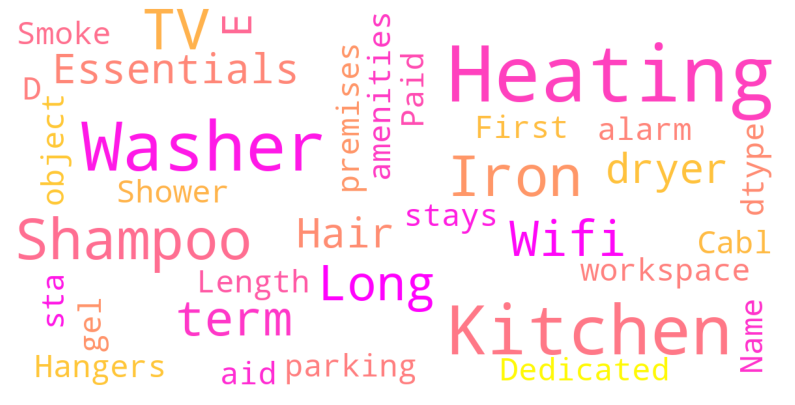

In [76]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
stopwords = set(STOPWORDS)

def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='white',
        stopwords=stopwords,
        max_words=300,
        max_font_size=40, 
        scale=3,
        colormap = 'spring',
        random_state=1, # chosen at random by flipping a coin; it was heads
       
    ).generate(str(data))

    fig = plt.figure(1, figsize=(14, 14))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

show_wordcloud(listing_df["amenities"])
